In [23]:
from __future__ import print_function
%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import tqdm
import warnings
warnings.filterwarnings('ignore')

# Взводим руками рандом сид для воспроизводимости обучения
manualSeed = 17
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  17


In [24]:
from PIL import Image

In [25]:
# Директория с датасетом покемонов. Внимание!!! Чтобы даталоадер работал, необходимо положить картинки в 
# папку по типу .../pokemon/1/0.png, .../pokemon/1/1.png и т.д. Без этого даталоадер работать не будет
dataroot = "./dz/pokemon"

# Количество воркеров для даталоадера
workers = 1

# Размер батча для обучения
batch_size = 64

# Размер скрытого вектора z
nz = 100

# Кол-во эпох обучения
num_epochs = 1000
image_size = Image.open('dz/pokemon/1/1.png').size

In [26]:
Image.open('dz/pokemon/1/1.png').size

(256, 256)

Current device : cuda:0


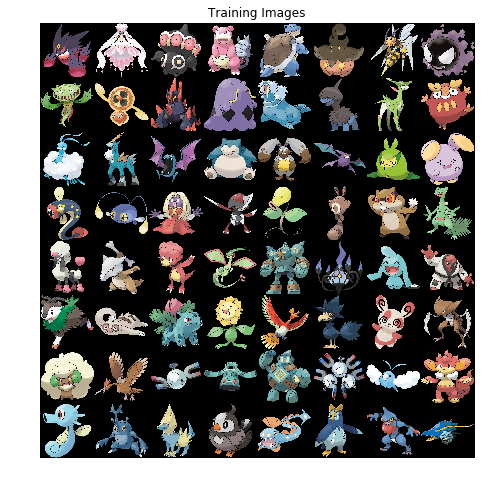

In [27]:
# Создаем даталоадер 
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# переключаемся на куду
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

print("Current device : {}".format(device))

# Выведем трейнсет, дабы убедиться, что все завелось
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [28]:
# Изображений в батче
len(next(iter(dataloader))[0])

64

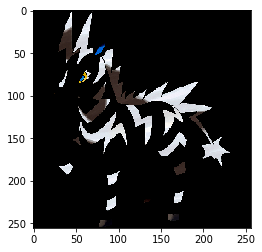

In [29]:
plt.imshow(next(iter(dataloader))[0][3].transpose(0, 1).transpose(1, 2))

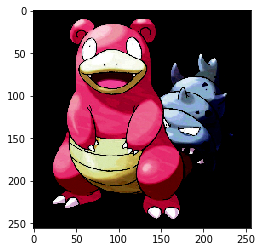

In [30]:
plt.imshow(real_batch[0][3].transpose(0, 1).transpose(1, 2))

In [ ]:
# функция для инициализации весов из статьи про GAN
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
# Генератор
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        
        #self.from_dense = torch.nn.Linear(1000, 4*4*1024)

        # Generator
        self.generator = nn.Sequential()
        
        self.generator.add_module('conv_0', torch.nn.ConvTranspose2d(100, 1024, 4, stride=1, padding=0, bias=False))
        self.generator.add_module('relu_0', torch.nn.ReLU())
        self.generator.add_module('batch_0', torch.nn.BatchNorm2d(1024))
        #1024x4x4
        
        self.generator.add_module('conv_1', torch.nn.ConvTranspose2d(1024, 512, 4, stride=2, padding=1, bias=False))
        self.generator.add_module('batch_1', torch.nn.BatchNorm2d(512))
        self.generator.add_module('relu_1', torch.nn.ReLU(True))
        
        #512x8x8
        self.generator.add_module('conv_2', torch.nn.ConvTranspose2d(512, 256, 4, stride=2, padding=1, bias=False))
        self.generator.add_module('batch_2', torch.nn.BatchNorm2d(256))
        self.generator.add_module('relu_2', torch.nn.ReLU(True))
        
        #256x16x16
        self.generator.add_module('conv_3', torch.nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1, bias=False))
        self.generator.add_module('batch_3', torch.nn.BatchNorm2d(128))
        self.generator.add_module('relu_3', torch.nn.ReLU(True))
        
        #128x32x32
        self.generator.add_module('conv_4', torch.nn.ConvTranspose2d(128, 3, 4, stride=2, padding=1, bias=False))
        self.generator.add_module('tanh', torch.nn.Tanh())
        #3x64x64
            
    def forward(self, input):
        #hidden_img = self.from_dense(input)
        #print(hidden_img.shape)
        #hidden_img = hidden_img.reshape((-1, 1024, 4, 4))
        output = self.generator(input)
        return output

In [ ]:
# Создали генератор
netG = Generator().to(device)

# Инициализировали его
b = netG.apply(weights_init)

# Вывели модель для отладки
print(netG)

Generator(
  (generator): Sequential(
    (conv_0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (relu_0): ReLU()
    (batch_0): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv_1): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (batch_1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu_1): ReLU(inplace)
    (conv_2): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (batch_2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu_2): ReLU(inplace)
    (conv_3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (batch_3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu_3): ReLU(inplace)
    (conv_4): ConvTranspose2d(128, 3, kernel_size=(4, 4), stride=(2, 2), p

In [ ]:
netG

Generator(
  (generator): Sequential(
    (conv_0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (relu_0): ReLU()
    (batch_0): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv_1): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (batch_1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu_1): ReLU(inplace)
    (conv_2): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (batch_2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu_2): ReLU(inplace)
    (conv_3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (batch_3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu_3): ReLU(inplace)
    (conv_4): ConvTranspose2d(128, 3, kernel_size=(4, 4), stride=(2, 2), p

In [ ]:
pr = print
a = 1
pr(a)

1


In [ ]:
# Дискриминатор
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential()
        # 3x64x64
        self.model.add_module('conv_1', nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False))
        self.model.add_module('batch_1', nn.BatchNorm2d(64))
        self.model.add_module('leaky_relu_1', nn.LeakyReLU(0.2, inplace=True))
        
        # 64x32x32
        self.model.add_module('conv_2', nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False))
        self.model.add_module('batch_2', nn.BatchNorm2d(128))
        self.model.add_module('leaky_relu_2', nn.LeakyReLU(0.2, inplace=True))
        
        # 128x16x16
        self.model.add_module('conv_3', nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False))
        self.model.add_module('batch_3', nn.BatchNorm2d(256))
        self.model.add_module('leaky_relu_3', nn.LeakyReLU(0.2, inplace=True))
        
        # 256x8x8
        self.model.add_module('conv_4', nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False))
        self.model.add_module('batch_4', nn.BatchNorm2d(512))
        self.model.add_module('leaky_relu_4', nn.LeakyReLU(0.2, inplace=True))
        
        # 512x4x4
        self.model.add_module('conv_5', nn.Conv2d(512, 1, kernel_size=4, stride=1, bias=False))
        #self.model.add_module('sigmoid', nn.Sigmoid())
        # 1
        
    def forward(self, input):
        output = self.model(input)
        #print('output', output.shape)
        return output

In [ ]:
# Создали дискриминатор
netD = Discriminator().to(device)

# Ининциализировали весе
b = netD.apply(weights_init)

# Вывели модель для отладки
print(netD)

Discriminator(
  (model): Sequential(
    (conv_1): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (batch_1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (leaky_relu_1): LeakyReLU(negative_slope=0.2, inplace)
    (conv_2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (batch_2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (leaky_relu_2): LeakyReLU(negative_slope=0.2, inplace)
    (conv_3): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (batch_3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (leaky_relu_3): LeakyReLU(negative_slope=0.2, inplace)
    (conv_4): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (batch_4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (leaky_relu_4): LeakyReLU(

In [ ]:
# Фиксированный шум для мониторинга качества генерации
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Коэффициент обучения
lr = 0.00005

# Оптимизаторы для сеток
optimizerD = optim.RMSprop(netD.parameters(), lr=lr)
optimizerG = optim.RMSprop(netG.parameters(), lr=lr)

In [ ]:
# код для обучения дискриминатора
def train_D(discriminator, images, fake_images):
    D_real = discriminator(images)
    D_fake = discriminator(fake_images)
    output = -(torch.mean(D_real) - torch.mean(D_fake))
    return output

In [ ]:
# код для обучения генератора
def train_G(generator, discriminator, fake_images):
    D_fake = discriminator(fake_images)
    output = -torch.mean(D_fake)
    return output

In [ ]:
import torch.nn.functional as F
from torch.autograd import Variable
def resize2d(img, size):
    return (F.adaptive_avg_pool2d(Variable(img,volatile=True), size)).data

In [ ]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

lr = 0.0002
beta1 = 0.5

#optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
#optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

d_episodes = 1

print("Starting Training Loop...")
for epoch in tqdm.tqdm_notebook(range(num_epochs)):

    
    dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)
    data_iter = iter(dataloader)
    i = 0
    while i < len(dataloader):
        print('ITER:', i)
        # обучаем дискриминатор
        # d_loss = wasserstein loss дискриминатора
        # real_score - оценки дискриминатора для настоящих картинок
        # fake_score - оценки дискриминатора для фейковых картинок
        # помните, что на одну итерацию обучения генератора
        # должно приходиться несколько итераций обучения дискриминатора!
        
        # обучаем генератор
        # g_loss = critic-loss генератора
#         real_score = []
#         fake_score = []
        real_images = next(data_iter)[0].to(device)
        real_images = resize2d(real_images, (64, 64))
        plt.imshow(real_images[3].cpu().transpose(0, 1).transpose(1, 2))
        for j in range(1):
            netD.zero_grad()
            noise = torch.randn(64, 100, 1, 1, device=device)
            fake_images = netG(noise).to(device)
            #real_images = next(data_iter)[0].to(device)
            #print('fake_images', fake_images.shape)
            #print('real_images', real_images.shape)
            #real_images = resize2d(real_images, (64, 64))
            #print('real_images', real_images.shape)
            #plt.imshow(real_images[3].cpu().transpose(0, 1).transpose(1, 2))
            d_loss = train_D(netD, real_images, fake_images)
            d_loss.backward()
            optimizerD.step()
            
            fake_score = netD(fake_images)
            real_score = netD(real_images)#error
        
        netG.zero_grad()
        noise = torch.randn(64, 100, 1, 1, device=device)
        fake_images = netG(noise)
        g_loss = train_G(netG, netD, fake_images)
        g_loss.backward()
        optimizerG.step()
            
            
        
        # Выводим стату
        if i % 1 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     d_loss.item(), g_loss.item(), real_score.mean().item(), fake_score.mean().item()))

        # Save Losses for plotting later
        G_losses.append(g_loss.item())
        D_losses.append(d_loss.item())

        # Сохраняем результат генерации для нашего фиксированного шума( для валидации )
        if (iters % 50 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
        i += 1

Starting Training Loop...


ITER: 0


[0/1000][0/13]	Loss_D: 0.0383	Loss_G: 5.2650	D(x): 9.8189	D(G(z)): -8.4561
ITER: 1


[0/1000][1/13]	Loss_D: -3.5085	Loss_G: 2.3279	D(x): 14.6510	D(G(z)): -4.2611
ITER: 2
[0/1000][2/13]	Loss_D: -6.1882	Loss_G: 1.1104	D(x): 17.0147	D(G(z)): -3.4192
ITER: 3


[0/1000][3/13]	Loss_D: -9.8089	Loss_G: 0.6638	D(x): 20.7069	D(G(z)): -2.8572
ITER: 4


[0/1000][4/13]	Loss_D: -11.8935	Loss_G: 2.0356	D(x): 21.4082	D(G(z)): -3.7499
ITER: 5


[0/1000][5/13]	Loss_D: -15.3736	Loss_G: 4.0780	D(x): 24.4920	D(G(z)): -5.4460
ITER: 6


[0/1000][6/13]	Loss_D: -19.9468	Loss_G: 8.3625	D(x): 23.4153	D(G(z)): -10.3068
ITER: 7


[0/1000][7/13]	Loss_D: -24.8223	Loss_G: 3.2919	D(x): 31.1800	D(G(z)): -5.2496
ITER: 8


[0/1000][8/13]	Loss_D: -24.4805	Loss_G: 19.0045	D(x): 18.5238	D(G(z)): -19.5776
ITER: 9


[0/1000][9/13]	Loss_D: -29.2823	Loss_G: 7.7785	D(x): 32.3806	D(G(z)): -9.2214
ITER: 10


[0/1000][10/13]	Loss_D: -30.9035	Loss_G: 24.2776	D(x): 17.4448	D(G(z)): -25.6790
ITER: 11


[0/1000][11/13]	Loss_D: -35.2977	Loss_G: 10.8792	D(x): 35.1756	D(G(z)): -12.9679
ITER: 12
[0/1000][12/13]	Loss_D: -34.8560	Loss_G: 29.5804	D(x): 16.3220	D(G(z)): -31.7278
ITER: 0


[1/1000][0/13]	Loss_D: -37.7329	Loss_G: 14.0914	D(x): 37.5084	D(G(z)): -12.6733
ITER: 1


[1/1000][1/13]	Loss_D: -37.8529	Loss_G: 30.9630	D(x): 17.5159	D(G(z)): -30.8479
ITER: 2


[1/1000][2/13]	Loss_D: -42.1904	Loss_G: 12.1071	D(x): 36.5622	D(G(z)): -17.6969
ITER: 3


[1/1000][3/13]	Loss_D: -43.1451	Loss_G: 35.5542	D(x): 16.6700	D(G(z)): -35.6907
ITER: 4


[1/1000][4/13]	Loss_D: -34.6135	Loss_G: 9.0079	D(x): 36.8697	D(G(z)): -8.0075
ITER: 5


[1/1000][5/13]	Loss_D: -33.9774	Loss_G: 30.2540	D(x): 9.6635	D(G(z)): -33.3998
ITER: 6


[1/1000][6/13]	Loss_D: -34.8892	Loss_G: 8.2919	D(x): 32.1879	D(G(z)): -14.6566
ITER: 7


[1/1000][7/13]	Loss_D: -34.8444	Loss_G: 31.5941	D(x): 16.3482	D(G(z)): -30.6330
ITER: 8


[1/1000][8/13]	Loss_D: -33.2537	Loss_G: 13.3774	D(x): 28.6228	D(G(z)): -16.4038
ITER: 9


[1/1000][9/13]	Loss_D: -31.6016	Loss_G: 26.3111	D(x): 18.3889	D(G(z)): -23.6677
ITER: 10


[1/1000][10/13]	Loss_D: -27.0723	Loss_G: 9.8817	D(x): 30.0932	D(G(z)): -9.2758
ITER: 11


[1/1000][11/13]	Loss_D: -27.9521	Loss_G: 29.7168	D(x): 12.3189	D(G(z)): -24.3117
ITER: 12
[1/1000][12/13]	Loss_D: -26.7614	Loss_G: -2.5792	D(x): 35.3039	D(G(z)): 1.8901
ITER: 0


[2/1000][0/13]	Loss_D: -20.7213	Loss_G: 25.0016	D(x): 8.6862	D(G(z)): -21.4754
ITER: 1


[2/1000][1/13]	Loss_D: -26.6058	Loss_G: -1.1426	D(x): 34.7583	D(G(z)): -1.8036
ITER: 2


[2/1000][2/13]	Loss_D: -24.4029	Loss_G: 20.6590	D(x): 12.0294	D(G(z)): -21.5183
ITER: 3


[2/1000][3/13]	Loss_D: -23.0026	Loss_G: -0.2888	D(x): 31.9951	D(G(z)): -1.0446
ITER: 4


[2/1000][4/13]	Loss_D: -22.4998	Loss_G: 10.7072	D(x): 22.0375	D(G(z)): -8.9664
ITER: 5


[2/1000][5/13]	Loss_D: -30.9744	Loss_G: 6.1385	D(x): 32.6505	D(G(z)): -6.6286
ITER: 6


[2/1000][6/13]	Loss_D: -27.5490	Loss_G: 12.6951	D(x): 24.7736	D(G(z)): -10.6454
ITER: 7


[2/1000][7/13]	Loss_D: -35.0537	Loss_G: -6.9018	D(x): 42.2562	D(G(z)): 2.0129
ITER: 8


[2/1000][8/13]	Loss_D: -26.7854	Loss_G: 19.3163	D(x): 18.0958	D(G(z)): -13.8576
ITER: 9


[2/1000][9/13]	Loss_D: -34.0411	Loss_G: -8.8144	D(x): 45.5421	D(G(z)): 7.3846
ITER: 10


[2/1000][10/13]	Loss_D: -28.5057	Loss_G: 17.8771	D(x): 19.1508	D(G(z)): -17.9888
ITER: 11


[2/1000][11/13]	Loss_D: -32.4594	Loss_G: -0.0107	D(x): 41.6414	D(G(z)): 0.7643
ITER: 12
[2/1000][12/13]	Loss_D: -34.1660	Loss_G: 16.6020	D(x): 24.6122	D(G(z)): -16.6001
ITER: 0


[3/1000][0/13]	Loss_D: -38.2518	Loss_G: 2.5428	D(x): 43.7246	D(G(z)): -1.3678
ITER: 1


[3/1000][1/13]	Loss_D: -39.3130	Loss_G: 19.9906	D(x): 22.8544	D(G(z)): -22.2939
ITER: 2


[3/1000][2/13]	Loss_D: -34.9846	Loss_G: -4.2144	D(x): 45.8828	D(G(z)): 2.5778
ITER: 3


[3/1000][3/13]	Loss_D: -33.8721	Loss_G: 15.8080	D(x): 30.4673	D(G(z)): -16.4923
ITER: 4


[3/1000][4/13]	Loss_D: -32.1420	Loss_G: 4.1018	D(x): 40.0180	D(G(z)): -3.7757
ITER: 5


[3/1000][5/13]	Loss_D: -34.5926	Loss_G: 10.5451	D(x): 35.5001	D(G(z)): -10.2318
ITER: 6


[3/1000][6/13]	Loss_D: -42.0238	Loss_G: 20.8753	D(x): 34.0183	D(G(z)): -20.5713
ITER: 7


[3/1000][7/13]	Loss_D: -37.1261	Loss_G: 12.0912	D(x): 40.4882	D(G(z)): -10.1380
ITER: 8


[3/1000][8/13]	Loss_D: -44.2331	Loss_G: 22.1610	D(x): 31.6333	D(G(z)): -22.6006
ITER: 9


[3/1000][9/13]	Loss_D: -46.5116	Loss_G: 6.3908	D(x): 46.5459	D(G(z)): -6.7602
ITER: 10


[3/1000][10/13]	Loss_D: -42.7503	Loss_G: 29.9279	D(x): 18.3064	D(G(z)): -30.1022
ITER: 11


[3/1000][11/13]	Loss_D: -45.1823	Loss_G: 2.6425	D(x): 48.8938	D(G(z)): -3.7468
ITER: 12
[3/1000][12/13]	Loss_D: -34.6711	Loss_G: 19.0387	D(x): 29.8021	D(G(z)): -20.2298
ITER: 0


[4/1000][0/13]	Loss_D: -43.0681	Loss_G: 8.1353	D(x): 46.5852	D(G(z)): -5.7070
ITER: 1


[4/1000][1/13]	Loss_D: -35.4865	Loss_G: 18.7832	D(x): 27.0109	D(G(z)): -19.7196
ITER: 2


[4/1000][2/13]	Loss_D: -46.5355	Loss_G: 9.0424	D(x): 48.0763	D(G(z)): -8.6706
ITER: 3


[4/1000][3/13]	Loss_D: -41.2842	Loss_G: 23.8906	D(x): 26.5025	D(G(z)): -26.1815
ITER: 4


[4/1000][4/13]	Loss_D: -44.4627	Loss_G: 2.1422	D(x): 51.2223	D(G(z)): -4.5768
ITER: 5


[4/1000][5/13]	Loss_D: -39.9107	Loss_G: 28.5822	D(x): 25.9700	D(G(z)): -29.3323
ITER: 6


[4/1000][6/13]	Loss_D: -50.8692	Loss_G: 17.1439	D(x): 45.9116	D(G(z)): -15.9781
ITER: 7


[4/1000][7/13]	Loss_D: -52.7647	Loss_G: 25.8640	D(x): 39.9180	D(G(z)): -22.7797
ITER: 8


[4/1000][8/13]	Loss_D: -52.6269	Loss_G: 14.2877	D(x): 47.5151	D(G(z)): -14.5771
ITER: 9


[4/1000][9/13]	Loss_D: -47.9315	Loss_G: 30.7465	D(x): 29.8872	D(G(z)): -28.7206
ITER: 10


[4/1000][10/13]	Loss_D: -49.1695	Loss_G: 12.7963	D(x): 49.2211	D(G(z)): -10.8109
ITER: 11


[4/1000][11/13]	Loss_D: -46.9347	Loss_G: 26.2387	D(x): 28.5544	D(G(z)): -30.2976
ITER: 12
[4/1000][12/13]	Loss_D: -49.9325	Loss_G: 14.6571	D(x): 49.0222	D(G(z)): -13.8136
ITER: 0


[5/1000][0/13]	Loss_D: -46.2126	Loss_G: 30.6894	D(x): 24.7099	D(G(z)): -34.0197
ITER: 1


[5/1000][1/13]	Loss_D: -49.4104	Loss_G: 9.9707	D(x): 53.0821	D(G(z)): -8.8881
ITER: 2


[5/1000][2/13]	Loss_D: -43.3318	Loss_G: 29.6465	D(x): 35.7941	D(G(z)): -28.1669
ITER: 3


[5/1000][3/13]	Loss_D: -44.3692	Loss_G: 15.0793	D(x): 47.1825	D(G(z)): -12.1031
ITER: 4


[5/1000][4/13]	Loss_D: -48.7713	Loss_G: 27.0805	D(x): 40.1880	D(G(z)): -25.2524
ITER: 5


[5/1000][5/13]	Loss_D: -56.5071	Loss_G: 19.1708	D(x): 50.9013	D(G(z)): -20.2072
ITER: 6


[5/1000][6/13]	Loss_D: -54.6024	Loss_G: 30.3050	D(x): 38.2982	D(G(z)): -31.6846
ITER: 7


[5/1000][7/13]	Loss_D: -58.7643	Loss_G: 20.8812	D(x): 53.0307	D(G(z)): -19.3363
ITER: 8


[5/1000][8/13]	Loss_D: -59.1980	Loss_G: 33.0160	D(x): 37.6733	D(G(z)): -34.3498
ITER: 9


[5/1000][9/13]	Loss_D: -65.5116	Loss_G: 21.8940	D(x): 56.5446	D(G(z)): -20.9710
ITER: 10


[5/1000][10/13]	Loss_D: -54.5125	Loss_G: 35.7705	D(x): 29.1940	D(G(z)): -37.2891
ITER: 11


[5/1000][11/13]	Loss_D: -64.7976	Loss_G: 21.2785	D(x): 58.2093	D(G(z)): -19.2985
ITER: 12
[5/1000][12/13]	Loss_D: -58.8963	Loss_G: 32.7599	D(x): 38.1571	D(G(z)): -34.7849
ITER: 0


[6/1000][0/13]	Loss_D: -66.5522	Loss_G: 18.5472	D(x): 58.3028	D(G(z)): -19.6977
ITER: 1


[6/1000][1/13]	Loss_D: -58.6849	Loss_G: 34.6154	D(x): 36.1467	D(G(z)): -34.7327
ITER: 2


[6/1000][2/13]	Loss_D: -65.5076	Loss_G: 23.8568	D(x): 56.5080	D(G(z)): -20.1412
ITER: 3


[6/1000][3/13]	Loss_D: -63.8253	Loss_G: 36.9065	D(x): 34.3098	D(G(z)): -39.9445
ITER: 4


[6/1000][4/13]	Loss_D: -66.8262	Loss_G: 17.8105	D(x): 62.5877	D(G(z)): -15.1423
ITER: 5


[6/1000][5/13]	Loss_D: -58.7673	Loss_G: 35.5337	D(x): 36.9095	D(G(z)): -34.6449
ITER: 6


[6/1000][6/13]	Loss_D: -60.8918	Loss_G: 16.2589	D(x): 57.1440	D(G(z)): -14.9053
ITER: 7


[6/1000][7/13]	Loss_D: -60.9374	Loss_G: 38.2314	D(x): 27.2744	D(G(z)): -43.3016
ITER: 8


[6/1000][8/13]	Loss_D: -67.3901	Loss_G: 15.6724	D(x): 61.2475	D(G(z)): -16.9589
ITER: 9
[6/1000][9/13]	Loss_D: -58.0176	Loss_G: 38.8975	D(x): 31.8936	D(G(z)): -40.0605
ITER: 10


[6/1000][10/13]	Loss_D: -73.2247	Loss_G: 23.2037	D(x): 59.5390	D(G(z)): -22.9240
ITER: 11


[6/1000][11/13]	Loss_D: -66.3067	Loss_G: 42.8096	D(x): 37.4058	D(G(z)): -38.6392
ITER: 12
[6/1000][12/13]	Loss_D: -75.8761	Loss_G: 14.9728	D(x): 63.3560	D(G(z)): -20.2822
ITER: 0


[7/1000][0/13]	Loss_D: -67.5565	Loss_G: 48.0363	D(x): 28.2493	D(G(z)): -48.1452
ITER: 1
[7/1000][1/13]	Loss_D: -69.8748	Loss_G: 23.8635	D(x): 62.2706	D(G(z)): -19.5793
ITER: 2


[7/1000][2/13]	Loss_D: -68.7998	Loss_G: 44.9253	D(x): 34.9835	D(G(z)): -46.4362
ITER: 3


[7/1000][3/13]	Loss_D: -82.5530	Loss_G: 27.4972	D(x): 61.7780	D(G(z)): -29.8550
ITER: 4


[7/1000][4/13]	Loss_D: -79.9901	Loss_G: 46.6542	D(x): 42.8006	D(G(z)): -47.0730
ITER: 5


[7/1000][5/13]	Loss_D: -77.3848	Loss_G: 29.3618	D(x): 60.3038	D(G(z)): -28.0313
ITER: 6


[7/1000][6/13]	Loss_D: -81.2244	Loss_G: 45.4353	D(x): 45.2794	D(G(z)): -45.3886
ITER: 7


[7/1000][7/13]	Loss_D: -82.9451	Loss_G: 32.2152	D(x): 61.2291	D(G(z)): -31.4323
ITER: 8
[7/1000][8/13]	Loss_D: -80.3014	Loss_G: 48.9096	D(x): 44.6532	D(G(z)): -47.3850
ITER: 9


[7/1000][9/13]	Loss_D: -81.4720	Loss_G: 27.9688	D(x): 62.2057	D(G(z)): -29.2672
ITER: 10


[7/1000][10/13]	Loss_D: -67.6991	Loss_G: 51.8571	D(x): 29.5324	D(G(z)): -53.7067
ITER: 11


[7/1000][11/13]	Loss_D: -83.4401	Loss_G: 32.2152	D(x): 65.1876	D(G(z)): -30.1074
ITER: 12
[7/1000][12/13]	Loss_D: -67.2532	Loss_G: 45.6757	D(x): 35.7696	D(G(z)): -45.3358
ITER: 0


[8/1000][0/13]	Loss_D: -81.6072	Loss_G: 28.0717	D(x): 62.2248	D(G(z)): -30.8613
ITER: 1


[8/1000][1/13]	Loss_D: -72.5391	Loss_G: 47.0326	D(x): 37.2209	D(G(z)): -49.1016
ITER: 2


[8/1000][2/13]	Loss_D: -77.5706	Loss_G: 20.4678	D(x): 63.5847	D(G(z)): -27.3945
ITER: 3


[8/1000][3/13]	Loss_D: -70.5885	Loss_G: 48.9739	D(x): 41.3813	D(G(z)): -50.0645
ITER: 4


[8/1000][4/13]	Loss_D: -78.9093	Loss_G: 23.2417	D(x): 65.5413	D(G(z)): -27.2731
ITER: 5


[8/1000][5/13]	Loss_D: -68.2735	Loss_G: 48.8736	D(x): 40.3833	D(G(z)): -49.1778
ITER: 6


[8/1000][6/13]	Loss_D: -87.7550	Loss_G: 39.6226	D(x): 59.6867	D(G(z)): -40.3833
ITER: 7


[8/1000][7/13]	Loss_D: -82.9366	Loss_G: 50.7674	D(x): 42.4893	D(G(z)): -52.5762
ITER: 8


[8/1000][8/13]	Loss_D: -89.9767	Loss_G: 35.2878	D(x): 63.1063	D(G(z)): -37.4125
ITER: 9


[8/1000][9/13]	Loss_D: -89.8277	Loss_G: 57.9083	D(x): 44.3191	D(G(z)): -56.2874
ITER: 10


[8/1000][10/13]	Loss_D: -92.5822	Loss_G: 35.8181	D(x): 67.3219	D(G(z)): -35.2740
ITER: 11


[8/1000][11/13]	Loss_D: -84.6146	Loss_G: 56.1276	D(x): 37.3331	D(G(z)): -56.8486
ITER: 12
[8/1000][12/13]	Loss_D: -81.8177	Loss_G: 31.7222	D(x): 64.5639	D(G(z)): -28.8499
ITER: 0


[9/1000][0/13]	Loss_D: -72.7700	Loss_G: 53.1984	D(x): 38.5583	D(G(z)): -53.2114
ITER: 1


[9/1000][1/13]	Loss_D: -76.0093	Loss_G: 25.6719	D(x): 61.4772	D(G(z)): -25.0203
ITER: 2


[9/1000][2/13]	Loss_D: -57.1401	Loss_G: 45.7794	D(x): 36.1639	D(G(z)): -46.8419
ITER: 3


[9/1000][3/13]	Loss_D: -66.9931	Loss_G: 21.0728	D(x): 61.5386	D(G(z)): -20.3916
ITER: 4


[9/1000][4/13]	Loss_D: -60.0407	Loss_G: 45.0448	D(x): 35.2199	D(G(z)): -44.1959
ITER: 5


[9/1000][5/13]	Loss_D: -64.5795	Loss_G: 17.1509	D(x): 60.7947	D(G(z)): -19.2362
ITER: 6


[9/1000][6/13]	Loss_D: -52.2546	Loss_G: 33.9531	D(x): 34.4577	D(G(z)): -36.2943
ITER: 7


[9/1000][7/13]	Loss_D: -67.5979	Loss_G: 23.5490	D(x): 51.9436	D(G(z)): -30.8851
ITER: 8


[9/1000][8/13]	Loss_D: -55.6168	Loss_G: 35.2252	D(x): 34.6065	D(G(z)): -36.5887
ITER: 9


[9/1000][9/13]	Loss_D: -58.5778	Loss_G: 14.4550	D(x): 53.5007	D(G(z)): -20.1638
ITER: 10


[9/1000][10/13]	Loss_D: -48.7070	Loss_G: 42.8887	D(x): 19.4171	D(G(z)): -44.5041
ITER: 11


[9/1000][11/13]	Loss_D: -40.0375	Loss_G: 7.7709	D(x): 49.0354	D(G(z)): -7.5654
ITER: 12
[9/1000][12/13]	Loss_D: -39.6961	Loss_G: 31.9454	D(x): 23.0999	D(G(z)): -32.8125
ITER: 0


[10/1000][0/13]	Loss_D: -37.1530	Loss_G: 23.3977	D(x): 34.7640	D(G(z)): -18.9292
ITER: 1


[10/1000][1/13]	Loss_D: -42.7551	Loss_G: 25.1446	D(x): 32.1982	D(G(z)): -26.9413
ITER: 2


[10/1000][2/13]	Loss_D: -45.0898	Loss_G: 23.1956	D(x): 35.9275	D(G(z)): -25.4039
ITER: 3


[10/1000][3/13]	Loss_D: -47.9048	Loss_G: 41.6017	D(x): 16.7477	D(G(z)): -43.5431
ITER: 4


[10/1000][4/13]	Loss_D: -42.7640	Loss_G: 15.2800	D(x): 41.9082	D(G(z)): -13.7035
ITER: 5


[10/1000][5/13]	Loss_D: -49.4493	Loss_G: 38.2783	D(x): 22.0852	D(G(z)): -40.1180
ITER: 6


[10/1000][6/13]	Loss_D: -55.4149	Loss_G: 16.1411	D(x): 49.9788	D(G(z)): -15.6140
ITER: 7


[10/1000][7/13]	Loss_D: -45.3887	Loss_G: 39.0647	D(x): 15.6735	D(G(z)): -41.4199
ITER: 8


[10/1000][8/13]	Loss_D: -45.5732	Loss_G: 25.0522	D(x): 34.4969	D(G(z)): -22.7716
ITER: 9


[10/1000][9/13]	Loss_D: -50.4109	Loss_G: 35.0261	D(x): 24.6863	D(G(z)): -35.6501
ITER: 10


[10/1000][10/13]	Loss_D: -51.7712	Loss_G: 19.9221	D(x): 42.1943	D(G(z)): -22.2955
ITER: 11


[10/1000][11/13]	Loss_D: -56.6353	Loss_G: 42.1665	D(x): 21.4022	D(G(z)): -44.8585
ITER: 12
[10/1000][12/13]	Loss_D: -60.7568	Loss_G: 28.2306	D(x): 42.9747	D(G(z)): -27.8563
ITER: 0


[11/1000][0/13]	Loss_D: -61.2602	Loss_G: 38.4054	D(x): 34.2227	D(G(z)): -37.0733
ITER: 1


[11/1000][1/13]	Loss_D: -59.4741	Loss_G: 31.8743	D(x): 39.2631	D(G(z)): -29.8756
ITER: 2


[11/1000][2/13]	Loss_D: -58.4130	Loss_G: 34.2887	D(x): 33.1096	D(G(z)): -35.6292
ITER: 3


[11/1000][3/13]	Loss_D: -62.9283	Loss_G: 33.8903	D(x): 38.8433	D(G(z)): -33.6963
ITER: 4


[11/1000][4/13]	Loss_D: -62.0418	Loss_G: 46.7511	D(x): 25.4745	D(G(z)): -45.4601
ITER: 5


[11/1000][5/13]	Loss_D: -61.2851	Loss_G: 6.5725	D(x): 56.5206	D(G(z)): -8.7936
ITER: 6


[11/1000][6/13]	Loss_D: -54.8718	Loss_G: 61.4864	D(x): -6.7624	D(G(z)): -62.4941
ITER: 7


[11/1000][7/13]	Loss_D: -51.8244	Loss_G: -0.1814	D(x): 63.2787	D(G(z)): -4.7002
ITER: 8


[11/1000][8/13]	Loss_D: -56.6489	Loss_G: 55.9267	D(x): 10.5742	D(G(z)): -57.4959
ITER: 9
[11/1000][9/13]	Loss_D: -65.7097	Loss_G: 10.1561	D(x): 61.3879	D(G(z)): -10.5651
ITER: 10


[11/1000][10/13]	Loss_D: -57.9124	Loss_G: 57.0812	D(x): 8.1989	D(G(z)): -57.3989
ITER: 11


[11/1000][11/13]	Loss_D: -67.5048	Loss_G: 3.4040	D(x): 66.4299	D(G(z)): -6.2788
ITER: 12
[11/1000][12/13]	Loss_D: -52.2471	Loss_G: 59.1882	D(x): 11.3599	D(G(z)): -59.1211
ITER: 0


[12/1000][0/13]	Loss_D: -58.3399	Loss_G: 21.0798	D(x): 51.2289	D(G(z)): -17.6326
ITER: 1


[12/1000][1/13]	Loss_D: -60.8694	Loss_G: 54.0985	D(x): 18.3947	D(G(z)): -53.1392
ITER: 2


[12/1000][2/13]	Loss_D: -64.6067	Loss_G: 16.0366	D(x): 57.3415	D(G(z)): -18.2844
ITER: 3


[12/1000][3/13]	Loss_D: -60.1213	Loss_G: 52.0808	D(x): 21.1605	D(G(z)): -53.4251
ITER: 4


[12/1000][4/13]	Loss_D: -68.2452	Loss_G: 23.4985	D(x): 54.5661	D(G(z)): -25.0893
ITER: 5


[12/1000][5/13]	Loss_D: -69.4154	Loss_G: 58.5166	D(x): 18.8403	D(G(z)): -60.9622
ITER: 6


[12/1000][6/13]	Loss_D: -70.7070	Loss_G: 27.1940	D(x): 57.6913	D(G(z)): -26.0640
ITER: 7


[12/1000][7/13]	Loss_D: -73.4572	Loss_G: 62.4354	D(x): 19.4333	D(G(z)): -63.6466
ITER: 8


[12/1000][8/13]	Loss_D: -85.4096	Loss_G: 23.9587	D(x): 66.0991	D(G(z)): -26.4992
ITER: 9


[12/1000][9/13]	Loss_D: -80.1960	Loss_G: 71.3341	D(x): 13.8476	D(G(z)): -70.5012
ITER: 10


[12/1000][10/13]	Loss_D: -82.5029	Loss_G: 31.3050	D(x): 63.7249	D(G(z)): -30.0377
ITER: 11


[12/1000][11/13]	Loss_D: -84.6041	Loss_G: 68.6726	D(x): 21.4211	D(G(z)): -68.3194
ITER: 12
[12/1000][12/13]	Loss_D: -84.4855	Loss_G: 25.9306	D(x): 66.1163	D(G(z)): -24.7588
ITER: 0


[13/1000][0/13]	Loss_D: -72.5296	Loss_G: 69.2302	D(x): 10.3016	D(G(z)): -71.3714
ITER: 1


[13/1000][1/13]	Loss_D: -75.2173	Loss_G: 23.8108	D(x): 62.4132	D(G(z)): -25.5868
ITER: 2


[13/1000][2/13]	Loss_D: -83.1100	Loss_G: 61.8986	D(x): 27.9707	D(G(z)): -65.1854
ITER: 3


[13/1000][3/13]	Loss_D: -80.9234	Loss_G: 25.7605	D(x): 63.0779	D(G(z)): -25.2192
ITER: 4


[13/1000][4/13]	Loss_D: -65.0294	Loss_G: 62.7917	D(x): 13.8458	D(G(z)): -63.2357
ITER: 5


[13/1000][5/13]	Loss_D: -81.8430	Loss_G: 28.8613	D(x): 62.0097	D(G(z)): -29.2546
ITER: 6


[13/1000][6/13]	Loss_D: -69.4105	Loss_G: 59.4551	D(x): 22.3944	D(G(z)): -59.0948
ITER: 7


[13/1000][7/13]	Loss_D: -74.1779	Loss_G: 25.5460	D(x): 60.8267	D(G(z)): -25.7128
ITER: 8


[13/1000][8/13]	Loss_D: -68.2462	Loss_G: 62.9010	D(x): 18.6818	D(G(z)): -63.5707
ITER: 9


[13/1000][9/13]	Loss_D: -71.2118	Loss_G: 23.5250	D(x): 62.7457	D(G(z)): -24.9351
ITER: 10


[13/1000][10/13]	Loss_D: -71.3821	Loss_G: 68.1098	D(x): 15.6707	D(G(z)): -68.7962
ITER: 11


[13/1000][11/13]	Loss_D: -70.7858	Loss_G: 35.7378	D(x): 59.5928	D(G(z)): -30.0750
ITER: 12
[13/1000][12/13]	Loss_D: -74.2070	Loss_G: 66.0380	D(x): 20.7686	D(G(z)): -67.2137
ITER: 0


[14/1000][0/13]	Loss_D: -90.2131	Loss_G: 35.4760	D(x): 64.4373	D(G(z)): -37.0829
ITER: 1


[14/1000][1/13]	Loss_D: -75.7524	Loss_G: 68.9447	D(x): 20.1122	D(G(z)): -66.9111
ITER: 2


[14/1000][2/13]	Loss_D: -87.3753	Loss_G: 39.3300	D(x): 61.6790	D(G(z)): -36.0234
ITER: 3


[14/1000][3/13]	Loss_D: -83.7997	Loss_G: 71.1501	D(x): 21.5731	D(G(z)): -69.4462
ITER: 4


[14/1000][4/13]	Loss_D: -87.8126	Loss_G: 32.2274	D(x): 67.2097	D(G(z)): -29.8007
ITER: 5


[14/1000][5/13]	Loss_D: -78.3361	Loss_G: 71.1934	D(x): 13.1384	D(G(z)): -73.3204
ITER: 6


[14/1000][6/13]	Loss_D: -73.7723	Loss_G: 22.7550	D(x): 63.8028	D(G(z)): -24.4905
ITER: 7


[14/1000][7/13]	Loss_D: -63.0436	Loss_G: 66.5560	D(x): 15.7556	D(G(z)): -67.8803
ITER: 8


[14/1000][8/13]	Loss_D: -79.0257	Loss_G: 29.0326	D(x): 63.5682	D(G(z)): -29.8407
ITER: 9


[14/1000][9/13]	Loss_D: -66.9237	Loss_G: 60.1934	D(x): 20.9555	D(G(z)): -62.7831
ITER: 10


[14/1000][10/13]	Loss_D: -74.0046	Loss_G: 41.3678	D(x): 50.0248	D(G(z)): -43.1225
ITER: 11


[14/1000][11/13]	Loss_D: -76.7358	Loss_G: 61.1433	D(x): 32.5944	D(G(z)): -60.2778
ITER: 12
[14/1000][12/13]	Loss_D: -89.3466	Loss_G: 45.5740	D(x): 57.9212	D(G(z)): -45.9109
ITER: 0


[15/1000][0/13]	Loss_D: -90.3144	Loss_G: 69.1131	D(x): 32.2295	D(G(z)): -71.2704
ITER: 1
[15/1000][1/13]	Loss_D: -92.5282	Loss_G: 34.9756	D(x): 68.4711	D(G(z)): -37.4265
ITER: 2


[15/1000][2/13]	Loss_D: -92.4579	Loss_G: 79.8038	D(x): 21.4234	D(G(z)): -81.0754
ITER: 3


[15/1000][3/13]	Loss_D: -100.0582	Loss_G: 40.2686	D(x): 71.2838	D(G(z)): -41.9424
ITER: 4


[15/1000][4/13]	Loss_D: -100.9799	Loss_G: 80.4477	D(x): 31.8238	D(G(z)): -80.2311
ITER: 5


[15/1000][5/13]	Loss_D: -104.8816	Loss_G: 49.0649	D(x): 72.3680	D(G(z)): -43.1213
ITER: 6


[15/1000][6/13]	Loss_D: -111.7367	Loss_G: 85.1294	D(x): 32.0730	D(G(z)): -86.1493
ITER: 7
[15/1000][7/13]	Loss_D: -111.8303	Loss_G: 46.5786	D(x): 76.2713	D(G(z)): -45.3373
ITER: 8


[15/1000][8/13]	Loss_D: -101.8859	Loss_G: 81.7849	D(x): 30.0763	D(G(z)): -81.2645
ITER: 9


[15/1000][9/13]	Loss_D: -107.2177	Loss_G: 46.7093	D(x): 70.2741	D(G(z)): -47.8593
ITER: 10


[15/1000][10/13]	Loss_D: -98.3981	Loss_G: 77.4464	D(x): 30.4258	D(G(z)): -76.8150
ITER: 11


[15/1000][11/13]	Loss_D: -100.7745	Loss_G: 37.8122	D(x): 72.0600	D(G(z)): -38.3539
ITER: 12
[15/1000][12/13]	Loss_D: -84.6062	Loss_G: 79.2975	D(x): 21.9456	D(G(z)): -77.5788
ITER: 0


[16/1000][0/13]	Loss_D: -95.4981	Loss_G: 36.7973	D(x): 70.4014	D(G(z)): -36.7661
ITER: 1


[16/1000][1/13]	Loss_D: -87.3190	Loss_G: 78.4928	D(x): 17.2041	D(G(z)): -80.0775
ITER: 2


[16/1000][2/13]	Loss_D: -90.9532	Loss_G: 31.2739	D(x): 73.4567	D(G(z)): -29.6007
ITER: 3


[16/1000][3/13]	Loss_D: -86.5771	Loss_G: 78.4427	D(x): 24.3000	D(G(z)): -78.6542
ITER: 4


[16/1000][4/13]	Loss_D: -108.2732	Loss_G: 47.5397	D(x): 74.3942	D(G(z)): -48.1075
ITER: 5


[16/1000][5/13]	Loss_D: -102.8674	Loss_G: 81.1199	D(x): 30.2884	D(G(z)): -81.6105
ITER: 6


[16/1000][6/13]	Loss_D: -100.5073	Loss_G: 48.1762	D(x): 68.4913	D(G(z)): -46.1451
ITER: 7


[16/1000][7/13]	Loss_D: -109.3869	Loss_G: 84.3892	D(x): 30.1076	D(G(z)): -86.5978
ITER: 8


[16/1000][8/13]	Loss_D: -115.0248	Loss_G: 51.0560	D(x): 77.3971	D(G(z)): -50.1611
ITER: 9


[16/1000][9/13]	Loss_D: -115.4675	Loss_G: 84.9483	D(x): 34.3116	D(G(z)): -86.4078
ITER: 10


[16/1000][10/13]	Loss_D: -114.8894	Loss_G: 42.0107	D(x): 79.3682	D(G(z)): -46.2418
ITER: 11


[16/1000][11/13]	Loss_D: -107.7128	Loss_G: 87.8754	D(x): 29.0600	D(G(z)): -88.7432
ITER: 12
[16/1000][12/13]	Loss_D: -117.6293	Loss_G: 47.3550	D(x): 79.8450	D(G(z)): -49.1737
ITER: 0


[17/1000][0/13]	Loss_D: -108.0176	Loss_G: 86.9060	D(x): 30.7377	D(G(z)): -87.0298
ITER: 1
[17/1000][1/13]	Loss_D: -115.6400	Loss_G: 50.9795	D(x): 76.0018	D(G(z)): -51.6645
ITER: 2


[17/1000][2/13]	Loss_D: -109.3247	Loss_G: 84.6110	D(x): 34.1174	D(G(z)): -85.2543
ITER: 3


[17/1000][3/13]	Loss_D: -116.3343	Loss_G: 49.6935	D(x): 78.5689	D(G(z)): -50.3355
ITER: 4


[17/1000][4/13]	Loss_D: -108.1623	Loss_G: 88.5060	D(x): 30.6195	D(G(z)): -88.8348
ITER: 5


[17/1000][5/13]	Loss_D: -108.6553	Loss_G: 48.3102	D(x): 74.7608	D(G(z)): -49.1156
ITER: 6


[17/1000][6/13]	Loss_D: -104.3417	Loss_G: 88.3293	D(x): 30.3299	D(G(z)): -88.0565
ITER: 7


[17/1000][7/13]	Loss_D: -107.2625	Loss_G: 45.5717	D(x): 76.4412	D(G(z)): -47.8444
ITER: 8


[17/1000][8/13]	Loss_D: -107.5452	Loss_G: 88.6119	D(x): 29.7143	D(G(z)): -89.8155
ITER: 9


[17/1000][9/13]	Loss_D: -110.7672	Loss_G: 51.4602	D(x): 76.1906	D(G(z)): -49.8123
ITER: 10


[17/1000][10/13]	Loss_D: -107.5169	Loss_G: 90.4522	D(x): 29.5794	D(G(z)): -90.7155
ITER: 11


[17/1000][11/13]	Loss_D: -112.8453	Loss_G: 54.7920	D(x): 76.7634	D(G(z)): -52.7541
ITER: 12
[17/1000][12/13]	Loss_D: -117.6219	Loss_G: 88.6849	D(x): 39.7199	D(G(z)): -90.4089
ITER: 0


[18/1000][0/13]	Loss_D: -117.7965	Loss_G: 50.0027	D(x): 80.7923	D(G(z)): -50.2174
ITER: 1


[18/1000][1/13]	Loss_D: -109.3505	Loss_G: 88.5683	D(x): 36.2402	D(G(z)): -88.2502
ITER: 2


[18/1000][2/13]	Loss_D: -122.1368	Loss_G: 60.9197	D(x): 76.7488	D(G(z)): -60.2408
ITER: 3


[18/1000][3/13]	Loss_D: -123.9869	Loss_G: 88.1657	D(x): 45.2357	D(G(z)): -89.4146
ITER: 4


[18/1000][4/13]	Loss_D: -120.3988	Loss_G: 54.6217	D(x): 79.8105	D(G(z)): -53.3212
ITER: 5


[18/1000][5/13]	Loss_D: -113.0483	Loss_G: 88.5654	D(x): 33.5449	D(G(z)): -90.8615
ITER: 6


[18/1000][6/13]	Loss_D: -126.3230	Loss_G: 60.2668	D(x): 79.8372	D(G(z)): -59.8453
ITER: 7


[18/1000][7/13]	Loss_D: -125.8945	Loss_G: 90.9530	D(x): 42.4857	D(G(z)): -91.9749
ITER: 8


[18/1000][8/13]	Loss_D: -113.9575	Loss_G: 46.8415	D(x): 81.8446	D(G(z)): -48.8372
ITER: 9


[18/1000][9/13]	Loss_D: -109.8304	Loss_G: 90.1912	D(x): 34.6250	D(G(z)): -91.7971
ITER: 10


[18/1000][10/13]	Loss_D: -117.0157	Loss_G: 58.6195	D(x): 74.7720	D(G(z)): -58.5568
ITER: 11


[18/1000][11/13]	Loss_D: -119.0900	Loss_G: 89.2477	D(x): 43.1835	D(G(z)): -89.1255
ITER: 12
[18/1000][12/13]	Loss_D: -129.2725	Loss_G: 62.1943	D(x): 80.1944	D(G(z)): -62.1406
ITER: 0


[19/1000][0/13]	Loss_D: -123.1127	Loss_G: 91.2140	D(x): 48.9669	D(G(z)): -89.2079
ITER: 1
[19/1000][1/13]	Loss_D: -141.0856	Loss_G: 68.2499	D(x): 82.4201	D(G(z)): -70.7462
ITER: 2


[19/1000][2/13]	Loss_D: -129.1639	Loss_G: 89.8861	D(x): 51.0734	D(G(z)): -91.6904
ITER: 3


[19/1000][3/13]	Loss_D: -134.5049	Loss_G: 68.1208	D(x): 81.2302	D(G(z)): -66.9338
ITER: 4


[19/1000][4/13]	Loss_D: -132.3233	Loss_G: 92.3226	D(x): 52.4772	D(G(z)): -94.8347
ITER: 5
[19/1000][5/13]	Loss_D: -132.3429	Loss_G: 67.7328	D(x): 80.5448	D(G(z)): -67.5548
ITER: 6


[19/1000][6/13]	Loss_D: -130.6183	Loss_G: 97.4728	D(x): 52.2816	D(G(z)): -94.6654
ITER: 7
[19/1000][7/13]	Loss_D: -139.6123	Loss_G: 71.7023	D(x): 83.6859	D(G(z)): -70.7843
ITER: 8


[19/1000][8/13]	Loss_D: -135.8959	Loss_G: 96.2362	D(x): 53.9404	D(G(z)): -96.7091
ITER: 9


[19/1000][9/13]	Loss_D: -148.0425	Loss_G: 67.2479	D(x): 90.5314	D(G(z)): -71.1397
ITER: 10


[19/1000][10/13]	Loss_D: -130.5949	Loss_G: 96.2717	D(x): 49.2106	D(G(z)): -96.2667
ITER: 11


[19/1000][11/13]	Loss_D: -149.0210	Loss_G: 68.8990	D(x): 88.2833	D(G(z)): -73.0820
ITER: 12
[19/1000][12/13]	Loss_D: -132.5988	Loss_G: 91.1324	D(x): 50.3951	D(G(z)): -95.1167
ITER: 0


[20/1000][0/13]	Loss_D: -126.5964	Loss_G: 54.9195	D(x): 85.9995	D(G(z)): -56.7585
ITER: 1


[20/1000][1/13]	Loss_D: -105.9347	Loss_G: 93.8059	D(x): 36.2523	D(G(z)): -94.4287
ITER: 2


[20/1000][2/13]	Loss_D: -120.6450	Loss_G: 51.9812	D(x): 89.3234	D(G(z)): -50.6492
ITER: 3


[20/1000][3/13]	Loss_D: -97.9926	Loss_G: 90.1553	D(x): 38.1228	D(G(z)): -87.7295
ITER: 4


[20/1000][4/13]	Loss_D: -118.7238	Loss_G: 48.5211	D(x): 87.5947	D(G(z)): -49.9122
ITER: 5


[20/1000][5/13]	Loss_D: -85.8128	Loss_G: 91.3138	D(x): 31.9881	D(G(z)): -88.7425
ITER: 6


[20/1000][6/13]	Loss_D: -107.6409	Loss_G: 51.2962	D(x): 82.5311	D(G(z)): -48.7118
ITER: 7


[20/1000][7/13]	Loss_D: -92.4765	Loss_G: 91.5178	D(x): 30.9829	D(G(z)): -91.0909
ITER: 8


[20/1000][8/13]	Loss_D: -118.4768	Loss_G: 59.0506	D(x): 83.1588	D(G(z)): -57.4780
ITER: 9


[20/1000][9/13]	Loss_D: -108.7924	Loss_G: 89.6130	D(x): 46.1848	D(G(z)): -86.8128
ITER: 10


[20/1000][10/13]	Loss_D: -125.0988	Loss_G: 60.8116	D(x): 82.7985	D(G(z)): -62.4164
ITER: 11


[20/1000][11/13]	Loss_D: -121.2755	Loss_G: 90.6920	D(x): 47.2445	D(G(z)): -92.6996
ITER: 12
[20/1000][12/13]	Loss_D: -130.4661	Loss_G: 62.0248	D(x): 87.9965	D(G(z)): -60.3652
ITER: 0


[21/1000][0/13]	Loss_D: -113.4008	Loss_G: 95.8622	D(x): 32.7050	D(G(z)): -97.2706
ITER: 1


[21/1000][1/13]	Loss_D: -141.4487	Loss_G: 59.7111	D(x): 95.1250	D(G(z)): -61.4212
ITER: 2


[21/1000][2/13]	Loss_D: -117.5941	Loss_G: 98.4617	D(x): 31.7076	D(G(z)): -100.6769
ITER: 3


[21/1000][3/13]	Loss_D: -122.7618	Loss_G: 50.7479	D(x): 91.8647	D(G(z)): -52.2262
ITER: 4


[21/1000][4/13]	Loss_D: -99.9630	Loss_G: 97.4350	D(x): 27.6847	D(G(z)): -97.1433
ITER: 5


[21/1000][5/13]	Loss_D: -119.1832	Loss_G: 52.3998	D(x): 84.5584	D(G(z)): -54.4690
ITER: 6


[21/1000][6/13]	Loss_D: -115.8527	Loss_G: 97.8059	D(x): 35.6482	D(G(z)): -99.4578
ITER: 7


[21/1000][7/13]	Loss_D: -126.7562	Loss_G: 60.0836	D(x): 87.8072	D(G(z)): -57.6656
ITER: 8


[21/1000][8/13]	Loss_D: -121.8106	Loss_G: 98.4475	D(x): 37.8849	D(G(z)): -99.7885
ITER: 9


[21/1000][9/13]	Loss_D: -131.7116	Loss_G: 56.4101	D(x): 88.2644	D(G(z)): -59.7132
ITER: 10


[21/1000][10/13]	Loss_D: -115.7856	Loss_G: 100.7951	D(x): 28.7856	D(G(z)): -102.2305
ITER: 11


[21/1000][11/13]	Loss_D: -136.7036	Loss_G: 66.2811	D(x): 88.2895	D(G(z)): -64.0735
ITER: 12
[21/1000][12/13]	Loss_D: -127.8932	Loss_G: 103.1064	D(x): 35.2939	D(G(z)): -103.7051
ITER: 0


[22/1000][0/13]	Loss_D: -134.3017	Loss_G: 54.3916	D(x): 91.9767	D(G(z)): -57.1021
ITER: 1


[22/1000][1/13]	Loss_D: -117.4974	Loss_G: 100.0955	D(x): 36.9091	D(G(z)): -99.5560
ITER: 2


[22/1000][2/13]	Loss_D: -143.4819	Loss_G: 63.5385	D(x): 92.6627	D(G(z)): -62.4212
ITER: 3


[22/1000][3/13]	Loss_D: -125.1040	Loss_G: 99.4356	D(x): 31.9437	D(G(z)): -102.0778
ITER: 4


[22/1000][4/13]	Loss_D: -124.5547	Loss_G: 47.3930	D(x): 91.5738	D(G(z)): -48.1232
ITER: 5


[22/1000][5/13]	Loss_D: -113.9859	Loss_G: 99.8854	D(x): 33.3194	D(G(z)): -98.2142
ITER: 6


[22/1000][6/13]	Loss_D: -114.8834	Loss_G: 53.7006	D(x): 84.9552	D(G(z)): -51.2217
ITER: 7


[22/1000][7/13]	Loss_D: -113.1812	Loss_G: 94.7927	D(x): 31.4851	D(G(z)): -97.3045
ITER: 8


[22/1000][8/13]	Loss_D: -119.5257	Loss_G: 46.7256	D(x): 86.7712	D(G(z)): -47.4147
ITER: 9


[22/1000][9/13]	Loss_D: -106.9679	Loss_G: 96.6338	D(x): 30.3071	D(G(z)): -94.0487
ITER: 10


[22/1000][10/13]	Loss_D: -118.1020	Loss_G: 50.4812	D(x): 84.7200	D(G(z)): -54.8235
ITER: 11


[22/1000][11/13]	Loss_D: -117.4489	Loss_G: 94.8471	D(x): 37.9932	D(G(z)): -96.2911
ITER: 12
[22/1000][12/13]	Loss_D: -122.0410	Loss_G: 52.2879	D(x): 85.6166	D(G(z)): -55.4619
ITER: 0


[23/1000][0/13]	Loss_D: -111.0208	Loss_G: 97.6110	D(x): 27.8204	D(G(z)): -100.6262
ITER: 1


[23/1000][1/13]	Loss_D: -112.5860	Loss_G: 44.5346	D(x): 88.8271	D(G(z)): -45.6341
ITER: 2


[23/1000][2/13]	Loss_D: -114.7618	Loss_G: 102.7916	D(x): 28.6196	D(G(z)): -104.8584
ITER: 3
[23/1000][3/13]	Loss_D: -106.3828	Loss_G: 51.4166	D(x): 90.0496	D(G(z)): -48.4134
ITER: 4


[23/1000][4/13]	Loss_D: -122.9500	Loss_G: 101.7002	D(x): 42.6059	D(G(z)): -99.8999
ITER: 5


[23/1000][5/13]	Loss_D: -141.0934	Loss_G: 62.7920	D(x): 92.7921	D(G(z)): -65.6798
ITER: 6


[23/1000][6/13]	Loss_D: -134.4957	Loss_G: 101.5490	D(x): 46.0847	D(G(z)): -102.5301
ITER: 7


[23/1000][7/13]	Loss_D: -132.0680	Loss_G: 57.1558	D(x): 90.7934	D(G(z)): -55.4103
ITER: 8


[23/1000][8/13]	Loss_D: -131.0075	Loss_G: 105.4983	D(x): 35.0296	D(G(z)): -106.1737
ITER: 9


[23/1000][9/13]	Loss_D: -137.8161	Loss_G: 52.6870	D(x): 97.5359	D(G(z)): -56.0033
ITER: 10


[23/1000][10/13]	Loss_D: -115.1522	Loss_G: 104.4013	D(x): 28.3767	D(G(z)): -102.3458
ITER: 11


[23/1000][11/13]	Loss_D: -128.3269	Loss_G: 47.9368	D(x): 94.0715	D(G(z)): -44.4589
ITER: 12
[23/1000][12/13]	Loss_D: -105.8562	Loss_G: 104.8435	D(x): 20.5346	D(G(z)): -105.0673
ITER: 0


[24/1000][0/13]	Loss_D: -131.1817	Loss_G: 55.9615	D(x): 93.6332	D(G(z)): -53.8494
ITER: 1


[24/1000][1/13]	Loss_D: -125.2343	Loss_G: 102.7149	D(x): 35.2408	D(G(z)): -102.2333
ITER: 2


[24/1000][2/13]	Loss_D: -123.5062	Loss_G: 56.0685	D(x): 87.1988	D(G(z)): -52.8401
ITER: 3


[24/1000][3/13]	Loss_D: -132.7323	Loss_G: 98.1789	D(x): 48.9232	D(G(z)): -97.9438
ITER: 4


[24/1000][4/13]	Loss_D: -141.5812	Loss_G: 55.6445	D(x): 95.3435	D(G(z)): -57.1653
ITER: 5


[24/1000][5/13]	Loss_D: -127.9234	Loss_G: 100.5219	D(x): 34.4949	D(G(z)): -102.5123
ITER: 6


[24/1000][6/13]	Loss_D: -132.8915	Loss_G: 43.2381	D(x): 97.6497	D(G(z)): -44.6030
ITER: 7


[24/1000][7/13]	Loss_D: -113.2051	Loss_G: 99.0993	D(x): 38.3017	D(G(z)): -97.4059
ITER: 8


[24/1000][8/13]	Loss_D: -124.2201	Loss_G: 38.1638	D(x): 89.7031	D(G(z)): -46.5175
ITER: 9


[24/1000][9/13]	Loss_D: -121.1015	Loss_G: 104.8795	D(x): 33.8456	D(G(z)): -106.7890
ITER: 10


[24/1000][10/13]	Loss_D: -124.2279	Loss_G: 57.2911	D(x): 90.2244	D(G(z)): -54.0299
ITER: 11


[24/1000][11/13]	Loss_D: -126.1700	Loss_G: 99.1763	D(x): 43.3997	D(G(z)): -101.2156
ITER: 12
[24/1000][12/13]	Loss_D: -156.2295	Loss_G: 66.5218	D(x): 95.0159	D(G(z)): -75.8622
ITER: 0


[25/1000][0/13]	Loss_D: -147.9483	Loss_G: 102.3222	D(x): 58.3252	D(G(z)): -103.7615
ITER: 1


[25/1000][1/13]	Loss_D: -148.8750	Loss_G: 79.2200	D(x): 88.0693	D(G(z)): -74.7211
ITER: 2


[25/1000][2/13]	Loss_D: -155.7957	Loss_G: 104.4773	D(x): 61.4286	D(G(z)): -105.0394
ITER: 3


[25/1000][3/13]	Loss_D: -168.5273	Loss_G: 74.5757	D(x): 97.2921	D(G(z)): -80.5189
ITER: 4


[25/1000][4/13]	Loss_D: -161.7094	Loss_G: 106.6699	D(x): 59.7653	D(G(z)): -110.1982
ITER: 5


[25/1000][5/13]	Loss_D: -165.0523	Loss_G: 72.6632	D(x): 98.6208	D(G(z)): -74.1838
ITER: 6


[25/1000][6/13]	Loss_D: -161.0798	Loss_G: 106.2502	D(x): 59.3305	D(G(z)): -108.7315
ITER: 7


[25/1000][7/13]	Loss_D: -147.9492	Loss_G: 60.6473	D(x): 96.9738	D(G(z)): -55.7342
ITER: 8


[25/1000][8/13]	Loss_D: -133.1979	Loss_G: 110.4789	D(x): 30.9960	D(G(z)): -110.2238
ITER: 9


[25/1000][9/13]	Loss_D: -135.4937	Loss_G: 54.4280	D(x): 100.7605	D(G(z)): -47.5294
ITER: 10


[25/1000][10/13]	Loss_D: -130.0088	Loss_G: 103.7440	D(x): 47.2211	D(G(z)): -102.9849
ITER: 11


[25/1000][11/13]	Loss_D: -140.0704	Loss_G: 63.6204	D(x): 92.1323	D(G(z)): -58.5483
ITER: 12
[25/1000][12/13]	Loss_D: -147.4009	Loss_G: 100.3423	D(x): 54.0473	D(G(z)): -104.4288
ITER: 0


[26/1000][0/13]	Loss_D: -141.6490	Loss_G: 51.3479	D(x): 96.4811	D(G(z)): -57.9588
ITER: 1


[26/1000][1/13]	Loss_D: -130.0277	Loss_G: 102.3347	D(x): 48.7891	D(G(z)): -101.1369
ITER: 2


[26/1000][2/13]	Loss_D: -137.0886	Loss_G: 55.5301	D(x): 98.1654	D(G(z)): -55.1183
ITER: 3


[26/1000][3/13]	Loss_D: -148.6804	Loss_G: 106.6206	D(x): 58.4287	D(G(z)): -108.5601
ITER: 4


[26/1000][4/13]	Loss_D: -149.0342	Loss_G: 63.4549	D(x): 100.0203	D(G(z)): -62.1450
ITER: 5


[26/1000][5/13]	Loss_D: -153.7912	Loss_G: 105.6368	D(x): 59.7479	D(G(z)): -107.3695
ITER: 6


[26/1000][6/13]	Loss_D: -161.8274	Loss_G: 72.5430	D(x): 102.2947	D(G(z)): -73.5310
ITER: 7


[26/1000][7/13]	Loss_D: -162.6268	Loss_G: 108.9455	D(x): 70.3946	D(G(z)): -105.7481
ITER: 8


[26/1000][8/13]	Loss_D: -166.2969	Loss_G: 76.4552	D(x): 102.7009	D(G(z)): -73.1518
ITER: 9


[26/1000][9/13]	Loss_D: -172.3997	Loss_G: 110.7486	D(x): 72.2168	D(G(z)): -110.3401
ITER: 10


[26/1000][10/13]	Loss_D: -160.4045	Loss_G: 60.6834	D(x): 103.1459	D(G(z)): -67.6169
ITER: 11


[26/1000][11/13]	Loss_D: -156.7594	Loss_G: 112.7380	D(x): 50.9991	D(G(z)): -114.1619
ITER: 12
[26/1000][12/13]	Loss_D: -155.3331	Loss_G: 63.4813	D(x): 104.5924	D(G(z)): -59.7605
ITER: 0


[27/1000][0/13]	Loss_D: -154.0939	Loss_G: 113.7666	D(x): 50.0125	D(G(z)): -114.6553
ITER: 1


[27/1000][1/13]	Loss_D: -162.0326	Loss_G: 66.1311	D(x): 104.9218	D(G(z)): -70.6695
ITER: 2


[27/1000][2/13]	Loss_D: -156.6169	Loss_G: 110.6002	D(x): 56.3320	D(G(z)): -110.8726
ITER: 3


[27/1000][3/13]	Loss_D: -172.8975	Loss_G: 76.3165	D(x): 103.7038	D(G(z)): -79.0027
ITER: 4


[27/1000][4/13]	Loss_D: -160.0483	Loss_G: 104.8017	D(x): 60.0286	D(G(z)): -107.4978
ITER: 5


[27/1000][5/13]	Loss_D: -173.7929	Loss_G: 80.5085	D(x): 101.9220	D(G(z)): -80.5079
ITER: 6


[27/1000][6/13]	Loss_D: -171.6868	Loss_G: 106.8947	D(x): 72.9296	D(G(z)): -107.6098
ITER: 7


[27/1000][7/13]	Loss_D: -163.1694	Loss_G: 75.1003	D(x): 101.2253	D(G(z)): -71.7892
ITER: 8


[27/1000][8/13]	Loss_D: -166.9132	Loss_G: 111.2159	D(x): 64.1521	D(G(z)): -113.7008
ITER: 9


[27/1000][9/13]	Loss_D: -172.5053	Loss_G: 73.3382	D(x): 104.4056	D(G(z)): -76.4465
ITER: 10


[27/1000][10/13]	Loss_D: -160.4319	Loss_G: 110.1768	D(x): 60.7665	D(G(z)): -108.9395
ITER: 11


[27/1000][11/13]	Loss_D: -159.6348	Loss_G: 73.8807	D(x): 100.3421	D(G(z)): -68.6265
ITER: 12
[27/1000][12/13]	Loss_D: -173.7784	Loss_G: 110.3759	D(x): 68.0671	D(G(z)): -115.8499
ITER: 0


[28/1000][0/13]	Loss_D: -177.8295	Loss_G: 80.2482	D(x): 106.7556	D(G(z)): -81.2388
ITER: 1


[28/1000][1/13]	Loss_D: -173.7101	Loss_G: 114.2782	D(x): 66.0747	D(G(z)): -114.6734
ITER: 2
[28/1000][2/13]	Loss_D: -171.8199	Loss_G: 60.4967	D(x): 110.8051	D(G(z)): -65.2180
ITER: 3


[28/1000][3/13]	Loss_D: -158.2394	Loss_G: 116.7931	D(x): 52.5151	D(G(z)): -118.2121
ITER: 4


[28/1000][4/13]	Loss_D: -160.0648	Loss_G: 55.7523	D(x): 107.8246	D(G(z)): -61.8589
ITER: 5


[28/1000][5/13]	Loss_D: -168.5200	Loss_G: 118.2407	D(x): 65.7405	D(G(z)): -119.0079
ITER: 6


[28/1000][6/13]	Loss_D: -164.3267	Loss_G: 67.3464	D(x): 109.6144	D(G(z)): -63.1970
ITER: 7


[28/1000][7/13]	Loss_D: -163.6969	Loss_G: 110.5400	D(x): 62.4101	D(G(z)): -113.5559
ITER: 8


[28/1000][8/13]	Loss_D: -172.0075	Loss_G: 82.9391	D(x): 100.5893	D(G(z)): -82.7686
ITER: 9


[28/1000][9/13]	Loss_D: -177.5251	Loss_G: 103.9236	D(x): 76.6869	D(G(z)): -109.6124
ITER: 10


[28/1000][10/13]	Loss_D: -162.3073	Loss_G: 80.2752	D(x): 96.2118	D(G(z)): -81.8573
ITER: 11


[28/1000][11/13]	Loss_D: -173.9266	Loss_G: 102.6963	D(x): 71.4261	D(G(z)): -111.4886
ITER: 12
[28/1000][12/13]	Loss_D: -161.5673	Loss_G: 58.5187	D(x): 99.1273	D(G(z)): -72.9812
ITER: 0


[29/1000][0/13]	Loss_D: -157.2045	Loss_G: 112.2837	D(x): 46.6734	D(G(z)): -120.1814
ITER: 1


[29/1000][1/13]	Loss_D: -162.8064	Loss_G: 75.8075	D(x): 106.2676	D(G(z)): -67.1172
ITER: 2


[29/1000][2/13]	Loss_D: -160.8685	Loss_G: 107.5977	D(x): 58.8712	D(G(z)): -110.1999
ITER: 3


[29/1000][3/13]	Loss_D: -144.4028	Loss_G: 48.0689	D(x): 104.2777	D(G(z)): -54.6219
ITER: 4


[29/1000][4/13]	Loss_D: -146.2038	Loss_G: 121.0954	D(x): 34.0549	D(G(z)): -121.8587
ITER: 5


[29/1000][5/13]	Loss_D: -138.2493	Loss_G: 33.6751	D(x): 113.1786	D(G(z)): -41.0109
ITER: 6


[29/1000][6/13]	Loss_D: -123.1584	Loss_G: 120.0405	D(x): 26.9722	D(G(z)): -120.7686
ITER: 7


[29/1000][7/13]	Loss_D: -137.3809	Loss_G: 36.2848	D(x): 106.4109	D(G(z)): -50.1654
ITER: 8


[29/1000][8/13]	Loss_D: -136.0694	Loss_G: 117.8583	D(x): 39.7553	D(G(z)): -116.8305
ITER: 9


[29/1000][9/13]	Loss_D: -150.6006	Loss_G: 55.4349	D(x): 106.3838	D(G(z)): -61.2096
ITER: 10


[29/1000][10/13]	Loss_D: -134.4307	Loss_G: 117.1639	D(x): 43.8963	D(G(z)): -110.8606
ITER: 11


[29/1000][11/13]	Loss_D: -161.5248	Loss_G: 65.7498	D(x): 105.8716	D(G(z)): -65.5740
ITER: 12
[29/1000][12/13]	Loss_D: -140.5525	Loss_G: 118.0780	D(x): 36.3671	D(G(z)): -117.9598
ITER: 0


[30/1000][0/13]	Loss_D: -164.0622	Loss_G: 52.6423	D(x): 113.1958	D(G(z)): -62.6472
ITER: 1


[30/1000][1/13]	Loss_D: -141.0554	Loss_G: 119.6489	D(x): 38.6353	D(G(z)): -121.6232
ITER: 2


[30/1000][2/13]	Loss_D: -144.1811	Loss_G: 65.6348	D(x): 106.5515	D(G(z)): -55.9959
ITER: 3


[30/1000][3/13]	Loss_D: -149.8166	Loss_G: 121.3357	D(x): 42.3073	D(G(z)): -121.9394
ITER: 4


[30/1000][4/13]	Loss_D: -163.8584	Loss_G: 53.1160	D(x): 112.6486	D(G(z)): -63.9822
ITER: 5


[30/1000][5/13]	Loss_D: -145.8573	Loss_G: 123.9608	D(x): 41.9577	D(G(z)): -123.1928
ITER: 6


[30/1000][6/13]	Loss_D: -142.4016	Loss_G: 73.9596	D(x): 104.2357	D(G(z)): -57.5938
ITER: 7


[30/1000][7/13]	Loss_D: -143.6388	Loss_G: 116.8199	D(x): 42.5015	D(G(z)): -118.0506
ITER: 8


[30/1000][8/13]	Loss_D: -161.3744	Loss_G: 64.7820	D(x): 107.1873	D(G(z)): -65.9796
ITER: 9


[30/1000][9/13]	Loss_D: -148.6060	Loss_G: 122.3452	D(x): 38.5467	D(G(z)): -123.7301
ITER: 10


[30/1000][10/13]	Loss_D: -160.0551	Loss_G: 53.8499	D(x): 114.4824	D(G(z)): -59.6529
ITER: 11


[30/1000][11/13]	Loss_D: -136.0666	Loss_G: 117.3949	D(x): 39.8416	D(G(z)): -119.0911
ITER: 12
[30/1000][12/13]	Loss_D: -149.9308	Loss_G: 55.2906	D(x): 111.7268	D(G(z)): -53.3532
ITER: 0


[31/1000][0/13]	Loss_D: -138.6322	Loss_G: 121.0286	D(x): 47.0253	D(G(z)): -120.2582
ITER: 1


[31/1000][1/13]	Loss_D: -145.5067	Loss_G: 64.4315	D(x): 106.1490	D(G(z)): -54.3232
ITER: 2


[31/1000][2/13]	Loss_D: -137.1349	Loss_G: 123.1681	D(x): 35.9417	D(G(z)): -122.3186
ITER: 3


[31/1000][3/13]	Loss_D: -138.7141	Loss_G: 52.2422	D(x): 104.7335	D(G(z)): -56.1696
ITER: 4


[31/1000][4/13]	Loss_D: -131.9337	Loss_G: 115.3658	D(x): 39.0959	D(G(z)): -120.4615
ITER: 5


[31/1000][5/13]	Loss_D: -135.7685	Loss_G: 50.1103	D(x): 107.0434	D(G(z)): -48.9048
ITER: 6


[31/1000][6/13]	Loss_D: -112.4987	Loss_G: 118.4016	D(x): 37.1170	D(G(z)): -118.0596
ITER: 7


[31/1000][7/13]	Loss_D: -144.4197	Loss_G: 59.7908	D(x): 100.8060	D(G(z)): -63.3128
ITER: 8


[31/1000][8/13]	Loss_D: -138.5707	Loss_G: 122.1281	D(x): 40.6097	D(G(z)): -120.6895
ITER: 9


[31/1000][9/13]	Loss_D: -147.4785	Loss_G: 57.5805	D(x): 109.9406	D(G(z)): -57.2951
ITER: 10


[31/1000][10/13]	Loss_D: -134.9473	Loss_G: 115.3033	D(x): 44.1844	D(G(z)): -118.1688
ITER: 11


[31/1000][11/13]	Loss_D: -156.3213	Loss_G: 72.5539	D(x): 108.6167	D(G(z)): -69.0312
ITER: 12
[31/1000][12/13]	Loss_D: -144.4581	Loss_G: 122.0538	D(x): 40.0401	D(G(z)): -121.8836
ITER: 0


[32/1000][0/13]	Loss_D: -151.0613	Loss_G: 56.8711	D(x): 110.9029	D(G(z)): -58.3808
ITER: 1


[32/1000][1/13]	Loss_D: -149.8016	Loss_G: 122.3021	D(x): 48.7096	D(G(z)): -126.3891
ITER: 2


[32/1000][2/13]	Loss_D: -153.2369	Loss_G: 71.3460	D(x): 108.8721	D(G(z)): -67.7778
ITER: 3


[32/1000][3/13]	Loss_D: -140.8445	Loss_G: 120.7136	D(x): 44.9267	D(G(z)): -117.8524
ITER: 4


[32/1000][4/13]	Loss_D: -151.6246	Loss_G: 72.8034	D(x): 104.8830	D(G(z)): -66.8401
ITER: 5


[32/1000][5/13]	Loss_D: -121.4929	Loss_G: 110.9624	D(x): 37.5525	D(G(z)): -110.4687
ITER: 6


[32/1000][6/13]	Loss_D: -154.9674	Loss_G: 77.7827	D(x): 98.9827	D(G(z)): -73.0781
ITER: 7


[32/1000][7/13]	Loss_D: -155.7654	Loss_G: 117.2785	D(x): 46.6448	D(G(z)): -120.0231
ITER: 8


[32/1000][8/13]	Loss_D: -143.0423	Loss_G: 47.3763	D(x): 106.9914	D(G(z)): -49.1346
ITER: 9


[32/1000][9/13]	Loss_D: -127.3446	Loss_G: 120.2523	D(x): 24.5119	D(G(z)): -124.8904
ITER: 10


[32/1000][10/13]	Loss_D: -117.8818	Loss_G: 47.9009	D(x): 98.3003	D(G(z)): -47.7457
ITER: 11


[32/1000][11/13]	Loss_D: -130.2616	Loss_G: 117.2331	D(x): 29.8352	D(G(z)): -119.3665
ITER: 12
[32/1000][12/13]	Loss_D: -137.3278	Loss_G: 34.7880	D(x): 107.3538	D(G(z)): -45.4013
ITER: 0


[33/1000][0/13]	Loss_D: -128.9341	Loss_G: 125.6458	D(x): 25.9033	D(G(z)): -125.4218
ITER: 1


[33/1000][1/13]	Loss_D: -128.9231	Loss_G: 50.8008	D(x): 106.7779	D(G(z)): -47.7026
ITER: 2


[33/1000][2/13]	Loss_D: -129.9841	Loss_G: 116.0628	D(x): 37.4335	D(G(z)): -119.3493
ITER: 3


[33/1000][3/13]	Loss_D: -133.7581	Loss_G: 63.0631	D(x): 98.5057	D(G(z)): -59.2452
ITER: 4


[33/1000][4/13]	Loss_D: -133.8526	Loss_G: 107.3000	D(x): 50.6893	D(G(z)): -106.0849
ITER: 5


[33/1000][5/13]	Loss_D: -149.7699	Loss_G: 78.8230	D(x): 88.1043	D(G(z)): -79.4333
ITER: 6


[33/1000][6/13]	Loss_D: -170.2567	Loss_G: 111.8865	D(x): 70.7706	D(G(z)): -112.7805
ITER: 7


[33/1000][7/13]	Loss_D: -145.5932	Loss_G: 80.4366	D(x): 93.9969	D(G(z)): -77.7559
ITER: 8


[33/1000][8/13]	Loss_D: -168.9273	Loss_G: 111.0541	D(x): 72.4657	D(G(z)): -112.6240
ITER: 9


[33/1000][9/13]	Loss_D: -158.0781	Loss_G: 63.7760	D(x): 100.4026	D(G(z)): -69.3262
ITER: 10


[33/1000][10/13]	Loss_D: -170.9361	Loss_G: 112.3216	D(x): 69.0413	D(G(z)): -116.6042
ITER: 11


[33/1000][11/13]	Loss_D: -163.4570	Loss_G: 66.6366	D(x): 106.8478	D(G(z)): -65.6967
ITER: 12
[33/1000][12/13]	Loss_D: -141.0786	Loss_G: 111.2928	D(x): 45.5487	D(G(z)): -113.4702
ITER: 0


[34/1000][0/13]	Loss_D: -151.1149	Loss_G: 43.7886	D(x): 114.9230	D(G(z)): -50.5457
ITER: 1


[34/1000][1/13]	Loss_D: -140.3309	Loss_G: 117.5467	D(x): 37.0112	D(G(z)): -120.7096
ITER: 2


[34/1000][2/13]	Loss_D: -155.3554	Loss_G: 48.9762	D(x): 118.4956	D(G(z)): -48.2086
ITER: 3


[34/1000][3/13]	Loss_D: -131.4436	Loss_G: 120.2350	D(x): 34.2928	D(G(z)): -125.2995
ITER: 4


[34/1000][4/13]	Loss_D: -144.8656	Loss_G: 35.6890	D(x): 119.5661	D(G(z)): -39.6097
ITER: 5


[34/1000][5/13]	Loss_D: -128.7870	Loss_G: 117.1327	D(x): 37.1930	D(G(z)): -119.5682
ITER: 6


[34/1000][6/13]	Loss_D: -146.0636	Loss_G: 43.4903	D(x): 111.5930	D(G(z)): -45.3763
ITER: 7


[34/1000][7/13]	Loss_D: -109.6822	Loss_G: 114.8449	D(x): 25.7950	D(G(z)): -113.8818
ITER: 8


[34/1000][8/13]	Loss_D: -157.9747	Loss_G: 58.3160	D(x): 110.5794	D(G(z)): -57.6724
ITER: 9


[34/1000][9/13]	Loss_D: -143.0427	Loss_G: 105.5525	D(x): 40.6497	D(G(z)): -120.4179
ITER: 10
[34/1000][10/13]	Loss_D: -147.3717	Loss_G: 41.6892	D(x): 110.2440	D(G(z)): -52.4466
ITER: 11


[34/1000][11/13]	Loss_D: -137.1978	Loss_G: 119.7924	D(x): 38.1740	D(G(z)): -119.3167
ITER: 12
[34/1000][12/13]	Loss_D: -155.0462	Loss_G: 56.0246	D(x): 110.3743	D(G(z)): -59.5460
ITER: 0


[35/1000][0/13]	Loss_D: -138.9030	Loss_G: 125.3453	D(x): 32.7392	D(G(z)): -125.2457
ITER: 1


[35/1000][1/13]	Loss_D: -142.1877	Loss_G: 49.3692	D(x): 114.1306	D(G(z)): -48.7506
ITER: 2


[35/1000][2/13]	Loss_D: -132.9706	Loss_G: 115.8620	D(x): 42.4346	D(G(z)): -118.7155
ITER: 3


[35/1000][3/13]	Loss_D: -156.9151	Loss_G: 71.1937	D(x): 106.4426	D(G(z)): -68.3594
ITER: 4


[35/1000][4/13]	Loss_D: -151.0099	Loss_G: 118.3974	D(x): 49.2663	D(G(z)): -118.5564
ITER: 5


[35/1000][5/13]	Loss_D: -163.0784	Loss_G: 72.6066	D(x): 109.4006	D(G(z)): -67.7464
ITER: 6


[35/1000][6/13]	Loss_D: -162.0094	Loss_G: 117.8338	D(x): 64.5063	D(G(z)): -115.3283
ITER: 7


[35/1000][7/13]	Loss_D: -159.7056	Loss_G: 57.0602	D(x): 104.7054	D(G(z)): -69.5831
ITER: 8


[35/1000][8/13]	Loss_D: -159.2773	Loss_G: 120.2176	D(x): 53.0594	D(G(z)): -124.9556
ITER: 9


[35/1000][9/13]	Loss_D: -152.9837	Loss_G: 59.7320	D(x): 109.3403	D(G(z)): -59.8860
ITER: 10


[35/1000][10/13]	Loss_D: -160.9244	Loss_G: 118.7334	D(x): 55.3211	D(G(z)): -119.4386
ITER: 11


[35/1000][11/13]	Loss_D: -170.9828	Loss_G: 64.4795	D(x): 117.2313	D(G(z)): -69.2941
ITER: 12
[35/1000][12/13]	Loss_D: -156.7082	Loss_G: 109.5754	D(x): 59.7468	D(G(z)): -111.8837
ITER: 0


[36/1000][0/13]	Loss_D: -174.6554	Loss_G: 76.6388	D(x): 109.8100	D(G(z)): -81.3206
ITER: 1


[36/1000][1/13]	Loss_D: -182.3218	Loss_G: 114.2630	D(x): 74.1128	D(G(z)): -117.9937
ITER: 2


[36/1000][2/13]	Loss_D: -154.6354	Loss_G: 53.9280	D(x): 111.7746	D(G(z)): -54.8153
ITER: 3


[36/1000][3/13]	Loss_D: -145.1156	Loss_G: 125.1649	D(x): 36.6614	D(G(z)): -121.4494
ITER: 4


[36/1000][4/13]	Loss_D: -173.3281	Loss_G: 63.3689	D(x): 115.3750	D(G(z)): -65.2244
ITER: 5


[36/1000][5/13]	Loss_D: -161.5767	Loss_G: 118.4406	D(x): 54.7802	D(G(z)): -118.7277
ITER: 6


[36/1000][6/13]	Loss_D: -162.6687	Loss_G: 56.6382	D(x): 117.3208	D(G(z)): -56.9071
ITER: 7


[36/1000][7/13]	Loss_D: -153.9640	Loss_G: 113.8495	D(x): 48.6734	D(G(z)): -119.6234
ITER: 8


[36/1000][8/13]	Loss_D: -151.5584	Loss_G: 56.0222	D(x): 114.1850	D(G(z)): -53.7857
ITER: 9


[36/1000][9/13]	Loss_D: -150.1679	Loss_G: 121.8337	D(x): 39.0854	D(G(z)): -126.6501
ITER: 10


[36/1000][10/13]	Loss_D: -134.8470	Loss_G: 63.4047	D(x): 112.4428	D(G(z)): -48.4130
ITER: 11


[36/1000][11/13]	Loss_D: -146.4904	Loss_G: 116.5202	D(x): 56.0737	D(G(z)): -115.8859
ITER: 12
[36/1000][12/13]	Loss_D: -174.6469	Loss_G: 67.6266	D(x): 115.6613	D(G(z)): -72.9371
ITER: 0


[37/1000][0/13]	Loss_D: -164.4464	Loss_G: 94.2253	D(x): 75.6791	D(G(z)): -106.0355
ITER: 1


[37/1000][1/13]	Loss_D: -168.4189	Loss_G: 86.3773	D(x): 97.3013	D(G(z)): -88.6041
ITER: 2


[37/1000][2/13]	Loss_D: -170.5310	Loss_G: 93.2261	D(x): 91.0615	D(G(z)): -94.9132
ITER: 3


[37/1000][3/13]	Loss_D: -168.9599	Loss_G: 86.4281	D(x): 93.5613	D(G(z)): -92.6525
ITER: 4


[37/1000][4/13]	Loss_D: -163.2913	Loss_G: 80.8705	D(x): 97.6215	D(G(z)): -88.7931
ITER: 5


[37/1000][5/13]	Loss_D: -156.9438	Loss_G: 89.4229	D(x): 94.5375	D(G(z)): -86.5624
ITER: 6


[37/1000][6/13]	Loss_D: -173.5160	Loss_G: 98.0051	D(x): 95.4689	D(G(z)): -97.6004
ITER: 7


[37/1000][7/13]	Loss_D: -183.5739	Loss_G: 94.8299	D(x): 104.7183	D(G(z)): -95.5127
ITER: 8


[37/1000][8/13]	Loss_D: -176.3650	Loss_G: 90.3485	D(x): 101.9662	D(G(z)): -90.7331
ITER: 9


[37/1000][9/13]	Loss_D: -169.9171	Loss_G: 77.1871	D(x): 110.3363	D(G(z)): -80.6243
ITER: 10


[37/1000][10/13]	Loss_D: -173.5199	Loss_G: 109.7471	D(x): 73.8867	D(G(z)): -116.9743
ITER: 11


[37/1000][11/13]	Loss_D: -172.7695	Loss_G: 72.4218	D(x): 124.6802	D(G(z)): -60.9649
ITER: 12
[37/1000][12/13]	Loss_D: -172.2123	Loss_G: 120.5346	D(x): 60.0556	D(G(z)): -123.9351
ITER: 0


[38/1000][0/13]	Loss_D: -165.5147	Loss_G: 52.7350	D(x): 130.4160	D(G(z)): -46.3554
ITER: 1


[38/1000][1/13]	Loss_D: -161.4267	Loss_G: 119.9095	D(x): 63.7467	D(G(z)): -117.7327
ITER: 2


[38/1000][2/13]	Loss_D: -176.7247	Loss_G: 60.3558	D(x): 124.8645	D(G(z)): -61.8706
ITER: 3


[38/1000][3/13]	Loss_D: -155.0647	Loss_G: 115.0037	D(x): 56.2710	D(G(z)): -115.6986
ITER: 4


[38/1000][4/13]	Loss_D: -163.5452	Loss_G: 60.3170	D(x): 118.6823	D(G(z)): -57.2727
ITER: 5


[38/1000][5/13]	Loss_D: -152.1504	Loss_G: 128.3236	D(x): 43.0210	D(G(z)): -127.9188
ITER: 6


[38/1000][6/13]	Loss_D: -152.5057	Loss_G: 45.3567	D(x): 131.6777	D(G(z)): -37.6475
ITER: 7


[38/1000][7/13]	Loss_D: -143.5279	Loss_G: 122.0499	D(x): 58.9253	D(G(z)): -121.8896
ITER: 8
[38/1000][8/13]	Loss_D: -172.7889	Loss_G: 67.1899	D(x): 122.1774	D(G(z)): -71.6067
ITER: 9


[38/1000][9/13]	Loss_D: -151.7643	Loss_G: 111.1437	D(x): 69.4933	D(G(z)): -105.6778
ITER: 10


[38/1000][10/13]	Loss_D: -174.9493	Loss_G: 64.2207	D(x): 115.5032	D(G(z)): -72.0896
ITER: 11


[38/1000][11/13]	Loss_D: -175.8382	Loss_G: 128.1091	D(x): 53.8775	D(G(z)): -130.6888
ITER: 12
[38/1000][12/13]	Loss_D: -155.0209	Loss_G: 37.6267	D(x): 129.2431	D(G(z)): -34.1422
ITER: 0


[39/1000][0/13]	Loss_D: -143.8732	Loss_G: 127.7524	D(x): 37.8622	D(G(z)): -130.0862
ITER: 1


[39/1000][1/13]	Loss_D: -156.6958	Loss_G: 46.2632	D(x): 131.6791	D(G(z)): -38.9028
ITER: 2


[39/1000][2/13]	Loss_D: -147.2942	Loss_G: 118.0577	D(x): 57.0870	D(G(z)): -119.1134
ITER: 3


[39/1000][3/13]	Loss_D: -159.3563	Loss_G: 67.5548	D(x): 112.7806	D(G(z)): -59.0330
ITER: 4


[39/1000][4/13]	Loss_D: -157.3059	Loss_G: 120.6185	D(x): 61.5064	D(G(z)): -118.7673
ITER: 5


[39/1000][5/13]	Loss_D: -173.6636	Loss_G: 64.5058	D(x): 123.8984	D(G(z)): -63.7449
ITER: 6


[39/1000][6/13]	Loss_D: -166.3580	Loss_G: 123.6774	D(x): 55.8805	D(G(z)): -124.5608
ITER: 7


[39/1000][7/13]	Loss_D: -166.4497	Loss_G: 50.4735	D(x): 128.2339	D(G(z)): -53.8455
ITER: 8


[39/1000][8/13]	Loss_D: -178.2712	Loss_G: 128.2399	D(x): 58.0517	D(G(z)): -137.1890
ITER: 9


[39/1000][9/13]	Loss_D: -164.1675	Loss_G: 50.4318	D(x): 126.5152	D(G(z)): -51.6733
ITER: 10


[39/1000][10/13]	Loss_D: -176.7744	Loss_G: 126.5120	D(x): 56.1678	D(G(z)): -134.6548
ITER: 11


[39/1000][11/13]	Loss_D: -186.8184	Loss_G: 66.1221	D(x): 129.3002	D(G(z)): -67.8955
ITER: 12
[39/1000][12/13]	Loss_D: -162.8798	Loss_G: 131.6758	D(x): 48.2079	D(G(z)): -126.0680
ITER: 0


[40/1000][0/13]	Loss_D: -165.3482	Loss_G: 46.3365	D(x): 125.9419	D(G(z)): -47.4145
ITER: 1
[40/1000][1/13]	Loss_D: -158.2220	Loss_G: 132.4634	D(x): 45.7766	D(G(z)): -133.4350
ITER: 2


[40/1000][2/13]	Loss_D: -179.5168	Loss_G: 63.0296	D(x): 129.3617	D(G(z)): -60.0810
ITER: 3


[40/1000][3/13]	Loss_D: -159.0265	Loss_G: 123.4811	D(x): 52.8550	D(G(z)): -126.1775
ITER: 4


[40/1000][4/13]	Loss_D: -176.7446	Loss_G: 65.5445	D(x): 123.1281	D(G(z)): -67.6711
ITER: 5


[40/1000][5/13]	Loss_D: -169.4010	Loss_G: 134.7206	D(x): 48.7875	D(G(z)): -135.6043
ITER: 6


[40/1000][6/13]	Loss_D: -171.1043	Loss_G: 45.3435	D(x): 128.6855	D(G(z)): -56.8601
ITER: 7


[40/1000][7/13]	Loss_D: -152.8208	Loss_G: 138.2777	D(x): 41.8617	D(G(z)): -136.2194
ITER: 8


[40/1000][8/13]	Loss_D: -144.7424	Loss_G: 42.4121	D(x): 124.7804	D(G(z)): -42.2229
ITER: 9


[40/1000][9/13]	Loss_D: -148.9366	Loss_G: 133.2474	D(x): 39.1249	D(G(z)): -137.4330
ITER: 10


[40/1000][10/13]	Loss_D: -134.4920	Loss_G: 41.6553	D(x): 121.2628	D(G(z)): -46.1343
ITER: 11


[40/1000][11/13]	Loss_D: -145.9350	Loss_G: 126.9758	D(x): 46.8264	D(G(z)): -128.1492
ITER: 12
[40/1000][12/13]	Loss_D: -176.0931	Loss_G: 66.4743	D(x): 123.0250	D(G(z)): -68.2242
ITER: 0


[41/1000][0/13]	Loss_D: -148.6995	Loss_G: 133.5825	D(x): 40.5906	D(G(z)): -130.0627
ITER: 1


[41/1000][1/13]	Loss_D: -170.9653	Loss_G: 50.2206	D(x): 125.6434	D(G(z)): -61.3330
ITER: 2


[41/1000][2/13]	Loss_D: -162.4061	Loss_G: 129.1830	D(x): 41.1073	D(G(z)): -137.9407
ITER: 3


[41/1000][3/13]	Loss_D: -158.9619	Loss_G: 41.1883	D(x): 123.2384	D(G(z)): -54.3442
ITER: 4


[41/1000][4/13]	Loss_D: -151.1805	Loss_G: 129.9981	D(x): 51.5667	D(G(z)): -132.2654
ITER: 5


[41/1000][5/13]	Loss_D: -152.2386	Loss_G: 56.4883	D(x): 112.9943	D(G(z)): -63.8457
ITER: 6


[41/1000][6/13]	Loss_D: -141.8036	Loss_G: 130.9505	D(x): 44.0530	D(G(z)): -124.0185
ITER: 7


[41/1000][7/13]	Loss_D: -177.7722	Loss_G: 83.9158	D(x): 112.2366	D(G(z)): -81.6443
ITER: 8


[41/1000][8/13]	Loss_D: -184.0235	Loss_G: 134.2095	D(x): 65.9264	D(G(z)): -134.9003
ITER: 9


[41/1000][9/13]	Loss_D: -173.1840	Loss_G: 69.7259	D(x): 119.4730	D(G(z)): -69.9349
ITER: 10


[41/1000][10/13]	Loss_D: -164.7069	Loss_G: 137.8556	D(x): 52.4516	D(G(z)): -136.5092
ITER: 11


[41/1000][11/13]	Loss_D: -175.4419	Loss_G: 79.1959	D(x): 124.5603	D(G(z)): -72.8803
ITER: 12
[41/1000][12/13]	Loss_D: -167.7717	Loss_G: 133.0511	D(x): 54.7580	D(G(z)): -136.7383
ITER: 0


[42/1000][0/13]	Loss_D: -181.6151	Loss_G: 96.8934	D(x): 116.8744	D(G(z)): -81.3327
ITER: 1


[42/1000][1/13]	Loss_D: -191.4761	Loss_G: 136.9759	D(x): 68.3027	D(G(z)): -136.9921
ITER: 2


[42/1000][2/13]	Loss_D: -205.6339	Loss_G: 86.0532	D(x): 127.9125	D(G(z)): -89.2556
ITER: 3


[42/1000][3/13]	Loss_D: -189.5477	Loss_G: 144.7738	D(x): 64.5291	D(G(z)): -139.5507
ITER: 4


[42/1000][4/13]	Loss_D: -196.4154	Loss_G: 74.6941	D(x): 129.9056	D(G(z)): -74.9888
ITER: 5
[42/1000][5/13]	Loss_D: -178.5400	Loss_G: 145.4733	D(x): 45.8546	D(G(z)): -145.9516
ITER: 6


[42/1000][6/13]	Loss_D: -192.8311	Loss_G: 61.3329	D(x): 135.8332	D(G(z)): -71.7903
ITER: 7


[42/1000][7/13]	Loss_D: -172.6114	Loss_G: 138.0649	D(x): 49.8316	D(G(z)): -141.0642
ITER: 8


[42/1000][8/13]	Loss_D: -201.1835	Loss_G: 78.7298	D(x): 128.5158	D(G(z)): -80.4381
ITER: 9


[42/1000][9/13]	Loss_D: -177.7209	Loss_G: 148.0286	D(x): 36.8265	D(G(z)): -148.6312
ITER: 10


[42/1000][10/13]	Loss_D: -177.3040	Loss_G: 74.1391	D(x): 134.4847	D(G(z)): -56.3236
ITER: 11


[42/1000][11/13]	Loss_D: -171.6415	Loss_G: 143.7974	D(x): 43.1473	D(G(z)): -142.1958
ITER: 12
[42/1000][12/13]	Loss_D: -200.2354	Loss_G: 65.0587	D(x): 139.1788	D(G(z)): -75.9472
ITER: 0


[43/1000][0/13]	Loss_D: -164.6215	Loss_G: 144.5595	D(x): 36.6138	D(G(z)): -146.5336
ITER: 1


[43/1000][1/13]	Loss_D: -167.7731	Loss_G: 42.1610	D(x): 134.6903	D(G(z)): -53.9619
ITER: 2


[43/1000][2/13]	Loss_D: -168.2292	Loss_G: 146.5945	D(x): 39.8873	D(G(z)): -150.8793
ITER: 3


[43/1000][3/13]	Loss_D: -172.1515	Loss_G: 57.1734	D(x): 136.5944	D(G(z)): -52.4331
ITER: 4


[43/1000][4/13]	Loss_D: -167.4604	Loss_G: 146.7111	D(x): 44.4217	D(G(z)): -144.9888
ITER: 5


[43/1000][5/13]	Loss_D: -174.8230	Loss_G: 56.0858	D(x): 128.6655	D(G(z)): -59.8100
ITER: 6


[43/1000][6/13]	Loss_D: -160.2024	Loss_G: 140.5352	D(x): 34.6926	D(G(z)): -140.2559
ITER: 7


[43/1000][7/13]	Loss_D: -204.6141	Loss_G: 84.9259	D(x): 125.2831	D(G(z)): -90.0163
ITER: 8


[43/1000][8/13]	Loss_D: -181.1570	Loss_G: 126.1521	D(x): 62.6526	D(G(z)): -131.9994
ITER: 9


[43/1000][9/13]	Loss_D: -190.0328	Loss_G: 72.7926	D(x): 122.9675	D(G(z)): -75.3811
ITER: 10


[43/1000][10/13]	Loss_D: -187.9267	Loss_G: 153.9289	D(x): 38.0026	D(G(z)): -156.3453
ITER: 11


[43/1000][11/13]	Loss_D: -154.5919	Loss_G: 49.6897	D(x): 130.1263	D(G(z)): -35.4171
ITER: 12
[43/1000][12/13]	Loss_D: -160.5734	Loss_G: 158.5743	D(x): 29.6640	D(G(z)): -157.9837
ITER: 0


[44/1000][0/13]	Loss_D: -142.1163	Loss_G: 64.1647	D(x): 119.3248	D(G(z)): -73.4335
ITER: 1


[44/1000][1/13]	Loss_D: -155.9332	Loss_G: 145.3510	D(x): 49.7769	D(G(z)): -141.1427
ITER: 2


[44/1000][2/13]	Loss_D: -193.3525	Loss_G: 92.8806	D(x): 119.3967	D(G(z)): -87.9556
ITER: 3


[44/1000][3/13]	Loss_D: -196.0216	Loss_G: 143.8914	D(x): 66.9451	D(G(z)): -144.1131
ITER: 4


[44/1000][4/13]	Loss_D: -193.1308	Loss_G: 64.3504	D(x): 132.0038	D(G(z)): -70.2508
ITER: 5


[44/1000][5/13]	Loss_D: -164.9364	Loss_G: 149.0634	D(x): 36.7276	D(G(z)): -149.3320
ITER: 6


[44/1000][6/13]	Loss_D: -183.5668	Loss_G: 53.6065	D(x): 133.7999	D(G(z)): -61.9555
ITER: 7


[44/1000][7/13]	Loss_D: -171.4537	Loss_G: 142.1543	D(x): 49.4699	D(G(z)): -145.5214
ITER: 8


[44/1000][8/13]	Loss_D: -192.0595	Loss_G: 87.7599	D(x): 124.0582	D(G(z)): -81.1712
ITER: 9


[44/1000][9/13]	Loss_D: -141.4549	Loss_G: 132.8837	D(x): 46.9016	D(G(z)): -126.8001
ITER: 10


[44/1000][10/13]	Loss_D: -179.8225	Loss_G: 83.4668	D(x): 107.0116	D(G(z)): -88.1141
ITER: 11


[44/1000][11/13]	Loss_D: -160.8266	Loss_G: 134.0353	D(x): 46.9755	D(G(z)): -131.9361
ITER: 12
[44/1000][12/13]	Loss_D: -165.9411	Loss_G: 57.9366	D(x): 116.1799	D(G(z)): -63.2427
ITER: 0


[45/1000][0/13]	Loss_D: -139.8588	Loss_G: 149.8779	D(x): 17.7662	D(G(z)): -153.2906
ITER: 1


[45/1000][1/13]	Loss_D: -147.6229	Loss_G: 34.5098	D(x): 128.3735	D(G(z)): -40.2870
ITER: 2


[45/1000][2/13]	Loss_D: -136.4070	Loss_G: 147.5571	D(x): 21.7984	D(G(z)): -147.3524
ITER: 3


[45/1000][3/13]	Loss_D: -158.1892	Loss_G: 69.7783	D(x): 121.5561	D(G(z)): -58.6469
ITER: 4


[45/1000][4/13]	Loss_D: -166.3854	Loss_G: 139.3710	D(x): 48.8899	D(G(z)): -139.7167
ITER: 5


[45/1000][5/13]	Loss_D: -175.6062	Loss_G: 65.7431	D(x): 128.6466	D(G(z)): -66.6201
ITER: 6


[45/1000][6/13]	Loss_D: -167.8512	Loss_G: 155.5018	D(x): 29.7123	D(G(z)): -153.2994
ITER: 7


[45/1000][7/13]	Loss_D: -156.5896	Loss_G: 40.4900	D(x): 137.3385	D(G(z)): -49.5871
ITER: 8


[45/1000][8/13]	Loss_D: -163.5791	Loss_G: 147.2121	D(x): 38.0313	D(G(z)): -152.1607
ITER: 9


[45/1000][9/13]	Loss_D: -137.0908	Loss_G: 56.3107	D(x): 115.8199	D(G(z)): -61.0526
ITER: 10


[45/1000][10/13]	Loss_D: -173.0968	Loss_G: 148.4958	D(x): 45.8818	D(G(z)): -148.6472
ITER: 11


[45/1000][11/13]	Loss_D: -172.9202	Loss_G: 62.8773	D(x): 132.4622	D(G(z)): -59.3409
ITER: 12
[45/1000][12/13]	Loss_D: -158.1615	Loss_G: 145.2252	D(x): 34.3100	D(G(z)): -148.0074
ITER: 0


[46/1000][0/13]	Loss_D: -171.4254	Loss_G: 80.7048	D(x): 113.8557	D(G(z)): -83.7520
ITER: 1


[46/1000][1/13]	Loss_D: -185.2689	Loss_G: 143.7382	D(x): 52.4495	D(G(z)): -143.9959
ITER: 2


[46/1000][2/13]	Loss_D: -169.0224	Loss_G: 61.3276	D(x): 126.0006	D(G(z)): -71.7095
ITER: 3


[46/1000][3/13]	Loss_D: -175.0583	Loss_G: 141.2678	D(x): 50.2392	D(G(z)): -144.5986
ITER: 4
[46/1000][4/13]	Loss_D: -190.6999	Loss_G: 83.9868	D(x): 125.0762	D(G(z)): -81.4382
ITER: 5


[46/1000][5/13]	Loss_D: -184.1168	Loss_G: 134.1093	D(x): 55.2919	D(G(z)): -140.1586
ITER: 6


[46/1000][6/13]	Loss_D: -197.6470	Loss_G: 87.5399	D(x): 124.4615	D(G(z)): -85.2650
ITER: 7


[46/1000][7/13]	Loss_D: -184.7153	Loss_G: 146.4648	D(x): 54.3573	D(G(z)): -147.1038
ITER: 8


[46/1000][8/13]	Loss_D: -176.7926	Loss_G: 69.9828	D(x): 120.5944	D(G(z)): -70.7014
ITER: 9


[46/1000][9/13]	Loss_D: -194.7292	Loss_G: 158.2329	D(x): 51.8832	D(G(z)): -156.0730
ITER: 10


[46/1000][10/13]	Loss_D: -165.8745	Loss_G: 61.1923	D(x): 126.6672	D(G(z)): -66.4608
ITER: 11


[46/1000][11/13]	Loss_D: -178.5574	Loss_G: 152.9319	D(x): 39.2150	D(G(z)): -157.7271
ITER: 12
[46/1000][12/13]	Loss_D: -167.6556	Loss_G: 82.5028	D(x): 123.1105	D(G(z)): -69.8128
ITER: 0


[47/1000][0/13]	Loss_D: -178.8729	Loss_G: 143.1536	D(x): 48.1943	D(G(z)): -149.2862
ITER: 1


[47/1000][1/13]	Loss_D: -212.3382	Loss_G: 103.9239	D(x): 123.7015	D(G(z)): -104.1523
ITER: 2


[47/1000][2/13]	Loss_D: -202.6244	Loss_G: 132.5839	D(x): 79.2172	D(G(z)): -137.5340
ITER: 3


[47/1000][3/13]	Loss_D: -205.3166	Loss_G: 112.9135	D(x): 112.6037	D(G(z)): -111.1465
ITER: 4


[47/1000][4/13]	Loss_D: -202.4836	Loss_G: 132.6942	D(x): 87.8654	D(G(z)): -131.5506
ITER: 5


[47/1000][5/13]	Loss_D: -208.3336	Loss_G: 122.2892	D(x): 109.2140	D(G(z)): -117.2076
ITER: 6


[47/1000][6/13]	Loss_D: -195.9315	Loss_G: 122.7131	D(x): 94.3193	D(G(z)): -124.9885
ITER: 7


[47/1000][7/13]	Loss_D: -208.8705	Loss_G: 125.7786	D(x): 107.6423	D(G(z)): -116.6886
ITER: 8


[47/1000][8/13]	Loss_D: -217.2652	Loss_G: 134.4910	D(x): 96.3109	D(G(z)): -137.3998
ITER: 9


[47/1000][9/13]	Loss_D: -192.8929	Loss_G: 95.6711	D(x): 120.3283	D(G(z)): -92.0909
ITER: 10


[47/1000][10/13]	Loss_D: -214.3123	Loss_G: 153.6108	D(x): 62.7063	D(G(z)): -159.0456
ITER: 11


[47/1000][11/13]	Loss_D: -192.6155	Loss_G: 50.6376	D(x): 134.2491	D(G(z)): -63.2454
ITER: 12
[47/1000][12/13]	Loss_D: -161.7564	Loss_G: 162.5718	D(x): 27.0912	D(G(z)): -162.9819
ITER: 0


[48/1000][0/13]	Loss_D: -194.8934	Loss_G: 58.9327	D(x): 141.3824	D(G(z)): -57.6941
ITER: 1


[48/1000][1/13]	Loss_D: -179.3374	Loss_G: 162.1564	D(x): 39.8481	D(G(z)): -162.5461
ITER: 2


[48/1000][2/13]	Loss_D: -176.2332	Loss_G: 49.9236	D(x): 140.2921	D(G(z)): -47.0678
ITER: 3


[48/1000][3/13]	Loss_D: -162.5219	Loss_G: 144.6415	D(x): 49.8571	D(G(z)): -144.1423
ITER: 4


[48/1000][4/13]	Loss_D: -187.2865	Loss_G: 92.2294	D(x): 117.5766	D(G(z)): -90.4984
ITER: 5


[48/1000][5/13]	Loss_D: -202.1767	Loss_G: 148.2176	D(x): 68.9812	D(G(z)): -146.8156
ITER: 6


[48/1000][6/13]	Loss_D: -180.6460	Loss_G: 68.9247	D(x): 128.1080	D(G(z)): -73.2110
ITER: 7


[48/1000][7/13]	Loss_D: -176.3949	Loss_G: 160.3968	D(x): 38.0187	D(G(z)): -161.7938
ITER: 8


[48/1000][8/13]	Loss_D: -164.0644	Loss_G: 82.0119	D(x): 122.7242	D(G(z)): -73.6930
ITER: 9


[48/1000][9/13]	Loss_D: -186.2001	Loss_G: 154.5005	D(x): 49.1780	D(G(z)): -156.9869
ITER: 10


[48/1000][10/13]	Loss_D: -186.3047	Loss_G: 80.4470	D(x): 130.1272	D(G(z)): -80.1047
ITER: 11


[48/1000][11/13]	Loss_D: -179.8933	Loss_G: 141.0135	D(x): 58.1300	D(G(z)): -143.1051
ITER: 12
[48/1000][12/13]	Loss_D: -214.9683	Loss_G: 106.0835	D(x): 123.5426	D(G(z)): -104.1052
ITER: 0


[49/1000][0/13]	Loss_D: -216.5806	Loss_G: 156.2992	D(x): 70.6339	D(G(z)): -154.4099
ITER: 1


[49/1000][1/13]	Loss_D: -185.5139	Loss_G: 73.7839	D(x): 127.0509	D(G(z)): -73.3821
ITER: 2


[49/1000][2/13]	Loss_D: -186.8567	Loss_G: 165.4858	D(x): 39.6424	D(G(z)): -162.7284
ITER: 3


[49/1000][3/13]	Loss_D: -179.4308	Loss_G: 61.0250	D(x): 139.3426	D(G(z)): -73.2752
ITER: 4


[49/1000][4/13]	Loss_D: -186.5325	Loss_G: 151.4986	D(x): 55.2714	D(G(z)): -153.9546
ITER: 5


[49/1000][5/13]	Loss_D: -193.7341	Loss_G: 86.8372	D(x): 130.2976	D(G(z)): -87.2397
ITER: 6


[49/1000][6/13]	Loss_D: -208.2737	Loss_G: 144.7471	D(x): 64.6021	D(G(z)): -154.0590
ITER: 7


[49/1000][7/13]	Loss_D: -193.6037	Loss_G: 83.7762	D(x): 130.2477	D(G(z)): -77.0913
ITER: 8


[49/1000][8/13]	Loss_D: -176.5384	Loss_G: 152.4505	D(x): 46.5502	D(G(z)): -152.5102
ITER: 9


[49/1000][9/13]	Loss_D: -213.6808	Loss_G: 73.0609	D(x): 137.6726	D(G(z)): -87.9048
ITER: 10


[49/1000][10/13]	Loss_D: -211.9448	Loss_G: 162.9160	D(x): 49.5539	D(G(z)): -168.5094
ITER: 11


[49/1000][11/13]	Loss_D: -198.0395	Loss_G: 56.6651	D(x): 146.1271	D(G(z)): -65.0440
ITER: 12
[49/1000][12/13]	Loss_D: -188.7214	Loss_G: 166.0340	D(x): 47.5504	D(G(z)): -164.6787
ITER: 0


[50/1000][0/13]	Loss_D: -195.3457	Loss_G: 50.4316	D(x): 141.7663	D(G(z)): -64.7086
ITER: 1


[50/1000][1/13]	Loss_D: -170.6116	Loss_G: 162.9125	D(x): 38.3384	D(G(z)): -161.9052
ITER: 2
[50/1000][2/13]	Loss_D: -179.5477	Loss_G: 85.1469	D(x): 127.5228	D(G(z)): -80.6518
ITER: 3


[50/1000][3/13]	Loss_D: -204.5210	Loss_G: 149.5012	D(x): 65.0736	D(G(z)): -155.1737
ITER: 4


[50/1000][4/13]	Loss_D: -201.4884	Loss_G: 101.1685	D(x): 126.2141	D(G(z)): -92.3051
ITER: 5


[50/1000][5/13]	Loss_D: -208.8616	Loss_G: 152.0784	D(x): 69.4614	D(G(z)): -153.3689
ITER: 6


[50/1000][6/13]	Loss_D: -217.0709	Loss_G: 76.1589	D(x): 142.5717	D(G(z)): -82.6421
ITER: 7


[50/1000][7/13]	Loss_D: -195.3805	Loss_G: 162.0807	D(x): 46.5910	D(G(z)): -162.0089
ITER: 8


[50/1000][8/13]	Loss_D: -204.9352	Loss_G: 69.1660	D(x): 141.4340	D(G(z)): -73.6761
ITER: 9


[50/1000][9/13]	Loss_D: -185.4505	Loss_G: 163.8858	D(x): 41.0063	D(G(z)): -162.1013
ITER: 10


[50/1000][10/13]	Loss_D: -204.6222	Loss_G: 72.8558	D(x): 140.7686	D(G(z)): -72.4773
ITER: 11


[50/1000][11/13]	Loss_D: -193.9422	Loss_G: 162.2829	D(x): 42.4631	D(G(z)): -169.3128
ITER: 12
[50/1000][12/13]	Loss_D: -152.9199	Loss_G: 65.8747	D(x): 128.8277	D(G(z)): -66.1255
ITER: 0


[51/1000][0/13]	Loss_D: -190.9994	Loss_G: 147.2246	D(x): 64.0115	D(G(z)): -151.5954
ITER: 1


[51/1000][1/13]	Loss_D: -203.9685	Loss_G: 92.4917	D(x): 126.7514	D(G(z)): -91.6600
ITER: 2


[51/1000][2/13]	Loss_D: -206.8471	Loss_G: 158.8922	D(x): 62.2784	D(G(z)): -158.9387
ITER: 3


[51/1000][3/13]	Loss_D: -219.4803	Loss_G: 73.6402	D(x): 145.1743	D(G(z)): -76.4297
ITER: 4


[51/1000][4/13]	Loss_D: -191.3897	Loss_G: 161.9351	D(x): 42.7747	D(G(z)): -162.8621
ITER: 5


[51/1000][5/13]	Loss_D: -196.1854	Loss_G: 66.4656	D(x): 144.0574	D(G(z)): -68.0383
ITER: 6


[51/1000][6/13]	Loss_D: -195.3637	Loss_G: 170.8101	D(x): 41.7643	D(G(z)): -170.3625
ITER: 7


[51/1000][7/13]	Loss_D: -148.6321	Loss_G: 64.6873	D(x): 126.8489	D(G(z)): -73.9113
ITER: 8


[51/1000][8/13]	Loss_D: -182.2294	Loss_G: 164.2411	D(x): 34.4025	D(G(z)): -164.2093
ITER: 9


[51/1000][9/13]	Loss_D: -207.5240	Loss_G: 48.6239	D(x): 150.7074	D(G(z)): -70.2939
ITER: 10


[51/1000][10/13]	Loss_D: -176.9751	Loss_G: 159.4894	D(x): 46.4075	D(G(z)): -161.7995
ITER: 11


[51/1000][11/13]	Loss_D: -187.0300	Loss_G: 77.8587	D(x): 127.8671	D(G(z)): -77.3094
ITER: 12
[51/1000][12/13]	Loss_D: -197.5370	Loss_G: 165.4837	D(x): 46.9338	D(G(z)): -163.9294
ITER: 0


[52/1000][0/13]	Loss_D: -198.2625	Loss_G: 71.7345	D(x): 138.1631	D(G(z)): -71.2399
ITER: 1


[52/1000][1/13]	Loss_D: -206.7528	Loss_G: 165.3633	D(x): 50.1816	D(G(z)): -171.3365
ITER: 2


[52/1000][2/13]	Loss_D: -197.1614	Loss_G: 52.2787	D(x): 141.2697	D(G(z)): -71.9137
ITER: 3


[52/1000][3/13]	Loss_D: -180.2356	Loss_G: 161.3492	D(x): 32.6400	D(G(z)): -167.4383
ITER: 4


[52/1000][4/13]	Loss_D: -203.5410	Loss_G: 61.1009	D(x): 151.8124	D(G(z)): -73.4649
ITER: 5


[52/1000][5/13]	Loss_D: -184.4861	Loss_G: 164.6015	D(x): 35.7256	D(G(z)): -169.3796
ITER: 6


[52/1000][6/13]	Loss_D: -181.7522	Loss_G: 60.4996	D(x): 140.9934	D(G(z)): -71.4021
ITER: 7


[52/1000][7/13]	Loss_D: -182.9414	Loss_G: 169.2896	D(x): 29.1503	D(G(z)): -172.7124
ITER: 8


[52/1000][8/13]	Loss_D: -174.7462	Loss_G: 36.5441	D(x): 138.2752	D(G(z)): -60.4354
ITER: 9


[52/1000][9/13]	Loss_D: -176.8422	Loss_G: 164.1171	D(x): 42.4536	D(G(z)): -169.1570
ITER: 10


[52/1000][10/13]	Loss_D: -189.7928	Loss_G: 94.8640	D(x): 127.8937	D(G(z)): -87.5782
ITER: 11


[52/1000][11/13]	Loss_D: -204.5788	Loss_G: 154.8512	D(x): 56.9889	D(G(z)): -163.5549
ITER: 12
[52/1000][12/13]	Loss_D: -207.8112	Loss_G: 68.5422	D(x): 146.4000	D(G(z)): -78.5491
ITER: 0


[53/1000][0/13]	Loss_D: -196.7207	Loss_G: 164.8989	D(x): 56.2228	D(G(z)): -166.0088
ITER: 1


[53/1000][1/13]	Loss_D: -197.5117	Loss_G: 86.0648	D(x): 140.4943	D(G(z)): -82.3943
ITER: 2


[53/1000][2/13]	Loss_D: -199.0050	Loss_G: 156.8564	D(x): 55.3721	D(G(z)): -158.9356
ITER: 3


[53/1000][3/13]	Loss_D: -191.7323	Loss_G: 79.9751	D(x): 139.8091	D(G(z)): -67.1822
ITER: 4


[53/1000][4/13]	Loss_D: -206.5770	Loss_G: 161.5750	D(x): 61.3974	D(G(z)): -165.4727
ITER: 5


[53/1000][5/13]	Loss_D: -183.9110	Loss_G: 88.3943	D(x): 132.9366	D(G(z)): -75.2750
ITER: 6


[53/1000][6/13]	Loss_D: -192.7733	Loss_G: 154.7845	D(x): 63.0711	D(G(z)): -155.8831
ITER: 7


[53/1000][7/13]	Loss_D: -215.9872	Loss_G: 85.5856	D(x): 143.7698	D(G(z)): -88.4080
ITER: 8


[53/1000][8/13]	Loss_D: -218.4530	Loss_G: 164.3020	D(x): 67.2783	D(G(z)): -168.5366
ITER: 9


[53/1000][9/13]	Loss_D: -193.8403	Loss_G: 84.2435	D(x): 133.8092	D(G(z)): -75.5452
ITER: 10


[53/1000][10/13]	Loss_D: -202.6162	Loss_G: 159.1756	D(x): 62.9932	D(G(z)): -159.2503
ITER: 11


[53/1000][11/13]	Loss_D: -201.1145	Loss_G: 81.5613	D(x): 128.3812	D(G(z)): -90.4851
ITER: 12
[53/1000][12/13]	Loss_D: -204.2168	Loss_G: 158.1819	D(x): 60.5419	D(G(z)): -162.9606
ITER: 0


[54/1000][0/13]	Loss_D: -221.5844	Loss_G: 95.9030	D(x): 137.0812	D(G(z)): -95.9436
ITER: 1


[54/1000][1/13]	Loss_D: -210.0143	Loss_G: 169.3905	D(x): 51.2508	D(G(z)): -167.0868
ITER: 2


[54/1000][2/13]	Loss_D: -183.6039	Loss_G: 65.9458	D(x): 145.5863	D(G(z)): -56.7927
ITER: 3


[54/1000][3/13]	Loss_D: -208.1708	Loss_G: 162.4292	D(x): 50.4748	D(G(z)): -171.3560
ITER: 4


[54/1000][4/13]	Loss_D: -220.2679	Loss_G: 70.6176	D(x): 150.4779	D(G(z)): -81.1072
ITER: 5


[54/1000][5/13]	Loss_D: -221.1082	Loss_G: 175.9597	D(x): 57.9646	D(G(z)): -178.6555
ITER: 6


[54/1000][6/13]	Loss_D: -179.0082	Loss_G: 54.1737	D(x): 149.3350	D(G(z)): -69.4086
ITER: 7


[54/1000][7/13]	Loss_D: -184.1013	Loss_G: 160.1137	D(x): 64.1732	D(G(z)): -166.3664
ITER: 8


[54/1000][8/13]	Loss_D: -199.1974	Loss_G: 92.7402	D(x): 132.7024	D(G(z)): -82.2494
ITER: 9


[54/1000][9/13]	Loss_D: -216.3617	Loss_G: 160.3106	D(x): 55.9667	D(G(z)): -171.5122
ITER: 10


[54/1000][10/13]	Loss_D: -202.3794	Loss_G: 87.1745	D(x): 135.4927	D(G(z)): -87.0805
ITER: 11


[54/1000][11/13]	Loss_D: -215.7179	Loss_G: 162.0201	D(x): 64.2978	D(G(z)): -168.7725
ITER: 12
[54/1000][12/13]	Loss_D: -224.0364	Loss_G: 88.4090	D(x): 146.7024	D(G(z)): -88.9913
ITER: 0


[55/1000][0/13]	Loss_D: -219.6330	Loss_G: 166.2084	D(x): 61.3341	D(G(z)): -170.8602
ITER: 1


[55/1000][1/13]	Loss_D: -222.5216	Loss_G: 74.0497	D(x): 150.7868	D(G(z)): -82.8699
ITER: 2


[55/1000][2/13]	Loss_D: -191.0350	Loss_G: 167.5227	D(x): 58.7091	D(G(z)): -162.3466
ITER: 3


[55/1000][3/13]	Loss_D: -216.4618	Loss_G: 103.0734	D(x): 146.4654	D(G(z)): -90.1257
ITER: 4


[55/1000][4/13]	Loss_D: -220.5539	Loss_G: 172.2884	D(x): 69.1780	D(G(z)): -169.4626
ITER: 5


[55/1000][5/13]	Loss_D: -197.6236	Loss_G: 78.7169	D(x): 140.4510	D(G(z)): -81.4586
ITER: 6


[55/1000][6/13]	Loss_D: -198.5982	Loss_G: 168.0017	D(x): 46.0784	D(G(z)): -167.7723
ITER: 7


[55/1000][7/13]	Loss_D: -200.1187	Loss_G: 73.2224	D(x): 131.3751	D(G(z)): -82.2512
ITER: 8


[55/1000][8/13]	Loss_D: -208.4525	Loss_G: 172.3853	D(x): 53.2425	D(G(z)): -171.4620
ITER: 9


[55/1000][9/13]	Loss_D: -194.2533	Loss_G: 85.7376	D(x): 138.2143	D(G(z)): -83.7670
ITER: 10


[55/1000][10/13]	Loss_D: -210.9677	Loss_G: 168.3605	D(x): 54.3666	D(G(z)): -171.0812
ITER: 11


[55/1000][11/13]	Loss_D: -209.8993	Loss_G: 83.3702	D(x): 146.3394	D(G(z)): -77.0107
ITER: 12
[55/1000][12/13]	Loss_D: -191.1568	Loss_G: 172.1984	D(x): 43.2436	D(G(z)): -168.8177
ITER: 0


[56/1000][0/13]	Loss_D: -208.0280	Loss_G: 96.2446	D(x): 137.6952	D(G(z)): -84.8437
ITER: 1


[56/1000][1/13]	Loss_D: -214.4797	Loss_G: 177.2621	D(x): 49.9760	D(G(z)): -177.2325
ITER: 2


[56/1000][2/13]	Loss_D: -188.1890	Loss_G: 66.0886	D(x): 142.4125	D(G(z)): -75.6268
ITER: 3


[56/1000][3/13]	Loss_D: -202.2657	Loss_G: 169.7050	D(x): 46.0221	D(G(z)): -178.2979
ITER: 4


[56/1000][4/13]	Loss_D: -207.0318	Loss_G: 62.3111	D(x): 151.7352	D(G(z)): -70.9554
ITER: 5


[56/1000][5/13]	Loss_D: -187.0906	Loss_G: 175.0899	D(x): 27.9464	D(G(z)): -179.7062
ITER: 6


[56/1000][6/13]	Loss_D: -197.9984	Loss_G: 63.1308	D(x): 143.1381	D(G(z)): -67.2237
ITER: 7


[56/1000][7/13]	Loss_D: -208.6155	Loss_G: 182.9587	D(x): 31.9441	D(G(z)): -190.5717
ITER: 8


[56/1000][8/13]	Loss_D: -208.6974	Loss_G: 81.5840	D(x): 156.2867	D(G(z)): -78.3895
ITER: 9


[56/1000][9/13]	Loss_D: -198.0764	Loss_G: 151.0006	D(x): 74.8798	D(G(z)): -162.5772
ITER: 10


[56/1000][10/13]	Loss_D: -214.2685	Loss_G: 86.2722	D(x): 131.7809	D(G(z)): -103.5689
ITER: 11


[56/1000][11/13]	Loss_D: -211.9332	Loss_G: 163.2081	D(x): 50.3765	D(G(z)): -174.6671
ITER: 12
[56/1000][12/13]	Loss_D: -211.0595	Loss_G: 88.7375	D(x): 154.9668	D(G(z)): -75.3076
ITER: 0


[57/1000][0/13]	Loss_D: -213.9662	Loss_G: 176.6607	D(x): 61.0488	D(G(z)): -175.6838
ITER: 1


[57/1000][1/13]	Loss_D: -200.2526	Loss_G: 58.3348	D(x): 148.8327	D(G(z)): -74.1702
ITER: 2


[57/1000][2/13]	Loss_D: -181.4485	Loss_G: 169.0025	D(x): 30.7949	D(G(z)): -167.9061
ITER: 3


[57/1000][3/13]	Loss_D: -200.6823	Loss_G: 86.6296	D(x): 139.7381	D(G(z)): -71.0954
ITER: 4


[57/1000][4/13]	Loss_D: -205.5939	Loss_G: 174.0927	D(x): 37.3053	D(G(z)): -180.2322
ITER: 5


[57/1000][5/13]	Loss_D: -197.4542	Loss_G: 72.4816	D(x): 139.2500	D(G(z)): -71.0743
ITER: 6


[57/1000][6/13]	Loss_D: -193.6118	Loss_G: 162.7582	D(x): 37.4186	D(G(z)): -173.3877
ITER: 7


[57/1000][7/13]	Loss_D: -192.7766	Loss_G: 73.2391	D(x): 133.7320	D(G(z)): -69.6440
ITER: 8


[57/1000][8/13]	Loss_D: -195.7927	Loss_G: 179.0219	D(x): 37.6289	D(G(z)): -180.9898
ITER: 9


[57/1000][9/13]	Loss_D: -185.7692	Loss_G: 64.5253	D(x): 144.5175	D(G(z)): -62.9732
ITER: 10


[57/1000][10/13]	Loss_D: -188.0294	Loss_G: 183.6534	D(x): 19.3679	D(G(z)): -182.6674
ITER: 11


[57/1000][11/13]	Loss_D: -193.8929	Loss_G: 53.0216	D(x): 153.0654	D(G(z)): -70.6400
ITER: 12
[57/1000][12/13]	Loss_D: -185.5992	Loss_G: 174.1437	D(x): 34.2594	D(G(z)): -177.8700
ITER: 0


[58/1000][0/13]	Loss_D: -182.7556	Loss_G: 74.1999	D(x): 134.1894	D(G(z)): -81.3064
ITER: 1


[58/1000][1/13]	Loss_D: -208.4430	Loss_G: 169.1866	D(x): 54.3031	D(G(z)): -174.3956
ITER: 2


[58/1000][2/13]	Loss_D: -207.1558	Loss_G: 90.9879	D(x): 143.0518	D(G(z)): -86.0282
ITER: 3


[58/1000][3/13]	Loss_D: -217.8740	Loss_G: 174.0721	D(x): 63.6298	D(G(z)): -171.5131
ITER: 4


[58/1000][4/13]	Loss_D: -181.6000	Loss_G: 72.7198	D(x): 133.2680	D(G(z)): -70.1667
ITER: 5


[58/1000][5/13]	Loss_D: -204.9083	Loss_G: 173.8814	D(x): 44.3075	D(G(z)): -175.4855
ITER: 6


[58/1000][6/13]	Loss_D: -185.0929	Loss_G: 85.8349	D(x): 141.0866	D(G(z)): -80.4812
ITER: 7


[58/1000][7/13]	Loss_D: -207.7958	Loss_G: 172.0524	D(x): 47.0542	D(G(z)): -176.9432
ITER: 8


[58/1000][8/13]	Loss_D: -225.8018	Loss_G: 86.6761	D(x): 149.3330	D(G(z)): -87.5611
ITER: 9


[58/1000][9/13]	Loss_D: -208.5817	Loss_G: 172.9020	D(x): 42.5254	D(G(z)): -177.2092
ITER: 10


[58/1000][10/13]	Loss_D: -202.5379	Loss_G: 76.6171	D(x): 143.3131	D(G(z)): -76.0998
ITER: 11


[58/1000][11/13]	Loss_D: -212.5422	Loss_G: 179.3089	D(x): 29.6788	D(G(z)): -186.9051
ITER: 12
[58/1000][12/13]	Loss_D: -218.4758	Loss_G: 92.1999	D(x): 156.6711	D(G(z)): -83.5560
ITER: 0


[59/1000][0/13]	Loss_D: -196.1961	Loss_G: 173.5167	D(x): 32.5561	D(G(z)): -174.8423
ITER: 1


[59/1000][1/13]	Loss_D: -200.7103	Loss_G: 52.9322	D(x): 158.0584	D(G(z)): -48.6053
ITER: 2


[59/1000][2/13]	Loss_D: -220.9618	Loss_G: 191.7333	D(x): 19.6518	D(G(z)): -198.1987
ITER: 3


[59/1000][3/13]	Loss_D: -189.3920	Loss_G: 37.0486	D(x): 150.2746	D(G(z)): -53.3458
ITER: 4


[59/1000][4/13]	Loss_D: -171.4516	Loss_G: 177.7909	D(x): 14.2501	D(G(z)): -182.0973
ITER: 5


[59/1000][5/13]	Loss_D: -184.4806	Loss_G: 42.9207	D(x): 146.9154	D(G(z)): -53.9505
ITER: 6


[59/1000][6/13]	Loss_D: -184.9339	Loss_G: 184.7482	D(x): 30.4310	D(G(z)): -183.8261
ITER: 7


[59/1000][7/13]	Loss_D: -190.8236	Loss_G: 55.1991	D(x): 144.4111	D(G(z)): -73.5760
ITER: 8


[59/1000][8/13]	Loss_D: -184.1959	Loss_G: 185.7203	D(x): 21.8918	D(G(z)): -185.0207
ITER: 9


[59/1000][9/13]	Loss_D: -203.8387	Loss_G: 70.0606	D(x): 152.9957	D(G(z)): -73.5738
ITER: 10


[59/1000][10/13]	Loss_D: -202.6288	Loss_G: 179.9644	D(x): 35.3910	D(G(z)): -184.3195
ITER: 11


[59/1000][11/13]	Loss_D: -213.2002	Loss_G: 63.3163	D(x): 146.7552	D(G(z)): -80.3970
ITER: 12
[59/1000][12/13]	Loss_D: -183.6163	Loss_G: 173.0652	D(x): 46.7732	D(G(z)): -166.2209
ITER: 0


[60/1000][0/13]	Loss_D: -216.0804	Loss_G: 75.9196	D(x): 147.7626	D(G(z)): -81.5424
ITER: 1


[60/1000][1/13]	Loss_D: -204.1464	Loss_G: 164.9995	D(x): 66.5496	D(G(z)): -163.5511
ITER: 2


[60/1000][2/13]	Loss_D: -208.0098	Loss_G: 100.1497	D(x): 130.4762	D(G(z)): -104.9069
ITER: 3


[60/1000][3/13]	Loss_D: -221.8753	Loss_G: 184.2143	D(x): 56.0456	D(G(z)): -180.8136
ITER: 4


[60/1000][4/13]	Loss_D: -203.0775	Loss_G: 61.6784	D(x): 153.7186	D(G(z)): -59.8394
ITER: 5


[60/1000][5/13]	Loss_D: -177.2538	Loss_G: 190.0148	D(x): 19.6071	D(G(z)): -194.1520
ITER: 6


[60/1000][6/13]	Loss_D: -198.4290	Loss_G: 69.8906	D(x): 140.9960	D(G(z)): -72.6514
ITER: 7


[60/1000][7/13]	Loss_D: -196.2393	Loss_G: 170.0706	D(x): 43.1840	D(G(z)): -177.1985
ITER: 8


[60/1000][8/13]	Loss_D: -205.6784	Loss_G: 76.3194	D(x): 133.8771	D(G(z)): -85.4207
ITER: 9


[60/1000][9/13]	Loss_D: -204.3071	Loss_G: 171.0304	D(x): 28.2812	D(G(z)): -182.4562
ITER: 10


[60/1000][10/13]	Loss_D: -194.8382	Loss_G: 62.6430	D(x): 144.3890	D(G(z)): -66.1707
ITER: 11


[60/1000][11/13]	Loss_D: -190.5734	Loss_G: 183.1238	D(x): 37.4004	D(G(z)): -187.6156
ITER: 12
[60/1000][12/13]	Loss_D: -191.9315	Loss_G: 47.3524	D(x): 145.6747	D(G(z)): -63.7223
ITER: 0


[61/1000][0/13]	Loss_D: -208.8468	Loss_G: 187.7849	D(x): 35.0416	D(G(z)): -190.5819
ITER: 1


[61/1000][1/13]	Loss_D: -187.6234	Loss_G: 71.1225	D(x): 127.5008	D(G(z)): -79.9926
ITER: 2


[61/1000][2/13]	Loss_D: -180.3671	Loss_G: 171.6835	D(x): 36.6530	D(G(z)): -169.9594
ITER: 3


[61/1000][3/13]	Loss_D: -201.6870	Loss_G: 78.3489	D(x): 136.7782	D(G(z)): -82.1968
ITER: 4


[61/1000][4/13]	Loss_D: -202.1015	Loss_G: 181.6908	D(x): 33.4289	D(G(z)): -186.7091
ITER: 5


[61/1000][5/13]	Loss_D: -211.1823	Loss_G: 81.1277	D(x): 149.6017	D(G(z)): -79.5603
ITER: 6


[61/1000][6/13]	Loss_D: -176.0549	Loss_G: 168.0058	D(x): 27.6223	D(G(z)): -167.3589
ITER: 7


[61/1000][7/13]	Loss_D: -205.5471	Loss_G: 64.4012	D(x): 144.3058	D(G(z)): -81.1146
ITER: 8


[61/1000][8/13]	Loss_D: -184.4422	Loss_G: 172.3943	D(x): 31.4708	D(G(z)): -175.4824
ITER: 9
[61/1000][9/13]	Loss_D: -205.2524	Loss_G: 101.6487	D(x): 133.6048	D(G(z)): -86.1536
ITER: 10


[61/1000][10/13]	Loss_D: -220.1343	Loss_G: 175.3503	D(x): 56.6251	D(G(z)): -180.6593
ITER: 11


[61/1000][11/13]	Loss_D: -176.8237	Loss_G: 58.2436	D(x): 145.1275	D(G(z)): -70.8409
ITER: 12
[61/1000][12/13]	Loss_D: -180.8289	Loss_G: 174.2979	D(x): 40.5563	D(G(z)): -179.7388
ITER: 0


[62/1000][0/13]	Loss_D: -185.0157	Loss_G: 83.1820	D(x): 127.4788	D(G(z)): -78.5836
ITER: 1


[62/1000][1/13]	Loss_D: -205.5468	Loss_G: 176.2096	D(x): 50.3393	D(G(z)): -178.4967
ITER: 2


[62/1000][2/13]	Loss_D: -213.9156	Loss_G: 66.5974	D(x): 147.6929	D(G(z)): -85.9305
ITER: 3


[62/1000][3/13]	Loss_D: -193.3457	Loss_G: 182.5116	D(x): 27.1604	D(G(z)): -184.6609
ITER: 4


[62/1000][4/13]	Loss_D: -166.8723	Loss_G: 68.7837	D(x): 131.2487	D(G(z)): -71.0756
ITER: 5


[62/1000][5/13]	Loss_D: -196.4782	Loss_G: 166.8190	D(x): 35.9996	D(G(z)): -179.9142
ITER: 6


[62/1000][6/13]	Loss_D: -219.3286	Loss_G: 102.4983	D(x): 136.4439	D(G(z)): -103.2409
ITER: 7


[62/1000][7/13]	Loss_D: -215.4175	Loss_G: 164.2475	D(x): 63.0677	D(G(z)): -169.4251
ITER: 8


[62/1000][8/13]	Loss_D: -192.7752	Loss_G: 108.0896	D(x): 127.8816	D(G(z)): -104.1251
ITER: 9


[62/1000][9/13]	Loss_D: -225.3917	Loss_G: 157.4740	D(x): 87.8989	D(G(z)): -166.1158
ITER: 10


[62/1000][10/13]	Loss_D: -205.0284	Loss_G: 93.2742	D(x): 123.5869	D(G(z)): -108.5531
ITER: 11


[62/1000][11/13]	Loss_D: -218.4859	Loss_G: 189.6537	D(x): 43.3462	D(G(z)): -187.5465
ITER: 12
[62/1000][12/13]	Loss_D: -188.5250	Loss_G: 57.2087	D(x): 148.2732	D(G(z)): -58.9440
ITER: 0


[63/1000][0/13]	Loss_D: -189.7596	Loss_G: 186.5640	D(x): 9.8083	D(G(z)): -192.3710
ITER: 1


[63/1000][1/13]	Loss_D: -197.9383	Loss_G: 58.1158	D(x): 149.2421	D(G(z)): -65.3584
ITER: 2


[63/1000][2/13]	Loss_D: -171.4605	Loss_G: 171.7492	D(x): 31.7847	D(G(z)): -174.3286
ITER: 3


[63/1000][3/13]	Loss_D: -204.2110	Loss_G: 85.4583	D(x): 130.1817	D(G(z)): -91.7165
ITER: 4


[63/1000][4/13]	Loss_D: -201.2234	Loss_G: 175.1824	D(x): 45.6229	D(G(z)): -180.0388
ITER: 5


[63/1000][5/13]	Loss_D: -218.6817	Loss_G: 71.1045	D(x): 147.1359	D(G(z)): -77.8963
ITER: 6


[63/1000][6/13]	Loss_D: -204.1647	Loss_G: 193.4136	D(x): 19.3421	D(G(z)): -193.0460
ITER: 7


[63/1000][7/13]	Loss_D: -169.7314	Loss_G: 57.8208	D(x): 144.7708	D(G(z)): -65.6292
ITER: 8


[63/1000][8/13]	Loss_D: -180.4391	Loss_G: 160.5412	D(x): 35.4106	D(G(z)): -174.1725
ITER: 9


[63/1000][9/13]	Loss_D: -201.9468	Loss_G: 87.6443	D(x): 123.8688	D(G(z)): -97.5734
ITER: 10


[63/1000][10/13]	Loss_D: -184.6329	Loss_G: 173.8844	D(x): 36.0322	D(G(z)): -173.5725
ITER: 11


[63/1000][11/13]	Loss_D: -204.1315	Loss_G: 81.0931	D(x): 144.5089	D(G(z)): -79.0084
ITER: 12
[63/1000][12/13]	Loss_D: -183.6533	Loss_G: 169.5950	D(x): 27.7657	D(G(z)): -180.0563
ITER: 0


[64/1000][0/13]	Loss_D: -201.6779	Loss_G: 80.4921	D(x): 132.9133	D(G(z)): -86.0415
ITER: 1


[64/1000][1/13]	Loss_D: -179.3715	Loss_G: 179.5216	D(x): 27.4883	D(G(z)): -183.3496
ITER: 2


[64/1000][2/13]	Loss_D: -204.8855	Loss_G: 54.6934	D(x): 147.5445	D(G(z)): -69.8499
ITER: 3


[64/1000][3/13]	Loss_D: -185.4186	Loss_G: 167.0652	D(x): 41.3254	D(G(z)): -178.7230
ITER: 4


[64/1000][4/13]	Loss_D: -210.3236	Loss_G: 84.5058	D(x): 137.6646	D(G(z)): -97.1058
ITER: 5


[64/1000][5/13]	Loss_D: -188.9446	Loss_G: 169.9811	D(x): 45.3157	D(G(z)): -169.2412
ITER: 6


[64/1000][6/13]	Loss_D: -195.9185	Loss_G: 96.7655	D(x): 116.1821	D(G(z)): -106.1848
ITER: 7


[64/1000][7/13]	Loss_D: -214.2016	Loss_G: 165.2699	D(x): 60.8816	D(G(z)): -171.8080
ITER: 8


[64/1000][8/13]	Loss_D: -201.9115	Loss_G: 102.0633	D(x): 133.8543	D(G(z)): -90.6238
ITER: 9


[64/1000][9/13]	Loss_D: -208.3195	Loss_G: 177.5089	D(x): 40.9124	D(G(z)): -178.4614
ITER: 10


[64/1000][10/13]	Loss_D: -158.6298	Loss_G: 72.3100	D(x): 137.5632	D(G(z)): -66.2970
ITER: 11


[64/1000][11/13]	Loss_D: -185.9729	Loss_G: 167.4437	D(x): 36.9071	D(G(z)): -171.8631
ITER: 12
[64/1000][12/13]	Loss_D: -210.6552	Loss_G: 87.3839	D(x): 139.6851	D(G(z)): -90.4292
ITER: 0


[65/1000][0/13]	Loss_D: -199.7010	Loss_G: 184.9865	D(x): 20.3157	D(G(z)): -191.9602
ITER: 1


[65/1000][1/13]	Loss_D: -180.8992	Loss_G: 54.4022	D(x): 149.2984	D(G(z)): -57.2109
ITER: 2


[65/1000][2/13]	Loss_D: -201.2163	Loss_G: 180.8940	D(x): -3.7082	D(G(z)): -200.3949
ITER: 3


[65/1000][3/13]	Loss_D: -184.4846	Loss_G: 23.3900	D(x): 163.3681	D(G(z)): -35.6892
ITER: 4


[65/1000][4/13]	Loss_D: -176.4236	Loss_G: 186.3826	D(x): 2.5906	D(G(z)): -196.8219
ITER: 5


[65/1000][5/13]	Loss_D: -153.7364	Loss_G: 41.5080	D(x): 139.4619	D(G(z)): -67.3413
ITER: 6


[65/1000][6/13]	Loss_D: -207.8404	Loss_G: 189.9505	D(x): 18.4295	D(G(z)): -196.4399
ITER: 7
[65/1000][7/13]	Loss_D: -196.2705	Loss_G: 42.7480	D(x): 167.7520	D(G(z)): -49.3452
ITER: 8


[65/1000][8/13]	Loss_D: -184.2811	Loss_G: 175.5103	D(x): 30.4144	D(G(z)): -182.8358
ITER: 9


[65/1000][9/13]	Loss_D: -166.4834	Loss_G: 63.8141	D(x): 126.6965	D(G(z)): -85.4198
ITER: 10


[65/1000][10/13]	Loss_D: -185.0910	Loss_G: 173.1195	D(x): 23.8236	D(G(z)): -180.7990
ITER: 11


[65/1000][11/13]	Loss_D: -199.2490	Loss_G: 65.3731	D(x): 142.2568	D(G(z)): -74.1323
ITER: 12
[65/1000][12/13]	Loss_D: -192.8543	Loss_G: 176.5238	D(x): 35.3994	D(G(z)): -175.7800
ITER: 0


[66/1000][0/13]	Loss_D: -206.7008	Loss_G: 66.8661	D(x): 143.1248	D(G(z)): -82.6339
ITER: 1


[66/1000][1/13]	Loss_D: -222.7709	Loss_G: 187.5827	D(x): 39.4859	D(G(z)): -194.0227
ITER: 2


[66/1000][2/13]	Loss_D: -171.4718	Loss_G: 81.4483	D(x): 127.9645	D(G(z)): -67.9106
ITER: 3


[66/1000][3/13]	Loss_D: -189.8186	Loss_G: 162.7020	D(x): 38.7924	D(G(z)): -176.2206
ITER: 4


[66/1000][4/13]	Loss_D: -205.8583	Loss_G: 63.6017	D(x): 152.1194	D(G(z)): -82.8084
ITER: 5


[66/1000][5/13]	Loss_D: -191.9409	Loss_G: 184.2496	D(x): 18.8286	D(G(z)): -187.0976
ITER: 6


[66/1000][6/13]	Loss_D: -198.4000	Loss_G: 81.0473	D(x): 145.6971	D(G(z)): -69.2165
ITER: 7


[66/1000][7/13]	Loss_D: -209.7915	Loss_G: 176.8846	D(x): 34.2402	D(G(z)): -184.8380
ITER: 8


[66/1000][8/13]	Loss_D: -206.8780	Loss_G: 57.1044	D(x): 153.4851	D(G(z)): -65.0333
ITER: 9


[66/1000][9/13]	Loss_D: -196.8930	Loss_G: 189.8305	D(x): 12.0797	D(G(z)): -191.4509
ITER: 10


[66/1000][10/13]	Loss_D: -200.0391	Loss_G: 56.7626	D(x): 156.0996	D(G(z)): -57.2463
ITER: 11


[66/1000][11/13]	Loss_D: -165.1078	Loss_G: 161.2188	D(x): 26.2078	D(G(z)): -173.9909
ITER: 12
[66/1000][12/13]	Loss_D: -210.4195	Loss_G: 90.3491	D(x): 131.4382	D(G(z)): -103.9539
ITER: 0


[67/1000][0/13]	Loss_D: -220.3832	Loss_G: 181.9668	D(x): 44.9244	D(G(z)): -185.8654
ITER: 1


[67/1000][1/13]	Loss_D: -195.5692	Loss_G: 58.1039	D(x): 160.0346	D(G(z)): -55.7348
ITER: 2


[67/1000][2/13]	Loss_D: -180.5512	Loss_G: 187.1636	D(x): 1.5504	D(G(z)): -194.7569
ITER: 3


[67/1000][3/13]	Loss_D: -164.5718	Loss_G: 78.8654	D(x): 131.1896	D(G(z)): -85.5410
ITER: 4


[67/1000][4/13]	Loss_D: -190.5446	Loss_G: 180.3992	D(x): 25.3394	D(G(z)): -176.2708
ITER: 5


[67/1000][5/13]	Loss_D: -210.2320	Loss_G: 34.6809	D(x): 160.7553	D(G(z)): -47.7567
ITER: 6


[67/1000][6/13]	Loss_D: -176.5557	Loss_G: 184.4289	D(x): 10.7718	D(G(z)): -185.9839
ITER: 7


[67/1000][7/13]	Loss_D: -202.3467	Loss_G: 40.4001	D(x): 164.0713	D(G(z)): -56.8221
ITER: 8


[67/1000][8/13]	Loss_D: -183.6274	Loss_G: 181.2913	D(x): 23.0432	D(G(z)): -185.3801
ITER: 9


[67/1000][9/13]	Loss_D: -219.9293	Loss_G: 55.3090	D(x): 161.7716	D(G(z)): -78.5540
ITER: 10


[67/1000][10/13]	Loss_D: -198.5544	Loss_G: 195.1645	D(x): 14.8596	D(G(z)): -199.8728
ITER: 11


[67/1000][11/13]	Loss_D: -191.1119	Loss_G: 79.6149	D(x): 145.7312	D(G(z)): -74.9361
ITER: 12
[67/1000][12/13]	Loss_D: -209.6642	Loss_G: 183.3442	D(x): 35.5529	D(G(z)): -195.7225
ITER: 0


[68/1000][0/13]	Loss_D: -195.8228	Loss_G: 66.9148	D(x): 147.7427	D(G(z)): -73.4807
ITER: 1


[68/1000][1/13]	Loss_D: -200.4701	Loss_G: 184.8065	D(x): 26.3465	D(G(z)): -188.4716
ITER: 2


[68/1000][2/13]	Loss_D: -231.4630	Loss_G: 74.4368	D(x): 161.2639	D(G(z)): -89.3025
ITER: 3


[68/1000][3/13]	Loss_D: -198.3311	Loss_G: 179.1476	D(x): 37.3337	D(G(z)): -181.6572
ITER: 4


[68/1000][4/13]	Loss_D: -228.0178	Loss_G: 69.4542	D(x): 155.2625	D(G(z)): -88.1819
ITER: 5


[68/1000][5/13]	Loss_D: -217.9649	Loss_G: 204.2408	D(x): 22.3920	D(G(z)): -200.3938
ITER: 6


[68/1000][6/13]	Loss_D: -183.2223	Loss_G: 41.3502	D(x): 160.4556	D(G(z)): -48.6857
ITER: 7


[68/1000][7/13]	Loss_D: -173.8234	Loss_G: 177.5661	D(x): 37.3639	D(G(z)): -181.7278
ITER: 8


[68/1000][8/13]	Loss_D: -190.5538	Loss_G: 61.3848	D(x): 138.5394	D(G(z)): -72.5713
ITER: 9


[68/1000][9/13]	Loss_D: -198.6082	Loss_G: 200.4469	D(x): 17.4148	D(G(z)): -198.0434
ITER: 10


[68/1000][10/13]	Loss_D: -147.8175	Loss_G: 60.3668	D(x): 120.2058	D(G(z)): -76.1652
ITER: 11


[68/1000][11/13]	Loss_D: -199.8019	Loss_G: 180.8049	D(x): 28.3903	D(G(z)): -184.6367
ITER: 12
[68/1000][12/13]	Loss_D: -192.0518	Loss_G: 53.5431	D(x): 148.5897	D(G(z)): -68.6253
ITER: 0


[69/1000][0/13]	Loss_D: -191.2389	Loss_G: 184.7968	D(x): 28.9201	D(G(z)): -187.6033
ITER: 1


[69/1000][1/13]	Loss_D: -191.3628	Loss_G: 69.4791	D(x): 145.8165	D(G(z)): -76.5583
ITER: 2


[69/1000][2/13]	Loss_D: -180.9189	Loss_G: 180.2269	D(x): 30.8036	D(G(z)): -184.7296
ITER: 3


[69/1000][3/13]	Loss_D: -200.6630	Loss_G: 69.9910	D(x): 139.5633	D(G(z)): -82.4444
ITER: 4


[69/1000][4/13]	Loss_D: -212.1833	Loss_G: 182.1613	D(x): 32.1860	D(G(z)): -192.8940
ITER: 5


[69/1000][5/13]	Loss_D: -201.4553	Loss_G: 70.5206	D(x): 150.9258	D(G(z)): -66.9738
ITER: 6
[69/1000][6/13]	Loss_D: -188.4030	Loss_G: 188.6237	D(x): 24.6964	D(G(z)): -186.8856
ITER: 7


[69/1000][7/13]	Loss_D: -229.8462	Loss_G: 84.6799	D(x): 166.6429	D(G(z)): -78.8219
ITER: 8


[69/1000][8/13]	Loss_D: -202.6086	Loss_G: 197.0330	D(x): 27.1881	D(G(z)): -191.6435
ITER: 9


[69/1000][9/13]	Loss_D: -191.3541	Loss_G: 48.3370	D(x): 162.1396	D(G(z)): -42.9679
ITER: 10


[69/1000][10/13]	Loss_D: -196.6039	Loss_G: 203.2497	D(x): 15.2203	D(G(z)): -206.6660
ITER: 11


[69/1000][11/13]	Loss_D: -183.7131	Loss_G: 60.7719	D(x): 146.6415	D(G(z)): -58.5948
ITER: 12
[69/1000][12/13]	Loss_D: -208.6630	Loss_G: 200.1855	D(x): 27.8105	D(G(z)): -199.2410
ITER: 0


[70/1000][0/13]	Loss_D: -182.5612	Loss_G: 65.6761	D(x): 142.1497	D(G(z)): -73.3055
ITER: 1


[70/1000][1/13]	Loss_D: -197.3011	Loss_G: 182.1735	D(x): 42.2202	D(G(z)): -183.2682
ITER: 2


[70/1000][2/13]	Loss_D: -193.0367	Loss_G: 50.0302	D(x): 152.0184	D(G(z)): -75.9350
ITER: 3


[70/1000][3/13]	Loss_D: -200.5283	Loss_G: 189.4365	D(x): 30.7601	D(G(z)): -191.9350
ITER: 4


[70/1000][4/13]	Loss_D: -199.7637	Loss_G: 75.6231	D(x): 150.3862	D(G(z)): -73.8181
ITER: 5


[70/1000][5/13]	Loss_D: -220.9421	Loss_G: 201.4330	D(x): 32.6842	D(G(z)): -195.6051
ITER: 6


[70/1000][6/13]	Loss_D: -196.9001	Loss_G: 41.4762	D(x): 166.5536	D(G(z)): -41.5446
ITER: 7


[70/1000][7/13]	Loss_D: -191.4233	Loss_G: 192.1581	D(x): 14.3160	D(G(z)): -196.5283
ITER: 8


[70/1000][8/13]	Loss_D: -199.1211	Loss_G: 77.5361	D(x): 162.1943	D(G(z)): -66.4462
ITER: 9


[70/1000][9/13]	Loss_D: -186.6168	Loss_G: 171.9226	D(x): 55.4733	D(G(z)): -176.2725
ITER: 10


[70/1000][10/13]	Loss_D: -210.2213	Loss_G: 79.1876	D(x): 141.0657	D(G(z)): -92.7909
ITER: 11


[70/1000][11/13]	Loss_D: -214.1027	Loss_G: 196.9993	D(x): 41.8666	D(G(z)): -193.1665
ITER: 12
[70/1000][12/13]	Loss_D: -225.6219	Loss_G: 79.3533	D(x): 157.2325	D(G(z)): -81.0114
ITER: 0


[71/1000][0/13]	Loss_D: -213.4648	Loss_G: 193.2708	D(x): 33.1864	D(G(z)): -194.2115
ITER: 1


[71/1000][1/13]	Loss_D: -205.9745	Loss_G: 64.1367	D(x): 155.4628	D(G(z)): -68.5828
ITER: 2


[71/1000][2/13]	Loss_D: -212.7196	Loss_G: 187.5963	D(x): 38.8398	D(G(z)): -192.9438
ITER: 3


[71/1000][3/13]	Loss_D: -165.3877	Loss_G: 82.2924	D(x): 129.5789	D(G(z)): -66.3608
ITER: 4


[71/1000][4/13]	Loss_D: -203.3986	Loss_G: 169.7855	D(x): 48.2163	D(G(z)): -179.0082
ITER: 5


[71/1000][5/13]	Loss_D: -189.2809	Loss_G: 64.4541	D(x): 151.9974	D(G(z)): -77.9985
ITER: 6


[71/1000][6/13]	Loss_D: -141.4489	Loss_G: 156.1150	D(x): 57.2855	D(G(z)): -160.8801
ITER: 7


[71/1000][7/13]	Loss_D: -221.1635	Loss_G: 119.9118	D(x): 122.5393	D(G(z)): -127.7921
ITER: 8


[71/1000][8/13]	Loss_D: -253.9536	Loss_G: 167.7773	D(x): 93.2449	D(G(z)): -177.8680
ITER: 9


[71/1000][9/13]	Loss_D: -207.9809	Loss_G: 54.0290	D(x): 160.1217	D(G(z)): -63.0174
ITER: 10


[71/1000][10/13]	Loss_D: -189.3377	Loss_G: 184.6817	D(x): 14.5412	D(G(z)): -187.1298
ITER: 11


[71/1000][11/13]	Loss_D: -195.4619	Loss_G: 60.8416	D(x): 163.7181	D(G(z)): -52.4789
ITER: 12
[71/1000][12/13]	Loss_D: -199.2607	Loss_G: 197.0184	D(x): 24.2627	D(G(z)): -199.0179
ITER: 0


[72/1000][0/13]	Loss_D: -230.3735	Loss_G: 54.0293	D(x): 178.8929	D(G(z)): -59.2802
ITER: 1


[72/1000][1/13]	Loss_D: -178.8225	Loss_G: 188.9693	D(x): 12.7042	D(G(z)): -193.7328
ITER: 2


[72/1000][2/13]	Loss_D: -191.4073	Loss_G: 36.4399	D(x): 164.6819	D(G(z)): -35.6800
ITER: 3


[72/1000][3/13]	Loss_D: -197.6346	Loss_G: 184.8367	D(x): 15.4029	D(G(z)): -198.8203
ITER: 4


[72/1000][4/13]	Loss_D: -172.6922	Loss_G: 53.8146	D(x): 147.4595	D(G(z)): -56.4736
ITER: 5


[72/1000][5/13]	Loss_D: -195.0386	Loss_G: 186.8226	D(x): 22.8756	D(G(z)): -195.0690
ITER: 6


[72/1000][6/13]	Loss_D: -207.1521	Loss_G: 64.2670	D(x): 159.0004	D(G(z)): -63.0774
ITER: 7


[72/1000][7/13]	Loss_D: -215.7428	Loss_G: 200.3060	D(x): 28.6035	D(G(z)): -201.7565
ITER: 8


[72/1000][8/13]	Loss_D: -231.5937	Loss_G: 46.9350	D(x): 179.5879	D(G(z)): -56.8566
ITER: 9


[72/1000][9/13]	Loss_D: -184.1047	Loss_G: 199.8207	D(x): 11.2306	D(G(z)): -196.6312
ITER: 10


[72/1000][10/13]	Loss_D: -190.8441	Loss_G: 54.8510	D(x): 168.0443	D(G(z)): -54.0639
ITER: 11


[72/1000][11/13]	Loss_D: -181.8470	Loss_G: 191.9975	D(x): 16.4572	D(G(z)): -197.9229
ITER: 12
[72/1000][12/13]	Loss_D: -196.8188	Loss_G: 38.7225	D(x): 165.7478	D(G(z)): -51.0106
ITER: 0


[73/1000][0/13]	Loss_D: -171.5100	Loss_G: 188.8869	D(x): 23.1431	D(G(z)): -182.3489
ITER: 1


[73/1000][1/13]	Loss_D: -195.5510	Loss_G: 62.0510	D(x): 155.7873	D(G(z)): -59.9907
ITER: 2


[73/1000][2/13]	Loss_D: -188.8065	Loss_G: 178.9686	D(x): 43.0451	D(G(z)): -172.5585
ITER: 3
[73/1000][3/13]	Loss_D: -209.5320	Loss_G: 83.5819	D(x): 162.3160	D(G(z)): -83.1636
ITER: 4


[73/1000][4/13]	Loss_D: -208.2205	Loss_G: 177.1056	D(x): 52.3817	D(G(z)): -177.6056
ITER: 5


[73/1000][5/13]	Loss_D: -229.8980	Loss_G: 91.4987	D(x): 158.5941	D(G(z)): -86.8185
ITER: 6


[73/1000][6/13]	Loss_D: -221.8858	Loss_G: 192.9482	D(x): 46.5599	D(G(z)): -191.3975
ITER: 7


[73/1000][7/13]	Loss_D: -233.1498	Loss_G: 57.6308	D(x): 182.5877	D(G(z)): -59.6873
ITER: 8


[73/1000][8/13]	Loss_D: -204.2701	Loss_G: 202.8875	D(x): 30.0760	D(G(z)): -201.0124
ITER: 9


[73/1000][9/13]	Loss_D: -185.3424	Loss_G: 38.0956	D(x): 178.4036	D(G(z)): -33.8916
ITER: 10


[73/1000][10/13]	Loss_D: -190.1293	Loss_G: 184.5096	D(x): 30.8938	D(G(z)): -186.1963
ITER: 11


[73/1000][11/13]	Loss_D: -207.7068	Loss_G: 52.7140	D(x): 169.1180	D(G(z)): -60.9209
ITER: 12
[73/1000][12/13]	Loss_D: -197.2580	Loss_G: 191.7624	D(x): 17.0725	D(G(z)): -200.6523
ITER: 0


[74/1000][0/13]	Loss_D: -233.9809	Loss_G: 65.2156	D(x): 182.1893	D(G(z)): -60.9947
ITER: 1


[74/1000][1/13]	Loss_D: -215.5249	Loss_G: 190.4630	D(x): 23.2771	D(G(z)): -199.9405
ITER: 2


[74/1000][2/13]	Loss_D: -174.2034	Loss_G: 33.6172	D(x): 174.6125	D(G(z)): -30.2982
ITER: 3


[74/1000][3/13]	Loss_D: -184.2585	Loss_G: 190.0614	D(x): 29.8212	D(G(z)): -195.7773
ITER: 4


[74/1000][4/13]	Loss_D: -207.6805	Loss_G: 52.4958	D(x): 171.4131	D(G(z)): -58.7781
ITER: 5


[74/1000][5/13]	Loss_D: -215.2073	Loss_G: 191.7255	D(x): 48.0262	D(G(z)): -193.6034
ITER: 6


[74/1000][6/13]	Loss_D: -188.9315	Loss_G: 85.0372	D(x): 162.7762	D(G(z)): -72.8694
ITER: 7


[74/1000][7/13]	Loss_D: -191.6955	Loss_G: 167.9893	D(x): 39.7452	D(G(z)): -181.8974
ITER: 8


[74/1000][8/13]	Loss_D: -198.4266	Loss_G: 86.1405	D(x): 149.7020	D(G(z)): -80.4339
ITER: 9


[74/1000][9/13]	Loss_D: -204.7690	Loss_G: 176.0132	D(x): 47.1926	D(G(z)): -185.1536
ITER: 10


[74/1000][10/13]	Loss_D: -198.0140	Loss_G: 46.8165	D(x): 163.1871	D(G(z)): -65.6336
ITER: 11


[74/1000][11/13]	Loss_D: -208.0742	Loss_G: 199.1899	D(x): 20.2998	D(G(z)): -200.6254
ITER: 12
[74/1000][12/13]	Loss_D: -194.3061	Loss_G: 38.2294	D(x): 171.7037	D(G(z)): -41.7332
ITER: 0


[75/1000][0/13]	Loss_D: -178.1804	Loss_G: 190.0277	D(x): 15.4216	D(G(z)): -190.4363
ITER: 1


[75/1000][1/13]	Loss_D: -218.6096	Loss_G: 56.9551	D(x): 176.1476	D(G(z)): -60.1959
ITER: 2


[75/1000][2/13]	Loss_D: -182.3466	Loss_G: 197.4225	D(x): 13.9076	D(G(z)): -196.8237
ITER: 3


[75/1000][3/13]	Loss_D: -206.3083	Loss_G: 64.3853	D(x): 163.3235	D(G(z)): -67.3410
ITER: 4


[75/1000][4/13]	Loss_D: -207.4685	Loss_G: 190.2783	D(x): 34.8161	D(G(z)): -194.8369
ITER: 5


[75/1000][5/13]	Loss_D: -207.8692	Loss_G: 66.4141	D(x): 161.7608	D(G(z)): -60.8089
ITER: 6


[75/1000][6/13]	Loss_D: -192.9367	Loss_G: 174.8234	D(x): 35.9091	D(G(z)): -182.0700
ITER: 7


[75/1000][7/13]	Loss_D: -205.0139	Loss_G: 69.3507	D(x): 164.9204	D(G(z)): -53.3606
ITER: 8


[75/1000][8/13]	Loss_D: -182.1533	Loss_G: 166.4010	D(x): 51.0854	D(G(z)): -169.2277
ITER: 9


[75/1000][9/13]	Loss_D: -203.2484	Loss_G: 74.0741	D(x): 146.1454	D(G(z)): -85.1792
ITER: 10


[75/1000][10/13]	Loss_D: -198.6633	Loss_G: 186.9644	D(x): 39.0361	D(G(z)): -189.3424
ITER: 11


[75/1000][11/13]	Loss_D: -203.9324	Loss_G: 47.7369	D(x): 176.8126	D(G(z)): -44.4070
ITER: 12
[75/1000][12/13]	Loss_D: -175.2379	Loss_G: 201.7229	D(x): 4.1243	D(G(z)): -199.6359
ITER: 0


[76/1000][0/13]	Loss_D: -163.8549	Loss_G: 44.6417	D(x): 165.8700	D(G(z)): -52.3150
ITER: 1


[76/1000][1/13]	Loss_D: -189.6022	Loss_G: 191.9492	D(x): 13.0646	D(G(z)): -194.3709
ITER: 2


[76/1000][2/13]	Loss_D: -202.2312	Loss_G: 43.1003	D(x): 172.7871	D(G(z)): -49.7368
ITER: 3


[76/1000][3/13]	Loss_D: -201.3019	Loss_G: 194.7863	D(x): 12.4770	D(G(z)): -203.1445
ITER: 4


[76/1000][4/13]	Loss_D: -183.7082	Loss_G: 48.9018	D(x): 172.2310	D(G(z)): -32.3114
ITER: 5


[76/1000][5/13]	Loss_D: -174.6934	Loss_G: 200.3905	D(x): 13.9328	D(G(z)): -186.8296
ITER: 6


[76/1000][6/13]	Loss_D: -213.2374	Loss_G: 26.3912	D(x): 187.5466	D(G(z)): -49.5518
ITER: 7


[76/1000][7/13]	Loss_D: -196.3101	Loss_G: 200.5755	D(x): 21.7720	D(G(z)): -201.0594
ITER: 8


[76/1000][8/13]	Loss_D: -178.8038	Loss_G: 60.7216	D(x): 162.8304	D(G(z)): -54.2472
ITER: 9


[76/1000][9/13]	Loss_D: -193.4389	Loss_G: 186.9285	D(x): 37.1265	D(G(z)): -184.4385
ITER: 10


[76/1000][10/13]	Loss_D: -196.0908	Loss_G: 69.9532	D(x): 149.1502	D(G(z)): -71.8878
ITER: 11


[76/1000][11/13]	Loss_D: -210.4579	Loss_G: 177.8365	D(x): 53.9537	D(G(z)): -177.6916
ITER: 12
[76/1000][12/13]	Loss_D: -226.9745	Loss_G: 69.5827	D(x): 164.0302	D(G(z)): -85.4606
ITER: 0


[77/1000][0/13]	Loss_D: -217.0625	Loss_G: 188.4855	D(x): 31.8052	D(G(z)): -199.4714
ITER: 1


[77/1000][1/13]	Loss_D: -186.9170	Loss_G: 51.2912	D(x): 166.9930	D(G(z)): -46.4551
ITER: 2


[77/1000][2/13]	Loss_D: -183.8389	Loss_G: 197.5364	D(x): 2.0495	D(G(z)): -200.4041
ITER: 3


[77/1000][3/13]	Loss_D: -165.9163	Loss_G: 19.1816	D(x): 171.1593	D(G(z)): -31.0226
ITER: 4


[77/1000][4/13]	Loss_D: -165.7448	Loss_G: 177.5457	D(x): 35.2824	D(G(z)): -180.1316
ITER: 5


[77/1000][5/13]	Loss_D: -210.2095	Loss_G: 45.7830	D(x): 169.7216	D(G(z)): -57.8788
ITER: 6


[77/1000][6/13]	Loss_D: -163.8677	Loss_G: 181.8799	D(x): 18.6866	D(G(z)): -176.5712
ITER: 7


[77/1000][7/13]	Loss_D: -179.8173	Loss_G: 73.8143	D(x): 158.7102	D(G(z)): -73.0221
ITER: 8


[77/1000][8/13]	Loss_D: -203.6085	Loss_G: 184.8212	D(x): 41.8368	D(G(z)): -181.6340
ITER: 9


[77/1000][9/13]	Loss_D: -226.9447	Loss_G: 60.5093	D(x): 178.9635	D(G(z)): -61.5286
ITER: 10


[77/1000][10/13]	Loss_D: -190.5455	Loss_G: 185.2664	D(x): 30.3281	D(G(z)): -183.1333
ITER: 11


[77/1000][11/13]	Loss_D: -190.8627	Loss_G: 50.7233	D(x): 165.4419	D(G(z)): -43.3664
ITER: 12
[77/1000][12/13]	Loss_D: -178.5292	Loss_G: 187.0472	D(x): 24.8271	D(G(z)): -180.4643
ITER: 0


[78/1000][0/13]	Loss_D: -186.5409	Loss_G: 82.9386	D(x): 154.3361	D(G(z)): -70.7625
ITER: 1


[78/1000][1/13]	Loss_D: -198.0319	Loss_G: 164.5334	D(x): 40.1288	D(G(z)): -178.0079
ITER: 2


[78/1000][2/13]	Loss_D: -208.9152	Loss_G: 45.6322	D(x): 174.6933	D(G(z)): -50.0818
ITER: 3


[78/1000][3/13]	Loss_D: -182.5745	Loss_G: 180.3995	D(x): 40.3203	D(G(z)): -183.9319
ITER: 4


[78/1000][4/13]	Loss_D: -212.3494	Loss_G: 43.4325	D(x): 181.4174	D(G(z)): -56.9707
ITER: 5


[78/1000][5/13]	Loss_D: -179.4339	Loss_G: 177.8223	D(x): 36.3129	D(G(z)): -173.8643
ITER: 6


[78/1000][6/13]	Loss_D: -195.2956	Loss_G: 47.5220	D(x): 163.7442	D(G(z)): -57.8678
ITER: 7


[78/1000][7/13]	Loss_D: -200.0527	Loss_G: 197.4279	D(x): 22.0740	D(G(z)): -202.6929
ITER: 8


[78/1000][8/13]	Loss_D: -187.4375	Loss_G: 36.5130	D(x): 179.6543	D(G(z)): -30.4739
ITER: 9


[78/1000][9/13]	Loss_D: -170.5995	Loss_G: 174.2039	D(x): 31.7800	D(G(z)): -173.8225
ITER: 10


[78/1000][10/13]	Loss_D: -219.5070	Loss_G: 28.3852	D(x): 182.1107	D(G(z)): -52.1887
ITER: 11


[78/1000][11/13]	Loss_D: -177.5423	Loss_G: 186.5615	D(x): 22.2453	D(G(z)): -189.2248
ITER: 12
[78/1000][12/13]	Loss_D: -188.2260	Loss_G: 40.0397	D(x): 167.6425	D(G(z)): -43.7071
ITER: 0


[79/1000][0/13]	Loss_D: -181.5796	Loss_G: 184.5916	D(x): 30.3939	D(G(z)): -191.1347
ITER: 1


[79/1000][1/13]	Loss_D: -197.0483	Loss_G: 31.4272	D(x): 177.7140	D(G(z)): -38.4431
ITER: 2


[79/1000][2/13]	Loss_D: -177.3031	Loss_G: 193.4335	D(x): 6.5132	D(G(z)): -200.0008
ITER: 3


[79/1000][3/13]	Loss_D: -198.0009	Loss_G: 57.0190	D(x): 167.1906	D(G(z)): -70.1447
ITER: 4


[79/1000][4/13]	Loss_D: -197.3499	Loss_G: 193.3618	D(x): 12.3314	D(G(z)): -199.2712
ITER: 5


[79/1000][5/13]	Loss_D: -196.1202	Loss_G: 18.7897	D(x): 185.1244	D(G(z)): -22.1544
ITER: 6


[79/1000][6/13]	Loss_D: -170.2607	Loss_G: 191.2710	D(x): 11.6605	D(G(z)): -193.8575
ITER: 7


[79/1000][7/13]	Loss_D: -202.7237	Loss_G: 61.6762	D(x): 169.0063	D(G(z)): -67.0274
ITER: 8


[79/1000][8/13]	Loss_D: -189.5445	Loss_G: 191.7187	D(x): 38.7452	D(G(z)): -190.4021
ITER: 9


[79/1000][9/13]	Loss_D: -201.6431	Loss_G: 26.7926	D(x): 192.7016	D(G(z)): -25.1283
ITER: 10


[79/1000][10/13]	Loss_D: -207.3354	Loss_G: 220.1553	D(x): 4.3035	D(G(z)): -221.0003
ITER: 11


[79/1000][11/13]	Loss_D: -184.1613	Loss_G: 16.3377	D(x): 185.6908	D(G(z)): -23.6044
ITER: 12
[79/1000][12/13]	Loss_D: -189.9139	Loss_G: 206.9750	D(x): -1.5583	D(G(z)): -215.1271
ITER: 0


[80/1000][0/13]	Loss_D: -183.5488	Loss_G: 22.1739	D(x): 183.3947	D(G(z)): -25.5096
ITER: 1


[80/1000][1/13]	Loss_D: -194.3352	Loss_G: 193.2815	D(x): 25.2236	D(G(z)): -202.5381
ITER: 2


[80/1000][2/13]	Loss_D: -189.6360	Loss_G: 46.1626	D(x): 174.0485	D(G(z)): -52.9243
ITER: 3


[80/1000][3/13]	Loss_D: -173.6263	Loss_G: 167.9490	D(x): 43.0355	D(G(z)): -169.2323
ITER: 4


[80/1000][4/13]	Loss_D: -241.0904	Loss_G: 89.6118	D(x): 166.8779	D(G(z)): -95.3008
ITER: 5


[80/1000][5/13]	Loss_D: -223.7582	Loss_G: 175.6156	D(x): 71.2211	D(G(z)): -178.4628
ITER: 6


[80/1000][6/13]	Loss_D: -220.5940	Loss_G: 96.0517	D(x): 158.1777	D(G(z)): -82.1396
ITER: 7


[80/1000][7/13]	Loss_D: -206.4996	Loss_G: 179.2626	D(x): 60.7005	D(G(z)): -176.3562
ITER: 8


[80/1000][8/13]	Loss_D: -234.9822	Loss_G: 95.0354	D(x): 163.1232	D(G(z)): -95.3841
ITER: 9


[80/1000][9/13]	Loss_D: -236.4108	Loss_G: 183.0425	D(x): 58.3446	D(G(z)): -195.8700
ITER: 10


[80/1000][10/13]	Loss_D: -200.8891	Loss_G: 12.1896	D(x): 181.1279	D(G(z)): -40.4331
ITER: 11


[80/1000][11/13]	Loss_D: -193.6407	Loss_G: 216.6958	D(x): -8.7920	D(G(z)): -216.5245
ITER: 12
[80/1000][12/13]	Loss_D: -163.8703	Loss_G: 60.9420	D(x): 164.6599	D(G(z)): -61.9639
ITER: 0


[81/1000][0/13]	Loss_D: -205.4215	Loss_G: 199.8309	D(x): 18.7208	D(G(z)): -208.1087
ITER: 1


[81/1000][1/13]	Loss_D: -195.2367	Loss_G: 45.8423	D(x): 180.4011	D(G(z)): -44.9910
ITER: 2


[81/1000][2/13]	Loss_D: -157.5168	Loss_G: 182.7349	D(x): 30.3853	D(G(z)): -178.5996
ITER: 3


[81/1000][3/13]	Loss_D: -211.8558	Loss_G: 52.7867	D(x): 175.7278	D(G(z)): -59.8553
ITER: 4


[81/1000][4/13]	Loss_D: -193.1076	Loss_G: 188.8311	D(x): 30.3731	D(G(z)): -185.1548
ITER: 5


[81/1000][5/13]	Loss_D: -183.5058	Loss_G: 54.9025	D(x): 171.2558	D(G(z)): -51.7839
ITER: 6


[81/1000][6/13]	Loss_D: -202.0898	Loss_G: 195.9094	D(x): 8.4864	D(G(z)): -206.6550
ITER: 7


[81/1000][7/13]	Loss_D: -162.2031	Loss_G: 23.3633	D(x): 166.2747	D(G(z)): -35.4218
ITER: 8


[81/1000][8/13]	Loss_D: -174.3546	Loss_G: 196.4207	D(x): 10.0088	D(G(z)): -198.1983
ITER: 9


[81/1000][9/13]	Loss_D: -184.1707	Loss_G: 60.0763	D(x): 164.9320	D(G(z)): -49.1111
ITER: 10


[81/1000][10/13]	Loss_D: -182.9745	Loss_G: 175.2142	D(x): 34.6824	D(G(z)): -193.1060
ITER: 11


[81/1000][11/13]	Loss_D: -186.9423	Loss_G: 49.5912	D(x): 176.1986	D(G(z)): -62.7859
ITER: 12
[81/1000][12/13]	Loss_D: -210.8615	Loss_G: 216.9216	D(x): 14.1272	D(G(z)): -221.0764
ITER: 0


[82/1000][0/13]	Loss_D: -181.2681	Loss_G: 34.9896	D(x): 178.6376	D(G(z)): -35.1999
ITER: 1


[82/1000][1/13]	Loss_D: -183.4808	Loss_G: 185.5825	D(x): 27.6652	D(G(z)): -193.9372
ITER: 2


[82/1000][2/13]	Loss_D: -222.9730	Loss_G: 47.7084	D(x): 180.8716	D(G(z)): -61.3987
ITER: 3


[82/1000][3/13]	Loss_D: -192.2399	Loss_G: 192.1117	D(x): 43.9969	D(G(z)): -194.4590
ITER: 4


[82/1000][4/13]	Loss_D: -221.2065	Loss_G: 34.5530	D(x): 191.0086	D(G(z)): -42.3789
ITER: 5


[82/1000][5/13]	Loss_D: -217.3021	Loss_G: 217.6121	D(x): -4.1707	D(G(z)): -219.8354
ITER: 6


[82/1000][6/13]	Loss_D: -153.9392	Loss_G: 47.2954	D(x): 171.4853	D(G(z)): -49.5445
ITER: 7


[82/1000][7/13]	Loss_D: -209.3694	Loss_G: 196.8018	D(x): 28.7004	D(G(z)): -207.5188
ITER: 8


[82/1000][8/13]	Loss_D: -200.7687	Loss_G: 38.8980	D(x): 184.2644	D(G(z)): -43.2944
ITER: 9


[82/1000][9/13]	Loss_D: -189.4459	Loss_G: 198.8097	D(x): 13.4047	D(G(z)): -199.8896
ITER: 10


[82/1000][10/13]	Loss_D: -182.8330	Loss_G: 23.1433	D(x): 183.7403	D(G(z)): -35.8672
ITER: 11


[82/1000][11/13]	Loss_D: -194.0330	Loss_G: 191.5059	D(x): 28.1113	D(G(z)): -195.1517
ITER: 12
[82/1000][12/13]	Loss_D: -204.6927	Loss_G: 41.2446	D(x): 174.8255	D(G(z)): -55.8406
ITER: 0


[83/1000][0/13]	Loss_D: -194.9016	Loss_G: 200.5963	D(x): 30.2699	D(G(z)): -198.0714
ITER: 1


[83/1000][1/13]	Loss_D: -255.1431	Loss_G: 57.5941	D(x): 185.8678	D(G(z)): -83.0165
ITER: 2


[83/1000][2/13]	Loss_D: -194.9463	Loss_G: 192.4305	D(x): 42.9986	D(G(z)): -196.7711
ITER: 3


[83/1000][3/13]	Loss_D: -166.8873	Loss_G: 54.0994	D(x): 170.8529	D(G(z)): -45.7329
ITER: 4


[83/1000][4/13]	Loss_D: -162.2265	Loss_G: 163.2232	D(x): 43.6330	D(G(z)): -164.4212
ITER: 5


[83/1000][5/13]	Loss_D: -193.8220	Loss_G: 91.2028	D(x): 154.3040	D(G(z)): -80.1427
ITER: 6


[83/1000][6/13]	Loss_D: -206.0869	Loss_G: 158.6922	D(x): 74.5917	D(G(z)): -167.4161
ITER: 7


[83/1000][7/13]	Loss_D: -208.3070	Loss_G: 83.8995	D(x): 159.0299	D(G(z)): -90.1547
ITER: 8


[83/1000][8/13]	Loss_D: -232.0310	Loss_G: 191.0794	D(x): 60.3503	D(G(z)): -192.9375
ITER: 9


[83/1000][9/13]	Loss_D: -226.3005	Loss_G: 57.0297	D(x): 192.6926	D(G(z)): -54.7229
ITER: 10


[83/1000][10/13]	Loss_D: -206.5459	Loss_G: 193.9174	D(x): 22.0967	D(G(z)): -203.6938
ITER: 11


[83/1000][11/13]	Loss_D: -184.6129	Loss_G: 25.3326	D(x): 184.0152	D(G(z)): -42.0761
ITER: 12
[83/1000][12/13]	Loss_D: -210.0470	Loss_G: 215.4349	D(x): 27.1623	D(G(z)): -217.3463
ITER: 0


[84/1000][0/13]	Loss_D: -216.3348	Loss_G: 47.7965	D(x): 198.4625	D(G(z)): -38.3467
ITER: 1


[84/1000][1/13]	Loss_D: -190.0355	Loss_G: 200.4503	D(x): 13.4542	D(G(z)): -206.8858
ITER: 2


[84/1000][2/13]	Loss_D: -232.8579	Loss_G: 41.7969	D(x): 192.7567	D(G(z)): -51.8702
ITER: 3


[84/1000][3/13]	Loss_D: -216.1076	Loss_G: 214.6656	D(x): 16.0058	D(G(z)): -219.0267
ITER: 4


[84/1000][4/13]	Loss_D: -199.3700	Loss_G: 46.9328	D(x): 189.3661	D(G(z)): -45.8466
ITER: 5


[84/1000][5/13]	Loss_D: -172.7083	Loss_G: 194.5083	D(x): 28.6953	D(G(z)): -195.3109
ITER: 6


[84/1000][6/13]	Loss_D: -183.7083	Loss_G: 32.5842	D(x): 164.0456	D(G(z)): -39.3063
ITER: 7


[84/1000][7/13]	Loss_D: -190.6531	Loss_G: 203.4255	D(x): 19.5793	D(G(z)): -204.0750
ITER: 8


[84/1000][8/13]	Loss_D: -203.7205	Loss_G: 45.1650	D(x): 172.8448	D(G(z)): -62.6589
ITER: 9


[84/1000][9/13]	Loss_D: -207.4601	Loss_G: 212.5020	D(x): 7.3604	D(G(z)): -219.8546
ITER: 10
[84/1000][10/13]	Loss_D: -181.2298	Loss_G: 31.1755	D(x): 183.9198	D(G(z)): -26.0939
ITER: 11


[84/1000][11/13]	Loss_D: -185.1937	Loss_G: 205.3570	D(x): 13.5212	D(G(z)): -206.0185
ITER: 12
[84/1000][12/13]	Loss_D: -186.7082	Loss_G: 37.3911	D(x): 185.3184	D(G(z)): -35.0035
ITER: 0


[85/1000][0/13]	Loss_D: -173.4002	Loss_G: 196.9083	D(x): 19.7640	D(G(z)): -198.3056
ITER: 1


[85/1000][1/13]	Loss_D: -192.5070	Loss_G: 71.1219	D(x): 177.9260	D(G(z)): -73.1457
ITER: 2


[85/1000][2/13]	Loss_D: -204.6948	Loss_G: 193.9496	D(x): 25.9835	D(G(z)): -198.6229
ITER: 3


[85/1000][3/13]	Loss_D: -199.1217	Loss_G: 25.6971	D(x): 192.5438	D(G(z)): -38.5808
ITER: 4


[85/1000][4/13]	Loss_D: -194.6067	Loss_G: 203.0988	D(x): 15.2497	D(G(z)): -206.2745
ITER: 5


[85/1000][5/13]	Loss_D: -197.1334	Loss_G: 42.0860	D(x): 192.7914	D(G(z)): -34.7322
ITER: 6


[85/1000][6/13]	Loss_D: -186.3959	Loss_G: 185.3351	D(x): 32.4744	D(G(z)): -191.5377
ITER: 7


[85/1000][7/13]	Loss_D: -208.2966	Loss_G: 33.4826	D(x): 182.7207	D(G(z)): -52.6889
ITER: 8


[85/1000][8/13]	Loss_D: -194.1034	Loss_G: 217.9244	D(x): 12.7555	D(G(z)): -215.2762
ITER: 9


[85/1000][9/13]	Loss_D: -207.1998	Loss_G: 37.0613	D(x): 198.4261	D(G(z)): -42.6711
ITER: 10


[85/1000][10/13]	Loss_D: -197.3327	Loss_G: 210.6451	D(x): -7.3683	D(G(z)): -219.8082
ITER: 11


[85/1000][11/13]	Loss_D: -190.3868	Loss_G: 34.4523	D(x): 187.6104	D(G(z)): -40.5480
ITER: 12
[85/1000][12/13]	Loss_D: -180.9603	Loss_G: 206.5294	D(x): 8.6096	D(G(z)): -206.9827
ITER: 0


[86/1000][0/13]	Loss_D: -186.1055	Loss_G: 17.6936	D(x): 179.8201	D(G(z)): -42.2001
ITER: 1


[86/1000][1/13]	Loss_D: -222.1074	Loss_G: 220.8583	D(x): 1.2592	D(G(z)): -225.5673
ITER: 2


[86/1000][2/13]	Loss_D: -142.1391	Loss_G: 79.8395	D(x): 139.3029	D(G(z)): -83.9412
ITER: 3


[86/1000][3/13]	Loss_D: -215.5732	Loss_G: 184.9687	D(x): 40.0748	D(G(z)): -199.9204
ITER: 4


[86/1000][4/13]	Loss_D: -189.9597	Loss_G: 17.9986	D(x): 187.8463	D(G(z)): -33.0917
ITER: 5


[86/1000][5/13]	Loss_D: -200.3687	Loss_G: 214.2027	D(x): 5.7397	D(G(z)): -218.6853
ITER: 6


[86/1000][6/13]	Loss_D: -188.0285	Loss_G: 38.3218	D(x): 178.8182	D(G(z)): -41.6646
ITER: 7


[86/1000][7/13]	Loss_D: -202.5925	Loss_G: 212.8693	D(x): 19.5727	D(G(z)): -204.5802
ITER: 8


[86/1000][8/13]	Loss_D: -191.5679	Loss_G: 22.2711	D(x): 187.1713	D(G(z)): -27.4190
ITER: 9


[86/1000][9/13]	Loss_D: -222.2855	Loss_G: 213.7380	D(x): 11.1934	D(G(z)): -223.9793
ITER: 10


[86/1000][10/13]	Loss_D: -200.6552	Loss_G: 43.6242	D(x): 190.9609	D(G(z)): -34.7402
ITER: 11


[86/1000][11/13]	Loss_D: -192.9687	Loss_G: 215.2509	D(x): 13.3731	D(G(z)): -213.1980
ITER: 12
[86/1000][12/13]	Loss_D: -174.1820	Loss_G: 18.8050	D(x): 176.3617	D(G(z)): -52.0329
ITER: 0


[87/1000][0/13]	Loss_D: -201.1826	Loss_G: 210.2199	D(x): 6.0589	D(G(z)): -214.4781
ITER: 1


[87/1000][1/13]	Loss_D: -165.0103	Loss_G: 41.4716	D(x): 172.7274	D(G(z)): -55.6758
ITER: 2


[87/1000][2/13]	Loss_D: -194.4848	Loss_G: 187.8880	D(x): 28.1734	D(G(z)): -194.8760
ITER: 3


[87/1000][3/13]	Loss_D: -223.7787	Loss_G: 61.9531	D(x): 181.0137	D(G(z)): -67.3399
ITER: 4


[87/1000][4/13]	Loss_D: -212.6530	Loss_G: 180.0975	D(x): 46.1371	D(G(z)): -195.3239
ITER: 5


[87/1000][5/13]	Loss_D: -193.0982	Loss_G: 67.8620	D(x): 163.0659	D(G(z)): -78.3228
ITER: 6


[87/1000][6/13]	Loss_D: -194.7537	Loss_G: 190.5736	D(x): 31.6899	D(G(z)): -198.1850
ITER: 7


[87/1000][7/13]	Loss_D: -211.5507	Loss_G: 31.4780	D(x): 198.7658	D(G(z)): -45.0696
ITER: 8


[87/1000][8/13]	Loss_D: -208.0499	Loss_G: 222.4605	D(x): -4.6360	D(G(z)): -226.8566
ITER: 9


[87/1000][9/13]	Loss_D: -188.5777	Loss_G: 38.0231	D(x): 186.0133	D(G(z)): -39.6708
ITER: 10


[87/1000][10/13]	Loss_D: -183.4745	Loss_G: 195.7882	D(x): 15.9383	D(G(z)): -198.1937
ITER: 11


[87/1000][11/13]	Loss_D: -208.8613	Loss_G: 52.5810	D(x): 180.9432	D(G(z)): -55.7689
ITER: 12
[87/1000][12/13]	Loss_D: -187.2120	Loss_G: 187.3539	D(x): 29.7465	D(G(z)): -188.3541
ITER: 0


[88/1000][0/13]	Loss_D: -200.0728	Loss_G: 63.9433	D(x): 173.3035	D(G(z)): -61.6700
ITER: 1


[88/1000][1/13]	Loss_D: -232.2077	Loss_G: 219.8747	D(x): 15.0447	D(G(z)): -220.9848
ITER: 2


[88/1000][2/13]	Loss_D: -143.6080	Loss_G: 63.5674	D(x): 158.5363	D(G(z)): -71.6771
ITER: 3


[88/1000][3/13]	Loss_D: -206.8246	Loss_G: 168.7390	D(x): 60.3667	D(G(z)): -180.0792
ITER: 4


[88/1000][4/13]	Loss_D: -186.7872	Loss_G: 55.1201	D(x): 159.7588	D(G(z)): -59.7244
ITER: 5


[88/1000][5/13]	Loss_D: -216.9043	Loss_G: 221.8429	D(x): 18.7308	D(G(z)): -221.1482
ITER: 6


[88/1000][6/13]	Loss_D: -172.4603	Loss_G: 37.1469	D(x): 168.1731	D(G(z)): -53.4868
ITER: 7


[88/1000][7/13]	Loss_D: -208.9438	Loss_G: 214.1284	D(x): 19.0232	D(G(z)): -214.2248
ITER: 8
[88/1000][8/13]	Loss_D: -193.8466	Loss_G: 43.9319	D(x): 180.1633	D(G(z)): -48.3663
ITER: 9


[88/1000][9/13]	Loss_D: -212.1190	Loss_G: 217.1314	D(x): 2.9844	D(G(z)): -222.9848
ITER: 10


[88/1000][10/13]	Loss_D: -180.1889	Loss_G: 34.9376	D(x): 188.0747	D(G(z)): -40.7115
ITER: 11


[88/1000][11/13]	Loss_D: -187.2005	Loss_G: 201.8069	D(x): 37.0292	D(G(z)): -195.4569
ITER: 12
[88/1000][12/13]	Loss_D: -210.4609	Loss_G: 64.9104	D(x): 171.6803	D(G(z)): -73.2785
ITER: 0


[89/1000][0/13]	Loss_D: -217.1086	Loss_G: 207.4255	D(x): 36.8716	D(G(z)): -211.9175
ITER: 1


[89/1000][1/13]	Loss_D: -212.9386	Loss_G: 29.4657	D(x): 188.6097	D(G(z)): -51.6711
ITER: 2


[89/1000][2/13]	Loss_D: -192.9869	Loss_G: 206.3669	D(x): 9.9666	D(G(z)): -209.5552
ITER: 3


[89/1000][3/13]	Loss_D: -194.0575	Loss_G: 31.4345	D(x): 191.9427	D(G(z)): -31.5834
ITER: 4


[89/1000][4/13]	Loss_D: -205.4603	Loss_G: 225.2441	D(x): -2.5126	D(G(z)): -229.2483
ITER: 5


[89/1000][5/13]	Loss_D: -221.2830	Loss_G: 29.6599	D(x): 201.1763	D(G(z)): -30.7326
ITER: 6


[89/1000][6/13]	Loss_D: -208.6886	Loss_G: 214.3587	D(x): 10.5632	D(G(z)): -221.9147
ITER: 7


[89/1000][7/13]	Loss_D: -207.2982	Loss_G: 12.7508	D(x): 205.4874	D(G(z)): -27.4901
ITER: 8


[89/1000][8/13]	Loss_D: -170.0575	Loss_G: 195.6927	D(x): 27.6287	D(G(z)): -200.3062
ITER: 9


[89/1000][9/13]	Loss_D: -221.5177	Loss_G: 71.0561	D(x): 184.7075	D(G(z)): -67.3549
ITER: 10


[89/1000][10/13]	Loss_D: -187.0928	Loss_G: 182.9608	D(x): 59.6886	D(G(z)): -184.2501
ITER: 11


[89/1000][11/13]	Loss_D: -245.7619	Loss_G: 98.6798	D(x): 175.0772	D(G(z)): -108.1905
ITER: 12
[89/1000][12/13]	Loss_D: -224.8383	Loss_G: 175.6686	D(x): 81.2921	D(G(z)): -184.6892
ITER: 0


[90/1000][0/13]	Loss_D: -257.6524	Loss_G: 108.1735	D(x): 172.5101	D(G(z)): -124.2165
ITER: 1


[90/1000][1/13]	Loss_D: -226.9992	Loss_G: 211.6247	D(x): 28.6409	D(G(z)): -212.9595
ITER: 2


[90/1000][2/13]	Loss_D: -210.0651	Loss_G: -14.2019	D(x): 229.5874	D(G(z)): -4.8950
ITER: 3


[90/1000][3/13]	Loss_D: -165.0955	Loss_G: 202.9446	D(x): 25.1096	D(G(z)): -196.8881
ITER: 4


[90/1000][4/13]	Loss_D: -184.9623	Loss_G: 7.0760	D(x): 188.2089	D(G(z)): -25.2427
ITER: 5


[90/1000][5/13]	Loss_D: -184.4451	Loss_G: 211.1330	D(x): -6.7583	D(G(z)): -215.2114
ITER: 6


[90/1000][6/13]	Loss_D: -190.7166	Loss_G: 29.0434	D(x): 187.5467	D(G(z)): -35.5413
ITER: 7


[90/1000][7/13]	Loss_D: -175.4760	Loss_G: 203.4753	D(x): 11.2577	D(G(z)): -207.6719
ITER: 8


[90/1000][8/13]	Loss_D: -160.6273	Loss_G: 67.6757	D(x): 155.7435	D(G(z)): -59.9016
ITER: 9


[90/1000][9/13]	Loss_D: -163.5691	Loss_G: 187.4221	D(x): 36.0249	D(G(z)): -176.9644
ITER: 10


[90/1000][10/13]	Loss_D: -175.1965	Loss_G: 70.8362	D(x): 151.4106	D(G(z)): -73.2629
ITER: 11


[90/1000][11/13]	Loss_D: -203.2124	Loss_G: 208.7911	D(x): 11.6712	D(G(z)): -210.8503
ITER: 12
[90/1000][12/13]	Loss_D: -138.2860	Loss_G: 44.6930	D(x): 166.5692	D(G(z)): -42.1653
ITER: 0


[91/1000][0/13]	Loss_D: -196.2401	Loss_G: 201.0572	D(x): 16.2844	D(G(z)): -207.8080
ITER: 1


[91/1000][1/13]	Loss_D: -198.4029	Loss_G: 2.6959	D(x): 207.6872	D(G(z)): -28.0823
ITER: 2


[91/1000][2/13]	Loss_D: -161.2776	Loss_G: 170.4973	D(x): 35.6534	D(G(z)): -182.4702
ITER: 3


[91/1000][3/13]	Loss_D: -223.9665	Loss_G: 85.0258	D(x): 165.2725	D(G(z)): -89.0652
ITER: 4


[91/1000][4/13]	Loss_D: -199.6545	Loss_G: 188.1303	D(x): 45.2709	D(G(z)): -186.3979
ITER: 5


[91/1000][5/13]	Loss_D: -185.7669	Loss_G: 48.0700	D(x): 170.9372	D(G(z)): -54.8804
ITER: 6


[91/1000][6/13]	Loss_D: -207.9307	Loss_G: 214.7587	D(x): 11.4402	D(G(z)): -217.7139
ITER: 7


[91/1000][7/13]	Loss_D: -212.2791	Loss_G: 18.9412	D(x): 200.8972	D(G(z)): -38.6031
ITER: 8


[91/1000][8/13]	Loss_D: -174.6843	Loss_G: 210.9353	D(x): 37.9401	D(G(z)): -197.9721
ITER: 9


[91/1000][9/13]	Loss_D: -198.2095	Loss_G: 73.7299	D(x): 170.4776	D(G(z)): -68.4788
ITER: 10


[91/1000][10/13]	Loss_D: -202.7696	Loss_G: 194.1468	D(x): 36.5999	D(G(z)): -203.1623
ITER: 11


[91/1000][11/13]	Loss_D: -182.0489	Loss_G: 53.4482	D(x): 178.5355	D(G(z)): -54.3344
ITER: 12
[91/1000][12/13]	Loss_D: -218.5670	Loss_G: 223.2368	D(x): 12.0751	D(G(z)): -229.2235
ITER: 0


[92/1000][0/13]	Loss_D: -161.1800	Loss_G: 31.0618	D(x): 162.7219	D(G(z)): -51.6169
ITER: 1


[92/1000][1/13]	Loss_D: -200.0813	Loss_G: 196.1739	D(x): 33.0246	D(G(z)): -208.5366
ITER: 2


[92/1000][2/13]	Loss_D: -193.6006	Loss_G: 20.2154	D(x): 193.9469	D(G(z)): -35.2605
ITER: 3


[92/1000][3/13]	Loss_D: -178.1563	Loss_G: 202.1279	D(x): 32.7174	D(G(z)): -201.7896
ITER: 4


[92/1000][4/13]	Loss_D: -200.0825	Loss_G: 47.0168	D(x): 181.6895	D(G(z)): -58.4417
ITER: 5


[92/1000][5/13]	Loss_D: -199.0694	Loss_G: 197.0407	D(x): 38.7442	D(G(z)): -196.9059
ITER: 6
[92/1000][6/13]	Loss_D: -218.0755	Loss_G: 35.1558	D(x): 191.5758	D(G(z)): -49.6025
ITER: 7


[92/1000][7/13]	Loss_D: -208.6888	Loss_G: 210.4391	D(x): 24.0983	D(G(z)): -220.5640
ITER: 8


[92/1000][8/13]	Loss_D: -215.5175	Loss_G: 49.0524	D(x): 187.4509	D(G(z)): -55.3453
ITER: 9


[92/1000][9/13]	Loss_D: -212.0792	Loss_G: 231.3781	D(x): -8.0881	D(G(z)): -234.8440
ITER: 10


[92/1000][10/13]	Loss_D: -180.8413	Loss_G: 35.2174	D(x): 197.3251	D(G(z)): -37.6252
ITER: 11


[92/1000][11/13]	Loss_D: -192.7545	Loss_G: 194.6560	D(x): 16.1493	D(G(z)): -204.5479
ITER: 12
[92/1000][12/13]	Loss_D: -237.6253	Loss_G: 30.7533	D(x): 208.1013	D(G(z)): -48.0009
ITER: 0


[93/1000][0/13]	Loss_D: -180.0565	Loss_G: 196.4665	D(x): 32.7446	D(G(z)): -202.5543
ITER: 1


[93/1000][1/13]	Loss_D: -171.1748	Loss_G: 65.3079	D(x): 150.7958	D(G(z)): -71.0818
ITER: 2


[93/1000][2/13]	Loss_D: -203.9648	Loss_G: 199.1604	D(x): 55.7931	D(G(z)): -203.0549
ITER: 3


[93/1000][3/13]	Loss_D: -188.7140	Loss_G: 57.1876	D(x): 168.8667	D(G(z)): -54.7719
ITER: 4


[93/1000][4/13]	Loss_D: -193.5373	Loss_G: 204.5804	D(x): 12.0799	D(G(z)): -206.8258
ITER: 5


[93/1000][5/13]	Loss_D: -200.5546	Loss_G: 14.9190	D(x): 208.7231	D(G(z)): -12.1988
ITER: 6


[93/1000][6/13]	Loss_D: -184.1753	Loss_G: 217.0039	D(x): 15.9174	D(G(z)): -214.5725
ITER: 7


[93/1000][7/13]	Loss_D: -186.6818	Loss_G: -12.0615	D(x): 201.1417	D(G(z)): -16.1023
ITER: 8


[93/1000][8/13]	Loss_D: -173.5595	Loss_G: 216.7814	D(x): 14.7177	D(G(z)): -214.2523
ITER: 9


[93/1000][9/13]	Loss_D: -205.2459	Loss_G: 55.8974	D(x): 194.7563	D(G(z)): -46.2169
ITER: 10


[93/1000][10/13]	Loss_D: -190.0971	Loss_G: 220.2533	D(x): 8.9114	D(G(z)): -219.5533
ITER: 11


[93/1000][11/13]	Loss_D: -215.5991	Loss_G: -1.9740	D(x): 216.3989	D(G(z)): -15.2058
ITER: 12
[93/1000][12/13]	Loss_D: -174.4102	Loss_G: 209.7011	D(x): 14.5598	D(G(z)): -210.9729
ITER: 0


[94/1000][0/13]	Loss_D: -230.8653	Loss_G: 24.5478	D(x): 207.0933	D(G(z)): -35.6653
ITER: 1


[94/1000][1/13]	Loss_D: -210.3219	Loss_G: 222.8521	D(x): -4.6446	D(G(z)): -234.5653
ITER: 2


[94/1000][2/13]	Loss_D: -166.0641	Loss_G: 63.7870	D(x): 164.8104	D(G(z)): -71.2145
ITER: 3


[94/1000][3/13]	Loss_D: -218.1841	Loss_G: 223.9335	D(x): 2.5587	D(G(z)): -231.4575
ITER: 4


[94/1000][4/13]	Loss_D: -178.8776	Loss_G: 32.3217	D(x): 187.6227	D(G(z)): -27.7383
ITER: 5


[94/1000][5/13]	Loss_D: -183.9431	Loss_G: 222.5884	D(x): -1.3612	D(G(z)): -225.0900
ITER: 6


[94/1000][6/13]	Loss_D: -181.4168	Loss_G: 44.6501	D(x): 192.5860	D(G(z)): -33.3979
ITER: 7


[94/1000][7/13]	Loss_D: -194.4521	Loss_G: 203.0013	D(x): 15.6097	D(G(z)): -201.2592
ITER: 8


[94/1000][8/13]	Loss_D: -204.5830	Loss_G: 35.4714	D(x): 193.9427	D(G(z)): -27.5819
ITER: 9


[94/1000][9/13]	Loss_D: -191.1524	Loss_G: 217.8678	D(x): 12.5319	D(G(z)): -213.4608
ITER: 10


[94/1000][10/13]	Loss_D: -192.4634	Loss_G: 31.8971	D(x): 198.0022	D(G(z)): -25.1163
ITER: 11


[94/1000][11/13]	Loss_D: -158.8351	Loss_G: 203.0192	D(x): 23.5486	D(G(z)): -191.3555
ITER: 12
[94/1000][12/13]	Loss_D: -187.3438	Loss_G: 75.4679	D(x): 149.0174	D(G(z)): -79.7547
ITER: 0


[95/1000][0/13]	Loss_D: -227.3654	Loss_G: 234.0217	D(x): 0.0055	D(G(z)): -231.4204
ITER: 1


[95/1000][1/13]	Loss_D: -168.7071	Loss_G: 18.0109	D(x): 200.0804	D(G(z)): -20.2618
ITER: 2


[95/1000][2/13]	Loss_D: -178.3537	Loss_G: 202.2141	D(x): 13.3687	D(G(z)): -211.7047
ITER: 3


[95/1000][3/13]	Loss_D: -209.2623	Loss_G: 53.7635	D(x): 190.9127	D(G(z)): -57.1629
ITER: 4


[95/1000][4/13]	Loss_D: -217.0042	Loss_G: 223.5100	D(x): 25.0164	D(G(z)): -224.1931
ITER: 5


[95/1000][5/13]	Loss_D: -193.8398	Loss_G: 42.9549	D(x): 189.1647	D(G(z)): -50.3402
ITER: 6


[95/1000][6/13]	Loss_D: -197.5631	Loss_G: 220.4546	D(x): 25.8035	D(G(z)): -218.0555
ITER: 7


[95/1000][7/13]	Loss_D: -231.4161	Loss_G: 39.6730	D(x): 207.6877	D(G(z)): -41.2219
ITER: 8


[95/1000][8/13]	Loss_D: -211.5745	Loss_G: 233.3374	D(x): 7.5566	D(G(z)): -239.5375
ITER: 9


[95/1000][9/13]	Loss_D: -193.7247	Loss_G: 36.4025	D(x): 188.8163	D(G(z)): -43.6079
ITER: 10


[95/1000][10/13]	Loss_D: -219.6054	Loss_G: 228.2840	D(x): 10.2378	D(G(z)): -240.9777
ITER: 11


[95/1000][11/13]	Loss_D: -201.7331	Loss_G: 69.1806	D(x): 187.2039	D(G(z)): -50.7734
ITER: 12
[95/1000][12/13]	Loss_D: -224.8492	Loss_G: 232.5646	D(x): 17.6194	D(G(z)): -235.8735
ITER: 0


[96/1000][0/13]	Loss_D: -219.5475	Loss_G: 18.8663	D(x): 200.6039	D(G(z)): -42.9056
ITER: 1


[96/1000][1/13]	Loss_D: -194.7713	Loss_G: 205.1763	D(x): 23.2756	D(G(z)): -208.9338
ITER: 2


[96/1000][2/13]	Loss_D: -173.3857	Loss_G: 97.3601	D(x): 146.9235	D(G(z)): -83.6701
ITER: 3


[96/1000][3/13]	Loss_D: -213.5527	Loss_G: 189.2388	D(x): 66.2303	D(G(z)): -190.3763
ITER: 4
[96/1000][4/13]	Loss_D: -231.7699	Loss_G: 58.6863	D(x): 188.3355	D(G(z)): -73.0489
ITER: 5


[96/1000][5/13]	Loss_D: -216.0630	Loss_G: 198.4943	D(x): 36.6036	D(G(z)): -212.1941
ITER: 6


[96/1000][6/13]	Loss_D: -212.1739	Loss_G: 53.1720	D(x): 184.4013	D(G(z)): -62.2374
ITER: 7


[96/1000][7/13]	Loss_D: -192.2453	Loss_G: 204.6783	D(x): 18.8621	D(G(z)): -211.2026
ITER: 8


[96/1000][8/13]	Loss_D: -217.1629	Loss_G: 43.6877	D(x): 188.8951	D(G(z)): -65.9359
ITER: 9


[96/1000][9/13]	Loss_D: -189.2500	Loss_G: 205.2801	D(x): 8.3053	D(G(z)): -210.3656
ITER: 10


[96/1000][10/13]	Loss_D: -161.9215	Loss_G: 62.1726	D(x): 156.6415	D(G(z)): -67.1729
ITER: 11


[96/1000][11/13]	Loss_D: -194.0157	Loss_G: 190.6250	D(x): 21.0126	D(G(z)): -198.3518
ITER: 12
[96/1000][12/13]	Loss_D: -230.4795	Loss_G: 44.2453	D(x): 210.9095	D(G(z)): -41.2183
ITER: 0


[97/1000][0/13]	Loss_D: -182.7739	Loss_G: 169.3749	D(x): 59.8600	D(G(z)): -178.6851
ITER: 1


[97/1000][1/13]	Loss_D: -221.4657	Loss_G: 83.7882	D(x): 169.2072	D(G(z)): -90.1139
ITER: 2


[97/1000][2/13]	Loss_D: -177.9560	Loss_G: 173.7140	D(x): 83.2305	D(G(z)): -165.9509
ITER: 3


[97/1000][3/13]	Loss_D: -190.3273	Loss_G: 91.8600	D(x): 159.3441	D(G(z)): -92.5077
ITER: 4


[97/1000][4/13]	Loss_D: -215.8549	Loss_G: 193.5571	D(x): 40.6417	D(G(z)): -207.0741
ITER: 5


[97/1000][5/13]	Loss_D: -215.0876	Loss_G: 32.7197	D(x): 201.3491	D(G(z)): -55.4008
ITER: 6


[97/1000][6/13]	Loss_D: -162.7722	Loss_G: 209.2475	D(x): 10.8077	D(G(z)): -201.9658
ITER: 7


[97/1000][7/13]	Loss_D: -202.7486	Loss_G: 15.6887	D(x): 201.4182	D(G(z)): -26.0658
ITER: 8


[97/1000][8/13]	Loss_D: -176.9547	Loss_G: 201.6118	D(x): 15.3747	D(G(z)): -207.0970
ITER: 9


[97/1000][9/13]	Loss_D: -218.6647	Loss_G: 66.1740	D(x): 185.5815	D(G(z)): -82.4768
ITER: 10


[97/1000][10/13]	Loss_D: -216.1207	Loss_G: 203.9431	D(x): 40.8887	D(G(z)): -211.8825
ITER: 11


[97/1000][11/13]	Loss_D: -229.3236	Loss_G: 67.1797	D(x): 188.8923	D(G(z)): -70.6492
ITER: 12
[97/1000][12/13]	Loss_D: -222.6077	Loss_G: 222.7672	D(x): 20.9266	D(G(z)): -229.1494
ITER: 0


[98/1000][0/13]	Loss_D: -189.8790	Loss_G: 56.9555	D(x): 181.1334	D(G(z)): -56.6924
ITER: 1


[98/1000][1/13]	Loss_D: -219.7296	Loss_G: 223.2442	D(x): 14.5563	D(G(z)): -229.3489
ITER: 2


[98/1000][2/13]	Loss_D: -218.1420	Loss_G: 21.1870	D(x): 206.3808	D(G(z)): -31.1983
ITER: 3


[98/1000][3/13]	Loss_D: -217.7175	Loss_G: 246.1161	D(x): -9.5322	D(G(z)): -247.9297
ITER: 4


[98/1000][4/13]	Loss_D: -207.3466	Loss_G: 30.8607	D(x): 205.9272	D(G(z)): -36.7978
ITER: 5


[98/1000][5/13]	Loss_D: -214.1676	Loss_G: 215.0071	D(x): 16.2973	D(G(z)): -233.8783
ITER: 6


[98/1000][6/13]	Loss_D: -199.7049	Loss_G: 37.4517	D(x): 192.3035	D(G(z)): -42.2923
ITER: 7


[98/1000][7/13]	Loss_D: -183.3085	Loss_G: 216.3887	D(x): 28.4327	D(G(z)): -205.1572
ITER: 8


[98/1000][8/13]	Loss_D: -235.5335	Loss_G: 48.7087	D(x): 200.9324	D(G(z)): -57.0578
ITER: 9


[98/1000][9/13]	Loss_D: -216.5954	Loss_G: 211.0245	D(x): 28.5056	D(G(z)): -219.7973
ITER: 10


[98/1000][10/13]	Loss_D: -236.3384	Loss_G: 47.0791	D(x): 203.1656	D(G(z)): -57.9328
ITER: 11


[98/1000][11/13]	Loss_D: -183.4947	Loss_G: 192.9682	D(x): 27.5845	D(G(z)): -202.7529
ITER: 12
[98/1000][12/13]	Loss_D: -213.6164	Loss_G: 43.1431	D(x): 191.7480	D(G(z)): -69.9350
ITER: 0


[99/1000][0/13]	Loss_D: -192.7774	Loss_G: 223.7620	D(x): -7.8123	D(G(z)): -232.7152
ITER: 1


[99/1000][1/13]	Loss_D: -191.6612	Loss_G: 42.3483	D(x): 195.8435	D(G(z)): -40.4697
ITER: 2


[99/1000][2/13]	Loss_D: -206.9920	Loss_G: 226.9850	D(x): 13.3320	D(G(z)): -228.7723
ITER: 3


[99/1000][3/13]	Loss_D: -206.6599	Loss_G: -10.3456	D(x): 219.5676	D(G(z)): -25.6470
ITER: 4


[99/1000][4/13]	Loss_D: -159.4848	Loss_G: 217.1767	D(x): 32.2765	D(G(z)): -202.2625
ITER: 5


[99/1000][5/13]	Loss_D: -186.1688	Loss_G: 61.4338	D(x): 188.5692	D(G(z)): -51.1843
ITER: 6


[99/1000][6/13]	Loss_D: -196.1502	Loss_G: 207.9003	D(x): 26.9271	D(G(z)): -207.0734
ITER: 7


[99/1000][7/13]	Loss_D: -225.8749	Loss_G: 62.1343	D(x): 190.1254	D(G(z)): -70.8759
ITER: 8


[99/1000][8/13]	Loss_D: -207.0909	Loss_G: 229.0959	D(x): 4.5025	D(G(z)): -233.6440
ITER: 9


[99/1000][9/13]	Loss_D: -224.3029	Loss_G: 6.2102	D(x): 217.1296	D(G(z)): -29.5384
ITER: 10


[99/1000][10/13]	Loss_D: -200.5031	Loss_G: 236.9429	D(x): -17.1274	D(G(z)): -242.7469
ITER: 11


[99/1000][11/13]	Loss_D: -189.6680	Loss_G: 30.5636	D(x): 200.1910	D(G(z)): -30.0028
ITER: 12
[99/1000][12/13]	Loss_D: -194.3979	Loss_G: 229.3614	D(x): 22.8115	D(G(z)): -229.6476
ITER: 0


[100/1000][0/13]	Loss_D: -225.9920	Loss_G: 42.3546	D(x): 208.0250	D(G(z)): -47.1307
ITER: 1


[100/1000][1/13]	Loss_D: -207.2655	Loss_G: 227.3614	D(x): 18.8326	D(G(z)): -227.1642
ITER: 2
[100/1000][2/13]	Loss_D: -226.8761	Loss_G: 50.7115	D(x): 206.3788	D(G(z)): -35.9345
ITER: 3


[100/1000][3/13]	Loss_D: -222.0622	Loss_G: 222.8766	D(x): 9.6041	D(G(z)): -235.8121
ITER: 4


[100/1000][4/13]	Loss_D: -173.6837	Loss_G: 47.4978	D(x): 170.9218	D(G(z)): -44.4184
ITER: 5


[100/1000][5/13]	Loss_D: -227.9996	Loss_G: 241.0940	D(x): -4.6882	D(G(z)): -246.6548
ITER: 6


[100/1000][6/13]	Loss_D: -182.9881	Loss_G: 53.3436	D(x): 183.5152	D(G(z)): -54.8049
ITER: 7


[100/1000][7/13]	Loss_D: -206.0090	Loss_G: 208.7615	D(x): 18.6116	D(G(z)): -216.8219
ITER: 8


[100/1000][8/13]	Loss_D: -195.1559	Loss_G: 91.8592	D(x): 160.0852	D(G(z)): -80.6877
ITER: 9


[100/1000][9/13]	Loss_D: -178.9426	Loss_G: 157.5842	D(x): 52.9906	D(G(z)): -172.1376
ITER: 10


[100/1000][10/13]	Loss_D: -200.9507	Loss_G: 70.8498	D(x): 156.9526	D(G(z)): -96.2838
ITER: 11


[100/1000][11/13]	Loss_D: -177.6874	Loss_G: 174.7001	D(x): 56.3044	D(G(z)): -175.4614
ITER: 12
[100/1000][12/13]	Loss_D: -170.1082	Loss_G: 102.7659	D(x): 145.7757	D(G(z)): -101.0837
ITER: 0


[101/1000][0/13]	Loss_D: -195.5856	Loss_G: 162.2444	D(x): 76.6312	D(G(z)): -178.2382
ITER: 1


[101/1000][1/13]	Loss_D: -219.9913	Loss_G: 73.0817	D(x): 173.5974	D(G(z)): -85.5266
ITER: 2


[101/1000][2/13]	Loss_D: -211.1480	Loss_G: 187.1624	D(x): 49.4325	D(G(z)): -199.7602
ITER: 3


[101/1000][3/13]	Loss_D: -225.0172	Loss_G: 72.8164	D(x): 195.0271	D(G(z)): -74.3981
ITER: 4


[101/1000][4/13]	Loss_D: -229.2446	Loss_G: 228.8611	D(x): 8.4321	D(G(z)): -236.7433
ITER: 5


[101/1000][5/13]	Loss_D: -226.8243	Loss_G: 39.7752	D(x): 220.4416	D(G(z)): -38.3970
ITER: 6


[101/1000][6/13]	Loss_D: -204.2663	Loss_G: 227.2234	D(x): 4.9079	D(G(z)): -230.1272
ITER: 7


[101/1000][7/13]	Loss_D: -201.2995	Loss_G: 36.0216	D(x): 204.7095	D(G(z)): -37.5852
ITER: 8


[101/1000][8/13]	Loss_D: -182.4189	Loss_G: 211.6445	D(x): 16.9400	D(G(z)): -209.9129
ITER: 9


[101/1000][9/13]	Loss_D: -204.1243	Loss_G: 37.2935	D(x): 200.4731	D(G(z)): -37.2940
ITER: 10


[101/1000][10/13]	Loss_D: -226.7538	Loss_G: 223.8446	D(x): 12.0675	D(G(z)): -235.1235
ITER: 11


[101/1000][11/13]	Loss_D: -210.6928	Loss_G: 45.2379	D(x): 194.6835	D(G(z)): -43.3823
ITER: 12
[101/1000][12/13]	Loss_D: -183.2097	Loss_G: 186.7014	D(x): 3.7238	D(G(z)): -211.1222
ITER: 0


[102/1000][0/13]	Loss_D: -233.4025	Loss_G: 48.7158	D(x): 198.7277	D(G(z)): -54.0032
ITER: 1


[102/1000][1/13]	Loss_D: -197.3543	Loss_G: 234.5803	D(x): -13.5201	D(G(z)): -238.7659
ITER: 2


[102/1000][2/13]	Loss_D: -196.9165	Loss_G: 23.7924	D(x): 213.8687	D(G(z)): -19.8362
ITER: 3


[102/1000][3/13]	Loss_D: -185.0934	Loss_G: 227.1974	D(x): -19.3961	D(G(z)): -232.8479
ITER: 4


[102/1000][4/13]	Loss_D: -196.4946	Loss_G: 42.3847	D(x): 195.5839	D(G(z)): -33.9421
ITER: 5


[102/1000][5/13]	Loss_D: -192.3750	Loss_G: 223.1650	D(x): -15.5626	D(G(z)): -230.1627
ITER: 6


[102/1000][6/13]	Loss_D: -235.4646	Loss_G: -14.8570	D(x): 234.5351	D(G(z)): -3.9852
ITER: 7


[102/1000][7/13]	Loss_D: -156.2003	Loss_G: 212.4056	D(x): 14.5470	D(G(z)): -197.3285
ITER: 8


[102/1000][8/13]	Loss_D: -209.4860	Loss_G: 55.2844	D(x): 177.2967	D(G(z)): -63.2633
ITER: 9


[102/1000][9/13]	Loss_D: -190.6865	Loss_G: 225.5008	D(x): 8.7827	D(G(z)): -219.2547
ITER: 10


[102/1000][10/13]	Loss_D: -225.5227	Loss_G: 5.5433	D(x): 222.8574	D(G(z)): -22.7528
ITER: 11


[102/1000][11/13]	Loss_D: -201.2712	Loss_G: 221.7240	D(x): 19.9059	D(G(z)): -231.0894
ITER: 12
[102/1000][12/13]	Loss_D: -212.4106	Loss_G: 21.3331	D(x): 203.5770	D(G(z)): -46.7035
ITER: 0


[103/1000][0/13]	Loss_D: -176.6542	Loss_G: 186.1150	D(x): 53.9347	D(G(z)): -187.6539
ITER: 1


[103/1000][1/13]	Loss_D: -224.4174	Loss_G: 54.6961	D(x): 195.5541	D(G(z)): -65.0264
ITER: 2


[103/1000][2/13]	Loss_D: -219.2476	Loss_G: 209.7359	D(x): 43.1970	D(G(z)): -215.3677
ITER: 3


[103/1000][3/13]	Loss_D: -229.4187	Loss_G: 13.6423	D(x): 212.9480	D(G(z)): -34.1671
ITER: 4


[103/1000][4/13]	Loss_D: -178.7424	Loss_G: 189.3171	D(x): 42.0837	D(G(z)): -206.1661
ITER: 5


[103/1000][5/13]	Loss_D: -253.3102	Loss_G: 58.5432	D(x): 190.9097	D(G(z)): -90.9406
ITER: 6


[103/1000][6/13]	Loss_D: -227.3819	Loss_G: 228.3817	D(x): 18.7742	D(G(z)): -234.4480
ITER: 7


[103/1000][7/13]	Loss_D: -206.1222	Loss_G: 20.0764	D(x): 215.7495	D(G(z)): -29.1451
ITER: 8


[103/1000][8/13]	Loss_D: -209.3044	Loss_G: 239.6748	D(x): 17.6126	D(G(z)): -239.1022
ITER: 9


[103/1000][9/13]	Loss_D: -217.6219	Loss_G: 61.6786	D(x): 194.4374	D(G(z)): -59.8851
ITER: 10


[103/1000][10/13]	Loss_D: -229.1899	Loss_G: 233.7300	D(x): 14.1244	D(G(z)): -238.0505
ITER: 11


[103/1000][11/13]	Loss_D: -193.4240	Loss_G: 74.9846	D(x): 178.0591	D(G(z)): -77.7149
ITER: 12
[103/1000][12/13]	Loss_D: -173.9467	Loss_G: 169.1890	D(x): 68.9136	D(G(z)): -185.7282
ITER: 0


[104/1000][0/13]	Loss_D: -250.9948	Loss_G: 79.4366	D(x): 178.8938	D(G(z)): -105.3724
ITER: 1


[104/1000][1/13]	Loss_D: -223.7905	Loss_G: 201.2478	D(x): 47.4019	D(G(z)): -209.9729
ITER: 2


[104/1000][2/13]	Loss_D: -256.5720	Loss_G: 81.0731	D(x): 200.4880	D(G(z)): -81.5217
ITER: 3


[104/1000][3/13]	Loss_D: -213.9784	Loss_G: 244.5710	D(x): -19.4199	D(G(z)): -242.1794
ITER: 4


[104/1000][4/13]	Loss_D: -198.5626	Loss_G: 40.9824	D(x): 211.6062	D(G(z)): -38.9352
ITER: 5


[104/1000][5/13]	Loss_D: -184.6932	Loss_G: 218.5602	D(x): 10.8924	D(G(z)): -228.9928
ITER: 6


[104/1000][6/13]	Loss_D: -230.5543	Loss_G: 24.0222	D(x): 214.1832	D(G(z)): -40.8425
ITER: 7


[104/1000][7/13]	Loss_D: -194.1384	Loss_G: 226.8919	D(x): 15.7372	D(G(z)): -224.3130
ITER: 8


[104/1000][8/13]	Loss_D: -208.8075	Loss_G: 38.5210	D(x): 195.7899	D(G(z)): -49.5733
ITER: 9


[104/1000][9/13]	Loss_D: -196.6415	Loss_G: 220.1001	D(x): 20.8606	D(G(z)): -218.3733
ITER: 10


[104/1000][10/13]	Loss_D: -233.0919	Loss_G: 26.0917	D(x): 215.1910	D(G(z)): -47.7383
ITER: 11


[104/1000][11/13]	Loss_D: -209.9905	Loss_G: 228.4851	D(x): 9.5991	D(G(z)): -237.8294
ITER: 12
[104/1000][12/13]	Loss_D: -189.3167	Loss_G: 63.0192	D(x): 186.8786	D(G(z)): -59.7132
ITER: 0


[105/1000][0/13]	Loss_D: -227.1903	Loss_G: 232.4782	D(x): 20.3359	D(G(z)): -238.2058
ITER: 1


[105/1000][1/13]	Loss_D: -189.0694	Loss_G: 62.1468	D(x): 177.5898	D(G(z)): -56.0743
ITER: 2


[105/1000][2/13]	Loss_D: -201.3587	Loss_G: 223.3382	D(x): 32.9778	D(G(z)): -216.0713
ITER: 3


[105/1000][3/13]	Loss_D: -194.3248	Loss_G: 64.3619	D(x): 168.4689	D(G(z)): -70.6340
ITER: 4


[105/1000][4/13]	Loss_D: -210.8783	Loss_G: 207.8553	D(x): 23.1387	D(G(z)): -220.6306
ITER: 5


[105/1000][5/13]	Loss_D: -213.7083	Loss_G: -0.0664	D(x): 213.1778	D(G(z)): -32.2565
ITER: 6


[105/1000][6/13]	Loss_D: -190.7132	Loss_G: 232.4737	D(x): 13.7923	D(G(z)): -231.6176
ITER: 7


[105/1000][7/13]	Loss_D: -208.3387	Loss_G: 20.2157	D(x): 219.0720	D(G(z)): -22.2351
ITER: 8


[105/1000][8/13]	Loss_D: -203.4111	Loss_G: 239.4852	D(x): -3.7306	D(G(z)): -245.2092
ITER: 9


[105/1000][9/13]	Loss_D: -221.6504	Loss_G: 24.9084	D(x): 224.0750	D(G(z)): -26.8618
ITER: 10


[105/1000][10/13]	Loss_D: -206.0666	Loss_G: 239.1554	D(x): 10.6724	D(G(z)): -241.0300
ITER: 11


[105/1000][11/13]	Loss_D: -209.2929	Loss_G: 36.9016	D(x): 213.0824	D(G(z)): -48.8763
ITER: 12
[105/1000][12/13]	Loss_D: -229.5000	Loss_G: 243.3009	D(x): 15.6318	D(G(z)): -244.9929
ITER: 0


[106/1000][0/13]	Loss_D: -237.7679	Loss_G: -9.2617	D(x): 248.4519	D(G(z)): -6.9336
ITER: 1


[106/1000][1/13]	Loss_D: -210.4435	Loss_G: 248.0880	D(x): 0.2939	D(G(z)): -250.8622
ITER: 2


[106/1000][2/13]	Loss_D: -208.5180	Loss_G: 24.2295	D(x): 211.8752	D(G(z)): -24.8842
ITER: 3


[106/1000][3/13]	Loss_D: -217.2924	Loss_G: 226.3535	D(x): 20.9835	D(G(z)): -239.1166
ITER: 4


[106/1000][4/13]	Loss_D: -271.6056	Loss_G: 15.3328	D(x): 239.7778	D(G(z)): -35.6308
ITER: 5


[106/1000][5/13]	Loss_D: -213.5153	Loss_G: 245.9184	D(x): -0.8021	D(G(z)): -245.7859
ITER: 6


[106/1000][6/13]	Loss_D: -157.4004	Loss_G: 62.6745	D(x): 154.1095	D(G(z)): -69.2543
ITER: 7


[106/1000][7/13]	Loss_D: -199.1035	Loss_G: 185.0150	D(x): 63.6594	D(G(z)): -190.5600
ITER: 8


[106/1000][8/13]	Loss_D: -208.5644	Loss_G: 92.1610	D(x): 165.2690	D(G(z)): -102.4198
ITER: 9


[106/1000][9/13]	Loss_D: -206.8748	Loss_G: 177.2080	D(x): 62.5285	D(G(z)): -191.4113
ITER: 10


[106/1000][10/13]	Loss_D: -211.3205	Loss_G: 75.4364	D(x): 181.8961	D(G(z)): -76.1379
ITER: 11


[106/1000][11/13]	Loss_D: -231.5915	Loss_G: 228.2243	D(x): 23.0555	D(G(z)): -230.3747
ITER: 12
[106/1000][12/13]	Loss_D: -196.3189	Loss_G: 62.0556	D(x): 181.5691	D(G(z)): -64.9696
ITER: 0


[107/1000][0/13]	Loss_D: -232.2017	Loss_G: 235.7510	D(x): 13.0103	D(G(z)): -242.3821
ITER: 1


[107/1000][1/13]	Loss_D: -247.8384	Loss_G: 2.1425	D(x): 242.6273	D(G(z)): -22.8230
ITER: 2


[107/1000][2/13]	Loss_D: -216.7897	Loss_G: 248.9497	D(x): 6.2303	D(G(z)): -253.4734
ITER: 3


[107/1000][3/13]	Loss_D: -208.1485	Loss_G: 1.6813	D(x): 214.9566	D(G(z)): -19.4802
ITER: 4


[107/1000][4/13]	Loss_D: -216.8082	Loss_G: 218.8514	D(x): 20.5440	D(G(z)): -231.7661
ITER: 5


[107/1000][5/13]	Loss_D: -214.6774	Loss_G: 44.5951	D(x): 198.7411	D(G(z)): -50.3731
ITER: 6


[107/1000][6/13]	Loss_D: -211.4496	Loss_G: 197.4208	D(x): 29.8747	D(G(z)): -214.4919
ITER: 7


[107/1000][7/13]	Loss_D: -205.2836	Loss_G: 38.0810	D(x): 208.3822	D(G(z)): -59.8054
ITER: 8


[107/1000][8/13]	Loss_D: -194.4297	Loss_G: 190.6115	D(x): 54.9188	D(G(z)): -205.7982
ITER: 9


[107/1000][9/13]	Loss_D: -187.3376	Loss_G: 58.2046	D(x): 168.1900	D(G(z)): -62.3690
ITER: 10


[107/1000][10/13]	Loss_D: -222.2451	Loss_G: 210.7715	D(x): 24.8689	D(G(z)): -224.4878
ITER: 11


[107/1000][11/13]	Loss_D: -199.2213	Loss_G: 21.0947	D(x): 205.0379	D(G(z)): -40.0599
ITER: 12
[107/1000][12/13]	Loss_D: -205.9314	Loss_G: 218.0250	D(x): 47.5454	D(G(z)): -215.5838
ITER: 0


[108/1000][0/13]	Loss_D: -239.7898	Loss_G: 34.8280	D(x): 222.4209	D(G(z)): -47.7110
ITER: 1


[108/1000][1/13]	Loss_D: -192.4656	Loss_G: 213.4751	D(x): 36.2126	D(G(z)): -214.9569
ITER: 2


[108/1000][2/13]	Loss_D: -230.0032	Loss_G: 67.1455	D(x): 195.2641	D(G(z)): -60.7748
ITER: 3


[108/1000][3/13]	Loss_D: -215.9186	Loss_G: 211.2776	D(x): 39.4688	D(G(z)): -215.8985
ITER: 4


[108/1000][4/13]	Loss_D: -232.0525	Loss_G: 58.6317	D(x): 207.9582	D(G(z)): -60.0634
ITER: 5


[108/1000][5/13]	Loss_D: -233.2394	Loss_G: 250.8711	D(x): 16.5221	D(G(z)): -250.6280
ITER: 6


[108/1000][6/13]	Loss_D: -243.8566	Loss_G: 26.0913	D(x): 239.0590	D(G(z)): -26.3202
ITER: 7


[108/1000][7/13]	Loss_D: -212.4171	Loss_G: 240.3690	D(x): 4.4779	D(G(z)): -240.6959
ITER: 8


[108/1000][8/13]	Loss_D: -241.1978	Loss_G: 60.9941	D(x): 220.9918	D(G(z)): -53.3483
ITER: 9


[108/1000][9/13]	Loss_D: -233.7995	Loss_G: 258.5828	D(x): -5.3309	D(G(z)): -262.2264
ITER: 10


[108/1000][10/13]	Loss_D: -203.4952	Loss_G: 67.9639	D(x): 201.6747	D(G(z)): -73.7478
ITER: 11


[108/1000][11/13]	Loss_D: -215.8560	Loss_G: 212.5532	D(x): 49.4454	D(G(z)): -226.6996
ITER: 12
[108/1000][12/13]	Loss_D: -235.5704	Loss_G: 21.4656	D(x): 223.1434	D(G(z)): -45.5366
ITER: 0


[109/1000][0/13]	Loss_D: -214.6731	Loss_G: 252.5382	D(x): -19.2993	D(G(z)): -259.9038
ITER: 1


[109/1000][1/13]	Loss_D: -159.9941	Loss_G: 72.7011	D(x): 179.7583	D(G(z)): -67.4064
ITER: 2


[109/1000][2/13]	Loss_D: -221.6528	Loss_G: 229.8131	D(x): 47.0080	D(G(z)): -226.9682
ITER: 3


[109/1000][3/13]	Loss_D: -264.5424	Loss_G: 11.7475	D(x): 240.5665	D(G(z)): -35.1766
ITER: 4


[109/1000][4/13]	Loss_D: -206.1461	Loss_G: 233.4751	D(x): 5.1302	D(G(z)): -233.4680
ITER: 5


[109/1000][5/13]	Loss_D: -212.7874	Loss_G: 19.7106	D(x): 232.2938	D(G(z)): -30.3503
ITER: 6


[109/1000][6/13]	Loss_D: -199.5778	Loss_G: 208.8631	D(x): 26.8598	D(G(z)): -229.3207
ITER: 7


[109/1000][7/13]	Loss_D: -217.9003	Loss_G: 38.4588	D(x): 202.4398	D(G(z)): -45.3964
ITER: 8


[109/1000][8/13]	Loss_D: -223.8087	Loss_G: 228.0276	D(x): 14.2614	D(G(z)): -243.8541
ITER: 9


[109/1000][9/13]	Loss_D: -216.9422	Loss_G: 25.1077	D(x): 214.1407	D(G(z)): -45.6149
ITER: 10


[109/1000][10/13]	Loss_D: -200.7251	Loss_G: 192.5626	D(x): 35.5400	D(G(z)): -213.1231
ITER: 11


[109/1000][11/13]	Loss_D: -203.4798	Loss_G: 110.6506	D(x): 153.3882	D(G(z)): -107.5842
ITER: 12
[109/1000][12/13]	Loss_D: -230.3806	Loss_G: 181.2134	D(x): 106.9630	D(G(z)): -187.2024
ITER: 0


[110/1000][0/13]	Loss_D: -216.3301	Loss_G: 118.8156	D(x): 143.0661	D(G(z)): -120.3850
ITER: 1


[110/1000][1/13]	Loss_D: -229.1121	Loss_G: 202.0028	D(x): 91.2794	D(G(z)): -189.6503
ITER: 2


[110/1000][2/13]	Loss_D: -218.5796	Loss_G: 77.8805	D(x): 192.3786	D(G(z)): -78.5723
ITER: 3


[110/1000][3/13]	Loss_D: -227.8432	Loss_G: 228.3943	D(x): 47.0749	D(G(z)): -224.2404
ITER: 4


[110/1000][4/13]	Loss_D: -222.8023	Loss_G: -17.2186	D(x): 243.9856	D(G(z)): -10.7713
ITER: 5


[110/1000][5/13]	Loss_D: -217.9149	Loss_G: 234.8180	D(x): 18.6875	D(G(z)): -242.8357
ITER: 6


[110/1000][6/13]	Loss_D: -210.9274	Loss_G: 16.9032	D(x): 237.1064	D(G(z)): -12.3768
ITER: 7


[110/1000][7/13]	Loss_D: -208.5271	Loss_G: 231.4559	D(x): 13.2894	D(G(z)): -234.6865
ITER: 8


[110/1000][8/13]	Loss_D: -205.2237	Loss_G: 35.2155	D(x): 213.9209	D(G(z)): -30.8048
ITER: 9


[110/1000][9/13]	Loss_D: -250.2923	Loss_G: 241.7019	D(x): 28.0692	D(G(z)): -251.9692
ITER: 10


[110/1000][10/13]	Loss_D: -194.7000	Loss_G: 38.4450	D(x): 204.1396	D(G(z)): -48.0062
ITER: 11


[110/1000][11/13]	Loss_D: -224.4927	Loss_G: 237.5618	D(x): 6.2208	D(G(z)): -241.2849
ITER: 12
[110/1000][12/13]	Loss_D: -220.5773	Loss_G: 37.8836	D(x): 233.5051	D(G(z)): -36.1108
ITER: 0


[111/1000][0/13]	Loss_D: -205.5134	Loss_G: 217.9582	D(x): 21.3197	D(G(z)): -231.6792
ITER: 1


[111/1000][1/13]	Loss_D: -191.1436	Loss_G: 77.4546	D(x): 194.4128	D(G(z)): -75.8027
ITER: 2


[111/1000][2/13]	Loss_D: -232.1251	Loss_G: 215.3853	D(x): 42.6060	D(G(z)): -229.2879
ITER: 3


[111/1000][3/13]	Loss_D: -254.2111	Loss_G: 37.7122	D(x): 228.7695	D(G(z)): -48.3293
ITER: 4


[111/1000][4/13]	Loss_D: -200.1730	Loss_G: 235.5213	D(x): 7.1274	D(G(z)): -240.1064
ITER: 5


[111/1000][5/13]	Loss_D: -217.9038	Loss_G: 39.7265	D(x): 210.9568	D(G(z)): -52.3926
ITER: 6


[111/1000][6/13]	Loss_D: -214.6533	Loss_G: 237.3753	D(x): -6.6614	D(G(z)): -239.0549
ITER: 7


[111/1000][7/13]	Loss_D: -217.6354	Loss_G: 23.0214	D(x): 219.1865	D(G(z)): -34.8117
ITER: 8


[111/1000][8/13]	Loss_D: -231.0972	Loss_G: 250.4196	D(x): 1.3133	D(G(z)): -256.5574
ITER: 9
[111/1000][9/13]	Loss_D: -219.7897	Loss_G: 26.3737	D(x): 221.8415	D(G(z)): -28.1611
ITER: 10


[111/1000][10/13]	Loss_D: -198.3098	Loss_G: 251.8838	D(x): 19.6496	D(G(z)): -237.1824
ITER: 11


[111/1000][11/13]	Loss_D: -249.1496	Loss_G: 28.7570	D(x): 234.5155	D(G(z)): -23.8649
ITER: 12
[111/1000][12/13]	Loss_D: -241.4394	Loss_G: 275.7896	D(x): -28.8256	D(G(z)): -280.4338
ITER: 0


[112/1000][0/13]	Loss_D: -230.9960	Loss_G: 5.1644	D(x): 246.1102	D(G(z)): -5.4287
ITER: 1


[112/1000][1/13]	Loss_D: -210.3714	Loss_G: 253.9009	D(x): -11.4568	D(G(z)): -254.3389
ITER: 2


[112/1000][2/13]	Loss_D: -248.9116	Loss_G: 19.9346	D(x): 231.0678	D(G(z)): -28.4980
ITER: 3


[112/1000][3/13]	Loss_D: -225.0086	Loss_G: 248.0340	D(x): -2.2095	D(G(z)): -255.0965
ITER: 4


[112/1000][4/13]	Loss_D: -231.8595	Loss_G: 23.8696	D(x): 231.8143	D(G(z)): -31.8758
ITER: 5


[112/1000][5/13]	Loss_D: -218.7151	Loss_G: 266.2559	D(x): -17.4083	D(G(z)): -263.2759
ITER: 6


[112/1000][6/13]	Loss_D: -221.8805	Loss_G: -11.0615	D(x): 234.7249	D(G(z)): -9.1221
ITER: 7


[112/1000][7/13]	Loss_D: -209.1791	Loss_G: 216.6599	D(x): 19.7075	D(G(z)): -233.7623
ITER: 8


[112/1000][8/13]	Loss_D: -215.6327	Loss_G: 55.5846	D(x): 209.4386	D(G(z)): -61.2943
ITER: 9


[112/1000][9/13]	Loss_D: -237.4389	Loss_G: 238.4848	D(x): 7.8341	D(G(z)): -252.2350
ITER: 10


[112/1000][10/13]	Loss_D: -211.4694	Loss_G: 10.8969	D(x): 223.4732	D(G(z)): -29.3114
ITER: 11


[112/1000][11/13]	Loss_D: -188.9933	Loss_G: 217.7156	D(x): 18.1899	D(G(z)): -229.1036
ITER: 12
[112/1000][12/13]	Loss_D: -199.0314	Loss_G: 52.8158	D(x): 181.8580	D(G(z)): -55.9577
ITER: 0


[113/1000][0/13]	Loss_D: -242.1181	Loss_G: 233.4167	D(x): 17.2621	D(G(z)): -251.4072
ITER: 1


[113/1000][1/13]	Loss_D: -238.3446	Loss_G: 42.1589	D(x): 212.2382	D(G(z)): -56.1150
ITER: 2


[113/1000][2/13]	Loss_D: -228.4926	Loss_G: 214.2700	D(x): 76.4588	D(G(z)): -211.3402
ITER: 3


[113/1000][3/13]	Loss_D: -248.6792	Loss_G: 67.9154	D(x): 195.3614	D(G(z)): -84.6445
ITER: 4


[113/1000][4/13]	Loss_D: -214.5656	Loss_G: 237.1296	D(x): 12.5038	D(G(z)): -236.7728
ITER: 5


[113/1000][5/13]	Loss_D: -210.0386	Loss_G: 0.5691	D(x): 223.5387	D(G(z)): -25.1937
ITER: 6


[113/1000][6/13]	Loss_D: -197.7607	Loss_G: 209.4755	D(x): 31.1866	D(G(z)): -209.9044
ITER: 7


[113/1000][7/13]	Loss_D: -249.8279	Loss_G: 79.4519	D(x): 204.9345	D(G(z)): -87.2083
ITER: 8


[113/1000][8/13]	Loss_D: -242.5024	Loss_G: 241.3311	D(x): 42.2933	D(G(z)): -239.2999
ITER: 9


[113/1000][9/13]	Loss_D: -218.8707	Loss_G: 20.3960	D(x): 229.2765	D(G(z)): -38.1901
ITER: 10


[113/1000][10/13]	Loss_D: -202.9826	Loss_G: 236.9182	D(x): 19.5213	D(G(z)): -238.2624
ITER: 11


[113/1000][11/13]	Loss_D: -224.0110	Loss_G: 51.4815	D(x): 209.1748	D(G(z)): -58.1108
ITER: 12
[113/1000][12/13]	Loss_D: -250.2843	Loss_G: 240.7602	D(x): 33.7408	D(G(z)): -246.3689
ITER: 0


[114/1000][0/13]	Loss_D: -234.4169	Loss_G: 33.4319	D(x): 229.9616	D(G(z)): -39.6700
ITER: 1


[114/1000][1/13]	Loss_D: -234.1457	Loss_G: 255.1050	D(x): 2.7788	D(G(z)): -263.5518
ITER: 2


[114/1000][2/13]	Loss_D: -208.7848	Loss_G: 32.8813	D(x): 226.5799	D(G(z)): -33.6442
ITER: 3


[114/1000][3/13]	Loss_D: -232.7012	Loss_G: 261.3450	D(x): -19.7558	D(G(z)): -270.1800
ITER: 4


[114/1000][4/13]	Loss_D: -204.2126	Loss_G: 48.7106	D(x): 223.2154	D(G(z)): -47.8577
ITER: 5


[114/1000][5/13]	Loss_D: -198.0871	Loss_G: 227.7023	D(x): 43.6275	D(G(z)): -224.7098
ITER: 6


[114/1000][6/13]	Loss_D: -240.1764	Loss_G: 87.6712	D(x): 201.4251	D(G(z)): -89.2121
ITER: 7


[114/1000][7/13]	Loss_D: -253.9089	Loss_G: 230.3886	D(x): 50.0095	D(G(z)): -231.8632
ITER: 8


[114/1000][8/13]	Loss_D: -271.6045	Loss_G: 58.2733	D(x): 218.9078	D(G(z)): -84.7038
ITER: 9


[114/1000][9/13]	Loss_D: -230.8859	Loss_G: 205.1740	D(x): 52.3973	D(G(z)): -228.3611
ITER: 10


[114/1000][10/13]	Loss_D: -218.9018	Loss_G: 59.5369	D(x): 197.6010	D(G(z)): -55.2435
ITER: 11


[114/1000][11/13]	Loss_D: -220.9935	Loss_G: 229.7910	D(x): 11.6284	D(G(z)): -240.0017
ITER: 12
[114/1000][12/13]	Loss_D: -245.3790	Loss_G: 49.2487	D(x): 227.2216	D(G(z)): -46.6043
ITER: 0


[115/1000][0/13]	Loss_D: -251.5881	Loss_G: 246.2329	D(x): -10.5217	D(G(z)): -264.8829
ITER: 1


[115/1000][1/13]	Loss_D: -188.9903	Loss_G: 58.5180	D(x): 197.1224	D(G(z)): -61.3443
ITER: 2


[115/1000][2/13]	Loss_D: -216.5588	Loss_G: 210.7030	D(x): 46.8552	D(G(z)): -219.2248
ITER: 3


[115/1000][3/13]	Loss_D: -238.8555	Loss_G: 46.0392	D(x): 220.2777	D(G(z)): -59.3338
ITER: 4


[115/1000][4/13]	Loss_D: -225.4900	Loss_G: 238.3678	D(x): 33.2098	D(G(z)): -244.0970
ITER: 5


[115/1000][5/13]	Loss_D: -232.1251	Loss_G: 23.4416	D(x): 216.2808	D(G(z)): -46.3174
ITER: 6


[115/1000][6/13]	Loss_D: -240.1931	Loss_G: 265.9994	D(x): -18.6592	D(G(z)): -268.5174
ITER: 7
[115/1000][7/13]	Loss_D: -226.6212	Loss_G: -1.8899	D(x): 241.5736	D(G(z)): -37.1629
ITER: 8


[115/1000][8/13]	Loss_D: -219.7474	Loss_G: 225.2287	D(x): 21.7708	D(G(z)): -242.6315
ITER: 9


[115/1000][9/13]	Loss_D: -231.5347	Loss_G: 50.5835	D(x): 215.2553	D(G(z)): -58.6956
ITER: 10


[115/1000][10/13]	Loss_D: -228.9230	Loss_G: 243.3953	D(x): 13.7329	D(G(z)): -248.6612
ITER: 11


[115/1000][11/13]	Loss_D: -215.5577	Loss_G: 21.4704	D(x): 210.4467	D(G(z)): -36.7948
ITER: 12
[115/1000][12/13]	Loss_D: -214.1405	Loss_G: 219.2478	D(x): 18.8101	D(G(z)): -230.9911
ITER: 0


[116/1000][0/13]	Loss_D: -217.3187	Loss_G: 59.0724	D(x): 194.8722	D(G(z)): -70.0460
ITER: 1


[116/1000][1/13]	Loss_D: -219.3714	Loss_G: 230.4140	D(x): 35.6731	D(G(z)): -244.1394
ITER: 2


[116/1000][2/13]	Loss_D: -242.0417	Loss_G: 3.6470	D(x): 233.2481	D(G(z)): -52.1015
ITER: 3


[116/1000][3/13]	Loss_D: -206.9787	Loss_G: 234.3880	D(x): 15.2137	D(G(z)): -245.6555
ITER: 4


[116/1000][4/13]	Loss_D: -189.4099	Loss_G: 62.8709	D(x): 209.9380	D(G(z)): -56.2356
ITER: 5


[116/1000][5/13]	Loss_D: -253.9858	Loss_G: 250.3423	D(x): 8.6773	D(G(z)): -260.4019
ITER: 6


[116/1000][6/13]	Loss_D: -211.4111	Loss_G: 36.5932	D(x): 220.1829	D(G(z)): -47.1984
ITER: 7


[116/1000][7/13]	Loss_D: -238.8867	Loss_G: 245.8024	D(x): 22.5088	D(G(z)): -260.9001
ITER: 8


[116/1000][8/13]	Loss_D: -227.9016	Loss_G: -1.7838	D(x): 236.1657	D(G(z)): -17.2319
ITER: 9


[116/1000][9/13]	Loss_D: -227.4835	Loss_G: 239.7928	D(x): 25.7937	D(G(z)): -250.5851
ITER: 10


[116/1000][10/13]	Loss_D: -201.2229	Loss_G: 76.5352	D(x): 199.4135	D(G(z)): -73.9707
ITER: 11


[116/1000][11/13]	Loss_D: -224.6424	Loss_G: 207.5543	D(x): 58.4598	D(G(z)): -218.8676
ITER: 12
[116/1000][12/13]	Loss_D: -255.6275	Loss_G: 44.6149	D(x): 216.8338	D(G(z)): -86.7049
ITER: 0


[117/1000][0/13]	Loss_D: -229.1734	Loss_G: 231.9276	D(x): 45.9980	D(G(z)): -234.3623
ITER: 1


[117/1000][1/13]	Loss_D: -198.0800	Loss_G: 43.3880	D(x): 211.2693	D(G(z)): -55.3098
ITER: 2


[117/1000][2/13]	Loss_D: -224.0550	Loss_G: 213.1372	D(x): 74.0459	D(G(z)): -225.1811
ITER: 3


[117/1000][3/13]	Loss_D: -269.6807	Loss_G: 53.2957	D(x): 231.7368	D(G(z)): -68.4373
ITER: 4


[117/1000][4/13]	Loss_D: -222.5505	Loss_G: 198.5155	D(x): 58.9438	D(G(z)): -222.9343
ITER: 5


[117/1000][5/13]	Loss_D: -242.6649	Loss_G: 108.7048	D(x): 186.0102	D(G(z)): -109.4798
ITER: 6


[117/1000][6/13]	Loss_D: -210.8893	Loss_G: 172.8820	D(x): 82.6343	D(G(z)): -182.8571
ITER: 7


[117/1000][7/13]	Loss_D: -219.6238	Loss_G: 110.0340	D(x): 192.8959	D(G(z)): -112.3714
ITER: 8


[117/1000][8/13]	Loss_D: -250.0616	Loss_G: 265.2769	D(x): -0.7881	D(G(z)): -266.7800
ITER: 9


[117/1000][9/13]	Loss_D: -191.7987	Loss_G: 9.9828	D(x): 242.7851	D(G(z)): -20.7440
ITER: 10


[117/1000][10/13]	Loss_D: -216.4655	Loss_G: 264.7296	D(x): -14.8336	D(G(z)): -270.5261
ITER: 11


[117/1000][11/13]	Loss_D: -214.9749	Loss_G: 37.9048	D(x): 232.9859	D(G(z)): -27.6961
ITER: 12
[117/1000][12/13]	Loss_D: -226.3907	Loss_G: 242.6192	D(x): 10.9643	D(G(z)): -256.1272
ITER: 0


[118/1000][0/13]	Loss_D: -221.1914	Loss_G: 33.9625	D(x): 232.9112	D(G(z)): -39.0812
ITER: 1


[118/1000][1/13]	Loss_D: -212.5284	Loss_G: 243.7614	D(x): 14.5343	D(G(z)): -255.0890
ITER: 2


[118/1000][2/13]	Loss_D: -237.3580	Loss_G: 8.8538	D(x): 248.5150	D(G(z)): -2.0125
ITER: 3


[118/1000][3/13]	Loss_D: -206.2572	Loss_G: 233.0723	D(x): 16.7921	D(G(z)): -245.1015
ITER: 4


[118/1000][4/13]	Loss_D: -223.2776	Loss_G: 39.7262	D(x): 216.1552	D(G(z)): -45.2900
ITER: 5


[118/1000][5/13]	Loss_D: -225.8250	Loss_G: 274.6755	D(x): -19.0994	D(G(z)): -268.9140
ITER: 6


[118/1000][6/13]	Loss_D: -206.2962	Loss_G: -8.0890	D(x): 240.4385	D(G(z)): -5.5943
ITER: 7


[118/1000][7/13]	Loss_D: -229.8163	Loss_G: 252.9049	D(x): 11.2140	D(G(z)): -266.7542
ITER: 8


[118/1000][8/13]	Loss_D: -216.5087	Loss_G: 34.5392	D(x): 229.8756	D(G(z)): -33.0076
ITER: 9


[118/1000][9/13]	Loss_D: -196.4257	Loss_G: 215.6134	D(x): 46.2850	D(G(z)): -210.4270
ITER: 10


[118/1000][10/13]	Loss_D: -245.9314	Loss_G: 74.5164	D(x): 212.6361	D(G(z)): -72.8699
ITER: 11


[118/1000][11/13]	Loss_D: -234.6374	Loss_G: 237.5499	D(x): 28.3763	D(G(z)): -244.1553
ITER: 12
[118/1000][12/13]	Loss_D: -223.1548	Loss_G: 46.4751	D(x): 203.1919	D(G(z)): -60.4719
ITER: 0


[119/1000][0/13]	Loss_D: -246.3161	Loss_G: 244.6258	D(x): 17.4486	D(G(z)): -256.0352
ITER: 1


[119/1000][1/13]	Loss_D: -242.1275	Loss_G: 25.3047	D(x): 251.2447	D(G(z)): -27.6942
ITER: 2


[119/1000][2/13]	Loss_D: -252.0327	Loss_G: 283.1212	D(x): -7.3052	D(G(z)): -284.0925
ITER: 3


[119/1000][3/13]	Loss_D: -237.8577	Loss_G: -12.2982	D(x): 259.6414	D(G(z)): -1.9020
ITER: 4


[119/1000][4/13]	Loss_D: -198.3940	Loss_G: 203.1435	D(x): 56.6173	D(G(z)): -217.4511
ITER: 5
[119/1000][5/13]	Loss_D: -259.8121	Loss_G: 78.6521	D(x): 202.3264	D(G(z)): -107.8366
ITER: 6


[119/1000][6/13]	Loss_D: -216.4879	Loss_G: 225.1972	D(x): 76.4650	D(G(z)): -208.1639
ITER: 7


[119/1000][7/13]	Loss_D: -236.4623	Loss_G: 69.1709	D(x): 205.1935	D(G(z)): -69.3745
ITER: 8


[119/1000][8/13]	Loss_D: -240.4072	Loss_G: 263.6933	D(x): 11.2055	D(G(z)): -259.9623
ITER: 9


[119/1000][9/13]	Loss_D: -245.4236	Loss_G: 37.6399	D(x): 245.2164	D(G(z)): -39.4779
ITER: 10


[119/1000][10/13]	Loss_D: -228.9478	Loss_G: 226.7409	D(x): 39.5517	D(G(z)): -235.5050
ITER: 11


[119/1000][11/13]	Loss_D: -223.0866	Loss_G: 48.9555	D(x): 225.3597	D(G(z)): -52.5741
ITER: 12
[119/1000][12/13]	Loss_D: -215.3894	Loss_G: 222.4922	D(x): 21.5523	D(G(z)): -249.0242
ITER: 0


[120/1000][0/13]	Loss_D: -235.6756	Loss_G: 75.8259	D(x): 204.2097	D(G(z)): -82.9109
ITER: 1


[120/1000][1/13]	Loss_D: -252.7987	Loss_G: 218.3593	D(x): 64.7907	D(G(z)): -234.2901
ITER: 2


[120/1000][2/13]	Loss_D: -247.3373	Loss_G: 63.1344	D(x): 213.8906	D(G(z)): -72.0726
ITER: 3


[120/1000][3/13]	Loss_D: -260.5041	Loss_G: 259.1101	D(x): 8.1320	D(G(z)): -271.6562
ITER: 4


[120/1000][4/13]	Loss_D: -216.9411	Loss_G: 6.0762	D(x): 230.3707	D(G(z)): -24.8734
ITER: 5


[120/1000][5/13]	Loss_D: -236.1542	Loss_G: 253.9751	D(x): -10.8218	D(G(z)): -266.0523
ITER: 6


[120/1000][6/13]	Loss_D: -225.9407	Loss_G: 25.2268	D(x): 246.5913	D(G(z)): -28.6218
ITER: 7


[120/1000][7/13]	Loss_D: -244.6579	Loss_G: 274.0690	D(x): -10.0347	D(G(z)): -277.7099
ITER: 8


[120/1000][8/13]	Loss_D: -208.0457	Loss_G: 33.4731	D(x): 228.2313	D(G(z)): -36.7847
ITER: 9


[120/1000][9/13]	Loss_D: -206.2186	Loss_G: 224.6411	D(x): 77.9109	D(G(z)): -222.0931
ITER: 10


[120/1000][10/13]	Loss_D: -203.8875	Loss_G: 63.2764	D(x): 185.9160	D(G(z)): -93.1263
ITER: 11


[120/1000][11/13]	Loss_D: -249.2426	Loss_G: 252.0516	D(x): 15.4078	D(G(z)): -254.1738
ITER: 12
[120/1000][12/13]	Loss_D: -207.8233	Loss_G: 8.6908	D(x): 248.2002	D(G(z)): -17.8243
ITER: 0


[121/1000][0/13]	Loss_D: -223.6309	Loss_G: 265.4038	D(x): -15.3527	D(G(z)): -285.3555
ITER: 1


[121/1000][1/13]	Loss_D: -217.3116	Loss_G: 29.7696	D(x): 225.0535	D(G(z)): -30.0957
ITER: 2


[121/1000][2/13]	Loss_D: -211.9065	Loss_G: 208.9865	D(x): 32.0604	D(G(z)): -222.7625
ITER: 3


[121/1000][3/13]	Loss_D: -265.7376	Loss_G: 81.9221	D(x): 219.4728	D(G(z)): -82.4594
ITER: 4


[121/1000][4/13]	Loss_D: -248.3211	Loss_G: 241.7657	D(x): 44.3647	D(G(z)): -249.7534
ITER: 5


[121/1000][5/13]	Loss_D: -228.4522	Loss_G: 37.8805	D(x): 225.9808	D(G(z)): -61.8253
ITER: 6


[121/1000][6/13]	Loss_D: -242.3869	Loss_G: 269.6214	D(x): -6.0622	D(G(z)): -273.8627
ITER: 7


[121/1000][7/13]	Loss_D: -244.8988	Loss_G: 18.8035	D(x): 244.0782	D(G(z)): -41.5325
ITER: 8


[121/1000][8/13]	Loss_D: -231.5239	Loss_G: 256.4286	D(x): -5.1164	D(G(z)): -266.5613
ITER: 9


[121/1000][9/13]	Loss_D: -219.4083	Loss_G: 41.8615	D(x): 221.3153	D(G(z)): -68.2720
ITER: 10


[121/1000][10/13]	Loss_D: -234.2709	Loss_G: 246.2916	D(x): 26.5353	D(G(z)): -253.3595
ITER: 11


[121/1000][11/13]	Loss_D: -224.2890	Loss_G: 26.5289	D(x): 232.2685	D(G(z)): -34.2532
ITER: 12
[121/1000][12/13]	Loss_D: -200.5684	Loss_G: 220.9965	D(x): 27.0564	D(G(z)): -224.1351
ITER: 0


[122/1000][0/13]	Loss_D: -240.4316	Loss_G: 63.6488	D(x): 206.1947	D(G(z)): -73.6303
ITER: 1


[122/1000][1/13]	Loss_D: -248.6810	Loss_G: 257.0810	D(x): 20.5358	D(G(z)): -266.7758
ITER: 2


[122/1000][2/13]	Loss_D: -225.7950	Loss_G: 2.8769	D(x): 238.3320	D(G(z)): -36.3441
ITER: 3


[122/1000][3/13]	Loss_D: -215.9061	Loss_G: 257.2279	D(x): 0.5947	D(G(z)): -257.7282
ITER: 4


[122/1000][4/13]	Loss_D: -251.5936	Loss_G: 9.6526	D(x): 249.1356	D(G(z)): -21.2923
ITER: 5


[122/1000][5/13]	Loss_D: -205.5721	Loss_G: 231.4378	D(x): 31.3536	D(G(z)): -238.2960
ITER: 6


[122/1000][6/13]	Loss_D: -227.6238	Loss_G: 61.1716	D(x): 195.6937	D(G(z)): -81.0351
ITER: 7


[122/1000][7/13]	Loss_D: -270.5522	Loss_G: 283.8802	D(x): 1.6451	D(G(z)): -288.8324
ITER: 8


[122/1000][8/13]	Loss_D: -198.9459	Loss_G: 64.7575	D(x): 202.2260	D(G(z)): -51.3943
ITER: 9


[122/1000][9/13]	Loss_D: -251.9131	Loss_G: 245.8411	D(x): 41.8782	D(G(z)): -246.6241
ITER: 10


[122/1000][10/13]	Loss_D: -240.2240	Loss_G: 65.3987	D(x): 228.4654	D(G(z)): -63.3027
ITER: 11


[122/1000][11/13]	Loss_D: -217.0841	Loss_G: 237.8526	D(x): 40.1373	D(G(z)): -243.5770
ITER: 12
[122/1000][12/13]	Loss_D: -213.1084	Loss_G: 89.3271	D(x): 190.5038	D(G(z)): -101.3210
ITER: 0


[123/1000][0/13]	Loss_D: -232.3428	Loss_G: 214.0981	D(x): 78.6355	D(G(z)): -221.6223
ITER: 1


[123/1000][1/13]	Loss_D: -273.9883	Loss_G: 33.9849	D(x): 233.5432	D(G(z)): -67.7677
ITER: 2


[123/1000][2/13]	Loss_D: -239.1660	Loss_G: 230.1917	D(x): 14.1637	D(G(z)): -251.3052
ITER: 3
[123/1000][3/13]	Loss_D: -199.0396	Loss_G: 25.5747	D(x): 222.9949	D(G(z)): -28.6570
ITER: 4


[123/1000][4/13]	Loss_D: -240.6893	Loss_G: 286.0116	D(x): -35.1693	D(G(z)): -291.7893
ITER: 5


[123/1000][5/13]	Loss_D: -221.9073	Loss_G: 3.1328	D(x): 258.1238	D(G(z)): -13.9392
ITER: 6


[123/1000][6/13]	Loss_D: -222.5709	Loss_G: 258.4884	D(x): 16.9656	D(G(z)): -260.0605
ITER: 7


[123/1000][7/13]	Loss_D: -245.3153	Loss_G: 49.1218	D(x): 246.7065	D(G(z)): -46.0180
ITER: 8


[123/1000][8/13]	Loss_D: -201.9009	Loss_G: 221.1526	D(x): 41.5028	D(G(z)): -228.4111
ITER: 9


[123/1000][9/13]	Loss_D: -238.4815	Loss_G: 51.2798	D(x): 220.5294	D(G(z)): -53.0150
ITER: 10


[123/1000][10/13]	Loss_D: -238.3872	Loss_G: 248.3674	D(x): 13.5720	D(G(z)): -262.7401
ITER: 11


[123/1000][11/13]	Loss_D: -237.8743	Loss_G: -13.3856	D(x): 249.6743	D(G(z)): -8.4949
ITER: 12
[123/1000][12/13]	Loss_D: -211.8447	Loss_G: 250.7807	D(x): -14.4418	D(G(z)): -263.1161
ITER: 0


[124/1000][0/13]	Loss_D: -244.5394	Loss_G: 26.4032	D(x): 256.5857	D(G(z)): -11.1775
ITER: 1


[124/1000][1/13]	Loss_D: -252.5162	Loss_G: 256.1807	D(x): 22.5588	D(G(z)): -271.1626
ITER: 2


[124/1000][2/13]	Loss_D: -196.0005	Loss_G: 96.0519	D(x): 190.0420	D(G(z)): -76.3864
ITER: 3


[124/1000][3/13]	Loss_D: -223.5731	Loss_G: 191.1156	D(x): 84.2971	D(G(z)): -200.7592
ITER: 4


[124/1000][4/13]	Loss_D: -264.6275	Loss_G: 86.5194	D(x): 195.8543	D(G(z)): -100.4906
ITER: 5


[124/1000][5/13]	Loss_D: -224.9789	Loss_G: 188.9847	D(x): 92.8012	D(G(z)): -200.7690
ITER: 6


[124/1000][6/13]	Loss_D: -258.9960	Loss_G: 80.7575	D(x): 215.4283	D(G(z)): -95.1433
ITER: 7


[124/1000][7/13]	Loss_D: -266.6130	Loss_G: 274.6634	D(x): 22.6855	D(G(z)): -273.7157
ITER: 8


[124/1000][8/13]	Loss_D: -256.2330	Loss_G: -93.4755	D(x): 290.1685	D(G(z)): 42.4968
ITER: 9


[124/1000][9/13]	Loss_D: -195.9844	Loss_G: 262.5960	D(x): 10.1862	D(G(z)): -264.7809
ITER: 10


[124/1000][10/13]	Loss_D: -214.7640	Loss_G: 51.4946	D(x): 214.0751	D(G(z)): -38.1536
ITER: 11


[124/1000][11/13]	Loss_D: -245.9479	Loss_G: 248.8136	D(x): 22.5294	D(G(z)): -269.1564
ITER: 12
[124/1000][12/13]	Loss_D: -240.1464	Loss_G: 11.7947	D(x): 251.7699	D(G(z)): -9.2113
ITER: 0


[125/1000][0/13]	Loss_D: -252.3596	Loss_G: 262.4903	D(x): -2.7917	D(G(z)): -276.2186
ITER: 1


[125/1000][1/13]	Loss_D: -249.2687	Loss_G: 27.2089	D(x): 254.4357	D(G(z)): -29.8997
ITER: 2


[125/1000][2/13]	Loss_D: -259.8389	Loss_G: 259.9178	D(x): -2.5365	D(G(z)): -277.5272
ITER: 3


[125/1000][3/13]	Loss_D: -199.1645	Loss_G: 71.7460	D(x): 217.8797	D(G(z)): -51.2444
ITER: 4


[125/1000][4/13]	Loss_D: -261.6172	Loss_G: 271.2672	D(x): 8.6469	D(G(z)): -267.7562
ITER: 5


[125/1000][5/13]	Loss_D: -269.8932	Loss_G: 56.1385	D(x): 250.9327	D(G(z)): -54.3970
ITER: 6


[125/1000][6/13]	Loss_D: -256.6430	Loss_G: 288.2333	D(x): 26.0887	D(G(z)): -277.6180
ITER: 7


[125/1000][7/13]	Loss_D: -248.7937	Loss_G: -26.1539	D(x): 271.5196	D(G(z)): 0.0082
ITER: 8


[125/1000][8/13]	Loss_D: -217.8757	Loss_G: 239.9333	D(x): 14.7280	D(G(z)): -254.7622
ITER: 9


[125/1000][9/13]	Loss_D: -233.2389	Loss_G: 20.7489	D(x): 252.1896	D(G(z)): -21.6515
ITER: 10


[125/1000][10/13]	Loss_D: -226.1193	Loss_G: 264.0976	D(x): 18.0520	D(G(z)): -272.2264
ITER: 11


[125/1000][11/13]	Loss_D: -202.0830	Loss_G: 84.8026	D(x): 201.4738	D(G(z)): -60.6740
ITER: 12
[125/1000][12/13]	Loss_D: -246.4268	Loss_G: 266.6602	D(x): 4.3614	D(G(z)): -276.5390
ITER: 0


[126/1000][0/13]	Loss_D: -253.9368	Loss_G: -28.4478	D(x): 275.5331	D(G(z)): 9.2897
ITER: 1


[126/1000][1/13]	Loss_D: -236.8189	Loss_G: 267.3259	D(x): -1.4049	D(G(z)): -288.5163
ITER: 2


[126/1000][2/13]	Loss_D: -211.4551	Loss_G: 25.8929	D(x): 218.6696	D(G(z)): -37.2400
ITER: 3


[126/1000][3/13]	Loss_D: -251.1509	Loss_G: 270.6688	D(x): 19.2110	D(G(z)): -266.5436
ITER: 4


[126/1000][4/13]	Loss_D: -279.4954	Loss_G: -0.1153	D(x): 275.0656	D(G(z)): -19.5993
ITER: 5


[126/1000][5/13]	Loss_D: -234.0183	Loss_G: 244.3324	D(x): 21.6500	D(G(z)): -263.2802
ITER: 6


[126/1000][6/13]	Loss_D: -211.8468	Loss_G: 34.8473	D(x): 218.4224	D(G(z)): -51.6731
ITER: 7


[126/1000][7/13]	Loss_D: -250.6767	Loss_G: 247.4543	D(x): 35.0009	D(G(z)): -257.0092
ITER: 8


[126/1000][8/13]	Loss_D: -265.4047	Loss_G: 43.8290	D(x): 243.8953	D(G(z)): -47.1306
ITER: 9


[126/1000][9/13]	Loss_D: -216.3622	Loss_G: 207.4752	D(x): 52.3617	D(G(z)): -216.6560
ITER: 10


[126/1000][10/13]	Loss_D: -262.5850	Loss_G: 105.0430	D(x): 195.8712	D(G(z)): -112.9530
ITER: 11


[126/1000][11/13]	Loss_D: -243.8145	Loss_G: 237.0060	D(x): 55.0139	D(G(z)): -241.8476
ITER: 12
[126/1000][12/13]	Loss_D: -240.3353	Loss_G: 69.0098	D(x): 206.5327	D(G(z)): -81.2737
ITER: 0


[127/1000][0/13]	Loss_D: -250.9034	Loss_G: 256.1348	D(x): 21.5434	D(G(z)): -256.3885
ITER: 1


[127/1000][1/13]	Loss_D: -223.6398	Loss_G: 28.1931	D(x): 252.2083	D(G(z)): -26.4875
ITER: 2


[127/1000][2/13]	Loss_D: -231.6793	Loss_G: 278.6841	D(x): -18.8681	D(G(z)): -282.3883
ITER: 3


[127/1000][3/13]	Loss_D: -198.2401	Loss_G: 56.2664	D(x): 224.3455	D(G(z)): -47.6054
ITER: 4


[127/1000][4/13]	Loss_D: -234.3924	Loss_G: 265.4636	D(x): 21.5821	D(G(z)): -261.9090
ITER: 5


[127/1000][5/13]	Loss_D: -266.0764	Loss_G: 41.8776	D(x): 263.9082	D(G(z)): -34.1351
ITER: 6


[127/1000][6/13]	Loss_D: -219.6040	Loss_G: 258.0480	D(x): 16.8768	D(G(z)): -260.8279
ITER: 7


[127/1000][7/13]	Loss_D: -267.0111	Loss_G: -21.1219	D(x): 268.0908	D(G(z)): -16.1327
ITER: 8


[127/1000][8/13]	Loss_D: -209.1436	Loss_G: 253.1352	D(x): 36.6035	D(G(z)): -268.6820
ITER: 9


[127/1000][9/13]	Loss_D: -261.7901	Loss_G: 28.2044	D(x): 243.8553	D(G(z)): -41.9136
ITER: 10


[127/1000][10/13]	Loss_D: -246.1047	Loss_G: 268.2514	D(x): 4.2486	D(G(z)): -271.6921
ITER: 11


[127/1000][11/13]	Loss_D: -245.9848	Loss_G: 44.1591	D(x): 244.1465	D(G(z)): -45.3091
ITER: 12
[127/1000][12/13]	Loss_D: -273.6116	Loss_G: 262.2070	D(x): 32.7138	D(G(z)): -273.1267
ITER: 0


[128/1000][0/13]	Loss_D: -258.6005	Loss_G: 30.2362	D(x): 258.2338	D(G(z)): -29.8794
ITER: 1


[128/1000][1/13]	Loss_D: -268.3349	Loss_G: 306.5374	D(x): -29.6675	D(G(z)): -314.9901
ITER: 2


[128/1000][2/13]	Loss_D: -212.1385	Loss_G: 25.5923	D(x): 241.2735	D(G(z)): -28.4599
ITER: 3


[128/1000][3/13]	Loss_D: -242.0037	Loss_G: 246.7950	D(x): 16.7553	D(G(z)): -260.1581
ITER: 4


[128/1000][4/13]	Loss_D: -255.2982	Loss_G: -4.2828	D(x): 245.4923	D(G(z)): -35.5997
ITER: 5


[128/1000][5/13]	Loss_D: -245.4756	Loss_G: 272.7042	D(x): 4.2164	D(G(z)): -277.1932
ITER: 6


[128/1000][6/13]	Loss_D: -231.0620	Loss_G: -13.3765	D(x): 261.0824	D(G(z)): -7.7563
ITER: 7


[128/1000][7/13]	Loss_D: -241.7745	Loss_G: 250.7347	D(x): 32.0622	D(G(z)): -268.7342
ITER: 8


[128/1000][8/13]	Loss_D: -259.1497	Loss_G: 82.4132	D(x): 226.2829	D(G(z)): -78.9321
ITER: 9


[128/1000][9/13]	Loss_D: -271.3072	Loss_G: 275.9950	D(x): 28.3264	D(G(z)): -281.6342
ITER: 10


[128/1000][10/13]	Loss_D: -240.4764	Loss_G: 16.7277	D(x): 253.6391	D(G(z)): -37.6122
ITER: 11


[128/1000][11/13]	Loss_D: -209.9496	Loss_G: 204.7136	D(x): 58.4875	D(G(z)): -213.1092
ITER: 12
[128/1000][12/13]	Loss_D: -277.0031	Loss_G: 103.4260	D(x): 213.9050	D(G(z)): -97.1818
ITER: 0


[129/1000][0/13]	Loss_D: -260.3333	Loss_G: 246.9228	D(x): 52.5056	D(G(z)): -251.6073
ITER: 1


[129/1000][1/13]	Loss_D: -295.9586	Loss_G: 73.7144	D(x): 234.8151	D(G(z)): -76.8416
ITER: 2


[129/1000][2/13]	Loss_D: -259.7114	Loss_G: 219.8990	D(x): 51.9947	D(G(z)): -252.2487
ITER: 3


[129/1000][3/13]	Loss_D: -288.5850	Loss_G: 74.3229	D(x): 238.5508	D(G(z)): -86.0806
ITER: 4


[129/1000][4/13]	Loss_D: -284.3673	Loss_G: 230.2151	D(x): 69.0732	D(G(z)): -261.0977
ITER: 5


[129/1000][5/13]	Loss_D: -231.5538	Loss_G: 97.0909	D(x): 201.6652	D(G(z)): -96.5656
ITER: 6


[129/1000][6/13]	Loss_D: -272.5635	Loss_G: 231.3021	D(x): 76.8633	D(G(z)): -244.4153
ITER: 7


[129/1000][7/13]	Loss_D: -248.4263	Loss_G: 144.0199	D(x): 187.2704	D(G(z)): -131.2661
ITER: 8


[129/1000][8/13]	Loss_D: -270.4812	Loss_G: 172.1193	D(x): 158.7395	D(G(z)): -184.6000
ITER: 9


[129/1000][9/13]	Loss_D: -263.2407	Loss_G: 172.0667	D(x): 125.6779	D(G(z)): -206.1231
ITER: 10


[129/1000][10/13]	Loss_D: -285.9289	Loss_G: 140.3491	D(x): 162.0161	D(G(z)): -165.8013
ITER: 11


[129/1000][11/13]	Loss_D: -265.0741	Loss_G: 225.4048	D(x): 111.7854	D(G(z)): -218.2857
ITER: 12
[129/1000][12/13]	Loss_D: -280.8218	Loss_G: 98.2661	D(x): 210.0139	D(G(z)): -140.7536
ITER: 0


[130/1000][0/13]	Loss_D: -281.9664	Loss_G: 263.1112	D(x): 55.4298	D(G(z)): -267.9253
ITER: 1


[130/1000][1/13]	Loss_D: -277.5147	Loss_G: 4.1230	D(x): 289.5701	D(G(z)): -29.1599
ITER: 2


[130/1000][2/13]	Loss_D: -208.2570	Loss_G: 264.1134	D(x): 2.1274	D(G(z)): -260.9171
ITER: 3


[130/1000][3/13]	Loss_D: -279.1932	Loss_G: -35.8846	D(x): 295.5082	D(G(z)): 4.2179
ITER: 4


[130/1000][4/13]	Loss_D: -214.2352	Loss_G: 231.5518	D(x): 22.3252	D(G(z)): -250.5258
ITER: 5


[130/1000][5/13]	Loss_D: -269.1424	Loss_G: -6.1858	D(x): 276.2829	D(G(z)): -5.4699
ITER: 6


[130/1000][6/13]	Loss_D: -211.3698	Loss_G: 255.6651	D(x): 13.6737	D(G(z)): -264.7203
ITER: 7


[130/1000][7/13]	Loss_D: -254.1028	Loss_G: 23.1022	D(x): 261.5294	D(G(z)): -36.5010
ITER: 8


[130/1000][8/13]	Loss_D: -238.5273	Loss_G: 267.6740	D(x): 10.8614	D(G(z)): -276.9237
ITER: 9


[130/1000][9/13]	Loss_D: -243.0383	Loss_G: 35.8061	D(x): 264.6750	D(G(z)): -44.4771
ITER: 10


[130/1000][10/13]	Loss_D: -224.8353	Loss_G: 239.7153	D(x): 40.7106	D(G(z)): -246.1625
ITER: 11


[130/1000][11/13]	Loss_D: -264.5303	Loss_G: 67.8378	D(x): 232.7112	D(G(z)): -87.7670
ITER: 12
[130/1000][12/13]	Loss_D: -282.1729	Loss_G: 295.5359	D(x): 6.3260	D(G(z)): -297.4050
ITER: 0


[131/1000][0/13]	Loss_D: -223.9897	Loss_G: 9.7433	D(x): 267.8680	D(G(z)): -13.3172
ITER: 1


[131/1000][1/13]	Loss_D: -251.3719	Loss_G: 307.6920	D(x): -57.0663	D(G(z)): -319.8515
ITER: 2


[131/1000][2/13]	Loss_D: -216.6059	Loss_G: 0.0361	D(x): 246.0474	D(G(z)): -39.4309
ITER: 3


[131/1000][3/13]	Loss_D: -255.6141	Loss_G: 286.0616	D(x): -1.4948	D(G(z)): -285.2127
ITER: 4


[131/1000][4/13]	Loss_D: -285.4794	Loss_G: 58.1610	D(x): 261.2632	D(G(z)): -46.1479
ITER: 5


[131/1000][5/13]	Loss_D: -239.9428	Loss_G: 261.8557	D(x): 18.6445	D(G(z)): -276.4413
ITER: 6


[131/1000][6/13]	Loss_D: -260.5739	Loss_G: 39.9311	D(x): 246.4526	D(G(z)): -70.6028
ITER: 7


[131/1000][7/13]	Loss_D: -272.8009	Loss_G: 275.4597	D(x): 18.0904	D(G(z)): -289.9620
ITER: 8


[131/1000][8/13]	Loss_D: -240.6772	Loss_G: 78.0637	D(x): 230.5088	D(G(z)): -63.0413
ITER: 9


[131/1000][9/13]	Loss_D: -254.2927	Loss_G: 284.7432	D(x): -4.9004	D(G(z)): -285.2285
ITER: 10


[131/1000][10/13]	Loss_D: -259.9458	Loss_G: -19.9826	D(x): 281.4022	D(G(z)): 0.9354
ITER: 11


[131/1000][11/13]	Loss_D: -208.0948	Loss_G: 269.5308	D(x): -8.0753	D(G(z)): -273.8227
ITER: 12
[131/1000][12/13]	Loss_D: -268.1860	Loss_G: 24.8404	D(x): 260.6909	D(G(z)): -51.5062
ITER: 0


[132/1000][0/13]	Loss_D: -216.6316	Loss_G: 258.5175	D(x): 13.4670	D(G(z)): -257.9969
ITER: 1


[132/1000][1/13]	Loss_D: -241.0835	Loss_G: 34.0826	D(x): 256.5406	D(G(z)): -42.9010
ITER: 2


[132/1000][2/13]	Loss_D: -273.6058	Loss_G: 298.8723	D(x): -43.5208	D(G(z)): -312.6098
ITER: 3


[132/1000][3/13]	Loss_D: -221.2471	Loss_G: 49.6301	D(x): 250.1072	D(G(z)): -52.4943
ITER: 4


[132/1000][4/13]	Loss_D: -272.8310	Loss_G: 273.2865	D(x): 6.6870	D(G(z)): -292.7335
ITER: 5


[132/1000][5/13]	Loss_D: -267.7621	Loss_G: -10.9720	D(x): 281.1664	D(G(z)): -21.8393
ITER: 6


[132/1000][6/13]	Loss_D: -243.3978	Loss_G: 258.0687	D(x): 26.4958	D(G(z)): -269.2722
ITER: 7


[132/1000][7/13]	Loss_D: -283.1781	Loss_G: 46.9508	D(x): 255.9566	D(G(z)): -58.5090
ITER: 8


[132/1000][8/13]	Loss_D: -306.8026	Loss_G: 319.2938	D(x): -52.2452	D(G(z)): -339.7549
ITER: 9


[132/1000][9/13]	Loss_D: -185.4875	Loss_G: 122.3392	D(x): 187.2517	D(G(z)): -113.2225
ITER: 10


[132/1000][10/13]	Loss_D: -260.1749	Loss_G: 227.5669	D(x): 103.6486	D(G(z)): -230.9162
ITER: 11


[132/1000][11/13]	Loss_D: -274.4244	Loss_G: 100.3486	D(x): 212.4617	D(G(z)): -106.5634
ITER: 12
[132/1000][12/13]	Loss_D: -252.0644	Loss_G: 245.7486	D(x): 77.1165	D(G(z)): -243.6588
ITER: 0


[133/1000][0/13]	Loss_D: -277.2636	Loss_G: 21.7506	D(x): 262.4022	D(G(z)): -34.9671
ITER: 1


[133/1000][1/13]	Loss_D: -206.6737	Loss_G: 251.6542	D(x): 5.3918	D(G(z)): -264.8715
ITER: 2


[133/1000][2/13]	Loss_D: -246.7462	Loss_G: -2.3572	D(x): 271.9534	D(G(z)): -23.5518
ITER: 3


[133/1000][3/13]	Loss_D: -269.0909	Loss_G: 322.0574	D(x): -45.2241	D(G(z)): -321.1765
ITER: 4


[133/1000][4/13]	Loss_D: -242.9547	Loss_G: -40.0857	D(x): 296.9072	D(G(z)): 34.6029
ITER: 5


[133/1000][5/13]	Loss_D: -219.8155	Loss_G: 305.7816	D(x): -29.7147	D(G(z)): -308.8008
ITER: 6


[133/1000][6/13]	Loss_D: -205.0049	Loss_G: 14.1966	D(x): 238.1265	D(G(z)): -59.4927
ITER: 7


[133/1000][7/13]	Loss_D: -246.3280	Loss_G: 275.1130	D(x): 15.4414	D(G(z)): -281.7344
ITER: 8


[133/1000][8/13]	Loss_D: -249.6087	Loss_G: 29.4316	D(x): 268.7292	D(G(z)): -39.7479
ITER: 9


[133/1000][9/13]	Loss_D: -242.9048	Loss_G: 284.8085	D(x): -19.8238	D(G(z)): -296.9294
ITER: 10


[133/1000][10/13]	Loss_D: -273.5721	Loss_G: 34.2920	D(x): 276.0490	D(G(z)): -28.1355
ITER: 11


[133/1000][11/13]	Loss_D: -240.6449	Loss_G: 259.8557	D(x): 26.9787	D(G(z)): -263.5963
ITER: 12
[133/1000][12/13]	Loss_D: -288.9366	Loss_G: 40.3569	D(x): 274.9480	D(G(z)): -48.6421
ITER: 0


[134/1000][0/13]	Loss_D: -251.4403	Loss_G: 299.4070	D(x): -31.3374	D(G(z)): -299.1704
ITER: 1


[134/1000][1/13]	Loss_D: -221.8931	Loss_G: 48.6937	D(x): 255.3135	D(G(z)): -42.3174
ITER: 2


[134/1000][2/13]	Loss_D: -249.8653	Loss_G: 271.7621	D(x): -2.4919	D(G(z)): -291.8847
ITER: 3


[134/1000][3/13]	Loss_D: -242.9895	Loss_G: 15.7250	D(x): 265.3425	D(G(z)): -8.2158
ITER: 4


[134/1000][4/13]	Loss_D: -271.0837	Loss_G: 288.6365	D(x): -25.9932	D(G(z)): -308.6659
ITER: 5


[134/1000][5/13]	Loss_D: -261.3038	Loss_G: -12.1525	D(x): 282.9506	D(G(z)): -21.1233
ITER: 6


[134/1000][6/13]	Loss_D: -254.6437	Loss_G: 287.7555	D(x): -7.2236	D(G(z)): -305.3948
ITER: 7


[134/1000][7/13]	Loss_D: -233.2731	Loss_G: 16.1119	D(x): 262.2073	D(G(z)): -29.3414
ITER: 8


[134/1000][8/13]	Loss_D: -269.1261	Loss_G: 308.1646	D(x): -40.3013	D(G(z)): -318.1125
ITER: 9


[134/1000][9/13]	Loss_D: -245.0695	Loss_G: 20.5207	D(x): 274.0080	D(G(z)): -30.5956
ITER: 10
[134/1000][10/13]	Loss_D: -231.2856	Loss_G: 259.1719	D(x): 15.5758	D(G(z)): -261.9224
ITER: 11


[134/1000][11/13]	Loss_D: -283.0471	Loss_G: 59.7604	D(x): 247.9576	D(G(z)): -65.7126
ITER: 12
[134/1000][12/13]	Loss_D: -291.0382	Loss_G: 290.3229	D(x): 6.3835	D(G(z)): -295.4070
ITER: 0


[135/1000][0/13]	Loss_D: -245.9313	Loss_G: 12.3533	D(x): 275.6485	D(G(z)): -29.8605
ITER: 1


[135/1000][1/13]	Loss_D: -231.9125	Loss_G: 276.7510	D(x): 30.8786	D(G(z)): -272.8441
ITER: 2


[135/1000][2/13]	Loss_D: -299.5776	Loss_G: 37.3320	D(x): 277.3365	D(G(z)): -49.2986
ITER: 3


[135/1000][3/13]	Loss_D: -213.1427	Loss_G: 221.8068	D(x): 50.8892	D(G(z)): -220.1183
ITER: 4


[135/1000][4/13]	Loss_D: -258.1242	Loss_G: 62.4688	D(x): 246.6708	D(G(z)): -75.4543
ITER: 5


[135/1000][5/13]	Loss_D: -242.4798	Loss_G: 227.0530	D(x): 82.6593	D(G(z)): -231.1563
ITER: 6


[135/1000][6/13]	Loss_D: -302.9211	Loss_G: 80.3567	D(x): 245.0033	D(G(z)): -97.3930
ITER: 7


[135/1000][7/13]	Loss_D: -306.4047	Loss_G: 266.1329	D(x): 53.3822	D(G(z)): -280.5399
ITER: 8


[135/1000][8/13]	Loss_D: -265.9020	Loss_G: 58.4281	D(x): 265.1492	D(G(z)): -56.5763
ITER: 9


[135/1000][9/13]	Loss_D: -264.6786	Loss_G: 250.4444	D(x): 53.8643	D(G(z)): -263.1608
ITER: 10


[135/1000][10/13]	Loss_D: -259.0466	Loss_G: 73.3596	D(x): 234.9967	D(G(z)): -95.6424
ITER: 11


[135/1000][11/13]	Loss_D: -303.1005	Loss_G: 281.0815	D(x): 33.1103	D(G(z)): -286.7924
ITER: 12
[135/1000][12/13]	Loss_D: -218.2088	Loss_G: 56.2065	D(x): 249.5852	D(G(z)): -29.1751
ITER: 0


[136/1000][0/13]	Loss_D: -277.5913	Loss_G: 277.5487	D(x): -2.6983	D(G(z)): -300.0563
ITER: 1


[136/1000][1/13]	Loss_D: -251.3342	Loss_G: 11.0048	D(x): 284.0505	D(G(z)): -2.7396
ITER: 2


[136/1000][2/13]	Loss_D: -278.7242	Loss_G: 319.1788	D(x): -54.0465	D(G(z)): -334.4187
ITER: 3


[136/1000][3/13]	Loss_D: -237.2071	Loss_G: 6.1528	D(x): 280.3524	D(G(z)): -16.3730
ITER: 4


[136/1000][4/13]	Loss_D: -252.0997	Loss_G: 275.7791	D(x): -12.0868	D(G(z)): -295.0718
ITER: 5


[136/1000][5/13]	Loss_D: -266.3478	Loss_G: 17.0804	D(x): 263.6324	D(G(z)): -16.2304
ITER: 6


[136/1000][6/13]	Loss_D: -260.6013	Loss_G: 288.1773	D(x): 8.3493	D(G(z)): -294.7676
ITER: 7


[136/1000][7/13]	Loss_D: -245.8260	Loss_G: 72.4788	D(x): 251.9711	D(G(z)): -66.9620
ITER: 8


[136/1000][8/13]	Loss_D: -282.5763	Loss_G: 287.9590	D(x): -10.5332	D(G(z)): -309.5063
ITER: 9


[136/1000][9/13]	Loss_D: -218.7973	Loss_G: 3.0940	D(x): 262.8255	D(G(z)): -7.3552
ITER: 10


[136/1000][10/13]	Loss_D: -246.2083	Loss_G: 278.3661	D(x): 6.1266	D(G(z)): -275.2420
ITER: 11


[136/1000][11/13]	Loss_D: -257.2114	Loss_G: 37.7180	D(x): 255.1102	D(G(z)): -67.2357
ITER: 12
[136/1000][12/13]	Loss_D: -194.5901	Loss_G: 210.2340	D(x): 82.4605	D(G(z)): -207.5011
ITER: 0


[137/1000][0/13]	Loss_D: -303.1529	Loss_G: 121.6065	D(x): 224.2843	D(G(z)): -134.2313
ITER: 1


[137/1000][1/13]	Loss_D: -274.4969	Loss_G: 239.5700	D(x): 88.5356	D(G(z)): -260.5430
ITER: 2


[137/1000][2/13]	Loss_D: -278.9770	Loss_G: 95.9819	D(x): 231.2626	D(G(z)): -107.1849
ITER: 3


[137/1000][3/13]	Loss_D: -280.1769	Loss_G: 270.0800	D(x): 51.5666	D(G(z)): -272.4360
ITER: 4


[137/1000][4/13]	Loss_D: -294.7204	Loss_G: 30.8272	D(x): 289.8031	D(G(z)): -41.6840
ITER: 5


[137/1000][5/13]	Loss_D: -260.4941	Loss_G: 304.9686	D(x): -14.9496	D(G(z)): -304.6014
ITER: 6


[137/1000][6/13]	Loss_D: -270.1158	Loss_G: -9.2487	D(x): 292.8268	D(G(z)): -11.2226
ITER: 7


[137/1000][7/13]	Loss_D: -227.6068	Loss_G: 272.1961	D(x): 15.9213	D(G(z)): -278.1502
ITER: 8


[137/1000][8/13]	Loss_D: -269.8598	Loss_G: 44.5359	D(x): 257.2639	D(G(z)): -39.5506
ITER: 9


[137/1000][9/13]	Loss_D: -270.6034	Loss_G: 312.3042	D(x): -10.3884	D(G(z)): -301.8242
ITER: 10


[137/1000][10/13]	Loss_D: -293.4439	Loss_G: -8.4064	D(x): 297.3091	D(G(z)): -22.9978
ITER: 11


[137/1000][11/13]	Loss_D: -250.7005	Loss_G: 282.7964	D(x): -12.0074	D(G(z)): -299.6565
ITER: 12
[137/1000][12/13]	Loss_D: -228.9061	Loss_G: 29.7142	D(x): 257.0013	D(G(z)): -39.8787
ITER: 0


[138/1000][0/13]	Loss_D: -267.9407	Loss_G: 297.5165	D(x): 5.4543	D(G(z)): -297.4926
ITER: 1


[138/1000][1/13]	Loss_D: -331.8614	Loss_G: 41.3060	D(x): 305.3837	D(G(z)): -42.4127
ITER: 2


[138/1000][2/13]	Loss_D: -256.1656	Loss_G: 272.9556	D(x): 10.5569	D(G(z)): -286.3495
ITER: 3


[138/1000][3/13]	Loss_D: -253.9743	Loss_G: 24.2852	D(x): 257.3202	D(G(z)): -54.6555
ITER: 4


[138/1000][4/13]	Loss_D: -262.9213	Loss_G: 293.1365	D(x): -4.4667	D(G(z)): -298.6191
ITER: 5


[138/1000][5/13]	Loss_D: -269.3301	Loss_G: -38.7245	D(x): 304.1065	D(G(z)): 18.2817
ITER: 6


[138/1000][6/13]	Loss_D: -229.4538	Loss_G: 279.2999	D(x): 14.1571	D(G(z)): -285.0467
ITER: 7


[138/1000][7/13]	Loss_D: -239.4377	Loss_G: 46.7015	D(x): 262.0228	D(G(z)): -55.1956
ITER: 8
[138/1000][8/13]	Loss_D: -256.8292	Loss_G: 251.4263	D(x): 23.6222	D(G(z)): -274.1438
ITER: 9


[138/1000][9/13]	Loss_D: -272.9117	Loss_G: 37.6255	D(x): 268.4787	D(G(z)): -41.6897
ITER: 10


[138/1000][10/13]	Loss_D: -245.9135	Loss_G: 277.2030	D(x): 17.9400	D(G(z)): -278.2895
ITER: 11


[138/1000][11/13]	Loss_D: -261.2428	Loss_G: 28.9238	D(x): 270.6315	D(G(z)): -44.3811
ITER: 12
[138/1000][12/13]	Loss_D: -234.8470	Loss_G: 236.7797	D(x): 50.8880	D(G(z)): -255.0939
ITER: 0


[139/1000][0/13]	Loss_D: -274.1254	Loss_G: 75.5294	D(x): 235.8693	D(G(z)): -92.6614
ITER: 1


[139/1000][1/13]	Loss_D: -310.8926	Loss_G: 292.9982	D(x): 43.1572	D(G(z)): -304.9108
ITER: 2


[139/1000][2/13]	Loss_D: -280.7579	Loss_G: 26.4960	D(x): 273.5978	D(G(z)): -39.5246
ITER: 3


[139/1000][3/13]	Loss_D: -270.6530	Loss_G: 313.7353	D(x): -40.6160	D(G(z)): -316.7879
ITER: 4


[139/1000][4/13]	Loss_D: -238.1911	Loss_G: 32.5436	D(x): 268.3453	D(G(z)): -39.2383
ITER: 5


[139/1000][5/13]	Loss_D: -282.2072	Loss_G: 306.3590	D(x): -35.6707	D(G(z)): -326.3262
ITER: 6


[139/1000][6/13]	Loss_D: -221.1161	Loss_G: 64.9929	D(x): 249.9595	D(G(z)): -47.9058
ITER: 7


[139/1000][7/13]	Loss_D: -288.5781	Loss_G: 319.6612	D(x): -30.0751	D(G(z)): -322.9962
ITER: 8


[139/1000][8/13]	Loss_D: -221.3609	Loss_G: 25.2687	D(x): 265.1890	D(G(z)): -10.4653
ITER: 9


[139/1000][9/13]	Loss_D: -275.0316	Loss_G: 316.8792	D(x): -5.1429	D(G(z)): -312.8447
ITER: 10


[139/1000][10/13]	Loss_D: -287.2554	Loss_G: 8.2646	D(x): 293.8545	D(G(z)): -16.0460
ITER: 11


[139/1000][11/13]	Loss_D: -250.7046	Loss_G: 293.8871	D(x): 3.7615	D(G(z)): -285.0000
ITER: 12
[139/1000][12/13]	Loss_D: -196.2396	Loss_G: 56.6819	D(x): 212.2451	D(G(z)): -62.5333
ITER: 0


[140/1000][0/13]	Loss_D: -265.7436	Loss_G: 273.4351	D(x): 15.9694	D(G(z)): -283.1356
ITER: 1


[140/1000][1/13]	Loss_D: -299.3611	Loss_G: 25.4533	D(x): 285.9819	D(G(z)): -43.5488
ITER: 2


[140/1000][2/13]	Loss_D: -238.5056	Loss_G: 296.3727	D(x): -12.1543	D(G(z)): -299.9754
ITER: 3


[140/1000][3/13]	Loss_D: -271.9675	Loss_G: 64.5137	D(x): 273.5915	D(G(z)): -58.1127
ITER: 4


[140/1000][4/13]	Loss_D: -275.7483	Loss_G: 308.9911	D(x): -11.4467	D(G(z)): -316.1180
ITER: 5


[140/1000][5/13]	Loss_D: -228.9197	Loss_G: 85.4300	D(x): 243.8723	D(G(z)): -70.1666
ITER: 6


[140/1000][6/13]	Loss_D: -284.4598	Loss_G: 250.2454	D(x): 57.0527	D(G(z)): -277.1405
ITER: 7


[140/1000][7/13]	Loss_D: -286.2226	Loss_G: 26.9336	D(x): 275.2177	D(G(z)): -52.0498
ITER: 8


[140/1000][8/13]	Loss_D: -279.7637	Loss_G: 305.6019	D(x): 2.1595	D(G(z)): -317.0278
ITER: 9


[140/1000][9/13]	Loss_D: -255.7752	Loss_G: -17.9626	D(x): 294.4036	D(G(z)): 0.6684
ITER: 10


[140/1000][10/13]	Loss_D: -217.3572	Loss_G: 291.1230	D(x): -14.9096	D(G(z)): -286.8420
ITER: 11


[140/1000][11/13]	Loss_D: -270.1033	Loss_G: 22.5901	D(x): 281.1110	D(G(z)): -34.6569
ITER: 12
[140/1000][12/13]	Loss_D: -264.9858	Loss_G: 308.1712	D(x): -6.5518	D(G(z)): -314.4304
ITER: 0


[141/1000][0/13]	Loss_D: -272.1169	Loss_G: -20.5433	D(x): 294.7195	D(G(z)): 8.9552
ITER: 1


[141/1000][1/13]	Loss_D: -246.0180	Loss_G: 302.2426	D(x): -40.5520	D(G(z)): -308.8427
ITER: 2


[141/1000][2/13]	Loss_D: -262.9940	Loss_G: 28.9265	D(x): 277.5460	D(G(z)): -40.0516
ITER: 3


[141/1000][3/13]	Loss_D: -278.5206	Loss_G: 281.7710	D(x): 19.1012	D(G(z)): -300.8559
ITER: 4


[141/1000][4/13]	Loss_D: -272.2791	Loss_G: 2.7433	D(x): 286.0118	D(G(z)): -24.5047
ITER: 5


[141/1000][5/13]	Loss_D: -260.0767	Loss_G: 298.8547	D(x): -10.0069	D(G(z)): -311.6323
ITER: 6


[141/1000][6/13]	Loss_D: -279.9797	Loss_G: -20.7220	D(x): 312.1516	D(G(z)): 2.1217
ITER: 7


[141/1000][7/13]	Loss_D: -212.1190	Loss_G: 272.9082	D(x): 11.0858	D(G(z)): -276.1782
ITER: 8


[141/1000][8/13]	Loss_D: -281.0890	Loss_G: 48.8966	D(x): 283.9982	D(G(z)): -34.2395
ITER: 9


[141/1000][9/13]	Loss_D: -304.4229	Loss_G: 309.1403	D(x): -5.7873	D(G(z)): -318.5215
ITER: 10


[141/1000][10/13]	Loss_D: -266.0438	Loss_G: 56.2412	D(x): 275.1086	D(G(z)): -50.5347
ITER: 11


[141/1000][11/13]	Loss_D: -254.9068	Loss_G: 305.3608	D(x): 22.8261	D(G(z)): -297.4980
ITER: 12
[141/1000][12/13]	Loss_D: -286.4915	Loss_G: 13.5490	D(x): 303.7174	D(G(z)): -22.7600
ITER: 0


[142/1000][0/13]	Loss_D: -297.8031	Loss_G: 329.6485	D(x): -10.9824	D(G(z)): -337.1422
ITER: 1


[142/1000][1/13]	Loss_D: -229.7869	Loss_G: 29.3767	D(x): 267.9538	D(G(z)): -36.2687
ITER: 2


[142/1000][2/13]	Loss_D: -274.6042	Loss_G: 304.3795	D(x): 17.1799	D(G(z)): -306.1895
ITER: 3


[142/1000][3/13]	Loss_D: -277.8094	Loss_G: 55.2464	D(x): 282.9532	D(G(z)): -48.8593
ITER: 4


[142/1000][4/13]	Loss_D: -278.0291	Loss_G: 297.4523	D(x): 16.2650	D(G(z)): -303.0008
ITER: 5


[142/1000][5/13]	Loss_D: -251.7172	Loss_G: -2.1129	D(x): 281.4159	D(G(z)): -17.4378
ITER: 6
[142/1000][6/13]	Loss_D: -249.5116	Loss_G: 320.1872	D(x): -10.6754	D(G(z)): -310.8000
ITER: 7


[142/1000][7/13]	Loss_D: -250.9832	Loss_G: 52.0184	D(x): 270.8771	D(G(z)): -44.6057
ITER: 8


[142/1000][8/13]	Loss_D: -264.7715	Loss_G: 288.6617	D(x): 19.0372	D(G(z)): -290.9010
ITER: 9


[142/1000][9/13]	Loss_D: -261.9732	Loss_G: 77.5320	D(x): 256.2831	D(G(z)): -67.5856
ITER: 10


[142/1000][10/13]	Loss_D: -295.3562	Loss_G: 258.4015	D(x): 60.3650	D(G(z)): -274.0263
ITER: 11


[142/1000][11/13]	Loss_D: -256.6338	Loss_G: 58.0215	D(x): 236.9305	D(G(z)): -77.2071
ITER: 12
[142/1000][12/13]	Loss_D: -302.4835	Loss_G: 289.1533	D(x): 30.9070	D(G(z)): -312.0526
ITER: 0


[143/1000][0/13]	Loss_D: -305.2111	Loss_G: 65.7968	D(x): 290.3727	D(G(z)): -67.9077
ITER: 1


[143/1000][1/13]	Loss_D: -260.7849	Loss_G: 285.6478	D(x): 57.5344	D(G(z)): -281.8980
ITER: 2


[143/1000][2/13]	Loss_D: -223.3178	Loss_G: 26.4741	D(x): 252.9464	D(G(z)): -41.9819
ITER: 3


[143/1000][3/13]	Loss_D: -294.2358	Loss_G: 330.8898	D(x): -63.9692	D(G(z)): -347.6624
ITER: 4


[143/1000][4/13]	Loss_D: -227.0948	Loss_G: 70.0629	D(x): 250.6409	D(G(z)): -81.7943
ITER: 5


[143/1000][5/13]	Loss_D: -311.5196	Loss_G: 313.1077	D(x): -1.0416	D(G(z)): -333.5140
ITER: 6


[143/1000][6/13]	Loss_D: -179.1639	Loss_G: 93.5264	D(x): 196.5464	D(G(z)): -96.6866
ITER: 7


[143/1000][7/13]	Loss_D: -275.2939	Loss_G: 265.9658	D(x): 49.4604	D(G(z)): -287.5441
ITER: 8


[143/1000][8/13]	Loss_D: -302.0873	Loss_G: 55.9317	D(x): 271.6165	D(G(z)): -75.7149
ITER: 9


[143/1000][9/13]	Loss_D: -312.9731	Loss_G: 354.2940	D(x): -26.6409	D(G(z)): -354.4014
ITER: 10


[143/1000][10/13]	Loss_D: -246.2338	Loss_G: 1.6829	D(x): 286.4720	D(G(z)): -21.7072
ITER: 11


[143/1000][11/13]	Loss_D: -278.4979	Loss_G: 302.1080	D(x): -13.9212	D(G(z)): -316.4613
ITER: 12
[143/1000][12/13]	Loss_D: -299.1573	Loss_G: 7.7338	D(x): 302.9141	D(G(z)): -29.5062
ITER: 0


[144/1000][0/13]	Loss_D: -288.0575	Loss_G: 310.3333	D(x): -2.5212	D(G(z)): -312.2470
ITER: 1


[144/1000][1/13]	Loss_D: -298.7638	Loss_G: 23.5822	D(x): 297.2909	D(G(z)): -47.2578
ITER: 2


[144/1000][2/13]	Loss_D: -248.9147	Loss_G: 258.4362	D(x): 51.3296	D(G(z)): -268.8831
ITER: 3


[144/1000][3/13]	Loss_D: -282.3517	Loss_G: 57.3252	D(x): 270.8652	D(G(z)): -62.2492
ITER: 4


[144/1000][4/13]	Loss_D: -313.3245	Loss_G: 307.0640	D(x): 19.1453	D(G(z)): -320.6501
ITER: 5


[144/1000][5/13]	Loss_D: -281.6984	Loss_G: 41.6247	D(x): 289.2123	D(G(z)): -50.9812
ITER: 6


[144/1000][6/13]	Loss_D: -224.4664	Loss_G: 263.6168	D(x): 54.4167	D(G(z)): -254.1344
ITER: 7


[144/1000][7/13]	Loss_D: -274.3307	Loss_G: 68.1087	D(x): 255.8020	D(G(z)): -69.3270
ITER: 8


[144/1000][8/13]	Loss_D: -281.2628	Loss_G: 294.6208	D(x): 1.3975	D(G(z)): -307.5903
ITER: 9


[144/1000][9/13]	Loss_D: -280.5031	Loss_G: 16.9977	D(x): 298.2578	D(G(z)): -30.6572
ITER: 10


[144/1000][10/13]	Loss_D: -238.7253	Loss_G: 267.8579	D(x): 36.2332	D(G(z)): -266.4880
ITER: 11


[144/1000][11/13]	Loss_D: -242.9869	Loss_G: 45.7235	D(x): 251.1466	D(G(z)): -66.5662
ITER: 12
[144/1000][12/13]	Loss_D: -284.3522	Loss_G: 319.0486	D(x): 13.2365	D(G(z)): -323.7363
ITER: 0


[145/1000][0/13]	Loss_D: -309.8705	Loss_G: 15.5524	D(x): 322.4445	D(G(z)): -24.9357
ITER: 1


[145/1000][1/13]	Loss_D: -270.6811	Loss_G: 298.7464	D(x): 3.9603	D(G(z)): -322.7664
ITER: 2


[145/1000][2/13]	Loss_D: -294.8938	Loss_G: 12.0019	D(x): 308.4654	D(G(z)): -16.6067
ITER: 3


[145/1000][3/13]	Loss_D: -260.4420	Loss_G: 307.3142	D(x): -7.4959	D(G(z)): -312.4130
ITER: 4


[145/1000][4/13]	Loss_D: -239.3611	Loss_G: 33.7596	D(x): 262.6661	D(G(z)): -45.6614
ITER: 5


[145/1000][5/13]	Loss_D: -264.9342	Loss_G: 316.0620	D(x): 31.3748	D(G(z)): -305.2685
ITER: 6


[145/1000][6/13]	Loss_D: -304.1961	Loss_G: -31.3480	D(x): 324.9255	D(G(z)): 2.3453
ITER: 7


[145/1000][7/13]	Loss_D: -282.7613	Loss_G: 328.6403	D(x): -17.3290	D(G(z)): -342.7567
ITER: 8


[145/1000][8/13]	Loss_D: -239.7678	Loss_G: 51.7765	D(x): 243.5255	D(G(z)): -59.1932
ITER: 9


[145/1000][9/13]	Loss_D: -286.3437	Loss_G: 291.7377	D(x): 39.4898	D(G(z)): -293.2101
ITER: 10


[145/1000][10/13]	Loss_D: -313.6531	Loss_G: 41.4333	D(x): 290.4313	D(G(z)): -73.5858
ITER: 11


[145/1000][11/13]	Loss_D: -274.9588	Loss_G: 292.9373	D(x): 52.4170	D(G(z)): -291.2462
ITER: 12
[145/1000][12/13]	Loss_D: -275.0737	Loss_G: 74.7725	D(x): 274.7522	D(G(z)): -79.1312
ITER: 0


[146/1000][0/13]	Loss_D: -310.2181	Loss_G: 279.4476	D(x): 51.3056	D(G(z)): -294.6138
ITER: 1


[146/1000][1/13]	Loss_D: -270.6867	Loss_G: 32.3889	D(x): 274.9035	D(G(z)): -56.9425
ITER: 2


[146/1000][2/13]	Loss_D: -310.9164	Loss_G: 327.0248	D(x): 16.1044	D(G(z)): -331.2744
ITER: 3


[146/1000][3/13]	Loss_D: -250.3855	Loss_G: 66.2343	D(x): 266.8768	D(G(z)): -63.9159
ITER: 4
[146/1000][4/13]	Loss_D: -292.6234	Loss_G: 283.2688	D(x): 15.7552	D(G(z)): -303.6973
ITER: 5


[146/1000][5/13]	Loss_D: -308.7188	Loss_G: 36.0225	D(x): 301.0545	D(G(z)): -38.2955
ITER: 6


[146/1000][6/13]	Loss_D: -297.6076	Loss_G: 308.0604	D(x): 14.0619	D(G(z)): -317.4790
ITER: 7


[146/1000][7/13]	Loss_D: -317.1839	Loss_G: 28.7311	D(x): 317.4580	D(G(z)): -21.5047
ITER: 8


[146/1000][8/13]	Loss_D: -248.7210	Loss_G: 316.6683	D(x): 20.9889	D(G(z)): -303.8618
ITER: 9


[146/1000][9/13]	Loss_D: -301.6220	Loss_G: 15.4260	D(x): 295.0545	D(G(z)): -15.4497
ITER: 10


[146/1000][10/13]	Loss_D: -261.2035	Loss_G: 311.4052	D(x): -21.7910	D(G(z)): -325.9986
ITER: 11


[146/1000][11/13]	Loss_D: -269.9145	Loss_G: 33.3149	D(x): 282.5853	D(G(z)): -37.4505
ITER: 12
[146/1000][12/13]	Loss_D: -322.7378	Loss_G: 330.6078	D(x): -34.7554	D(G(z)): -344.1822
ITER: 0


[147/1000][0/13]	Loss_D: -276.7533	Loss_G: 54.1888	D(x): 299.2859	D(G(z)): -48.7323
ITER: 1


[147/1000][1/13]	Loss_D: -292.6786	Loss_G: 319.0823	D(x): -33.0663	D(G(z)): -335.5301
ITER: 2


[147/1000][2/13]	Loss_D: -255.5908	Loss_G: 44.9032	D(x): 294.6223	D(G(z)): -20.9286
ITER: 3


[147/1000][3/13]	Loss_D: -310.9067	Loss_G: 316.7661	D(x): 1.2399	D(G(z)): -326.9864
ITER: 4


[147/1000][4/13]	Loss_D: -220.4538	Loss_G: 79.4934	D(x): 238.2368	D(G(z)): -77.8184
ITER: 5


[147/1000][5/13]	Loss_D: -313.5127	Loss_G: 315.0904	D(x): 15.7100	D(G(z)): -318.8232
ITER: 6


[147/1000][6/13]	Loss_D: -266.5025	Loss_G: 50.6620	D(x): 285.0480	D(G(z)): -42.6674
ITER: 7


[147/1000][7/13]	Loss_D: -291.5386	Loss_G: 317.2834	D(x): -1.6793	D(G(z)): -322.9450
ITER: 8


[147/1000][8/13]	Loss_D: -289.5135	Loss_G: -18.7304	D(x): 317.3347	D(G(z)): -0.2795
ITER: 9


[147/1000][9/13]	Loss_D: -241.5672	Loss_G: 288.9828	D(x): 23.0848	D(G(z)): -295.8262
ITER: 10


[147/1000][10/13]	Loss_D: -282.4936	Loss_G: 65.6248	D(x): 270.5879	D(G(z)): -81.6912
ITER: 11


[147/1000][11/13]	Loss_D: -276.3079	Loss_G: 274.0395	D(x): 33.7730	D(G(z)): -282.2552
ITER: 12
[147/1000][12/13]	Loss_D: -294.0284	Loss_G: 44.5941	D(x): 293.5502	D(G(z)): -65.7121
ITER: 0


[148/1000][0/13]	Loss_D: -319.2115	Loss_G: 326.5037	D(x): 9.2622	D(G(z)): -341.7067
ITER: 1


[148/1000][1/13]	Loss_D: -252.5108	Loss_G: 54.9935	D(x): 272.7136	D(G(z)): -54.3225
ITER: 2


[148/1000][2/13]	Loss_D: -312.2661	Loss_G: 319.8223	D(x): 6.9327	D(G(z)): -324.5738
ITER: 3


[148/1000][3/13]	Loss_D: -271.5433	Loss_G: 26.1192	D(x): 298.0171	D(G(z)): -21.5824
ITER: 4


[148/1000][4/13]	Loss_D: -295.0858	Loss_G: 297.8560	D(x): 29.5360	D(G(z)): -313.1935
ITER: 5


[148/1000][5/13]	Loss_D: -319.0591	Loss_G: 87.4942	D(x): 271.9301	D(G(z)): -85.4882
ITER: 6


[148/1000][6/13]	Loss_D: -317.1454	Loss_G: 283.6977	D(x): 60.3161	D(G(z)): -291.3057
ITER: 7


[148/1000][7/13]	Loss_D: -292.0085	Loss_G: 48.4940	D(x): 273.4095	D(G(z)): -64.8710
ITER: 8


[148/1000][8/13]	Loss_D: -291.7904	Loss_G: 285.9762	D(x): 61.8675	D(G(z)): -294.6234
ITER: 9


[148/1000][9/13]	Loss_D: -297.7192	Loss_G: -13.6672	D(x): 285.3734	D(G(z)): -54.8286
ITER: 10


[148/1000][10/13]	Loss_D: -245.2492	Loss_G: 346.5636	D(x): -15.9710	D(G(z)): -339.3853
ITER: 11


[148/1000][11/13]	Loss_D: -309.0071	Loss_G: -17.2743	D(x): 333.6225	D(G(z)): -4.5650
ITER: 12
[148/1000][12/13]	Loss_D: -226.0731	Loss_G: 287.8516	D(x): 32.7177	D(G(z)): -284.7582
ITER: 0


[149/1000][0/13]	Loss_D: -291.6992	Loss_G: 29.4839	D(x): 310.7029	D(G(z)): -28.1053
ITER: 1


[149/1000][1/13]	Loss_D: -294.9888	Loss_G: 341.5419	D(x): -44.6379	D(G(z)): -356.0990
ITER: 2


[149/1000][2/13]	Loss_D: -272.8186	Loss_G: -14.2690	D(x): 329.5522	D(G(z)): 25.7378
ITER: 3


[149/1000][3/13]	Loss_D: -253.1505	Loss_G: 307.8363	D(x): 12.9742	D(G(z)): -315.6344
ITER: 4


[149/1000][4/13]	Loss_D: -297.4059	Loss_G: -28.1576	D(x): 323.5010	D(G(z)): -11.6088
ITER: 5


[149/1000][5/13]	Loss_D: -278.4268	Loss_G: 309.0760	D(x): 44.1740	D(G(z)): -323.3259
ITER: 6


[149/1000][6/13]	Loss_D: -259.0372	Loss_G: 83.2561	D(x): 258.1735	D(G(z)): -109.5462
ITER: 7


[149/1000][7/13]	Loss_D: -311.3942	Loss_G: 297.3744	D(x): 37.0202	D(G(z)): -305.1069
ITER: 8


[149/1000][8/13]	Loss_D: -298.7372	Loss_G: 61.9632	D(x): 293.9948	D(G(z)): -60.8897
ITER: 9


[149/1000][9/13]	Loss_D: -300.1906	Loss_G: 328.2163	D(x): 14.6742	D(G(z)): -321.0031
ITER: 10


[149/1000][10/13]	Loss_D: -290.4613	Loss_G: 9.0151	D(x): 305.1507	D(G(z)): -22.2123
ITER: 11


[149/1000][11/13]	Loss_D: -283.7155	Loss_G: 310.3088	D(x): -12.7147	D(G(z)): -334.1608
ITER: 12
[149/1000][12/13]	Loss_D: -260.2152	Loss_G: 51.9140	D(x): 288.1920	D(G(z)): -36.8796
ITER: 0


[150/1000][0/13]	Loss_D: -288.7981	Loss_G: 315.9285	D(x): -4.1996	D(G(z)): -328.9153
ITER: 1


[150/1000][1/13]	Loss_D: -269.2827	Loss_G: 33.4457	D(x): 290.2699	D(G(z)): -31.8110
ITER: 2
[150/1000][2/13]	Loss_D: -295.5974	Loss_G: 339.2932	D(x): -29.0068	D(G(z)): -348.2547
ITER: 3


[150/1000][3/13]	Loss_D: -257.1832	Loss_G: 21.9760	D(x): 317.2568	D(G(z)): 2.5447
ITER: 4


[150/1000][4/13]	Loss_D: -300.8718	Loss_G: 330.3837	D(x): -13.9967	D(G(z)): -333.9467
ITER: 5


[150/1000][5/13]	Loss_D: -273.6205	Loss_G: 123.2442	D(x): 245.6351	D(G(z)): -113.1351
ITER: 6


[150/1000][6/13]	Loss_D: -300.8709	Loss_G: 226.1809	D(x): 105.7133	D(G(z)): -252.5033
ITER: 7


[150/1000][7/13]	Loss_D: -334.1062	Loss_G: 109.8976	D(x): 282.3576	D(G(z)): -110.2868
ITER: 8


[150/1000][8/13]	Loss_D: -342.5155	Loss_G: 290.2885	D(x): 65.0167	D(G(z)): -317.7648
ITER: 9


[150/1000][9/13]	Loss_D: -295.2608	Loss_G: 18.8628	D(x): 296.6047	D(G(z)): -52.3680
ITER: 10


[150/1000][10/13]	Loss_D: -310.2047	Loss_G: 317.5924	D(x): 22.0287	D(G(z)): -338.4277
ITER: 11


[150/1000][11/13]	Loss_D: -280.8026	Loss_G: 38.1281	D(x): 287.0189	D(G(z)): -54.6339
ITER: 12
[150/1000][12/13]	Loss_D: -268.6660	Loss_G: 271.9243	D(x): 47.6549	D(G(z)): -279.4857
ITER: 0


[151/1000][0/13]	Loss_D: -314.1212	Loss_G: 29.1736	D(x): 307.7947	D(G(z)): -35.2675
ITER: 1


[151/1000][1/13]	Loss_D: -336.1790	Loss_G: 351.6881	D(x): -54.6257	D(G(z)): -369.7705
ITER: 2


[151/1000][2/13]	Loss_D: -255.9787	Loss_G: 23.1703	D(x): 321.2382	D(G(z)): -41.4007
ITER: 3


[151/1000][3/13]	Loss_D: -302.9141	Loss_G: 293.7062	D(x): 38.9386	D(G(z)): -309.8511
ITER: 4


[151/1000][4/13]	Loss_D: -301.6433	Loss_G: 26.6051	D(x): 305.5933	D(G(z)): -46.5489
ITER: 5


[151/1000][5/13]	Loss_D: -317.2914	Loss_G: 348.9827	D(x): -22.2463	D(G(z)): -352.1791
ITER: 6


[151/1000][6/13]	Loss_D: -272.6024	Loss_G: 9.7463	D(x): 307.9428	D(G(z)): -20.0744
ITER: 7


[151/1000][7/13]	Loss_D: -296.5032	Loss_G: 306.1252	D(x): 29.3543	D(G(z)): -312.7766
ITER: 8


[151/1000][8/13]	Loss_D: -342.2243	Loss_G: 14.0749	D(x): 331.2434	D(G(z)): -27.7325
ITER: 9


[151/1000][9/13]	Loss_D: -270.1181	Loss_G: 241.0743	D(x): 67.1127	D(G(z)): -265.5540
ITER: 10


[151/1000][10/13]	Loss_D: -331.0985	Loss_G: 114.1683	D(x): 243.8070	D(G(z)): -143.4126
ITER: 11


[151/1000][11/13]	Loss_D: -343.2930	Loss_G: 328.6567	D(x): 42.6811	D(G(z)): -337.3524
ITER: 12
[151/1000][12/13]	Loss_D: -251.5566	Loss_G: -12.9607	D(x): 299.4449	D(G(z)): -18.1926
ITER: 0


[152/1000][0/13]	Loss_D: -281.3654	Loss_G: 323.9804	D(x): -7.1448	D(G(z)): -337.2066
ITER: 1


[152/1000][1/13]	Loss_D: -301.2772	Loss_G: -12.1356	D(x): 323.8221	D(G(z)): 2.2602
ITER: 2


[152/1000][2/13]	Loss_D: -283.7194	Loss_G: 367.9399	D(x): -73.3370	D(G(z)): -373.5870
ITER: 3


[152/1000][3/13]	Loss_D: -280.5065	Loss_G: -17.1591	D(x): 341.0377	D(G(z)): 11.3690
ITER: 4


[152/1000][4/13]	Loss_D: -231.6724	Loss_G: 259.5515	D(x): 87.3570	D(G(z)): -269.8418
ITER: 5


[152/1000][5/13]	Loss_D: -304.6804	Loss_G: 83.4385	D(x): 254.3498	D(G(z)): -105.8473
ITER: 6


[152/1000][6/13]	Loss_D: -320.7270	Loss_G: 272.4512	D(x): 103.8320	D(G(z)): -286.0120
ITER: 7


[152/1000][7/13]	Loss_D: -300.7367	Loss_G: 66.6765	D(x): 288.8010	D(G(z)): -81.6240
ITER: 8


[152/1000][8/13]	Loss_D: -298.1734	Loss_G: 302.8765	D(x): 14.3578	D(G(z)): -316.5375
ITER: 9


[152/1000][9/13]	Loss_D: -305.7820	Loss_G: 74.6389	D(x): 303.8045	D(G(z)): -90.4784
ITER: 10


[152/1000][10/13]	Loss_D: -333.4054	Loss_G: 271.2392	D(x): 69.1360	D(G(z)): -300.5492
ITER: 11


[152/1000][11/13]	Loss_D: -318.3839	Loss_G: 86.9947	D(x): 291.9529	D(G(z)): -85.4165
ITER: 12
[152/1000][12/13]	Loss_D: -308.5267	Loss_G: 285.5954	D(x): 86.6068	D(G(z)): -294.6893
ITER: 0


[153/1000][0/13]	Loss_D: -325.4516	Loss_G: -13.5748	D(x): 323.3129	D(G(z)): -19.6854
ITER: 1


[153/1000][1/13]	Loss_D: -289.7748	Loss_G: 343.6740	D(x): -21.9196	D(G(z)): -348.1216
ITER: 2


[153/1000][2/13]	Loss_D: -271.2713	Loss_G: -12.1458	D(x): 321.2298	D(G(z)): -25.4690
ITER: 3


[153/1000][3/13]	Loss_D: -276.8819	Loss_G: 309.2652	D(x): -1.1931	D(G(z)): -325.3780
ITER: 4


[153/1000][4/13]	Loss_D: -325.5767	Loss_G: -40.1394	D(x): 340.8318	D(G(z)): 3.3719
ITER: 5


[153/1000][5/13]	Loss_D: -263.1038	Loss_G: 342.2847	D(x): -18.7084	D(G(z)): -336.2822
ITER: 6


[153/1000][6/13]	Loss_D: -293.8972	Loss_G: 60.8135	D(x): 291.8438	D(G(z)): -86.1089
ITER: 7


[153/1000][7/13]	Loss_D: -322.4190	Loss_G: 285.1889	D(x): 65.9310	D(G(z)): -292.2150
ITER: 8


[153/1000][8/13]	Loss_D: -348.2023	Loss_G: 83.0381	D(x): 293.2177	D(G(z)): -107.5013
ITER: 9


[153/1000][9/13]	Loss_D: -292.9239	Loss_G: 326.0160	D(x): -17.2048	D(G(z)): -347.2738
ITER: 10


[153/1000][10/13]	Loss_D: -216.5502	Loss_G: 43.1962	D(x): 271.4393	D(G(z)): -46.1024
ITER: 11


[153/1000][11/13]	Loss_D: -296.7532	Loss_G: 318.5116	D(x): -18.0392	D(G(z)): -343.3328
ITER: 12
[153/1000][12/13]	Loss_D: -307.2048	Loss_G: 6.7771	D(x): 312.3199	D(G(z)): -45.3563
ITER: 0


[154/1000][0/13]	Loss_D: -331.4352	Loss_G: 360.3248	D(x): -19.4953	D(G(z)): -362.3094
ITER: 1
[154/1000][1/13]	Loss_D: -275.3438	Loss_G: -7.3530	D(x): 335.2924	D(G(z)): 3.3714
ITER: 2


[154/1000][2/13]	Loss_D: -283.2690	Loss_G: 321.2142	D(x): 16.0872	D(G(z)): -327.6108
ITER: 3


[154/1000][3/13]	Loss_D: -297.0468	Loss_G: 21.1818	D(x): 296.7607	D(G(z)): -56.7130
ITER: 4


[154/1000][4/13]	Loss_D: -330.7669	Loss_G: 351.9999	D(x): -35.1318	D(G(z)): -363.6861
ITER: 5


[154/1000][5/13]	Loss_D: -252.1278	Loss_G: 30.7416	D(x): 297.5338	D(G(z)): -42.2778
ITER: 6


[154/1000][6/13]	Loss_D: -258.9252	Loss_G: 295.4374	D(x): 12.6595	D(G(z)): -290.6167
ITER: 7


[154/1000][7/13]	Loss_D: -314.1768	Loss_G: 62.5175	D(x): 302.7542	D(G(z)): -61.4728
ITER: 8


[154/1000][8/13]	Loss_D: -290.3805	Loss_G: 348.3003	D(x): -24.6104	D(G(z)): -347.1393
ITER: 9


[154/1000][9/13]	Loss_D: -259.2956	Loss_G: -13.9689	D(x): 311.2390	D(G(z)): 2.7835
ITER: 10


[154/1000][10/13]	Loss_D: -245.1620	Loss_G: 303.6677	D(x): 32.1173	D(G(z)): -307.1296
ITER: 11


[154/1000][11/13]	Loss_D: -228.1929	Loss_G: -30.9737	D(x): 295.2553	D(G(z)): -1.4137
ITER: 12
[154/1000][12/13]	Loss_D: -226.3128	Loss_G: 351.9808	D(x): -18.0949	D(G(z)): -345.4770
ITER: 0


[155/1000][0/13]	Loss_D: -289.8232	Loss_G: 72.3882	D(x): 280.9289	D(G(z)): -67.2769
ITER: 1


[155/1000][1/13]	Loss_D: -298.5959	Loss_G: 318.1878	D(x): 39.4144	D(G(z)): -326.9454
ITER: 2


[155/1000][2/13]	Loss_D: -295.6003	Loss_G: 123.9313	D(x): 277.4961	D(G(z)): -114.5574
ITER: 3


[155/1000][3/13]	Loss_D: -347.3978	Loss_G: 332.5239	D(x): 52.9491	D(G(z)): -340.2260
ITER: 4


[155/1000][4/13]	Loss_D: -311.8511	Loss_G: 49.4466	D(x): 305.1396	D(G(z)): -53.4710
ITER: 5


[155/1000][5/13]	Loss_D: -338.6211	Loss_G: 354.1511	D(x): -36.8019	D(G(z)): -363.1017
ITER: 6


[155/1000][6/13]	Loss_D: -269.7073	Loss_G: -0.2408	D(x): 311.7693	D(G(z)): -27.3130
ITER: 7


[155/1000][7/13]	Loss_D: -308.8755	Loss_G: 335.5805	D(x): -1.2701	D(G(z)): -356.8204
ITER: 8


[155/1000][8/13]	Loss_D: -277.0399	Loss_G: -0.7792	D(x): 313.9270	D(G(z)): -25.5141
ITER: 9


[155/1000][9/13]	Loss_D: -269.9359	Loss_G: 321.5968	D(x): 19.4270	D(G(z)): -321.2315
ITER: 10


[155/1000][10/13]	Loss_D: -299.6761	Loss_G: 84.4579	D(x): 304.0251	D(G(z)): -80.7206
ITER: 11


[155/1000][11/13]	Loss_D: -307.3308	Loss_G: 281.9036	D(x): 58.2030	D(G(z)): -316.9161
ITER: 12
[155/1000][12/13]	Loss_D: -293.3307	Loss_G: 64.0689	D(x): 295.0519	D(G(z)): -62.8264
ITER: 0


[156/1000][0/13]	Loss_D: -297.4219	Loss_G: 263.0295	D(x): 96.3952	D(G(z)): -283.6236
ITER: 1


[156/1000][1/13]	Loss_D: -309.9199	Loss_G: 95.2742	D(x): 270.8338	D(G(z)): -110.5326
ITER: 2


[156/1000][2/13]	Loss_D: -314.5647	Loss_G: 340.0228	D(x): -0.1990	D(G(z)): -346.1165
ITER: 3


[156/1000][3/13]	Loss_D: -271.6012	Loss_G: 27.3233	D(x): 297.9860	D(G(z)): -31.8700
ITER: 4


[156/1000][4/13]	Loss_D: -299.3928	Loss_G: 337.4987	D(x): -10.3393	D(G(z)): -350.1186
ITER: 5


[156/1000][5/13]	Loss_D: -306.6883	Loss_G: -51.4049	D(x): 356.7239	D(G(z)): 48.2371
ITER: 6


[156/1000][6/13]	Loss_D: -278.5751	Loss_G: 349.5474	D(x): -27.8034	D(G(z)): -357.0507
ITER: 7


[156/1000][7/13]	Loss_D: -284.4383	Loss_G: 84.9006	D(x): 268.8492	D(G(z)): -92.8867
ITER: 8


[156/1000][8/13]	Loss_D: -315.8432	Loss_G: 307.6531	D(x): 29.0821	D(G(z)): -316.5605
ITER: 9


[156/1000][9/13]	Loss_D: -343.8148	Loss_G: 40.9061	D(x): 325.8286	D(G(z)): -47.7571
ITER: 10


[156/1000][10/13]	Loss_D: -328.2148	Loss_G: 332.3046	D(x): 21.6132	D(G(z)): -337.5513
ITER: 11


[156/1000][11/13]	Loss_D: -328.5856	Loss_G: -31.8023	D(x): 347.5469	D(G(z)): -5.7896
ITER: 12
[156/1000][12/13]	Loss_D: -307.6964	Loss_G: 372.6896	D(x): -28.7102	D(G(z)): -378.2268
ITER: 0


[157/1000][0/13]	Loss_D: -295.8769	Loss_G: -5.0731	D(x): 340.2837	D(G(z)): 5.2485
ITER: 1


[157/1000][1/13]	Loss_D: -241.9470	Loss_G: 328.2277	D(x): 12.6858	D(G(z)): -304.2076
ITER: 2


[157/1000][2/13]	Loss_D: -313.6236	Loss_G: 22.4249	D(x): 318.1196	D(G(z)): -29.9251
ITER: 3


[157/1000][3/13]	Loss_D: -288.8152	Loss_G: 312.4271	D(x): -24.1996	D(G(z)): -328.9041
ITER: 4


[157/1000][4/13]	Loss_D: -272.2532	Loss_G: -34.2529	D(x): 328.9492	D(G(z)): 9.3401
ITER: 5


[157/1000][5/13]	Loss_D: -249.8185	Loss_G: 330.6151	D(x): -6.8727	D(G(z)): -344.1389
ITER: 6


[157/1000][6/13]	Loss_D: -314.5023	Loss_G: -10.9667	D(x): 330.0496	D(G(z)): -15.1034
ITER: 7


[157/1000][7/13]	Loss_D: -280.1641	Loss_G: 298.6226	D(x): 12.6776	D(G(z)): -319.3456
ITER: 8


[157/1000][8/13]	Loss_D: -294.0767	Loss_G: 103.6154	D(x): 282.1577	D(G(z)): -79.6702
ITER: 9


[157/1000][9/13]	Loss_D: -330.6688	Loss_G: 360.0375	D(x): -6.5385	D(G(z)): -366.0816
ITER: 10


[157/1000][10/13]	Loss_D: -265.1685	Loss_G: -48.4008	D(x): 348.2904	D(G(z)): 43.6190
ITER: 11


[157/1000][11/13]	Loss_D: -249.9880	Loss_G: 320.1130	D(x): 10.7986	D(G(z)): -315.5208
ITER: 12
[157/1000][12/13]	Loss_D: -292.2841	Loss_G: 63.7984	D(x): 313.1982	D(G(z)): -50.4438
ITER: 0


[158/1000][0/13]	Loss_D: -339.3543	Loss_G: 330.3649	D(x): 16.8770	D(G(z)): -349.1718
ITER: 1


[158/1000][1/13]	Loss_D: -320.3447	Loss_G: -18.3152	D(x): 338.9466	D(G(z)): -17.6521
ITER: 2


[158/1000][2/13]	Loss_D: -288.6650	Loss_G: 325.2779	D(x): 2.5699	D(G(z)): -332.4799
ITER: 3


[158/1000][3/13]	Loss_D: -253.3009	Loss_G: 59.1319	D(x): 271.9093	D(G(z)): -68.2255
ITER: 4


[158/1000][4/13]	Loss_D: -330.9926	Loss_G: 276.8835	D(x): 96.7748	D(G(z)): -298.0310
ITER: 5


[158/1000][5/13]	Loss_D: -349.4038	Loss_G: 81.2369	D(x): 303.2939	D(G(z)): -96.6602
ITER: 6


[158/1000][6/13]	Loss_D: -329.8524	Loss_G: 289.5859	D(x): 74.6232	D(G(z)): -312.6329
ITER: 7


[158/1000][7/13]	Loss_D: -280.6875	Loss_G: 94.9648	D(x): 279.1025	D(G(z)): -100.5204
ITER: 8


[158/1000][8/13]	Loss_D: -365.4234	Loss_G: 370.8033	D(x): 13.7753	D(G(z)): -379.9396
ITER: 9


[158/1000][9/13]	Loss_D: -265.5328	Loss_G: 59.3415	D(x): 293.8170	D(G(z)): -57.9464
ITER: 10


[158/1000][10/13]	Loss_D: -316.7522	Loss_G: 353.9641	D(x): 27.6993	D(G(z)): -356.4064
ITER: 11


[158/1000][11/13]	Loss_D: -353.3311	Loss_G: -81.5213	D(x): 365.6661	D(G(z)): 35.2034
ITER: 12
[158/1000][12/13]	Loss_D: -228.3250	Loss_G: 235.1510	D(x): 97.1813	D(G(z)): -253.8931
ITER: 0


[159/1000][0/13]	Loss_D: -303.6428	Loss_G: 213.7813	D(x): 193.4653	D(G(z)): -201.2079
ITER: 1


[159/1000][1/13]	Loss_D: -375.6753	Loss_G: 243.5688	D(x): 196.7702	D(G(z)): -240.4151
ITER: 2


[159/1000][2/13]	Loss_D: -305.3190	Loss_G: 185.9957	D(x): 212.4794	D(G(z)): -164.9860
ITER: 3


[159/1000][3/13]	Loss_D: -337.4991	Loss_G: 318.1931	D(x): 63.8692	D(G(z)): -316.8869
ITER: 4


[159/1000][4/13]	Loss_D: -373.9758	Loss_G: 12.7046	D(x): 342.3797	D(G(z)): -41.6315
ITER: 5


[159/1000][5/13]	Loss_D: -273.1209	Loss_G: 331.2924	D(x): -15.7238	D(G(z)): -333.8970
ITER: 6


[159/1000][6/13]	Loss_D: -336.7171	Loss_G: -32.8393	D(x): 353.8529	D(G(z)): 7.9907
ITER: 7


[159/1000][7/13]	Loss_D: -303.8983	Loss_G: 349.6758	D(x): -25.0950	D(G(z)): -358.7660
ITER: 8


[159/1000][8/13]	Loss_D: -346.0811	Loss_G: -38.3211	D(x): 368.7541	D(G(z)): -2.0242
ITER: 9


[159/1000][9/13]	Loss_D: -292.6627	Loss_G: 357.4192	D(x): -34.7486	D(G(z)): -371.0087
ITER: 10


[159/1000][10/13]	Loss_D: -289.2010	Loss_G: 9.2895	D(x): 327.6413	D(G(z)): -27.8333
ITER: 11


[159/1000][11/13]	Loss_D: -329.6881	Loss_G: 339.1316	D(x): 4.9573	D(G(z)): -358.5464
ITER: 12
[159/1000][12/13]	Loss_D: -352.7249	Loss_G: 23.6867	D(x): 346.2615	D(G(z)): -48.0640
ITER: 0


[160/1000][0/13]	Loss_D: -301.3849	Loss_G: 295.8121	D(x): 49.0446	D(G(z)): -323.7369
ITER: 1


[160/1000][1/13]	Loss_D: -358.9857	Loss_G: 70.5634	D(x): 336.5034	D(G(z)): -60.2331
ITER: 2


[160/1000][2/13]	Loss_D: -340.1075	Loss_G: 368.7505	D(x): -32.2946	D(G(z)): -392.8928
ITER: 3


[160/1000][3/13]	Loss_D: -284.9333	Loss_G: 51.3075	D(x): 315.7097	D(G(z)): -60.0022
ITER: 4


[160/1000][4/13]	Loss_D: -263.2897	Loss_G: 300.1929	D(x): 51.5630	D(G(z)): -308.1053
ITER: 5


[160/1000][5/13]	Loss_D: -307.5586	Loss_G: 94.4320	D(x): 301.3226	D(G(z)): -87.7122
ITER: 6


[160/1000][6/13]	Loss_D: -317.7296	Loss_G: 332.5939	D(x): 64.8777	D(G(z)): -336.2214
ITER: 7


[160/1000][7/13]	Loss_D: -290.4489	Loss_G: 21.5896	D(x): 304.9131	D(G(z)): -29.9221
ITER: 8


[160/1000][8/13]	Loss_D: -327.6255	Loss_G: 307.1826	D(x): 66.4777	D(G(z)): -331.4454
ITER: 9


[160/1000][9/13]	Loss_D: -364.4964	Loss_G: 64.9551	D(x): 326.7235	D(G(z)): -73.9453
ITER: 10


[160/1000][10/13]	Loss_D: -300.9017	Loss_G: 332.2492	D(x): 7.3339	D(G(z)): -342.9277
ITER: 11


[160/1000][11/13]	Loss_D: -274.1250	Loss_G: 28.8678	D(x): 302.0922	D(G(z)): -42.9769
ITER: 12
[160/1000][12/13]	Loss_D: -336.6212	Loss_G: 370.7054	D(x): -39.4414	D(G(z)): -381.1175
ITER: 0


[161/1000][0/13]	Loss_D: -262.2003	Loss_G: 64.4058	D(x): 307.3152	D(G(z)): -49.2616
ITER: 1


[161/1000][1/13]	Loss_D: -297.8755	Loss_G: 282.9876	D(x): 65.5116	D(G(z)): -330.2483
ITER: 2


[161/1000][2/13]	Loss_D: -290.7688	Loss_G: 51.6952	D(x): 292.9748	D(G(z)): -87.6531
ITER: 3


[161/1000][3/13]	Loss_D: -347.9092	Loss_G: 344.0117	D(x): 16.1414	D(G(z)): -370.8298
ITER: 4


[161/1000][4/13]	Loss_D: -294.7659	Loss_G: 20.2100	D(x): 339.1854	D(G(z)): -5.1054
ITER: 5


[161/1000][5/13]	Loss_D: -315.4902	Loss_G: 327.1240	D(x): 33.5090	D(G(z)): -330.6690
ITER: 6


[161/1000][6/13]	Loss_D: -346.1396	Loss_G: 18.7991	D(x): 340.9791	D(G(z)): -35.1411
ITER: 7


[161/1000][7/13]	Loss_D: -338.9102	Loss_G: 339.9995	D(x): 4.9613	D(G(z)): -357.8130
ITER: 8


[161/1000][8/13]	Loss_D: -275.0404	Loss_G: 26.6286	D(x): 305.7413	D(G(z)): -41.1275
ITER: 9
[161/1000][9/13]	Loss_D: -288.7179	Loss_G: 276.5633	D(x): 96.5993	D(G(z)): -271.2757
ITER: 10


[161/1000][10/13]	Loss_D: -328.4081	Loss_G: 100.6255	D(x): 277.0832	D(G(z)): -149.8253
ITER: 11


[161/1000][11/13]	Loss_D: -341.1826	Loss_G: 352.6514	D(x): 49.8560	D(G(z)): -359.9324
ITER: 12
[161/1000][12/13]	Loss_D: -373.7192	Loss_G: 21.8819	D(x): 350.8263	D(G(z)): -48.0351
ITER: 0


[162/1000][0/13]	Loss_D: -331.8092	Loss_G: 338.5643	D(x): 45.3609	D(G(z)): -352.8040
ITER: 1


[162/1000][1/13]	Loss_D: -315.9848	Loss_G: 41.3277	D(x): 310.4205	D(G(z)): -68.1893
ITER: 2


[162/1000][2/13]	Loss_D: -320.9192	Loss_G: 315.4248	D(x): 45.2496	D(G(z)): -320.7318
ITER: 3


[162/1000][3/13]	Loss_D: -381.8022	Loss_G: 59.1796	D(x): 348.5829	D(G(z)): -74.4405
ITER: 4


[162/1000][4/13]	Loss_D: -325.4376	Loss_G: 347.2471	D(x): 11.1645	D(G(z)): -348.8133
ITER: 5


[162/1000][5/13]	Loss_D: -296.6244	Loss_G: 98.3133	D(x): 288.5329	D(G(z)): -88.4799
ITER: 6


[162/1000][6/13]	Loss_D: -365.4756	Loss_G: 364.0679	D(x): 2.2405	D(G(z)): -369.3194
ITER: 7


[162/1000][7/13]	Loss_D: -305.8362	Loss_G: 42.1956	D(x): 327.4288	D(G(z)): -43.3337
ITER: 8


[162/1000][8/13]	Loss_D: -338.0480	Loss_G: 320.7570	D(x): 14.4064	D(G(z)): -346.1161
ITER: 9


[162/1000][9/13]	Loss_D: -315.6821	Loss_G: 10.7333	D(x): 326.4167	D(G(z)): -47.7511
ITER: 10


[162/1000][10/13]	Loss_D: -292.1044	Loss_G: 302.9441	D(x): 44.1730	D(G(z)): -318.7317
ITER: 11


[162/1000][11/13]	Loss_D: -348.9816	Loss_G: 75.9341	D(x): 308.6304	D(G(z)): -77.7423
ITER: 12
[162/1000][12/13]	Loss_D: -268.5153	Loss_G: 366.4673	D(x): -22.2120	D(G(z)): -356.5742
ITER: 0


[163/1000][0/13]	Loss_D: -324.7557	Loss_G: -33.0860	D(x): 364.5795	D(G(z)): -3.6674
ITER: 1


[163/1000][1/13]	Loss_D: -294.7559	Loss_G: 336.8494	D(x): -3.9194	D(G(z)): -363.6802
ITER: 2


[163/1000][2/13]	Loss_D: -361.8216	Loss_G: -3.5459	D(x): 352.0500	D(G(z)): -43.3362
ITER: 3


[163/1000][3/13]	Loss_D: -323.8065	Loss_G: 307.9553	D(x): 25.4391	D(G(z)): -332.2335
ITER: 4


[163/1000][4/13]	Loss_D: -303.5247	Loss_G: 83.5210	D(x): 286.1904	D(G(z)): -93.2179
ITER: 5


[163/1000][5/13]	Loss_D: -357.0894	Loss_G: 354.4653	D(x): 42.2270	D(G(z)): -346.1670
ITER: 6


[163/1000][6/13]	Loss_D: -326.9389	Loss_G: -22.0586	D(x): 356.1642	D(G(z)): -6.7320
ITER: 7


[163/1000][7/13]	Loss_D: -323.6252	Loss_G: 354.0367	D(x): 9.2167	D(G(z)): -366.3572
ITER: 8


[163/1000][8/13]	Loss_D: -306.6928	Loss_G: 15.9412	D(x): 327.1027	D(G(z)): -37.6139
ITER: 9


[163/1000][9/13]	Loss_D: -292.0378	Loss_G: 322.5464	D(x): 31.7069	D(G(z)): -328.5368
ITER: 10


[163/1000][10/13]	Loss_D: -353.8653	Loss_G: 35.4975	D(x): 330.9944	D(G(z)): -80.5599
ITER: 11


[163/1000][11/13]	Loss_D: -361.6912	Loss_G: 352.4394	D(x): -7.5631	D(G(z)): -378.2376
ITER: 12
[163/1000][12/13]	Loss_D: -298.4994	Loss_G: 22.5531	D(x): 339.2220	D(G(z)): -48.6920
ITER: 0


[164/1000][0/13]	Loss_D: -273.0936	Loss_G: 303.4976	D(x): 88.4909	D(G(z)): -310.8232
ITER: 1


[164/1000][1/13]	Loss_D: -327.8315	Loss_G: 126.1336	D(x): 279.8400	D(G(z)): -150.5913
ITER: 2


[164/1000][2/13]	Loss_D: -383.6411	Loss_G: 356.2228	D(x): 50.4320	D(G(z)): -364.7450
ITER: 3


[164/1000][3/13]	Loss_D: -341.2539	Loss_G: 24.3208	D(x): 351.7900	D(G(z)): -50.3144
ITER: 4


[164/1000][4/13]	Loss_D: -340.4669	Loss_G: 396.1154	D(x): -39.3310	D(G(z)): -389.6703
ITER: 5


[164/1000][5/13]	Loss_D: -282.7860	Loss_G: 37.4324	D(x): 329.3908	D(G(z)): -48.0473
ITER: 6


[164/1000][6/13]	Loss_D: -334.7232	Loss_G: 316.1746	D(x): 34.0122	D(G(z)): -338.1542
ITER: 7


[164/1000][7/13]	Loss_D: -320.2968	Loss_G: 43.3160	D(x): 317.3821	D(G(z)): -57.8185
ITER: 8


[164/1000][8/13]	Loss_D: -339.3406	Loss_G: 350.4116	D(x): 16.6997	D(G(z)): -358.2832
ITER: 9


[164/1000][9/13]	Loss_D: -296.2594	Loss_G: 30.3737	D(x): 334.8746	D(G(z)): -17.1085
ITER: 10


[164/1000][10/13]	Loss_D: -352.7950	Loss_G: 318.1251	D(x): 44.0297	D(G(z)): -340.5638
ITER: 11


[164/1000][11/13]	Loss_D: -327.0922	Loss_G: 63.5551	D(x): 314.4191	D(G(z)): -76.1871
ITER: 12
[164/1000][12/13]	Loss_D: -323.3415	Loss_G: 336.9783	D(x): 33.3003	D(G(z)): -344.7785
ITER: 0


[165/1000][0/13]	Loss_D: -328.6154	Loss_G: 52.4533	D(x): 320.2549	D(G(z)): -89.2794
ITER: 1


[165/1000][1/13]	Loss_D: -348.4340	Loss_G: 339.7307	D(x): 33.8225	D(G(z)): -346.5824
ITER: 2


[165/1000][2/13]	Loss_D: -364.8573	Loss_G: 29.7235	D(x): 350.7013	D(G(z)): -57.6282
ITER: 3


[165/1000][3/13]	Loss_D: -305.6774	Loss_G: 359.7083	D(x): -2.1748	D(G(z)): -359.4601
ITER: 4


[165/1000][4/13]	Loss_D: -348.2087	Loss_G: -11.1486	D(x): 360.3101	D(G(z)): -31.3594
ITER: 5


[165/1000][5/13]	Loss_D: -271.1830	Loss_G: 269.0904	D(x): 95.7731	D(G(z)): -266.7859
ITER: 6


[165/1000][6/13]	Loss_D: -315.5629	Loss_G: 247.7632	D(x): 168.5075	D(G(z)): -272.2537
ITER: 7
[165/1000][7/13]	Loss_D: -358.3730	Loss_G: 126.5204	D(x): 263.4121	D(G(z)): -157.3126
ITER: 8


[165/1000][8/13]	Loss_D: -395.1056	Loss_G: 338.1447	D(x): 99.8743	D(G(z)): -347.4263
ITER: 9


[165/1000][9/13]	Loss_D: -341.0508	Loss_G: 68.5699	D(x): 313.7141	D(G(z)): -95.3060
ITER: 10


[165/1000][10/13]	Loss_D: -326.8466	Loss_G: 335.8026	D(x): 14.5108	D(G(z)): -357.9024
ITER: 11


[165/1000][11/13]	Loss_D: -347.4333	Loss_G: -71.6236	D(x): 382.1440	D(G(z)): 28.8895
ITER: 12
[165/1000][12/13]	Loss_D: -287.2996	Loss_G: 323.3515	D(x): -8.0861	D(G(z)): -340.9845
ITER: 0


[166/1000][0/13]	Loss_D: -291.4599	Loss_G: 107.6546	D(x): 289.5968	D(G(z)): -120.7916
ITER: 1


[166/1000][1/13]	Loss_D: -311.1228	Loss_G: 304.4418	D(x): 75.2377	D(G(z)): -298.4185
ITER: 2


[166/1000][2/13]	Loss_D: -329.2376	Loss_G: 163.8869	D(x): 295.2629	D(G(z)): -154.2502
ITER: 3


[166/1000][3/13]	Loss_D: -290.3752	Loss_G: 310.2138	D(x): 110.5238	D(G(z)): -297.4286
ITER: 4


[166/1000][4/13]	Loss_D: -363.7557	Loss_G: 68.8660	D(x): 308.0456	D(G(z)): -96.1738
ITER: 5


[166/1000][5/13]	Loss_D: -360.6567	Loss_G: 369.2400	D(x): 14.6627	D(G(z)): -376.3499
ITER: 6


[166/1000][6/13]	Loss_D: -331.5341	Loss_G: -17.4130	D(x): 365.6186	D(G(z)): -5.9746
ITER: 7


[166/1000][7/13]	Loss_D: -321.5840	Loss_G: 298.7635	D(x): 66.9212	D(G(z)): -317.8178
ITER: 8


[166/1000][8/13]	Loss_D: -347.6219	Loss_G: -32.1623	D(x): 348.8719	D(G(z)): -21.8592
ITER: 9


[166/1000][9/13]	Loss_D: -269.7594	Loss_G: 402.3487	D(x): -76.7199	D(G(z)): -404.6138
ITER: 10


[166/1000][10/13]	Loss_D: -255.4613	Loss_G: 83.3302	D(x): 277.1832	D(G(z)): -99.9293
ITER: 11


[166/1000][11/13]	Loss_D: -321.5970	Loss_G: 356.5372	D(x): 18.8675	D(G(z)): -354.3407
ITER: 12
[166/1000][12/13]	Loss_D: -255.4639	Loss_G: 49.0783	D(x): 299.2770	D(G(z)): -58.9912
ITER: 0


[167/1000][0/13]	Loss_D: -350.5952	Loss_G: 362.1762	D(x): 25.8394	D(G(z)): -369.1431
ITER: 1


[167/1000][1/13]	Loss_D: -345.7891	Loss_G: 70.7086	D(x): 323.1640	D(G(z)): -98.6948
ITER: 2


[167/1000][2/13]	Loss_D: -372.9565	Loss_G: 344.5610	D(x): 56.5263	D(G(z)): -354.5969
ITER: 3


[167/1000][3/13]	Loss_D: -331.5547	Loss_G: 28.6227	D(x): 328.2756	D(G(z)): -68.2670
ITER: 4


[167/1000][4/13]	Loss_D: -319.2006	Loss_G: 348.7446	D(x): -5.0836	D(G(z)): -366.0528
ITER: 5


[167/1000][5/13]	Loss_D: -304.0226	Loss_G: -8.4183	D(x): 345.1276	D(G(z)): -6.6851
ITER: 6


[167/1000][6/13]	Loss_D: -323.3763	Loss_G: 353.1219	D(x): 30.2288	D(G(z)): -357.1743
ITER: 7


[167/1000][7/13]	Loss_D: -286.0639	Loss_G: 68.9630	D(x): 300.3745	D(G(z)): -61.0561
ITER: 8


[167/1000][8/13]	Loss_D: -342.8395	Loss_G: 327.9174	D(x): 9.6031	D(G(z)): -352.9822
ITER: 9


[167/1000][9/13]	Loss_D: -322.1660	Loss_G: -14.6253	D(x): 342.8574	D(G(z)): 1.7858
ITER: 10


[167/1000][10/13]	Loss_D: -276.8567	Loss_G: 280.6340	D(x): 59.9469	D(G(z)): -294.9426
ITER: 11


[167/1000][11/13]	Loss_D: -292.8445	Loss_G: 80.6843	D(x): 268.3928	D(G(z)): -95.9333
ITER: 12
[167/1000][12/13]	Loss_D: -333.7567	Loss_G: 402.1223	D(x): -79.5020	D(G(z)): -411.2325
ITER: 0


[168/1000][0/13]	Loss_D: -315.9084	Loss_G: 9.4067	D(x): 356.4902	D(G(z)): -39.2806
ITER: 1


[168/1000][1/13]	Loss_D: -329.6530	Loss_G: 391.7023	D(x): -19.4962	D(G(z)): -393.1020
ITER: 2


[168/1000][2/13]	Loss_D: -314.0104	Loss_G: 67.0526	D(x): 330.8937	D(G(z)): -71.2187
ITER: 3


[168/1000][3/13]	Loss_D: -375.4412	Loss_G: 383.3949	D(x): 11.6215	D(G(z)): -409.8065
ITER: 4


[168/1000][4/13]	Loss_D: -259.2595	Loss_G: 48.7663	D(x): 314.2293	D(G(z)): -40.8133
ITER: 5


[168/1000][5/13]	Loss_D: -336.5588	Loss_G: 353.1857	D(x): -13.4669	D(G(z)): -362.6237
ITER: 6


[168/1000][6/13]	Loss_D: -313.0611	Loss_G: 45.7854	D(x): 323.2129	D(G(z)): -64.3194
ITER: 7


[168/1000][7/13]	Loss_D: -368.6336	Loss_G: 350.4252	D(x): 24.2910	D(G(z)): -362.0643
ITER: 8


[168/1000][8/13]	Loss_D: -327.7363	Loss_G: 55.6757	D(x): 313.7191	D(G(z)): -84.3620
ITER: 9


[168/1000][9/13]	Loss_D: -351.7360	Loss_G: 305.7681	D(x): 73.3544	D(G(z)): -331.0584
ITER: 10


[168/1000][10/13]	Loss_D: -346.5228	Loss_G: 20.8761	D(x): 363.3269	D(G(z)): -31.7707
ITER: 11


[168/1000][11/13]	Loss_D: -307.1090	Loss_G: 349.4937	D(x): 31.3632	D(G(z)): -357.4166
ITER: 12
[168/1000][12/13]	Loss_D: -346.8022	Loss_G: 103.1018	D(x): 333.4745	D(G(z)): -88.3926
ITER: 0


[169/1000][0/13]	Loss_D: -377.6654	Loss_G: 352.9353	D(x): 28.9640	D(G(z)): -363.2964
ITER: 1


[169/1000][1/13]	Loss_D: -294.3588	Loss_G: 115.1413	D(x): 315.1396	D(G(z)): -96.4979
ITER: 2


[169/1000][2/13]	Loss_D: -411.6075	Loss_G: 395.0784	D(x): 20.5907	D(G(z)): -400.3304
ITER: 3


[169/1000][3/13]	Loss_D: -349.7441	Loss_G: 32.4182	D(x): 373.1210	D(G(z)): -4.6267
ITER: 4


[169/1000][4/13]	Loss_D: -345.4875	Loss_G: 388.8964	D(x): -40.7706	D(G(z)): -400.3829
ITER: 5
[169/1000][5/13]	Loss_D: -311.5179	Loss_G: 30.0831	D(x): 351.5119	D(G(z)): -71.6153
ITER: 6


[169/1000][6/13]	Loss_D: -347.6617	Loss_G: 276.2272	D(x): 142.9043	D(G(z)): -331.3249
ITER: 7


[169/1000][7/13]	Loss_D: -331.3183	Loss_G: 85.5269	D(x): 292.2299	D(G(z)): -104.8339
ITER: 8


[169/1000][8/13]	Loss_D: -365.1375	Loss_G: 376.3926	D(x): 22.7691	D(G(z)): -385.2407
ITER: 9


[169/1000][9/13]	Loss_D: -303.4528	Loss_G: 38.2723	D(x): 331.9396	D(G(z)): -56.1973
ITER: 10


[169/1000][10/13]	Loss_D: -294.5875	Loss_G: 338.0415	D(x): 22.1570	D(G(z)): -335.5722
ITER: 11


[169/1000][11/13]	Loss_D: -337.4755	Loss_G: 70.0323	D(x): 322.4209	D(G(z)): -72.8276
ITER: 12
[169/1000][12/13]	Loss_D: -384.6619	Loss_G: 329.6868	D(x): 71.6053	D(G(z)): -372.5698
ITER: 0


[170/1000][0/13]	Loss_D: -375.6090	Loss_G: 63.8795	D(x): 334.8829	D(G(z)): -89.9762
ITER: 1


[170/1000][1/13]	Loss_D: -376.3804	Loss_G: 358.7135	D(x): 51.6316	D(G(z)): -362.0280
ITER: 2


[170/1000][2/13]	Loss_D: -309.7368	Loss_G: 96.2715	D(x): 306.6666	D(G(z)): -103.9882
ITER: 3


[170/1000][3/13]	Loss_D: -409.1357	Loss_G: 382.3382	D(x): 29.6287	D(G(z)): -407.1457
ITER: 4


[170/1000][4/13]	Loss_D: -362.3933	Loss_G: 18.4482	D(x): 368.5352	D(G(z)): -19.7502
ITER: 5


[170/1000][5/13]	Loss_D: -343.6661	Loss_G: 342.5761	D(x): 29.2701	D(G(z)): -380.2918
ITER: 6


[170/1000][6/13]	Loss_D: -319.1170	Loss_G: -86.3437	D(x): 379.2100	D(G(z)): 62.6450
ITER: 7


[170/1000][7/13]	Loss_D: -238.0430	Loss_G: 375.2629	D(x): -49.1123	D(G(z)): -393.7191
ITER: 8


[170/1000][8/13]	Loss_D: -266.5989	Loss_G: 113.1328	D(x): 287.3986	D(G(z)): -125.2544
ITER: 9


[170/1000][9/13]	Loss_D: -360.8904	Loss_G: 366.0314	D(x): 32.2579	D(G(z)): -367.1730
ITER: 10


[170/1000][10/13]	Loss_D: -311.9848	Loss_G: 44.5771	D(x): 335.2712	D(G(z)): -68.1297
ITER: 11


[170/1000][11/13]	Loss_D: -349.8922	Loss_G: 398.8063	D(x): 37.2137	D(G(z)): -392.7136
ITER: 12
[170/1000][12/13]	Loss_D: -317.7918	Loss_G: -4.8607	D(x): 388.4428	D(G(z)): -4.3435
ITER: 0


[171/1000][0/13]	Loss_D: -332.2113	Loss_G: 367.8213	D(x): 18.1015	D(G(z)): -372.3208
ITER: 1


[171/1000][1/13]	Loss_D: -279.8367	Loss_G: -49.0911	D(x): 348.5237	D(G(z)): 34.9264
ITER: 2


[171/1000][2/13]	Loss_D: -243.0129	Loss_G: 285.7739	D(x): 99.2175	D(G(z)): -297.3263
ITER: 3


[171/1000][3/13]	Loss_D: -299.2434	Loss_G: 208.8180	D(x): 195.6923	D(G(z)): -217.8014
ITER: 4


[171/1000][4/13]	Loss_D: -345.3534	Loss_G: 311.1407	D(x): 106.8430	D(G(z)): -301.9211
ITER: 5


[171/1000][5/13]	Loss_D: -441.7888	Loss_G: 173.5679	D(x): 280.2523	D(G(z)): -209.1346
ITER: 6


[171/1000][6/13]	Loss_D: -406.7069	Loss_G: 346.6453	D(x): 90.3430	D(G(z)): -355.1639
ITER: 7


[171/1000][7/13]	Loss_D: -332.3568	Loss_G: 14.9273	D(x): 365.7531	D(G(z)): -16.0300
ITER: 8


[171/1000][8/13]	Loss_D: -296.6061	Loss_G: 380.9815	D(x): -22.5268	D(G(z)): -389.6057
ITER: 9


[171/1000][9/13]	Loss_D: -341.9229	Loss_G: 4.4844	D(x): 366.5267	D(G(z)): -5.2742
ITER: 10


[171/1000][10/13]	Loss_D: -344.3468	Loss_G: 404.0473	D(x): -41.3374	D(G(z)): -403.9562
ITER: 11


[171/1000][11/13]	Loss_D: -291.0760	Loss_G: 16.6142	D(x): 333.3498	D(G(z)): -40.2864
ITER: 12
[171/1000][12/13]	Loss_D: -325.5006	Loss_G: 349.6767	D(x): -12.8447	D(G(z)): -370.0488
ITER: 0


[172/1000][0/13]	Loss_D: -287.9146	Loss_G: 3.2254	D(x): 349.0602	D(G(z)): -16.8693
ITER: 1


[172/1000][1/13]	Loss_D: -300.5910	Loss_G: 370.8301	D(x): -27.0032	D(G(z)): -377.1184
ITER: 2


[172/1000][2/13]	Loss_D: -350.9491	Loss_G: -15.7219	D(x): 383.3390	D(G(z)): -5.7532
ITER: 3


[172/1000][3/13]	Loss_D: -322.4352	Loss_G: 313.4211	D(x): 125.1734	D(G(z)): -321.9744
ITER: 4


[172/1000][4/13]	Loss_D: -334.3397	Loss_G: 60.6136	D(x): 316.8595	D(G(z)): -88.8790
ITER: 5


[172/1000][5/13]	Loss_D: -326.7734	Loss_G: 410.4625	D(x): -61.2183	D(G(z)): -415.6210
ITER: 6


[172/1000][6/13]	Loss_D: -328.4049	Loss_G: 66.7836	D(x): 327.0878	D(G(z)): -87.0108
ITER: 7


[172/1000][7/13]	Loss_D: -357.0911	Loss_G: 291.2876	D(x): 116.8444	D(G(z)): -302.6955
ITER: 8


[172/1000][8/13]	Loss_D: -388.0754	Loss_G: 112.3969	D(x): 310.6819	D(G(z)): -148.8692
ITER: 9


[172/1000][9/13]	Loss_D: -402.2502	Loss_G: 358.3058	D(x): 45.3681	D(G(z)): -381.7109
ITER: 10


[172/1000][10/13]	Loss_D: -367.5173	Loss_G: 45.7796	D(x): 353.5816	D(G(z)): -94.5897
ITER: 11


[172/1000][11/13]	Loss_D: -314.9862	Loss_G: 355.6044	D(x): 42.4917	D(G(z)): -355.8724
ITER: 12
[172/1000][12/13]	Loss_D: -331.8605	Loss_G: 46.0020	D(x): 334.1556	D(G(z)): -42.8254
ITER: 0


[173/1000][0/13]	Loss_D: -397.4196	Loss_G: 400.4413	D(x): -3.7298	D(G(z)): -407.2889
ITER: 1


[173/1000][1/13]	Loss_D: -292.6330	Loss_G: 34.8328	D(x): 368.0117	D(G(z)): -19.5691
ITER: 2


[173/1000][2/13]	Loss_D: -310.0526	Loss_G: 327.2244	D(x): 51.0884	D(G(z)): -327.7582
ITER: 3
[173/1000][3/13]	Loss_D: -395.9584	Loss_G: 76.6602	D(x): 365.8290	D(G(z)): -90.8360
ITER: 4


[173/1000][4/13]	Loss_D: -389.6022	Loss_G: 383.5177	D(x): 7.2308	D(G(z)): -399.0688
ITER: 5


[173/1000][5/13]	Loss_D: -313.1876	Loss_G: 44.7612	D(x): 340.6834	D(G(z)): -33.5194
ITER: 6


[173/1000][6/13]	Loss_D: -344.9701	Loss_G: 329.5383	D(x): 61.4023	D(G(z)): -346.1650
ITER: 7


[173/1000][7/13]	Loss_D: -374.6304	Loss_G: 57.3931	D(x): 343.3061	D(G(z)): -80.5204
ITER: 8


[173/1000][8/13]	Loss_D: -346.0139	Loss_G: 366.4205	D(x): 5.9646	D(G(z)): -372.4097
ITER: 9


[173/1000][9/13]	Loss_D: -301.7565	Loss_G: 3.9649	D(x): 326.9274	D(G(z)): -1.4149
ITER: 10


[173/1000][10/13]	Loss_D: -255.2726	Loss_G: 334.9795	D(x): 8.4730	D(G(z)): -370.9241
ITER: 11


[173/1000][11/13]	Loss_D: -338.2007	Loss_G: 28.8706	D(x): 349.6806	D(G(z)): -33.7672
ITER: 12
[173/1000][12/13]	Loss_D: -317.7980	Loss_G: 400.8248	D(x): -66.4876	D(G(z)): -409.0505
ITER: 0


[174/1000][0/13]	Loss_D: -281.8355	Loss_G: 42.0524	D(x): 330.8553	D(G(z)): -9.3017
ITER: 1


[174/1000][1/13]	Loss_D: -241.6943	Loss_G: 322.2001	D(x): 39.4148	D(G(z)): -354.5332
ITER: 2


[174/1000][2/13]	Loss_D: -298.9345	Loss_G: -59.7023	D(x): 378.8569	D(G(z)): 19.4861
ITER: 3


[174/1000][3/13]	Loss_D: -310.6017	Loss_G: 399.9091	D(x): -31.3715	D(G(z)): -411.2061
ITER: 4


[174/1000][4/13]	Loss_D: -320.4306	Loss_G: 38.6305	D(x): 330.3895	D(G(z)): -59.6878
ITER: 5


[174/1000][5/13]	Loss_D: -379.0491	Loss_G: 379.0139	D(x): -1.0953	D(G(z)): -395.2661
ITER: 6


[174/1000][6/13]	Loss_D: -332.7444	Loss_G: 7.0356	D(x): 359.6249	D(G(z)): -33.5478
ITER: 7


[174/1000][7/13]	Loss_D: -301.2058	Loss_G: 351.1115	D(x): 53.6003	D(G(z)): -342.2528
ITER: 8


[174/1000][8/13]	Loss_D: -369.7321	Loss_G: 64.2602	D(x): 342.3019	D(G(z)): -82.4220
ITER: 9


[174/1000][9/13]	Loss_D: -382.4675	Loss_G: 383.6399	D(x): 13.8734	D(G(z)): -393.6114
ITER: 10


[174/1000][10/13]	Loss_D: -345.0602	Loss_G: 74.1891	D(x): 355.1753	D(G(z)): -48.2302
ITER: 11


[174/1000][11/13]	Loss_D: -397.3780	Loss_G: 426.3018	D(x): -3.3067	D(G(z)): -427.8950
ITER: 12
[174/1000][12/13]	Loss_D: -247.0277	Loss_G: 96.5018	D(x): 307.5943	D(G(z)): -93.5319
ITER: 0


[175/1000][0/13]	Loss_D: -404.2938	Loss_G: 369.0202	D(x): 52.7869	D(G(z)): -380.1462
ITER: 1


[175/1000][1/13]	Loss_D: -347.3355	Loss_G: 79.6052	D(x): 358.0249	D(G(z)): -81.1324
ITER: 2


[175/1000][2/13]	Loss_D: -381.1425	Loss_G: 344.9242	D(x): 45.5414	D(G(z)): -376.0323
ITER: 3


[175/1000][3/13]	Loss_D: -400.6772	Loss_G: 112.7228	D(x): 351.0915	D(G(z)): -112.1092
ITER: 4


[175/1000][4/13]	Loss_D: -398.9558	Loss_G: 359.1188	D(x): 102.6554	D(G(z)): -370.1661
ITER: 5


[175/1000][5/13]	Loss_D: -350.6679	Loss_G: 44.7337	D(x): 359.8334	D(G(z)): -53.5489
ITER: 6


[175/1000][6/13]	Loss_D: -340.3675	Loss_G: 392.6225	D(x): -11.1594	D(G(z)): -410.3402
ITER: 7


[175/1000][7/13]	Loss_D: -334.8733	Loss_G: 6.1486	D(x): 379.5753	D(G(z)): 6.1465
ITER: 8


[175/1000][8/13]	Loss_D: -323.2125	Loss_G: 356.0671	D(x): -7.4658	D(G(z)): -386.4722
ITER: 9


[175/1000][9/13]	Loss_D: -350.8425	Loss_G: 1.7520	D(x): 361.7348	D(G(z)): -38.4564
ITER: 10


[175/1000][10/13]	Loss_D: -359.9376	Loss_G: 377.5424	D(x): 20.7135	D(G(z)): -393.8986
ITER: 11


[175/1000][11/13]	Loss_D: -408.7132	Loss_G: 56.4389	D(x): 381.2027	D(G(z)): -54.1377
ITER: 12
[175/1000][12/13]	Loss_D: -362.0982	Loss_G: 364.9346	D(x): 39.5863	D(G(z)): -377.0493
ITER: 0


[176/1000][0/13]	Loss_D: -359.3499	Loss_G: 31.5664	D(x): 366.8251	D(G(z)): -55.3437
ITER: 1


[176/1000][1/13]	Loss_D: -370.8646	Loss_G: 420.5169	D(x): -44.9560	D(G(z)): -440.1041
ITER: 2


[176/1000][2/13]	Loss_D: -235.4222	Loss_G: 106.6249	D(x): 264.1563	D(G(z)): -99.1225
ITER: 3


[176/1000][3/13]	Loss_D: -357.7810	Loss_G: 329.1296	D(x): 56.5079	D(G(z)): -339.4262
ITER: 4


[176/1000][4/13]	Loss_D: -355.0788	Loss_G: -5.4609	D(x): 355.0605	D(G(z)): -30.1962
ITER: 5


[176/1000][5/13]	Loss_D: -299.9954	Loss_G: 402.5651	D(x): -75.7244	D(G(z)): -414.6286
ITER: 6


[176/1000][6/13]	Loss_D: -277.1825	Loss_G: 122.5909	D(x): 283.0832	D(G(z)): -113.6369
ITER: 7


[176/1000][7/13]	Loss_D: -360.4615	Loss_G: 331.3907	D(x): 40.2001	D(G(z)): -349.8318
ITER: 8


[176/1000][8/13]	Loss_D: -343.5380	Loss_G: 76.4099	D(x): 332.2267	D(G(z)): -107.0707
ITER: 9


[176/1000][9/13]	Loss_D: -322.9443	Loss_G: 313.0527	D(x): 109.2516	D(G(z)): -313.3972
ITER: 10


[176/1000][10/13]	Loss_D: -416.6039	Loss_G: 149.6926	D(x): 313.3285	D(G(z)): -161.8781
ITER: 11


[176/1000][11/13]	Loss_D: -437.0772	Loss_G: 321.3155	D(x): 112.4413	D(G(z)): -365.6088
ITER: 12
[176/1000][12/13]	Loss_D: -397.0414	Loss_G: 19.3132	D(x): 359.5967	D(G(z)): -65.4198
ITER: 0


[177/1000][0/13]	Loss_D: -370.7531	Loss_G: 389.6292	D(x): 7.2311	D(G(z)): -412.9253
ITER: 1


[177/1000][1/13]	Loss_D: -328.4839	Loss_G: 41.6379	D(x): 353.4779	D(G(z)): -40.2348
ITER: 2


[177/1000][2/13]	Loss_D: -353.4436	Loss_G: 393.1294	D(x): -25.8335	D(G(z)): -403.3521
ITER: 3


[177/1000][3/13]	Loss_D: -334.2624	Loss_G: 30.2719	D(x): 382.2252	D(G(z)): -10.4720
ITER: 4


[177/1000][4/13]	Loss_D: -364.0347	Loss_G: 396.6877	D(x): 28.4805	D(G(z)): -403.5004
ITER: 5


[177/1000][5/13]	Loss_D: -360.4319	Loss_G: 22.6658	D(x): 378.8790	D(G(z)): -24.8474
ITER: 6


[177/1000][6/13]	Loss_D: -333.7799	Loss_G: 388.4264	D(x): 43.8367	D(G(z)): -381.8647
ITER: 7


[177/1000][7/13]	Loss_D: -384.8317	Loss_G: 81.4494	D(x): 345.4935	D(G(z)): -93.7926
ITER: 8


[177/1000][8/13]	Loss_D: -374.6044	Loss_G: 357.3513	D(x): 51.8751	D(G(z)): -373.9297
ITER: 9


[177/1000][9/13]	Loss_D: -411.0176	Loss_G: -37.2486	D(x): 396.8527	D(G(z)): -10.3473
ITER: 10


[177/1000][10/13]	Loss_D: -263.7740	Loss_G: 298.3362	D(x): 123.7809	D(G(z)): -314.9174
ITER: 11


[177/1000][11/13]	Loss_D: -385.5217	Loss_G: 269.0057	D(x): 217.1529	D(G(z)): -266.2891
ITER: 12
[177/1000][12/13]	Loss_D: -402.0109	Loss_G: 139.6830	D(x): 319.4727	D(G(z)): -160.7694
ITER: 0


[178/1000][0/13]	Loss_D: -379.1016	Loss_G: 429.5923	D(x): 19.2254	D(G(z)): -431.4044
ITER: 1


[178/1000][1/13]	Loss_D: -402.1012	Loss_G: 34.8359	D(x): 411.2819	D(G(z)): -25.8507
ITER: 2


[178/1000][2/13]	Loss_D: -352.7338	Loss_G: 390.3050	D(x): 17.1307	D(G(z)): -405.9778
ITER: 3


[178/1000][3/13]	Loss_D: -386.2968	Loss_G: 24.4180	D(x): 376.1392	D(G(z)): -44.3306
ITER: 4


[178/1000][4/13]	Loss_D: -293.8366	Loss_G: 327.0528	D(x): 51.1756	D(G(z)): -334.3696
ITER: 5


[178/1000][5/13]	Loss_D: -364.6680	Loss_G: 77.6862	D(x): 331.7832	D(G(z)): -101.7173
ITER: 6


[178/1000][6/13]	Loss_D: -394.4341	Loss_G: 388.2157	D(x): 15.3129	D(G(z)): -389.6271
ITER: 7


[178/1000][7/13]	Loss_D: -358.6008	Loss_G: -44.0088	D(x): 397.2805	D(G(z)): 30.6373
ITER: 8


[178/1000][8/13]	Loss_D: -323.2350	Loss_G: 384.5533	D(x): -1.2704	D(G(z)): -403.8940
ITER: 9


[178/1000][9/13]	Loss_D: -362.6918	Loss_G: -14.8719	D(x): 390.5612	D(G(z)): -16.2664
ITER: 10


[178/1000][10/13]	Loss_D: -319.1763	Loss_G: 329.1103	D(x): 54.0178	D(G(z)): -358.5815
ITER: 11


[178/1000][11/13]	Loss_D: -364.7713	Loss_G: 13.1787	D(x): 380.2574	D(G(z)): -27.6941
ITER: 12
[178/1000][12/13]	Loss_D: -329.2281	Loss_G: 374.8547	D(x): 38.1158	D(G(z)): -377.0235
ITER: 0


[179/1000][0/13]	Loss_D: -357.9945	Loss_G: 129.6212	D(x): 325.0539	D(G(z)): -125.9370
ITER: 1


[179/1000][1/13]	Loss_D: -436.0108	Loss_G: 414.6992	D(x): 4.7263	D(G(z)): -419.9855
ITER: 2


[179/1000][2/13]	Loss_D: -331.7861	Loss_G: 49.8520	D(x): 364.2270	D(G(z)): -33.3441
ITER: 3


[179/1000][3/13]	Loss_D: -399.8162	Loss_G: 408.0294	D(x): 2.1449	D(G(z)): -431.2134
ITER: 4


[179/1000][4/13]	Loss_D: -344.4713	Loss_G: 15.7853	D(x): 364.8712	D(G(z)): -57.6028
ITER: 5


[179/1000][5/13]	Loss_D: -403.4887	Loss_G: 391.1132	D(x): 11.3083	D(G(z)): -423.2199
ITER: 6


[179/1000][6/13]	Loss_D: -312.8975	Loss_G: 73.4031	D(x): 326.0435	D(G(z)): -104.5922
ITER: 7


[179/1000][7/13]	Loss_D: -387.4351	Loss_G: 363.1134	D(x): 60.7325	D(G(z)): -382.2483
ITER: 8


[179/1000][8/13]	Loss_D: -434.4385	Loss_G: 70.8659	D(x): 368.5334	D(G(z)): -105.6452
ITER: 9


[179/1000][9/13]	Loss_D: -358.8251	Loss_G: 356.0807	D(x): 50.7642	D(G(z)): -358.2414
ITER: 10


[179/1000][10/13]	Loss_D: -335.1052	Loss_G: 83.7656	D(x): 310.6589	D(G(z)): -86.4429
ITER: 11


[179/1000][11/13]	Loss_D: -386.1038	Loss_G: 394.8363	D(x): 18.5041	D(G(z)): -397.4049
ITER: 12
[179/1000][12/13]	Loss_D: -347.7952	Loss_G: 68.1994	D(x): 379.9437	D(G(z)): -60.6541
ITER: 0


[180/1000][0/13]	Loss_D: -368.8221	Loss_G: 380.9229	D(x): 44.0193	D(G(z)): -387.1672
ITER: 1


[180/1000][1/13]	Loss_D: -401.1605	Loss_G: 22.6631	D(x): 372.7641	D(G(z)): -52.3089
ITER: 2


[180/1000][2/13]	Loss_D: -335.8145	Loss_G: 405.6741	D(x): -29.9962	D(G(z)): -423.0013
ITER: 3


[180/1000][3/13]	Loss_D: -263.4706	Loss_G: 45.6769	D(x): 332.4559	D(G(z)): -34.5794
ITER: 4


[180/1000][4/13]	Loss_D: -306.2108	Loss_G: 324.6454	D(x): 73.1748	D(G(z)): -333.7567
ITER: 5


[180/1000][5/13]	Loss_D: -304.4234	Loss_G: 122.9615	D(x): 294.1529	D(G(z)): -93.8702
ITER: 6


[180/1000][6/13]	Loss_D: -358.8472	Loss_G: 407.3036	D(x): -0.2281	D(G(z)): -417.8991
ITER: 7


[180/1000][7/13]	Loss_D: -376.0410	Loss_G: -6.8397	D(x): 400.0451	D(G(z)): -20.2186
ITER: 8


[180/1000][8/13]	Loss_D: -318.4266	Loss_G: 396.3677	D(x): -5.1543	D(G(z)): -408.0901
ITER: 9


[180/1000][9/13]	Loss_D: -357.6421	Loss_G: 55.5567	D(x): 368.7789	D(G(z)): -44.1814
ITER: 10


[180/1000][10/13]	Loss_D: -376.0342	Loss_G: 389.9172	D(x): -0.8139	D(G(z)): -402.0755
ITER: 11


[180/1000][11/13]	Loss_D: -347.3559	Loss_G: 56.3113	D(x): 342.1456	D(G(z)): -64.9206
ITER: 12
[180/1000][12/13]	Loss_D: -375.2554	Loss_G: 383.7202	D(x): 45.0843	D(G(z)): -389.3895
ITER: 0


[181/1000][0/13]	Loss_D: -356.5900	Loss_G: 102.9418	D(x): 334.5460	D(G(z)): -109.6737
ITER: 1


[181/1000][1/13]	Loss_D: -417.4714	Loss_G: 384.4539	D(x): 39.4470	D(G(z)): -409.1021
ITER: 2


[181/1000][2/13]	Loss_D: -369.4140	Loss_G: 42.9147	D(x): 363.1921	D(G(z)): -80.6086
ITER: 3


[181/1000][3/13]	Loss_D: -334.9900	Loss_G: 347.2098	D(x): 69.0740	D(G(z)): -357.2745
ITER: 4


[181/1000][4/13]	Loss_D: -326.2668	Loss_G: 109.9990	D(x): 333.7794	D(G(z)): -85.9104
ITER: 5


[181/1000][5/13]	Loss_D: -420.0588	Loss_G: 388.4014	D(x): 30.6050	D(G(z)): -412.8179
ITER: 6


[181/1000][6/13]	Loss_D: -348.0302	Loss_G: 6.4618	D(x): 366.0661	D(G(z)): -29.7456
ITER: 7


[181/1000][7/13]	Loss_D: -390.1057	Loss_G: 416.5400	D(x): -3.6444	D(G(z)): -423.4573
ITER: 8


[181/1000][8/13]	Loss_D: -374.5788	Loss_G: -4.3728	D(x): 401.2529	D(G(z)): -7.2894
ITER: 9


[181/1000][9/13]	Loss_D: -312.3393	Loss_G: 380.6971	D(x): 3.8674	D(G(z)): -378.0877
ITER: 10


[181/1000][10/13]	Loss_D: -338.1597	Loss_G: 112.4188	D(x): 326.9687	D(G(z)): -153.9684
ITER: 11


[181/1000][11/13]	Loss_D: -400.5780	Loss_G: 389.3125	D(x): 45.2221	D(G(z)): -389.4592
ITER: 12
[181/1000][12/13]	Loss_D: -329.8587	Loss_G: 23.2742	D(x): 371.9650	D(G(z)): -37.1229
ITER: 0


[182/1000][0/13]	Loss_D: -366.7347	Loss_G: 391.9913	D(x): 12.6096	D(G(z)): -405.5134
ITER: 1


[182/1000][1/13]	Loss_D: -355.5347	Loss_G: 59.6640	D(x): 358.1442	D(G(z)): -50.3092
ITER: 2


[182/1000][2/13]	Loss_D: -396.8947	Loss_G: 391.2129	D(x): 43.8041	D(G(z)): -397.9112
ITER: 3


[182/1000][3/13]	Loss_D: -393.8705	Loss_G: 17.0023	D(x): 410.2204	D(G(z)): -43.7811
ITER: 4


[182/1000][4/13]	Loss_D: -399.5935	Loss_G: 419.1765	D(x): -0.2967	D(G(z)): -429.6933
ITER: 5


[182/1000][5/13]	Loss_D: -320.0105	Loss_G: -7.3236	D(x): 368.3985	D(G(z)): -42.4695
ITER: 6


[182/1000][6/13]	Loss_D: -365.7841	Loss_G: 332.9703	D(x): 66.3859	D(G(z)): -368.7003
ITER: 7


[182/1000][7/13]	Loss_D: -396.4373	Loss_G: 99.4323	D(x): 353.9449	D(G(z)): -119.9935
ITER: 8


[182/1000][8/13]	Loss_D: -444.8261	Loss_G: 412.5886	D(x): 37.8631	D(G(z)): -424.1906
ITER: 9


[182/1000][9/13]	Loss_D: -379.7584	Loss_G: 44.5227	D(x): 364.4984	D(G(z)): -54.2887
ITER: 10


[182/1000][10/13]	Loss_D: -437.4978	Loss_G: 367.5620	D(x): 103.2054	D(G(z)): -402.3463
ITER: 11


[182/1000][11/13]	Loss_D: -360.7620	Loss_G: 86.8282	D(x): 338.0620	D(G(z)): -124.5251
ITER: 12
[182/1000][12/13]	Loss_D: -448.5803	Loss_G: 364.7137	D(x): 131.1137	D(G(z)): -388.4545
ITER: 0


[183/1000][0/13]	Loss_D: -403.1413	Loss_G: 88.9253	D(x): 372.7076	D(G(z)): -100.0927
ITER: 1


[183/1000][1/13]	Loss_D: -347.6849	Loss_G: 333.0484	D(x): 131.8846	D(G(z)): -359.3596
ITER: 2


[183/1000][2/13]	Loss_D: -376.3187	Loss_G: 89.7739	D(x): 342.5471	D(G(z)): -113.7870
ITER: 3


[183/1000][3/13]	Loss_D: -383.7887	Loss_G: 411.0538	D(x): 62.8426	D(G(z)): -396.4719
ITER: 4


[183/1000][4/13]	Loss_D: -381.7258	Loss_G: 10.0941	D(x): 386.1743	D(G(z)): -24.4092
ITER: 5


[183/1000][5/13]	Loss_D: -337.6736	Loss_G: 392.1045	D(x): 11.8868	D(G(z)): -412.9298
ITER: 6


[183/1000][6/13]	Loss_D: -348.2805	Loss_G: 17.6687	D(x): 369.0530	D(G(z)): -70.9310
ITER: 7


[183/1000][7/13]	Loss_D: -342.3319	Loss_G: 328.3277	D(x): 64.4404	D(G(z)): -362.7194
ITER: 8


[183/1000][8/13]	Loss_D: -355.5802	Loss_G: 23.6641	D(x): 338.0045	D(G(z)): -58.1099
ITER: 9


[183/1000][9/13]	Loss_D: -368.1857	Loss_G: 438.6317	D(x): -65.7164	D(G(z)): -443.8547
ITER: 10


[183/1000][10/13]	Loss_D: -297.4983	Loss_G: 63.0218	D(x): 340.5844	D(G(z)): -57.2068
ITER: 11


[183/1000][11/13]	Loss_D: -323.1985	Loss_G: 317.6298	D(x): 70.3279	D(G(z)): -353.1901
ITER: 12
[183/1000][12/13]	Loss_D: -349.7176	Loss_G: 99.3042	D(x): 339.8001	D(G(z)): -85.6162
ITER: 0


[184/1000][0/13]	Loss_D: -385.5613	Loss_G: 437.6582	D(x): -29.3572	D(G(z)): -444.7254
ITER: 1


[184/1000][1/13]	Loss_D: -385.7310	Loss_G: 15.3288	D(x): 421.7095	D(G(z)): 10.2767
ITER: 2


[184/1000][2/13]	Loss_D: -389.7336	Loss_G: 405.6281	D(x): -38.6815	D(G(z)): -437.1652
ITER: 3


[184/1000][3/13]	Loss_D: -314.6309	Loss_G: 72.6405	D(x): 339.6745	D(G(z)): -77.8133
ITER: 4


[184/1000][4/13]	Loss_D: -409.5855	Loss_G: 373.4169	D(x): 48.7738	D(G(z)): -403.6843
ITER: 5


[184/1000][5/13]	Loss_D: -407.5251	Loss_G: 39.9488	D(x): 386.4310	D(G(z)): -46.0016
ITER: 6


[184/1000][6/13]	Loss_D: -374.4627	Loss_G: 397.1143	D(x): -0.0414	D(G(z)): -411.4113
ITER: 7


[184/1000][7/13]	Loss_D: -326.6587	Loss_G: 32.7532	D(x): 372.0981	D(G(z)): -47.2529
ITER: 8


[184/1000][8/13]	Loss_D: -409.6436	Loss_G: 404.7859	D(x): 42.8227	D(G(z)): -417.5797
ITER: 9


[184/1000][9/13]	Loss_D: -329.5912	Loss_G: 26.3490	D(x): 353.2915	D(G(z)): -83.6159
ITER: 10


[184/1000][10/13]	Loss_D: -421.0901	Loss_G: 376.1970	D(x): 45.2508	D(G(z)): -404.9297
ITER: 11


[184/1000][11/13]	Loss_D: -399.0037	Loss_G: 21.4892	D(x): 381.6890	D(G(z)): -75.9776
ITER: 12
[184/1000][12/13]	Loss_D: -396.9348	Loss_G: 417.8305	D(x): 16.8989	D(G(z)): -428.3574
ITER: 0


[185/1000][0/13]	Loss_D: -317.3645	Loss_G: 101.6530	D(x): 372.7535	D(G(z)): -111.6668
ITER: 1


[185/1000][1/13]	Loss_D: -404.8270	Loss_G: 391.2843	D(x): 54.0800	D(G(z)): -398.4670
ITER: 2


[185/1000][2/13]	Loss_D: -365.2580	Loss_G: 90.7719	D(x): 352.9857	D(G(z)): -106.6360
ITER: 3


[185/1000][3/13]	Loss_D: -374.3335	Loss_G: 337.7324	D(x): 55.0715	D(G(z)): -364.6729
ITER: 4


[185/1000][4/13]	Loss_D: -418.1536	Loss_G: 12.2909	D(x): 385.9567	D(G(z)): -85.2437
ITER: 5


[185/1000][5/13]	Loss_D: -400.5134	Loss_G: 389.3556	D(x): 14.7166	D(G(z)): -416.0643
ITER: 6


[185/1000][6/13]	Loss_D: -387.9922	Loss_G: -5.6209	D(x): 384.4495	D(G(z)): -37.3430
ITER: 7


[185/1000][7/13]	Loss_D: -321.0898	Loss_G: 307.2178	D(x): 103.4376	D(G(z)): -319.4889
ITER: 8


[185/1000][8/13]	Loss_D: -431.6087	Loss_G: 106.8334	D(x): 340.3077	D(G(z)): -160.5434
ITER: 9


[185/1000][9/13]	Loss_D: -362.7021	Loss_G: 387.3617	D(x): 32.0729	D(G(z)): -388.2735
ITER: 10


[185/1000][10/13]	Loss_D: -385.6710	Loss_G: 61.0055	D(x): 384.5196	D(G(z)): -57.1887
ITER: 11


[185/1000][11/13]	Loss_D: -390.4327	Loss_G: 430.7874	D(x): -35.6156	D(G(z)): -439.1612
ITER: 12
[185/1000][12/13]	Loss_D: -377.4465	Loss_G: -12.5350	D(x): 427.2385	D(G(z)): -2.2506
ITER: 0


[186/1000][0/13]	Loss_D: -326.0464	Loss_G: 360.9009	D(x): 41.0801	D(G(z)): -365.3446
ITER: 1


[186/1000][1/13]	Loss_D: -414.1283	Loss_G: 86.0182	D(x): 379.4293	D(G(z)): -93.7571
ITER: 2


[186/1000][2/13]	Loss_D: -430.1332	Loss_G: 385.9766	D(x): 36.9096	D(G(z)): -419.3822
ITER: 3


[186/1000][3/13]	Loss_D: -346.2133	Loss_G: 115.0164	D(x): 353.1340	D(G(z)): -124.0394
ITER: 4


[186/1000][4/13]	Loss_D: -374.8137	Loss_G: 361.9904	D(x): 74.0790	D(G(z)): -360.1969
ITER: 5


[186/1000][5/13]	Loss_D: -441.4968	Loss_G: 117.8815	D(x): 350.0755	D(G(z)): -151.8388
ITER: 6


[186/1000][6/13]	Loss_D: -398.7357	Loss_G: 341.0012	D(x): 148.6995	D(G(z)): -340.5705
ITER: 7


[186/1000][7/13]	Loss_D: -427.6101	Loss_G: 220.2002	D(x): 318.0123	D(G(z)): -213.1275
ITER: 8


[186/1000][8/13]	Loss_D: -444.3209	Loss_G: 342.9878	D(x): 155.0678	D(G(z)): -363.1542
ITER: 9


[186/1000][9/13]	Loss_D: -417.4896	Loss_G: 110.7476	D(x): 336.8022	D(G(z)): -140.8522
ITER: 10


[186/1000][10/13]	Loss_D: -381.3953	Loss_G: 386.9164	D(x): 131.4994	D(G(z)): -399.3215
ITER: 11


[186/1000][11/13]	Loss_D: -380.3212	Loss_G: 37.2577	D(x): 390.1041	D(G(z)): -39.4904
ITER: 12
[186/1000][12/13]	Loss_D: -407.0728	Loss_G: 451.1040	D(x): -36.3371	D(G(z)): -463.1300
ITER: 0


[187/1000][0/13]	Loss_D: -400.7399	Loss_G: -55.7088	D(x): 427.4726	D(G(z)): 5.2130
ITER: 1


[187/1000][1/13]	Loss_D: -360.3110	Loss_G: 404.9941	D(x): -2.0851	D(G(z)): -430.6807
ITER: 2


[187/1000][2/13]	Loss_D: -383.6629	Loss_G: -6.3420	D(x): 402.1702	D(G(z)): -47.2294
ITER: 3


[187/1000][3/13]	Loss_D: -314.7882	Loss_G: 334.6980	D(x): 117.1296	D(G(z)): -348.8466
ITER: 4


[187/1000][4/13]	Loss_D: -418.8437	Loss_G: 133.1715	D(x): 345.2869	D(G(z)): -140.7836
ITER: 5


[187/1000][5/13]	Loss_D: -432.1573	Loss_G: 397.9756	D(x): 50.7072	D(G(z)): -407.7713
ITER: 6


[187/1000][6/13]	Loss_D: -376.8871	Loss_G: 24.5823	D(x): 388.3195	D(G(z)): -51.6761
ITER: 7


[187/1000][7/13]	Loss_D: -424.5477	Loss_G: 394.8868	D(x): 37.8003	D(G(z)): -419.3828
ITER: 8


[187/1000][8/13]	Loss_D: -395.8885	Loss_G: -80.1353	D(x): 459.0469	D(G(z)): 31.9641
ITER: 9


[187/1000][9/13]	Loss_D: -253.4606	Loss_G: 381.8691	D(x): 15.3106	D(G(z)): -397.0613
ITER: 10


[187/1000][10/13]	Loss_D: -387.4805	Loss_G: 58.8968	D(x): 392.4368	D(G(z)): -45.5260
ITER: 11


[187/1000][11/13]	Loss_D: -417.0012	Loss_G: 406.8335	D(x): -6.6557	D(G(z)): -437.2574
ITER: 12
[187/1000][12/13]	Loss_D: -379.6481	Loss_G: 33.2276	D(x): 402.7141	D(G(z)): -52.4549
ITER: 0


[188/1000][0/13]	Loss_D: -399.4558	Loss_G: 429.2497	D(x): 31.4075	D(G(z)): -435.4024
ITER: 1


[188/1000][1/13]	Loss_D: -424.4275	Loss_G: 36.5434	D(x): 431.5952	D(G(z)): -7.6905
ITER: 2


[188/1000][2/13]	Loss_D: -376.8494	Loss_G: 439.5612	D(x): -28.7401	D(G(z)): -446.5201
ITER: 3


[188/1000][3/13]	Loss_D: -372.8468	Loss_G: 24.2139	D(x): 381.4206	D(G(z)): -92.0437
ITER: 4


[188/1000][4/13]	Loss_D: -423.3518	Loss_G: 440.4886	D(x): 36.4152	D(G(z)): -436.7875
ITER: 5


[188/1000][5/13]	Loss_D: -356.0917	Loss_G: 44.7231	D(x): 381.4285	D(G(z)): -60.6011
ITER: 6


[188/1000][6/13]	Loss_D: -385.7253	Loss_G: 384.7463	D(x): 27.6893	D(G(z)): -410.0815
ITER: 7


[188/1000][7/13]	Loss_D: -394.5103	Loss_G: 53.2990	D(x): 389.4817	D(G(z)): -55.0667
ITER: 8
[188/1000][8/13]	Loss_D: -359.0529	Loss_G: 348.5180	D(x): 51.3851	D(G(z)): -381.7047
ITER: 9


[188/1000][9/13]	Loss_D: -423.1693	Loss_G: 70.7940	D(x): 369.4540	D(G(z)): -113.4163
ITER: 10


[188/1000][10/13]	Loss_D: -400.0485	Loss_G: 444.4277	D(x): -17.9092	D(G(z)): -449.6074
ITER: 11


[188/1000][11/13]	Loss_D: -282.2307	Loss_G: 62.6077	D(x): 321.5181	D(G(z)): -78.0425
ITER: 12
[188/1000][12/13]	Loss_D: -416.3735	Loss_G: 449.5948	D(x): -35.8700	D(G(z)): -455.9431
ITER: 0


[189/1000][0/13]	Loss_D: -356.8179	Loss_G: -26.3203	D(x): 437.4662	D(G(z)): 62.1539
ITER: 1


[189/1000][1/13]	Loss_D: -365.9926	Loss_G: 417.9789	D(x): -4.5272	D(G(z)): -438.0969
ITER: 2


[189/1000][2/13]	Loss_D: -382.2188	Loss_G: 14.1581	D(x): 415.6173	D(G(z)): -26.0801
ITER: 3


[189/1000][3/13]	Loss_D: -372.3842	Loss_G: 382.3445	D(x): 21.6335	D(G(z)): -414.1515
ITER: 4


[189/1000][4/13]	Loss_D: -357.7630	Loss_G: -9.4749	D(x): 403.2800	D(G(z)): -9.4275
ITER: 5


[189/1000][5/13]	Loss_D: -376.5977	Loss_G: 413.8649	D(x): 34.9905	D(G(z)): -424.9872
ITER: 6


[189/1000][6/13]	Loss_D: -392.6613	Loss_G: 79.5740	D(x): 377.7662	D(G(z)): -104.6106
ITER: 7


[189/1000][7/13]	Loss_D: -406.3688	Loss_G: 391.9333	D(x): 43.2612	D(G(z)): -416.0759
ITER: 8


[189/1000][8/13]	Loss_D: -411.9628	Loss_G: 0.3169	D(x): 407.8951	D(G(z)): -51.3015
ITER: 9


[189/1000][9/13]	Loss_D: -340.3294	Loss_G: 371.6896	D(x): 24.9030	D(G(z)): -387.2048
ITER: 10


[189/1000][10/13]	Loss_D: -391.9761	Loss_G: 53.7232	D(x): 386.0732	D(G(z)): -83.9711
ITER: 11


[189/1000][11/13]	Loss_D: -446.2379	Loss_G: 417.3797	D(x): 46.1820	D(G(z)): -441.0101
ITER: 12
[189/1000][12/13]	Loss_D: -389.7949	Loss_G: 23.0372	D(x): 410.4428	D(G(z)): -87.2204
ITER: 0


[190/1000][0/13]	Loss_D: -390.9287	Loss_G: 403.0759	D(x): 43.7045	D(G(z)): -418.4653
ITER: 1


[190/1000][1/13]	Loss_D: -466.3591	Loss_G: 128.8379	D(x): 383.9893	D(G(z)): -146.7798
ITER: 2


[190/1000][2/13]	Loss_D: -402.5561	Loss_G: 353.9640	D(x): 144.1521	D(G(z)): -383.5782
ITER: 3


[190/1000][3/13]	Loss_D: -450.5671	Loss_G: 54.0669	D(x): 416.9704	D(G(z)): -97.9863
ITER: 4


[190/1000][4/13]	Loss_D: -421.0677	Loss_G: 446.7171	D(x): 1.4773	D(G(z)): -461.9556
ITER: 5


[190/1000][5/13]	Loss_D: -345.8675	Loss_G: -15.7002	D(x): 397.2002	D(G(z)): -62.3512
ITER: 6


[190/1000][6/13]	Loss_D: -374.2481	Loss_G: 456.3909	D(x): -22.3530	D(G(z)): -465.0407
ITER: 7


[190/1000][7/13]	Loss_D: -367.3585	Loss_G: 63.1738	D(x): 389.9691	D(G(z)): -64.7603
ITER: 8


[190/1000][8/13]	Loss_D: -429.4501	Loss_G: 403.7165	D(x): 67.6831	D(G(z)): -428.6945
ITER: 9


[190/1000][9/13]	Loss_D: -333.3442	Loss_G: 106.9132	D(x): 336.1596	D(G(z)): -80.5050
ITER: 10


[190/1000][10/13]	Loss_D: -359.6774	Loss_G: 310.9489	D(x): 145.6835	D(G(z)): -311.0296
ITER: 11


[190/1000][11/13]	Loss_D: -451.0706	Loss_G: 117.6575	D(x): 349.5452	D(G(z)): -157.8413
ITER: 12
[190/1000][12/13]	Loss_D: -445.4409	Loss_G: 400.7661	D(x): 39.8841	D(G(z)): -423.0234
ITER: 0


[191/1000][0/13]	Loss_D: -456.0204	Loss_G: 29.9224	D(x): 426.8388	D(G(z)): -66.3761
ITER: 1


[191/1000][1/13]	Loss_D: -397.7215	Loss_G: 420.2099	D(x): -33.2215	D(G(z)): -442.5077
ITER: 2


[191/1000][2/13]	Loss_D: -381.6676	Loss_G: 20.1984	D(x): 432.8209	D(G(z)): -12.1597
ITER: 3


[191/1000][3/13]	Loss_D: -331.9627	Loss_G: 378.8018	D(x): 70.1687	D(G(z)): -388.2667
ITER: 4


[191/1000][4/13]	Loss_D: -439.5847	Loss_G: 16.5129	D(x): 416.9877	D(G(z)): -56.3911
ITER: 5


[191/1000][5/13]	Loss_D: -407.0232	Loss_G: 392.8364	D(x): 34.3173	D(G(z)): -422.4654
ITER: 6


[191/1000][6/13]	Loss_D: -388.9364	Loss_G: 21.4730	D(x): 420.7927	D(G(z)): -58.8551
ITER: 7


[191/1000][7/13]	Loss_D: -398.7730	Loss_G: 403.7240	D(x): -1.9171	D(G(z)): -424.4828
ITER: 8


[191/1000][8/13]	Loss_D: -400.8981	Loss_G: -38.5652	D(x): 428.8824	D(G(z)): -27.4411
ITER: 9


[191/1000][9/13]	Loss_D: -320.8469	Loss_G: 340.5768	D(x): 66.0801	D(G(z)): -372.2853
ITER: 10


[191/1000][10/13]	Loss_D: -492.7150	Loss_G: 102.7111	D(x): 400.7096	D(G(z)): -107.7387
ITER: 11


[191/1000][11/13]	Loss_D: -320.5476	Loss_G: 405.4377	D(x): -2.2156	D(G(z)): -411.4136
ITER: 12
[191/1000][12/13]	Loss_D: -377.2045	Loss_G: 135.1713	D(x): 365.9015	D(G(z)): -122.8562
ITER: 0


[192/1000][0/13]	Loss_D: -415.9421	Loss_G: 375.8433	D(x): 61.6365	D(G(z)): -382.8492
ITER: 1


[192/1000][1/13]	Loss_D: -380.0413	Loss_G: 61.3560	D(x): 372.9325	D(G(z)): -73.5439
ITER: 2


[192/1000][2/13]	Loss_D: -474.7550	Loss_G: 444.0448	D(x): -42.3874	D(G(z)): -471.1805
ITER: 3


[192/1000][3/13]	Loss_D: -314.5211	Loss_G: 110.4087	D(x): 342.7034	D(G(z)): -132.4707
ITER: 4


[192/1000][4/13]	Loss_D: -439.9649	Loss_G: 393.6104	D(x): 58.1432	D(G(z)): -428.4131
ITER: 5


[192/1000][5/13]	Loss_D: -471.1122	Loss_G: 51.8544	D(x): 427.8211	D(G(z)): -55.3250
ITER: 6


[192/1000][6/13]	Loss_D: -404.4319	Loss_G: 457.3040	D(x): -52.5877	D(G(z)): -460.6912
ITER: 7


[192/1000][7/13]	Loss_D: -409.6472	Loss_G: -28.7865	D(x): 454.0462	D(G(z)): -2.3095
ITER: 8


[192/1000][8/13]	Loss_D: -387.3838	Loss_G: 445.8345	D(x): -28.4016	D(G(z)): -468.8897
ITER: 9


[192/1000][9/13]	Loss_D: -371.6205	Loss_G: -22.2017	D(x): 430.8571	D(G(z)): -15.1983
ITER: 10


[192/1000][10/13]	Loss_D: -310.6004	Loss_G: 315.0312	D(x): 142.5110	D(G(z)): -330.9807
ITER: 11


[192/1000][11/13]	Loss_D: -418.3598	Loss_G: 92.1024	D(x): 364.0027	D(G(z)): -114.7278
ITER: 12
[192/1000][12/13]	Loss_D: -416.0214	Loss_G: 432.7957	D(x): 53.6521	D(G(z)): -447.4949
ITER: 0


[193/1000][0/13]	Loss_D: -340.6867	Loss_G: 37.2496	D(x): 390.0110	D(G(z)): -47.4541
ITER: 1


[193/1000][1/13]	Loss_D: -395.4090	Loss_G: 434.9051	D(x): 5.1028	D(G(z)): -457.8583
ITER: 2


[193/1000][2/13]	Loss_D: -414.8752	Loss_G: 27.5703	D(x): 409.2918	D(G(z)): -54.7712
ITER: 3


[193/1000][3/13]	Loss_D: -403.8334	Loss_G: 394.7198	D(x): 63.0499	D(G(z)): -411.6980
ITER: 4


[193/1000][4/13]	Loss_D: -391.8820	Loss_G: 44.0644	D(x): 386.8318	D(G(z)): -66.8170
ITER: 5


[193/1000][5/13]	Loss_D: -378.7242	Loss_G: 355.9101	D(x): 78.4667	D(G(z)): -386.5437
ITER: 6


[193/1000][6/13]	Loss_D: -394.1613	Loss_G: 73.6075	D(x): 389.9926	D(G(z)): -79.1858
ITER: 7


[193/1000][7/13]	Loss_D: -379.0558	Loss_G: 407.9299	D(x): 62.7210	D(G(z)): -403.9294
ITER: 8


[193/1000][8/13]	Loss_D: -382.4517	Loss_G: 17.2683	D(x): 411.8553	D(G(z)): -35.3613
ITER: 9


[193/1000][9/13]	Loss_D: -402.1882	Loss_G: 413.8243	D(x): 7.3877	D(G(z)): -424.6255
ITER: 10


[193/1000][10/13]	Loss_D: -375.9550	Loss_G: 70.0648	D(x): 377.8820	D(G(z)): -82.2210
ITER: 11


[193/1000][11/13]	Loss_D: -443.1289	Loss_G: 469.7816	D(x): 30.3946	D(G(z)): -464.9752
ITER: 12
[193/1000][12/13]	Loss_D: -389.7469	Loss_G: 69.8721	D(x): 394.5239	D(G(z)): -85.1170
ITER: 0


[194/1000][0/13]	Loss_D: -458.7644	Loss_G: 453.9798	D(x): 25.8176	D(G(z)): -458.7062
ITER: 1


[194/1000][1/13]	Loss_D: -356.2753	Loss_G: 70.6931	D(x): 381.9625	D(G(z)): -96.9741
ITER: 2


[194/1000][2/13]	Loss_D: -432.4677	Loss_G: 434.1425	D(x): 61.1629	D(G(z)): -425.8221
ITER: 3


[194/1000][3/13]	Loss_D: -421.8062	Loss_G: 48.6831	D(x): 414.2884	D(G(z)): -71.6107
ITER: 4


[194/1000][4/13]	Loss_D: -434.3146	Loss_G: 423.6689	D(x): 95.9881	D(G(z)): -428.0615
ITER: 5


[194/1000][5/13]	Loss_D: -438.7766	Loss_G: -118.5466	D(x): 473.8521	D(G(z)): 76.6255
ITER: 6


[194/1000][6/13]	Loss_D: -274.3698	Loss_G: 360.6912	D(x): 126.0742	D(G(z)): -364.1978
ITER: 7


[194/1000][7/13]	Loss_D: -389.3481	Loss_G: 54.7053	D(x): 391.4659	D(G(z)): -59.2863
ITER: 8


[194/1000][8/13]	Loss_D: -337.1596	Loss_G: 445.1270	D(x): -3.9633	D(G(z)): -442.4447
ITER: 9


[194/1000][9/13]	Loss_D: -396.0818	Loss_G: 64.1676	D(x): 384.6099	D(G(z)): -72.1573
ITER: 10


[194/1000][10/13]	Loss_D: -385.5224	Loss_G: 427.0399	D(x): 27.0050	D(G(z)): -417.8694
ITER: 11


[194/1000][11/13]	Loss_D: -390.1610	Loss_G: 55.4199	D(x): 386.2212	D(G(z)): -121.4198
ITER: 12
[194/1000][12/13]	Loss_D: -411.7946	Loss_G: 366.7906	D(x): 59.7211	D(G(z)): -407.2208
ITER: 0


[195/1000][0/13]	Loss_D: -461.5943	Loss_G: 86.4173	D(x): 397.1862	D(G(z)): -121.4450
ITER: 1


[195/1000][1/13]	Loss_D: -478.8962	Loss_G: 422.9578	D(x): 92.1872	D(G(z)): -442.9431
ITER: 2


[195/1000][2/13]	Loss_D: -408.9399	Loss_G: 86.0398	D(x): 370.6389	D(G(z)): -95.3561
ITER: 3


[195/1000][3/13]	Loss_D: -430.9820	Loss_G: 418.0974	D(x): 65.9764	D(G(z)): -422.8131
ITER: 4


[195/1000][4/13]	Loss_D: -366.3352	Loss_G: 76.3211	D(x): 394.8040	D(G(z)): -60.5440
ITER: 5


[195/1000][5/13]	Loss_D: -375.2337	Loss_G: 336.4846	D(x): 101.1645	D(G(z)): -374.5272
ITER: 6


[195/1000][6/13]	Loss_D: -455.5200	Loss_G: 117.5688	D(x): 364.8288	D(G(z)): -146.3001
ITER: 7


[195/1000][7/13]	Loss_D: -432.7370	Loss_G: 341.5149	D(x): 137.8078	D(G(z)): -367.9853
ITER: 8


[195/1000][8/13]	Loss_D: -472.1060	Loss_G: 175.0135	D(x): 341.8072	D(G(z)): -184.3918
ITER: 9


[195/1000][9/13]	Loss_D: -434.1300	Loss_G: 303.0383	D(x): 189.0407	D(G(z)): -331.9266
ITER: 10


[195/1000][10/13]	Loss_D: -452.6979	Loss_G: 171.5243	D(x): 326.3530	D(G(z)): -218.9991
ITER: 11


[195/1000][11/13]	Loss_D: -466.4555	Loss_G: 410.1464	D(x): 98.8363	D(G(z)): -416.9023
ITER: 12
[195/1000][12/13]	Loss_D: -380.0174	Loss_G: 84.5416	D(x): 377.2953	D(G(z)): -105.4474
ITER: 0


[196/1000][0/13]	Loss_D: -472.0612	Loss_G: 399.3081	D(x): 65.6729	D(G(z)): -430.9798
ITER: 1


[196/1000][1/13]	Loss_D: -455.1337	Loss_G: 85.2695	D(x): 415.7553	D(G(z)): -93.9840
ITER: 2


[196/1000][2/13]	Loss_D: -448.0335	Loss_G: 368.4658	D(x): 110.5954	D(G(z)): -383.8224
ITER: 3


[196/1000][3/13]	Loss_D: -454.1062	Loss_G: 91.7712	D(x): 402.5130	D(G(z)): -129.1476
ITER: 4


[196/1000][4/13]	Loss_D: -518.0155	Loss_G: 460.7639	D(x): -3.0914	D(G(z)): -483.2248
ITER: 5


[196/1000][5/13]	Loss_D: -323.4328	Loss_G: 80.2384	D(x): 350.9091	D(G(z)): -88.4986
ITER: 6


[196/1000][6/13]	Loss_D: -327.2564	Loss_G: 272.8399	D(x): 175.3542	D(G(z)): -311.5398
ITER: 7


[196/1000][7/13]	Loss_D: -399.7028	Loss_G: 181.8063	D(x): 312.0034	D(G(z)): -212.8053
ITER: 8


[196/1000][8/13]	Loss_D: -506.7227	Loss_G: 459.4702	D(x): 78.8913	D(G(z)): -464.7463
ITER: 9


[196/1000][9/13]	Loss_D: -407.7228	Loss_G: 21.3964	D(x): 416.5662	D(G(z)): -32.2165
ITER: 10


[196/1000][10/13]	Loss_D: -413.5129	Loss_G: 444.7238	D(x): -35.4908	D(G(z)): -479.1481
ITER: 11


[196/1000][11/13]	Loss_D: -427.4254	Loss_G: 21.2258	D(x): 455.0858	D(G(z)): 0.3717
ITER: 12
[196/1000][12/13]	Loss_D: -366.4306	Loss_G: 406.1506	D(x): 58.1348	D(G(z)): -416.3224
ITER: 0


[197/1000][0/13]	Loss_D: -457.1057	Loss_G: 52.7543	D(x): 427.9256	D(G(z)): -92.9680
ITER: 1


[197/1000][1/13]	Loss_D: -373.8728	Loss_G: 366.8988	D(x): 82.8979	D(G(z)): -368.7005
ITER: 2


[197/1000][2/13]	Loss_D: -459.6158	Loss_G: 35.9898	D(x): 413.6287	D(G(z)): -90.8391
ITER: 3


[197/1000][3/13]	Loss_D: -399.3358	Loss_G: 482.5222	D(x): -27.3121	D(G(z)): -460.7193
ITER: 4


[197/1000][4/13]	Loss_D: -358.7253	Loss_G: 81.1008	D(x): 399.8312	D(G(z)): -63.6403
ITER: 5


[197/1000][5/13]	Loss_D: -419.4068	Loss_G: 447.4843	D(x): 5.8580	D(G(z)): -445.1037
ITER: 6


[197/1000][6/13]	Loss_D: -443.2897	Loss_G: 5.0879	D(x): 442.1146	D(G(z)): -37.0728
ITER: 7


[197/1000][7/13]	Loss_D: -435.2703	Loss_G: 455.8774	D(x): -28.1581	D(G(z)): -462.5940
ITER: 8


[197/1000][8/13]	Loss_D: -405.1637	Loss_G: -32.9669	D(x): 440.5018	D(G(z)): -18.6656
ITER: 9


[197/1000][9/13]	Loss_D: -387.2130	Loss_G: 403.6270	D(x): 29.6486	D(G(z)): -430.8802
ITER: 10


[197/1000][10/13]	Loss_D: -413.3992	Loss_G: -10.5357	D(x): 455.7816	D(G(z)): -35.0176
ITER: 11


[197/1000][11/13]	Loss_D: -405.0401	Loss_G: 412.3965	D(x): 16.4989	D(G(z)): -449.8523
ITER: 12
[197/1000][12/13]	Loss_D: -378.9889	Loss_G: 84.8881	D(x): 385.4075	D(G(z)): -85.2705
ITER: 0


[198/1000][0/13]	Loss_D: -441.5922	Loss_G: 442.0498	D(x): 47.9054	D(G(z)): -436.5302
ITER: 1


[198/1000][1/13]	Loss_D: -488.5130	Loss_G: 40.9803	D(x): 450.1564	D(G(z)): -66.4359
ITER: 2


[198/1000][2/13]	Loss_D: -399.9427	Loss_G: 389.3944	D(x): 74.1359	D(G(z)): -395.9460
ITER: 3


[198/1000][3/13]	Loss_D: -371.8965	Loss_G: 118.9050	D(x): 348.3104	D(G(z)): -104.2724
ITER: 4


[198/1000][4/13]	Loss_D: -446.4500	Loss_G: 448.9993	D(x): 59.6621	D(G(z)): -457.5090
ITER: 5


[198/1000][5/13]	Loss_D: -375.2126	Loss_G: 81.5626	D(x): 403.5724	D(G(z)): -91.1291
ITER: 6


[198/1000][6/13]	Loss_D: -406.6473	Loss_G: 430.9708	D(x): 43.5595	D(G(z)): -428.4345
ITER: 7


[198/1000][7/13]	Loss_D: -447.1423	Loss_G: 35.3913	D(x): 430.4296	D(G(z)): -60.8213
ITER: 8


[198/1000][8/13]	Loss_D: -391.3617	Loss_G: 440.6297	D(x): 6.4913	D(G(z)): -450.7238
ITER: 9


[198/1000][9/13]	Loss_D: -392.2007	Loss_G: -23.0826	D(x): 450.4654	D(G(z)): 7.0277
ITER: 10


[198/1000][10/13]	Loss_D: -355.4665	Loss_G: 426.9536	D(x): 37.4262	D(G(z)): -427.7198
ITER: 11


[198/1000][11/13]	Loss_D: -448.0195	Loss_G: 64.4393	D(x): 439.7357	D(G(z)): -64.3752
ITER: 12
[198/1000][12/13]	Loss_D: -407.4925	Loss_G: 438.6082	D(x): 68.3155	D(G(z)): -434.3087
ITER: 0


[199/1000][0/13]	Loss_D: -428.5112	Loss_G: 96.3036	D(x): 430.5294	D(G(z)): -76.3859
ITER: 1


[199/1000][1/13]	Loss_D: -473.0042	Loss_G: 441.2066	D(x): 51.3058	D(G(z)): -457.7810
ITER: 2


[199/1000][2/13]	Loss_D: -355.1003	Loss_G: 89.2690	D(x): 377.5465	D(G(z)): -91.8811
ITER: 3


[199/1000][3/13]	Loss_D: -432.0243	Loss_G: 417.0374	D(x): 18.1441	D(G(z)): -443.0352
ITER: 4


[199/1000][4/13]	Loss_D: -430.8242	Loss_G: 70.9453	D(x): 425.1802	D(G(z)): -79.7639
ITER: 5


[199/1000][5/13]	Loss_D: -418.9209	Loss_G: 389.8650	D(x): 40.5432	D(G(z)): -415.9452
ITER: 6


[199/1000][6/13]	Loss_D: -438.8108	Loss_G: 30.9339	D(x): 434.2830	D(G(z)): -50.4252
ITER: 7


[199/1000][7/13]	Loss_D: -440.5051	Loss_G: 412.1134	D(x): 98.6451	D(G(z)): -448.0706
ITER: 8


[199/1000][8/13]	Loss_D: -393.0167	Loss_G: 100.6026	D(x): 374.6111	D(G(z)): -125.3743
ITER: 9


[199/1000][9/13]	Loss_D: -450.7200	Loss_G: 436.4099	D(x): 36.1457	D(G(z)): -446.1075
ITER: 10


[199/1000][10/13]	Loss_D: -433.0760	Loss_G: 45.5931	D(x): 434.3304	D(G(z)): -71.8401
ITER: 11


[199/1000][11/13]	Loss_D: -436.1316	Loss_G: 489.6668	D(x): -80.5380	D(G(z)): -503.8691
ITER: 12
[199/1000][12/13]	Loss_D: -366.8562	Loss_G: 30.6882	D(x): 440.6415	D(G(z)): -18.4630
ITER: 0


[200/1000][0/13]	Loss_D: -402.0479	Loss_G: 433.7374	D(x): 18.2311	D(G(z)): -459.1216
ITER: 1


[200/1000][1/13]	Loss_D: -414.4253	Loss_G: 58.5264	D(x): 420.7628	D(G(z)): -76.1530
ITER: 2
[200/1000][2/13]	Loss_D: -429.4185	Loss_G: 408.8619	D(x): 60.2877	D(G(z)): -423.7280
ITER: 3


[200/1000][3/13]	Loss_D: -432.0877	Loss_G: 63.5297	D(x): 429.8084	D(G(z)): -80.9523
ITER: 4


[200/1000][4/13]	Loss_D: -445.5693	Loss_G: 444.6938	D(x): 90.0871	D(G(z)): -441.0389
ITER: 5


[200/1000][5/13]	Loss_D: -471.2753	Loss_G: 66.5152	D(x): 418.6264	D(G(z)): -110.6897
ITER: 6


[200/1000][6/13]	Loss_D: -511.1804	Loss_G: 465.1596	D(x): 63.8110	D(G(z)): -479.8132
ITER: 7


[200/1000][7/13]	Loss_D: -415.9291	Loss_G: 51.4292	D(x): 430.9152	D(G(z)): -68.8923
ITER: 8


[200/1000][8/13]	Loss_D: -384.4168	Loss_G: 394.4882	D(x): 81.4706	D(G(z)): -403.1707
ITER: 9


[200/1000][9/13]	Loss_D: -396.1246	Loss_G: 101.2056	D(x): 378.3837	D(G(z)): -120.3456
ITER: 10


[200/1000][10/13]	Loss_D: -411.0225	Loss_G: 374.5133	D(x): 103.9975	D(G(z)): -402.1260
ITER: 11


[200/1000][11/13]	Loss_D: -483.9232	Loss_G: 212.6383	D(x): 371.2800	D(G(z)): -192.5882
ITER: 12
[200/1000][12/13]	Loss_D: -439.2163	Loss_G: 371.9590	D(x): 115.6501	D(G(z)): -401.8638
ITER: 0


[201/1000][0/13]	Loss_D: -463.4800	Loss_G: 90.0961	D(x): 394.7986	D(G(z)): -108.3245
ITER: 1


[201/1000][1/13]	Loss_D: -436.4950	Loss_G: 414.0332	D(x): 44.1020	D(G(z)): -428.3647
ITER: 2


[201/1000][2/13]	Loss_D: -479.4449	Loss_G: 20.5674	D(x): 454.6337	D(G(z)): -68.5571
ITER: 3


[201/1000][3/13]	Loss_D: -442.6674	Loss_G: 426.3392	D(x): 38.5847	D(G(z)): -428.4399
ITER: 4


[201/1000][4/13]	Loss_D: -416.1657	Loss_G: 24.9003	D(x): 424.7714	D(G(z)): -45.1152
ITER: 5


[201/1000][5/13]	Loss_D: -434.0475	Loss_G: 446.6872	D(x): 47.3708	D(G(z)): -461.5252
ITER: 6


[201/1000][6/13]	Loss_D: -386.4618	Loss_G: 56.0534	D(x): 402.9486	D(G(z)): -60.9036
ITER: 7


[201/1000][7/13]	Loss_D: -440.3384	Loss_G: 439.7907	D(x): 6.8947	D(G(z)): -454.6048
ITER: 8


[201/1000][8/13]	Loss_D: -376.6863	Loss_G: 66.3089	D(x): 418.8849	D(G(z)): -46.6146
ITER: 9


[201/1000][9/13]	Loss_D: -451.1355	Loss_G: 405.1689	D(x): 51.3910	D(G(z)): -453.1587
ITER: 10


[201/1000][10/13]	Loss_D: -388.4160	Loss_G: 78.5555	D(x): 381.3683	D(G(z)): -103.2273
ITER: 11


[201/1000][11/13]	Loss_D: -469.0285	Loss_G: 419.6143	D(x): 56.0756	D(G(z)): -452.3148
ITER: 12
[201/1000][12/13]	Loss_D: -450.1751	Loss_G: 52.4125	D(x): 443.1732	D(G(z)): -78.3979
ITER: 0


[202/1000][0/13]	Loss_D: -446.9017	Loss_G: 448.6202	D(x): 16.1072	D(G(z)): -465.8553
ITER: 1


[202/1000][1/13]	Loss_D: -452.4202	Loss_G: -30.0010	D(x): 454.0367	D(G(z)): -49.6171
ITER: 2


[202/1000][2/13]	Loss_D: -415.5562	Loss_G: 447.1154	D(x): 13.1674	D(G(z)): -455.5096
ITER: 3


[202/1000][3/13]	Loss_D: -483.1572	Loss_G: 46.3247	D(x): 446.6606	D(G(z)): -82.6775
ITER: 4


[202/1000][4/13]	Loss_D: -439.4337	Loss_G: 474.9990	D(x): -20.7779	D(G(z)): -488.6328
ITER: 5


[202/1000][5/13]	Loss_D: -375.1176	Loss_G: 43.1521	D(x): 423.5211	D(G(z)): -64.0349
ITER: 6


[202/1000][6/13]	Loss_D: -457.3703	Loss_G: 421.9328	D(x): 76.7472	D(G(z)): -451.2908
ITER: 7


[202/1000][7/13]	Loss_D: -420.3561	Loss_G: 75.8581	D(x): 436.8718	D(G(z)): -86.0853
ITER: 8


[202/1000][8/13]	Loss_D: -361.1209	Loss_G: 364.7883	D(x): 110.6860	D(G(z)): -362.9782
ITER: 9


[202/1000][9/13]	Loss_D: -454.5969	Loss_G: 197.1224	D(x): 365.6596	D(G(z)): -200.1133
ITER: 10


[202/1000][10/13]	Loss_D: -557.7833	Loss_G: 422.1696	D(x): 148.2936	D(G(z)): -440.1771
ITER: 11


[202/1000][11/13]	Loss_D: -522.4938	Loss_G: 150.3348	D(x): 440.2370	D(G(z)): -120.9768
ITER: 12
[202/1000][12/13]	Loss_D: -432.7089	Loss_G: 352.2742	D(x): 128.2224	D(G(z)): -398.1390
ITER: 0


[203/1000][0/13]	Loss_D: -503.8124	Loss_G: 158.1646	D(x): 415.0266	D(G(z)): -137.1999
ITER: 1


[203/1000][1/13]	Loss_D: -486.0806	Loss_G: 448.6774	D(x): 30.0148	D(G(z)): -476.6497
ITER: 2


[203/1000][2/13]	Loss_D: -410.6159	Loss_G: 29.9806	D(x): 426.1269	D(G(z)): -47.2823
ITER: 3


[203/1000][3/13]	Loss_D: -392.4001	Loss_G: 422.6309	D(x): 47.8735	D(G(z)): -433.1412
ITER: 4


[203/1000][4/13]	Loss_D: -413.4090	Loss_G: -62.2157	D(x): 462.6854	D(G(z)): 5.4524
ITER: 5


[203/1000][5/13]	Loss_D: -362.1299	Loss_G: 438.9711	D(x): -43.7729	D(G(z)): -476.1904
ITER: 6


[203/1000][6/13]	Loss_D: -346.8162	Loss_G: 84.0314	D(x): 373.2202	D(G(z)): -113.1681
ITER: 7


[203/1000][7/13]	Loss_D: -425.3468	Loss_G: 418.4286	D(x): 80.8342	D(G(z)): -435.9069
ITER: 8


[203/1000][8/13]	Loss_D: -435.8293	Loss_G: 22.2227	D(x): 461.1198	D(G(z)): -18.7254
ITER: 9


[203/1000][9/13]	Loss_D: -412.8508	Loss_G: 473.3524	D(x): -10.1822	D(G(z)): -496.5235
ITER: 10


[203/1000][10/13]	Loss_D: -419.8439	Loss_G: 119.0774	D(x): 410.9913	D(G(z)): -123.2787
ITER: 11


[203/1000][11/13]	Loss_D: -456.8615	Loss_G: 439.2863	D(x): 31.5861	D(G(z)): -456.4275
ITER: 12
[203/1000][12/13]	Loss_D: -455.9924	Loss_G: 10.5075	D(x): 464.4932	D(G(z)): -68.8454
ITER: 0


[204/1000][0/13]	Loss_D: -388.8909	Loss_G: 439.3821	D(x): 19.3888	D(G(z)): -449.7496
ITER: 1


[204/1000][1/13]	Loss_D: -415.7824	Loss_G: -35.7358	D(x): 462.3616	D(G(z)): 4.2149
ITER: 2


[204/1000][2/13]	Loss_D: -420.7834	Loss_G: 431.9503	D(x): 13.7216	D(G(z)): -458.3740
ITER: 3


[204/1000][3/13]	Loss_D: -460.7290	Loss_G: 81.4570	D(x): 421.6715	D(G(z)): -112.7108
ITER: 4


[204/1000][4/13]	Loss_D: -388.4572	Loss_G: 416.4232	D(x): 47.6621	D(G(z)): -422.7595
ITER: 5


[204/1000][5/13]	Loss_D: -481.8257	Loss_G: 141.2885	D(x): 404.8777	D(G(z)): -146.1182
ITER: 6


[204/1000][6/13]	Loss_D: -527.1296	Loss_G: 411.5844	D(x): 140.4470	D(G(z)): -435.3264
ITER: 7


[204/1000][7/13]	Loss_D: -466.7049	Loss_G: 105.9232	D(x): 401.1722	D(G(z)): -121.4519
ITER: 8


[204/1000][8/13]	Loss_D: -448.0736	Loss_G: 444.7711	D(x): 118.7704	D(G(z)): -446.8422
ITER: 9


[204/1000][9/13]	Loss_D: -504.8500	Loss_G: 111.4310	D(x): 426.8152	D(G(z)): -115.8270
ITER: 10


[204/1000][10/13]	Loss_D: -437.8134	Loss_G: 413.0395	D(x): 57.6140	D(G(z)): -436.2112
ITER: 11


[204/1000][11/13]	Loss_D: -475.2902	Loss_G: 28.6787	D(x): 466.1417	D(G(z)): -30.9673
ITER: 12
[204/1000][12/13]	Loss_D: -430.3163	Loss_G: 511.3238	D(x): -30.1022	D(G(z)): -516.9966
ITER: 0


[205/1000][0/13]	Loss_D: -370.1783	Loss_G: 67.1634	D(x): 434.3942	D(G(z)): -71.0679
ITER: 1


[205/1000][1/13]	Loss_D: -454.5782	Loss_G: 445.6676	D(x): 54.5439	D(G(z)): -459.1330
ITER: 2


[205/1000][2/13]	Loss_D: -423.4535	Loss_G: 111.9404	D(x): 408.6367	D(G(z)): -118.8885
ITER: 3


[205/1000][3/13]	Loss_D: -444.3688	Loss_G: 434.8053	D(x): 37.3322	D(G(z)): -428.0626
ITER: 4


[205/1000][4/13]	Loss_D: -437.2451	Loss_G: 52.1028	D(x): 460.5511	D(G(z)): -67.6343
ITER: 5


[205/1000][5/13]	Loss_D: -484.6681	Loss_G: 462.7502	D(x): -2.9101	D(G(z)): -489.4105
ITER: 6


[205/1000][6/13]	Loss_D: -414.2119	Loss_G: 75.1684	D(x): 434.6058	D(G(z)): -54.8872
ITER: 7


[205/1000][7/13]	Loss_D: -464.6432	Loss_G: 467.0441	D(x): 18.1378	D(G(z)): -477.0172
ITER: 8


[205/1000][8/13]	Loss_D: -348.8050	Loss_G: 66.4467	D(x): 396.8290	D(G(z)): -74.8725
ITER: 9


[205/1000][9/13]	Loss_D: -411.6024	Loss_G: 404.7725	D(x): 130.9645	D(G(z)): -409.3390
ITER: 10


[205/1000][10/13]	Loss_D: -518.0267	Loss_G: 116.4659	D(x): 432.0638	D(G(z)): -141.6145
ITER: 11


[205/1000][11/13]	Loss_D: -456.0477	Loss_G: 473.6331	D(x): 19.5512	D(G(z)): -474.8923
ITER: 12
[205/1000][12/13]	Loss_D: -443.4097	Loss_G: 40.6167	D(x): 457.9808	D(G(z)): -73.8681
ITER: 0


[206/1000][0/13]	Loss_D: -425.3387	Loss_G: 404.8904	D(x): 99.4998	D(G(z)): -414.7654
ITER: 1


[206/1000][1/13]	Loss_D: -432.0562	Loss_G: 135.0134	D(x): 407.1180	D(G(z)): -141.6835
ITER: 2


[206/1000][2/13]	Loss_D: -430.3303	Loss_G: 423.9517	D(x): 55.3643	D(G(z)): -438.3360
ITER: 3


[206/1000][3/13]	Loss_D: -410.3393	Loss_G: 110.2368	D(x): 383.6775	D(G(z)): -115.3150
ITER: 4


[206/1000][4/13]	Loss_D: -518.2114	Loss_G: 472.0047	D(x): 35.8558	D(G(z)): -501.5500
ITER: 5


[206/1000][5/13]	Loss_D: -435.9721	Loss_G: 54.9071	D(x): 431.9196	D(G(z)): -96.7834
ITER: 6


[206/1000][6/13]	Loss_D: -480.4642	Loss_G: 441.8145	D(x): 68.5929	D(G(z)): -475.3745
ITER: 7


[206/1000][7/13]	Loss_D: -361.2651	Loss_G: 165.9201	D(x): 373.7993	D(G(z)): -179.6943
ITER: 8


[206/1000][8/13]	Loss_D: -468.0585	Loss_G: 429.1524	D(x): 61.3088	D(G(z)): -442.8718
ITER: 9


[206/1000][9/13]	Loss_D: -454.9877	Loss_G: 3.9225	D(x): 446.4645	D(G(z)): -32.8498
ITER: 10


[206/1000][10/13]	Loss_D: -447.9762	Loss_G: 491.8156	D(x): 22.0530	D(G(z)): -486.8161
ITER: 11


[206/1000][11/13]	Loss_D: -432.0849	Loss_G: -37.6850	D(x): 477.7129	D(G(z)): 15.1679
ITER: 12
[206/1000][12/13]	Loss_D: -329.3780	Loss_G: 458.7607	D(x): -3.6163	D(G(z)): -464.4154
ITER: 0


[207/1000][0/13]	Loss_D: -473.0587	Loss_G: 103.7315	D(x): 419.5233	D(G(z)): -136.7029
ITER: 1


[207/1000][1/13]	Loss_D: -440.5204	Loss_G: 435.4015	D(x): 61.4257	D(G(z)): -433.9946
ITER: 2


[207/1000][2/13]	Loss_D: -527.9461	Loss_G: 41.3030	D(x): 453.2913	D(G(z)): -120.9425
ITER: 3


[207/1000][3/13]	Loss_D: -457.5458	Loss_G: 455.7618	D(x): 64.1745	D(G(z)): -467.9432
ITER: 4


[207/1000][4/13]	Loss_D: -481.1983	Loss_G: 40.6024	D(x): 479.8743	D(G(z)): -50.8848
ITER: 5


[207/1000][5/13]	Loss_D: -459.7043	Loss_G: 415.4294	D(x): 49.8671	D(G(z)): -455.7186
ITER: 6


[207/1000][6/13]	Loss_D: -496.3071	Loss_G: -2.9716	D(x): 482.1227	D(G(z)): -50.8101
ITER: 7


[207/1000][7/13]	Loss_D: -477.6830	Loss_G: 494.6806	D(x): -25.2510	D(G(z)): -523.5505
ITER: 8


[207/1000][8/13]	Loss_D: -382.1517	Loss_G: 56.9365	D(x): 437.1692	D(G(z)): -63.1928
ITER: 9


[207/1000][9/13]	Loss_D: -430.6523	Loss_G: 412.9012	D(x): 70.0295	D(G(z)): -435.6355
ITER: 10


[207/1000][10/13]	Loss_D: -521.3934	Loss_G: 114.1001	D(x): 450.2299	D(G(z)): -134.1739
ITER: 11


[207/1000][11/13]	Loss_D: -518.4900	Loss_G: 448.7321	D(x): 62.3486	D(G(z)): -467.6492
ITER: 12
[207/1000][12/13]	Loss_D: -361.0670	Loss_G: 42.7206	D(x): 406.2845	D(G(z)): -86.1363
ITER: 0


[208/1000][0/13]	Loss_D: -508.4919	Loss_G: 470.7628	D(x): 11.3928	D(G(z)): -513.0820
ITER: 1


[208/1000][1/13]	Loss_D: -364.8323	Loss_G: 94.4464	D(x): 395.3398	D(G(z)): -99.7626
ITER: 2


[208/1000][2/13]	Loss_D: -474.8557	Loss_G: 388.3461	D(x): 138.5831	D(G(z)): -409.6894
ITER: 3


[208/1000][3/13]	Loss_D: -494.1629	Loss_G: 149.9409	D(x): 417.7852	D(G(z)): -151.3192
ITER: 4


[208/1000][4/13]	Loss_D: -458.9108	Loss_G: 483.0837	D(x): 57.3659	D(G(z)): -488.5899
ITER: 5


[208/1000][5/13]	Loss_D: -421.8528	Loss_G: 139.9791	D(x): 412.8278	D(G(z)): -135.1580
ITER: 6


[208/1000][6/13]	Loss_D: -529.2736	Loss_G: 484.8976	D(x): 9.6534	D(G(z)): -507.5548
ITER: 7


[208/1000][7/13]	Loss_D: -435.7316	Loss_G: -43.9558	D(x): 498.6768	D(G(z)): 24.0158
ITER: 8


[208/1000][8/13]	Loss_D: -357.2655	Loss_G: 437.1636	D(x): 74.8790	D(G(z)): -421.1594
ITER: 9


[208/1000][9/13]	Loss_D: -452.4578	Loss_G: 81.3085	D(x): 435.6630	D(G(z)): -100.5472
ITER: 10


[208/1000][10/13]	Loss_D: -445.7141	Loss_G: 473.5080	D(x): 7.1135	D(G(z)): -490.3509
ITER: 11


[208/1000][11/13]	Loss_D: -310.0099	Loss_G: 114.3897	D(x): 356.0603	D(G(z)): -137.1447
ITER: 12
[208/1000][12/13]	Loss_D: -451.2667	Loss_G: 376.6798	D(x): 142.7389	D(G(z)): -406.3021
ITER: 0


[209/1000][0/13]	Loss_D: -465.0547	Loss_G: 91.3303	D(x): 418.0345	D(G(z)): -109.3945
ITER: 1


[209/1000][1/13]	Loss_D: -404.4939	Loss_G: 482.1707	D(x): -8.0172	D(G(z)): -454.1081
ITER: 2


[209/1000][2/13]	Loss_D: -425.7726	Loss_G: 63.9076	D(x): 426.5342	D(G(z)): -78.6074
ITER: 3


[209/1000][3/13]	Loss_D: -504.2216	Loss_G: 497.3367	D(x): 54.1903	D(G(z)): -507.2559
ITER: 4


[209/1000][4/13]	Loss_D: -370.8450	Loss_G: 84.2146	D(x): 428.6176	D(G(z)): -34.8426
ITER: 5


[209/1000][5/13]	Loss_D: -493.7303	Loss_G: 476.4731	D(x): 51.7958	D(G(z)): -499.8214
ITER: 6


[209/1000][6/13]	Loss_D: -381.9884	Loss_G: 124.5855	D(x): 385.5179	D(G(z)): -117.4060
ITER: 7


[209/1000][7/13]	Loss_D: -484.2075	Loss_G: 440.3794	D(x): 129.0278	D(G(z)): -452.7762
ITER: 8


[209/1000][8/13]	Loss_D: -465.4091	Loss_G: 15.4611	D(x): 486.8160	D(G(z)): -52.5099
ITER: 9


[209/1000][9/13]	Loss_D: -408.1118	Loss_G: 495.2769	D(x): -33.5371	D(G(z)): -500.5556
ITER: 10


[209/1000][10/13]	Loss_D: -437.3610	Loss_G: 64.9347	D(x): 450.6229	D(G(z)): -88.7949
ITER: 11


[209/1000][11/13]	Loss_D: -477.7002	Loss_G: 453.8977	D(x): 58.3569	D(G(z)): -469.8572
ITER: 12
[209/1000][12/13]	Loss_D: -458.4838	Loss_G: -8.0596	D(x): 483.1299	D(G(z)): 5.9140
ITER: 0


[210/1000][0/13]	Loss_D: -388.4758	Loss_G: 451.1454	D(x): 2.6245	D(G(z)): -467.7209
ITER: 1


[210/1000][1/13]	Loss_D: -482.5769	Loss_G: 66.2512	D(x): 452.7165	D(G(z)): -95.1095
ITER: 2


[210/1000][2/13]	Loss_D: -512.2327	Loss_G: 462.9247	D(x): 81.1647	D(G(z)): -481.1321
ITER: 3


[210/1000][3/13]	Loss_D: -459.1320	Loss_G: 2.3947	D(x): 497.0411	D(G(z)): -15.6327
ITER: 4


[210/1000][4/13]	Loss_D: -443.7776	Loss_G: 465.9748	D(x): 41.5352	D(G(z)): -493.7944
ITER: 5


[210/1000][5/13]	Loss_D: -397.1121	Loss_G: 43.3789	D(x): 416.7825	D(G(z)): -85.9482
ITER: 6


[210/1000][6/13]	Loss_D: -433.9292	Loss_G: 403.4359	D(x): 103.5310	D(G(z)): -413.6479
ITER: 7


[210/1000][7/13]	Loss_D: -539.5316	Loss_G: 155.5305	D(x): 423.4270	D(G(z)): -185.6257
ITER: 8


[210/1000][8/13]	Loss_D: -535.0592	Loss_G: 451.0065	D(x): 134.2440	D(G(z)): -464.2131
ITER: 9


[210/1000][9/13]	Loss_D: -488.1104	Loss_G: 66.1891	D(x): 486.2890	D(G(z)): -89.9757
ITER: 10


[210/1000][10/13]	Loss_D: -430.8411	Loss_G: 386.2089	D(x): 68.7573	D(G(z)): -418.9832
ITER: 11


[210/1000][11/13]	Loss_D: -443.6266	Loss_G: 84.8938	D(x): 404.7088	D(G(z)): -113.5826
ITER: 12
[210/1000][12/13]	Loss_D: -533.2073	Loss_G: 490.3372	D(x): 54.4128	D(G(z)): -505.4644
ITER: 0


[211/1000][0/13]	Loss_D: -455.5889	Loss_G: 34.9734	D(x): 460.8031	D(G(z)): -114.1326
ITER: 1


[211/1000][1/13]	Loss_D: -443.6825	Loss_G: 454.7072	D(x): 119.8083	D(G(z)): -434.3041
ITER: 2


[211/1000][2/13]	Loss_D: -499.9132	Loss_G: 18.1048	D(x): 488.8369	D(G(z)): -34.7747
ITER: 3


[211/1000][3/13]	Loss_D: -424.3818	Loss_G: 467.3076	D(x): 7.7944	D(G(z)): -485.0098
ITER: 4


[211/1000][4/13]	Loss_D: -528.8538	Loss_G: 136.6062	D(x): 456.8824	D(G(z)): -135.9454
ITER: 5


[211/1000][5/13]	Loss_D: -519.7524	Loss_G: 488.5761	D(x): 70.1731	D(G(z)): -490.2336
ITER: 6


[211/1000][6/13]	Loss_D: -430.1420	Loss_G: 50.4196	D(x): 448.1138	D(G(z)): -82.1249
ITER: 7


[211/1000][7/13]	Loss_D: -479.7103	Loss_G: 480.5430	D(x): 21.1566	D(G(z)): -477.0154
ITER: 8


[211/1000][8/13]	Loss_D: -392.4293	Loss_G: 29.8364	D(x): 450.1779	D(G(z)): -26.6320
ITER: 9
[211/1000][9/13]	Loss_D: -426.5741	Loss_G: 489.8854	D(x): -55.1344	D(G(z)): -531.2043
ITER: 10


[211/1000][10/13]	Loss_D: -411.7862	Loss_G: 12.4791	D(x): 444.6971	D(G(z)): -32.2882
ITER: 11


[211/1000][11/13]	Loss_D: -403.1469	Loss_G: 501.9767	D(x): -39.9136	D(G(z)): -497.6775
ITER: 12
[211/1000][12/13]	Loss_D: -292.7115	Loss_G: 99.1190	D(x): 365.8324	D(G(z)): -121.5562
ITER: 0


[212/1000][0/13]	Loss_D: -477.3995	Loss_G: 497.1468	D(x): 10.7334	D(G(z)): -502.2454
ITER: 1


[212/1000][1/13]	Loss_D: -473.1949	Loss_G: 93.8589	D(x): 444.4221	D(G(z)): -77.2406
ITER: 2


[212/1000][2/13]	Loss_D: -491.4195	Loss_G: 469.6628	D(x): 21.5497	D(G(z)): -492.6272
ITER: 3


[212/1000][3/13]	Loss_D: -434.3886	Loss_G: 61.9774	D(x): 458.5953	D(G(z)): -71.9838
ITER: 4


[212/1000][4/13]	Loss_D: -497.6450	Loss_G: 484.6266	D(x): 44.3216	D(G(z)): -488.4167
ITER: 5


[212/1000][5/13]	Loss_D: -463.7484	Loss_G: 134.2793	D(x): 417.1938	D(G(z)): -115.9586
ITER: 6


[212/1000][6/13]	Loss_D: -478.8739	Loss_G: 441.4244	D(x): 113.4744	D(G(z)): -456.0629
ITER: 7


[212/1000][7/13]	Loss_D: -457.5518	Loss_G: 60.2729	D(x): 447.8321	D(G(z)): -81.5765
ITER: 8


[212/1000][8/13]	Loss_D: -516.8669	Loss_G: 492.3799	D(x): 56.4321	D(G(z)): -505.2014
ITER: 9


[212/1000][9/13]	Loss_D: -536.6306	Loss_G: 45.6539	D(x): 487.1199	D(G(z)): -97.1042
ITER: 10


[212/1000][10/13]	Loss_D: -505.2717	Loss_G: 467.1328	D(x): 14.6351	D(G(z)): -500.1795
ITER: 11


[212/1000][11/13]	Loss_D: -429.0109	Loss_G: 75.8486	D(x): 454.3413	D(G(z)): -66.5908
ITER: 12
[212/1000][12/13]	Loss_D: -498.5880	Loss_G: 488.3074	D(x): 111.1635	D(G(z)): -491.7616
ITER: 0


[213/1000][0/13]	Loss_D: -490.3277	Loss_G: 103.2537	D(x): 448.7968	D(G(z)): -108.5120
ITER: 1


[213/1000][1/13]	Loss_D: -468.7958	Loss_G: 441.8834	D(x): 78.6556	D(G(z)): -457.3728
ITER: 2


[213/1000][2/13]	Loss_D: -523.2825	Loss_G: 177.5651	D(x): 424.1906	D(G(z)): -202.7576
ITER: 3


[213/1000][3/13]	Loss_D: -515.0347	Loss_G: 431.3311	D(x): 153.1441	D(G(z)): -445.1353
ITER: 4


[213/1000][4/13]	Loss_D: -477.6902	Loss_G: 217.5231	D(x): 389.1871	D(G(z)): -200.0513
ITER: 5


[213/1000][5/13]	Loss_D: -542.1396	Loss_G: 446.0432	D(x): 139.2647	D(G(z)): -458.8257
ITER: 6


[213/1000][6/13]	Loss_D: -377.7064	Loss_G: 127.2573	D(x): 451.7628	D(G(z)): -176.2971
ITER: 7


[213/1000][7/13]	Loss_D: -507.7937	Loss_G: 519.6841	D(x): 8.3366	D(G(z)): -515.1047
ITER: 8


[213/1000][8/13]	Loss_D: -476.9176	Loss_G: -3.4704	D(x): 496.8235	D(G(z)): -45.8357
ITER: 9


[213/1000][9/13]	Loss_D: -486.8348	Loss_G: 488.9423	D(x): 42.1884	D(G(z)): -514.6823
ITER: 10


[213/1000][10/13]	Loss_D: -482.8356	Loss_G: 160.2868	D(x): 448.1132	D(G(z)): -126.9117
ITER: 11


[213/1000][11/13]	Loss_D: -428.7498	Loss_G: 399.7189	D(x): 138.3664	D(G(z)): -429.0669
ITER: 12
[213/1000][12/13]	Loss_D: -510.9038	Loss_G: 179.7957	D(x): 407.6818	D(G(z)): -188.4065
ITER: 0


[214/1000][0/13]	Loss_D: -565.9926	Loss_G: 462.2794	D(x): 128.4687	D(G(z)): -475.7731
ITER: 1


[214/1000][1/13]	Loss_D: -466.8828	Loss_G: 96.5639	D(x): 432.1474	D(G(z)): -110.8757
ITER: 2


[214/1000][2/13]	Loss_D: -510.4407	Loss_G: 477.1332	D(x): 59.1318	D(G(z)): -488.6361
ITER: 3


[214/1000][3/13]	Loss_D: -510.7460	Loss_G: 61.2257	D(x): 497.1197	D(G(z)): -52.7418
ITER: 4


[214/1000][4/13]	Loss_D: -523.1887	Loss_G: 536.0437	D(x): -21.1741	D(G(z)): -541.4470
ITER: 5


[214/1000][5/13]	Loss_D: -507.5130	Loss_G: -2.1288	D(x): 515.4513	D(G(z)): -25.4678
ITER: 6


[214/1000][6/13]	Loss_D: -381.0453	Loss_G: 375.1452	D(x): 221.0501	D(G(z)): -390.0173
ITER: 7


[214/1000][7/13]	Loss_D: -550.5490	Loss_G: 287.0260	D(x): 348.9303	D(G(z)): -305.4375
ITER: 8


[214/1000][8/13]	Loss_D: -538.6643	Loss_G: 290.6803	D(x): 310.4174	D(G(z)): -327.3207
ITER: 9


[214/1000][9/13]	Loss_D: -512.1879	Loss_G: 313.9411	D(x): 271.6923	D(G(z)): -336.6541
ITER: 10


[214/1000][10/13]	Loss_D: -562.2968	Loss_G: 378.6808	D(x): 255.9434	D(G(z)): -376.9492
ITER: 11


[214/1000][11/13]	Loss_D: -541.4969	Loss_G: 259.7926	D(x): 357.5294	D(G(z)): -254.1671
ITER: 12
[214/1000][12/13]	Loss_D: -473.9887	Loss_G: 340.3239	D(x): 218.6427	D(G(z)): -352.7024
ITER: 0


[215/1000][0/13]	Loss_D: -520.8428	Loss_G: 214.5683	D(x): 375.9041	D(G(z)): -254.2129
ITER: 1


[215/1000][1/13]	Loss_D: -597.8784	Loss_G: 450.9414	D(x): 204.8545	D(G(z)): -458.5361
ITER: 2


[215/1000][2/13]	Loss_D: -506.0272	Loss_G: 148.0705	D(x): 430.1519	D(G(z)): -160.9989
ITER: 3


[215/1000][3/13]	Loss_D: -530.4095	Loss_G: 493.2032	D(x): 50.7809	D(G(z)): -502.5411
ITER: 4


[215/1000][4/13]	Loss_D: -479.0705	Loss_G: 51.7298	D(x): 482.8562	D(G(z)): -54.3894
ITER: 5


[215/1000][5/13]	Loss_D: -467.5139	Loss_G: 505.5924	D(x): 1.7356	D(G(z)): -494.9665
ITER: 6


[215/1000][6/13]	Loss_D: -498.6266	Loss_G: 9.5866	D(x): 507.8109	D(G(z)): -36.3027
ITER: 7


[215/1000][7/13]	Loss_D: -431.7268	Loss_G: 440.6714	D(x): 116.1203	D(G(z)): -438.8410
ITER: 8


[215/1000][8/13]	Loss_D: -496.4772	Loss_G: -29.3215	D(x): 493.2913	D(G(z)): 18.4455
ITER: 9


[215/1000][9/13]	Loss_D: -403.0614	Loss_G: 536.4620	D(x): -55.0717	D(G(z)): -535.1843
ITER: 10


[215/1000][10/13]	Loss_D: -384.3530	Loss_G: 81.1151	D(x): 409.0284	D(G(z)): -87.7249
ITER: 11


[215/1000][11/13]	Loss_D: -460.4861	Loss_G: 507.2652	D(x): -37.6521	D(G(z)): -527.0427
ITER: 12
[215/1000][12/13]	Loss_D: -433.6552	Loss_G: -31.8964	D(x): 521.6216	D(G(z)): 25.1889
ITER: 0


[216/1000][0/13]	Loss_D: -384.9352	Loss_G: 565.0209	D(x): -53.4800	D(G(z)): -559.0876
ITER: 1


[216/1000][1/13]	Loss_D: -430.2604	Loss_G: 13.8045	D(x): 496.7233	D(G(z)): -16.0614
ITER: 2


[216/1000][2/13]	Loss_D: -424.2930	Loss_G: 477.8781	D(x): -17.2711	D(G(z)): -484.9992
ITER: 3


[216/1000][3/13]	Loss_D: -467.6191	Loss_G: 70.5156	D(x): 471.3185	D(G(z)): -68.0167
ITER: 4


[216/1000][4/13]	Loss_D: -477.9188	Loss_G: 470.0961	D(x): -3.0687	D(G(z)): -519.8677
ITER: 5


[216/1000][5/13]	Loss_D: -510.6005	Loss_G: 49.4063	D(x): 488.9214	D(G(z)): -88.7084
ITER: 6


[216/1000][6/13]	Loss_D: -488.8669	Loss_G: 495.8646	D(x): 34.4033	D(G(z)): -510.7169
ITER: 7


[216/1000][7/13]	Loss_D: -444.4339	Loss_G: 140.4276	D(x): 451.9753	D(G(z)): -111.3877
ITER: 8


[216/1000][8/13]	Loss_D: -486.0610	Loss_G: 431.0368	D(x): 98.0019	D(G(z)): -459.5100
ITER: 9


[216/1000][9/13]	Loss_D: -500.5698	Loss_G: 33.0909	D(x): 472.9905	D(G(z)): -100.2843
ITER: 10


[216/1000][10/13]	Loss_D: -441.9305	Loss_G: 461.6078	D(x): 92.3210	D(G(z)): -471.4130
ITER: 11


[216/1000][11/13]	Loss_D: -515.0121	Loss_G: 137.8252	D(x): 459.5330	D(G(z)): -125.3466
ITER: 12
[216/1000][12/13]	Loss_D: -476.1613	Loss_G: 449.8609	D(x): 100.5775	D(G(z)): -454.5584
ITER: 0


[217/1000][0/13]	Loss_D: -496.7937	Loss_G: 95.7885	D(x): 467.2861	D(G(z)): -79.3979
ITER: 1


[217/1000][1/13]	Loss_D: -497.0450	Loss_G: 465.9436	D(x): 97.3388	D(G(z)): -466.4382
ITER: 2


[217/1000][2/13]	Loss_D: -502.1787	Loss_G: 82.3471	D(x): 471.1107	D(G(z)): -95.8507
ITER: 3


[217/1000][3/13]	Loss_D: -559.4791	Loss_G: 567.4137	D(x): -8.3818	D(G(z)): -564.1721
ITER: 4


[217/1000][4/13]	Loss_D: -450.0999	Loss_G: 52.9132	D(x): 498.6608	D(G(z)): -53.3751
ITER: 5


[217/1000][5/13]	Loss_D: -539.0472	Loss_G: 521.3864	D(x): 34.6883	D(G(z)): -541.3592
ITER: 6


[217/1000][6/13]	Loss_D: -500.2285	Loss_G: 91.7681	D(x): 468.3373	D(G(z)): -120.7950
ITER: 7


[217/1000][7/13]	Loss_D: -536.0900	Loss_G: 492.0699	D(x): 22.0005	D(G(z)): -526.3737
ITER: 8


[217/1000][8/13]	Loss_D: -509.7512	Loss_G: 77.2410	D(x): 482.3672	D(G(z)): -105.7657
ITER: 9


[217/1000][9/13]	Loss_D: -498.4997	Loss_G: 501.0211	D(x): 20.6893	D(G(z)): -504.8773
ITER: 10


[217/1000][10/13]	Loss_D: -453.4800	Loss_G: 74.6142	D(x): 443.3532	D(G(z)): -95.5470
ITER: 11


[217/1000][11/13]	Loss_D: -519.3352	Loss_G: 483.1663	D(x): 73.8978	D(G(z)): -493.0826
ITER: 12
[217/1000][12/13]	Loss_D: -539.0395	Loss_G: 141.2271	D(x): 485.1249	D(G(z)): -118.4274
ITER: 0


[218/1000][0/13]	Loss_D: -526.9294	Loss_G: 471.6620	D(x): 88.2259	D(G(z)): -514.1768
ITER: 1


[218/1000][1/13]	Loss_D: -556.0693	Loss_G: 148.3173	D(x): 488.9500	D(G(z)): -112.7080
ITER: 2


[218/1000][2/13]	Loss_D: -457.7312	Loss_G: 404.7508	D(x): 167.9923	D(G(z)): -430.1849
ITER: 3


[218/1000][3/13]	Loss_D: -578.7233	Loss_G: 270.5625	D(x): 408.6035	D(G(z)): -256.7304
ITER: 4


[218/1000][4/13]	Loss_D: -605.8376	Loss_G: 436.5411	D(x): 225.0400	D(G(z)): -447.8601
ITER: 5


[218/1000][5/13]	Loss_D: -442.3366	Loss_G: 203.2461	D(x): 364.1666	D(G(z)): -187.7586
ITER: 6


[218/1000][6/13]	Loss_D: -529.2559	Loss_G: 427.9066	D(x): 107.2656	D(G(z)): -457.1731
ITER: 7


[218/1000][7/13]	Loss_D: -508.0946	Loss_G: 239.9453	D(x): 424.5300	D(G(z)): -183.9807
ITER: 8


[218/1000][8/13]	Loss_D: -534.5458	Loss_G: 419.6151	D(x): 165.1496	D(G(z)): -428.2670
ITER: 9


[218/1000][9/13]	Loss_D: -555.5518	Loss_G: 223.0227	D(x): 397.8796	D(G(z)): -236.0292
ITER: 10


[218/1000][10/13]	Loss_D: -589.1566	Loss_G: 484.0618	D(x): 154.4679	D(G(z)): -494.0217
ITER: 11


[218/1000][11/13]	Loss_D: -514.3643	Loss_G: 110.2329	D(x): 456.4338	D(G(z)): -131.9910
ITER: 12
[218/1000][12/13]	Loss_D: -497.1547	Loss_G: 426.9670	D(x): 89.3585	D(G(z)): -465.5905
ITER: 0


[219/1000][0/13]	Loss_D: -487.7072	Loss_G: 68.0322	D(x): 467.4995	D(G(z)): -117.6615
ITER: 1


[219/1000][1/13]	Loss_D: -524.3599	Loss_G: 481.2609	D(x): 62.1234	D(G(z)): -514.5446
ITER: 2


[219/1000][2/13]	Loss_D: -544.8912	Loss_G: 104.0634	D(x): 497.1830	D(G(z)): -141.1049
ITER: 3


[219/1000][3/13]	Loss_D: -521.4726	Loss_G: 516.2513	D(x): -5.4769	D(G(z)): -517.1454
ITER: 4


[219/1000][4/13]	Loss_D: -499.3160	Loss_G: -21.1186	D(x): 514.2929	D(G(z)): 26.1660
ITER: 5
[219/1000][5/13]	Loss_D: -418.4850	Loss_G: 483.0528	D(x): 53.4582	D(G(z)): -494.5213
ITER: 6


[219/1000][6/13]	Loss_D: -531.7820	Loss_G: 113.9854	D(x): 473.0251	D(G(z)): -121.7926
ITER: 7


[219/1000][7/13]	Loss_D: -497.4760	Loss_G: 496.7977	D(x): 28.0979	D(G(z)): -523.2404
ITER: 8


[219/1000][8/13]	Loss_D: -499.4686	Loss_G: 72.8604	D(x): 499.2553	D(G(z)): -61.0891
ITER: 9


[219/1000][9/13]	Loss_D: -486.2074	Loss_G: 485.1498	D(x): 13.3967	D(G(z)): -516.2413
ITER: 10


[219/1000][10/13]	Loss_D: -501.7411	Loss_G: 193.3404	D(x): 442.9282	D(G(z)): -180.8165
ITER: 11


[219/1000][11/13]	Loss_D: -513.7835	Loss_G: 436.5211	D(x): 132.0123	D(G(z)): -436.6503
ITER: 12
[219/1000][12/13]	Loss_D: -548.5165	Loss_G: 179.3966	D(x): 416.1937	D(G(z)): -180.2873
ITER: 0


[220/1000][0/13]	Loss_D: -562.2942	Loss_G: 409.8604	D(x): 160.3788	D(G(z)): -444.9765
ITER: 1


[220/1000][1/13]	Loss_D: -584.3424	Loss_G: 111.9197	D(x): 449.5198	D(G(z)): -171.4368
ITER: 2


[220/1000][2/13]	Loss_D: -508.3995	Loss_G: 482.8689	D(x): 41.4686	D(G(z)): -507.4256
ITER: 3


[220/1000][3/13]	Loss_D: -469.6539	Loss_G: 83.6453	D(x): 447.2615	D(G(z)): -124.2063
ITER: 4


[220/1000][4/13]	Loss_D: -522.5576	Loss_G: 532.1722	D(x): -2.7151	D(G(z)): -542.4440
ITER: 5


[220/1000][5/13]	Loss_D: -546.0281	Loss_G: 67.9743	D(x): 514.2499	D(G(z)): -70.2511
ITER: 6


[220/1000][6/13]	Loss_D: -467.9705	Loss_G: 474.6106	D(x): 73.0539	D(G(z)): -490.1359
ITER: 7


[220/1000][7/13]	Loss_D: -485.8225	Loss_G: 86.0291	D(x): 494.0637	D(G(z)): -50.4480
ITER: 8


[220/1000][8/13]	Loss_D: -489.8441	Loss_G: 516.6292	D(x): 17.9713	D(G(z)): -529.8160
ITER: 9


[220/1000][9/13]	Loss_D: -478.4090	Loss_G: 34.1397	D(x): 498.3087	D(G(z)): -50.2840
ITER: 10


[220/1000][10/13]	Loss_D: -471.2783	Loss_G: 519.7999	D(x): 13.3901	D(G(z)): -511.8181
ITER: 11


[220/1000][11/13]	Loss_D: -601.1022	Loss_G: 66.4674	D(x): 520.6981	D(G(z)): -88.2218
ITER: 12
[220/1000][12/13]	Loss_D: -503.8998	Loss_G: 464.9677	D(x): 83.1237	D(G(z)): -481.2674
ITER: 0


[221/1000][0/13]	Loss_D: -532.0662	Loss_G: 75.7668	D(x): 471.8394	D(G(z)): -134.5811
ITER: 1


[221/1000][1/13]	Loss_D: -527.4657	Loss_G: 489.0646	D(x): 100.8897	D(G(z)): -505.9105
ITER: 2


[221/1000][2/13]	Loss_D: -558.4041	Loss_G: 83.7393	D(x): 493.3210	D(G(z)): -111.4503
ITER: 3


[221/1000][3/13]	Loss_D: -576.1912	Loss_G: 546.2993	D(x): -20.1111	D(G(z)): -578.3970
ITER: 4


[221/1000][4/13]	Loss_D: -424.9766	Loss_G: -5.3855	D(x): 496.9085	D(G(z)): -36.0057
ITER: 5


[221/1000][5/13]	Loss_D: -450.0534	Loss_G: 450.5938	D(x): 95.1478	D(G(z)): -476.9716
ITER: 6


[221/1000][6/13]	Loss_D: -559.8668	Loss_G: 53.5683	D(x): 514.3762	D(G(z)): -71.6820
ITER: 7


[221/1000][7/13]	Loss_D: -439.3078	Loss_G: 561.1017	D(x): -107.1997	D(G(z)): -560.7654
ITER: 8


[221/1000][8/13]	Loss_D: -440.7481	Loss_G: 133.0663	D(x): 443.7033	D(G(z)): -144.7673
ITER: 9


[221/1000][9/13]	Loss_D: -576.8648	Loss_G: 512.2800	D(x): 68.9910	D(G(z)): -529.7588
ITER: 10


[221/1000][10/13]	Loss_D: -481.6404	Loss_G: 24.4886	D(x): 502.9761	D(G(z)): -65.0528
ITER: 11


[221/1000][11/13]	Loss_D: -447.6480	Loss_G: 515.5423	D(x): 72.4274	D(G(z)): -512.4371
ITER: 12
[221/1000][12/13]	Loss_D: -478.1277	Loss_G: 77.3786	D(x): 465.9474	D(G(z)): -94.5868
ITER: 0


[222/1000][0/13]	Loss_D: -471.3360	Loss_G: 492.8543	D(x): 83.9787	D(G(z)): -482.5338
ITER: 1


[222/1000][1/13]	Loss_D: -537.2858	Loss_G: 91.3970	D(x): 491.3207	D(G(z)): -79.5910
ITER: 2


[222/1000][2/13]	Loss_D: -511.3555	Loss_G: 479.3120	D(x): 0.4157	D(G(z)): -527.8996
ITER: 3


[222/1000][3/13]	Loss_D: -472.2085	Loss_G: 109.9906	D(x): 450.3609	D(G(z)): -139.6180
ITER: 4


[222/1000][4/13]	Loss_D: -534.2462	Loss_G: 499.4696	D(x): 121.2426	D(G(z)): -496.1567
ITER: 5


[222/1000][5/13]	Loss_D: -509.0583	Loss_G: 15.1533	D(x): 507.3191	D(G(z)): -69.0514
ITER: 6


[222/1000][6/13]	Loss_D: -477.5116	Loss_G: 489.3995	D(x): 41.9382	D(G(z)): -503.9771
ITER: 7


[222/1000][7/13]	Loss_D: -562.5853	Loss_G: 70.0877	D(x): 488.9952	D(G(z)): -178.3621
ITER: 8


[222/1000][8/13]	Loss_D: -522.0453	Loss_G: 490.0325	D(x): 82.2480	D(G(z)): -533.0165
ITER: 9


[222/1000][9/13]	Loss_D: -571.8555	Loss_G: 141.3676	D(x): 505.2791	D(G(z)): -134.1536
ITER: 10


[222/1000][10/13]	Loss_D: -519.2920	Loss_G: 398.3716	D(x): 137.5452	D(G(z)): -448.8717
ITER: 11


[222/1000][11/13]	Loss_D: -458.7449	Loss_G: 75.3298	D(x): 451.6781	D(G(z)): -90.8122
ITER: 12
[222/1000][12/13]	Loss_D: -579.0944	Loss_G: 494.0259	D(x): 67.6609	D(G(z)): -538.4419
ITER: 0


[223/1000][0/13]	Loss_D: -554.7487	Loss_G: -18.3509	D(x): 522.7616	D(G(z)): -27.9244
ITER: 1


[223/1000][1/13]	Loss_D: -446.0450	Loss_G: 451.2776	D(x): 188.6511	D(G(z)): -459.3199
ITER: 2


[223/1000][2/13]	Loss_D: -424.1887	Loss_G: 26.9830	D(x): 440.6271	D(G(z)): -37.8148
ITER: 3
[223/1000][3/13]	Loss_D: -480.9976	Loss_G: 607.8088	D(x): -137.0297	D(G(z)): -621.9968
ITER: 4


[223/1000][4/13]	Loss_D: -320.1243	Loss_G: 237.6656	D(x): 297.6457	D(G(z)): -265.3735
ITER: 5


[223/1000][5/13]	Loss_D: -600.5631	Loss_G: 476.8858	D(x): 193.2785	D(G(z)): -484.1982
ITER: 6


[223/1000][6/13]	Loss_D: -594.7854	Loss_G: 166.0101	D(x): 471.9216	D(G(z)): -172.9284
ITER: 7


[223/1000][7/13]	Loss_D: -544.8692	Loss_G: 453.3442	D(x): 94.1261	D(G(z)): -500.5002
ITER: 8


[223/1000][8/13]	Loss_D: -534.0665	Loss_G: 157.5998	D(x): 472.5502	D(G(z)): -121.3260
ITER: 9


[223/1000][9/13]	Loss_D: -554.0889	Loss_G: 559.4316	D(x): 27.6393	D(G(z)): -554.4664
ITER: 10


[223/1000][10/13]	Loss_D: -542.2339	Loss_G: 87.8691	D(x): 508.4930	D(G(z)): -73.0301
ITER: 11


[223/1000][11/13]	Loss_D: -512.3232	Loss_G: 511.6060	D(x): 63.3712	D(G(z)): -510.0089
ITER: 12
[223/1000][12/13]	Loss_D: -488.8906	Loss_G: 109.7434	D(x): 478.4513	D(G(z)): -114.7081
ITER: 0


[224/1000][0/13]	Loss_D: -607.5098	Loss_G: 553.3030	D(x): 40.3346	D(G(z)): -561.9278
ITER: 1


[224/1000][1/13]	Loss_D: -473.8270	Loss_G: 168.9164	D(x): 462.2541	D(G(z)): -162.9688
ITER: 2


[224/1000][2/13]	Loss_D: -536.7888	Loss_G: 490.5635	D(x): 84.5994	D(G(z)): -498.5978
ITER: 3


[224/1000][3/13]	Loss_D: -451.7505	Loss_G: 107.2956	D(x): 441.9345	D(G(z)): -126.6880
ITER: 4


[224/1000][4/13]	Loss_D: -543.7834	Loss_G: 440.5503	D(x): 96.4434	D(G(z)): -474.8432
ITER: 5


[224/1000][5/13]	Loss_D: -531.1189	Loss_G: 133.9580	D(x): 465.9382	D(G(z)): -162.7668
ITER: 6


[224/1000][6/13]	Loss_D: -554.9724	Loss_G: 420.6105	D(x): 146.3232	D(G(z)): -483.0031
ITER: 7


[224/1000][7/13]	Loss_D: -518.3026	Loss_G: 248.9934	D(x): 430.3901	D(G(z)): -233.3332
ITER: 8


[224/1000][8/13]	Loss_D: -638.8195	Loss_G: 425.8224	D(x): 216.3422	D(G(z)): -455.0350
ITER: 9


[224/1000][9/13]	Loss_D: -563.9379	Loss_G: 208.4102	D(x): 423.4756	D(G(z)): -234.5208
ITER: 10


[224/1000][10/13]	Loss_D: -580.0873	Loss_G: 419.5157	D(x): 225.5470	D(G(z)): -432.2060
ITER: 11


[224/1000][11/13]	Loss_D: -598.9365	Loss_G: 279.6377	D(x): 386.3548	D(G(z)): -303.2713
ITER: 12
[224/1000][12/13]	Loss_D: -567.6090	Loss_G: 271.5750	D(x): 342.3318	D(G(z)): -308.2183
ITER: 0


[225/1000][0/13]	Loss_D: -508.7842	Loss_G: 440.2809	D(x): 143.1333	D(G(z)): -440.0735
ITER: 1


[225/1000][1/13]	Loss_D: -562.0582	Loss_G: 157.3625	D(x): 440.8634	D(G(z)): -203.3694
ITER: 2


[225/1000][2/13]	Loss_D: -585.5986	Loss_G: 503.5991	D(x): 127.0338	D(G(z)): -517.8634
ITER: 3


[225/1000][3/13]	Loss_D: -583.7693	Loss_G: 48.4388	D(x): 518.9296	D(G(z)): -87.1346
ITER: 4


[225/1000][4/13]	Loss_D: -553.4767	Loss_G: 563.4935	D(x): -30.4315	D(G(z)): -564.9726
ITER: 5


[225/1000][5/13]	Loss_D: -505.7564	Loss_G: 51.9641	D(x): 523.5009	D(G(z)): -51.7403
ITER: 6


[225/1000][6/13]	Loss_D: -511.8969	Loss_G: 476.7982	D(x): 88.0033	D(G(z)): -529.0519
ITER: 7


[225/1000][7/13]	Loss_D: -617.0853	Loss_G: -48.2701	D(x): 525.6649	D(G(z)): -30.2735
ITER: 8


[225/1000][8/13]	Loss_D: -388.7448	Loss_G: 547.6810	D(x): -11.8926	D(G(z)): -540.4404
ITER: 9


[225/1000][9/13]	Loss_D: -531.7087	Loss_G: -2.7864	D(x): 553.2957	D(G(z)): -14.8836
ITER: 10


[225/1000][10/13]	Loss_D: -479.7630	Loss_G: 503.0177	D(x): -19.7097	D(G(z)): -542.4060
ITER: 11


[225/1000][11/13]	Loss_D: -416.7115	Loss_G: 184.0215	D(x): 417.5222	D(G(z)): -204.5007
ITER: 12
[225/1000][12/13]	Loss_D: -524.9941	Loss_G: 434.7679	D(x): 149.8792	D(G(z)): -446.6016
ITER: 0


[226/1000][0/13]	Loss_D: -583.7942	Loss_G: 161.7641	D(x): 446.4423	D(G(z)): -188.4994
ITER: 1


[226/1000][1/13]	Loss_D: -540.6849	Loss_G: 460.2386	D(x): 118.1333	D(G(z)): -482.0977
ITER: 2


[226/1000][2/13]	Loss_D: -491.8152	Loss_G: 123.9177	D(x): 480.5073	D(G(z)): -137.7308
ITER: 3


[226/1000][3/13]	Loss_D: -469.5750	Loss_G: 457.6112	D(x): 152.8874	D(G(z)): -487.9076
ITER: 4


[226/1000][4/13]	Loss_D: -564.2601	Loss_G: 150.1327	D(x): 476.8364	D(G(z)): -180.2355
ITER: 5


[226/1000][5/13]	Loss_D: -547.1413	Loss_G: 543.8279	D(x): 146.5366	D(G(z)): -532.3655
ITER: 6


[226/1000][6/13]	Loss_D: -512.6709	Loss_G: -50.8364	D(x): 543.1187	D(G(z)): 14.0943
ITER: 7


[226/1000][7/13]	Loss_D: -489.1179	Loss_G: 557.0947	D(x): -0.7235	D(G(z)): -579.7770
ITER: 8


[226/1000][8/13]	Loss_D: -425.5622	Loss_G: 132.2907	D(x): 443.9017	D(G(z)): -114.9291
ITER: 9


[226/1000][9/13]	Loss_D: -543.3981	Loss_G: 494.4049	D(x): 90.4412	D(G(z)): -505.8902
ITER: 10


[226/1000][10/13]	Loss_D: -512.1342	Loss_G: 48.0231	D(x): 508.9125	D(G(z)): -34.1573
ITER: 11


[226/1000][11/13]	Loss_D: -509.2853	Loss_G: 592.8629	D(x): -80.6279	D(G(z)): -597.5653
ITER: 12
[226/1000][12/13]	Loss_D: -457.9902	Loss_G: -53.6419	D(x): 546.0120	D(G(z)): 56.7092
ITER: 0


[227/1000][0/13]	Loss_D: -331.7305	Loss_G: 456.7141	D(x): 140.2307	D(G(z)): -446.3168
ITER: 1


[227/1000][1/13]	Loss_D: -563.6210	Loss_G: 111.8560	D(x): 466.3555	D(G(z)): -137.0485
ITER: 2


[227/1000][2/13]	Loss_D: -553.6224	Loss_G: 534.6432	D(x): 38.3535	D(G(z)): -560.3287
ITER: 3


[227/1000][3/13]	Loss_D: -495.0088	Loss_G: 77.6552	D(x): 542.2152	D(G(z)): -77.4648
ITER: 4


[227/1000][4/13]	Loss_D: -487.2919	Loss_G: 504.1682	D(x): 27.7344	D(G(z)): -520.3052
ITER: 5


[227/1000][5/13]	Loss_D: -519.2579	Loss_G: 143.0835	D(x): 477.6568	D(G(z)): -122.5163
ITER: 6


[227/1000][6/13]	Loss_D: -505.4713	Loss_G: 430.3918	D(x): 160.5316	D(G(z)): -433.5839
ITER: 7


[227/1000][7/13]	Loss_D: -537.4657	Loss_G: 119.5041	D(x): 452.2110	D(G(z)): -131.5038
ITER: 8


[227/1000][8/13]	Loss_D: -580.4279	Loss_G: 550.2518	D(x): 47.0421	D(G(z)): -565.9299
ITER: 9


[227/1000][9/13]	Loss_D: -497.8779	Loss_G: 159.3311	D(x): 471.7550	D(G(z)): -129.5469
ITER: 10


[227/1000][10/13]	Loss_D: -615.8501	Loss_G: 520.5593	D(x): 130.9572	D(G(z)): -538.3254
ITER: 11


[227/1000][11/13]	Loss_D: -517.7458	Loss_G: 106.5083	D(x): 485.9579	D(G(z)): -145.5332
ITER: 12
[227/1000][12/13]	Loss_D: -597.2213	Loss_G: 475.2073	D(x): 116.2559	D(G(z)): -522.4526
ITER: 0


[228/1000][0/13]	Loss_D: -547.6332	Loss_G: 104.6897	D(x): 491.9529	D(G(z)): -89.5699
ITER: 1


[228/1000][1/13]	Loss_D: -533.9330	Loss_G: 514.8677	D(x): 112.1975	D(G(z)): -513.8314
ITER: 2


[228/1000][2/13]	Loss_D: -462.1832	Loss_G: 96.5547	D(x): 475.0472	D(G(z)): -125.8615
ITER: 3


[228/1000][3/13]	Loss_D: -602.2687	Loss_G: 512.5817	D(x): 78.9624	D(G(z)): -548.8376
ITER: 4


[228/1000][4/13]	Loss_D: -587.7385	Loss_G: 86.1098	D(x): 519.2783	D(G(z)): -124.5872
ITER: 5


[228/1000][5/13]	Loss_D: -585.6779	Loss_G: 523.3812	D(x): 114.7863	D(G(z)): -531.5474
ITER: 6


[228/1000][6/13]	Loss_D: -504.9770	Loss_G: 102.5160	D(x): 492.8846	D(G(z)): -118.5210
ITER: 7


[228/1000][7/13]	Loss_D: -642.1949	Loss_G: 547.3358	D(x): 65.2912	D(G(z)): -574.1194
ITER: 8


[228/1000][8/13]	Loss_D: -530.0373	Loss_G: 152.7410	D(x): 481.6046	D(G(z)): -112.8271
ITER: 9


[228/1000][9/13]	Loss_D: -593.6282	Loss_G: 493.0782	D(x): 114.7660	D(G(z)): -513.2753
ITER: 10


[228/1000][10/13]	Loss_D: -518.7950	Loss_G: 155.2006	D(x): 486.6499	D(G(z)): -140.0412
ITER: 11


[228/1000][11/13]	Loss_D: -593.4095	Loss_G: 579.2994	D(x): 29.8761	D(G(z)): -588.1109
ITER: 12
[228/1000][12/13]	Loss_D: -430.6835	Loss_G: 100.5384	D(x): 469.8209	D(G(z)): -93.9850
ITER: 0


[229/1000][0/13]	Loss_D: -496.2199	Loss_G: 474.2180	D(x): 66.3520	D(G(z)): -487.6454
ITER: 1


[229/1000][1/13]	Loss_D: -586.8574	Loss_G: 131.7757	D(x): 487.9793	D(G(z)): -173.0104
ITER: 2


[229/1000][2/13]	Loss_D: -530.7876	Loss_G: 528.2900	D(x): 120.3552	D(G(z)): -522.7398
ITER: 3


[229/1000][3/13]	Loss_D: -643.4183	Loss_G: 176.0020	D(x): 521.5372	D(G(z)): -153.2137
ITER: 4


[229/1000][4/13]	Loss_D: -594.7755	Loss_G: 527.5978	D(x): 75.2914	D(G(z)): -560.2490
ITER: 5


[229/1000][5/13]	Loss_D: -578.1147	Loss_G: 108.9962	D(x): 526.7747	D(G(z)): -95.2807
ITER: 6


[229/1000][6/13]	Loss_D: -595.9595	Loss_G: 487.7518	D(x): 81.8361	D(G(z)): -536.4940
ITER: 7


[229/1000][7/13]	Loss_D: -497.2681	Loss_G: 59.1281	D(x): 513.7462	D(G(z)): -60.7881
ITER: 8


[229/1000][8/13]	Loss_D: -545.7164	Loss_G: 544.0828	D(x): 27.5158	D(G(z)): -563.3180
ITER: 9


[229/1000][9/13]	Loss_D: -428.6808	Loss_G: 97.8341	D(x): 431.8953	D(G(z)): -162.5336
ITER: 10


[229/1000][10/13]	Loss_D: -579.7189	Loss_G: 463.1151	D(x): 178.3299	D(G(z)): -483.4309
ITER: 11


[229/1000][11/13]	Loss_D: -609.9938	Loss_G: 220.8283	D(x): 451.0176	D(G(z)): -253.2251
ITER: 12
[229/1000][12/13]	Loss_D: -616.1608	Loss_G: 515.4763	D(x): 194.0622	D(G(z)): -529.9805
ITER: 0


[230/1000][0/13]	Loss_D: -564.1495	Loss_G: 146.2609	D(x): 483.8088	D(G(z)): -129.5246
ITER: 1


[230/1000][1/13]	Loss_D: -616.2847	Loss_G: 549.8470	D(x): 30.2515	D(G(z)): -568.3071
ITER: 2


[230/1000][2/13]	Loss_D: -469.8635	Loss_G: 94.2944	D(x): 475.7455	D(G(z)): -116.8716
ITER: 3


[230/1000][3/13]	Loss_D: -551.9650	Loss_G: 435.3685	D(x): 170.6255	D(G(z)): -479.7859
ITER: 4


[230/1000][4/13]	Loss_D: -674.7407	Loss_G: 363.2024	D(x): 412.3113	D(G(z)): -369.2587
ITER: 5


[230/1000][5/13]	Loss_D: -711.1060	Loss_G: 485.3317	D(x): 258.1461	D(G(z)): -495.3929
ITER: 6


[230/1000][6/13]	Loss_D: -570.2833	Loss_G: 167.3065	D(x): 481.9484	D(G(z)): -162.8479
ITER: 7


[230/1000][7/13]	Loss_D: -588.9173	Loss_G: 562.0038	D(x): 76.9863	D(G(z)): -552.7513
ITER: 8


[230/1000][8/13]	Loss_D: -602.5374	Loss_G: 74.1524	D(x): 544.2775	D(G(z)): -88.1674
ITER: 9


[230/1000][9/13]	Loss_D: -483.7422	Loss_G: 532.1281	D(x): 128.5052	D(G(z)): -532.6804
ITER: 10


[230/1000][10/13]	Loss_D: -587.7778	Loss_G: -118.8770	D(x): 565.6073	D(G(z)): 20.6285
ITER: 11


[230/1000][11/13]	Loss_D: -449.6028	Loss_G: 493.3384	D(x): 148.6253	D(G(z)): -529.0663
ITER: 12
[230/1000][12/13]	Loss_D: -561.5020	Loss_G: 200.9941	D(x): 468.8073	D(G(z)): -219.3886
ITER: 0


[231/1000][0/13]	Loss_D: -553.3185	Loss_G: 494.7601	D(x): 48.1008	D(G(z)): -537.8531
ITER: 1


[231/1000][1/13]	Loss_D: -429.4413	Loss_G: 23.0881	D(x): 487.5730	D(G(z)): -60.4297
ITER: 2


[231/1000][2/13]	Loss_D: -528.2509	Loss_G: 549.0111	D(x): -55.5519	D(G(z)): -569.7433
ITER: 3


[231/1000][3/13]	Loss_D: -538.9058	Loss_G: -0.7386	D(x): 552.0542	D(G(z)): -26.3530
ITER: 4
[231/1000][4/13]	Loss_D: -485.0454	Loss_G: 536.3773	D(x): 33.1317	D(G(z)): -558.5945
ITER: 5


[231/1000][5/13]	Loss_D: -561.3214	Loss_G: 100.7271	D(x): 530.6246	D(G(z)): -125.8590
ITER: 6


[231/1000][6/13]	Loss_D: -609.6508	Loss_G: 595.2155	D(x): -77.6481	D(G(z)): -618.1346
ITER: 7


[231/1000][7/13]	Loss_D: -508.1493	Loss_G: 84.8814	D(x): 511.8434	D(G(z)): -141.0131
ITER: 8


[231/1000][8/13]	Loss_D: -616.1687	Loss_G: 556.5836	D(x): 115.9738	D(G(z)): -557.0921
ITER: 9


[231/1000][9/13]	Loss_D: -565.0585	Loss_G: 94.9227	D(x): 526.8632	D(G(z)): -99.5575
ITER: 10


[231/1000][10/13]	Loss_D: -550.9559	Loss_G: 505.9942	D(x): 40.7642	D(G(z)): -533.2218
ITER: 11


[231/1000][11/13]	Loss_D: -516.0681	Loss_G: 104.2089	D(x): 485.4356	D(G(z)): -143.4304
ITER: 12
[231/1000][12/13]	Loss_D: -586.8049	Loss_G: 451.5057	D(x): 162.5154	D(G(z)): -509.6249
ITER: 0


[232/1000][0/13]	Loss_D: -675.9845	Loss_G: 250.5369	D(x): 472.6341	D(G(z)): -275.4781
ITER: 1


[232/1000][1/13]	Loss_D: -652.0259	Loss_G: 404.5020	D(x): 244.4492	D(G(z)): -463.1936
ITER: 2


[232/1000][2/13]	Loss_D: -598.8940	Loss_G: 237.2921	D(x): 455.6037	D(G(z)): -243.1415
ITER: 3


[232/1000][3/13]	Loss_D: -638.0672	Loss_G: 513.7738	D(x): 185.7895	D(G(z)): -535.9713
ITER: 4


[232/1000][4/13]	Loss_D: -614.8246	Loss_G: 174.0876	D(x): 503.4854	D(G(z)): -147.3340
ITER: 5


[232/1000][5/13]	Loss_D: -554.9779	Loss_G: 486.7654	D(x): 148.7493	D(G(z)): -504.9702
ITER: 6


[232/1000][6/13]	Loss_D: -542.2101	Loss_G: 160.4508	D(x): 455.3673	D(G(z)): -175.0124
ITER: 7


[232/1000][7/13]	Loss_D: -540.4794	Loss_G: 451.3633	D(x): 143.7534	D(G(z)): -485.3387
ITER: 8


[232/1000][8/13]	Loss_D: -639.5204	Loss_G: 150.2430	D(x): 506.8300	D(G(z)): -151.1266
ITER: 9


[232/1000][9/13]	Loss_D: -543.1805	Loss_G: 524.6774	D(x): 118.2528	D(G(z)): -520.1642
ITER: 10


[232/1000][10/13]	Loss_D: -517.8950	Loss_G: 172.0530	D(x): 457.9291	D(G(z)): -151.8407
ITER: 11


[232/1000][11/13]	Loss_D: -580.4037	Loss_G: 477.3144	D(x): 133.2892	D(G(z)): -506.6196
ITER: 12
[232/1000][12/13]	Loss_D: -567.1201	Loss_G: 122.9231	D(x): 507.4128	D(G(z)): -158.4355
ITER: 0


[233/1000][0/13]	Loss_D: -521.3138	Loss_G: 465.7177	D(x): 147.7413	D(G(z)): -483.8638
ITER: 1


[233/1000][1/13]	Loss_D: -601.9973	Loss_G: 89.5610	D(x): 515.6556	D(G(z)): -149.9115
ITER: 2


[233/1000][2/13]	Loss_D: -622.2201	Loss_G: 525.1050	D(x): 74.6310	D(G(z)): -571.2067
ITER: 3


[233/1000][3/13]	Loss_D: -645.2236	Loss_G: 113.3791	D(x): 556.9985	D(G(z)): -100.8916
ITER: 4


[233/1000][4/13]	Loss_D: -572.1260	Loss_G: 546.9582	D(x): 93.1691	D(G(z)): -555.8986
ITER: 5


[233/1000][5/13]	Loss_D: -440.6565	Loss_G: 44.5175	D(x): 535.4276	D(G(z)): -64.1127
ITER: 6


[233/1000][6/13]	Loss_D: -458.7136	Loss_G: 612.1161	D(x): -145.2345	D(G(z)): -605.7240
ITER: 7


[233/1000][7/13]	Loss_D: -501.4324	Loss_G: 122.4656	D(x): 537.1815	D(G(z)): -136.8627
ITER: 8


[233/1000][8/13]	Loss_D: -560.6503	Loss_G: 535.2364	D(x): 141.5241	D(G(z)): -555.0078
ITER: 9


[233/1000][9/13]	Loss_D: -540.0191	Loss_G: -33.7133	D(x): 567.3309	D(G(z)): 56.8372
ITER: 10


[233/1000][10/13]	Loss_D: -446.1642	Loss_G: 531.4803	D(x): 3.0150	D(G(z)): -564.1946
ITER: 11


[233/1000][11/13]	Loss_D: -550.9100	Loss_G: 142.7343	D(x): 497.2566	D(G(z)): -142.7840
ITER: 12
[233/1000][12/13]	Loss_D: -563.4227	Loss_G: 508.4004	D(x): 166.7951	D(G(z)): -530.9367
ITER: 0


[234/1000][0/13]	Loss_D: -567.5781	Loss_G: 65.7539	D(x): 515.5475	D(G(z)): -95.1465
ITER: 1


[234/1000][1/13]	Loss_D: -560.6910	Loss_G: 562.1804	D(x): -30.7043	D(G(z)): -572.1874
ITER: 2


[234/1000][2/13]	Loss_D: -564.2789	Loss_G: 98.4561	D(x): 539.9412	D(G(z)): -86.5988
ITER: 3


[234/1000][3/13]	Loss_D: -543.7649	Loss_G: 519.8640	D(x): 124.1272	D(G(z)): -542.2951
ITER: 4


[234/1000][4/13]	Loss_D: -563.6224	Loss_G: 149.2492	D(x): 493.1393	D(G(z)): -155.3960
ITER: 5


[234/1000][5/13]	Loss_D: -601.8634	Loss_G: 495.5346	D(x): 153.5497	D(G(z)): -507.3088
ITER: 6


[234/1000][6/13]	Loss_D: -666.4036	Loss_G: 135.8213	D(x): 527.0979	D(G(z)): -171.4486
ITER: 7


[234/1000][7/13]	Loss_D: -633.8244	Loss_G: 549.1734	D(x): 104.1717	D(G(z)): -568.8501
ITER: 8


[234/1000][8/13]	Loss_D: -471.8316	Loss_G: 80.7475	D(x): 492.1021	D(G(z)): -132.3716
ITER: 9


[234/1000][9/13]	Loss_D: -531.5150	Loss_G: 517.3929	D(x): 135.6663	D(G(z)): -530.9000
ITER: 10
[234/1000][10/13]	Loss_D: -653.4205	Loss_G: 155.1291	D(x): 533.6445	D(G(z)): -158.9755
ITER: 11


[234/1000][11/13]	Loss_D: -520.8765	Loss_G: 443.3415	D(x): 228.5728	D(G(z)): -483.9528
ITER: 12
[234/1000][12/13]	Loss_D: -614.6277	Loss_G: 207.1122	D(x): 456.5575	D(G(z)): -216.1623
ITER: 0


[235/1000][0/13]	Loss_D: -650.9791	Loss_G: 623.9837	D(x): -18.9312	D(G(z)): -618.6954
ITER: 1


[235/1000][1/13]	Loss_D: -531.6252	Loss_G: 41.0072	D(x): 559.6664	D(G(z)): -58.6934
ITER: 2


[235/1000][2/13]	Loss_D: -535.2712	Loss_G: 523.4498	D(x): 189.9639	D(G(z)): -535.7614
ITER: 3


[235/1000][3/13]	Loss_D: -573.1207	Loss_G: 28.9621	D(x): 538.4122	D(G(z)): -34.7613
ITER: 4


[235/1000][4/13]	Loss_D: -448.6292	Loss_G: 550.5841	D(x): -79.5054	D(G(z)): -549.2271
ITER: 5


[235/1000][5/13]	Loss_D: -530.6489	Loss_G: 113.2851	D(x): 493.0426	D(G(z)): -155.8294
ITER: 6


[235/1000][6/13]	Loss_D: -491.5534	Loss_G: 575.2322	D(x): 26.4919	D(G(z)): -568.2812
ITER: 7


[235/1000][7/13]	Loss_D: -475.2061	Loss_G: 19.3211	D(x): 519.9619	D(G(z)): -48.5534
ITER: 8


[235/1000][8/13]	Loss_D: -484.7738	Loss_G: 535.8873	D(x): -39.0201	D(G(z)): -566.1456
ITER: 9


[235/1000][9/13]	Loss_D: -445.0145	Loss_G: 53.7208	D(x): 481.4825	D(G(z)): -72.4541
ITER: 10


[235/1000][10/13]	Loss_D: -508.9545	Loss_G: 551.4940	D(x): -23.0019	D(G(z)): -595.1744
ITER: 11


[235/1000][11/13]	Loss_D: -484.3139	Loss_G: 90.7459	D(x): 493.0645	D(G(z)): -146.6865
ITER: 12
[235/1000][12/13]	Loss_D: -613.3363	Loss_G: 531.4324	D(x): 116.0380	D(G(z)): -562.0353
ITER: 0


[236/1000][0/13]	Loss_D: -576.7201	Loss_G: 167.3825	D(x): 535.6199	D(G(z)): -135.8161
ITER: 1


[236/1000][1/13]	Loss_D: -579.0155	Loss_G: 558.2616	D(x): 68.9436	D(G(z)): -569.7190
ITER: 2


[236/1000][2/13]	Loss_D: -492.6139	Loss_G: 105.0269	D(x): 503.1697	D(G(z)): -132.7596
ITER: 3


[236/1000][3/13]	Loss_D: -572.6399	Loss_G: 468.0009	D(x): 144.3914	D(G(z)): -501.7170
ITER: 4


[236/1000][4/13]	Loss_D: -648.1318	Loss_G: 220.8665	D(x): 497.2394	D(G(z)): -208.3867
ITER: 5


[236/1000][5/13]	Loss_D: -641.2145	Loss_G: 500.8256	D(x): 180.6478	D(G(z)): -520.1239
ITER: 6


[236/1000][6/13]	Loss_D: -618.2017	Loss_G: 150.8624	D(x): 515.0746	D(G(z)): -156.4987
ITER: 7


[236/1000][7/13]	Loss_D: -606.3613	Loss_G: 504.9173	D(x): 108.0082	D(G(z)): -547.8795
ITER: 8


[236/1000][8/13]	Loss_D: -590.0427	Loss_G: 202.4869	D(x): 495.8271	D(G(z)): -210.8154
ITER: 9


[236/1000][9/13]	Loss_D: -733.1774	Loss_G: 565.3747	D(x): 169.7379	D(G(z)): -592.8369
ITER: 10


[236/1000][10/13]	Loss_D: -552.3467	Loss_G: 91.1777	D(x): 522.6389	D(G(z)): -116.3957
ITER: 11


[236/1000][11/13]	Loss_D: -637.0149	Loss_G: 548.2206	D(x): 101.5106	D(G(z)): -578.4521
ITER: 12
[236/1000][12/13]	Loss_D: -611.5598	Loss_G: 108.0618	D(x): 542.1951	D(G(z)): -133.2713
ITER: 0


[237/1000][0/13]	Loss_D: -597.9579	Loss_G: 544.6306	D(x): 59.1397	D(G(z)): -574.2715
ITER: 1


[237/1000][1/13]	Loss_D: -562.5939	Loss_G: 51.3159	D(x): 534.6082	D(G(z)): -105.9222
ITER: 2


[237/1000][2/13]	Loss_D: -575.1922	Loss_G: 583.6321	D(x): 47.0990	D(G(z)): -602.3170
ITER: 3


[237/1000][3/13]	Loss_D: -455.4166	Loss_G: 16.1387	D(x): 540.2972	D(G(z)): -44.6553
ITER: 4


[237/1000][4/13]	Loss_D: -486.6759	Loss_G: 523.8653	D(x): 85.8767	D(G(z)): -516.5406
ITER: 5


[237/1000][5/13]	Loss_D: -548.8964	Loss_G: 64.0392	D(x): 521.8106	D(G(z)): -81.1509
ITER: 6


[237/1000][6/13]	Loss_D: -490.8943	Loss_G: 516.6718	D(x): 82.5806	D(G(z)): -535.8962
ITER: 7


[237/1000][7/13]	Loss_D: -678.6450	Loss_G: -10.3354	D(x): 587.9031	D(G(z)): -48.7144
ITER: 8


[237/1000][8/13]	Loss_D: -547.3391	Loss_G: 582.2450	D(x): 59.3174	D(G(z)): -596.1844
ITER: 9


[237/1000][9/13]	Loss_D: -468.2904	Loss_G: 128.6869	D(x): 490.8402	D(G(z)): -108.9208
ITER: 10


[237/1000][10/13]	Loss_D: -524.7026	Loss_G: 517.5716	D(x): 90.7651	D(G(z)): -539.4279
ITER: 11


[237/1000][11/13]	Loss_D: -591.0197	Loss_G: 195.4453	D(x): 503.2235	D(G(z)): -126.7324
ITER: 12
[237/1000][12/13]	Loss_D: -585.3780	Loss_G: 557.4396	D(x): 81.6484	D(G(z)): -571.5809
ITER: 0


[238/1000][0/13]	Loss_D: -629.1752	Loss_G: 155.0516	D(x): 544.0891	D(G(z)): -138.0193
ITER: 1


[238/1000][1/13]	Loss_D: -603.4838	Loss_G: 496.7054	D(x): 154.3227	D(G(z)): -516.2095
ITER: 2


[238/1000][2/13]	Loss_D: -665.0464	Loss_G: 276.3016	D(x): 480.9799	D(G(z)): -257.7586
ITER: 3


[238/1000][3/13]	Loss_D: -647.8610	Loss_G: 445.3398	D(x): 211.7732	D(G(z)): -495.6453
ITER: 4


[238/1000][4/13]	Loss_D: -683.3663	Loss_G: 257.9672	D(x): 457.1282	D(G(z)): -299.1848
ITER: 5


[238/1000][5/13]	Loss_D: -683.0719	Loss_G: 429.1834	D(x): 298.6044	D(G(z)): -467.1847
ITER: 6


[238/1000][6/13]	Loss_D: -664.8344	Loss_G: 316.8854	D(x): 422.6103	D(G(z)): -317.9232
ITER: 7


[238/1000][7/13]	Loss_D: -604.1997	Loss_G: 444.4505	D(x): 257.0734	D(G(z)): -442.4619
ITER: 8
[238/1000][8/13]	Loss_D: -634.7850	Loss_G: 281.8667	D(x): 428.5782	D(G(z)): -306.0327
ITER: 9


[238/1000][9/13]	Loss_D: -670.5182	Loss_G: 497.3075	D(x): 244.9138	D(G(z)): -520.3206
ITER: 10


[238/1000][10/13]	Loss_D: -622.2706	Loss_G: 253.4946	D(x): 479.2641	D(G(z)): -231.2243
ITER: 11


[238/1000][11/13]	Loss_D: -666.6821	Loss_G: 465.3744	D(x): 195.5496	D(G(z)): -518.6849
ITER: 12
[238/1000][12/13]	Loss_D: -637.1702	Loss_G: 183.6689	D(x): 508.9861	D(G(z)): -186.0782
ITER: 0


[239/1000][0/13]	Loss_D: -679.3962	Loss_G: 558.1418	D(x): 129.7345	D(G(z)): -577.9718
ITER: 1


[239/1000][1/13]	Loss_D: -595.6959	Loss_G: 42.9409	D(x): 547.5615	D(G(z)): -70.8577
ITER: 2


[239/1000][2/13]	Loss_D: -563.5511	Loss_G: 586.5751	D(x): 51.1902	D(G(z)): -597.0485
ITER: 3


[239/1000][3/13]	Loss_D: -559.1201	Loss_G: 20.7898	D(x): 553.5953	D(G(z)): -86.0135
ITER: 4


[239/1000][4/13]	Loss_D: -510.1985	Loss_G: 516.3251	D(x): 134.5060	D(G(z)): -524.3770
ITER: 5


[239/1000][5/13]	Loss_D: -686.7648	Loss_G: 7.3555	D(x): 572.4539	D(G(z)): -87.6009
ITER: 6


[239/1000][6/13]	Loss_D: -559.7455	Loss_G: 614.3092	D(x): -98.5973	D(G(z)): -634.8932
ITER: 7


[239/1000][7/13]	Loss_D: -530.0444	Loss_G: 81.1280	D(x): 551.8621	D(G(z)): -100.3455
ITER: 8


[239/1000][8/13]	Loss_D: -560.6407	Loss_G: 555.2771	D(x): 78.3309	D(G(z)): -594.0718
ITER: 9


[239/1000][9/13]	Loss_D: -561.5522	Loss_G: 81.1576	D(x): 550.0367	D(G(z)): -69.0249
ITER: 10


[239/1000][10/13]	Loss_D: -565.5926	Loss_G: 594.7618	D(x): -43.4398	D(G(z)): -628.7834
ITER: 11


[239/1000][11/13]	Loss_D: -486.6950	Loss_G: 46.2395	D(x): 523.8255	D(G(z)): -76.6247
ITER: 12
[239/1000][12/13]	Loss_D: -594.3561	Loss_G: 560.7661	D(x): 87.9121	D(G(z)): -581.0964
ITER: 0


[240/1000][0/13]	Loss_D: -578.6550	Loss_G: 131.3894	D(x): 515.9283	D(G(z)): -178.6952
ITER: 1


[240/1000][1/13]	Loss_D: -601.3770	Loss_G: 551.6228	D(x): 107.8003	D(G(z)): -548.0487
ITER: 2


[240/1000][2/13]	Loss_D: -606.6516	Loss_G: 171.7740	D(x): 513.8220	D(G(z)): -170.6142
ITER: 3


[240/1000][3/13]	Loss_D: -652.2010	Loss_G: 533.1998	D(x): 137.3243	D(G(z)): -559.7379
ITER: 4


[240/1000][4/13]	Loss_D: -594.8348	Loss_G: 232.7325	D(x): 511.2347	D(G(z)): -199.7665
ITER: 5


[240/1000][5/13]	Loss_D: -634.4541	Loss_G: 528.9176	D(x): 120.2297	D(G(z)): -563.7146
ITER: 6


[240/1000][6/13]	Loss_D: -611.0347	Loss_G: 122.0323	D(x): 528.0560	D(G(z)): -176.2127
ITER: 7


[240/1000][7/13]	Loss_D: -683.7034	Loss_G: 587.9817	D(x): 138.6164	D(G(z)): -603.7175
ITER: 8


[240/1000][8/13]	Loss_D: -522.4637	Loss_G: 84.0992	D(x): 527.3130	D(G(z)): -80.6825
ITER: 9


[240/1000][9/13]	Loss_D: -612.9897	Loss_G: 565.4458	D(x): 80.3205	D(G(z)): -598.5881
ITER: 10


[240/1000][10/13]	Loss_D: -508.6030	Loss_G: 55.8166	D(x): 539.3364	D(G(z)): -114.8795
ITER: 11


[240/1000][11/13]	Loss_D: -638.5931	Loss_G: 562.4747	D(x): 81.3055	D(G(z)): -596.1337
ITER: 12
[240/1000][12/13]	Loss_D: -571.1458	Loss_G: 36.4864	D(x): 570.3901	D(G(z)): -57.3713
ITER: 0


[241/1000][0/13]	Loss_D: -580.9905	Loss_G: 561.6058	D(x): 93.6215	D(G(z)): -566.3506
ITER: 1


[241/1000][1/13]	Loss_D: -575.9225	Loss_G: 129.5739	D(x): 519.4064	D(G(z)): -130.6350
ITER: 2


[241/1000][2/13]	Loss_D: -631.2843	Loss_G: 523.1450	D(x): 121.0704	D(G(z)): -559.9836
ITER: 3


[241/1000][3/13]	Loss_D: -620.2681	Loss_G: 120.9103	D(x): 542.1913	D(G(z)): -132.1469
ITER: 4


[241/1000][4/13]	Loss_D: -648.8485	Loss_G: 548.1301	D(x): 95.8696	D(G(z)): -586.7849
ITER: 5


[241/1000][5/13]	Loss_D: -608.9010	Loss_G: 59.9600	D(x): 570.2052	D(G(z)): -104.7755
ITER: 6


[241/1000][6/13]	Loss_D: -574.3593	Loss_G: 556.2548	D(x): 47.9176	D(G(z)): -565.2051
ITER: 7


[241/1000][7/13]	Loss_D: -607.8832	Loss_G: 77.6268	D(x): 576.2294	D(G(z)): -81.7488
ITER: 8


[241/1000][8/13]	Loss_D: -615.0519	Loss_G: 577.6213	D(x): 124.8168	D(G(z)): -588.9932
ITER: 9


[241/1000][9/13]	Loss_D: -653.9334	Loss_G: 98.7133	D(x): 578.1298	D(G(z)): -84.6463
ITER: 10


[241/1000][10/13]	Loss_D: -546.9563	Loss_G: 518.0729	D(x): 44.2044	D(G(z)): -546.8101
ITER: 11


[241/1000][11/13]	Loss_D: -575.7966	Loss_G: 88.0756	D(x): 508.5388	D(G(z)): -128.0911
ITER: 12
[241/1000][12/13]	Loss_D: -458.5726	Loss_G: 517.1816	D(x): 60.2149	D(G(z)): -538.3064
ITER: 0


[242/1000][0/13]	Loss_D: -673.5977	Loss_G: 156.8320	D(x): 525.7675	D(G(z)): -198.0320
ITER: 1


[242/1000][1/13]	Loss_D: -602.5168	Loss_G: 550.7396	D(x): 97.2998	D(G(z)): -556.2409
ITER: 2


[242/1000][2/13]	Loss_D: -598.2454	Loss_G: 151.9587	D(x): 534.2043	D(G(z)): -168.2968
ITER: 3


[242/1000][3/13]	Loss_D: -587.7841	Loss_G: 456.5671	D(x): 186.3304	D(G(z)): -484.8989
ITER: 4


[242/1000][4/13]	Loss_D: -631.8563	Loss_G: 180.0778	D(x): 497.5016	D(G(z)): -229.2294
ITER: 5


[242/1000][5/13]	Loss_D: -691.2197	Loss_G: 577.7886	D(x): 76.5445	D(G(z)): -609.5928
ITER: 6
[242/1000][6/13]	Loss_D: -572.5731	Loss_G: 33.5614	D(x): 572.7984	D(G(z)): -90.0000
ITER: 7


[242/1000][7/13]	Loss_D: -607.2206	Loss_G: 571.2635	D(x): 167.7534	D(G(z)): -577.8100
ITER: 8


[242/1000][8/13]	Loss_D: -656.6064	Loss_G: 145.0875	D(x): 553.5489	D(G(z)): -171.6565
ITER: 9


[242/1000][9/13]	Loss_D: -682.4776	Loss_G: 541.2045	D(x): 120.0309	D(G(z)): -573.4747
ITER: 10


[242/1000][10/13]	Loss_D: -639.9520	Loss_G: 100.7468	D(x): 578.2711	D(G(z)): -114.7125
ITER: 11


[242/1000][11/13]	Loss_D: -643.4640	Loss_G: 521.0538	D(x): 177.7094	D(G(z)): -562.9304
ITER: 12
[242/1000][12/13]	Loss_D: -588.7542	Loss_G: 131.6681	D(x): 532.7547	D(G(z)): -170.2115
ITER: 0


[243/1000][0/13]	Loss_D: -608.4169	Loss_G: 517.3080	D(x): 125.0238	D(G(z)): -568.0975
ITER: 1


[243/1000][1/13]	Loss_D: -577.9926	Loss_G: 234.7655	D(x): 489.3404	D(G(z)): -251.7877
ITER: 2


[243/1000][2/13]	Loss_D: -696.8643	Loss_G: 511.1734	D(x): 223.3425	D(G(z)): -528.8755
ITER: 3


[243/1000][3/13]	Loss_D: -720.7664	Loss_G: 228.1116	D(x): 502.9686	D(G(z)): -272.7288
ITER: 4


[243/1000][4/13]	Loss_D: -709.5305	Loss_G: 487.9138	D(x): 252.5128	D(G(z)): -515.8881
ITER: 5


[243/1000][5/13]	Loss_D: -607.6710	Loss_G: 120.4903	D(x): 516.1664	D(G(z)): -139.2945
ITER: 6


[243/1000][6/13]	Loss_D: -589.2398	Loss_G: 555.8713	D(x): 74.3221	D(G(z)): -573.2435
ITER: 7


[243/1000][7/13]	Loss_D: -525.6344	Loss_G: 190.3578	D(x): 467.7369	D(G(z)): -210.7515
ITER: 8


[243/1000][8/13]	Loss_D: -647.2863	Loss_G: 519.0044	D(x): 169.6865	D(G(z)): -538.4355
ITER: 9


[243/1000][9/13]	Loss_D: -555.8066	Loss_G: 145.0126	D(x): 520.5974	D(G(z)): -107.0003
ITER: 10


[243/1000][10/13]	Loss_D: -602.1882	Loss_G: 527.7578	D(x): 101.3201	D(G(z)): -549.4216
ITER: 11


[243/1000][11/13]	Loss_D: -595.2535	Loss_G: 136.3170	D(x): 524.4811	D(G(z)): -173.0776
ITER: 12
[243/1000][12/13]	Loss_D: -647.6509	Loss_G: 556.6335	D(x): 180.0712	D(G(z)): -566.4910
ITER: 0


[244/1000][0/13]	Loss_D: -706.9813	Loss_G: 208.0953	D(x): 532.2960	D(G(z)): -213.2982
ITER: 1


[244/1000][1/13]	Loss_D: -662.9874	Loss_G: 554.7134	D(x): 128.2321	D(G(z)): -571.5809
ITER: 2


[244/1000][2/13]	Loss_D: -660.6965	Loss_G: 39.6893	D(x): 600.7018	D(G(z)): -97.4584
ITER: 3


[244/1000][3/13]	Loss_D: -652.3085	Loss_G: 560.9023	D(x): 168.3339	D(G(z)): -597.0368
ITER: 4


[244/1000][4/13]	Loss_D: -564.9834	Loss_G: -33.7014	D(x): 589.4033	D(G(z)): 36.7530
ITER: 5


[244/1000][5/13]	Loss_D: -431.9405	Loss_G: 510.9770	D(x): 80.2125	D(G(z)): -523.0117
ITER: 6


[244/1000][6/13]	Loss_D: -575.4873	Loss_G: 103.8965	D(x): 499.5995	D(G(z)): -149.8763
ITER: 7


[244/1000][7/13]	Loss_D: -528.1757	Loss_G: 562.5159	D(x): 132.2105	D(G(z)): -583.8573
ITER: 8


[244/1000][8/13]	Loss_D: -576.4089	Loss_G: -33.0126	D(x): 600.2139	D(G(z)): 45.0911
ITER: 9


[244/1000][9/13]	Loss_D: -433.1001	Loss_G: 594.6440	D(x): 10.6934	D(G(z)): -587.1281
ITER: 10


[244/1000][10/13]	Loss_D: -503.9380	Loss_G: 170.3659	D(x): 506.2979	D(G(z)): -169.5455
ITER: 11


[244/1000][11/13]	Loss_D: -573.0903	Loss_G: 519.1305	D(x): 125.8112	D(G(z)): -538.1996
ITER: 12
[244/1000][12/13]	Loss_D: -676.5450	Loss_G: 164.6516	D(x): 541.9987	D(G(z)): -193.1220
ITER: 0


[245/1000][0/13]	Loss_D: -642.9806	Loss_G: 568.1410	D(x): 124.9484	D(G(z)): -593.0033
ITER: 1


[245/1000][1/13]	Loss_D: -632.0913	Loss_G: 89.3446	D(x): 586.2408	D(G(z)): -80.9976
ITER: 2


[245/1000][2/13]	Loss_D: -588.8657	Loss_G: 521.7125	D(x): 216.7916	D(G(z)): -543.9529
ITER: 3


[245/1000][3/13]	Loss_D: -679.0082	Loss_G: 109.7631	D(x): 560.2817	D(G(z)): -146.1392
ITER: 4


[245/1000][4/13]	Loss_D: -629.6013	Loss_G: 579.0289	D(x): 38.2994	D(G(z)): -606.6594
ITER: 5


[245/1000][5/13]	Loss_D: -474.9790	Loss_G: 146.2844	D(x): 503.6116	D(G(z)): -136.6064
ITER: 6


[245/1000][6/13]	Loss_D: -610.7945	Loss_G: 564.6557	D(x): 197.8690	D(G(z)): -568.2703
ITER: 7


[245/1000][7/13]	Loss_D: -701.9783	Loss_G: 120.2413	D(x): 580.4853	D(G(z)): -155.5883
ITER: 8


[245/1000][8/13]	Loss_D: -609.2435	Loss_G: 566.7521	D(x): 89.7424	D(G(z)): -559.4287
ITER: 9


[245/1000][9/13]	Loss_D: -566.6088	Loss_G: 162.0516	D(x): 532.3388	D(G(z)): -180.5942
ITER: 10


[245/1000][10/13]	Loss_D: -616.0361	Loss_G: 556.8284	D(x): 136.1144	D(G(z)): -570.6435
ITER: 11


[245/1000][11/13]	Loss_D: -663.5510	Loss_G: 80.1648	D(x): 569.1075	D(G(z)): -155.4206
ITER: 12
[245/1000][12/13]	Loss_D: -617.5035	Loss_G: 591.2047	D(x): 65.3467	D(G(z)): -602.3057
ITER: 0


[246/1000][0/13]	Loss_D: -664.0356	Loss_G: 138.8772	D(x): 596.5395	D(G(z)): -95.2150
ITER: 1


[246/1000][1/13]	Loss_D: -689.3691	Loss_G: 639.8739	D(x): -20.0453	D(G(z)): -660.5454
ITER: 2


[246/1000][2/13]	Loss_D: -540.8209	Loss_G: 83.1423	D(x): 565.2861	D(G(z)): -138.7332
ITER: 3


[246/1000][3/13]	Loss_D: -663.1262	Loss_G: 562.4694	D(x): 178.4033	D(G(z)): -588.7183
ITER: 4


[246/1000][4/13]	Loss_D: -544.6318	Loss_G: 26.9638	D(x): 570.6008	D(G(z)): -44.9258
ITER: 5


[246/1000][5/13]	Loss_D: -562.3708	Loss_G: 586.6723	D(x): 38.0196	D(G(z)): -576.6939
ITER: 6


[246/1000][6/13]	Loss_D: -577.6024	Loss_G: 102.5393	D(x): 526.2920	D(G(z)): -144.2902
ITER: 7


[246/1000][7/13]	Loss_D: -517.7661	Loss_G: 492.2202	D(x): 183.3545	D(G(z)): -517.9529
ITER: 8


[246/1000][8/13]	Loss_D: -611.4432	Loss_G: 158.2592	D(x): 519.0405	D(G(z)): -178.9011
ITER: 9


[246/1000][9/13]	Loss_D: -609.6338	Loss_G: 548.1337	D(x): 138.3629	D(G(z)): -595.4042
ITER: 10


[246/1000][10/13]	Loss_D: -497.9716	Loss_G: 154.2742	D(x): 482.3478	D(G(z)): -168.5435
ITER: 11


[246/1000][11/13]	Loss_D: -594.9976	Loss_G: 549.6234	D(x): 90.6845	D(G(z)): -567.7640
ITER: 12
[246/1000][12/13]	Loss_D: -555.4684	Loss_G: 85.5053	D(x): 543.6949	D(G(z)): -146.7432
ITER: 0


[247/1000][0/13]	Loss_D: -631.7845	Loss_G: 603.2294	D(x): 55.7080	D(G(z)): -619.8426
ITER: 1


[247/1000][1/13]	Loss_D: -608.0364	Loss_G: 4.6681	D(x): 595.2106	D(G(z)): -86.5254
ITER: 2


[247/1000][2/13]	Loss_D: -566.4041	Loss_G: 565.9093	D(x): 123.2036	D(G(z)): -596.4020
ITER: 3


[247/1000][3/13]	Loss_D: -535.7828	Loss_G: 139.5380	D(x): 518.5752	D(G(z)): -132.2037
ITER: 4


[247/1000][4/13]	Loss_D: -609.4624	Loss_G: 633.7039	D(x): 19.8954	D(G(z)): -648.2712
ITER: 5


[247/1000][5/13]	Loss_D: -579.0648	Loss_G: 64.8763	D(x): 591.3011	D(G(z)): -59.6441
ITER: 6


[247/1000][6/13]	Loss_D: -521.3440	Loss_G: 563.7361	D(x): 201.8478	D(G(z)): -550.5818
ITER: 7


[247/1000][7/13]	Loss_D: -737.7987	Loss_G: 117.0390	D(x): 597.8825	D(G(z)): -139.6660
ITER: 8


[247/1000][8/13]	Loss_D: -571.3832	Loss_G: 535.6515	D(x): -31.4911	D(G(z)): -607.1461
ITER: 9


[247/1000][9/13]	Loss_D: -509.7906	Loss_G: 223.3498	D(x): 473.4407	D(G(z)): -187.6451
ITER: 10


[247/1000][10/13]	Loss_D: -657.8873	Loss_G: 570.8762	D(x): 116.0425	D(G(z)): -599.4514
ITER: 11


[247/1000][11/13]	Loss_D: -574.0343	Loss_G: 47.8732	D(x): 604.9808	D(G(z)): -92.8320
ITER: 12
[247/1000][12/13]	Loss_D: -576.5601	Loss_G: 540.3187	D(x): 92.5042	D(G(z)): -580.2135
ITER: 0


[248/1000][0/13]	Loss_D: -630.0746	Loss_G: 94.1705	D(x): 564.4512	D(G(z)): -131.9079
ITER: 1


[248/1000][1/13]	Loss_D: -599.3995	Loss_G: 519.4821	D(x): 173.5537	D(G(z)): -520.6143
ITER: 2


[248/1000][2/13]	Loss_D: -644.3180	Loss_G: 130.6886	D(x): 531.6328	D(G(z)): -182.3637
ITER: 3


[248/1000][3/13]	Loss_D: -746.2095	Loss_G: 643.3282	D(x): 101.0233	D(G(z)): -661.4899
ITER: 4


[248/1000][4/13]	Loss_D: -527.2429	Loss_G: 183.9832	D(x): 506.2211	D(G(z)): -207.9439
ITER: 5


[248/1000][5/13]	Loss_D: -667.7904	Loss_G: 524.6147	D(x): 158.3847	D(G(z)): -553.4897
ITER: 6


[248/1000][6/13]	Loss_D: -628.9132	Loss_G: 127.5571	D(x): 562.6703	D(G(z)): -192.8768
ITER: 7


[248/1000][7/13]	Loss_D: -601.3943	Loss_G: 541.4447	D(x): 166.6061	D(G(z)): -543.8219
ITER: 8


[248/1000][8/13]	Loss_D: -692.5990	Loss_G: 212.0446	D(x): 559.7858	D(G(z)): -189.5215
ITER: 9


[248/1000][9/13]	Loss_D: -613.2905	Loss_G: 582.8003	D(x): 96.3094	D(G(z)): -572.3704
ITER: 10


[248/1000][10/13]	Loss_D: -673.6563	Loss_G: 184.1166	D(x): 557.7619	D(G(z)): -173.2843
ITER: 11


[248/1000][11/13]	Loss_D: -626.8724	Loss_G: 516.3000	D(x): 180.9914	D(G(z)): -540.1582
ITER: 12
[248/1000][12/13]	Loss_D: -610.0475	Loss_G: 39.8592	D(x): 563.4047	D(G(z)): -76.6374
ITER: 0


[249/1000][0/13]	Loss_D: -652.3271	Loss_G: 615.2941	D(x): 42.0403	D(G(z)): -646.3356
ITER: 1


[249/1000][1/13]	Loss_D: -579.7201	Loss_G: 110.1560	D(x): 569.1427	D(G(z)): -114.2831
ITER: 2


[249/1000][2/13]	Loss_D: -610.8444	Loss_G: 573.7845	D(x): 168.0971	D(G(z)): -566.9512
ITER: 3


[249/1000][3/13]	Loss_D: -699.8220	Loss_G: 80.7077	D(x): 614.7253	D(G(z)): -102.7328
ITER: 4


[249/1000][4/13]	Loss_D: -579.0544	Loss_G: 557.6793	D(x): 99.8942	D(G(z)): -560.2242
ITER: 5


[249/1000][5/13]	Loss_D: -555.7482	Loss_G: 25.8057	D(x): 563.5154	D(G(z)): -74.5387
ITER: 6


[249/1000][6/13]	Loss_D: -520.9998	Loss_G: 585.2825	D(x): 54.2365	D(G(z)): -627.2032
ITER: 7


[249/1000][7/13]	Loss_D: -728.7095	Loss_G: 72.2457	D(x): 624.7750	D(G(z)): -127.3452
ITER: 8


[249/1000][8/13]	Loss_D: -628.9496	Loss_G: 593.7355	D(x): 26.9192	D(G(z)): -627.9105
ITER: 9


[249/1000][9/13]	Loss_D: -644.2484	Loss_G: 67.3980	D(x): 586.4584	D(G(z)): -93.1119
ITER: 10


[249/1000][10/13]	Loss_D: -593.5828	Loss_G: 588.0928	D(x): 37.9092	D(G(z)): -590.5729
ITER: 11


[249/1000][11/13]	Loss_D: -676.2701	Loss_G: 133.4934	D(x): 591.0836	D(G(z)): -156.1518
ITER: 12
[249/1000][12/13]	Loss_D: -646.3671	Loss_G: 544.8510	D(x): 132.1690	D(G(z)): -569.5034
ITER: 0


[250/1000][0/13]	Loss_D: -666.2029	Loss_G: 198.0178	D(x): 532.5898	D(G(z)): -222.5305
ITER: 1


[250/1000][1/13]	Loss_D: -684.1473	Loss_G: 525.0820	D(x): 159.4939	D(G(z)): -564.3192
ITER: 2
[250/1000][2/13]	Loss_D: -667.1383	Loss_G: 250.1011	D(x): 502.0676	D(G(z)): -279.7634
ITER: 3


[250/1000][3/13]	Loss_D: -781.7605	Loss_G: 462.7283	D(x): 302.7119	D(G(z)): -527.1743
ITER: 4


[250/1000][4/13]	Loss_D: -691.1995	Loss_G: 271.3269	D(x): 476.3103	D(G(z)): -313.8424
ITER: 5


[250/1000][5/13]	Loss_D: -697.8564	Loss_G: 518.7971	D(x): 231.4433	D(G(z)): -524.9868
ITER: 6


[250/1000][6/13]	Loss_D: -726.0013	Loss_G: 214.4526	D(x): 530.8982	D(G(z)): -268.1099
ITER: 7


[250/1000][7/13]	Loss_D: -738.5768	Loss_G: 445.7046	D(x): 291.7108	D(G(z)): -500.0321
ITER: 8


[250/1000][8/13]	Loss_D: -732.6005	Loss_G: 335.1052	D(x): 437.1154	D(G(z)): -371.2940
ITER: 9


[250/1000][9/13]	Loss_D: -743.5167	Loss_G: 385.9228	D(x): 370.9028	D(G(z)): -443.2980
ITER: 10


[250/1000][10/13]	Loss_D: -623.6752	Loss_G: 320.6992	D(x): 394.8389	D(G(z)): -367.3398
ITER: 11


[250/1000][11/13]	Loss_D: -678.1052	Loss_G: 428.4561	D(x): 287.6018	D(G(z)): -480.9113
ITER: 12
[250/1000][12/13]	Loss_D: -620.8655	Loss_G: 276.8979	D(x): 442.7059	D(G(z)): -313.3733
ITER: 0


[251/1000][0/13]	Loss_D: -700.1782	Loss_G: 495.7491	D(x): 322.8311	D(G(z)): -477.7005
ITER: 1


[251/1000][1/13]	Loss_D: -762.5453	Loss_G: 237.5555	D(x): 508.1422	D(G(z)): -298.8764
ITER: 2


[251/1000][2/13]	Loss_D: -629.7014	Loss_G: 447.7855	D(x): 257.8230	D(G(z)): -502.2507
ITER: 3


[251/1000][3/13]	Loss_D: -704.5155	Loss_G: 293.9290	D(x): 473.0272	D(G(z)): -311.6412
ITER: 4


[251/1000][4/13]	Loss_D: -716.6907	Loss_G: 526.0463	D(x): 283.8358	D(G(z)): -524.7706
ITER: 5


[251/1000][5/13]	Loss_D: -725.5037	Loss_G: 161.0970	D(x): 554.9502	D(G(z)): -265.3221
ITER: 6


[251/1000][6/13]	Loss_D: -640.4564	Loss_G: 558.9521	D(x): 158.7532	D(G(z)): -577.1094
ITER: 7


[251/1000][7/13]	Loss_D: -658.5668	Loss_G: 22.2592	D(x): 594.7072	D(G(z)): -69.1593
ITER: 8


[251/1000][8/13]	Loss_D: -593.1898	Loss_G: 556.8546	D(x): 59.5576	D(G(z)): -582.9844
ITER: 9


[251/1000][9/13]	Loss_D: -500.7182	Loss_G: 103.0624	D(x): 489.8342	D(G(z)): -141.5570
ITER: 10


[251/1000][10/13]	Loss_D: -634.1887	Loss_G: 568.4740	D(x): 111.5374	D(G(z)): -583.7755
ITER: 11


[251/1000][11/13]	Loss_D: -609.3544	Loss_G: 173.6531	D(x): 525.8530	D(G(z)): -184.0721
ITER: 12
[251/1000][12/13]	Loss_D: -643.4199	Loss_G: 633.6035	D(x): 110.5652	D(G(z)): -624.3937
ITER: 0


[252/1000][0/13]	Loss_D: -575.9333	Loss_G: -9.6470	D(x): 641.2327	D(G(z)): 41.0174
ITER: 1


[252/1000][1/13]	Loss_D: -514.3317	Loss_G: 623.6473	D(x): 79.2859	D(G(z)): -622.5977
ITER: 2


[252/1000][2/13]	Loss_D: -653.8961	Loss_G: -86.6558	D(x): 647.4547	D(G(z)): 34.2737
ITER: 3


[252/1000][3/13]	Loss_D: -400.3033	Loss_G: 528.7794	D(x): 242.0695	D(G(z)): -538.9768
ITER: 4


[252/1000][4/13]	Loss_D: -744.0173	Loss_G: 169.5914	D(x): 584.8744	D(G(z)): -177.2390
ITER: 5


[252/1000][5/13]	Loss_D: -610.5902	Loss_G: 680.4343	D(x): -86.6335	D(G(z)): -681.7570
ITER: 6


[252/1000][6/13]	Loss_D: -518.6849	Loss_G: 165.6182	D(x): 538.3835	D(G(z)): -160.0925
ITER: 7


[252/1000][7/13]	Loss_D: -686.4589	Loss_G: 619.4684	D(x): 130.2986	D(G(z)): -624.9449
ITER: 8


[252/1000][8/13]	Loss_D: -600.1821	Loss_G: 34.1748	D(x): 603.2023	D(G(z)): -45.6100
ITER: 9


[252/1000][9/13]	Loss_D: -582.9893	Loss_G: 577.9095	D(x): 61.9970	D(G(z)): -611.2477
ITER: 10


[252/1000][10/13]	Loss_D: -634.2812	Loss_G: 76.0525	D(x): 573.3067	D(G(z)): -161.8962
ITER: 11


[252/1000][11/13]	Loss_D: -600.3462	Loss_G: 530.6830	D(x): 120.1630	D(G(z)): -567.9026
ITER: 12
[252/1000][12/13]	Loss_D: -670.3905	Loss_G: 97.2649	D(x): 595.4703	D(G(z)): -134.5561
ITER: 0


[253/1000][0/13]	Loss_D: -601.7308	Loss_G: 624.3718	D(x): 46.1587	D(G(z)): -626.1625
ITER: 1


[253/1000][1/13]	Loss_D: -599.2052	Loss_G: 54.1344	D(x): 581.3621	D(G(z)): -114.2444
ITER: 2


[253/1000][2/13]	Loss_D: -647.8451	Loss_G: 616.2042	D(x): 84.9179	D(G(z)): -626.0121
ITER: 3


[253/1000][3/13]	Loss_D: -615.3262	Loss_G: 26.0678	D(x): 613.2273	D(G(z)): -51.2328
ITER: 4


[253/1000][4/13]	Loss_D: -584.5072	Loss_G: 642.5947	D(x): 10.6262	D(G(z)): -656.1591
ITER: 5


[253/1000][5/13]	Loss_D: -627.7028	Loss_G: 73.2978	D(x): 614.5997	D(G(z)): -100.7222
ITER: 6


[253/1000][6/13]	Loss_D: -518.0050	Loss_G: 572.0693	D(x): 221.9898	D(G(z)): -575.7285
ITER: 7


[253/1000][7/13]	Loss_D: -721.8015	Loss_G: 156.4969	D(x): 579.6182	D(G(z)): -197.8374
ITER: 8


[253/1000][8/13]	Loss_D: -653.7791	Loss_G: 629.3394	D(x): -33.6044	D(G(z)): -663.9003
ITER: 9


[253/1000][9/13]	Loss_D: -441.0944	Loss_G: 222.1665	D(x): 405.9697	D(G(z)): -246.5562
ITER: 10


[253/1000][10/13]	Loss_D: -640.6909	Loss_G: 484.2447	D(x): 210.7175	D(G(z)): -509.4161
ITER: 11


[253/1000][11/13]	Loss_D: -701.4415	Loss_G: 190.4807	D(x): 537.9266	D(G(z)): -248.5835
ITER: 12
[253/1000][12/13]	Loss_D: -652.7310	Loss_G: 578.6938	D(x): 152.2656	D(G(z)): -601.0277
ITER: 0


[254/1000][0/13]	Loss_D: -751.8260	Loss_G: 130.6288	D(x): 611.2422	D(G(z)): -149.5830
ITER: 1


[254/1000][1/13]	Loss_D: -624.4715	Loss_G: 600.6993	D(x): 126.1211	D(G(z)): -604.8933
ITER: 2


[254/1000][2/13]	Loss_D: -623.6260	Loss_G: 137.0391	D(x): 569.1543	D(G(z)): -163.0172
ITER: 3


[254/1000][3/13]	Loss_D: -666.7512	Loss_G: 612.0280	D(x): 106.1505	D(G(z)): -604.9752
ITER: 4


[254/1000][4/13]	Loss_D: -690.2543	Loss_G: 140.8170	D(x): 608.1370	D(G(z)): -148.1320
ITER: 5


[254/1000][5/13]	Loss_D: -661.5676	Loss_G: 589.0273	D(x): 62.2421	D(G(z)): -628.6893
ITER: 6


[254/1000][6/13]	Loss_D: -581.7085	Loss_G: -15.2693	D(x): 594.3583	D(G(z)): -86.0577
ITER: 7


[254/1000][7/13]	Loss_D: -564.2758	Loss_G: 597.0529	D(x): 66.3376	D(G(z)): -624.8213
ITER: 8


[254/1000][8/13]	Loss_D: -579.4352	Loss_G: 53.6449	D(x): 568.4365	D(G(z)): -144.6998
ITER: 9


[254/1000][9/13]	Loss_D: -569.0495	Loss_G: 560.5204	D(x): 72.8705	D(G(z)): -569.4691
ITER: 10


[254/1000][10/13]	Loss_D: -703.4634	Loss_G: 99.4441	D(x): 591.9230	D(G(z)): -178.5154
ITER: 11


[254/1000][11/13]	Loss_D: -701.6199	Loss_G: 584.3246	D(x): 173.5427	D(G(z)): -623.8217
ITER: 12
[254/1000][12/13]	Loss_D: -693.0413	Loss_G: 206.7713	D(x): 568.4996	D(G(z)): -234.4659
ITER: 0


[255/1000][0/13]	Loss_D: -762.4098	Loss_G: 594.3374	D(x): 152.4138	D(G(z)): -628.9694
ITER: 1


[255/1000][1/13]	Loss_D: -637.9083	Loss_G: 113.8037	D(x): 559.7599	D(G(z)): -204.0041
ITER: 2


[255/1000][2/13]	Loss_D: -657.5958	Loss_G: 579.3596	D(x): 166.5505	D(G(z)): -568.5472
ITER: 3


[255/1000][3/13]	Loss_D: -657.4181	Loss_G: 142.2471	D(x): 574.4821	D(G(z)): -160.5146
ITER: 4


[255/1000][4/13]	Loss_D: -650.3729	Loss_G: 574.6302	D(x): 112.3758	D(G(z)): -596.6615
ITER: 5


[255/1000][5/13]	Loss_D: -713.3101	Loss_G: 171.5210	D(x): 586.4491	D(G(z)): -189.7477
ITER: 6


[255/1000][6/13]	Loss_D: -697.4242	Loss_G: 641.8515	D(x): 112.8013	D(G(z)): -628.8967
ITER: 7


[255/1000][7/13]	Loss_D: -655.6965	Loss_G: 106.3770	D(x): 611.8306	D(G(z)): -100.0494
ITER: 8


[255/1000][8/13]	Loss_D: -668.6178	Loss_G: 530.7961	D(x): 202.4963	D(G(z)): -597.7425
ITER: 9


[255/1000][9/13]	Loss_D: -705.1759	Loss_G: 54.9171	D(x): 605.8290	D(G(z)): -106.1210
ITER: 10


[255/1000][10/13]	Loss_D: -598.1153	Loss_G: 659.3164	D(x): 25.7849	D(G(z)): -671.5518
ITER: 11


[255/1000][11/13]	Loss_D: -665.7869	Loss_G: 77.7796	D(x): 624.9042	D(G(z)): -73.6773
ITER: 12
[255/1000][12/13]	Loss_D: -470.2546	Loss_G: 499.5396	D(x): 145.0501	D(G(z)): -521.7892
ITER: 0


[256/1000][0/13]	Loss_D: -756.6672	Loss_G: 318.2159	D(x): 512.0494	D(G(z)): -315.1670
ITER: 1


[256/1000][1/13]	Loss_D: -714.6292	Loss_G: 544.4305	D(x): 244.3255	D(G(z)): -579.1818
ITER: 2


[256/1000][2/13]	Loss_D: -658.3027	Loss_G: 210.6574	D(x): 533.8472	D(G(z)): -244.0461
ITER: 3


[256/1000][3/13]	Loss_D: -710.3604	Loss_G: 529.2438	D(x): 239.8805	D(G(z)): -528.4987
ITER: 4


[256/1000][4/13]	Loss_D: -677.7902	Loss_G: 216.5925	D(x): 531.8119	D(G(z)): -253.5429
ITER: 5


[256/1000][5/13]	Loss_D: -672.3812	Loss_G: 554.5245	D(x): 200.7343	D(G(z)): -544.9498
ITER: 6


[256/1000][6/13]	Loss_D: -719.9004	Loss_G: 150.9553	D(x): 546.3140	D(G(z)): -230.0555
ITER: 7


[256/1000][7/13]	Loss_D: -731.5471	Loss_G: 586.8526	D(x): 130.3601	D(G(z)): -624.4475
ITER: 8


[256/1000][8/13]	Loss_D: -759.8182	Loss_G: 118.6186	D(x): 620.3994	D(G(z)): -158.7725
ITER: 9


[256/1000][9/13]	Loss_D: -681.5130	Loss_G: 535.7427	D(x): 119.8131	D(G(z)): -594.3613
ITER: 10


[256/1000][10/13]	Loss_D: -695.6646	Loss_G: 186.3257	D(x): 559.0453	D(G(z)): -219.4869
ITER: 11


[256/1000][11/13]	Loss_D: -742.9166	Loss_G: 591.9119	D(x): 178.3861	D(G(z)): -623.3740
ITER: 12
[256/1000][12/13]	Loss_D: -590.5715	Loss_G: 102.9875	D(x): 591.7794	D(G(z)): -131.6156
ITER: 0


[257/1000][0/13]	Loss_D: -669.2969	Loss_G: 571.6093	D(x): 99.5440	D(G(z)): -612.6874
ITER: 1


[257/1000][1/13]	Loss_D: -673.0206	Loss_G: 108.7791	D(x): 567.4129	D(G(z)): -184.6790
ITER: 2


[257/1000][2/13]	Loss_D: -683.9089	Loss_G: 612.1505	D(x): 139.5287	D(G(z)): -624.7177
ITER: 3


[257/1000][3/13]	Loss_D: -655.7349	Loss_G: 83.0320	D(x): 609.2797	D(G(z)): -132.7379
ITER: 4


[257/1000][4/13]	Loss_D: -709.8320	Loss_G: 622.9578	D(x): 100.5279	D(G(z)): -652.6710
ITER: 5


[257/1000][5/13]	Loss_D: -603.9573	Loss_G: 166.4474	D(x): 528.6781	D(G(z)): -180.0110
ITER: 6


[257/1000][6/13]	Loss_D: -776.7448	Loss_G: 633.0184	D(x): 164.8738	D(G(z)): -654.8181
ITER: 7


[257/1000][7/13]	Loss_D: -711.8603	Loss_G: 192.7188	D(x): 618.6673	D(G(z)): -216.4629
ITER: 8


[257/1000][8/13]	Loss_D: -673.0505	Loss_G: 607.4229	D(x): 154.5921	D(G(z)): -606.0781
ITER: 9


[257/1000][9/13]	Loss_D: -750.1299	Loss_G: 92.9200	D(x): 619.9610	D(G(z)): -155.8976
ITER: 10


[257/1000][10/13]	Loss_D: -620.7267	Loss_G: 543.8137	D(x): 122.5258	D(G(z)): -574.4570
ITER: 11


[257/1000][11/13]	Loss_D: -660.8899	Loss_G: 190.9800	D(x): 510.7564	D(G(z)): -233.3334
ITER: 12
[257/1000][12/13]	Loss_D: -645.1303	Loss_G: 585.7194	D(x): 153.4217	D(G(z)): -582.1154
ITER: 0


[258/1000][0/13]	Loss_D: -728.8807	Loss_G: 160.8362	D(x): 596.7130	D(G(z)): -154.3094
ITER: 1


[258/1000][1/13]	Loss_D: -710.7119	Loss_G: 584.4901	D(x): 70.9682	D(G(z)): -655.0572
ITER: 2


[258/1000][2/13]	Loss_D: -636.6621	Loss_G: 140.3835	D(x): 574.1237	D(G(z)): -155.9771
ITER: 3


[258/1000][3/13]	Loss_D: -607.8384	Loss_G: 584.2627	D(x): 75.9440	D(G(z)): -589.5023
ITER: 4


[258/1000][4/13]	Loss_D: -657.7584	Loss_G: 63.9818	D(x): 622.6544	D(G(z)): -87.4585
ITER: 5


[258/1000][5/13]	Loss_D: -633.3826	Loss_G: 604.7539	D(x): 106.1703	D(G(z)): -621.8424
ITER: 6


[258/1000][6/13]	Loss_D: -753.7284	Loss_G: 129.7064	D(x): 612.0671	D(G(z)): -186.1572
ITER: 7


[258/1000][7/13]	Loss_D: -668.1946	Loss_G: 636.7286	D(x): 58.7711	D(G(z)): -634.7233
ITER: 8


[258/1000][8/13]	Loss_D: -590.8109	Loss_G: 158.2159	D(x): 578.3646	D(G(z)): -189.1372
ITER: 9


[258/1000][9/13]	Loss_D: -688.1253	Loss_G: 587.7089	D(x): 199.4647	D(G(z)): -601.9635
ITER: 10


[258/1000][10/13]	Loss_D: -821.2330	Loss_G: 171.2661	D(x): 637.7548	D(G(z)): -210.0541
ITER: 11


[258/1000][11/13]	Loss_D: -651.5354	Loss_G: 620.5845	D(x): 33.0219	D(G(z)): -623.8286
ITER: 12
[258/1000][12/13]	Loss_D: -491.7217	Loss_G: 199.9142	D(x): 475.5192	D(G(z)): -225.5410
ITER: 0


[259/1000][0/13]	Loss_D: -739.5966	Loss_G: 586.0615	D(x): 217.9817	D(G(z)): -598.9878
ITER: 1


[259/1000][1/13]	Loss_D: -720.0321	Loss_G: 53.6255	D(x): 638.8340	D(G(z)): -80.9864
ITER: 2


[259/1000][2/13]	Loss_D: -573.0318	Loss_G: 575.3876	D(x): 136.6929	D(G(z)): -600.4198
ITER: 3


[259/1000][3/13]	Loss_D: -635.8799	Loss_G: 134.5879	D(x): 555.0959	D(G(z)): -151.1871
ITER: 4


[259/1000][4/13]	Loss_D: -585.8721	Loss_G: 591.8203	D(x): 147.0366	D(G(z)): -593.5533
ITER: 5


[259/1000][5/13]	Loss_D: -630.6140	Loss_G: 49.5445	D(x): 607.7031	D(G(z)): -71.8219
ITER: 6


[259/1000][6/13]	Loss_D: -682.8868	Loss_G: 683.5459	D(x): 20.0639	D(G(z)): -684.6470
ITER: 7


[259/1000][7/13]	Loss_D: -618.4254	Loss_G: 27.9200	D(x): 646.9193	D(G(z)): -36.2598
ITER: 8


[259/1000][8/13]	Loss_D: -458.1367	Loss_G: 498.9550	D(x): 238.1946	D(G(z)): -526.4849
ITER: 9


[259/1000][9/13]	Loss_D: -737.9442	Loss_G: 309.2577	D(x): 513.2939	D(G(z)): -284.1559
ITER: 10


[259/1000][10/13]	Loss_D: -591.7805	Loss_G: 504.8923	D(x): 231.6618	D(G(z)): -508.2570
ITER: 11


[259/1000][11/13]	Loss_D: -715.8555	Loss_G: 289.4255	D(x): 495.4528	D(G(z)): -346.9150
ITER: 12
[259/1000][12/13]	Loss_D: -671.7162	Loss_G: 507.3404	D(x): 330.8715	D(G(z)): -516.6840
ITER: 0


[260/1000][0/13]	Loss_D: -750.5623	Loss_G: 362.6891	D(x): 465.9265	D(G(z)): -369.5778
ITER: 1


[260/1000][1/13]	Loss_D: -753.2396	Loss_G: 550.0312	D(x): 263.7845	D(G(z)): -545.6617
ITER: 2


[260/1000][2/13]	Loss_D: -786.0607	Loss_G: 393.7731	D(x): 521.0228	D(G(z)): -366.9948
ITER: 3


[260/1000][3/13]	Loss_D: -732.1538	Loss_G: 295.8788	D(x): 452.0862	D(G(z)): -369.3636
ITER: 4


[260/1000][4/13]	Loss_D: -756.5724	Loss_G: 537.1411	D(x): 286.5457	D(G(z)): -541.5753
ITER: 5


[260/1000][5/13]	Loss_D: -739.4084	Loss_G: 240.8784	D(x): 509.7000	D(G(z)): -294.2603
ITER: 6


[260/1000][6/13]	Loss_D: -748.1813	Loss_G: 584.3154	D(x): 227.5438	D(G(z)): -589.9086
ITER: 7


[260/1000][7/13]	Loss_D: -750.6638	Loss_G: 220.1913	D(x): 553.7255	D(G(z)): -254.8478
ITER: 8


[260/1000][8/13]	Loss_D: -679.2004	Loss_G: 535.0408	D(x): 207.8448	D(G(z)): -545.1531
ITER: 9


[260/1000][9/13]	Loss_D: -795.6819	Loss_G: 199.7425	D(x): 577.3441	D(G(z)): -266.6746
ITER: 10


[260/1000][10/13]	Loss_D: -762.5216	Loss_G: 594.9590	D(x): 230.5769	D(G(z)): -642.5541
ITER: 11


[260/1000][11/13]	Loss_D: -624.6576	Loss_G: -75.1948	D(x): 669.2847	D(G(z)): 61.7610
ITER: 12
[260/1000][12/13]	Loss_D: -462.8603	Loss_G: 628.1708	D(x): -1.9633	D(G(z)): -649.5583
ITER: 0


[261/1000][0/13]	Loss_D: -626.6322	Loss_G: 57.1111	D(x): 633.9960	D(G(z)): -81.7297
ITER: 1


[261/1000][1/13]	Loss_D: -652.8100	Loss_G: 653.3568	D(x): -30.7413	D(G(z)): -692.0867
ITER: 2


[261/1000][2/13]	Loss_D: -581.2692	Loss_G: 142.3413	D(x): 560.1085	D(G(z)): -228.1762
ITER: 3


[261/1000][3/13]	Loss_D: -687.4914	Loss_G: 601.9556	D(x): 95.4060	D(G(z)): -628.8702
ITER: 4


[261/1000][4/13]	Loss_D: -678.8438	Loss_G: 94.5151	D(x): 616.5371	D(G(z)): -154.5399
ITER: 5


[261/1000][5/13]	Loss_D: -698.8833	Loss_G: 638.5036	D(x): 20.9350	D(G(z)): -658.7565
ITER: 6


[261/1000][6/13]	Loss_D: -595.4681	Loss_G: 130.1861	D(x): 617.7068	D(G(z)): -133.4084
ITER: 7


[261/1000][7/13]	Loss_D: -700.1545	Loss_G: 663.7847	D(x): 96.8155	D(G(z)): -668.6420
ITER: 8


[261/1000][8/13]	Loss_D: -687.3438	Loss_G: 117.4061	D(x): 634.0541	D(G(z)): -111.1193
ITER: 9
[261/1000][9/13]	Loss_D: -672.7455	Loss_G: 606.7162	D(x): 128.0523	D(G(z)): -647.9817
ITER: 10


[261/1000][10/13]	Loss_D: -722.7910	Loss_G: 163.9046	D(x): 610.4710	D(G(z)): -179.8889
ITER: 11


[261/1000][11/13]	Loss_D: -701.7762	Loss_G: 540.1556	D(x): 185.9611	D(G(z)): -582.2106
ITER: 12
[261/1000][12/13]	Loss_D: -674.9507	Loss_G: 242.8551	D(x): 573.7195	D(G(z)): -224.7854
ITER: 0


[262/1000][0/13]	Loss_D: -678.7275	Loss_G: 569.6089	D(x): 171.0735	D(G(z)): -576.5353
ITER: 1


[262/1000][1/13]	Loss_D: -690.2788	Loss_G: 88.6073	D(x): 601.1322	D(G(z)): -143.3925
ITER: 2


[262/1000][2/13]	Loss_D: -685.9714	Loss_G: 617.2430	D(x): 146.7636	D(G(z)): -619.0457
ITER: 3


[262/1000][3/13]	Loss_D: -714.7744	Loss_G: 165.9246	D(x): 579.6707	D(G(z)): -179.8902
ITER: 4


[262/1000][4/13]	Loss_D: -703.2629	Loss_G: 612.2259	D(x): 86.4086	D(G(z)): -659.5983
ITER: 5


[262/1000][5/13]	Loss_D: -637.6440	Loss_G: 102.5691	D(x): 608.5188	D(G(z)): -101.6513
ITER: 6


[262/1000][6/13]	Loss_D: -699.8497	Loss_G: 645.0118	D(x): 70.4234	D(G(z)): -678.5688
ITER: 7


[262/1000][7/13]	Loss_D: -752.4188	Loss_G: 4.5017	D(x): 682.9360	D(G(z)): -53.1495
ITER: 8


[262/1000][8/13]	Loss_D: -488.5142	Loss_G: 560.8978	D(x): 190.9319	D(G(z)): -576.7216
ITER: 9


[262/1000][9/13]	Loss_D: -734.2196	Loss_G: 174.6817	D(x): 588.8248	D(G(z)): -201.3287
ITER: 10


[262/1000][10/13]	Loss_D: -732.0417	Loss_G: 660.4800	D(x): 14.4611	D(G(z)): -684.1132
ITER: 11


[262/1000][11/13]	Loss_D: -624.0729	Loss_G: 89.3301	D(x): 627.0074	D(G(z)): -94.6018
ITER: 12
[262/1000][12/13]	Loss_D: -652.2064	Loss_G: 653.8243	D(x): 179.5661	D(G(z)): -667.6998
ITER: 0


[263/1000][0/13]	Loss_D: -625.2568	Loss_G: 134.9112	D(x): 578.1492	D(G(z)): -156.6517
ITER: 1


[263/1000][1/13]	Loss_D: -719.0789	Loss_G: 603.8853	D(x): 194.6054	D(G(z)): -605.3177
ITER: 2


[263/1000][2/13]	Loss_D: -760.9352	Loss_G: 173.6673	D(x): 606.4728	D(G(z)): -181.0804
ITER: 3


[263/1000][3/13]	Loss_D: -699.6282	Loss_G: 570.0323	D(x): 186.8997	D(G(z)): -608.1174
ITER: 4


[263/1000][4/13]	Loss_D: -751.3650	Loss_G: 207.9184	D(x): 607.1302	D(G(z)): -216.5358
ITER: 5


[263/1000][5/13]	Loss_D: -730.9396	Loss_G: 596.9042	D(x): 157.5362	D(G(z)): -631.6974
ITER: 6


[263/1000][6/13]	Loss_D: -744.4523	Loss_G: 141.6904	D(x): 631.8546	D(G(z)): -167.8460
ITER: 7


[263/1000][7/13]	Loss_D: -741.1144	Loss_G: 610.4943	D(x): 152.7464	D(G(z)): -654.6781
ITER: 8


[263/1000][8/13]	Loss_D: -627.4609	Loss_G: 75.9713	D(x): 626.2066	D(G(z)): -101.9571
ITER: 9


[263/1000][9/13]	Loss_D: -604.8243	Loss_G: 635.2560	D(x): 52.4148	D(G(z)): -637.9137
ITER: 10


[263/1000][10/13]	Loss_D: -658.0788	Loss_G: 128.8463	D(x): 620.0402	D(G(z)): -169.3882
ITER: 11


[263/1000][11/13]	Loss_D: -692.2223	Loss_G: 630.0690	D(x): 182.8802	D(G(z)): -625.6785
ITER: 12
[263/1000][12/13]	Loss_D: -779.8970	Loss_G: 158.8956	D(x): 652.2385	D(G(z)): -146.1010
ITER: 0


[264/1000][0/13]	Loss_D: -683.5333	Loss_G: 627.8997	D(x): 48.5704	D(G(z)): -656.6152
ITER: 1


[264/1000][1/13]	Loss_D: -593.1839	Loss_G: 99.6909	D(x): 592.1754	D(G(z)): -141.2961
ITER: 2


[264/1000][2/13]	Loss_D: -681.4878	Loss_G: 604.9368	D(x): 179.6368	D(G(z)): -609.5337
ITER: 3


[264/1000][3/13]	Loss_D: -789.7324	Loss_G: 222.2339	D(x): 618.9016	D(G(z)): -238.0325
ITER: 4


[264/1000][4/13]	Loss_D: -665.1851	Loss_G: 614.6511	D(x): 98.7968	D(G(z)): -609.9555
ITER: 5


[264/1000][5/13]	Loss_D: -697.2413	Loss_G: 219.3211	D(x): 588.0198	D(G(z)): -195.4442
ITER: 6


[264/1000][6/13]	Loss_D: -809.9707	Loss_G: 602.6286	D(x): 238.2740	D(G(z)): -643.8719
ITER: 7


[264/1000][7/13]	Loss_D: -668.7812	Loss_G: 97.3560	D(x): 599.5020	D(G(z)): -137.8330
ITER: 8


[264/1000][8/13]	Loss_D: -752.4590	Loss_G: 635.0084	D(x): 113.5143	D(G(z)): -672.2789
ITER: 9


[264/1000][9/13]	Loss_D: -645.6812	Loss_G: 138.1338	D(x): 605.5262	D(G(z)): -155.5087
ITER: 10


[264/1000][10/13]	Loss_D: -624.9925	Loss_G: 617.6844	D(x): 166.9557	D(G(z)): -600.7499
ITER: 11


[264/1000][11/13]	Loss_D: -731.5597	Loss_G: 168.3270	D(x): 616.9261	D(G(z)): -166.8772
ITER: 12
[264/1000][12/13]	Loss_D: -689.7922	Loss_G: 560.8149	D(x): 229.3593	D(G(z)): -577.5964
ITER: 0


[265/1000][0/13]	Loss_D: -800.9270	Loss_G: 232.3584	D(x): 603.8416	D(G(z)): -278.4833
ITER: 1


[265/1000][1/13]	Loss_D: -865.8199	Loss_G: 612.8994	D(x): 278.0272	D(G(z)): -629.1757
ITER: 2


[265/1000][2/13]	Loss_D: -789.1151	Loss_G: 173.1431	D(x): 607.3076	D(G(z)): -229.8053
ITER: 3


[265/1000][3/13]	Loss_D: -721.5757	Loss_G: 657.7095	D(x): 145.3013	D(G(z)): -643.7787
ITER: 4


[265/1000][4/13]	Loss_D: -652.3204	Loss_G: 53.4766	D(x): 630.3208	D(G(z)): -96.1743
ITER: 5


[265/1000][5/13]	Loss_D: -619.9415	Loss_G: 583.5232	D(x): 137.3276	D(G(z)): -604.3265
ITER: 6


[265/1000][6/13]	Loss_D: -766.7511	Loss_G: 173.4094	D(x): 604.7178	D(G(z)): -227.0068
ITER: 7
[265/1000][7/13]	Loss_D: -664.7077	Loss_G: 667.4909	D(x): 79.2616	D(G(z)): -665.6648
ITER: 8


[265/1000][8/13]	Loss_D: -594.4863	Loss_G: 169.4232	D(x): 584.9538	D(G(z)): -152.2978
ITER: 9


[265/1000][9/13]	Loss_D: -764.7870	Loss_G: 636.6237	D(x): 111.7003	D(G(z)): -669.0525
ITER: 10


[265/1000][10/13]	Loss_D: -617.1078	Loss_G: 83.2515	D(x): 598.1688	D(G(z)): -137.7962
ITER: 11


[265/1000][11/13]	Loss_D: -557.1037	Loss_G: 519.8209	D(x): 302.1385	D(G(z)): -525.1110
ITER: 12
[265/1000][12/13]	Loss_D: -689.7872	Loss_G: 234.6622	D(x): 536.9750	D(G(z)): -241.7152
ITER: 0


[266/1000][0/13]	Loss_D: -750.8323	Loss_G: 637.2515	D(x): 144.2544	D(G(z)): -654.5331
ITER: 1


[266/1000][1/13]	Loss_D: -612.5544	Loss_G: 193.5437	D(x): 570.2404	D(G(z)): -205.4434
ITER: 2


[266/1000][2/13]	Loss_D: -742.0638	Loss_G: 572.7463	D(x): 166.9721	D(G(z)): -623.1611
ITER: 3


[266/1000][3/13]	Loss_D: -701.4458	Loss_G: 235.6085	D(x): 574.0237	D(G(z)): -270.1154
ITER: 4


[266/1000][4/13]	Loss_D: -746.3499	Loss_G: 571.9076	D(x): 239.4707	D(G(z)): -588.9364
ITER: 5


[266/1000][5/13]	Loss_D: -781.4604	Loss_G: 72.2166	D(x): 631.4379	D(G(z)): -156.1869
ITER: 6


[266/1000][6/13]	Loss_D: -689.5015	Loss_G: 656.0815	D(x): 73.6783	D(G(z)): -667.0162
ITER: 7


[266/1000][7/13]	Loss_D: -682.0278	Loss_G: 181.5393	D(x): 629.8801	D(G(z)): -139.0958
ITER: 8


[266/1000][8/13]	Loss_D: -660.3293	Loss_G: 574.8331	D(x): 208.1541	D(G(z)): -580.4504
ITER: 9


[266/1000][9/13]	Loss_D: -665.0088	Loss_G: -19.7926	D(x): 626.5850	D(G(z)): -76.3428
ITER: 10
[266/1000][10/13]	Loss_D: -570.4406	Loss_G: 655.5709	D(x): 43.5079	D(G(z)): -669.8429
ITER: 11


[266/1000][11/13]	Loss_D: -623.6309	Loss_G: 62.7551	D(x): 631.9088	D(G(z)): -106.9067
ITER: 12
[266/1000][12/13]	Loss_D: -566.8892	Loss_G: 672.7048	D(x): 18.0648	D(G(z)): -680.3138
ITER: 0


[267/1000][0/13]	Loss_D: -700.5110	Loss_G: 129.6332	D(x): 648.7705	D(G(z)): -165.5174
ITER: 1


[267/1000][1/13]	Loss_D: -699.2368	Loss_G: 652.0528	D(x): 73.8640	D(G(z)): -671.0937
ITER: 2
[267/1000][2/13]	Loss_D: -632.6342	Loss_G: 108.3278	D(x): 621.5962	D(G(z)): -169.4852
ITER: 3


[267/1000][3/13]	Loss_D: -736.0110	Loss_G: 608.8010	D(x): 155.2275	D(G(z)): -639.5385
ITER: 4


[267/1000][4/13]	Loss_D: -696.3615	Loss_G: 64.3048	D(x): 623.6542	D(G(z)): -137.9461
ITER: 5


[267/1000][5/13]	Loss_D: -586.2679	Loss_G: 568.9756	D(x): 100.9286	D(G(z)): -590.0266
ITER: 6
[267/1000][6/13]	Loss_D: -747.7075	Loss_G: 219.8681	D(x): 570.8149	D(G(z)): -271.2974
ITER: 7


[267/1000][7/13]	Loss_D: -699.7809	Loss_G: 522.4769	D(x): 263.5302	D(G(z)): -543.4099
ITER: 8


[267/1000][8/13]	Loss_D: -842.5454	Loss_G: 261.6408	D(x): 570.0239	D(G(z)): -317.4715
ITER: 9


[267/1000][9/13]	Loss_D: -757.6036	Loss_G: 515.6848	D(x): 334.8405	D(G(z)): -546.4222
ITER: 10


[267/1000][10/13]	Loss_D: -740.6076	Loss_G: 258.3185	D(x): 516.9467	D(G(z)): -316.4747
ITER: 11


[267/1000][11/13]	Loss_D: -686.8739	Loss_G: 505.3436	D(x): 304.8985	D(G(z)): -516.6366
ITER: 12
[267/1000][12/13]	Loss_D: -740.0508	Loss_G: 333.2419	D(x): 490.5941	D(G(z)): -380.1975
ITER: 0


[268/1000][0/13]	Loss_D: -778.0226	Loss_G: 463.7414	D(x): 335.1621	D(G(z)): -521.6840
ITER: 1


[268/1000][1/13]	Loss_D: -709.6034	Loss_G: 326.0654	D(x): 484.9790	D(G(z)): -339.0180
ITER: 2


[268/1000][2/13]	Loss_D: -815.8673	Loss_G: 525.6586	D(x): 281.7253	D(G(z)): -568.9944
ITER: 3


[268/1000][3/13]	Loss_D: -784.3052	Loss_G: 381.8916	D(x): 487.0010	D(G(z)): -395.2484
ITER: 4


[268/1000][4/13]	Loss_D: -822.9134	Loss_G: 471.1322	D(x): 398.9004	D(G(z)): -505.7489
ITER: 5


[268/1000][5/13]	Loss_D: -917.8110	Loss_G: 449.8670	D(x): 464.6479	D(G(z)): -507.8629
ITER: 6


[268/1000][6/13]	Loss_D: -821.8649	Loss_G: 374.9865	D(x): 487.5836	D(G(z)): -392.9148
ITER: 7


[268/1000][7/13]	Loss_D: -752.0253	Loss_G: 460.8275	D(x): 360.7986	D(G(z)): -488.9049
ITER: 8


[268/1000][8/13]	Loss_D: -732.3654	Loss_G: 309.3815	D(x): 486.1830	D(G(z)): -351.3954
ITER: 9


[268/1000][9/13]	Loss_D: -723.9996	Loss_G: 547.7904	D(x): 281.7105	D(G(z)): -584.8721
ITER: 10


[268/1000][10/13]	Loss_D: -744.5457	Loss_G: 244.0942	D(x): 551.3281	D(G(z)): -282.2452
ITER: 11


[268/1000][11/13]	Loss_D: -741.1140	Loss_G: 597.7949	D(x): 271.9290	D(G(z)): -608.4331
ITER: 12
[268/1000][12/13]	Loss_D: -698.1168	Loss_G: 98.5968	D(x): 634.4691	D(G(z)): -145.6067
ITER: 0


[269/1000][0/13]	Loss_D: -750.3469	Loss_G: 653.0176	D(x): 109.7460	D(G(z)): -685.0637
ITER: 1


[269/1000][1/13]	Loss_D: -716.0927	Loss_G: 147.6347	D(x): 646.7083	D(G(z)): -133.6358
ITER: 2


[269/1000][2/13]	Loss_D: -598.6623	Loss_G: 611.5055	D(x): 174.6946	D(G(z)): -594.1470
ITER: 3


[269/1000][3/13]	Loss_D: -782.6799	Loss_G: 187.0976	D(x): 636.8881	D(G(z)): -168.8972
ITER: 4


[269/1000][4/13]	Loss_D: -754.1406	Loss_G: 699.9479	D(x): 25.7723	D(G(z)): -719.7308
ITER: 5


[269/1000][5/13]	Loss_D: -714.8113	Loss_G: 51.3837	D(x): 687.0383	D(G(z)): -69.9139
ITER: 6


[269/1000][6/13]	Loss_D: -687.7933	Loss_G: 700.1465	D(x): 10.8118	D(G(z)): -733.5602
ITER: 7


[269/1000][7/13]	Loss_D: -550.8884	Loss_G: 16.9071	D(x): 623.5728	D(G(z)): -51.0109
ITER: 8


[269/1000][8/13]	Loss_D: -643.7988	Loss_G: 575.7624	D(x): 208.9765	D(G(z)): -592.3827
ITER: 9


[269/1000][9/13]	Loss_D: -691.0178	Loss_G: 120.4907	D(x): 614.1194	D(G(z)): -139.7174
ITER: 10
[269/1000][10/13]	Loss_D: -645.5588	Loss_G: 695.3566	D(x): -60.2652	D(G(z)): -719.3438
ITER: 11


[269/1000][11/13]	Loss_D: -624.9596	Loss_G: 82.2264	D(x): 670.1761	D(G(z)): -38.0432
ITER: 12
[269/1000][12/13]	Loss_D: -579.3192	Loss_G: 568.1019	D(x): 152.6931	D(G(z)): -606.0941
ITER: 0


[270/1000][0/13]	Loss_D: -705.0162	Loss_G: 242.3037	D(x): 555.0224	D(G(z)): -249.1166
ITER: 1


[270/1000][1/13]	Loss_D: -651.0114	Loss_G: 649.0886	D(x): 124.8705	D(G(z)): -644.4937
ITER: 2


[270/1000][2/13]	Loss_D: -769.2776	Loss_G: 142.7656	D(x): 654.1218	D(G(z)): -183.4401
ITER: 3


[270/1000][3/13]	Loss_D: -747.6693	Loss_G: 701.8326	D(x): 21.0181	D(G(z)): -728.9904
ITER: 4


[270/1000][4/13]	Loss_D: -678.7612	Loss_G: 192.3171	D(x): 635.7145	D(G(z)): -157.1383
ITER: 5


[270/1000][5/13]	Loss_D: -666.3348	Loss_G: 530.4902	D(x): 206.5926	D(G(z)): -565.1838
ITER: 6


[270/1000][6/13]	Loss_D: -785.4826	Loss_G: 297.2977	D(x): 564.1721	D(G(z)): -299.6225
ITER: 7


[270/1000][7/13]	Loss_D: -820.2924	Loss_G: 676.1202	D(x): 104.1032	D(G(z)): -712.5107
ITER: 8


[270/1000][8/13]	Loss_D: -785.6980	Loss_G: 209.1662	D(x): 671.0107	D(G(z)): -181.5544
ITER: 9


[270/1000][9/13]	Loss_D: -734.5476	Loss_G: 594.2586	D(x): 187.9378	D(G(z)): -638.4863
ITER: 10


[270/1000][10/13]	Loss_D: -737.1367	Loss_G: 4.7352	D(x): 675.4107	D(G(z)): -95.1515
ITER: 11


[270/1000][11/13]	Loss_D: -633.8765	Loss_G: 610.8128	D(x): 138.9041	D(G(z)): -634.4370
ITER: 12
[270/1000][12/13]	Loss_D: -682.6348	Loss_G: 161.7525	D(x): 608.0171	D(G(z)): -145.7926
ITER: 0


[271/1000][0/13]	Loss_D: -851.0968	Loss_G: 681.7239	D(x): 232.2327	D(G(z)): -683.7778
ITER: 1


[271/1000][1/13]	Loss_D: -762.6754	Loss_G: 83.1104	D(x): 675.2314	D(G(z)): -119.0108
ITER: 2


[271/1000][2/13]	Loss_D: -691.2316	Loss_G: 649.3320	D(x): 130.4129	D(G(z)): -667.6290
ITER: 3


[271/1000][3/13]	Loss_D: -693.7440	Loss_G: 175.3364	D(x): 615.6622	D(G(z)): -154.0211
ITER: 4


[271/1000][4/13]	Loss_D: -737.2927	Loss_G: 618.7200	D(x): 179.5046	D(G(z)): -630.9935
ITER: 5


[271/1000][5/13]	Loss_D: -727.7410	Loss_G: 73.2621	D(x): 659.3973	D(G(z)): -78.5478
ITER: 6


[271/1000][6/13]	Loss_D: -701.2381	Loss_G: 668.0874	D(x): 54.2079	D(G(z)): -688.9269
ITER: 7


[271/1000][7/13]	Loss_D: -659.3961	Loss_G: 109.7404	D(x): 646.0151	D(G(z)): -86.7298
ITER: 8


[271/1000][8/13]	Loss_D: -737.4401	Loss_G: 590.8779	D(x): 160.6865	D(G(z)): -682.2308
ITER: 9


[271/1000][9/13]	Loss_D: -700.3322	Loss_G: 75.4234	D(x): 624.3337	D(G(z)): -156.4766
ITER: 10


[271/1000][10/13]	Loss_D: -685.1984	Loss_G: 704.4579	D(x): 49.2203	D(G(z)): -708.4451
ITER: 11


[271/1000][11/13]	Loss_D: -637.7169	Loss_G: 191.7134	D(x): 603.1416	D(G(z)): -151.3770
ITER: 12
[271/1000][12/13]	Loss_D: -615.5345	Loss_G: 676.0734	D(x): 120.4188	D(G(z)): -636.6981
ITER: 0


[272/1000][0/13]	Loss_D: -771.9139	Loss_G: 138.4127	D(x): 630.5490	D(G(z)): -190.7495
ITER: 1


[272/1000][1/13]	Loss_D: -741.0964	Loss_G: 666.7054	D(x): 160.0007	D(G(z)): -681.0907
ITER: 2
[272/1000][2/13]	Loss_D: -657.6933	Loss_G: 107.0530	D(x): 622.0958	D(G(z)): -163.9753
ITER: 3


[272/1000][3/13]	Loss_D: -747.3657	Loss_G: 677.4832	D(x): 90.2941	D(G(z)): -703.7859
ITER: 4


[272/1000][4/13]	Loss_D: -723.3260	Loss_G: 110.5685	D(x): 662.1832	D(G(z)): -158.2447
ITER: 5


[272/1000][5/13]	Loss_D: -700.2756	Loss_G: 664.0857	D(x): 123.5551	D(G(z)): -657.1125
ITER: 6


[272/1000][6/13]	Loss_D: -744.7053	Loss_G: 126.2922	D(x): 657.2637	D(G(z)): -146.2777
ITER: 7


[272/1000][7/13]	Loss_D: -736.1765	Loss_G: 635.9581	D(x): 149.4753	D(G(z)): -687.3001
ITER: 8


[272/1000][8/13]	Loss_D: -618.5646	Loss_G: 98.0949	D(x): 620.5106	D(G(z)): -183.5132
ITER: 9


[272/1000][9/13]	Loss_D: -715.2817	Loss_G: 601.0884	D(x): 169.0149	D(G(z)): -636.6301
ITER: 10


[272/1000][10/13]	Loss_D: -822.3701	Loss_G: 318.4994	D(x): 586.0710	D(G(z)): -345.9397
ITER: 11


[272/1000][11/13]	Loss_D: -754.3153	Loss_G: 560.2619	D(x): 263.2591	D(G(z)): -568.9974
ITER: 12
[272/1000][12/13]	Loss_D: -785.0347	Loss_G: 249.4826	D(x): 577.2661	D(G(z)): -282.7960
ITER: 0


[273/1000][0/13]	Loss_D: -736.1665	Loss_G: 558.3912	D(x): 171.1149	D(G(z)): -601.5043
ITER: 1


[273/1000][1/13]	Loss_D: -789.7947	Loss_G: 229.3533	D(x): 587.6401	D(G(z)): -298.5074
ITER: 2


[273/1000][2/13]	Loss_D: -773.2489	Loss_G: 629.8361	D(x): 196.8727	D(G(z)): -635.7952
ITER: 3


[273/1000][3/13]	Loss_D: -760.9938	Loss_G: 171.3796	D(x): 642.6074	D(G(z)): -203.1679
ITER: 4
[273/1000][4/13]	Loss_D: -823.2018	Loss_G: 685.6161	D(x): 133.9245	D(G(z)): -720.7789
ITER: 5


[273/1000][5/13]	Loss_D: -743.9242	Loss_G: 81.0082	D(x): 693.3400	D(G(z)): -87.2633
ITER: 6


[273/1000][6/13]	Loss_D: -752.5445	Loss_G: 749.7848	D(x): -134.5311	D(G(z)): -772.7418
ITER: 7


[273/1000][7/13]	Loss_D: -603.1096	Loss_G: 91.4590	D(x): 647.7797	D(G(z)): -130.8653
ITER: 8


[273/1000][8/13]	Loss_D: -672.5363	Loss_G: 676.1882	D(x): 66.4034	D(G(z)): -679.3868
ITER: 9


[273/1000][9/13]	Loss_D: -689.6729	Loss_G: 92.4760	D(x): 679.2740	D(G(z)): -73.8040
ITER: 10


[273/1000][10/13]	Loss_D: -638.9286	Loss_G: 616.0695	D(x): 141.4245	D(G(z)): -642.1476
ITER: 11


[273/1000][11/13]	Loss_D: -853.6267	Loss_G: 279.5174	D(x): 614.9229	D(G(z)): -295.6375
ITER: 12
[273/1000][12/13]	Loss_D: -826.9652	Loss_G: 519.5742	D(x): 310.9696	D(G(z)): -587.7063
ITER: 0


[274/1000][0/13]	Loss_D: -833.4001	Loss_G: 258.7778	D(x): 567.1595	D(G(z)): -330.5202
ITER: 1


[274/1000][1/13]	Loss_D: -800.6420	Loss_G: 478.4623	D(x): 334.6847	D(G(z)): -528.9607
ITER: 2
[274/1000][2/13]	Loss_D: -780.7526	Loss_G: 340.5336	D(x): 479.4145	D(G(z)): -366.8578
ITER: 3


[274/1000][3/13]	Loss_D: -794.2928	Loss_G: 442.9974	D(x): 443.0279	D(G(z)): -434.5807
ITER: 4


[274/1000][4/13]	Loss_D: -705.7656	Loss_G: 374.8187	D(x): 418.2085	D(G(z)): -387.3658
ITER: 5


[274/1000][5/13]	Loss_D: -868.8013	Loss_G: 429.2682	D(x): 493.9342	D(G(z)): -483.5522
ITER: 6


[274/1000][6/13]	Loss_D: -813.9696	Loss_G: 557.6761	D(x): 386.6538	D(G(z)): -541.7141
ITER: 7


[274/1000][7/13]	Loss_D: -777.5825	Loss_G: 313.5410	D(x): 560.1656	D(G(z)): -324.8320
ITER: 8
[274/1000][8/13]	Loss_D: -863.4244	Loss_G: 630.1867	D(x): 286.8639	D(G(z)): -651.2258
ITER: 9


[274/1000][9/13]	Loss_D: -675.5733	Loss_G: 164.6749	D(x): 616.1673	D(G(z)): -208.1866
ITER: 10
[274/1000][10/13]	Loss_D: -773.5154	Loss_G: 612.3342	D(x): 201.8752	D(G(z)): -637.5826
ITER: 11


[274/1000][11/13]	Loss_D: -808.3412	Loss_G: 325.9194	D(x): 586.9822	D(G(z)): -280.8858
ITER: 12
[274/1000][12/13]	Loss_D: -747.3828	Loss_G: 622.8531	D(x): 221.2113	D(G(z)): -608.9202
ITER: 0


[275/1000][0/13]	Loss_D: -846.3833	Loss_G: 118.3846	D(x): 688.4436	D(G(z)): -163.7753
ITER: 1
[275/1000][1/13]	Loss_D: -783.1631	Loss_G: 737.1118	D(x): 45.4256	D(G(z)): -763.7518
ITER: 2


[275/1000][2/13]	Loss_D: -620.4883	Loss_G: 65.5223	D(x): 644.5912	D(G(z)): -113.5238
ITER: 3


[275/1000][3/13]	Loss_D: -685.1818	Loss_G: 574.2905	D(x): 152.7522	D(G(z)): -624.8088
ITER: 4


[275/1000][4/13]	Loss_D: -727.8042	Loss_G: 97.6969	D(x): 647.7598	D(G(z)): -113.9256
ITER: 5


[275/1000][5/13]	Loss_D: -696.1314	Loss_G: 725.0410	D(x): -91.6084	D(G(z)): -772.0940
ITER: 6
[275/1000][6/13]	Loss_D: -684.9413	Loss_G: 24.2100	D(x): 741.3749	D(G(z)): 22.3260
ITER: 7


[275/1000][7/13]	Loss_D: -605.9968	Loss_G: 641.2080	D(x): 23.9457	D(G(z)): -665.5670
ITER: 8


[275/1000][8/13]	Loss_D: -704.9763	Loss_G: 162.9164	D(x): 657.7733	D(G(z)): -156.6885
ITER: 9


[275/1000][9/13]	Loss_D: -699.2502	Loss_G: 690.8386	D(x): 32.1506	D(G(z)): -689.5832
ITER: 10


[275/1000][10/13]	Loss_D: -745.1862	Loss_G: 109.9043	D(x): 678.2820	D(G(z)): -132.1915
ITER: 11


[275/1000][11/13]	Loss_D: -619.7330	Loss_G: 652.2659	D(x): 159.8668	D(G(z)): -632.5567
ITER: 12
[275/1000][12/13]	Loss_D: -802.9338	Loss_G: 228.9855	D(x): 612.5858	D(G(z)): -284.7165
ITER: 0


[276/1000][0/13]	Loss_D: -795.4332	Loss_G: 665.9678	D(x): 227.8626	D(G(z)): -671.4072
ITER: 1


[276/1000][1/13]	Loss_D: -724.8231	Loss_G: 119.7986	D(x): 673.8232	D(G(z)): -189.7108
ITER: 2


[276/1000][2/13]	Loss_D: -740.7897	Loss_G: 668.1777	D(x): 162.9711	D(G(z)): -690.2252
ITER: 3


[276/1000][3/13]	Loss_D: -801.5939	Loss_G: 143.0745	D(x): 687.1389	D(G(z)): -140.4139
ITER: 4


[276/1000][4/13]	Loss_D: -678.8648	Loss_G: 691.7618	D(x): 41.4468	D(G(z)): -688.0253
ITER: 5


[276/1000][5/13]	Loss_D: -761.5613	Loss_G: 83.0384	D(x): 692.5723	D(G(z)): -116.9656
ITER: 6
[276/1000][6/13]	Loss_D: -660.5600	Loss_G: 658.7234	D(x): 133.6406	D(G(z)): -664.8430
ITER: 7


[276/1000][7/13]	Loss_D: -767.1475	Loss_G: 62.2856	D(x): 676.4640	D(G(z)): -172.7462
ITER: 8
[276/1000][8/13]	Loss_D: -634.5034	Loss_G: 614.8121	D(x): 177.0867	D(G(z)): -619.5541
ITER: 9


[276/1000][9/13]	Loss_D: -794.4120	Loss_G: -9.0840	D(x): 692.0731	D(G(z)): -77.7156
ITER: 10


[276/1000][10/13]	Loss_D: -674.0737	Loss_G: 704.4052	D(x): 76.1985	D(G(z)): -717.5413
ITER: 11


[276/1000][11/13]	Loss_D: -678.2948	Loss_G: 83.5831	D(x): 669.3562	D(G(z)): -97.3242
ITER: 12
[276/1000][12/13]	Loss_D: -596.5546	Loss_G: 639.4456	D(x): 219.1126	D(G(z)): -652.7215
ITER: 0


[277/1000][0/13]	Loss_D: -809.2123	Loss_G: 46.1309	D(x): 698.2556	D(G(z)): -79.7756
ITER: 1
[277/1000][1/13]	Loss_D: -619.9806	Loss_G: 692.5114	D(x): 128.9289	D(G(z)): -702.7535
ITER: 2


[277/1000][2/13]	Loss_D: -717.2050	Loss_G: 146.5524	D(x): 653.1454	D(G(z)): -144.1301
ITER: 3


[277/1000][3/13]	Loss_D: -703.6509	Loss_G: 595.7143	D(x): 188.1648	D(G(z)): -622.9210
ITER: 4


[277/1000][4/13]	Loss_D: -741.9891	Loss_G: 113.1916	D(x): 646.5444	D(G(z)): -175.3821
ITER: 5


[277/1000][5/13]	Loss_D: -730.5822	Loss_G: 593.9085	D(x): 282.7425	D(G(z)): -634.8323
ITER: 6
[277/1000][6/13]	Loss_D: -774.2192	Loss_G: 141.5711	D(x): 654.7242	D(G(z)): -161.6273
ITER: 7


[277/1000][7/13]	Loss_D: -776.8945	Loss_G: 590.8164	D(x): 227.5848	D(G(z)): -619.8192
ITER: 8


[277/1000][8/13]	Loss_D: -741.4556	Loss_G: 384.6942	D(x): 516.5741	D(G(z)): -391.5505
ITER: 9


[277/1000][9/13]	Loss_D: -841.7072	Loss_G: 506.9388	D(x): 423.0453	D(G(z)): -518.2385
ITER: 10


[277/1000][10/13]	Loss_D: -882.5222	Loss_G: 411.2286	D(x): 474.6325	D(G(z)): -481.0912
ITER: 11


[277/1000][11/13]	Loss_D: -845.5620	Loss_G: 414.8942	D(x): 461.5599	D(G(z)): -462.2302
ITER: 12
[277/1000][12/13]	Loss_D: -790.2437	Loss_G: 482.5216	D(x): 381.3498	D(G(z)): -495.2202
ITER: 0


[278/1000][0/13]	Loss_D: -795.7365	Loss_G: 466.8197	D(x): 495.9078	D(G(z)): -454.8759
ITER: 1


[278/1000][1/13]	Loss_D: -894.1225	Loss_G: 516.9675	D(x): 393.4944	D(G(z)): -564.0227
ITER: 2


[278/1000][2/13]	Loss_D: -767.9055	Loss_G: 361.7085	D(x): 503.9419	D(G(z)): -384.3401
ITER: 3


[278/1000][3/13]	Loss_D: -880.2021	Loss_G: 524.7933	D(x): 375.6126	D(G(z)): -549.9697
ITER: 4


[278/1000][4/13]	Loss_D: -878.7415	Loss_G: 345.5966	D(x): 565.2628	D(G(z)): -373.8502
ITER: 5


[278/1000][5/13]	Loss_D: -727.0833	Loss_G: 572.5167	D(x): 291.5646	D(G(z)): -559.1567
ITER: 6


[278/1000][6/13]	Loss_D: -708.0490	Loss_G: 282.0102	D(x): 576.1857	D(G(z)): -254.8665
ITER: 7


[278/1000][7/13]	Loss_D: -801.7685	Loss_G: 627.0908	D(x): 248.5559	D(G(z)): -634.7479
ITER: 8


[278/1000][8/13]	Loss_D: -847.5646	Loss_G: 243.5292	D(x): 646.1793	D(G(z)): -250.8008
ITER: 9


[278/1000][9/13]	Loss_D: -781.5538	Loss_G: 604.0975	D(x): 214.9750	D(G(z)): -632.1061
ITER: 10


[278/1000][10/13]	Loss_D: -799.7831	Loss_G: 144.5003	D(x): 651.7375	D(G(z)): -221.2591
ITER: 11


[278/1000][11/13]	Loss_D: -832.7333	Loss_G: 703.2574	D(x): 139.0665	D(G(z)): -733.9525
ITER: 12
[278/1000][12/13]	Loss_D: -795.5992	Loss_G: 41.8707	D(x): 707.7638	D(G(z)): -135.6828
ITER: 0


[279/1000][0/13]	Loss_D: -707.0447	Loss_G: 717.0577	D(x): 50.3756	D(G(z)): -724.6814
ITER: 1


[279/1000][1/13]	Loss_D: -726.2286	Loss_G: 144.7628	D(x): 681.1715	D(G(z)): -161.8116
ITER: 2


[279/1000][2/13]	Loss_D: -797.0317	Loss_G: 681.3485	D(x): 114.6117	D(G(z)): -719.3821
ITER: 3
[279/1000][3/13]	Loss_D: -731.6157	Loss_G: 10.2207	D(x): 732.9215	D(G(z)): -40.4000
ITER: 4


[279/1000][4/13]	Loss_D: -696.5131	Loss_G: 652.2740	D(x): 148.3977	D(G(z)): -708.3218
ITER: 5
[279/1000][5/13]	Loss_D: -731.3302	Loss_G: 207.8204	D(x): 666.6914	D(G(z)): -198.8929
ITER: 6


[279/1000][6/13]	Loss_D: -651.5071	Loss_G: 566.6871	D(x): 221.5965	D(G(z)): -604.8231
ITER: 7
[279/1000][7/13]	Loss_D: -785.5433	Loss_G: 174.2797	D(x): 646.4390	D(G(z)): -211.9980
ITER: 8


[279/1000][8/13]	Loss_D: -695.0018	Loss_G: 635.1902	D(x): 161.8725	D(G(z)): -649.9327
ITER: 9


[279/1000][9/13]	Loss_D: -727.8293	Loss_G: 47.2716	D(x): 665.0430	D(G(z)): -102.5928
ITER: 10
[279/1000][10/13]	Loss_D: -606.8859	Loss_G: 685.6987	D(x): 64.8279	D(G(z)): -704.2758
ITER: 11


[279/1000][11/13]	Loss_D: -629.8808	Loss_G: 126.3435	D(x): 688.7396	D(G(z)): -114.4934
ITER: 12
[279/1000][12/13]	Loss_D: -717.4304	Loss_G: 670.1675	D(x): 98.8946	D(G(z)): -687.1339
ITER: 0


[280/1000][0/13]	Loss_D: -632.5176	Loss_G: 29.6774	D(x): 671.8923	D(G(z)): -47.5807
ITER: 1
[280/1000][1/13]	Loss_D: -627.9892	Loss_G: 641.6226	D(x): 141.9978	D(G(z)): -668.8404
ITER: 2


[280/1000][2/13]	Loss_D: -707.2509	Loss_G: 136.4755	D(x): 665.5580	D(G(z)): -136.2218
ITER: 3


[280/1000][3/13]	Loss_D: -759.7708	Loss_G: 682.7754	D(x): 44.2374	D(G(z)): -718.9385
ITER: 4


[280/1000][4/13]	Loss_D: -700.0357	Loss_G: 197.9862	D(x): 639.5963	D(G(z)): -196.3521
ITER: 5


[280/1000][5/13]	Loss_D: -824.1758	Loss_G: 612.5680	D(x): 230.4676	D(G(z)): -659.4189
ITER: 6
[280/1000][6/13]	Loss_D: -847.4426	Loss_G: 207.5425	D(x): 653.7574	D(G(z)): -289.6301
ITER: 7


[280/1000][7/13]	Loss_D: -761.9747	Loss_G: 574.3066	D(x): 300.1807	D(G(z)): -612.9258
ITER: 8


[280/1000][8/13]	Loss_D: -865.3588	Loss_G: 361.5631	D(x): 579.5364	D(G(z)): -351.3676
ITER: 9


[280/1000][9/13]	Loss_D: -896.3749	Loss_G: 608.3193	D(x): 287.5507	D(G(z)): -659.6204
ITER: 10


[280/1000][10/13]	Loss_D: -808.1830	Loss_G: 187.7291	D(x): 661.7765	D(G(z)): -203.5702
ITER: 11


[280/1000][11/13]	Loss_D: -797.9791	Loss_G: 734.8768	D(x): 103.3231	D(G(z)): -743.0228
ITER: 12
[280/1000][12/13]	Loss_D: -777.2833	Loss_G: 71.6129	D(x): 754.7255	D(G(z)): -106.4881
ITER: 0


[281/1000][0/13]	Loss_D: -754.5300	Loss_G: 686.1753	D(x): 167.9200	D(G(z)): -710.8017
ITER: 1


[281/1000][1/13]	Loss_D: -958.2765	Loss_G: 329.1324	D(x): 652.5492	D(G(z)): -364.1566
ITER: 2


[281/1000][2/13]	Loss_D: -822.2299	Loss_G: 536.9029	D(x): 320.4635	D(G(z)): -599.1622
ITER: 3


[281/1000][3/13]	Loss_D: -834.0872	Loss_G: 254.7047	D(x): 617.3523	D(G(z)): -322.8036
ITER: 4


[281/1000][4/13]	Loss_D: -821.6411	Loss_G: 647.6176	D(x): 222.6924	D(G(z)): -661.2981
ITER: 5


[281/1000][5/13]	Loss_D: -869.3120	Loss_G: 304.9502	D(x): 635.1778	D(G(z)): -313.6754
ITER: 6


[281/1000][6/13]	Loss_D: -803.0796	Loss_G: 619.8643	D(x): 269.3979	D(G(z)): -601.4976
ITER: 7


[281/1000][7/13]	Loss_D: -832.4790	Loss_G: 189.7896	D(x): 638.4590	D(G(z)): -237.3891
ITER: 8


[281/1000][8/13]	Loss_D: -817.1932	Loss_G: 687.4061	D(x): 213.9038	D(G(z)): -692.6669
ITER: 9


[281/1000][9/13]	Loss_D: -771.9564	Loss_G: 68.5855	D(x): 703.0272	D(G(z)): -107.4095
ITER: 10


[281/1000][10/13]	Loss_D: -710.2173	Loss_G: 558.9409	D(x): 232.5919	D(G(z)): -626.5567
ITER: 11


[281/1000][11/13]	Loss_D: -746.1860	Loss_G: 215.1203	D(x): 616.3085	D(G(z)): -254.7695
ITER: 12
[281/1000][12/13]	Loss_D: -754.4320	Loss_G: 608.6005	D(x): 169.7261	D(G(z)): -668.4564
ITER: 0


[282/1000][0/13]	Loss_D: -867.3331	Loss_G: 244.6183	D(x): 672.6390	D(G(z)): -299.2057
ITER: 1


[282/1000][1/13]	Loss_D: -764.8396	Loss_G: 638.6941	D(x): 221.8397	D(G(z)): -640.7094
ITER: 2


[282/1000][2/13]	Loss_D: -770.7040	Loss_G: 272.3844	D(x): 660.8505	D(G(z)): -254.7846
ITER: 3


[282/1000][3/13]	Loss_D: -851.6766	Loss_G: 709.2655	D(x): 201.9216	D(G(z)): -706.9856
ITER: 4


[282/1000][4/13]	Loss_D: -682.8761	Loss_G: 62.9355	D(x): 669.2463	D(G(z)): -103.3355
ITER: 5


[282/1000][5/13]	Loss_D: -741.8546	Loss_G: 705.0415	D(x): 78.6324	D(G(z)): -743.6512
ITER: 6


[282/1000][6/13]	Loss_D: -750.6979	Loss_G: 156.5889	D(x): 682.4240	D(G(z)): -176.3157
ITER: 7


[282/1000][7/13]	Loss_D: -823.6763	Loss_G: 728.4855	D(x): 127.1860	D(G(z)): -732.3215
ITER: 8


[282/1000][8/13]	Loss_D: -748.5826	Loss_G: 105.8592	D(x): 704.3440	D(G(z)): -115.5277
ITER: 9


[282/1000][9/13]	Loss_D: -825.5936	Loss_G: 661.5475	D(x): 174.1498	D(G(z)): -715.0148
ITER: 10


[282/1000][10/13]	Loss_D: -756.0731	Loss_G: 205.3103	D(x): 640.5234	D(G(z)): -189.8401
ITER: 11


[282/1000][11/13]	Loss_D: -714.2357	Loss_G: 616.4596	D(x): 215.0495	D(G(z)): -637.8629
ITER: 12
[282/1000][12/13]	Loss_D: -826.1433	Loss_G: 290.0835	D(x): 626.5560	D(G(z)): -290.4884
ITER: 0


[283/1000][0/13]	Loss_D: -842.9768	Loss_G: 605.9065	D(x): 263.6926	D(G(z)): -650.5818
ITER: 1


[283/1000][1/13]	Loss_D: -793.2734	Loss_G: 170.2143	D(x): 666.3114	D(G(z)): -212.8751
ITER: 2


[283/1000][2/13]	Loss_D: -889.2510	Loss_G: 737.1243	D(x): 149.4728	D(G(z)): -756.6032
ITER: 3
[283/1000][3/13]	Loss_D: -741.1284	Loss_G: 139.6799	D(x): 716.0046	D(G(z)): -121.9630
ITER: 4


[283/1000][4/13]	Loss_D: -747.7886	Loss_G: 663.5728	D(x): 150.6043	D(G(z)): -672.3578
ITER: 5


[283/1000][5/13]	Loss_D: -875.2631	Loss_G: 165.8543	D(x): 728.2457	D(G(z)): -228.0945
ITER: 6


[283/1000][6/13]	Loss_D: -838.0685	Loss_G: 714.4174	D(x): 147.1364	D(G(z)): -742.7585
ITER: 7
[283/1000][7/13]	Loss_D: -705.1954	Loss_G: 156.3185	D(x): 683.5593	D(G(z)): -124.0120
ITER: 8


[283/1000][8/13]	Loss_D: -786.6439	Loss_G: 704.5675	D(x): 107.6520	D(G(z)): -710.7831
ITER: 9


[283/1000][9/13]	Loss_D: -678.3916	Loss_G: 94.3894	D(x): 683.2190	D(G(z)): -115.7848
ITER: 10


[283/1000][10/13]	Loss_D: -681.9892	Loss_G: 616.5656	D(x): 222.4580	D(G(z)): -630.9760
ITER: 11


[283/1000][11/13]	Loss_D: -835.9865	Loss_G: 206.1920	D(x): 673.0487	D(G(z)): -273.4554
ITER: 12
[283/1000][12/13]	Loss_D: -919.7902	Loss_G: 763.2826	D(x): 146.5599	D(G(z)): -786.3422
ITER: 0


[284/1000][0/13]	Loss_D: -548.5735	Loss_G: 174.4737	D(x): 630.0145	D(G(z)): -205.9304
ITER: 1


[284/1000][1/13]	Loss_D: -836.4760	Loss_G: 684.8411	D(x): 142.8452	D(G(z)): -731.9950
ITER: 2


[284/1000][2/13]	Loss_D: -675.7072	Loss_G: 146.0368	D(x): 670.6311	D(G(z)): -121.1060
ITER: 3


[284/1000][3/13]	Loss_D: -833.5858	Loss_G: 736.5835	D(x): 110.8112	D(G(z)): -743.5997
ITER: 4


[284/1000][4/13]	Loss_D: -741.9512	Loss_G: -59.3091	D(x): 744.3209	D(G(z)): -58.4669
ITER: 5


[284/1000][5/13]	Loss_D: -640.3570	Loss_G: 629.4126	D(x): 173.7834	D(G(z)): -650.3915
ITER: 6


[284/1000][6/13]	Loss_D: -713.6783	Loss_G: 203.2607	D(x): 619.5261	D(G(z)): -214.7924
ITER: 7


[284/1000][7/13]	Loss_D: -851.6200	Loss_G: 651.3223	D(x): 236.9592	D(G(z)): -691.7566
ITER: 8


[284/1000][8/13]	Loss_D: -854.3605	Loss_G: 66.3883	D(x): 743.0953	D(G(z)): -101.8665
ITER: 9


[284/1000][9/13]	Loss_D: -635.8135	Loss_G: 581.9244	D(x): 251.6814	D(G(z)): -592.0162
ITER: 10
[284/1000][10/13]	Loss_D: -891.3492	Loss_G: 314.5484	D(x): 604.5118	D(G(z)): -333.6831
ITER: 11


[284/1000][11/13]	Loss_D: -809.2942	Loss_G: 574.5397	D(x): 346.8279	D(G(z)): -573.9263
ITER: 12
[284/1000][12/13]	Loss_D: -825.0468	Loss_G: 222.6422	D(x): 618.5920	D(G(z)): -356.7127
ITER: 0


[285/1000][0/13]	Loss_D: -922.2714	Loss_G: 693.5135	D(x): 279.3729	D(G(z)): -700.8351
ITER: 1


[285/1000][1/13]	Loss_D: -872.7692	Loss_G: 142.9802	D(x): 717.7546	D(G(z)): -207.6355
ITER: 2


[285/1000][2/13]	Loss_D: -791.9677	Loss_G: 715.3502	D(x): 140.2698	D(G(z)): -725.3719
ITER: 3
[285/1000][3/13]	Loss_D: -754.8674	Loss_G: 125.2014	D(x): 701.3052	D(G(z)): -129.5496
ITER: 4


[285/1000][4/13]	Loss_D: -786.9883	Loss_G: 690.2298	D(x): 156.9066	D(G(z)): -721.3785
ITER: 5


[285/1000][5/13]	Loss_D: -847.3781	Loss_G: 154.9687	D(x): 697.3271	D(G(z)): -206.8273
ITER: 6


[285/1000][6/13]	Loss_D: -781.9797	Loss_G: 657.3690	D(x): 165.6993	D(G(z)): -695.6758
ITER: 7


[285/1000][7/13]	Loss_D: -726.4514	Loss_G: 138.5677	D(x): 670.3936	D(G(z)): -227.0016
ITER: 8
[285/1000][8/13]	Loss_D: -776.6829	Loss_G: 691.1536	D(x): 134.2520	D(G(z)): -714.1248
ITER: 9


[285/1000][9/13]	Loss_D: -803.7053	Loss_G: -5.6701	D(x): 733.8865	D(G(z)): -100.5199
ITER: 10


[285/1000][10/13]	Loss_D: -744.8961	Loss_G: 682.9410	D(x): 241.6998	D(G(z)): -691.3148
ITER: 11


[285/1000][11/13]	Loss_D: -784.5865	Loss_G: 88.9210	D(x): 696.9652	D(G(z)): -102.7625
ITER: 12
[285/1000][12/13]	Loss_D: -685.1664	Loss_G: 665.9604	D(x): -4.1800	D(G(z)): -696.5264
ITER: 0


[286/1000][0/13]	Loss_D: -775.9041	Loss_G: 106.0148	D(x): 687.8612	D(G(z)): -142.7253
ITER: 1


[286/1000][1/13]	Loss_D: -706.3111	Loss_G: 671.6826	D(x): 260.4405	D(G(z)): -668.4474
ITER: 2
[286/1000][2/13]	Loss_D: -776.5427	Loss_G: 155.6243	D(x): 714.5616	D(G(z)): -159.8131
ITER: 3


[286/1000][3/13]	Loss_D: -798.1560	Loss_G: 736.6708	D(x): 13.3093	D(G(z)): -751.0149
ITER: 4


[286/1000][4/13]	Loss_D: -718.0035	Loss_G: -10.2389	D(x): 763.3798	D(G(z)): 0.5671
ITER: 5
[286/1000][5/13]	Loss_D: -582.8948	Loss_G: 668.3305	D(x): 190.8902	D(G(z)): -684.0482
ITER: 6


[286/1000][6/13]	Loss_D: -830.1276	Loss_G: 128.5872	D(x): 688.1719	D(G(z)): -186.3204
ITER: 7


[286/1000][7/13]	Loss_D: -716.2394	Loss_G: 665.8357	D(x): 116.6395	D(G(z)): -692.3510
ITER: 8


[286/1000][8/13]	Loss_D: -858.3999	Loss_G: 102.8160	D(x): 730.2852	D(G(z)): -165.1121
ITER: 9


[286/1000][9/13]	Loss_D: -805.1044	Loss_G: 692.7800	D(x): 198.3909	D(G(z)): -696.2502
ITER: 10


[286/1000][10/13]	Loss_D: -749.6115	Loss_G: 152.1116	D(x): 672.1315	D(G(z)): -165.7159
ITER: 11


[286/1000][11/13]	Loss_D: -776.7271	Loss_G: 700.3945	D(x): 79.3449	D(G(z)): -724.1683
ITER: 12
[286/1000][12/13]	Loss_D: -766.0835	Loss_G: 230.0670	D(x): 654.7090	D(G(z)): -224.4005
ITER: 0


[287/1000][0/13]	Loss_D: -839.4923	Loss_G: 618.5786	D(x): 260.4834	D(G(z)): -668.8358
ITER: 1


[287/1000][1/13]	Loss_D: -918.5898	Loss_G: 265.8730	D(x): 642.2806	D(G(z)): -327.0153
ITER: 2


[287/1000][2/13]	Loss_D: -881.5847	Loss_G: 569.8109	D(x): 316.2239	D(G(z)): -622.9587
ITER: 3


[287/1000][3/13]	Loss_D: -867.7712	Loss_G: 322.2924	D(x): 568.0238	D(G(z)): -378.2687
ITER: 4


[287/1000][4/13]	Loss_D: -792.9335	Loss_G: 631.2830	D(x): 310.9424	D(G(z)): -613.7323
ITER: 5


[287/1000][5/13]	Loss_D: -859.2520	Loss_G: 227.9411	D(x): 649.5714	D(G(z)): -285.6020
ITER: 6


[287/1000][6/13]	Loss_D: -804.0609	Loss_G: 642.6110	D(x): 283.4261	D(G(z)): -633.9319
ITER: 7


[287/1000][7/13]	Loss_D: -762.8998	Loss_G: 218.8417	D(x): 618.3602	D(G(z)): -249.1755
ITER: 8


[287/1000][8/13]	Loss_D: -915.8588	Loss_G: 741.3279	D(x): 137.4159	D(G(z)): -768.5775
ITER: 9


[287/1000][9/13]	Loss_D: -827.1285	Loss_G: 128.8747	D(x): 744.3386	D(G(z)): -152.0253
ITER: 10


[287/1000][10/13]	Loss_D: -703.8411	Loss_G: 627.0978	D(x): 187.0499	D(G(z)): -644.7523
ITER: 11


[287/1000][11/13]	Loss_D: -814.6937	Loss_G: 165.4132	D(x): 683.2694	D(G(z)): -216.8211
ITER: 12
[287/1000][12/13]	Loss_D: -853.3111	Loss_G: 693.7443	D(x): 236.4916	D(G(z)): -717.8228
ITER: 0


[288/1000][0/13]	Loss_D: -812.6934	Loss_G: 48.3719	D(x): 742.6298	D(G(z)): -98.3624
ITER: 1


[288/1000][1/13]	Loss_D: -701.6378	Loss_G: 629.0066	D(x): 238.6252	D(G(z)): -640.0380
ITER: 2
[288/1000][2/13]	Loss_D: -805.3672	Loss_G: 148.5906	D(x): 697.8082	D(G(z)): -152.0320
ITER: 3


[288/1000][3/13]	Loss_D: -795.7802	Loss_G: 712.3172	D(x): 114.1216	D(G(z)): -738.0870
ITER: 4


[288/1000][4/13]	Loss_D: -773.3676	Loss_G: 24.4928	D(x): 719.0140	D(G(z)): -76.8761
ITER: 5
[288/1000][5/13]	Loss_D: -708.4814	Loss_G: 702.1635	D(x): 138.2714	D(G(z)): -717.3397
ITER: 6


[288/1000][6/13]	Loss_D: -827.1433	Loss_G: 232.9730	D(x): 664.9393	D(G(z)): -257.1928
ITER: 7


[288/1000][7/13]	Loss_D: -808.5878	Loss_G: 694.2414	D(x): 170.6407	D(G(z)): -731.6364
ITER: 8


[288/1000][8/13]	Loss_D: -945.9802	Loss_G: 159.4009	D(x): 745.5332	D(G(z)): -201.8368
ITER: 9


[288/1000][9/13]	Loss_D: -759.4855	Loss_G: 648.3445	D(x): 221.2647	D(G(z)): -666.0980
ITER: 10


[288/1000][10/13]	Loss_D: -784.4445	Loss_G: 185.8624	D(x): 673.0878	D(G(z)): -217.5707
ITER: 11


[288/1000][11/13]	Loss_D: -745.7617	Loss_G: 589.1039	D(x): 230.5289	D(G(z)): -643.2603
ITER: 12
[288/1000][12/13]	Loss_D: -794.2475	Loss_G: 297.1497	D(x): 639.8217	D(G(z)): -280.3587
ITER: 0


[289/1000][0/13]	Loss_D: -854.9016	Loss_G: 573.2706	D(x): 334.3553	D(G(z)): -633.6043
ITER: 1


[289/1000][1/13]	Loss_D: -926.0228	Loss_G: 397.9279	D(x): 617.3910	D(G(z)): -425.5826
ITER: 2


[289/1000][2/13]	Loss_D: -980.3503	Loss_G: 636.8932	D(x): 323.9670	D(G(z)): -692.1758
ITER: 3


[289/1000][3/13]	Loss_D: -756.4001	Loss_G: 188.9910	D(x): 674.8658	D(G(z)): -207.5494
ITER: 4
[289/1000][4/13]	Loss_D: -867.8186	Loss_G: 734.2838	D(x): 132.7421	D(G(z)): -770.8069
ITER: 5


[289/1000][5/13]	Loss_D: -677.1917	Loss_G: 55.6869	D(x): 706.0316	D(G(z)): -131.4687
ITER: 6


[289/1000][6/13]	Loss_D: -777.6531	Loss_G: 716.4453	D(x): 160.7083	D(G(z)): -729.1281
ITER: 7
[289/1000][7/13]	Loss_D: -710.5756	Loss_G: 208.3455	D(x): 659.6257	D(G(z)): -232.1103
ITER: 8


[289/1000][8/13]	Loss_D: -863.7385	Loss_G: 663.5626	D(x): 210.3648	D(G(z)): -698.1395
ITER: 9
[289/1000][9/13]	Loss_D: -835.0767	Loss_G: 149.3776	D(x): 723.5285	D(G(z)): -172.7952
ITER: 10


[289/1000][10/13]	Loss_D: -797.8015	Loss_G: 699.6266	D(x): 187.3133	D(G(z)): -711.8628
ITER: 11


[289/1000][11/13]	Loss_D: -803.9545	Loss_G: 20.5513	D(x): 769.5259	D(G(z)): -65.7849
ITER: 12
[289/1000][12/13]	Loss_D: -678.4085	Loss_G: 636.7051	D(x): 134.0139	D(G(z)): -640.9756
ITER: 0


[290/1000][0/13]	Loss_D: -848.6710	Loss_G: 254.5262	D(x): 647.1709	D(G(z)): -299.2833
ITER: 1


[290/1000][1/13]	Loss_D: -867.6362	Loss_G: 673.8478	D(x): 273.5532	D(G(z)): -685.6337
ITER: 2


[290/1000][2/13]	Loss_D: -902.5413	Loss_G: 199.0959	D(x): 697.2206	D(G(z)): -260.2677
ITER: 3


[290/1000][3/13]	Loss_D: -924.3906	Loss_G: 683.4956	D(x): 240.3914	D(G(z)): -715.2994
ITER: 4


[290/1000][4/13]	Loss_D: -882.1332	Loss_G: 235.3583	D(x): 703.6417	D(G(z)): -244.2023
ITER: 5


[290/1000][5/13]	Loss_D: -939.0490	Loss_G: 686.4205	D(x): 247.8338	D(G(z)): -701.5656
ITER: 6


[290/1000][6/13]	Loss_D: -834.6661	Loss_G: 253.0309	D(x): 671.4523	D(G(z)): -278.6746
ITER: 7


[290/1000][7/13]	Loss_D: -805.3933	Loss_G: 624.5758	D(x): 331.8699	D(G(z)): -617.6415
ITER: 8


[290/1000][8/13]	Loss_D: -848.5999	Loss_G: 243.5375	D(x): 638.8074	D(G(z)): -302.7236
ITER: 9


[290/1000][9/13]	Loss_D: -808.1612	Loss_G: 566.1991	D(x): 312.3304	D(G(z)): -586.8076
ITER: 10


[290/1000][10/13]	Loss_D: -832.4545	Loss_G: 238.4259	D(x): 614.6619	D(G(z)): -332.3638
ITER: 11


[290/1000][11/13]	Loss_D: -853.3611	Loss_G: 621.2523	D(x): 322.6154	D(G(z)): -670.9672
ITER: 12
[290/1000][12/13]	Loss_D: -967.3226	Loss_G: 306.4203	D(x): 689.0654	D(G(z)): -356.7894
ITER: 0


[291/1000][0/13]	Loss_D: -891.8821	Loss_G: 633.0041	D(x): 264.5018	D(G(z)): -682.5194
ITER: 1


[291/1000][1/13]	Loss_D: -792.5157	Loss_G: 279.0747	D(x): 617.0861	D(G(z)): -269.8335
ITER: 2


[291/1000][2/13]	Loss_D: -826.2682	Loss_G: 666.1025	D(x): 235.8209	D(G(z)): -686.6884
ITER: 3


[291/1000][3/13]	Loss_D: -697.9713	Loss_G: 129.2685	D(x): 684.1216	D(G(z)): -160.7866
ITER: 4


[291/1000][4/13]	Loss_D: -817.5829	Loss_G: 716.2417	D(x): 156.2355	D(G(z)): -739.9177
ITER: 5


[291/1000][5/13]	Loss_D: -844.5564	Loss_G: 24.4105	D(x): 786.9670	D(G(z)): -108.9181
ITER: 6


[291/1000][6/13]	Loss_D: -702.3159	Loss_G: 645.3363	D(x): 157.4543	D(G(z)): -679.1222
ITER: 7


[291/1000][7/13]	Loss_D: -766.3254	Loss_G: 48.0371	D(x): 727.5719	D(G(z)): -63.5551
ITER: 8


[291/1000][8/13]	Loss_D: -716.8522	Loss_G: 775.7988	D(x): 114.9522	D(G(z)): -788.4850
ITER: 9


[291/1000][9/13]	Loss_D: -730.8675	Loss_G: 15.6874	D(x): 763.4218	D(G(z)): -55.3531
ITER: 10


[291/1000][10/13]	Loss_D: -760.4771	Loss_G: 766.4462	D(x): 6.5301	D(G(z)): -803.9589
ITER: 11


[291/1000][11/13]	Loss_D: -721.9839	Loss_G: 80.0682	D(x): 738.3279	D(G(z)): -98.1728
ITER: 12
[291/1000][12/13]	Loss_D: -743.4830	Loss_G: 667.3988	D(x): 158.3415	D(G(z)): -718.1935
ITER: 0


[292/1000][0/13]	Loss_D: -838.7673	Loss_G: 220.2057	D(x): 696.7770	D(G(z)): -252.0312
ITER: 1


[292/1000][1/13]	Loss_D: -851.0374	Loss_G: 790.1759	D(x): 54.3379	D(G(z)): -805.5046
ITER: 2


[292/1000][2/13]	Loss_D: -665.7339	Loss_G: 186.5740	D(x): 712.5176	D(G(z)): -237.3843
ITER: 3


[292/1000][3/13]	Loss_D: -846.2717	Loss_G: 686.5760	D(x): 255.9113	D(G(z)): -716.8351
ITER: 4


[292/1000][4/13]	Loss_D: -722.8169	Loss_G: 216.1697	D(x): 666.6982	D(G(z)): -262.4467
ITER: 5


[292/1000][5/13]	Loss_D: -847.3355	Loss_G: 700.7607	D(x): 177.5640	D(G(z)): -725.9509
ITER: 6


[292/1000][6/13]	Loss_D: -761.1379	Loss_G: 197.5932	D(x): 703.6039	D(G(z)): -157.8797
ITER: 7


[292/1000][7/13]	Loss_D: -798.6604	Loss_G: 675.5896	D(x): 144.8307	D(G(z)): -704.9849
ITER: 8


[292/1000][8/13]	Loss_D: -797.5563	Loss_G: 135.1269	D(x): 738.0253	D(G(z)): -187.6810
ITER: 9


[292/1000][9/13]	Loss_D: -799.9786	Loss_G: 676.4086	D(x): 233.6783	D(G(z)): -697.6023
ITER: 10


[292/1000][10/13]	Loss_D: -806.9594	Loss_G: 68.5314	D(x): 724.1855	D(G(z)): -176.8366
ITER: 11


[292/1000][11/13]	Loss_D: -828.9735	Loss_G: 658.5707	D(x): 202.0074	D(G(z)): -745.9994
ITER: 12
[292/1000][12/13]	Loss_D: -690.3503	Loss_G: 67.0110	D(x): 719.1240	D(G(z)): -98.7706
ITER: 0


[293/1000][0/13]	Loss_D: -703.1159	Loss_G: 588.2410	D(x): 299.0228	D(G(z)): -640.9034
ITER: 1


[293/1000][1/13]	Loss_D: -838.7319	Loss_G: 218.5255	D(x): 665.1465	D(G(z)): -265.9177
ITER: 2


[293/1000][2/13]	Loss_D: -799.8808	Loss_G: 678.9493	D(x): 343.9716	D(G(z)): -685.4200
ITER: 3


[293/1000][3/13]	Loss_D: -933.6017	Loss_G: 271.3203	D(x): 708.9147	D(G(z)): -282.0409
ITER: 4


[293/1000][4/13]	Loss_D: -905.9315	Loss_G: 728.9425	D(x): 177.1931	D(G(z)): -742.2966
ITER: 5


[293/1000][5/13]	Loss_D: -863.5518	Loss_G: 240.7602	D(x): 711.5298	D(G(z)): -269.7655
ITER: 6


[293/1000][6/13]	Loss_D: -853.9951	Loss_G: 590.2432	D(x): 300.5658	D(G(z)): -645.8088
ITER: 7


[293/1000][7/13]	Loss_D: -888.6637	Loss_G: 270.3422	D(x): 659.4433	D(G(z)): -304.7735
ITER: 8


[293/1000][8/13]	Loss_D: -881.1724	Loss_G: 738.2516	D(x): 207.8391	D(G(z)): -727.0701
ITER: 9


[293/1000][9/13]	Loss_D: -732.3976	Loss_G: 177.4126	D(x): 662.5397	D(G(z)): -198.8683
ITER: 10


[293/1000][10/13]	Loss_D: -903.7609	Loss_G: 739.3954	D(x): 202.6327	D(G(z)): -763.9080
ITER: 11


[293/1000][11/13]	Loss_D: -768.6304	Loss_G: 184.0551	D(x): 727.5680	D(G(z)): -133.7202
ITER: 12
[293/1000][12/13]	Loss_D: -823.2216	Loss_G: 727.6842	D(x): 216.4887	D(G(z)): -727.5794
ITER: 0


[294/1000][0/13]	Loss_D: -922.4269	Loss_G: 234.2470	D(x): 737.3463	D(G(z)): -249.7155
ITER: 1


[294/1000][1/13]	Loss_D: -897.6267	Loss_G: 744.7463	D(x): 168.4805	D(G(z)): -760.0095
ITER: 2


[294/1000][2/13]	Loss_D: -798.8106	Loss_G: 198.6064	D(x): 701.1270	D(G(z)): -238.0922
ITER: 3


[294/1000][3/13]	Loss_D: -859.8390	Loss_G: 723.8855	D(x): 208.2316	D(G(z)): -727.7635
ITER: 4


[294/1000][4/13]	Loss_D: -782.3622	Loss_G: 203.2319	D(x): 697.3606	D(G(z)): -205.9695
ITER: 5


[294/1000][5/13]	Loss_D: -855.6890	Loss_G: 656.7373	D(x): 356.2814	D(G(z)): -668.6437
ITER: 6


[294/1000][6/13]	Loss_D: -901.8528	Loss_G: 251.7339	D(x): 683.5334	D(G(z)): -293.9486
ITER: 7


[294/1000][7/13]	Loss_D: -944.4395	Loss_G: 671.6567	D(x): 214.5665	D(G(z)): -735.8330
ITER: 8


[294/1000][8/13]	Loss_D: -766.2102	Loss_G: 165.6111	D(x): 695.7486	D(G(z)): -180.5132
ITER: 9


[294/1000][9/13]	Loss_D: -803.6371	Loss_G: 607.9119	D(x): 265.7718	D(G(z)): -647.0401
ITER: 10


[294/1000][10/13]	Loss_D: -898.6001	Loss_G: 225.5035	D(x): 695.3757	D(G(z)): -235.4895
ITER: 11


[294/1000][11/13]	Loss_D: -881.2274	Loss_G: 717.3114	D(x): 215.3954	D(G(z)): -712.8867
ITER: 12
[294/1000][12/13]	Loss_D: -853.7725	Loss_G: 237.6098	D(x): 687.9930	D(G(z)): -285.8957
ITER: 0


[295/1000][0/13]	Loss_D: -851.0312	Loss_G: 730.8391	D(x): 205.7806	D(G(z)): -712.9794
ITER: 1


[295/1000][1/13]	Loss_D: -907.8721	Loss_G: 217.7717	D(x): 718.2290	D(G(z)): -243.0106
ITER: 2


[295/1000][2/13]	Loss_D: -897.5748	Loss_G: 759.9097	D(x): 217.5480	D(G(z)): -754.1054
ITER: 3


[295/1000][3/13]	Loss_D: -914.5309	Loss_G: 146.7052	D(x): 769.7604	D(G(z)): -145.9324
ITER: 4


[295/1000][4/13]	Loss_D: -778.3273	Loss_G: 579.2619	D(x): 303.0085	D(G(z)): -623.9654
ITER: 5


[295/1000][5/13]	Loss_D: -920.2950	Loss_G: 319.2541	D(x): 683.7999	D(G(z)): -393.2285
ITER: 6


[295/1000][6/13]	Loss_D: -749.7841	Loss_G: 627.4815	D(x): 203.7469	D(G(z)): -668.6434
ITER: 7


[295/1000][7/13]	Loss_D: -785.0712	Loss_G: 146.2861	D(x): 689.0707	D(G(z)): -207.7802
ITER: 8


[295/1000][8/13]	Loss_D: -873.1010	Loss_G: 729.9613	D(x): 186.2804	D(G(z)): -740.1766
ITER: 9
[295/1000][9/13]	Loss_D: -776.1743	Loss_G: 150.7610	D(x): 740.1481	D(G(z)): -136.7619
ITER: 10


[295/1000][10/13]	Loss_D: -797.4142	Loss_G: 605.2712	D(x): 294.9634	D(G(z)): -670.6958
ITER: 11


[295/1000][11/13]	Loss_D: -774.8849	Loss_G: 132.3398	D(x): 694.4580	D(G(z)): -156.0178
ITER: 12
[295/1000][12/13]	Loss_D: -837.3875	Loss_G: 772.6867	D(x): 178.4741	D(G(z)): -778.5159
ITER: 0


[296/1000][0/13]	Loss_D: -870.9418	Loss_G: 210.0775	D(x): 729.2534	D(G(z)): -228.4557
ITER: 1
[296/1000][1/13]	Loss_D: -797.7088	Loss_G: 610.1027	D(x): 283.2885	D(G(z)): -647.1505
ITER: 2


[296/1000][2/13]	Loss_D: -954.8431	Loss_G: 319.8945	D(x): 666.9193	D(G(z)): -353.9934
ITER: 3


[296/1000][3/13]	Loss_D: -882.4883	Loss_G: 477.5403	D(x): 490.6671	D(G(z)): -512.7250
ITER: 4
[296/1000][4/13]	Loss_D: -792.0682	Loss_G: 467.5195	D(x): 432.2342	D(G(z)): -508.7795
ITER: 5


[296/1000][5/13]	Loss_D: -835.5567	Loss_G: 403.5435	D(x): 544.3153	D(G(z)): -431.2014
ITER: 6


[296/1000][6/13]	Loss_D: -902.9071	Loss_G: 497.4219	D(x): 456.2601	D(G(z)): -553.2233
ITER: 7


[296/1000][7/13]	Loss_D: -938.1079	Loss_G: 426.3680	D(x): 521.4714	D(G(z)): -478.2667
ITER: 8


[296/1000][8/13]	Loss_D: -927.0130	Loss_G: 549.5879	D(x): 483.5290	D(G(z)): -576.1754
ITER: 9


[296/1000][9/13]	Loss_D: -840.2248	Loss_G: 382.0028	D(x): 554.7125	D(G(z)): -404.0226
ITER: 10


[296/1000][10/13]	Loss_D: -900.8069	Loss_G: 512.0527	D(x): 452.3046	D(G(z)): -571.4763
ITER: 11


[296/1000][11/13]	Loss_D: -888.1132	Loss_G: 238.3109	D(x): 663.8301	D(G(z)): -309.0822
ITER: 12
[296/1000][12/13]	Loss_D: -756.3691	Loss_G: 581.3613	D(x): 292.4435	D(G(z)): -597.7139
ITER: 0


[297/1000][0/13]	Loss_D: -903.2080	Loss_G: 332.6810	D(x): 662.1340	D(G(z)): -404.5267
ITER: 1


[297/1000][1/13]	Loss_D: -872.9155	Loss_G: 629.2627	D(x): 334.9873	D(G(z)): -659.2894
ITER: 2


[297/1000][2/13]	Loss_D: -923.2766	Loss_G: 230.4515	D(x): 711.4012	D(G(z)): -300.1954
ITER: 3


[297/1000][3/13]	Loss_D: -907.0055	Loss_G: 728.1001	D(x): 170.6764	D(G(z)): -746.6007
ITER: 4


[297/1000][4/13]	Loss_D: -778.0838	Loss_G: 241.4745	D(x): 735.5149	D(G(z)): -178.9055
ITER: 5


[297/1000][5/13]	Loss_D: -814.4935	Loss_G: 706.9623	D(x): 199.2528	D(G(z)): -727.9359
ITER: 6


[297/1000][6/13]	Loss_D: -801.6262	Loss_G: 125.3019	D(x): 794.4860	D(G(z)): -95.6725
ITER: 7


[297/1000][7/13]	Loss_D: -724.9957	Loss_G: 643.1420	D(x): 200.4984	D(G(z)): -661.7118
ITER: 8


[297/1000][8/13]	Loss_D: -889.2307	Loss_G: 216.1300	D(x): 699.6490	D(G(z)): -248.0694
ITER: 9


[297/1000][9/13]	Loss_D: -825.6176	Loss_G: 616.0061	D(x): 242.5251	D(G(z)): -680.3811
ITER: 10


[297/1000][10/13]	Loss_D: -895.9038	Loss_G: 313.8993	D(x): 632.8037	D(G(z)): -372.4590
ITER: 11


[297/1000][11/13]	Loss_D: -862.5367	Loss_G: 634.2704	D(x): 372.7067	D(G(z)): -620.8148
ITER: 12
[297/1000][12/13]	Loss_D: -941.6443	Loss_G: 332.4910	D(x): 639.2463	D(G(z)): -373.6290
ITER: 0


[298/1000][0/13]	Loss_D: -953.5535	Loss_G: 708.3768	D(x): 215.9861	D(G(z)): -750.9749
ITER: 1


[298/1000][1/13]	Loss_D: -854.2067	Loss_G: 20.5670	D(x): 788.3069	D(G(z)): -97.7328
ITER: 2


[298/1000][2/13]	Loss_D: -767.3414	Loss_G: 739.4436	D(x): 99.7744	D(G(z)): -756.6086
ITER: 3


[298/1000][3/13]	Loss_D: -841.1848	Loss_G: -77.6985	D(x): 808.7449	D(G(z)): -83.4716
ITER: 4


[298/1000][4/13]	Loss_D: -783.6256	Loss_G: 694.8069	D(x): 215.5910	D(G(z)): -709.3132
ITER: 5


[298/1000][5/13]	Loss_D: -882.7422	Loss_G: 18.5246	D(x): 798.8121	D(G(z)): -61.4265
ITER: 6
[298/1000][6/13]	Loss_D: -696.1391	Loss_G: 711.6846	D(x): 227.5031	D(G(z)): -693.7429
ITER: 7


[298/1000][7/13]	Loss_D: -719.8756	Loss_G: 145.8813	D(x): 715.4522	D(G(z)): -157.8524
ITER: 8


[298/1000][8/13]	Loss_D: -792.8788	Loss_G: 698.0365	D(x): 190.0190	D(G(z)): -728.4613
ITER: 9


[298/1000][9/13]	Loss_D: -804.6473	Loss_G: 130.4552	D(x): 747.7928	D(G(z)): -160.5571
ITER: 10


[298/1000][10/13]	Loss_D: -736.0602	Loss_G: 788.0579	D(x): 54.9338	D(G(z)): -794.0278
ITER: 11


[298/1000][11/13]	Loss_D: -766.8450	Loss_G: 114.6842	D(x): 765.5095	D(G(z)): -84.7822
ITER: 12
[298/1000][12/13]	Loss_D: -691.0556	Loss_G: 733.8348	D(x): 77.2887	D(G(z)): -745.1217
ITER: 0


[299/1000][0/13]	Loss_D: -836.2469	Loss_G: 76.7978	D(x): 749.0650	D(G(z)): -142.7628
ITER: 1


[299/1000][1/13]	Loss_D: -703.7981	Loss_G: 721.0491	D(x): 200.5306	D(G(z)): -724.9489
ITER: 2
[299/1000][2/13]	Loss_D: -793.6146	Loss_G: 91.9713	D(x): 763.3336	D(G(z)): -92.7961
ITER: 3


[299/1000][3/13]	Loss_D: -683.5428	Loss_G: 766.3679	D(x): 133.8020	D(G(z)): -748.9932
ITER: 4


[299/1000][4/13]	Loss_D: -800.8893	Loss_G: 179.1155	D(x): 751.8857	D(G(z)): -207.6181
ITER: 5


[299/1000][5/13]	Loss_D: -925.0155	Loss_G: 728.8997	D(x): 233.4759	D(G(z)): -764.4998
ITER: 6


[299/1000][6/13]	Loss_D: -914.5345	Loss_G: 208.8440	D(x): 733.4453	D(G(z)): -239.7351
ITER: 7


[299/1000][7/13]	Loss_D: -898.6569	Loss_G: 694.2565	D(x): 233.8182	D(G(z)): -731.2311
ITER: 8


[299/1000][8/13]	Loss_D: -872.8978	Loss_G: 166.1838	D(x): 735.2751	D(G(z)): -189.0445
ITER: 9


[299/1000][9/13]	Loss_D: -884.2435	Loss_G: 753.5677	D(x): 198.2807	D(G(z)): -749.2578
ITER: 10


[299/1000][10/13]	Loss_D: -966.8604	Loss_G: 153.0911	D(x): 763.9294	D(G(z)): -238.9601
ITER: 11


[299/1000][11/13]	Loss_D: -874.3492	Loss_G: 724.0869	D(x): 232.0270	D(G(z)): -729.9755
ITER: 12
[299/1000][12/13]	Loss_D: -932.8202	Loss_G: 201.9371	D(x): 752.9254	D(G(z)): -220.4584
ITER: 0


[300/1000][0/13]	Loss_D: -941.9264	Loss_G: 738.6621	D(x): 175.8918	D(G(z)): -757.7559
ITER: 1


[300/1000][1/13]	Loss_D: -867.0933	Loss_G: 176.5289	D(x): 752.8177	D(G(z)): -218.8917
ITER: 2


[300/1000][2/13]	Loss_D: -885.9214	Loss_G: 752.1117	D(x): 191.1433	D(G(z)): -789.7216
ITER: 3


[300/1000][3/13]	Loss_D: -815.4547	Loss_G: 137.5591	D(x): 764.8375	D(G(z)): -175.7943
ITER: 4


[300/1000][4/13]	Loss_D: -800.1248	Loss_G: 725.2858	D(x): 132.8943	D(G(z)): -770.8312
ITER: 5


[300/1000][5/13]	Loss_D: -847.5165	Loss_G: 102.3590	D(x): 748.6735	D(G(z)): -170.6024
ITER: 6


[300/1000][6/13]	Loss_D: -789.6691	Loss_G: 747.7112	D(x): 162.5479	D(G(z)): -753.4216
ITER: 7
[300/1000][7/13]	Loss_D: -930.3723	Loss_G: 73.6530	D(x): 803.5392	D(G(z)): -130.3855
ITER: 8


[300/1000][8/13]	Loss_D: -831.5575	Loss_G: 685.0281	D(x): 195.2567	D(G(z)): -729.9032
ITER: 9


[300/1000][9/13]	Loss_D: -834.4590	Loss_G: 232.6090	D(x): 717.6738	D(G(z)): -194.6724
ITER: 10


[300/1000][10/13]	Loss_D: -825.9786	Loss_G: 591.1553	D(x): 299.1072	D(G(z)): -630.1406
ITER: 11


[300/1000][11/13]	Loss_D: -926.4255	Loss_G: 304.4792	D(x): 707.2880	D(G(z)): -297.4333
ITER: 12
[300/1000][12/13]	Loss_D: -979.3821	Loss_G: 686.5939	D(x): 326.0540	D(G(z)): -722.5291
ITER: 0


[301/1000][0/13]	Loss_D: -909.5757	Loss_G: 241.4879	D(x): 697.3385	D(G(z)): -309.0981
ITER: 1


[301/1000][1/13]	Loss_D: -906.1393	Loss_G: 708.2943	D(x): 198.8709	D(G(z)): -755.5836
ITER: 2


[301/1000][2/13]	Loss_D: -859.6065	Loss_G: 207.8493	D(x): 756.4652	D(G(z)): -215.9250
ITER: 3


[301/1000][3/13]	Loss_D: -832.1445	Loss_G: 636.5049	D(x): 289.6184	D(G(z)): -659.2396
ITER: 4


[301/1000][4/13]	Loss_D: -1006.5294	Loss_G: 324.8495	D(x): 693.0126	D(G(z)): -399.4288
ITER: 5


[301/1000][5/13]	Loss_D: -954.9563	Loss_G: 634.4770	D(x): 393.9904	D(G(z)): -665.5790
ITER: 6


[301/1000][6/13]	Loss_D: -920.1982	Loss_G: 400.9886	D(x): 634.6194	D(G(z)): -398.2076
ITER: 7


[301/1000][7/13]	Loss_D: -893.6306	Loss_G: 553.1651	D(x): 419.5985	D(G(z)): -582.5862
ITER: 8


[301/1000][8/13]	Loss_D: -877.3253	Loss_G: 343.6767	D(x): 600.6112	D(G(z)): -414.8092
ITER: 9


[301/1000][9/13]	Loss_D: -928.1508	Loss_G: 664.6746	D(x): 418.0980	D(G(z)): -655.2584
ITER: 10


[301/1000][10/13]	Loss_D: -990.2817	Loss_G: 406.5515	D(x): 593.7034	D(G(z)): -442.8259
ITER: 11


[301/1000][11/13]	Loss_D: -979.9152	Loss_G: 551.9362	D(x): 464.7203	D(G(z)): -590.0271
ITER: 12
[301/1000][12/13]	Loss_D: -945.1442	Loss_G: 435.5085	D(x): 588.7230	D(G(z)): -459.2908
ITER: 0


[302/1000][0/13]	Loss_D: -954.7427	Loss_G: 471.6353	D(x): 504.7871	D(G(z)): -540.7915
ITER: 1


[302/1000][1/13]	Loss_D: -986.6833	Loss_G: 535.0929	D(x): 503.8660	D(G(z)): -577.0186
ITER: 2


[302/1000][2/13]	Loss_D: -884.1016	Loss_G: 393.0383	D(x): 570.3416	D(G(z)): -475.0319
ITER: 3


[302/1000][3/13]	Loss_D: -1001.5945	Loss_G: 629.5293	D(x): 442.0448	D(G(z)): -664.2244
ITER: 4


[302/1000][4/13]	Loss_D: -791.7900	Loss_G: 262.3125	D(x): 648.8574	D(G(z)): -260.6072
ITER: 5


[302/1000][5/13]	Loss_D: -946.4893	Loss_G: 739.0100	D(x): 202.5813	D(G(z)): -777.5076
ITER: 6


[302/1000][6/13]	Loss_D: -894.8597	Loss_G: 97.9706	D(x): 806.1421	D(G(z)): -180.2059
ITER: 7


[302/1000][7/13]	Loss_D: -762.8619	Loss_G: 679.4206	D(x): 277.3342	D(G(z)): -680.4175
ITER: 8


[302/1000][8/13]	Loss_D: -960.9091	Loss_G: 221.9616	D(x): 749.0850	D(G(z)): -265.8456
ITER: 9


[302/1000][9/13]	Loss_D: -880.5775	Loss_G: 802.6924	D(x): 73.4962	D(G(z)): -803.7403
ITER: 10


[302/1000][10/13]	Loss_D: -866.3146	Loss_G: 190.3140	D(x): 780.4780	D(G(z)): -131.6101
ITER: 11


[302/1000][11/13]	Loss_D: -847.3260	Loss_G: 768.7682	D(x): 149.0084	D(G(z)): -769.9487
ITER: 12
[302/1000][12/13]	Loss_D: -787.5021	Loss_G: -43.4188	D(x): 843.9580	D(G(z)): 81.8810
ITER: 0


[303/1000][0/13]	Loss_D: -686.3712	Loss_G: 737.2860	D(x): 112.3946	D(G(z)): -751.9949
ITER: 1


[303/1000][1/13]	Loss_D: -876.7007	Loss_G: 146.9439	D(x): 793.7104	D(G(z)): -107.9546
ITER: 2


[303/1000][2/13]	Loss_D: -784.0533	Loss_G: 747.7546	D(x): 182.6994	D(G(z)): -762.9093
ITER: 3
[303/1000][3/13]	Loss_D: -793.2598	Loss_G: 18.7319	D(x): 790.9503	D(G(z)): -69.5922
ITER: 4


[303/1000][4/13]	Loss_D: -705.8087	Loss_G: 835.7300	D(x): -90.5549	D(G(z)): -839.7740
ITER: 5


[303/1000][5/13]	Loss_D: -768.6146	Loss_G: 98.7032	D(x): 801.1444	D(G(z)): -70.6336
ITER: 6


[303/1000][6/13]	Loss_D: -763.0874	Loss_G: 719.9253	D(x): 189.9835	D(G(z)): -745.9886
ITER: 7
[303/1000][7/13]	Loss_D: -933.9940	Loss_G: 168.5610	D(x): 766.8790	D(G(z)): -229.0300
ITER: 8


[303/1000][8/13]	Loss_D: -857.6320	Loss_G: 769.6976	D(x): 149.6906	D(G(z)): -783.5301
ITER: 9


[303/1000][9/13]	Loss_D: -853.4526	Loss_G: -21.7225	D(x): 813.2069	D(G(z)): -74.9871
ITER: 10


[303/1000][10/13]	Loss_D: -705.9377	Loss_G: 701.9343	D(x): 219.2088	D(G(z)): -719.3098
ITER: 11


[303/1000][11/13]	Loss_D: -826.2295	Loss_G: 311.1711	D(x): 661.2311	D(G(z)): -299.8266
ITER: 12
[303/1000][12/13]	Loss_D: -862.3313	Loss_G: 693.7148	D(x): 203.6931	D(G(z)): -724.3383
ITER: 0


[304/1000][0/13]	Loss_D: -946.4425	Loss_G: 303.6229	D(x): 712.3766	D(G(z)): -297.0080
ITER: 1


[304/1000][1/13]	Loss_D: -897.9432	Loss_G: 624.1361	D(x): 308.0219	D(G(z)): -679.1821
ITER: 2


[304/1000][2/13]	Loss_D: -900.4396	Loss_G: 186.2375	D(x): 776.5603	D(G(z)): -249.8591
ITER: 3


[304/1000][3/13]	Loss_D: -834.8489	Loss_G: 726.9052	D(x): 239.8179	D(G(z)): -746.6019
ITER: 4


[304/1000][4/13]	Loss_D: -834.8036	Loss_G: 241.6930	D(x): 720.9854	D(G(z)): -272.8399
ITER: 5


[304/1000][5/13]	Loss_D: -823.1030	Loss_G: 719.7971	D(x): 225.4485	D(G(z)): -712.7904
ITER: 6


[304/1000][6/13]	Loss_D: -1066.5896	Loss_G: 198.8752	D(x): 812.8067	D(G(z)): -284.7292
ITER: 7


[304/1000][7/13]	Loss_D: -855.1753	Loss_G: 763.6786	D(x): 121.8800	D(G(z)): -792.4794
ITER: 8


[304/1000][8/13]	Loss_D: -890.1136	Loss_G: 141.5833	D(x): 825.0068	D(G(z)): -133.8340
ITER: 9


[304/1000][9/13]	Loss_D: -775.0762	Loss_G: 785.7215	D(x): 196.5813	D(G(z)): -738.6459
ITER: 10
[304/1000][10/13]	Loss_D: -817.4296	Loss_G: 21.9171	D(x): 781.5312	D(G(z)): -41.2266
ITER: 11


[304/1000][11/13]	Loss_D: -721.6719	Loss_G: 716.7578	D(x): 274.7682	D(G(z)): -758.6721
ITER: 12
[304/1000][12/13]	Loss_D: -877.4944	Loss_G: -3.0988	D(x): 795.0345	D(G(z)): -13.1290
ITER: 0


[305/1000][0/13]	Loss_D: -679.3596	Loss_G: 760.9927	D(x): 106.9056	D(G(z)): -802.8513
ITER: 1


[305/1000][1/13]	Loss_D: -903.1081	Loss_G: 145.5735	D(x): 795.5760	D(G(z)): -186.1158
ITER: 2


[305/1000][2/13]	Loss_D: -842.1956	Loss_G: 742.6777	D(x): 193.5975	D(G(z)): -770.8383
ITER: 3


[305/1000][3/13]	Loss_D: -983.7922	Loss_G: 306.0150	D(x): 747.6968	D(G(z)): -304.2114
ITER: 4
[305/1000][4/13]	Loss_D: -911.6991	Loss_G: 665.2806	D(x): 322.0948	D(G(z)): -713.6185
ITER: 5


[305/1000][5/13]	Loss_D: -963.0469	Loss_G: 300.4567	D(x): 742.0733	D(G(z)): -269.6666
ITER: 6


[305/1000][6/13]	Loss_D: -892.7124	Loss_G: 719.6420	D(x): 347.2010	D(G(z)): -741.0016
ITER: 7


[305/1000][7/13]	Loss_D: -1008.5259	Loss_G: 315.6593	D(x): 748.9740	D(G(z)): -308.8967
ITER: 8


[305/1000][8/13]	Loss_D: -940.7732	Loss_G: 636.0120	D(x): 297.8842	D(G(z)): -696.1367
ITER: 9
[305/1000][9/13]	Loss_D: -939.9890	Loss_G: 213.0457	D(x): 767.2135	D(G(z)): -263.4708
ITER: 10


[305/1000][10/13]	Loss_D: -954.2932	Loss_G: 752.6629	D(x): 229.1808	D(G(z)): -781.6849
ITER: 11


[305/1000][11/13]	Loss_D: -837.8872	Loss_G: 176.2780	D(x): 748.7356	D(G(z)): -197.3817
ITER: 12
[305/1000][12/13]	Loss_D: -861.2050	Loss_G: 622.7889	D(x): 274.8989	D(G(z)): -681.6248
ITER: 0


[306/1000][0/13]	Loss_D: -993.8376	Loss_G: 289.3428	D(x): 731.0562	D(G(z)): -313.9250
ITER: 1


[306/1000][1/13]	Loss_D: -949.1508	Loss_G: 693.2730	D(x): 275.1260	D(G(z)): -755.1199
ITER: 2


[306/1000][2/13]	Loss_D: -957.8628	Loss_G: 213.2721	D(x): 756.9630	D(G(z)): -277.2216
ITER: 3


[306/1000][3/13]	Loss_D: -871.1442	Loss_G: 762.7297	D(x): 179.9644	D(G(z)): -783.3358
ITER: 4


[306/1000][4/13]	Loss_D: -830.2585	Loss_G: 186.8083	D(x): 794.3635	D(G(z)): -199.4580
ITER: 5


[306/1000][5/13]	Loss_D: -855.1732	Loss_G: 710.4717	D(x): 245.7264	D(G(z)): -740.9770
ITER: 6


[306/1000][6/13]	Loss_D: -949.1906	Loss_G: 193.9904	D(x): 783.0435	D(G(z)): -222.0432
ITER: 7


[306/1000][7/13]	Loss_D: -853.7389	Loss_G: 649.2305	D(x): 257.6587	D(G(z)): -700.8212
ITER: 8


[306/1000][8/13]	Loss_D: -926.3262	Loss_G: 420.5189	D(x): 631.3468	D(G(z)): -439.3761
ITER: 9


[306/1000][9/13]	Loss_D: -967.2102	Loss_G: 635.7992	D(x): 396.1254	D(G(z)): -693.2986
ITER: 10


[306/1000][10/13]	Loss_D: -945.0826	Loss_G: 259.6516	D(x): 762.6688	D(G(z)): -298.5924
ITER: 11


[306/1000][11/13]	Loss_D: -912.0994	Loss_G: 758.7766	D(x): 172.3252	D(G(z)): -797.8206
ITER: 12
[306/1000][12/13]	Loss_D: -947.0062	Loss_G: 202.2621	D(x): 766.8521	D(G(z)): -271.9648
ITER: 0


[307/1000][0/13]	Loss_D: -987.2846	Loss_G: 794.7542	D(x): 210.7983	D(G(z)): -808.3619
ITER: 1
[307/1000][1/13]	Loss_D: -847.8190	Loss_G: 57.6038	D(x): 819.9258	D(G(z)): -87.5311
ITER: 2


[307/1000][2/13]	Loss_D: -777.0474	Loss_G: 712.6304	D(x): 225.7377	D(G(z)): -697.6682
ITER: 3


[307/1000][3/13]	Loss_D: -847.6137	Loss_G: 164.1944	D(x): 763.5789	D(G(z)): -218.2200
ITER: 4


[307/1000][4/13]	Loss_D: -869.7612	Loss_G: 662.4465	D(x): 274.3813	D(G(z)): -721.8136
ITER: 5


[307/1000][5/13]	Loss_D: -912.6273	Loss_G: 165.0581	D(x): 755.2112	D(G(z)): -282.6263
ITER: 6


[307/1000][6/13]	Loss_D: -960.1613	Loss_G: 764.6918	D(x): 182.6450	D(G(z)): -786.2881
ITER: 7


[307/1000][7/13]	Loss_D: -834.1600	Loss_G: 90.9488	D(x): 826.7354	D(G(z)): -125.9372
ITER: 8


[307/1000][8/13]	Loss_D: -827.8872	Loss_G: 816.8969	D(x): 175.4871	D(G(z)): -788.4106
ITER: 9


[307/1000][9/13]	Loss_D: -871.6770	Loss_G: 168.3463	D(x): 789.8424	D(G(z)): -212.9507
ITER: 10


[307/1000][10/13]	Loss_D: -1013.4646	Loss_G: 797.1188	D(x): 252.4029	D(G(z)): -834.8947
ITER: 11


[307/1000][11/13]	Loss_D: -794.0412	Loss_G: 70.3659	D(x): 755.1309	D(G(z)): -168.7753
ITER: 12
[307/1000][12/13]	Loss_D: -918.7180	Loss_G: 805.3716	D(x): 108.9982	D(G(z)): -832.5694
ITER: 0


[308/1000][0/13]	Loss_D: -1043.3531	Loss_G: 164.4265	D(x): 837.9816	D(G(z)): -260.9681
ITER: 1


[308/1000][1/13]	Loss_D: -891.1539	Loss_G: 690.8970	D(x): 257.5960	D(G(z)): -724.2803
ITER: 2


[308/1000][2/13]	Loss_D: -1023.0265	Loss_G: 276.1760	D(x): 750.0164	D(G(z)): -330.6100
ITER: 3


[308/1000][3/13]	Loss_D: -955.4574	Loss_G: 693.0145	D(x): 292.2867	D(G(z)): -733.8423
ITER: 4


[308/1000][4/13]	Loss_D: -962.1128	Loss_G: 243.6844	D(x): 767.6663	D(G(z)): -275.0192
ITER: 5


[308/1000][5/13]	Loss_D: -883.0018	Loss_G: 740.4178	D(x): 250.6778	D(G(z)): -732.3031
ITER: 6


[308/1000][6/13]	Loss_D: -937.4243	Loss_G: 201.2376	D(x): 777.7037	D(G(z)): -210.9156
ITER: 7


[308/1000][7/13]	Loss_D: -836.6171	Loss_G: 654.3726	D(x): 342.5177	D(G(z)): -689.2977
ITER: 8


[308/1000][8/13]	Loss_D: -887.3572	Loss_G: 296.8196	D(x): 701.6404	D(G(z)): -295.6785
ITER: 9


[308/1000][9/13]	Loss_D: -922.5916	Loss_G: 705.4266	D(x): 283.3434	D(G(z)): -719.6476
ITER: 10


[308/1000][10/13]	Loss_D: -922.4912	Loss_G: 287.6385	D(x): 692.8223	D(G(z)): -324.3576
ITER: 11


[308/1000][11/13]	Loss_D: -983.6205	Loss_G: 632.7293	D(x): 349.9581	D(G(z)): -678.1441
ITER: 12
[308/1000][12/13]	Loss_D: -1018.8281	Loss_G: 397.2193	D(x): 686.6870	D(G(z)): -419.0679
ITER: 0


[309/1000][0/13]	Loss_D: -988.5740	Loss_G: 574.3815	D(x): 516.2864	D(G(z)): -615.5868
ITER: 1
[309/1000][1/13]	Loss_D: -1034.3560	Loss_G: 485.9279	D(x): 604.1422	D(G(z)): -521.4965
ITER: 2


[309/1000][2/13]	Loss_D: -1036.6290	Loss_G: 549.8763	D(x): 550.4487	D(G(z)): -590.9258
ITER: 3


[309/1000][3/13]	Loss_D: -1015.0292	Loss_G: 485.1794	D(x): 597.6675	D(G(z)): -530.1412
ITER: 4


[309/1000][4/13]	Loss_D: -1010.5438	Loss_G: 586.3378	D(x): 519.9155	D(G(z)): -608.8208
ITER: 5


[309/1000][5/13]	Loss_D: -1075.5415	Loss_G: 533.0698	D(x): 596.5232	D(G(z)): -577.4408
ITER: 6


[309/1000][6/13]	Loss_D: -1032.1531	Loss_G: 643.9879	D(x): 507.0498	D(G(z)): -647.5457
ITER: 7
[309/1000][7/13]	Loss_D: -905.5402	Loss_G: 164.5995	D(x): 748.6311	D(G(z)): -215.5677
ITER: 8


[309/1000][8/13]	Loss_D: -988.5233	Loss_G: 802.4834	D(x): 137.7671	D(G(z)): -810.8072
ITER: 9


[309/1000][9/13]	Loss_D: -788.9517	Loss_G: 168.5342	D(x): 778.9857	D(G(z)): -100.4786
ITER: 10


[309/1000][10/13]	Loss_D: -882.3098	Loss_G: 778.4796	D(x): 195.4980	D(G(z)): -805.0667
ITER: 11


[309/1000][11/13]	Loss_D: -809.2493	Loss_G: 58.1060	D(x): 803.0698	D(G(z)): -71.4938
ITER: 12
[309/1000][12/13]	Loss_D: -859.5150	Loss_G: 756.7385	D(x): 207.1469	D(G(z)): -782.9277
ITER: 0


[310/1000][0/13]	Loss_D: -845.8604	Loss_G: 8.9873	D(x): 798.6819	D(G(z)): -50.3040
ITER: 1


[310/1000][1/13]	Loss_D: -643.8163	Loss_G: 651.9692	D(x): 269.3196	D(G(z)): -703.1531
ITER: 2


[310/1000][2/13]	Loss_D: -985.3254	Loss_G: 313.4816	D(x): 730.9400	D(G(z)): -370.0483
ITER: 3


[310/1000][3/13]	Loss_D: -878.8737	Loss_G: 676.8174	D(x): 325.8834	D(G(z)): -685.1854
ITER: 4


[310/1000][4/13]	Loss_D: -908.5315	Loss_G: 257.2898	D(x): 697.4294	D(G(z)): -313.7599
ITER: 5


[310/1000][5/13]	Loss_D: -994.3114	Loss_G: 712.6559	D(x): 356.0002	D(G(z)): -753.6332
ITER: 6


[310/1000][6/13]	Loss_D: -957.4228	Loss_G: 353.5998	D(x): 673.7198	D(G(z)): -366.3498
ITER: 7


[310/1000][7/13]	Loss_D: -1008.9398	Loss_G: 637.4503	D(x): 387.8049	D(G(z)): -705.9618
ITER: 8
[310/1000][8/13]	Loss_D: -1013.5134	Loss_G: 335.4317	D(x): 719.2126	D(G(z)): -347.5855
ITER: 9


[310/1000][9/13]	Loss_D: -946.6948	Loss_G: 642.3541	D(x): 370.5569	D(G(z)): -662.6297
ITER: 10


[310/1000][10/13]	Loss_D: -966.8282	Loss_G: 284.5700	D(x): 741.2221	D(G(z)): -340.6558
ITER: 11


[310/1000][11/13]	Loss_D: -937.8746	Loss_G: 718.7922	D(x): 280.7505	D(G(z)): -738.3204
ITER: 12
[310/1000][12/13]	Loss_D: -1013.2903	Loss_G: 200.2901	D(x): 778.2709	D(G(z)): -309.1112
ITER: 0


[311/1000][0/13]	Loss_D: -1028.6420	Loss_G: 788.5688	D(x): 268.2665	D(G(z)): -823.0344
ITER: 1


[311/1000][1/13]	Loss_D: -876.9619	Loss_G: 102.2513	D(x): 823.9556	D(G(z)): -110.5510
ITER: 2


[311/1000][2/13]	Loss_D: -855.7304	Loss_G: 769.7827	D(x): 180.4632	D(G(z)): -793.9333
ITER: 3


[311/1000][3/13]	Loss_D: -888.1926	Loss_G: -45.2343	D(x): 846.8666	D(G(z)): -0.4807
ITER: 4


[311/1000][4/13]	Loss_D: -715.2632	Loss_G: 738.9706	D(x): 309.5706	D(G(z)): -752.3404
ITER: 5


[311/1000][5/13]	Loss_D: -919.8983	Loss_G: 256.6648	D(x): 774.9678	D(G(z)): -283.2431
ITER: 6


[311/1000][6/13]	Loss_D: -889.4640	Loss_G: 806.2518	D(x): 102.9536	D(G(z)): -820.7172
ITER: 7


[311/1000][7/13]	Loss_D: -767.8950	Loss_G: 10.6322	D(x): 838.2871	D(G(z)): -83.5227
ITER: 8


[311/1000][8/13]	Loss_D: -832.9698	Loss_G: 751.6067	D(x): 239.9891	D(G(z)): -767.4703
ITER: 9


[311/1000][9/13]	Loss_D: -890.2256	Loss_G: 224.8721	D(x): 768.9259	D(G(z)): -228.6929
ITER: 10


[311/1000][10/13]	Loss_D: -912.0034	Loss_G: 812.8896	D(x): 112.6245	D(G(z)): -824.0117
ITER: 11


[311/1000][11/13]	Loss_D: -924.3652	Loss_G: -28.0379	D(x): 886.1991	D(G(z)): -90.8490
ITER: 12
[311/1000][12/13]	Loss_D: -787.3513	Loss_G: 677.2445	D(x): 290.0677	D(G(z)): -736.0505
ITER: 0


[312/1000][0/13]	Loss_D: -971.2216	Loss_G: 251.4232	D(x): 746.8169	D(G(z)): -319.0170
ITER: 1


[312/1000][1/13]	Loss_D: -983.7338	Loss_G: 776.9280	D(x): 209.9863	D(G(z)): -811.8249
ITER: 2


[312/1000][2/13]	Loss_D: -959.1138	Loss_G: 179.5237	D(x): 808.7727	D(G(z)): -216.7174
ITER: 3


[312/1000][3/13]	Loss_D: -922.3444	Loss_G: 729.0587	D(x): 297.1665	D(G(z)): -773.5709
ITER: 4


[312/1000][4/13]	Loss_D: -890.3190	Loss_G: 103.1249	D(x): 811.9669	D(G(z)): -150.1147
ITER: 5


[312/1000][5/13]	Loss_D: -859.2521	Loss_G: 745.5675	D(x): 281.3187	D(G(z)): -771.3595
ITER: 6


[312/1000][6/13]	Loss_D: -900.5798	Loss_G: 198.4613	D(x): 763.1857	D(G(z)): -235.6324
ITER: 7


[312/1000][7/13]	Loss_D: -881.2250	Loss_G: 771.6136	D(x): 203.1385	D(G(z)): -782.1704
ITER: 8


[312/1000][8/13]	Loss_D: -908.1168	Loss_G: 159.2180	D(x): 818.4421	D(G(z)): -169.1736
ITER: 9


[312/1000][9/13]	Loss_D: -861.9808	Loss_G: 784.3542	D(x): 161.7679	D(G(z)): -778.0428
ITER: 10


[312/1000][10/13]	Loss_D: -913.6095	Loss_G: 87.3084	D(x): 819.8988	D(G(z)): -163.6192
ITER: 11


[312/1000][11/13]	Loss_D: -900.1011	Loss_G: 749.4173	D(x): 189.1656	D(G(z)): -810.0636
ITER: 12
[312/1000][12/13]	Loss_D: -875.5578	Loss_G: 111.1367	D(x): 819.9976	D(G(z)): -125.2290
ITER: 0


[313/1000][0/13]	Loss_D: -920.5184	Loss_G: 759.3593	D(x): 279.0559	D(G(z)): -788.8747
ITER: 1


[313/1000][1/13]	Loss_D: -934.3876	Loss_G: 178.1176	D(x): 805.2249	D(G(z)): -184.9292
ITER: 2
[313/1000][2/13]	Loss_D: -879.6824	Loss_G: 764.4843	D(x): 189.8817	D(G(z)): -802.5548
ITER: 3


[313/1000][3/13]	Loss_D: -897.9583	Loss_G: 260.4881	D(x): 782.7724	D(G(z)): -263.9944
ITER: 4


[313/1000][4/13]	Loss_D: -962.7188	Loss_G: 692.9254	D(x): 263.8163	D(G(z)): -736.6212
ITER: 5


[313/1000][5/13]	Loss_D: -1005.6194	Loss_G: 307.6891	D(x): 761.1642	D(G(z)): -315.8661
ITER: 6
[313/1000][6/13]	Loss_D: -969.3948	Loss_G: 733.3760	D(x): 293.2692	D(G(z)): -741.7655
ITER: 7


[313/1000][7/13]	Loss_D: -859.5032	Loss_G: 230.5005	D(x): 766.4425	D(G(z)): -226.6430
ITER: 8


[313/1000][8/13]	Loss_D: -1009.3740	Loss_G: 787.4598	D(x): 288.2562	D(G(z)): -837.8949
ITER: 9


[313/1000][9/13]	Loss_D: -955.6268	Loss_G: 278.2299	D(x): 778.5637	D(G(z)): -297.8472
ITER: 10
[313/1000][10/13]	Loss_D: -904.6102	Loss_G: 685.6146	D(x): 336.8420	D(G(z)): -701.9136
ITER: 11


[313/1000][11/13]	Loss_D: -1052.7727	Loss_G: 357.3989	D(x): 740.1107	D(G(z)): -391.9841
ITER: 12
[313/1000][12/13]	Loss_D: -970.4489	Loss_G: 710.0759	D(x): 331.1018	D(G(z)): -721.1836
ITER: 0


[314/1000][0/13]	Loss_D: -956.7313	Loss_G: 286.5920	D(x): 713.9401	D(G(z)): -302.2701
ITER: 1
[314/1000][1/13]	Loss_D: -952.7372	Loss_G: 631.7795	D(x): 422.8290	D(G(z)): -646.2599
ITER: 2


[314/1000][2/13]	Loss_D: -1093.5037	Loss_G: 393.4263	D(x): 705.9205	D(G(z)): -452.7557
ITER: 3


[314/1000][3/13]	Loss_D: -953.3615	Loss_G: 569.5186	D(x): 433.0850	D(G(z)): -596.7947
ITER: 4


[314/1000][4/13]	Loss_D: -939.9470	Loss_G: 418.7138	D(x): 632.4785	D(G(z)): -433.5322
ITER: 5


[314/1000][5/13]	Loss_D: -1010.0523	Loss_G: 512.3335	D(x): 533.0294	D(G(z)): -580.9886
ITER: 6


[314/1000][6/13]	Loss_D: -1059.5088	Loss_G: 460.4307	D(x): 608.0701	D(G(z)): -512.2333
ITER: 7


[314/1000][7/13]	Loss_D: -993.3915	Loss_G: 574.5587	D(x): 485.0417	D(G(z)): -579.4045
ITER: 8


[314/1000][8/13]	Loss_D: -1087.9553	Loss_G: 529.2554	D(x): 591.2886	D(G(z)): -582.1564
ITER: 9


[314/1000][9/13]	Loss_D: -882.4276	Loss_G: 396.0673	D(x): 583.6106	D(G(z)): -469.7113
ITER: 10


[314/1000][10/13]	Loss_D: -1064.8522	Loss_G: 640.0585	D(x): 484.1961	D(G(z)): -700.9764
ITER: 11


[314/1000][11/13]	Loss_D: -1008.4210	Loss_G: 435.7787	D(x): 643.2366	D(G(z)): -464.9407
ITER: 12
[314/1000][12/13]	Loss_D: -923.8847	Loss_G: 613.1762	D(x): 461.2327	D(G(z)): -641.9323
ITER: 0


[315/1000][0/13]	Loss_D: -1053.6467	Loss_G: 416.9013	D(x): 671.2300	D(G(z)): -465.0057
ITER: 1


[315/1000][1/13]	Loss_D: -912.4402	Loss_G: 609.1570	D(x): 475.7943	D(G(z)): -610.1841
ITER: 2


[315/1000][2/13]	Loss_D: -1003.9155	Loss_G: 291.1046	D(x): 726.0970	D(G(z)): -327.3513
ITER: 3


[315/1000][3/13]	Loss_D: -931.4679	Loss_G: 700.9863	D(x): 347.6117	D(G(z)): -720.8538
ITER: 4


[315/1000][4/13]	Loss_D: -963.7199	Loss_G: 271.4725	D(x): 726.1900	D(G(z)): -380.3469
ITER: 5


[315/1000][5/13]	Loss_D: -948.8583	Loss_G: 666.5917	D(x): 354.2330	D(G(z)): -713.0779
ITER: 6


[315/1000][6/13]	Loss_D: -934.4520	Loss_G: 296.2360	D(x): 694.4871	D(G(z)): -348.3612
ITER: 7
[315/1000][7/13]	Loss_D: -961.1124	Loss_G: 699.8768	D(x): 362.8327	D(G(z)): -725.6476
ITER: 8


[315/1000][8/13]	Loss_D: -1021.1174	Loss_G: 402.3544	D(x): 731.9572	D(G(z)): -378.3114
ITER: 9


[315/1000][9/13]	Loss_D: -1049.8970	Loss_G: 818.2699	D(x): 316.7399	D(G(z)): -802.7513
ITER: 10


[315/1000][10/13]	Loss_D: -897.0084	Loss_G: 126.5718	D(x): 865.2654	D(G(z)): -123.4629
ITER: 11


[315/1000][11/13]	Loss_D: -900.7413	Loss_G: 737.6744	D(x): 182.3315	D(G(z)): -810.5715
ITER: 12
[315/1000][12/13]	Loss_D: -926.2504	Loss_G: -21.9791	D(x): 883.9800	D(G(z)): -21.7288
ITER: 0


[316/1000][0/13]	Loss_D: -764.2463	Loss_G: 816.8013	D(x): 207.4912	D(G(z)): -837.3903
ITER: 1


[316/1000][1/13]	Loss_D: -926.2283	Loss_G: -226.9424	D(x): 926.9733	D(G(z)): 105.7019
ITER: 2
[316/1000][2/13]	Loss_D: -560.3942	Loss_G: 739.2267	D(x): 224.4743	D(G(z)): -742.8727
ITER: 3


[316/1000][3/13]	Loss_D: -999.4775	Loss_G: 318.8124	D(x): 783.8226	D(G(z)): -320.7114
ITER: 4


[316/1000][4/13]	Loss_D: -988.4723	Loss_G: 751.4555	D(x): 306.7173	D(G(z)): -754.2933
ITER: 5


[316/1000][5/13]	Loss_D: -1035.2904	Loss_G: 56.0381	D(x): 843.7078	D(G(z)): -148.5230
ITER: 6


[316/1000][6/13]	Loss_D: -802.5465	Loss_G: 730.7247	D(x): 275.6381	D(G(z)): -778.4022
ITER: 7
[316/1000][7/13]	Loss_D: -1045.9047	Loss_G: 98.2635	D(x): 866.4174	D(G(z)): -113.0699
ITER: 8


[316/1000][8/13]	Loss_D: -814.5412	Loss_G: 844.2783	D(x): 37.3797	D(G(z)): -868.7170
ITER: 9


[316/1000][9/13]	Loss_D: -955.2216	Loss_G: 128.7638	D(x): 881.1236	D(G(z)): -87.2950
ITER: 10


[316/1000][10/13]	Loss_D: -888.1862	Loss_G: 854.7870	D(x): 94.8996	D(G(z)): -857.2517
ITER: 11


[316/1000][11/13]	Loss_D: -1000.1147	Loss_G: 209.0800	D(x): 884.4296	D(G(z)): -158.2419
ITER: 12
[316/1000][12/13]	Loss_D: -829.8083	Loss_G: 858.9517	D(x): 158.5567	D(G(z)): -829.5634
ITER: 0


[317/1000][0/13]	Loss_D: -972.2893	Loss_G: -13.5962	D(x): 914.4218	D(G(z)): -38.9071
ITER: 1
[317/1000][1/13]	Loss_D: -676.0396	Loss_G: 684.6135	D(x): 207.9103	D(G(z)): -681.7090
ITER: 2


[317/1000][2/13]	Loss_D: -994.4077	Loss_G: 179.7362	D(x): 769.8204	D(G(z)): -265.5106
ITER: 3


[317/1000][3/13]	Loss_D: -981.0359	Loss_G: 802.0500	D(x): 138.6375	D(G(z)): -858.8116
ITER: 4


[317/1000][4/13]	Loss_D: -980.1926	Loss_G: 83.3890	D(x): 864.3789	D(G(z)): -130.7898
ITER: 5


[317/1000][5/13]	Loss_D: -902.5775	Loss_G: 692.9642	D(x): 312.2399	D(G(z)): -768.7949
ITER: 6


[317/1000][6/13]	Loss_D: -854.2719	Loss_G: 87.9220	D(x): 815.2092	D(G(z)): -170.9506
ITER: 7


[317/1000][7/13]	Loss_D: -818.9158	Loss_G: 783.9587	D(x): 214.0877	D(G(z)): -762.1675
ITER: 8
[317/1000][8/13]	Loss_D: -881.2638	Loss_G: 179.6807	D(x): 792.1479	D(G(z)): -207.3187
ITER: 9


[317/1000][9/13]	Loss_D: -920.4668	Loss_G: 728.5624	D(x): 238.8649	D(G(z)): -785.4503
ITER: 10


[317/1000][10/13]	Loss_D: -1069.8293	Loss_G: 324.9336	D(x): 782.9713	D(G(z)): -374.0632
ITER: 11


[317/1000][11/13]	Loss_D: -1114.8002	Loss_G: 813.5492	D(x): 325.2717	D(G(z)): -853.4982
ITER: 12
[317/1000][12/13]	Loss_D: -956.1626	Loss_G: 159.8331	D(x): 857.6754	D(G(z)): -196.0161
ITER: 0


[318/1000][0/13]	Loss_D: -989.3787	Loss_G: 776.9767	D(x): 225.6617	D(G(z)): -816.7549
ITER: 1


[318/1000][1/13]	Loss_D: -959.1140	Loss_G: 231.8248	D(x): 819.4866	D(G(z)): -235.0142
ITER: 2


[318/1000][2/13]	Loss_D: -971.7157	Loss_G: 842.1982	D(x): 159.7389	D(G(z)): -855.6513
ITER: 3


[318/1000][3/13]	Loss_D: -848.3433	Loss_G: 158.5779	D(x): 808.6552	D(G(z)): -221.1122
ITER: 4
[318/1000][4/13]	Loss_D: -911.8107	Loss_G: 719.6960	D(x): 303.7049	D(G(z)): -753.0556
ITER: 5


[318/1000][5/13]	Loss_D: -913.9021	Loss_G: 234.3174	D(x): 791.8347	D(G(z)): -244.3056
ITER: 6


[318/1000][6/13]	Loss_D: -936.5184	Loss_G: 769.3315	D(x): 256.4626	D(G(z)): -790.4506
ITER: 7


[318/1000][7/13]	Loss_D: -919.8522	Loss_G: 188.1020	D(x): 820.2451	D(G(z)): -208.9892
ITER: 8


[318/1000][8/13]	Loss_D: -922.1898	Loss_G: 777.7667	D(x): 252.6795	D(G(z)): -813.7529
ITER: 9


[318/1000][9/13]	Loss_D: -936.8143	Loss_G: 169.4332	D(x): 858.3519	D(G(z)): -177.3887
ITER: 10
[318/1000][10/13]	Loss_D: -923.7824	Loss_G: 781.9310	D(x): 206.9106	D(G(z)): -825.5878
ITER: 11


[318/1000][11/13]	Loss_D: -856.1234	Loss_G: 257.8205	D(x): 771.4097	D(G(z)): -239.3765
ITER: 12
[318/1000][12/13]	Loss_D: -990.3328	Loss_G: 703.8685	D(x): 371.3050	D(G(z)): -720.4285
ITER: 0


[319/1000][0/13]	Loss_D: -925.4159	Loss_G: 206.0012	D(x): 759.1090	D(G(z)): -253.0634
ITER: 1
[319/1000][1/13]	Loss_D: -1048.9529	Loss_G: 814.2856	D(x): 289.7480	D(G(z)): -829.7973
ITER: 2


[319/1000][2/13]	Loss_D: -914.5408	Loss_G: 233.7823	D(x): 768.7608	D(G(z)): -240.7599
ITER: 3


[319/1000][3/13]	Loss_D: -1044.5909	Loss_G: 704.4870	D(x): 367.6866	D(G(z)): -746.1795
ITER: 4


[319/1000][4/13]	Loss_D: -1034.8132	Loss_G: 380.1226	D(x): 761.9868	D(G(z)): -356.4852
ITER: 5


[319/1000][5/13]	Loss_D: -960.7438	Loss_G: 752.7629	D(x): 338.1400	D(G(z)): -741.4384
ITER: 6


[319/1000][6/13]	Loss_D: -1094.6243	Loss_G: 367.3055	D(x): 774.6030	D(G(z)): -365.2905
ITER: 7
[319/1000][7/13]	Loss_D: -997.8730	Loss_G: 691.6603	D(x): 371.4219	D(G(z)): -728.0253
ITER: 8


[319/1000][8/13]	Loss_D: -1104.1510	Loss_G: 358.3428	D(x): 784.1534	D(G(z)): -378.3222
ITER: 9


[319/1000][9/13]	Loss_D: -1054.9998	Loss_G: 745.9464	D(x): 344.1404	D(G(z)): -788.7513
ITER: 10
[319/1000][10/13]	Loss_D: -913.6086	Loss_G: 149.5093	D(x): 844.4785	D(G(z)): -166.8114
ITER: 11


[319/1000][11/13]	Loss_D: -959.8767	Loss_G: 810.6238	D(x): 231.3699	D(G(z)): -814.5330
ITER: 12
[319/1000][12/13]	Loss_D: -995.3868	Loss_G: 106.9584	D(x): 855.6833	D(G(z)): -168.6838
ITER: 0


[320/1000][0/13]	Loss_D: -910.5099	Loss_G: 712.4952	D(x): 224.9529	D(G(z)): -776.2885
ITER: 1
[320/1000][1/13]	Loss_D: -1014.8254	Loss_G: 202.2966	D(x): 843.8010	D(G(z)): -242.7839
ITER: 2


[320/1000][2/13]	Loss_D: -1001.1696	Loss_G: 823.7252	D(x): 233.0818	D(G(z)): -820.3223
ITER: 3


[320/1000][3/13]	Loss_D: -885.0839	Loss_G: 177.8021	D(x): 828.4150	D(G(z)): -192.8605
ITER: 4


[320/1000][4/13]	Loss_D: -987.4613	Loss_G: 813.3925	D(x): 248.7260	D(G(z)): -826.3441
ITER: 5


[320/1000][5/13]	Loss_D: -1012.4332	Loss_G: 226.7177	D(x): 858.1052	D(G(z)): -241.6027
ITER: 6


[320/1000][6/13]	Loss_D: -971.3610	Loss_G: 781.9507	D(x): 256.1773	D(G(z)): -792.8679
ITER: 7


[320/1000][7/13]	Loss_D: -1096.3184	Loss_G: 270.3585	D(x): 826.9158	D(G(z)): -315.6614
ITER: 8


[320/1000][8/13]	Loss_D: -1011.1633	Loss_G: 745.5268	D(x): 327.2918	D(G(z)): -781.7097
ITER: 9


[320/1000][9/13]	Loss_D: -1001.5582	Loss_G: 206.9447	D(x): 809.8768	D(G(z)): -209.0571
ITER: 10


[320/1000][10/13]	Loss_D: -984.5718	Loss_G: 731.9894	D(x): 380.8165	D(G(z)): -760.6462
ITER: 11


[320/1000][11/13]	Loss_D: -974.3378	Loss_G: 266.8759	D(x): 781.6996	D(G(z)): -266.0690
ITER: 12
[320/1000][12/13]	Loss_D: -950.6641	Loss_G: 816.4497	D(x): 204.4018	D(G(z)): -851.6130
ITER: 0


[321/1000][0/13]	Loss_D: -829.0012	Loss_G: 207.4667	D(x): 820.3399	D(G(z)): -194.8359
ITER: 1


[321/1000][1/13]	Loss_D: -982.9921	Loss_G: 791.1284	D(x): 205.0256	D(G(z)): -853.6177
ITER: 2


[321/1000][2/13]	Loss_D: -956.8890	Loss_G: 301.0732	D(x): 803.3176	D(G(z)): -290.0696
ITER: 3


[321/1000][3/13]	Loss_D: -975.7642	Loss_G: 789.2217	D(x): 258.1978	D(G(z)): -783.4767
ITER: 4


[321/1000][4/13]	Loss_D: -962.1057	Loss_G: 107.8087	D(x): 833.0251	D(G(z)): -206.8137
ITER: 5


[321/1000][5/13]	Loss_D: -960.7489	Loss_G: 771.1371	D(x): 285.5736	D(G(z)): -824.0482
ITER: 6


[321/1000][6/13]	Loss_D: -998.1544	Loss_G: 221.1027	D(x): 812.1498	D(G(z)): -279.8553
ITER: 7


[321/1000][7/13]	Loss_D: -1011.3577	Loss_G: 794.3822	D(x): 339.2778	D(G(z)): -802.7919
ITER: 8


[321/1000][8/13]	Loss_D: -1024.1300	Loss_G: 120.3978	D(x): 876.1351	D(G(z)): -181.6306
ITER: 9


[321/1000][9/13]	Loss_D: -914.1447	Loss_G: 848.1827	D(x): 224.5416	D(G(z)): -831.2234
ITER: 10
[321/1000][10/13]	Loss_D: -922.0706	Loss_G: 97.1601	D(x): 883.6389	D(G(z)): -155.2494
ITER: 11


[321/1000][11/13]	Loss_D: -934.1335	Loss_G: 783.1191	D(x): 209.4709	D(G(z)): -822.2962
ITER: 12
[321/1000][12/13]	Loss_D: -941.4435	Loss_G: 158.6451	D(x): 843.3487	D(G(z)): -211.4085
ITER: 0


[322/1000][0/13]	Loss_D: -890.6428	Loss_G: 807.5358	D(x): 201.5198	D(G(z)): -818.7017
ITER: 1
[322/1000][1/13]	Loss_D: -868.5546	Loss_G: 299.1116	D(x): 808.5870	D(G(z)): -214.3409
ITER: 2


[322/1000][2/13]	Loss_D: -1013.7061	Loss_G: 809.7200	D(x): 275.5346	D(G(z)): -833.8151
ITER: 3
[322/1000][3/13]	Loss_D: -946.1837	Loss_G: 218.7883	D(x): 849.7569	D(G(z)): -200.7116
ITER: 4


[322/1000][4/13]	Loss_D: -1099.6632	Loss_G: 832.4486	D(x): 351.5594	D(G(z)): -863.9664
ITER: 5


[322/1000][5/13]	Loss_D: -857.0832	Loss_G: 121.4200	D(x): 813.5462	D(G(z)): -163.5093
ITER: 6


[322/1000][6/13]	Loss_D: -922.6448	Loss_G: 775.9779	D(x): 293.9224	D(G(z)): -784.6802
ITER: 7


[322/1000][7/13]	Loss_D: -938.8341	Loss_G: 271.7554	D(x): 805.9991	D(G(z)): -315.1198
ITER: 8
[322/1000][8/13]	Loss_D: -1025.9647	Loss_G: 881.0082	D(x): 91.9160	D(G(z)): -894.3754
ITER: 9


[322/1000][9/13]	Loss_D: -789.8270	Loss_G: 187.4645	D(x): 825.3627	D(G(z)): -200.8984
ITER: 10
[322/1000][10/13]	Loss_D: -906.4106	Loss_G: 716.3831	D(x): 330.0926	D(G(z)): -723.6884
ITER: 11


[322/1000][11/13]	Loss_D: -953.2789	Loss_G: 176.2420	D(x): 818.4120	D(G(z)): -217.9657
ITER: 12
[322/1000][12/13]	Loss_D: -933.9776	Loss_G: 852.5500	D(x): 128.3685	D(G(z)): -845.1394
ITER: 0


[323/1000][0/13]	Loss_D: -1095.5508	Loss_G: 222.7476	D(x): 904.5255	D(G(z)): -226.8711
ITER: 1


[323/1000][1/13]	Loss_D: -1014.7856	Loss_G: 812.2175	D(x): 200.7456	D(G(z)): -859.6674
ITER: 2


[323/1000][2/13]	Loss_D: -960.3501	Loss_G: 235.0641	D(x): 829.6362	D(G(z)): -277.4077
ITER: 3
[323/1000][3/13]	Loss_D: -1017.3430	Loss_G: 819.0542	D(x): 310.9377	D(G(z)): -846.1171
ITER: 4


[323/1000][4/13]	Loss_D: -1054.9487	Loss_G: 172.9283	D(x): 871.5237	D(G(z)): -249.6007
ITER: 5


[323/1000][5/13]	Loss_D: -847.3944	Loss_G: 720.4387	D(x): 346.1031	D(G(z)): -761.8923
ITER: 6
[323/1000][6/13]	Loss_D: -935.3953	Loss_G: 237.2564	D(x): 803.7746	D(G(z)): -257.5624
ITER: 7


[323/1000][7/13]	Loss_D: -1031.1248	Loss_G: 770.6642	D(x): 324.5414	D(G(z)): -814.0807
ITER: 8


[323/1000][8/13]	Loss_D: -886.2332	Loss_G: 265.6638	D(x): 779.4070	D(G(z)): -268.8544
ITER: 9


[323/1000][9/13]	Loss_D: -954.7146	Loss_G: 752.3268	D(x): 315.6039	D(G(z)): -774.5695
ITER: 10


[323/1000][10/13]	Loss_D: -994.0459	Loss_G: 245.3206	D(x): 789.7582	D(G(z)): -294.8421
ITER: 11


[323/1000][11/13]	Loss_D: -990.5399	Loss_G: 750.0311	D(x): 295.8416	D(G(z)): -772.4064
ITER: 12
[323/1000][12/13]	Loss_D: -1216.8556	Loss_G: 436.8123	D(x): 802.7345	D(G(z)): -497.7611
ITER: 0


[324/1000][0/13]	Loss_D: -1107.5824	Loss_G: 676.0851	D(x): 448.7709	D(G(z)): -723.3713
ITER: 1


[324/1000][1/13]	Loss_D: -1033.9802	Loss_G: 256.6653	D(x): 817.4241	D(G(z)): -334.5659
ITER: 2
[324/1000][2/13]	Loss_D: -1009.4114	Loss_G: 797.5480	D(x): 286.9697	D(G(z)): -832.4586
ITER: 3


[324/1000][3/13]	Loss_D: -1048.5524	Loss_G: 282.9335	D(x): 816.7975	D(G(z)): -288.8721
ITER: 4


[324/1000][4/13]	Loss_D: -1116.2622	Loss_G: 802.9520	D(x): 296.0415	D(G(z)): -851.2991
ITER: 5


[324/1000][5/13]	Loss_D: -1099.2378	Loss_G: 209.8974	D(x): 877.7208	D(G(z)): -276.7368
ITER: 6


[324/1000][6/13]	Loss_D: -1059.7864	Loss_G: 716.2372	D(x): 454.5714	D(G(z)): -794.4921
ITER: 7


[324/1000][7/13]	Loss_D: -1091.1199	Loss_G: 344.6138	D(x): 790.7277	D(G(z)): -412.1364
ITER: 8


[324/1000][8/13]	Loss_D: -1112.5829	Loss_G: 838.7100	D(x): 351.2905	D(G(z)): -839.3813
ITER: 9


[324/1000][9/13]	Loss_D: -937.7153	Loss_G: 20.9964	D(x): 914.6627	D(G(z)): -100.9766
ITER: 10


[324/1000][10/13]	Loss_D: -846.4583	Loss_G: 823.2432	D(x): 195.7097	D(G(z)): -857.3015
ITER: 11


[324/1000][11/13]	Loss_D: -908.8463	Loss_G: 239.0079	D(x): 863.7618	D(G(z)): -252.8464
ITER: 12
[324/1000][12/13]	Loss_D: -988.1770	Loss_G: 768.6196	D(x): 321.5640	D(G(z)): -794.2537
ITER: 0


[325/1000][0/13]	Loss_D: -907.6219	Loss_G: 21.7675	D(x): 873.3710	D(G(z)): -110.2381
ITER: 1


[325/1000][1/13]	Loss_D: -890.2460	Loss_G: 833.1299	D(x): 172.0441	D(G(z)): -835.9423
ITER: 2


[325/1000][2/13]	Loss_D: -914.6150	Loss_G: 234.5265	D(x): 806.7735	D(G(z)): -276.9498
ITER: 3


[325/1000][3/13]	Loss_D: -1008.6004	Loss_G: 821.2717	D(x): 228.6927	D(G(z)): -862.8351
ITER: 4


[325/1000][4/13]	Loss_D: -1054.0770	Loss_G: 209.3708	D(x): 880.8318	D(G(z)): -219.9943
ITER: 5


[325/1000][5/13]	Loss_D: -987.3707	Loss_G: 793.8002	D(x): 262.6632	D(G(z)): -859.5617
ITER: 6


[325/1000][6/13]	Loss_D: -1015.9216	Loss_G: 324.9955	D(x): 823.7875	D(G(z)): -305.2187
ITER: 7


[325/1000][7/13]	Loss_D: -1059.0558	Loss_G: 714.5656	D(x): 391.1360	D(G(z)): -774.5651
ITER: 8
[325/1000][8/13]	Loss_D: -1096.9749	Loss_G: 271.7224	D(x): 801.5714	D(G(z)): -370.1034
ITER: 9


[325/1000][9/13]	Loss_D: -1128.1107	Loss_G: 770.5493	D(x): 391.2693	D(G(z)): -800.6405
ITER: 10


[325/1000][10/13]	Loss_D: -1051.4158	Loss_G: 471.5880	D(x): 744.9551	D(G(z)): -407.2682
ITER: 11


[325/1000][11/13]	Loss_D: -1146.4783	Loss_G: 672.3499	D(x): 499.3931	D(G(z)): -727.7058
ITER: 12
[325/1000][12/13]	Loss_D: -1136.4243	Loss_G: 435.5613	D(x): 762.9719	D(G(z)): -474.1647
ITER: 0


[326/1000][0/13]	Loss_D: -1208.4088	Loss_G: 777.1498	D(x): 466.5384	D(G(z)): -771.4581
ITER: 1


[326/1000][1/13]	Loss_D: -956.1914	Loss_G: 246.0020	D(x): 820.7885	D(G(z)): -294.6654
ITER: 2


[326/1000][2/13]	Loss_D: -1015.4417	Loss_G: 752.1555	D(x): 406.2367	D(G(z)): -775.9008
ITER: 3


[326/1000][3/13]	Loss_D: -1027.6931	Loss_G: 169.1633	D(x): 856.9601	D(G(z)): -203.5865
ITER: 4


[326/1000][4/13]	Loss_D: -907.7681	Loss_G: 793.1877	D(x): 274.0068	D(G(z)): -810.5309
ITER: 5


[326/1000][5/13]	Loss_D: -1003.8345	Loss_G: 252.1974	D(x): 820.4200	D(G(z)): -258.8590
ITER: 6


[326/1000][6/13]	Loss_D: -1041.2135	Loss_G: 810.8375	D(x): 307.1251	D(G(z)): -827.6320
ITER: 7


[326/1000][7/13]	Loss_D: -954.1923	Loss_G: 133.9519	D(x): 878.3790	D(G(z)): -169.5416
ITER: 8


[326/1000][8/13]	Loss_D: -958.1083	Loss_G: 861.4673	D(x): 208.7467	D(G(z)): -879.7406
ITER: 9


[326/1000][9/13]	Loss_D: -881.2378	Loss_G: 180.2029	D(x): 848.3201	D(G(z)): -213.0352
ITER: 10


[326/1000][10/13]	Loss_D: -895.4003	Loss_G: 789.2144	D(x): 269.6107	D(G(z)): -841.4332
ITER: 11


[326/1000][11/13]	Loss_D: -1030.7611	Loss_G: 63.5745	D(x): 887.9399	D(G(z)): -168.1177
ITER: 12
[326/1000][12/13]	Loss_D: -951.2911	Loss_G: 829.1833	D(x): 190.7137	D(G(z)): -874.4906
ITER: 0


[327/1000][0/13]	Loss_D: -969.4273	Loss_G: 285.8564	D(x): 853.7960	D(G(z)): -258.4035
ITER: 1


[327/1000][1/13]	Loss_D: -1037.6315	Loss_G: 766.8646	D(x): 338.6440	D(G(z)): -808.2000
ITER: 2


[327/1000][2/13]	Loss_D: -905.1705	Loss_G: 279.6718	D(x): 810.2174	D(G(z)): -257.2711
ITER: 3


[327/1000][3/13]	Loss_D: -983.5997	Loss_G: 758.7699	D(x): 361.6013	D(G(z)): -776.8789
ITER: 4


[327/1000][4/13]	Loss_D: -1055.6326	Loss_G: 317.2458	D(x): 840.2104	D(G(z)): -323.2730
ITER: 5


[327/1000][5/13]	Loss_D: -1076.9813	Loss_G: 734.5836	D(x): 403.5598	D(G(z)): -787.1459
ITER: 6


[327/1000][6/13]	Loss_D: -1037.8303	Loss_G: 310.5775	D(x): 781.6017	D(G(z)): -342.7522
ITER: 7


[327/1000][7/13]	Loss_D: -1016.7548	Loss_G: 647.2950	D(x): 408.7637	D(G(z)): -720.3406
ITER: 8


[327/1000][8/13]	Loss_D: -1136.2267	Loss_G: 454.7943	D(x): 708.3954	D(G(z)): -492.2215
ITER: 9


[327/1000][9/13]	Loss_D: -1104.1921	Loss_G: 663.1553	D(x): 537.2349	D(G(z)): -670.5571
ITER: 10


[327/1000][10/13]	Loss_D: -1039.8186	Loss_G: 395.6295	D(x): 701.0630	D(G(z)): -444.1925
ITER: 11


[327/1000][11/13]	Loss_D: -966.9860	Loss_G: 653.9771	D(x): 443.0107	D(G(z)): -662.6157
ITER: 12
[327/1000][12/13]	Loss_D: -1106.1464	Loss_G: 527.3071	D(x): 690.2358	D(G(z)): -503.7293
ITER: 0


[328/1000][0/13]	Loss_D: -1191.7172	Loss_G: 583.2896	D(x): 644.1139	D(G(z)): -673.7534
ITER: 1


[328/1000][1/13]	Loss_D: -1116.9805	Loss_G: 530.5948	D(x): 657.5388	D(G(z)): -573.5067
ITER: 2


[328/1000][2/13]	Loss_D: -1028.6230	Loss_G: 491.6353	D(x): 623.6911	D(G(z)): -516.1626
ITER: 3


[328/1000][3/13]	Loss_D: -1177.7280	Loss_G: 690.0573	D(x): 552.6012	D(G(z)): -709.8813
ITER: 4


[328/1000][4/13]	Loss_D: -940.6670	Loss_G: 343.9933	D(x): 711.4332	D(G(z)): -422.9551
ITER: 5


[328/1000][5/13]	Loss_D: -1109.3218	Loss_G: 718.1856	D(x): 390.6681	D(G(z)): -792.7753
ITER: 6


[328/1000][6/13]	Loss_D: -969.1540	Loss_G: 241.3664	D(x): 794.0021	D(G(z)): -279.2595
ITER: 7


[328/1000][7/13]	Loss_D: -1050.0303	Loss_G: 780.8308	D(x): 303.7863	D(G(z)): -818.5950
ITER: 8


[328/1000][8/13]	Loss_D: -1107.4391	Loss_G: 158.3611	D(x): 901.5216	D(G(z)): -251.8735
ITER: 9


[328/1000][9/13]	Loss_D: -1018.2238	Loss_G: 825.1032	D(x): 218.5402	D(G(z)): -869.9734
ITER: 10


[328/1000][10/13]	Loss_D: -969.5762	Loss_G: 172.2671	D(x): 877.2540	D(G(z)): -183.6461
ITER: 11


[328/1000][11/13]	Loss_D: -951.7159	Loss_G: 849.3470	D(x): 146.3638	D(G(z)): -867.4898
ITER: 12
[328/1000][12/13]	Loss_D: -998.8456	Loss_G: -13.2804	D(x): 936.3279	D(G(z)): 1.9305
ITER: 0


[329/1000][0/13]	Loss_D: -909.2114	Loss_G: 861.0093	D(x): 141.8702	D(G(z)): -883.1948
ITER: 1


[329/1000][1/13]	Loss_D: -967.9946	Loss_G: 9.0469	D(x): 885.8335	D(G(z)): -37.0048
ITER: 2


[329/1000][2/13]	Loss_D: -805.9445	Loss_G: 880.8112	D(x): -20.7845	D(G(z)): -904.2224
ITER: 3


[329/1000][3/13]	Loss_D: -1031.2363	Loss_G: 14.7187	D(x): 941.5679	D(G(z)): -113.7142
ITER: 4


[329/1000][4/13]	Loss_D: -749.0912	Loss_G: 729.5812	D(x): 355.0192	D(G(z)): -743.4083
ITER: 5


[329/1000][5/13]	Loss_D: -1090.5259	Loss_G: 289.4426	D(x): 822.6669	D(G(z)): -324.5414
ITER: 6


[329/1000][6/13]	Loss_D: -1050.2429	Loss_G: 890.0919	D(x): 152.1567	D(G(z)): -921.3351
ITER: 7


[329/1000][7/13]	Loss_D: -821.6510	Loss_G: 272.5893	D(x): 821.3100	D(G(z)): -244.6703
ITER: 8


[329/1000][8/13]	Loss_D: -1070.7146	Loss_G: 826.7843	D(x): 291.6187	D(G(z)): -861.2847
ITER: 9


[329/1000][9/13]	Loss_D: -1232.3899	Loss_G: 261.3231	D(x): 915.7612	D(G(z)): -358.1914
ITER: 10


[329/1000][10/13]	Loss_D: -1062.7789	Loss_G: 867.4530	D(x): 195.5344	D(G(z)): -878.4178
ITER: 11


[329/1000][11/13]	Loss_D: -1051.1482	Loss_G: 141.9191	D(x): 916.7540	D(G(z)): -187.9127
ITER: 12
[329/1000][12/13]	Loss_D: -941.7028	Loss_G: 846.2916	D(x): 224.3495	D(G(z)): -847.0887
ITER: 0


[330/1000][0/13]	Loss_D: -959.4482	Loss_G: 151.6884	D(x): 869.3473	D(G(z)): -193.3206
ITER: 1


[330/1000][1/13]	Loss_D: -969.7809	Loss_G: 792.0986	D(x): 294.3987	D(G(z)): -813.7393
ITER: 2


[330/1000][2/13]	Loss_D: -922.5098	Loss_G: 209.2122	D(x): 824.6013	D(G(z)): -203.4696
ITER: 3


[330/1000][3/13]	Loss_D: -1083.9822	Loss_G: 817.3589	D(x): 324.9916	D(G(z)): -884.2620
ITER: 4


[330/1000][4/13]	Loss_D: -912.3226	Loss_G: 109.5630	D(x): 905.9695	D(G(z)): -77.9160
ITER: 5


[330/1000][5/13]	Loss_D: -828.8569	Loss_G: 699.7001	D(x): 415.0281	D(G(z)): -741.5135
ITER: 6


[330/1000][6/13]	Loss_D: -1044.0137	Loss_G: 340.5461	D(x): 790.5264	D(G(z)): -403.1567
ITER: 7


[330/1000][7/13]	Loss_D: -1022.0928	Loss_G: 768.6355	D(x): 351.6614	D(G(z)): -825.1033
ITER: 8


[330/1000][8/13]	Loss_D: -999.6660	Loss_G: 221.1534	D(x): 859.5325	D(G(z)): -238.1675
ITER: 9


[330/1000][9/13]	Loss_D: -1022.0566	Loss_G: 859.8137	D(x): 232.9187	D(G(z)): -884.7180
ITER: 10


[330/1000][10/13]	Loss_D: -1070.7933	Loss_G: 199.9480	D(x): 886.1757	D(G(z)): -267.2040
ITER: 11


[330/1000][11/13]	Loss_D: -1105.3497	Loss_G: 826.6168	D(x): 370.6407	D(G(z)): -863.4771
ITER: 12
[330/1000][12/13]	Loss_D: -1040.4402	Loss_G: 42.6992	D(x): 953.3956	D(G(z)): -101.4981
ITER: 0


[331/1000][0/13]	Loss_D: -890.8152	Loss_G: 777.0111	D(x): 216.2662	D(G(z)): -803.5529
ITER: 1


[331/1000][1/13]	Loss_D: -1070.9050	Loss_G: 204.8899	D(x): 903.1353	D(G(z)): -284.4725
ITER: 2


[331/1000][2/13]	Loss_D: -1003.2130	Loss_G: 849.5740	D(x): 223.0798	D(G(z)): -873.4631
ITER: 3


[331/1000][3/13]	Loss_D: -867.8407	Loss_G: 173.4261	D(x): 874.6492	D(G(z)): -159.6933
ITER: 4


[331/1000][4/13]	Loss_D: -899.3160	Loss_G: 824.6804	D(x): 131.4988	D(G(z)): -857.7793
ITER: 5


[331/1000][5/13]	Loss_D: -859.9661	Loss_G: -145.7556	D(x): 939.0067	D(G(z)): 97.0297
ITER: 6


[331/1000][6/13]	Loss_D: -697.6785	Loss_G: 894.9043	D(x): 179.6639	D(G(z)): -904.4239
ITER: 7


[331/1000][7/13]	Loss_D: -873.8463	Loss_G: 213.3901	D(x): 831.2828	D(G(z)): -269.1740
ITER: 8


[331/1000][8/13]	Loss_D: -1084.5123	Loss_G: 800.8042	D(x): 287.3412	D(G(z)): -860.1924
ITER: 9


[331/1000][9/13]	Loss_D: -1013.1078	Loss_G: 262.5174	D(x): 816.4449	D(G(z)): -303.2633
ITER: 10


[331/1000][10/13]	Loss_D: -1073.2959	Loss_G: 787.9490	D(x): 384.5271	D(G(z)): -811.5859
ITER: 11


[331/1000][11/13]	Loss_D: -1023.6319	Loss_G: 242.5826	D(x): 832.8702	D(G(z)): -310.9286
ITER: 12
[331/1000][12/13]	Loss_D: -1064.7528	Loss_G: 796.4821	D(x): 445.6620	D(G(z)): -824.3865
ITER: 0


[332/1000][0/13]	Loss_D: -1154.8440	Loss_G: 379.1672	D(x): 828.2296	D(G(z)): -405.3324
ITER: 1


[332/1000][1/13]	Loss_D: -1091.4448	Loss_G: 840.9024	D(x): 262.8930	D(G(z)): -865.9928
ITER: 2


[332/1000][2/13]	Loss_D: -1059.8149	Loss_G: 206.2830	D(x): 869.4249	D(G(z)): -265.8907
ITER: 3


[332/1000][3/13]	Loss_D: -1038.8123	Loss_G: 817.1638	D(x): 328.1103	D(G(z)): -845.1847
ITER: 4


[332/1000][4/13]	Loss_D: -1029.2378	Loss_G: 280.1301	D(x): 838.2521	D(G(z)): -327.9619
ITER: 5


[332/1000][5/13]	Loss_D: -1084.1213	Loss_G: 738.9666	D(x): 356.3442	D(G(z)): -791.3633
ITER: 6


[332/1000][6/13]	Loss_D: -1110.7565	Loss_G: 294.9545	D(x): 860.8878	D(G(z)): -315.8586
ITER: 7


[332/1000][7/13]	Loss_D: -1122.7444	Loss_G: 756.9554	D(x): 391.3461	D(G(z)): -817.7035
ITER: 8


[332/1000][8/13]	Loss_D: -1182.5824	Loss_G: 422.2867	D(x): 822.0481	D(G(z)): -401.7437
ITER: 9


[332/1000][9/13]	Loss_D: -1095.2856	Loss_G: 594.4580	D(x): 541.6139	D(G(z)): -659.4689
ITER: 10


[332/1000][10/13]	Loss_D: -1031.5492	Loss_G: 456.3162	D(x): 668.0557	D(G(z)): -510.0066
ITER: 11


[332/1000][11/13]	Loss_D: -1141.8096	Loss_G: 674.6514	D(x): 532.5678	D(G(z)): -692.2405
ITER: 12
[332/1000][12/13]	Loss_D: -1127.7461	Loss_G: 456.2592	D(x): 696.8354	D(G(z)): -497.6456
ITER: 0


[333/1000][0/13]	Loss_D: -1228.9039	Loss_G: 699.4191	D(x): 583.8715	D(G(z)): -743.1519
ITER: 1


[333/1000][1/13]	Loss_D: -1031.9979	Loss_G: 458.9042	D(x): 717.6974	D(G(z)): -491.1565
ITER: 2


[333/1000][2/13]	Loss_D: -1203.1985	Loss_G: 632.9968	D(x): 537.6811	D(G(z)): -720.2828
ITER: 3


[333/1000][3/13]	Loss_D: -1241.7844	Loss_G: 605.0192	D(x): 700.5590	D(G(z)): -633.6367
ITER: 4


[333/1000][4/13]	Loss_D: -1029.3258	Loss_G: 458.3518	D(x): 675.6317	D(G(z)): -449.8460
ITER: 5


[333/1000][5/13]	Loss_D: -1134.5150	Loss_G: 697.8634	D(x): 539.3878	D(G(z)): -715.1252
ITER: 6


[333/1000][6/13]	Loss_D: -1067.1111	Loss_G: 345.6310	D(x): 788.8196	D(G(z)): -379.6997
ITER: 7


[333/1000][7/13]	Loss_D: -1160.0386	Loss_G: 764.4893	D(x): 414.5884	D(G(z)): -819.2507
ITER: 8


[333/1000][8/13]	Loss_D: -1024.6580	Loss_G: 293.5354	D(x): 826.5953	D(G(z)): -285.6880
ITER: 9


[333/1000][9/13]	Loss_D: -1008.1672	Loss_G: 794.3862	D(x): 331.3006	D(G(z)): -825.7535
ITER: 10


[333/1000][10/13]	Loss_D: -992.9849	Loss_G: 220.3066	D(x): 873.1799	D(G(z)): -240.3595
ITER: 11


[333/1000][11/13]	Loss_D: -1089.8146	Loss_G: 916.5414	D(x): 286.7645	D(G(z)): -935.6761
ITER: 12
[333/1000][12/13]	Loss_D: -961.9308	Loss_G: -14.8883	D(x): 949.3971	D(G(z)): -92.4597
ITER: 0


[334/1000][0/13]	Loss_D: -979.9432	Loss_G: 873.2007	D(x): 230.9066	D(G(z)): -889.2195
ITER: 1


[334/1000][1/13]	Loss_D: -1076.1078	Loss_G: 160.5906	D(x): 932.5483	D(G(z)): -188.9451
ITER: 2


[334/1000][2/13]	Loss_D: -1031.7654	Loss_G: 836.6440	D(x): 258.0070	D(G(z)): -864.9731
ITER: 3


[334/1000][3/13]	Loss_D: -995.3149	Loss_G: 161.6991	D(x): 922.0468	D(G(z)): -129.4305
ITER: 4


[334/1000][4/13]	Loss_D: -920.0707	Loss_G: 880.6329	D(x): 229.0087	D(G(z)): -871.8589
ITER: 5


[334/1000][5/13]	Loss_D: -1072.1193	Loss_G: 131.6825	D(x): 920.1481	D(G(z)): -178.3792
ITER: 6


[334/1000][6/13]	Loss_D: -949.5422	Loss_G: 784.7750	D(x): 255.5941	D(G(z)): -810.9697
ITER: 7


[334/1000][7/13]	Loss_D: -1061.5381	Loss_G: 206.3303	D(x): 895.4615	D(G(z)): -268.7375
ITER: 8


[334/1000][8/13]	Loss_D: -1043.0991	Loss_G: 787.8624	D(x): 354.3162	D(G(z)): -838.5005
ITER: 9


[334/1000][9/13]	Loss_D: -991.5922	Loss_G: 179.0374	D(x): 867.2316	D(G(z)): -245.9451
ITER: 10
[334/1000][10/13]	Loss_D: -1034.7605	Loss_G: 783.7397	D(x): 256.8434	D(G(z)): -860.2330
ITER: 11


[334/1000][11/13]	Loss_D: -1029.9705	Loss_G: 279.7560	D(x): 851.5533	D(G(z)): -294.4098
ITER: 12
[334/1000][12/13]	Loss_D: -1075.1589	Loss_G: 809.2142	D(x): 316.9106	D(G(z)): -832.5236
ITER: 0


[335/1000][0/13]	Loss_D: -1048.2555	Loss_G: 150.7783	D(x): 901.7578	D(G(z)): -149.5320
ITER: 1


[335/1000][1/13]	Loss_D: -1072.0604	Loss_G: 853.7825	D(x): 246.8367	D(G(z)): -891.3237
ITER: 2


[335/1000][2/13]	Loss_D: -975.2851	Loss_G: 207.6380	D(x): 902.0232	D(G(z)): -243.5370
ITER: 3


[335/1000][3/13]	Loss_D: -1077.4000	Loss_G: 797.7649	D(x): 294.7249	D(G(z)): -881.2094
ITER: 4


[335/1000][4/13]	Loss_D: -1099.2654	Loss_G: 165.2195	D(x): 916.2700	D(G(z)): -218.8697
ITER: 5


[335/1000][5/13]	Loss_D: -1025.2916	Loss_G: 844.2940	D(x): 315.4141	D(G(z)): -885.8112
ITER: 6


[335/1000][6/13]	Loss_D: -925.6996	Loss_G: 109.0920	D(x): 885.2852	D(G(z)): -161.1895
ITER: 7


[335/1000][7/13]	Loss_D: -1009.3922	Loss_G: 863.4610	D(x): 211.6963	D(G(z)): -904.9050
ITER: 8


[335/1000][8/13]	Loss_D: -1017.7695	Loss_G: 41.9082	D(x): 940.9845	D(G(z)): -91.6103
ITER: 9


[335/1000][9/13]	Loss_D: -973.1468	Loss_G: 902.5582	D(x): 55.3785	D(G(z)): -899.8198
ITER: 10


[335/1000][10/13]	Loss_D: -922.9385	Loss_G: -8.7659	D(x): 923.0669	D(G(z)): -13.0809
ITER: 11


[335/1000][11/13]	Loss_D: -795.9196	Loss_G: 887.0996	D(x): 157.3204	D(G(z)): -938.6570
ITER: 12
[335/1000][12/13]	Loss_D: -936.3062	Loss_G: 207.5206	D(x): 901.1841	D(G(z)): -154.5924
ITER: 0


[336/1000][0/13]	Loss_D: -966.5465	Loss_G: 885.9271	D(x): 192.7893	D(G(z)): -887.3395
ITER: 1


[336/1000][1/13]	Loss_D: -1026.2087	Loss_G: 277.9099	D(x): 883.6087	D(G(z)): -291.3260
ITER: 2


[336/1000][2/13]	Loss_D: -1028.1460	Loss_G: 774.5680	D(x): 325.6754	D(G(z)): -859.5586
ITER: 3


[336/1000][3/13]	Loss_D: -1185.1309	Loss_G: 377.0408	D(x): 888.3951	D(G(z)): -363.7326
ITER: 4


[336/1000][4/13]	Loss_D: -1112.9159	Loss_G: 796.5825	D(x): 387.8182	D(G(z)): -814.8845
ITER: 5


[336/1000][5/13]	Loss_D: -1115.8392	Loss_G: 360.1844	D(x): 813.1942	D(G(z)): -384.6418
ITER: 6


[336/1000][6/13]	Loss_D: -1192.2571	Loss_G: 767.1556	D(x): 476.0938	D(G(z)): -805.1195
ITER: 7


[336/1000][7/13]	Loss_D: -1292.2113	Loss_G: 550.5024	D(x): 791.7137	D(G(z)): -565.8753
ITER: 8


[336/1000][8/13]	Loss_D: -1168.9409	Loss_G: 635.3154	D(x): 627.0242	D(G(z)): -650.2915
ITER: 9


[336/1000][9/13]	Loss_D: -1065.4215	Loss_G: 486.1790	D(x): 693.6832	D(G(z)): -480.7902
ITER: 10


[336/1000][10/13]	Loss_D: -1101.1902	Loss_G: 742.7432	D(x): 557.5820	D(G(z)): -701.1501
ITER: 11


[336/1000][11/13]	Loss_D: -1099.7450	Loss_G: 525.2523	D(x): 731.1781	D(G(z)): -487.5833
ITER: 12
[336/1000][12/13]	Loss_D: -1169.2903	Loss_G: 744.5585	D(x): 518.0391	D(G(z)): -770.8872
ITER: 0


[337/1000][0/13]	Loss_D: -1276.6064	Loss_G: 472.9218	D(x): 805.3402	D(G(z)): -500.8921
ITER: 1


[337/1000][1/13]	Loss_D: -1119.9126	Loss_G: 704.9081	D(x): 494.0106	D(G(z)): -742.0779
ITER: 2


[337/1000][2/13]	Loss_D: -1023.0675	Loss_G: 355.2536	D(x): 780.6365	D(G(z)): -394.7496
ITER: 3


[337/1000][3/13]	Loss_D: -1079.4036	Loss_G: 828.0972	D(x): 318.0295	D(G(z)): -839.8372
ITER: 4


[337/1000][4/13]	Loss_D: -1101.3188	Loss_G: 273.4178	D(x): 859.1815	D(G(z)): -317.8266
ITER: 5


[337/1000][5/13]	Loss_D: -1141.0060	Loss_G: 738.7363	D(x): 380.0140	D(G(z)): -815.4120
ITER: 6


[337/1000][6/13]	Loss_D: -1099.9565	Loss_G: 366.1022	D(x): 859.1673	D(G(z)): -379.1470
ITER: 7


[337/1000][7/13]	Loss_D: -1061.3726	Loss_G: 740.8878	D(x): 388.6541	D(G(z)): -752.5743
ITER: 8


[337/1000][8/13]	Loss_D: -1029.5422	Loss_G: 337.3694	D(x): 792.5131	D(G(z)): -354.6254
ITER: 9


[337/1000][9/13]	Loss_D: -1125.3463	Loss_G: 798.9973	D(x): 420.0726	D(G(z)): -814.8468
ITER: 10


[337/1000][10/13]	Loss_D: -1104.5374	Loss_G: 264.0943	D(x): 875.4276	D(G(z)): -331.5512
ITER: 11


[337/1000][11/13]	Loss_D: -1132.2394	Loss_G: 887.7371	D(x): 279.2360	D(G(z)): -910.8898
ITER: 12
[337/1000][12/13]	Loss_D: -1074.6003	Loss_G: 188.3902	D(x): 923.3331	D(G(z)): -229.1220
ITER: 0


[338/1000][0/13]	Loss_D: -1023.9055	Loss_G: 907.5766	D(x): 203.8436	D(G(z)): -922.7195
ITER: 1


[338/1000][1/13]	Loss_D: -842.4260	Loss_G: 135.8424	D(x): 924.1187	D(G(z)): -120.5829
ITER: 2


[338/1000][2/13]	Loss_D: -992.5114	Loss_G: 835.2521	D(x): 276.2610	D(G(z)): -868.1566
ITER: 3


[338/1000][3/13]	Loss_D: -1113.0010	Loss_G: 173.2960	D(x): 940.1780	D(G(z)): -164.3601
ITER: 4


[338/1000][4/13]	Loss_D: -888.7915	Loss_G: 669.4920	D(x): 488.5800	D(G(z)): -713.5866
ITER: 5


[338/1000][5/13]	Loss_D: -1003.9059	Loss_G: 515.0335	D(x): 668.5200	D(G(z)): -528.6335
ITER: 6


[338/1000][6/13]	Loss_D: -1107.9680	Loss_G: 706.3818	D(x): 478.4746	D(G(z)): -733.9675
ITER: 7


[338/1000][7/13]	Loss_D: -1152.3276	Loss_G: 437.6968	D(x): 778.5536	D(G(z)): -460.2515
ITER: 8


[338/1000][8/13]	Loss_D: -1185.8695	Loss_G: 764.2026	D(x): 458.1615	D(G(z)): -812.1444
ITER: 9


[338/1000][9/13]	Loss_D: -1141.9114	Loss_G: 337.8423	D(x): 844.1569	D(G(z)): -370.2362
ITER: 10


[338/1000][10/13]	Loss_D: -1114.6235	Loss_G: 868.7686	D(x): 324.8519	D(G(z)): -888.2634
ITER: 11


[338/1000][11/13]	Loss_D: -1033.3019	Loss_G: 242.4258	D(x): 904.6151	D(G(z)): -240.6893
ITER: 12
[338/1000][12/13]	Loss_D: -1134.2051	Loss_G: 825.1490	D(x): 385.7177	D(G(z)): -875.9723
ITER: 0


[339/1000][0/13]	Loss_D: -1146.6071	Loss_G: 333.7168	D(x): 932.9641	D(G(z)): -325.1519
ITER: 1


[339/1000][1/13]	Loss_D: -1039.2092	Loss_G: 734.4030	D(x): 418.1445	D(G(z)): -774.1765
ITER: 2


[339/1000][2/13]	Loss_D: -1163.3772	Loss_G: 355.8859	D(x): 857.0851	D(G(z)): -343.4680
ITER: 3


[339/1000][3/13]	Loss_D: -1116.8942	Loss_G: 822.1704	D(x): 305.4219	D(G(z)): -859.3495
ITER: 4


[339/1000][4/13]	Loss_D: -1105.4736	Loss_G: 218.9336	D(x): 936.0872	D(G(z)): -234.5057
ITER: 5


[339/1000][5/13]	Loss_D: -1040.9615	Loss_G: 894.6382	D(x): 270.2844	D(G(z)): -889.1617
ITER: 6


[339/1000][6/13]	Loss_D: -1154.2296	Loss_G: 114.9487	D(x): 1003.4471	D(G(z)): -183.1216
ITER: 7


[339/1000][7/13]	Loss_D: -1067.1829	Loss_G: 828.7791	D(x): 305.9239	D(G(z)): -878.1284
ITER: 8


[339/1000][8/13]	Loss_D: -1163.5168	Loss_G: 276.6812	D(x): 930.9832	D(G(z)): -264.6602
ITER: 9


[339/1000][9/13]	Loss_D: -1122.1188	Loss_G: 913.6355	D(x): 183.5743	D(G(z)): -952.1914
ITER: 10


[339/1000][10/13]	Loss_D: -960.4700	Loss_G: 151.1715	D(x): 930.6500	D(G(z)): -203.3504
ITER: 11


[339/1000][11/13]	Loss_D: -999.4487	Loss_G: 873.5175	D(x): 268.4579	D(G(z)): -854.1209
ITER: 12
[339/1000][12/13]	Loss_D: -1022.3817	Loss_G: 51.7857	D(x): 975.4019	D(G(z)): -94.9962
ITER: 0


[340/1000][0/13]	Loss_D: -962.2921	Loss_G: 937.5502	D(x): 175.6307	D(G(z)): -941.2609
ITER: 1


[340/1000][1/13]	Loss_D: -973.7429	Loss_G: 98.9540	D(x): 960.5803	D(G(z)): -144.3201
ITER: 2


[340/1000][2/13]	Loss_D: -1003.1531	Loss_G: 921.3755	D(x): 56.8712	D(G(z)): -932.3032
ITER: 3


[340/1000][3/13]	Loss_D: -986.5078	Loss_G: -278.0659	D(x): 1001.9523	D(G(z)): 116.6813
ITER: 4


[340/1000][4/13]	Loss_D: -712.0123	Loss_G: 914.3577	D(x): 276.9259	D(G(z)): -934.2990
ITER: 5


[340/1000][5/13]	Loss_D: -1018.5292	Loss_G: 209.7080	D(x): 921.5113	D(G(z)): -189.5320
ITER: 6


[340/1000][6/13]	Loss_D: -990.3381	Loss_G: 872.0590	D(x): 169.9353	D(G(z)): -895.1646
ITER: 7


[340/1000][7/13]	Loss_D: -1000.4557	Loss_G: 211.7783	D(x): 900.5793	D(G(z)): -197.5251
ITER: 8


[340/1000][8/13]	Loss_D: -1079.4722	Loss_G: 870.2874	D(x): 240.6229	D(G(z)): -935.4364
ITER: 9


[340/1000][9/13]	Loss_D: -1018.3411	Loss_G: 274.4232	D(x): 863.1296	D(G(z)): -256.0421
ITER: 10


[340/1000][10/13]	Loss_D: -1111.5476	Loss_G: 737.8219	D(x): 429.4586	D(G(z)): -796.1742
ITER: 11


[340/1000][11/13]	Loss_D: -1195.9565	Loss_G: 301.7339	D(x): 827.8590	D(G(z)): -400.5725
ITER: 12
[340/1000][12/13]	Loss_D: -995.1983	Loss_G: 710.1854	D(x): 577.7900	D(G(z)): -739.0120
ITER: 0


[341/1000][0/13]	Loss_D: -1056.5176	Loss_G: 340.7067	D(x): 791.1363	D(G(z)): -391.9176
ITER: 1


[341/1000][1/13]	Loss_D: -1169.4963	Loss_G: 786.0541	D(x): 501.5814	D(G(z)): -818.2169
ITER: 2


[341/1000][2/13]	Loss_D: -1099.3606	Loss_G: 337.5323	D(x): 874.2506	D(G(z)): -336.5768
ITER: 3


[341/1000][3/13]	Loss_D: -1047.3015	Loss_G: 753.0730	D(x): 406.2929	D(G(z)): -778.4907
ITER: 4


[341/1000][4/13]	Loss_D: -1177.4965	Loss_G: 439.9156	D(x): 818.3092	D(G(z)): -483.5497
ITER: 5


[341/1000][5/13]	Loss_D: -1149.0068	Loss_G: 776.5170	D(x): 492.1607	D(G(z)): -777.9811
ITER: 6


[341/1000][6/13]	Loss_D: -1098.4705	Loss_G: 323.6062	D(x): 847.6636	D(G(z)): -291.4882
ITER: 7


[341/1000][7/13]	Loss_D: -1103.1099	Loss_G: 839.7583	D(x): 248.3723	D(G(z)): -887.2029
ITER: 8


[341/1000][8/13]	Loss_D: -1052.2783	Loss_G: 237.2133	D(x): 919.4415	D(G(z)): -295.5699
ITER: 9


[341/1000][9/13]	Loss_D: -1071.8889	Loss_G: 942.4951	D(x): 189.6645	D(G(z)): -962.9896
ITER: 10


[341/1000][10/13]	Loss_D: -907.4838	Loss_G: 58.6478	D(x): 960.8322	D(G(z)): -113.3231
ITER: 11


[341/1000][11/13]	Loss_D: -973.8622	Loss_G: 849.2505	D(x): 371.3173	D(G(z)): -894.7646
ITER: 12
[341/1000][12/13]	Loss_D: -1079.2325	Loss_G: 155.4852	D(x): 949.4519	D(G(z)): -164.6672
ITER: 0


[342/1000][0/13]	Loss_D: -989.1872	Loss_G: 933.4354	D(x): 157.9143	D(G(z)): -957.8120
ITER: 1


[342/1000][1/13]	Loss_D: -1136.8182	Loss_G: 171.0426	D(x): 982.7296	D(G(z)): -177.7023
ITER: 2


[342/1000][2/13]	Loss_D: -995.8961	Loss_G: 787.5905	D(x): 254.8167	D(G(z)): -863.9979
ITER: 3


[342/1000][3/13]	Loss_D: -1059.7214	Loss_G: 204.8190	D(x): 889.5199	D(G(z)): -263.6622
ITER: 4


[342/1000][4/13]	Loss_D: -1000.7570	Loss_G: 894.3356	D(x): 261.5531	D(G(z)): -903.4919
ITER: 5


[342/1000][5/13]	Loss_D: -983.5540	Loss_G: 205.8924	D(x): 912.9360	D(G(z)): -242.8039
ITER: 6
[342/1000][6/13]	Loss_D: -1044.2494	Loss_G: 931.7053	D(x): 228.2424	D(G(z)): -933.9541
ITER: 7


[342/1000][7/13]	Loss_D: -1046.3265	Loss_G: 121.6871	D(x): 954.5168	D(G(z)): -142.0861
ITER: 8


[342/1000][8/13]	Loss_D: -1032.8840	Loss_G: 899.1121	D(x): 179.5139	D(G(z)): -924.4153
ITER: 9


[342/1000][9/13]	Loss_D: -927.4139	Loss_G: 16.9740	D(x): 952.1558	D(G(z)): -41.9138
ITER: 10


[342/1000][10/13]	Loss_D: -879.5339	Loss_G: 885.1401	D(x): 231.4423	D(G(z)): -912.3325
ITER: 11


[342/1000][11/13]	Loss_D: -956.2773	Loss_G: 263.8661	D(x): 858.4896	D(G(z)): -264.7530
ITER: 12
[342/1000][12/13]	Loss_D: -1236.3251	Loss_G: 928.5612	D(x): 323.1176	D(G(z)): -965.8561
ITER: 0


[343/1000][0/13]	Loss_D: -1016.7830	Loss_G: 219.6069	D(x): 923.4310	D(G(z)): -195.0113
ITER: 1


[343/1000][1/13]	Loss_D: -1101.3262	Loss_G: 889.6949	D(x): 299.5303	D(G(z)): -911.0692
ITER: 2


[343/1000][2/13]	Loss_D: -1232.4048	Loss_G: 343.9663	D(x): 921.7783	D(G(z)): -353.4991
ITER: 3


[343/1000][3/13]	Loss_D: -1200.4648	Loss_G: 825.5049	D(x): 372.9160	D(G(z)): -884.0593
ITER: 4


[343/1000][4/13]	Loss_D: -1232.5198	Loss_G: 294.2396	D(x): 919.3539	D(G(z)): -375.6930
ITER: 5


[343/1000][5/13]	Loss_D: -1115.7334	Loss_G: 829.9401	D(x): 389.9098	D(G(z)): -853.9092
ITER: 6


[343/1000][6/13]	Loss_D: -1276.7371	Loss_G: 417.3375	D(x): 900.6576	D(G(z)): -458.2869
ITER: 7


[343/1000][7/13]	Loss_D: -1153.3420	Loss_G: 802.0536	D(x): 428.4019	D(G(z)): -815.6616
ITER: 8


[343/1000][8/13]	Loss_D: -1266.9659	Loss_G: 544.1371	D(x): 799.2893	D(G(z)): -548.0583
ITER: 9


[343/1000][9/13]	Loss_D: -1182.2996	Loss_G: 682.4899	D(x): 551.6682	D(G(z)): -705.0481
ITER: 10


[343/1000][10/13]	Loss_D: -1208.3521	Loss_G: 544.2940	D(x): 708.4377	D(G(z)): -599.9409
ITER: 11


[343/1000][11/13]	Loss_D: -1214.4691	Loss_G: 685.5690	D(x): 612.2983	D(G(z)): -705.8201
ITER: 12
[343/1000][12/13]	Loss_D: -1129.0582	Loss_G: 535.5034	D(x): 700.4361	D(G(z)): -566.6539
ITER: 0


[344/1000][0/13]	Loss_D: -1185.7192	Loss_G: 639.6575	D(x): 600.8343	D(G(z)): -677.3378
ITER: 1


[344/1000][1/13]	Loss_D: -1112.7557	Loss_G: 460.4239	D(x): 776.3994	D(G(z)): -483.7047
ITER: 2


[344/1000][2/13]	Loss_D: -1171.3561	Loss_G: 845.9235	D(x): 396.3177	D(G(z)): -896.6263
ITER: 3


[344/1000][3/13]	Loss_D: -1048.4044	Loss_G: 189.9843	D(x): 943.3240	D(G(z)): -261.9368
ITER: 4


[344/1000][4/13]	Loss_D: -1001.6036	Loss_G: 796.9342	D(x): 317.2295	D(G(z)): -858.8883
ITER: 5


[344/1000][5/13]	Loss_D: -1150.9541	Loss_G: 331.8007	D(x): 860.1263	D(G(z)): -383.0819
ITER: 6


[344/1000][6/13]	Loss_D: -1167.2126	Loss_G: 868.7650	D(x): 428.8791	D(G(z)): -886.7623
ITER: 7


[344/1000][7/13]	Loss_D: -1114.8381	Loss_G: 309.9404	D(x): 935.5573	D(G(z)): -299.8040
ITER: 8


[344/1000][8/13]	Loss_D: -1097.6281	Loss_G: 871.7770	D(x): 266.5807	D(G(z)): -913.6105
ITER: 9


[344/1000][9/13]	Loss_D: -1068.0391	Loss_G: 302.0728	D(x): 929.9560	D(G(z)): -244.8960
ITER: 10


[344/1000][10/13]	Loss_D: -1096.4694	Loss_G: 893.9962	D(x): 364.5101	D(G(z)): -910.4744
ITER: 11


[344/1000][11/13]	Loss_D: -1088.8842	Loss_G: 139.0746	D(x): 977.3824	D(G(z)): -171.2775
ITER: 12
[344/1000][12/13]	Loss_D: -963.5904	Loss_G: 865.9382	D(x): 253.7924	D(G(z)): -916.1012
ITER: 0


[345/1000][0/13]	Loss_D: -1105.2759	Loss_G: 149.4270	D(x): 970.7750	D(G(z)): -282.1428
ITER: 1


[345/1000][1/13]	Loss_D: -1023.6797	Loss_G: 840.7928	D(x): 382.1447	D(G(z)): -863.2484
ITER: 2


[345/1000][2/13]	Loss_D: -1077.3965	Loss_G: 184.2083	D(x): 934.2803	D(G(z)): -150.0124
ITER: 3


[345/1000][3/13]	Loss_D: -1025.4056	Loss_G: 821.0404	D(x): 305.7764	D(G(z)): -829.0446
ITER: 4


[345/1000][4/13]	Loss_D: -1022.9742	Loss_G: 221.2878	D(x): 899.3831	D(G(z)): -255.8673
ITER: 5


[345/1000][5/13]	Loss_D: -1193.4420	Loss_G: 909.2524	D(x): 265.6464	D(G(z)): -977.2738
ITER: 6


[345/1000][6/13]	Loss_D: -1042.5066	Loss_G: 158.9462	D(x): 962.6847	D(G(z)): -235.4775
ITER: 7


[345/1000][7/13]	Loss_D: -991.3694	Loss_G: 851.9490	D(x): 353.5716	D(G(z)): -855.6926
ITER: 8


[345/1000][8/13]	Loss_D: -1218.7415	Loss_G: 198.8681	D(x): 939.5968	D(G(z)): -304.7204
ITER: 9


[345/1000][9/13]	Loss_D: -1079.3033	Loss_G: 924.2527	D(x): 240.0200	D(G(z)): -928.7128
ITER: 10


[345/1000][10/13]	Loss_D: -1027.7327	Loss_G: 387.3969	D(x): 899.8997	D(G(z)): -383.6626
ITER: 11


[345/1000][11/13]	Loss_D: -1160.4834	Loss_G: 815.2753	D(x): 352.6839	D(G(z)): -875.6904
ITER: 12
[345/1000][12/13]	Loss_D: -1158.6376	Loss_G: 356.2942	D(x): 890.3464	D(G(z)): -328.8170
ITER: 0


[346/1000][0/13]	Loss_D: -1247.0369	Loss_G: 963.8112	D(x): 292.6115	D(G(z)): -976.1471
ITER: 1


[346/1000][1/13]	Loss_D: -1017.2625	Loss_G: 165.6631	D(x): 982.8641	D(G(z)): -155.1873
ITER: 2


[346/1000][2/13]	Loss_D: -1028.8367	Loss_G: 875.3906	D(x): 330.7135	D(G(z)): -875.8364
ITER: 3
[346/1000][3/13]	Loss_D: -1116.4799	Loss_G: 169.1932	D(x): 966.8826	D(G(z)): -170.6645
ITER: 4


[346/1000][4/13]	Loss_D: -1024.4523	Loss_G: 837.6335	D(x): 299.0840	D(G(z)): -847.2136
ITER: 5


[346/1000][5/13]	Loss_D: -1054.5808	Loss_G: 194.7117	D(x): 914.2749	D(G(z)): -266.6582
ITER: 6


[346/1000][6/13]	Loss_D: -1061.1528	Loss_G: 917.9905	D(x): 287.2099	D(G(z)): -922.4817
ITER: 7


[346/1000][7/13]	Loss_D: -980.1751	Loss_G: 234.8172	D(x): 899.0887	D(G(z)): -287.9372
ITER: 8


[346/1000][8/13]	Loss_D: -1173.6099	Loss_G: 832.9813	D(x): 438.8811	D(G(z)): -887.5530
ITER: 9


[346/1000][9/13]	Loss_D: -1140.0066	Loss_G: 210.6299	D(x): 938.2677	D(G(z)): -286.0710
ITER: 10


[346/1000][10/13]	Loss_D: -1100.3141	Loss_G: 830.1504	D(x): 458.4084	D(G(z)): -831.8379
ITER: 11


[346/1000][11/13]	Loss_D: -1279.2539	Loss_G: 390.6321	D(x): 890.5889	D(G(z)): -480.9883
ITER: 12
[346/1000][12/13]	Loss_D: -1033.6750	Loss_G: 845.7557	D(x): 312.1439	D(G(z)): -848.2924
ITER: 0


[347/1000][0/13]	Loss_D: -1153.8892	Loss_G: 297.4361	D(x): 927.0668	D(G(z)): -331.0268
ITER: 1


[347/1000][1/13]	Loss_D: -1097.4020	Loss_G: 821.3831	D(x): 400.4742	D(G(z)): -840.3821
ITER: 2


[347/1000][2/13]	Loss_D: -1149.7871	Loss_G: 364.8653	D(x): 901.9906	D(G(z)): -393.6758
ITER: 3


[347/1000][3/13]	Loss_D: -1157.0432	Loss_G: 846.2084	D(x): 370.8807	D(G(z)): -882.3824
ITER: 4


[347/1000][4/13]	Loss_D: -1230.7891	Loss_G: 327.1833	D(x): 924.3398	D(G(z)): -400.3405
ITER: 5


[347/1000][5/13]	Loss_D: -1238.3306	Loss_G: 896.6024	D(x): 301.3667	D(G(z)): -938.8822
ITER: 6


[347/1000][6/13]	Loss_D: -1232.8608	Loss_G: 189.5862	D(x): 988.8521	D(G(z)): -215.3491
ITER: 7


[347/1000][7/13]	Loss_D: -1147.9485	Loss_G: 907.5032	D(x): 307.9348	D(G(z)): -938.2968
ITER: 8


[347/1000][8/13]	Loss_D: -986.0039	Loss_G: 133.1895	D(x): 941.7886	D(G(z)): -153.8031
ITER: 9


[347/1000][9/13]	Loss_D: -1044.8582	Loss_G: 886.6453	D(x): 216.9479	D(G(z)): -911.3291
ITER: 10


[347/1000][10/13]	Loss_D: -1009.0783	Loss_G: 175.9923	D(x): 936.5607	D(G(z)): -195.8712
ITER: 11


[347/1000][11/13]	Loss_D: -1044.3011	Loss_G: 939.7678	D(x): 161.9515	D(G(z)): -943.4767
ITER: 12
[347/1000][12/13]	Loss_D: -1018.9374	Loss_G: 314.4271	D(x): 949.5054	D(G(z)): -255.8911
ITER: 0


[348/1000][0/13]	Loss_D: -1195.4479	Loss_G: 910.2966	D(x): 357.2412	D(G(z)): -942.5477
ITER: 1


[348/1000][1/13]	Loss_D: -1173.7290	Loss_G: 198.7786	D(x): 994.7109	D(G(z)): -255.0706
ITER: 2


[348/1000][2/13]	Loss_D: -1119.7853	Loss_G: 829.9826	D(x): 325.7465	D(G(z)): -881.4508
ITER: 3


[348/1000][3/13]	Loss_D: -1306.5237	Loss_G: 375.8753	D(x): 897.6195	D(G(z)): -484.0529
ITER: 4


[348/1000][4/13]	Loss_D: -1220.9724	Loss_G: 824.7916	D(x): 444.0438	D(G(z)): -848.2549
ITER: 5


[348/1000][5/13]	Loss_D: -1276.8994	Loss_G: 488.7078	D(x): 868.1609	D(G(z)): -499.5092
ITER: 6


[348/1000][6/13]	Loss_D: -1110.1453	Loss_G: 729.7665	D(x): 462.6542	D(G(z)): -756.1204
ITER: 7


[348/1000][7/13]	Loss_D: -1204.0817	Loss_G: 386.6068	D(x): 813.3447	D(G(z)): -469.6694
ITER: 8


[348/1000][8/13]	Loss_D: -1231.7269	Loss_G: 809.8912	D(x): 445.2829	D(G(z)): -847.7182
ITER: 9


[348/1000][9/13]	Loss_D: -1125.7578	Loss_G: 422.8013	D(x): 813.4383	D(G(z)): -456.3118
ITER: 10


[348/1000][10/13]	Loss_D: -1199.4719	Loss_G: 758.2022	D(x): 486.8328	D(G(z)): -812.1238
ITER: 11


[348/1000][11/13]	Loss_D: -1158.3000	Loss_G: 373.6666	D(x): 872.4036	D(G(z)): -423.2837
ITER: 12
[348/1000][12/13]	Loss_D: -1265.7913	Loss_G: 802.2845	D(x): 509.8845	D(G(z)): -861.1978
ITER: 0


[349/1000][0/13]	Loss_D: -1070.6511	Loss_G: 408.5892	D(x): 827.7621	D(G(z)): -381.7965
ITER: 1


[349/1000][1/13]	Loss_D: -1216.9294	Loss_G: 782.7924	D(x): 424.4112	D(G(z)): -846.9242
ITER: 2


[349/1000][2/13]	Loss_D: -1279.1000	Loss_G: 418.5843	D(x): 888.4044	D(G(z)): -475.2556
ITER: 3


[349/1000][3/13]	Loss_D: -1198.2417	Loss_G: 787.1376	D(x): 451.8905	D(G(z)): -845.4933
ITER: 4


[349/1000][4/13]	Loss_D: -1249.1443	Loss_G: 409.2009	D(x): 857.0049	D(G(z)): -490.4387
ITER: 5


[349/1000][5/13]	Loss_D: -1169.5580	Loss_G: 785.3715	D(x): 500.6325	D(G(z)): -807.9073
ITER: 6


[349/1000][6/13]	Loss_D: -1157.0032	Loss_G: 530.3207	D(x): 761.1458	D(G(z)): -556.4213
ITER: 7


[349/1000][7/13]	Loss_D: -1119.9589	Loss_G: 398.7129	D(x): 831.2116	D(G(z)): -487.3325
ITER: 8


[349/1000][8/13]	Loss_D: -1299.0682	Loss_G: 790.5967	D(x): 391.2224	D(G(z)): -899.1244
ITER: 9


[349/1000][9/13]	Loss_D: -1082.7126	Loss_G: 325.0176	D(x): 879.4124	D(G(z)): -292.2589
ITER: 10


[349/1000][10/13]	Loss_D: -1152.0234	Loss_G: 862.6884	D(x): 339.2090	D(G(z)): -891.2768
ITER: 11


[349/1000][11/13]	Loss_D: -1042.7882	Loss_G: 272.0881	D(x): 891.4982	D(G(z)): -300.0861
ITER: 12
[349/1000][12/13]	Loss_D: -1199.0679	Loss_G: 897.8425	D(x): 335.4852	D(G(z)): -923.2418
ITER: 0


[350/1000][0/13]	Loss_D: -1168.8362	Loss_G: 193.6944	D(x): 983.2738	D(G(z)): -217.7123
ITER: 1


[350/1000][1/13]	Loss_D: -983.8706	Loss_G: 850.8847	D(x): 417.3049	D(G(z)): -876.9680
ITER: 2
[350/1000][2/13]	Loss_D: -1131.0248	Loss_G: 477.3105	D(x): 857.5889	D(G(z)): -412.0364
ITER: 3


[350/1000][3/13]	Loss_D: -1164.4741	Loss_G: 725.5565	D(x): 513.0750	D(G(z)): -772.4861
ITER: 4


[350/1000][4/13]	Loss_D: -1169.7152	Loss_G: 492.6630	D(x): 834.3882	D(G(z)): -502.8254
ITER: 5


[350/1000][5/13]	Loss_D: -1264.4132	Loss_G: 784.0142	D(x): 451.5889	D(G(z)): -872.5109
ITER: 6
[350/1000][6/13]	Loss_D: -1232.3645	Loss_G: 478.7762	D(x): 881.0521	D(G(z)): -481.8258
ITER: 7


[350/1000][7/13]	Loss_D: -1204.5493	Loss_G: 786.4728	D(x): 468.8132	D(G(z)): -821.3843
ITER: 8


[350/1000][8/13]	Loss_D: -1146.8257	Loss_G: 312.9274	D(x): 904.5649	D(G(z)): -293.1342
ITER: 9


[350/1000][9/13]	Loss_D: -1227.5935	Loss_G: 815.7732	D(x): 434.8655	D(G(z)): -854.4598
ITER: 10
[350/1000][10/13]	Loss_D: -1114.6187	Loss_G: 287.4735	D(x): 872.4084	D(G(z)): -367.4623
ITER: 11


[350/1000][11/13]	Loss_D: -1176.5828	Loss_G: 965.8764	D(x): 224.0753	D(G(z)): -981.0145
ITER: 12
[350/1000][12/13]	Loss_D: -971.6320	Loss_G: 40.7211	D(x): 1008.1049	D(G(z)): -30.8319
ITER: 0


[351/1000][0/13]	Loss_D: -1063.6364	Loss_G: 837.7656	D(x): 381.1211	D(G(z)): -905.4214
ITER: 1


[351/1000][1/13]	Loss_D: -1040.7981	Loss_G: -63.2391	D(x): 981.5068	D(G(z)): -16.8897
ITER: 2


[351/1000][2/13]	Loss_D: -890.0295	Loss_G: 993.7089	D(x): -193.8580	D(G(z)): -1059.8193
ITER: 3


[351/1000][3/13]	Loss_D: -1071.3928	Loss_G: -12.3723	D(x): 1040.0146	D(G(z)): -100.6225
ITER: 4
[351/1000][4/13]	Loss_D: -912.9094	Loss_G: 883.3890	D(x): 330.0410	D(G(z)): -897.5690
ITER: 5


[351/1000][5/13]	Loss_D: -1139.9924	Loss_G: 170.6491	D(x): 985.0364	D(G(z)): -252.5120
ITER: 6
[351/1000][6/13]	Loss_D: -1159.7603	Loss_G: 993.6198	D(x): 168.3065	D(G(z)): -1032.6169
ITER: 7


[351/1000][7/13]	Loss_D: -1089.9705	Loss_G: 71.5019	D(x): 1070.6665	D(G(z)): -39.7030
ITER: 8
[351/1000][8/13]	Loss_D: -993.8866	Loss_G: 856.0725	D(x): 334.1223	D(G(z)): -905.9014
ITER: 9


[351/1000][9/13]	Loss_D: -937.2893	Loss_G: 247.6943	D(x): 872.4619	D(G(z)): -273.0027
ITER: 10


[351/1000][10/13]	Loss_D: -1112.0442	Loss_G: 916.5150	D(x): 236.4283	D(G(z)): -963.3373
ITER: 11


[351/1000][11/13]	Loss_D: -1056.1165	Loss_G: 170.4735	D(x): 989.2717	D(G(z)): -179.2594
ITER: 12
[351/1000][12/13]	Loss_D: -1107.4321	Loss_G: 981.5327	D(x): 67.0831	D(G(z)): -1016.8240
ITER: 0


[352/1000][0/13]	Loss_D: -1078.3655	Loss_G: -41.8885	D(x): 1051.4622	D(G(z)): -29.7837
ITER: 1


[352/1000][1/13]	Loss_D: -1008.3173	Loss_G: 938.8290	D(x): 290.2302	D(G(z)): -967.1257
ITER: 2


[352/1000][2/13]	Loss_D: -1165.0680	Loss_G: 114.1204	D(x): 1008.0114	D(G(z)): -189.2930
ITER: 3


[352/1000][3/13]	Loss_D: -1130.5100	Loss_G: 997.1122	D(x): 171.3095	D(G(z)): -1018.8710
ITER: 4


[352/1000][4/13]	Loss_D: -1032.2672	Loss_G: 119.9104	D(x): 994.2085	D(G(z)): -137.9702
ITER: 5
[352/1000][5/13]	Loss_D: -1014.1020	Loss_G: 939.9472	D(x): 125.6829	D(G(z)): -973.0779
ITER: 6


[352/1000][6/13]	Loss_D: -1161.1746	Loss_G: 244.8957	D(x): 986.3960	D(G(z)): -276.6683
ITER: 7


[352/1000][7/13]	Loss_D: -1070.4675	Loss_G: 824.2887	D(x): 330.2888	D(G(z)): -867.0813
ITER: 8


[352/1000][8/13]	Loss_D: -1155.7400	Loss_G: 253.5866	D(x): 922.2712	D(G(z)): -319.2607
ITER: 9


[352/1000][9/13]	Loss_D: -1155.0741	Loss_G: 927.5660	D(x): 254.5082	D(G(z)): -952.7231
ITER: 10


[352/1000][10/13]	Loss_D: -1145.9594	Loss_G: 238.9955	D(x): 994.0439	D(G(z)): -281.3253
ITER: 11


[352/1000][11/13]	Loss_D: -1173.2668	Loss_G: 907.0536	D(x): 339.6391	D(G(z)): -946.0899
ITER: 12
[352/1000][12/13]	Loss_D: -1229.2820	Loss_G: 398.0928	D(x): 961.4555	D(G(z)): -381.3051
ITER: 0


[353/1000][0/13]	Loss_D: -1263.3929	Loss_G: 929.6939	D(x): 418.0467	D(G(z)): -947.3523
ITER: 1


[353/1000][1/13]	Loss_D: -1326.9149	Loss_G: 248.2858	D(x): 1010.5677	D(G(z)): -346.5250
ITER: 2


[353/1000][2/13]	Loss_D: -1134.1863	Loss_G: 886.2158	D(x): 308.8215	D(G(z)): -906.6853
ITER: 3


[353/1000][3/13]	Loss_D: -1014.4741	Loss_G: 186.9706	D(x): 952.4921	D(G(z)): -215.1637
ITER: 4


[353/1000][4/13]	Loss_D: -1121.2859	Loss_G: 876.4794	D(x): 311.2480	D(G(z)): -909.5715
ITER: 5


[353/1000][5/13]	Loss_D: -1065.2296	Loss_G: 175.4158	D(x): 1016.3644	D(G(z)): -219.3880
ITER: 6


[353/1000][6/13]	Loss_D: -1045.7756	Loss_G: 934.9708	D(x): 152.8726	D(G(z)): -991.3185
ITER: 7


[353/1000][7/13]	Loss_D: -1139.2814	Loss_G: 217.8843	D(x): 1007.7239	D(G(z)): -276.0512
ITER: 8


[353/1000][8/13]	Loss_D: -1085.8345	Loss_G: 904.0866	D(x): 262.8044	D(G(z)): -926.4082
ITER: 9
[353/1000][9/13]	Loss_D: -1169.8807	Loss_G: 210.8290	D(x): 1002.5239	D(G(z)): -272.7141
ITER: 10


[353/1000][10/13]	Loss_D: -1049.8069	Loss_G: 939.2017	D(x): 293.0419	D(G(z)): -891.9314
ITER: 11


[353/1000][11/13]	Loss_D: -1194.4177	Loss_G: 369.2317	D(x): 930.2039	D(G(z)): -431.9308
ITER: 12
[353/1000][12/13]	Loss_D: -1317.9581	Loss_G: 879.2020	D(x): 484.2191	D(G(z)): -930.3983
ITER: 0


[354/1000][0/13]	Loss_D: -1276.2434	Loss_G: 357.6069	D(x): 983.3627	D(G(z)): -365.1786
ITER: 1


[354/1000][1/13]	Loss_D: -1200.8303	Loss_G: 859.6273	D(x): 385.4258	D(G(z)): -911.2132
ITER: 2


[354/1000][2/13]	Loss_D: -1086.9969	Loss_G: 338.6545	D(x): 891.2314	D(G(z)): -391.4275
ITER: 3


[354/1000][3/13]	Loss_D: -1257.4677	Loss_G: 942.7034	D(x): 324.0283	D(G(z)): -987.1641
ITER: 4


[354/1000][4/13]	Loss_D: -1115.9729	Loss_G: 276.5968	D(x): 972.6918	D(G(z)): -283.6814
ITER: 5


[354/1000][5/13]	Loss_D: -1226.9954	Loss_G: 897.5339	D(x): 499.5668	D(G(z)): -906.4523
ITER: 6


[354/1000][6/13]	Loss_D: -1325.3947	Loss_G: 352.6075	D(x): 937.9398	D(G(z)): -449.0748
ITER: 7


[354/1000][7/13]	Loss_D: -1226.4115	Loss_G: 857.0736	D(x): 439.2626	D(G(z)): -873.6766
ITER: 8
[354/1000][8/13]	Loss_D: -1266.6057	Loss_G: 312.3362	D(x): 973.2678	D(G(z)): -340.3174
ITER: 9


[354/1000][9/13]	Loss_D: -1274.8145	Loss_G: 910.0849	D(x): 347.3931	D(G(z)): -959.3403
ITER: 10


[354/1000][10/13]	Loss_D: -1203.4729	Loss_G: 229.5196	D(x): 952.9698	D(G(z)): -324.0605
ITER: 11


[354/1000][11/13]	Loss_D: -1105.6672	Loss_G: 846.0955	D(x): 406.2736	D(G(z)): -876.4611
ITER: 12
[354/1000][12/13]	Loss_D: -1274.4004	Loss_G: 332.2549	D(x): 963.6941	D(G(z)): -385.2943
ITER: 0


[355/1000][0/13]	Loss_D: -1329.2439	Loss_G: 927.3348	D(x): 415.1345	D(G(z)): -963.7014
ITER: 1


[355/1000][1/13]	Loss_D: -1136.5306	Loss_G: 255.2754	D(x): 979.9312	D(G(z)): -236.6434
ITER: 2


[355/1000][2/13]	Loss_D: -1130.0323	Loss_G: 787.4653	D(x): 393.2272	D(G(z)): -873.1571
ITER: 3


[355/1000][3/13]	Loss_D: -1073.9043	Loss_G: 264.7162	D(x): 922.0620	D(G(z)): -319.2886
ITER: 4
[355/1000][4/13]	Loss_D: -1182.7068	Loss_G: 970.1342	D(x): 318.7894	D(G(z)): -977.6368
ITER: 5


[355/1000][5/13]	Loss_D: -1205.8666	Loss_G: 229.6076	D(x): 1027.1726	D(G(z)): -265.4129
ITER: 6


[355/1000][6/13]	Loss_D: -1171.5978	Loss_G: 895.5366	D(x): 381.1829	D(G(z)): -929.7539
ITER: 7


[355/1000][7/13]	Loss_D: -1241.6970	Loss_G: 210.7059	D(x): 1008.1819	D(G(z)): -243.7355
ITER: 8


[355/1000][8/13]	Loss_D: -1086.6577	Loss_G: 908.2334	D(x): 185.2376	D(G(z)): -972.6121
ITER: 9


[355/1000][9/13]	Loss_D: -1190.4081	Loss_G: 421.1949	D(x): 954.7050	D(G(z)): -325.0602
ITER: 10


[355/1000][10/13]	Loss_D: -1186.9264	Loss_G: 820.1232	D(x): 405.0636	D(G(z)): -894.5676
ITER: 11


[355/1000][11/13]	Loss_D: -1220.5295	Loss_G: 181.2460	D(x): 959.4991	D(G(z)): -299.3354
ITER: 12
[355/1000][12/13]	Loss_D: -1186.0568	Loss_G: 941.5007	D(x): 330.5168	D(G(z)): -983.3353
ITER: 0


[356/1000][0/13]	Loss_D: -1250.5615	Loss_G: 180.1280	D(x): 1025.5884	D(G(z)): -323.1368
ITER: 1


[356/1000][1/13]	Loss_D: -1181.9526	Loss_G: 875.5665	D(x): 417.9538	D(G(z)): -939.4143
ITER: 2


[356/1000][2/13]	Loss_D: -1146.9116	Loss_G: 283.6125	D(x): 957.3107	D(G(z)): -307.5757
ITER: 3


[356/1000][3/13]	Loss_D: -1195.4540	Loss_G: 947.6940	D(x): 265.7423	D(G(z)): -987.3345
ITER: 4


[356/1000][4/13]	Loss_D: -997.9310	Loss_G: 294.8653	D(x): 964.0538	D(G(z)): -236.3526
ITER: 5
[356/1000][5/13]	Loss_D: -1076.1116	Loss_G: 881.9127	D(x): 303.5131	D(G(z)): -907.0063
ITER: 6


[356/1000][6/13]	Loss_D: -1222.2051	Loss_G: 267.8982	D(x): 1005.5732	D(G(z)): -278.8256
ITER: 7


[356/1000][7/13]	Loss_D: -1219.0623	Loss_G: 943.3637	D(x): 264.2868	D(G(z)): -973.9231
ITER: 8


[356/1000][8/13]	Loss_D: -995.9364	Loss_G: 130.8651	D(x): 950.5430	D(G(z)): -190.9547
ITER: 9


[356/1000][9/13]	Loss_D: -1101.2761	Loss_G: 945.5752	D(x): 340.7096	D(G(z)): -960.1359
ITER: 10


[356/1000][10/13]	Loss_D: -1067.7522	Loss_G: 185.6697	D(x): 984.2118	D(G(z)): -178.0047
ITER: 11


[356/1000][11/13]	Loss_D: -1091.5155	Loss_G: 942.4535	D(x): 252.9892	D(G(z)): -994.4270
ITER: 12
[356/1000][12/13]	Loss_D: -976.9981	Loss_G: 99.4679	D(x): 983.7817	D(G(z)): -65.5116
ITER: 0


[357/1000][0/13]	Loss_D: -968.3823	Loss_G: 971.7551	D(x): 123.0561	D(G(z)): -1019.3392
ITER: 1


[357/1000][1/13]	Loss_D: -1196.2197	Loss_G: 246.2405	D(x): 1013.4993	D(G(z)): -301.2873
ITER: 2
[357/1000][2/13]	Loss_D: -1223.4990	Loss_G: 965.9254	D(x): 363.4313	D(G(z)): -983.9387
ITER: 3


[357/1000][3/13]	Loss_D: -1109.1881	Loss_G: 231.6155	D(x): 991.2568	D(G(z)): -248.6744
ITER: 4
[357/1000][4/13]	Loss_D: -1195.7964	Loss_G: 934.4391	D(x): 351.0745	D(G(z)): -980.3149
ITER: 5


[357/1000][5/13]	Loss_D: -1199.9661	Loss_G: 235.3537	D(x): 1017.3047	D(G(z)): -213.8570
ITER: 6
[357/1000][6/13]	Loss_D: -1151.8575	Loss_G: 950.0284	D(x): 227.4582	D(G(z)): -998.5397
ITER: 7


[357/1000][7/13]	Loss_D: -1021.3673	Loss_G: 150.6652	D(x): 970.8015	D(G(z)): -241.1416
ITER: 8


[357/1000][8/13]	Loss_D: -1102.2417	Loss_G: 916.6351	D(x): 298.0901	D(G(z)): -953.0049
ITER: 9


[357/1000][9/13]	Loss_D: -1198.2231	Loss_G: 291.2052	D(x): 969.8979	D(G(z)): -326.3091
ITER: 10


[357/1000][10/13]	Loss_D: -1276.8562	Loss_G: 890.1617	D(x): 503.5673	D(G(z)): -988.1134
ITER: 11


[357/1000][11/13]	Loss_D: -1184.0488	Loss_G: 198.6707	D(x): 1024.5087	D(G(z)): -182.4773
ITER: 12
[357/1000][12/13]	Loss_D: -1085.5863	Loss_G: 961.2115	D(x): 229.0241	D(G(z)): -985.9395
ITER: 0


[358/1000][0/13]	Loss_D: -1177.1047	Loss_G: 159.2860	D(x): 1041.0044	D(G(z)): -215.2911
ITER: 1
[358/1000][1/13]	Loss_D: -1128.8848	Loss_G: 878.9313	D(x): 431.7819	D(G(z)): -907.6002
ITER: 2


[358/1000][2/13]	Loss_D: -1210.5347	Loss_G: 415.4564	D(x): 887.8970	D(G(z)): -435.3658
ITER: 3


[358/1000][3/13]	Loss_D: -1133.8715	Loss_G: 870.1447	D(x): 319.8510	D(G(z)): -913.8000
ITER: 4


[358/1000][4/13]	Loss_D: -1204.8344	Loss_G: 250.1288	D(x): 967.1243	D(G(z)): -323.6852
ITER: 5


[358/1000][5/13]	Loss_D: -1214.1008	Loss_G: 889.7124	D(x): 387.0333	D(G(z)): -907.4828
ITER: 6


[358/1000][6/13]	Loss_D: -1237.0378	Loss_G: 429.0801	D(x): 910.0569	D(G(z)): -446.4554
ITER: 7


[358/1000][7/13]	Loss_D: -1263.1029	Loss_G: 781.9944	D(x): 579.4007	D(G(z)): -834.9637
ITER: 8


[358/1000][8/13]	Loss_D: -1183.5089	Loss_G: 474.6172	D(x): 884.4117	D(G(z)): -441.8005
ITER: 9


[358/1000][9/13]	Loss_D: -1255.0439	Loss_G: 843.8948	D(x): 480.0081	D(G(z)): -880.8083
ITER: 10


[358/1000][10/13]	Loss_D: -1141.2400	Loss_G: 372.1708	D(x): 872.8304	D(G(z)): -437.6489
ITER: 11


[358/1000][11/13]	Loss_D: -1312.3350	Loss_G: 873.2856	D(x): 477.3348	D(G(z)): -923.2191
ITER: 12
[358/1000][12/13]	Loss_D: -1236.8232	Loss_G: 466.3747	D(x): 893.6531	D(G(z)): -460.0959
ITER: 0


[359/1000][0/13]	Loss_D: -1308.8107	Loss_G: 767.0626	D(x): 613.4913	D(G(z)): -807.7233
ITER: 1


[359/1000][1/13]	Loss_D: -1370.4690	Loss_G: 648.8291	D(x): 791.6501	D(G(z)): -665.9094
ITER: 2


[359/1000][2/13]	Loss_D: -1355.5573	Loss_G: 598.5615	D(x): 715.5646	D(G(z)): -716.8068
ITER: 3


[359/1000][3/13]	Loss_D: -1257.4246	Loss_G: 529.8040	D(x): 764.9889	D(G(z)): -604.8062
ITER: 4


[359/1000][4/13]	Loss_D: -1285.5366	Loss_G: 754.8364	D(x): 605.7841	D(G(z)): -797.5571
ITER: 5


[359/1000][5/13]	Loss_D: -1244.5645	Loss_G: 454.9505	D(x): 820.8486	D(G(z)): -547.4137
ITER: 6


[359/1000][6/13]	Loss_D: -1224.0696	Loss_G: 704.8267	D(x): 644.1263	D(G(z)): -734.6980
ITER: 7
[359/1000][7/13]	Loss_D: -1227.6088	Loss_G: 623.5813	D(x): 665.0413	D(G(z)): -661.4750
ITER: 8


[359/1000][8/13]	Loss_D: -1143.1595	Loss_G: 496.6984	D(x): 774.3557	D(G(z)): -576.5729
ITER: 9


[359/1000][9/13]	Loss_D: -1328.9698	Loss_G: 843.4307	D(x): 392.1324	D(G(z)): -911.3856
ITER: 10


[359/1000][10/13]	Loss_D: -1059.5586	Loss_G: 265.0470	D(x): 950.3850	D(G(z)): -318.8019
ITER: 11


[359/1000][11/13]	Loss_D: -1174.8486	Loss_G: 897.3355	D(x): 392.0630	D(G(z)): -927.6490
ITER: 12
[359/1000][12/13]	Loss_D: -1320.7310	Loss_G: 280.3271	D(x): 1029.7178	D(G(z)): -327.4890
ITER: 0


[360/1000][0/13]	Loss_D: -1281.1809	Loss_G: 1030.8008	D(x): 299.5244	D(G(z)): -1039.7565
ITER: 1


[360/1000][1/13]	Loss_D: -1092.2323	Loss_G: 95.0820	D(x): 1045.9648	D(G(z)): -175.2450
ITER: 2


[360/1000][2/13]	Loss_D: -1182.9976	Loss_G: 908.8369	D(x): 419.7113	D(G(z)): -951.2321
ITER: 3


[360/1000][3/13]	Loss_D: -1206.6517	Loss_G: 117.3257	D(x): 1024.4872	D(G(z)): -166.0876
ITER: 4


[360/1000][4/13]	Loss_D: -1074.4587	Loss_G: 860.1647	D(x): 270.6901	D(G(z)): -919.3295
ITER: 5


[360/1000][5/13]	Loss_D: -1108.4725	Loss_G: -28.4415	D(x): 1007.1436	D(G(z)): -82.0067
ITER: 6


[360/1000][6/13]	Loss_D: -955.8780	Loss_G: 980.1798	D(x): 83.7963	D(G(z)): -1001.0527
ITER: 7


[360/1000][7/13]	Loss_D: -1004.3257	Loss_G: 346.5922	D(x): 945.3249	D(G(z)): -401.1306
ITER: 8


[360/1000][8/13]	Loss_D: -1142.9441	Loss_G: 951.0646	D(x): 128.1973	D(G(z)): -980.2509
ITER: 9


[360/1000][9/13]	Loss_D: -1106.0697	Loss_G: 70.8762	D(x): 1054.5984	D(G(z)): -63.6730
ITER: 10


[360/1000][10/13]	Loss_D: -1045.9684	Loss_G: 877.5201	D(x): 386.6461	D(G(z)): -916.4788
ITER: 11


[360/1000][11/13]	Loss_D: -1001.3228	Loss_G: 183.4147	D(x): 952.6049	D(G(z)): -228.2853
ITER: 12
[360/1000][12/13]	Loss_D: -1163.4729	Loss_G: 1018.7041	D(x): 142.2823	D(G(z)): -1047.6475
ITER: 0


[361/1000][0/13]	Loss_D: -968.7192	Loss_G: 157.2850	D(x): 1017.9000	D(G(z)): -152.8732
ITER: 1


[361/1000][1/13]	Loss_D: -1013.2192	Loss_G: 909.6457	D(x): 352.4449	D(G(z)): -927.1135
ITER: 2


[361/1000][2/13]	Loss_D: -1165.0789	Loss_G: 275.0466	D(x): 1003.3704	D(G(z)): -268.8583
ITER: 3


[361/1000][3/13]	Loss_D: -1141.9841	Loss_G: 1002.5969	D(x): 269.6833	D(G(z)): -1021.6310
ITER: 4


[361/1000][4/13]	Loss_D: -1051.8113	Loss_G: 91.1681	D(x): 1071.9282	D(G(z)): -94.7084
ITER: 5


[361/1000][5/13]	Loss_D: -1054.3494	Loss_G: 952.3068	D(x): 296.9804	D(G(z)): -973.3889
ITER: 6


[361/1000][6/13]	Loss_D: -1134.7931	Loss_G: 187.3200	D(x): 1000.4050	D(G(z)): -281.7379
ITER: 7


[361/1000][7/13]	Loss_D: -1150.6879	Loss_G: 973.8728	D(x): 307.4384	D(G(z)): -973.0170
ITER: 8


[361/1000][8/13]	Loss_D: -1254.6428	Loss_G: 233.9555	D(x): 1003.6601	D(G(z)): -287.5497
ITER: 9


[361/1000][9/13]	Loss_D: -1239.9810	Loss_G: 971.0988	D(x): 395.4852	D(G(z)): -1002.3214
ITER: 10


[361/1000][10/13]	Loss_D: -1175.5012	Loss_G: 212.1330	D(x): 1016.7649	D(G(z)): -275.9952
ITER: 11


[361/1000][11/13]	Loss_D: -1159.6284	Loss_G: 881.7332	D(x): 418.8966	D(G(z)): -978.1647
ITER: 12
[361/1000][12/13]	Loss_D: -1207.1670	Loss_G: 169.3320	D(x): 1026.8356	D(G(z)): -282.1297
ITER: 0


[362/1000][0/13]	Loss_D: -1132.5416	Loss_G: 992.9637	D(x): 197.7528	D(G(z)): -1018.3484
ITER: 1


[362/1000][1/13]	Loss_D: -1246.5848	Loss_G: 284.3440	D(x): 1027.6938	D(G(z)): -325.8905
ITER: 2


[362/1000][2/13]	Loss_D: -1229.6321	Loss_G: 933.9529	D(x): 450.7836	D(G(z)): -966.5583
ITER: 3
[362/1000][3/13]	Loss_D: -1140.9333	Loss_G: 177.5765	D(x): 1009.5648	D(G(z)): -194.0437
ITER: 4


[362/1000][4/13]	Loss_D: -1142.9352	Loss_G: 981.8042	D(x): 224.1053	D(G(z)): -1022.6506
ITER: 5


[362/1000][5/13]	Loss_D: -1256.5273	Loss_G: 297.9245	D(x): 1022.9506	D(G(z)): -333.9163
ITER: 6


[362/1000][6/13]	Loss_D: -1175.3702	Loss_G: 826.8744	D(x): 453.2134	D(G(z)): -883.7091
ITER: 7


[362/1000][7/13]	Loss_D: -1300.4907	Loss_G: 424.9048	D(x): 893.7572	D(G(z)): -501.3404
ITER: 8


[362/1000][8/13]	Loss_D: -1310.1891	Loss_G: 862.8479	D(x): 505.0334	D(G(z)): -910.0806
ITER: 9


[362/1000][9/13]	Loss_D: -1249.0791	Loss_G: 343.4035	D(x): 971.4369	D(G(z)): -431.3543
ITER: 10


[362/1000][10/13]	Loss_D: -1343.9536	Loss_G: 984.2113	D(x): 373.8452	D(G(z)): -1014.7202
ITER: 11


[362/1000][11/13]	Loss_D: -1132.6735	Loss_G: 274.5488	D(x): 1006.5086	D(G(z)): -245.4168
ITER: 12
[362/1000][12/13]	Loss_D: -1168.8929	Loss_G: 804.5325	D(x): 353.0383	D(G(z)): -918.5034
ITER: 0


[363/1000][0/13]	Loss_D: -1233.4264	Loss_G: 273.5586	D(x): 998.6557	D(G(z)): -311.5763
ITER: 1


[363/1000][1/13]	Loss_D: -1187.1127	Loss_G: 898.2208	D(x): 400.3284	D(G(z)): -945.1772
ITER: 2


[363/1000][2/13]	Loss_D: -1262.5989	Loss_G: 303.2449	D(x): 1019.5692	D(G(z)): -343.9641
ITER: 3


[363/1000][3/13]	Loss_D: -1203.5609	Loss_G: 925.0276	D(x): 344.1619	D(G(z)): -960.6160
ITER: 4


[363/1000][4/13]	Loss_D: -1086.5137	Loss_G: 266.5172	D(x): 971.1910	D(G(z)): -327.6535
ITER: 5


[363/1000][5/13]	Loss_D: -1277.0967	Loss_G: 887.5461	D(x): 488.3992	D(G(z)): -939.2396
ITER: 6
[363/1000][6/13]	Loss_D: -1356.8562	Loss_G: 471.7560	D(x): 999.4049	D(G(z)): -431.7457
ITER: 7


[363/1000][7/13]	Loss_D: -1316.3525	Loss_G: 953.7394	D(x): 459.0167	D(G(z)): -965.2306
ITER: 8


[363/1000][8/13]	Loss_D: -1224.1777	Loss_G: 468.0093	D(x): 983.6600	D(G(z)): -408.5691
ITER: 9


[363/1000][9/13]	Loss_D: -1258.9619	Loss_G: 947.6021	D(x): 437.4846	D(G(z)): -931.0336
ITER: 10


[363/1000][10/13]	Loss_D: -1315.6943	Loss_G: 284.6421	D(x): 1033.7295	D(G(z)): -322.1199
ITER: 11


[363/1000][11/13]	Loss_D: -1298.2772	Loss_G: 986.5500	D(x): 296.2613	D(G(z)): -1027.1633
ITER: 12
[363/1000][12/13]	Loss_D: -1172.3801	Loss_G: 82.8392	D(x): 1104.0295	D(G(z)): -217.8581
ITER: 0


[364/1000][0/13]	Loss_D: -1014.2892	Loss_G: 835.0111	D(x): 382.2841	D(G(z)): -901.4588
ITER: 1
[364/1000][1/13]	Loss_D: -1274.8481	Loss_G: 364.1225	D(x): 938.2498	D(G(z)): -402.3691
ITER: 2


[364/1000][2/13]	Loss_D: -1188.2825	Loss_G: 831.6055	D(x): 486.1417	D(G(z)): -896.0361
ITER: 3


[364/1000][3/13]	Loss_D: -1237.8655	Loss_G: 382.4497	D(x): 921.4095	D(G(z)): -437.9863
ITER: 4


[364/1000][4/13]	Loss_D: -1370.9058	Loss_G: 949.9705	D(x): 412.4741	D(G(z)): -1005.0585
ITER: 5
[364/1000][5/13]	Loss_D: -1184.2135	Loss_G: 390.8828	D(x): 975.7052	D(G(z)): -336.4359
ITER: 6


[364/1000][6/13]	Loss_D: -1238.9052	Loss_G: 940.7300	D(x): 362.2282	D(G(z)): -950.1410
ITER: 7


[364/1000][7/13]	Loss_D: -1179.9100	Loss_G: 207.6586	D(x): 999.9047	D(G(z)): -285.6063
ITER: 8


[364/1000][8/13]	Loss_D: -1257.2343	Loss_G: 982.2595	D(x): 366.0374	D(G(z)): -979.6710
ITER: 9


[364/1000][9/13]	Loss_D: -1318.3721	Loss_G: 413.3918	D(x): 1020.4832	D(G(z)): -345.9460
ITER: 10


[364/1000][10/13]	Loss_D: -1244.8008	Loss_G: 883.5005	D(x): 452.0418	D(G(z)): -906.2227
ITER: 11


[364/1000][11/13]	Loss_D: -1192.1843	Loss_G: 297.6191	D(x): 967.6553	D(G(z)): -339.7076
ITER: 12
[364/1000][12/13]	Loss_D: -1213.5194	Loss_G: 929.9307	D(x): 408.0813	D(G(z)): -968.0922
ITER: 0


[365/1000][0/13]	Loss_D: -1367.8650	Loss_G: 280.9199	D(x): 1023.4973	D(G(z)): -397.2299
ITER: 1


[365/1000][1/13]	Loss_D: -1300.8713	Loss_G: 932.8144	D(x): 451.3224	D(G(z)): -965.1984
ITER: 2


[365/1000][2/13]	Loss_D: -1154.8254	Loss_G: 389.0203	D(x): 946.4799	D(G(z)): -354.4991
ITER: 3


[365/1000][3/13]	Loss_D: -1322.9977	Loss_G: 914.8141	D(x): 452.5622	D(G(z)): -956.1820
ITER: 4


[365/1000][4/13]	Loss_D: -1262.0676	Loss_G: 263.9869	D(x): 1013.0041	D(G(z)): -328.7563
ITER: 5


[365/1000][5/13]	Loss_D: -1195.4567	Loss_G: 876.8112	D(x): 384.5427	D(G(z)): -944.2483
ITER: 6


[365/1000][6/13]	Loss_D: -1132.3933	Loss_G: 359.4586	D(x): 953.5990	D(G(z)): -318.8082
ITER: 7


[365/1000][7/13]	Loss_D: -1340.0790	Loss_G: 921.3035	D(x): 511.5781	D(G(z)): -952.7742
ITER: 8


[365/1000][8/13]	Loss_D: -1393.2075	Loss_G: 500.5072	D(x): 933.9611	D(G(z)): -529.2574
ITER: 9


[365/1000][9/13]	Loss_D: -1363.2144	Loss_G: 823.1642	D(x): 566.6003	D(G(z)): -890.0096
ITER: 10


[365/1000][10/13]	Loss_D: -1233.5266	Loss_G: 414.3759	D(x): 926.6473	D(G(z)): -470.0640
ITER: 11


[365/1000][11/13]	Loss_D: -1255.1503	Loss_G: 892.6857	D(x): 442.7962	D(G(z)): -908.2512
ITER: 12
[365/1000][12/13]	Loss_D: -1290.5038	Loss_G: 285.3810	D(x): 1026.4006	D(G(z)): -343.6011
ITER: 0


[366/1000][0/13]	Loss_D: -1223.8904	Loss_G: 897.3636	D(x): 413.2351	D(G(z)): -941.4644
ITER: 1


[366/1000][1/13]	Loss_D: -1266.2521	Loss_G: 408.2744	D(x): 975.2261	D(G(z)): -377.0456
ITER: 2


[366/1000][2/13]	Loss_D: -1305.3079	Loss_G: 842.1153	D(x): 575.9471	D(G(z)): -885.4440
ITER: 3


[366/1000][3/13]	Loss_D: -1224.4763	Loss_G: 357.1361	D(x): 942.6401	D(G(z)): -386.8074
ITER: 4


[366/1000][4/13]	Loss_D: -1359.0950	Loss_G: 974.1549	D(x): 390.2578	D(G(z)): -1027.1436
ITER: 5


[366/1000][5/13]	Loss_D: -1311.4648	Loss_G: 196.0431	D(x): 1096.7031	D(G(z)): -295.0781
ITER: 6


[366/1000][6/13]	Loss_D: -1138.6621	Loss_G: 878.9183	D(x): 401.8918	D(G(z)): -942.6512
ITER: 7


[366/1000][7/13]	Loss_D: -1332.4915	Loss_G: 524.8102	D(x): 956.4752	D(G(z)): -519.4194
ITER: 8
[366/1000][8/13]	Loss_D: -1280.8997	Loss_G: 788.7482	D(x): 570.5372	D(G(z)): -850.0507
ITER: 9


[366/1000][9/13]	Loss_D: -1283.4911	Loss_G: 595.7520	D(x): 904.9999	D(G(z)): -542.9326
ITER: 10
[366/1000][10/13]	Loss_D: -1336.3708	Loss_G: 892.8492	D(x): 465.8607	D(G(z)): -937.4592
ITER: 11


[366/1000][11/13]	Loss_D: -1240.1665	Loss_G: 230.7422	D(x): 1025.8484	D(G(z)): -284.3914
ITER: 12
[366/1000][12/13]	Loss_D: -1216.1128	Loss_G: 967.2262	D(x): 354.9813	D(G(z)): -984.2614
ITER: 0


[367/1000][0/13]	Loss_D: -1397.2473	Loss_G: 479.9211	D(x): 979.1542	D(G(z)): -492.8694
ITER: 1


[367/1000][1/13]	Loss_D: -1301.9905	Loss_G: 813.1067	D(x): 544.1260	D(G(z)): -855.2739
ITER: 2


[367/1000][2/13]	Loss_D: -1335.7412	Loss_G: 406.7300	D(x): 958.6985	D(G(z)): -411.8655
ITER: 3


[367/1000][3/13]	Loss_D: -1410.5112	Loss_G: 1006.7507	D(x): 454.3121	D(G(z)): -1027.4980
ITER: 4
[367/1000][4/13]	Loss_D: -1148.1802	Loss_G: 233.3727	D(x): 1054.7749	D(G(z)): -214.9430
ITER: 5


[367/1000][5/13]	Loss_D: -1270.9753	Loss_G: 920.5518	D(x): 394.9492	D(G(z)): -994.1163
ITER: 6


[367/1000][6/13]	Loss_D: -1248.3826	Loss_G: 274.6133	D(x): 1036.9227	D(G(z)): -252.3551
ITER: 7


[367/1000][7/13]	Loss_D: -1279.9050	Loss_G: 989.1139	D(x): 245.9090	D(G(z)): -1038.7306
ITER: 8


[367/1000][8/13]	Loss_D: -1026.9784	Loss_G: 123.5084	D(x): 1053.5857	D(G(z)): -152.1274
ITER: 9


[367/1000][9/13]	Loss_D: -1140.2712	Loss_G: 973.2260	D(x): 367.0784	D(G(z)): -997.8351
ITER: 10


[367/1000][10/13]	Loss_D: -999.4588	Loss_G: 136.3994	D(x): 1026.1350	D(G(z)): -126.5915
ITER: 11


[367/1000][11/13]	Loss_D: -1006.1429	Loss_G: 983.4149	D(x): 396.4962	D(G(z)): -965.1920
ITER: 12
[367/1000][12/13]	Loss_D: -1081.9606	Loss_G: 143.8042	D(x): 1042.9337	D(G(z)): -233.5005
ITER: 0


[368/1000][0/13]	Loss_D: -1189.6251	Loss_G: 906.2397	D(x): 462.2264	D(G(z)): -956.5179
ITER: 1


[368/1000][1/13]	Loss_D: -1063.0128	Loss_G: 354.3596	D(x): 965.0497	D(G(z)): -302.7464
ITER: 2


[368/1000][2/13]	Loss_D: -1090.0873	Loss_G: 928.7578	D(x): 416.2278	D(G(z)): -946.2124
ITER: 3


[368/1000][3/13]	Loss_D: -1140.3442	Loss_G: 128.7154	D(x): 1007.5079	D(G(z)): -211.9539
ITER: 4


[368/1000][4/13]	Loss_D: -1040.2220	Loss_G: 966.1740	D(x): 357.4673	D(G(z)): -982.7585
ITER: 5


[368/1000][5/13]	Loss_D: -1126.5922	Loss_G: 169.9003	D(x): 1027.2288	D(G(z)): -123.2430
ITER: 6


[368/1000][6/13]	Loss_D: -1020.5238	Loss_G: 1038.4548	D(x): 64.2875	D(G(z)): -1078.6145
ITER: 7


[368/1000][7/13]	Loss_D: -1158.8184	Loss_G: 394.5334	D(x): 1034.5756	D(G(z)): -448.1461
ITER: 8


[368/1000][8/13]	Loss_D: -1320.2048	Loss_G: 1046.8374	D(x): 217.0805	D(G(z)): -1075.8317
ITER: 9
[368/1000][9/13]	Loss_D: -1237.6766	Loss_G: 248.9520	D(x): 1125.5900	D(G(z)): -297.4870
ITER: 10


[368/1000][10/13]	Loss_D: -1315.8098	Loss_G: 983.2299	D(x): 371.5999	D(G(z)): -1020.8749
ITER: 11


[368/1000][11/13]	Loss_D: -1392.8311	Loss_G: 341.7805	D(x): 1026.2883	D(G(z)): -430.2007
ITER: 12
[368/1000][12/13]	Loss_D: -1263.6737	Loss_G: 918.1426	D(x): 375.9712	D(G(z)): -950.7394
ITER: 0


[369/1000][0/13]	Loss_D: -1311.7219	Loss_G: 179.0787	D(x): 1047.5181	D(G(z)): -333.5912
ITER: 1


[369/1000][1/13]	Loss_D: -1109.3459	Loss_G: 916.9943	D(x): 409.2385	D(G(z)): -925.0439
ITER: 2


[369/1000][2/13]	Loss_D: -1207.0159	Loss_G: 294.3335	D(x): 981.7528	D(G(z)): -348.9857
ITER: 3


[369/1000][3/13]	Loss_D: -1259.3798	Loss_G: 976.5635	D(x): 370.3919	D(G(z)): -987.4030
ITER: 4


[369/1000][4/13]	Loss_D: -1220.1068	Loss_G: 194.9188	D(x): 1020.7585	D(G(z)): -286.0858
ITER: 5
[369/1000][5/13]	Loss_D: -1146.2539	Loss_G: 913.5219	D(x): 352.5317	D(G(z)): -913.3586
ITER: 6


[369/1000][6/13]	Loss_D: -1248.4932	Loss_G: 293.8896	D(x): 990.8182	D(G(z)): -387.6214
ITER: 7


[369/1000][7/13]	Loss_D: -1280.8141	Loss_G: 981.8000	D(x): 425.0540	D(G(z)): -998.1363
ITER: 8


[369/1000][8/13]	Loss_D: -1192.6411	Loss_G: 374.6477	D(x): 1016.7717	D(G(z)): -346.9026
ITER: 9


[369/1000][9/13]	Loss_D: -1301.7793	Loss_G: 950.1740	D(x): 450.1864	D(G(z)): -1015.8508
ITER: 10


[369/1000][10/13]	Loss_D: -1297.4709	Loss_G: 358.1367	D(x): 1044.0098	D(G(z)): -365.8466
ITER: 11


[369/1000][11/13]	Loss_D: -1288.5648	Loss_G: 1017.0417	D(x): 466.0659	D(G(z)): -1022.0758
ITER: 12
[369/1000][12/13]	Loss_D: -1347.7939	Loss_G: 247.3855	D(x): 1109.8107	D(G(z)): -234.4564
ITER: 0


[370/1000][0/13]	Loss_D: -1164.8434	Loss_G: 915.0117	D(x): 319.2559	D(G(z)): -964.3256
ITER: 1


[370/1000][1/13]	Loss_D: -1232.3503	Loss_G: 275.4575	D(x): 1035.2395	D(G(z)): -321.1169
ITER: 2


[370/1000][2/13]	Loss_D: -1222.8469	Loss_G: 913.4479	D(x): 413.2656	D(G(z)): -953.3837
ITER: 3


[370/1000][3/13]	Loss_D: -1388.9005	Loss_G: 364.3220	D(x): 1037.0394	D(G(z)): -353.1849
ITER: 4
[370/1000][4/13]	Loss_D: -1188.9783	Loss_G: 924.8667	D(x): 373.9635	D(G(z)): -956.5472
ITER: 5


[370/1000][5/13]	Loss_D: -1356.2083	Loss_G: 410.9935	D(x): 1013.2437	D(G(z)): -415.8015
ITER: 6
[370/1000][6/13]	Loss_D: -1278.7261	Loss_G: 922.3571	D(x): 514.5223	D(G(z)): -923.4542
ITER: 7


[370/1000][7/13]	Loss_D: -1348.4197	Loss_G: 258.1726	D(x): 1038.0896	D(G(z)): -328.9074
ITER: 8


[370/1000][8/13]	Loss_D: -1317.3585	Loss_G: 1021.5046	D(x): 354.6348	D(G(z)): -1047.9622
ITER: 9


[370/1000][9/13]	Loss_D: -1172.1194	Loss_G: 247.6300	D(x): 1057.4768	D(G(z)): -255.4508
ITER: 10


[370/1000][10/13]	Loss_D: -1185.1248	Loss_G: 1059.0420	D(x): 247.3832	D(G(z)): -1046.9797
ITER: 11


[370/1000][11/13]	Loss_D: -1269.2754	Loss_G: 250.6332	D(x): 1111.4009	D(G(z)): -257.9077
ITER: 12
[370/1000][12/13]	Loss_D: -1166.0763	Loss_G: 1044.8503	D(x): 292.7354	D(G(z)): -1050.2909
ITER: 0


[371/1000][0/13]	Loss_D: -1174.3047	Loss_G: 247.3058	D(x): 1066.5605	D(G(z)): -275.0353
ITER: 1


[371/1000][1/13]	Loss_D: -1171.3041	Loss_G: 993.0072	D(x): 316.7426	D(G(z)): -1004.9622
ITER: 2


[371/1000][2/13]	Loss_D: -1043.1736	Loss_G: 226.1867	D(x): 1026.7063	D(G(z)): -208.7422
ITER: 3


[371/1000][3/13]	Loss_D: -1216.8864	Loss_G: 1012.0181	D(x): 392.5425	D(G(z)): -1021.3723
ITER: 4


[371/1000][4/13]	Loss_D: -1323.7152	Loss_G: 196.8115	D(x): 1083.9465	D(G(z)): -273.6868
ITER: 5
[371/1000][5/13]	Loss_D: -1227.7080	Loss_G: 926.6960	D(x): 297.3796	D(G(z)): -1008.2132
ITER: 6


[371/1000][6/13]	Loss_D: -1132.2695	Loss_G: 325.8389	D(x): 1034.6090	D(G(z)): -255.6022
ITER: 7


[371/1000][7/13]	Loss_D: -1232.1475	Loss_G: 941.4025	D(x): 350.7413	D(G(z)): -994.5831
ITER: 8


[371/1000][8/13]	Loss_D: -1334.9745	Loss_G: 269.4741	D(x): 1059.7369	D(G(z)): -366.6839
ITER: 9


[371/1000][9/13]	Loss_D: -1288.7675	Loss_G: 918.7704	D(x): 464.3069	D(G(z)): -926.7750
ITER: 10


[371/1000][10/13]	Loss_D: -1370.4695	Loss_G: 511.2603	D(x): 989.8096	D(G(z)): -522.2252
ITER: 11


[371/1000][11/13]	Loss_D: -1450.4998	Loss_G: 1016.8379	D(x): 472.3943	D(G(z)): -1057.2019
ITER: 12
[371/1000][12/13]	Loss_D: -1054.5756	Loss_G: 88.0358	D(x): 1070.4877	D(G(z)): -156.5466
ITER: 0


[372/1000][0/13]	Loss_D: -1236.7335	Loss_G: 979.9858	D(x): 396.8970	D(G(z)): -1016.2719
ITER: 1


[372/1000][1/13]	Loss_D: -1298.6421	Loss_G: 162.2543	D(x): 1077.7367	D(G(z)): -300.5903
ITER: 2


[372/1000][2/13]	Loss_D: -1187.8440	Loss_G: 1006.6945	D(x): 322.3471	D(G(z)): -1031.5529
ITER: 3
[372/1000][3/13]	Loss_D: -1278.9041	Loss_G: 154.3142	D(x): 1093.2170	D(G(z)): -285.5992
ITER: 4


[372/1000][4/13]	Loss_D: -1174.0709	Loss_G: 933.2606	D(x): 419.2584	D(G(z)): -954.1122
ITER: 5


[372/1000][5/13]	Loss_D: -1293.7181	Loss_G: 179.0027	D(x): 1072.6555	D(G(z)): -263.6870
ITER: 6


[372/1000][6/13]	Loss_D: -1246.8071	Loss_G: 1022.4957	D(x): 233.7783	D(G(z)): -1061.8152
ITER: 7


[372/1000][7/13]	Loss_D: -1193.6372	Loss_G: 188.1250	D(x): 1032.8712	D(G(z)): -291.0184
ITER: 8


[372/1000][8/13]	Loss_D: -1232.7223	Loss_G: 978.5783	D(x): 385.3166	D(G(z)): -1002.0862
ITER: 9


[372/1000][9/13]	Loss_D: -1388.8647	Loss_G: 344.7966	D(x): 1058.7112	D(G(z)): -390.1443
ITER: 10


[372/1000][10/13]	Loss_D: -1316.0490	Loss_G: 985.6819	D(x): 361.7572	D(G(z)): -1018.0121
ITER: 11


[372/1000][11/13]	Loss_D: -1192.4712	Loss_G: 294.1570	D(x): 1014.8697	D(G(z)): -324.4243
ITER: 12
[372/1000][12/13]	Loss_D: -1354.9805	Loss_G: 980.6152	D(x): 478.0649	D(G(z)): -1013.3905
ITER: 0


[373/1000][0/13]	Loss_D: -1411.9470	Loss_G: 386.4254	D(x): 1068.0250	D(G(z)): -387.2389
ITER: 1


[373/1000][1/13]	Loss_D: -1238.5714	Loss_G: 874.9113	D(x): 393.3495	D(G(z)): -930.9877
ITER: 2


[373/1000][2/13]	Loss_D: -1204.3889	Loss_G: 453.6329	D(x): 917.0688	D(G(z)): -492.0267
ITER: 3
[373/1000][3/13]	Loss_D: -1381.9127	Loss_G: 870.2130	D(x): 630.4010	D(G(z)): -915.6633
ITER: 4


[373/1000][4/13]	Loss_D: -1392.9846	Loss_G: 581.0013	D(x): 908.6146	D(G(z)): -574.4117
ITER: 5


[373/1000][5/13]	Loss_D: -1359.5000	Loss_G: 771.0316	D(x): 713.8250	D(G(z)): -759.8553
ITER: 6


[373/1000][6/13]	Loss_D: -1265.5986	Loss_G: 534.5602	D(x): 822.2454	D(G(z)): -591.9451
ITER: 7
[373/1000][7/13]	Loss_D: -1352.5830	Loss_G: 775.3071	D(x): 695.5641	D(G(z)): -829.5202
ITER: 8


[373/1000][8/13]	Loss_D: -1376.8551	Loss_G: 550.5864	D(x): 883.8477	D(G(z)): -592.3829
ITER: 9


[373/1000][9/13]	Loss_D: -1428.5719	Loss_G: 904.5168	D(x): 550.8210	D(G(z)): -948.5877
ITER: 10


[373/1000][10/13]	Loss_D: -1299.6804	Loss_G: 421.2661	D(x): 933.9313	D(G(z)): -480.6516
ITER: 11


[373/1000][11/13]	Loss_D: -1243.4071	Loss_G: 789.8066	D(x): 619.7382	D(G(z)): -816.7271
ITER: 12
[373/1000][12/13]	Loss_D: -1334.2100	Loss_G: 592.9619	D(x): 860.4980	D(G(z)): -629.2189
ITER: 0


[374/1000][0/13]	Loss_D: -1344.4033	Loss_G: 799.4062	D(x): 704.3555	D(G(z)): -759.7619
ITER: 1


[374/1000][1/13]	Loss_D: -1396.5364	Loss_G: 578.5378	D(x): 859.4084	D(G(z)): -628.8923
ITER: 2
[374/1000][2/13]	Loss_D: -1343.1107	Loss_G: 718.7164	D(x): 670.8373	D(G(z)): -806.9121
ITER: 3


[374/1000][3/13]	Loss_D: -1316.4299	Loss_G: 663.0759	D(x): 802.9946	D(G(z)): -672.2534
ITER: 4


[374/1000][4/13]	Loss_D: -1452.5883	Loss_G: 629.0403	D(x): 805.0642	D(G(z)): -723.5734
ITER: 5


[374/1000][5/13]	Loss_D: -1287.7252	Loss_G: 605.5740	D(x): 774.2167	D(G(z)): -681.8828
ITER: 6


[374/1000][6/13]	Loss_D: -1377.5542	Loss_G: 788.8923	D(x): 740.2658	D(G(z)): -817.0012
ITER: 7


[374/1000][7/13]	Loss_D: -1441.9425	Loss_G: 596.0034	D(x): 906.2251	D(G(z)): -643.5533
ITER: 8


[374/1000][8/13]	Loss_D: -1375.8817	Loss_G: 872.0106	D(x): 674.4240	D(G(z)): -855.2192
ITER: 9


[374/1000][9/13]	Loss_D: -1363.9009	Loss_G: 548.0718	D(x): 900.7837	D(G(z)): -553.8990
ITER: 10
[374/1000][10/13]	Loss_D: -1390.7515	Loss_G: 801.6143	D(x): 637.7459	D(G(z)): -867.0551
ITER: 11


[374/1000][11/13]	Loss_D: -1332.0208	Loss_G: 576.3511	D(x): 875.2181	D(G(z)): -546.4692
ITER: 12
[374/1000][12/13]	Loss_D: -1309.9570	Loss_G: 766.5374	D(x): 724.6182	D(G(z)): -795.9517
ITER: 0


[375/1000][0/13]	Loss_D: -1222.8047	Loss_G: 620.7004	D(x): 808.0765	D(G(z)): -658.5386
ITER: 1
[375/1000][1/13]	Loss_D: -1301.5747	Loss_G: 712.8879	D(x): 726.0458	D(G(z)): -723.8864
ITER: 2


[375/1000][2/13]	Loss_D: -1444.9104	Loss_G: 737.3171	D(x): 745.4376	D(G(z)): -798.0989
ITER: 3


[375/1000][3/13]	Loss_D: -1376.2355	Loss_G: 386.8849	D(x): 886.3049	D(G(z)): -553.0629
ITER: 4


[375/1000][4/13]	Loss_D: -1188.4377	Loss_G: 977.8379	D(x): 418.2319	D(G(z)): -957.5584
ITER: 5


[375/1000][5/13]	Loss_D: -1416.1057	Loss_G: 401.6403	D(x): 1068.2314	D(G(z)): -437.5266
ITER: 6
[375/1000][6/13]	Loss_D: -1385.5339	Loss_G: 958.6932	D(x): 355.1227	D(G(z)): -1044.0413
ITER: 7


[375/1000][7/13]	Loss_D: -1339.6355	Loss_G: -28.9326	D(x): 1163.4304	D(G(z)): -116.0047
ITER: 8


[375/1000][8/13]	Loss_D: -1135.2203	Loss_G: 921.4850	D(x): 383.5994	D(G(z)): -977.5028
ITER: 9


[375/1000][9/13]	Loss_D: -1119.2535	Loss_G: 27.3636	D(x): 1082.4297	D(G(z)): 24.9635
ITER: 10


[375/1000][10/13]	Loss_D: -957.8088	Loss_G: 1153.1973	D(x): -142.5073	D(G(z)): -1169.7357
ITER: 11


[375/1000][11/13]	Loss_D: -1060.7786	Loss_G: 87.4407	D(x): 1152.8035	D(G(z)): -106.3510
ITER: 12
[375/1000][12/13]	Loss_D: -1015.3210	Loss_G: 943.4247	D(x): 418.4725	D(G(z)): -988.0575
ITER: 0


[376/1000][0/13]	Loss_D: -1319.3669	Loss_G: 207.5444	D(x): 1045.4860	D(G(z)): -347.5307
ITER: 1


[376/1000][1/13]	Loss_D: -1223.5035	Loss_G: 1043.5835	D(x): 240.1865	D(G(z)): -1085.9890
ITER: 2
[376/1000][2/13]	Loss_D: -1163.0906	Loss_G: -87.1358	D(x): 1184.6775	D(G(z)): 111.4087
ITER: 3


[376/1000][3/13]	Loss_D: -863.4261	Loss_G: 959.1251	D(x): 497.6305	D(G(z)): -945.0737
ITER: 4


[376/1000][4/13]	Loss_D: -1405.6913	Loss_G: 345.7938	D(x): 1048.7275	D(G(z)): -406.1141
ITER: 5


[376/1000][5/13]	Loss_D: -1368.2327	Loss_G: 1103.8015	D(x): 257.6278	D(G(z)): -1105.9720
ITER: 6


[376/1000][6/13]	Loss_D: -1137.6713	Loss_G: 225.1480	D(x): 1094.2069	D(G(z)): -246.3900
ITER: 7


[376/1000][7/13]	Loss_D: -1280.4324	Loss_G: 1006.2850	D(x): 326.1010	D(G(z)): -1041.2810
ITER: 8


[376/1000][8/13]	Loss_D: -1115.3256	Loss_G: 57.6228	D(x): 1085.2241	D(G(z)): -141.7721
ITER: 9


[376/1000][9/13]	Loss_D: -1156.4250	Loss_G: 974.9666	D(x): 380.1482	D(G(z)): -1013.4064
ITER: 10


[376/1000][10/13]	Loss_D: -1425.2234	Loss_G: 355.6851	D(x): 1072.0038	D(G(z)): -425.0549
ITER: 11


[376/1000][11/13]	Loss_D: -1409.4373	Loss_G: 1015.4567	D(x): 454.4253	D(G(z)): -1037.8662
ITER: 12
[376/1000][12/13]	Loss_D: -1189.9935	Loss_G: 295.6905	D(x): 1071.3733	D(G(z)): -258.1543
ITER: 0


[377/1000][0/13]	Loss_D: -1364.5015	Loss_G: 1041.8911	D(x): 362.4152	D(G(z)): -1076.4194
ITER: 1


[377/1000][1/13]	Loss_D: -1281.6506	Loss_G: 251.6774	D(x): 1087.0980	D(G(z)): -319.5709
ITER: 2


[377/1000][2/13]	Loss_D: -1312.6503	Loss_G: 939.1364	D(x): 498.8565	D(G(z)): -1001.5175
ITER: 3


[377/1000][3/13]	Loss_D: -1296.9209	Loss_G: 224.5119	D(x): 1079.5841	D(G(z)): -304.2174
ITER: 4
[377/1000][4/13]	Loss_D: -1185.4192	Loss_G: 1027.2161	D(x): 359.5170	D(G(z)): -1014.1891
ITER: 5


[377/1000][5/13]	Loss_D: -1335.7843	Loss_G: 216.3616	D(x): 1110.5120	D(G(z)): -291.2708
ITER: 6


[377/1000][6/13]	Loss_D: -1253.2305	Loss_G: 1003.3948	D(x): 330.4177	D(G(z)): -1035.2745
ITER: 7


[377/1000][7/13]	Loss_D: -1166.9896	Loss_G: 86.9770	D(x): 1129.2063	D(G(z)): -124.4743
ITER: 8


[377/1000][8/13]	Loss_D: -1165.5503	Loss_G: 922.4503	D(x): 398.3441	D(G(z)): -973.4401
ITER: 9


[377/1000][9/13]	Loss_D: -1318.7544	Loss_G: 303.6412	D(x): 1066.7212	D(G(z)): -311.6436
ITER: 10


[377/1000][10/13]	Loss_D: -1267.9573	Loss_G: 1002.6700	D(x): 369.8894	D(G(z)): -1019.6595
ITER: 11


[377/1000][11/13]	Loss_D: -1285.1240	Loss_G: 229.8082	D(x): 1096.2759	D(G(z)): -276.9568
ITER: 12
[377/1000][12/13]	Loss_D: -1300.3396	Loss_G: 999.5842	D(x): 403.9786	D(G(z)): -1020.3064
ITER: 0


[378/1000][0/13]	Loss_D: -1367.7635	Loss_G: 240.7037	D(x): 1120.7109	D(G(z)): -291.1713
ITER: 1


[378/1000][1/13]	Loss_D: -1253.2571	Loss_G: 992.0084	D(x): 372.1334	D(G(z)): -1026.3370
ITER: 2


[378/1000][2/13]	Loss_D: -1344.4668	Loss_G: 399.8793	D(x): 1062.6521	D(G(z)): -460.4181
ITER: 3


[378/1000][3/13]	Loss_D: -1392.8386	Loss_G: 1009.1501	D(x): 392.9970	D(G(z)): -1050.7058
ITER: 4


[378/1000][4/13]	Loss_D: -1426.3175	Loss_G: 359.1613	D(x): 1087.8911	D(G(z)): -377.2078
ITER: 5


[378/1000][5/13]	Loss_D: -1278.9949	Loss_G: 998.4060	D(x): 388.6962	D(G(z)): -1019.6796
ITER: 6


[378/1000][6/13]	Loss_D: -1375.8290	Loss_G: 407.9182	D(x): 1060.1309	D(G(z)): -427.5399
ITER: 7
[378/1000][7/13]	Loss_D: -1408.3992	Loss_G: 969.0712	D(x): 521.6063	D(G(z)): -995.7076
ITER: 8


[378/1000][8/13]	Loss_D: -1209.9325	Loss_G: 171.6944	D(x): 1057.6880	D(G(z)): -236.8284
ITER: 9


[378/1000][9/13]	Loss_D: -1335.9801	Loss_G: 1032.1610	D(x): 365.3052	D(G(z)): -1071.8359
ITER: 10


[378/1000][10/13]	Loss_D: -1355.8857	Loss_G: 295.9830	D(x): 1107.5973	D(G(z)): -288.4687
ITER: 11


[378/1000][11/13]	Loss_D: -1205.1394	Loss_G: 979.9227	D(x): 334.4690	D(G(z)): -999.4099
ITER: 12
[378/1000][12/13]	Loss_D: -1334.8938	Loss_G: 285.1333	D(x): 1098.2494	D(G(z)): -323.5963
ITER: 0


[379/1000][0/13]	Loss_D: -1334.6263	Loss_G: 932.1215	D(x): 460.8561	D(G(z)): -1014.1349
ITER: 1
[379/1000][1/13]	Loss_D: -1434.2745	Loss_G: 329.2693	D(x): 1086.0087	D(G(z)): -390.3980
ITER: 2


[379/1000][2/13]	Loss_D: -1279.7996	Loss_G: 967.9808	D(x): 507.2217	D(G(z)): -998.2442
ITER: 3


[379/1000][3/13]	Loss_D: -1380.2668	Loss_G: 438.5476	D(x): 1052.9082	D(G(z)): -455.7483
ITER: 4
[379/1000][4/13]	Loss_D: -1425.8718	Loss_G: 947.9331	D(x): 546.6382	D(G(z)): -976.5947
ITER: 5


[379/1000][5/13]	Loss_D: -1345.4574	Loss_G: 317.3062	D(x): 1039.8323	D(G(z)): -403.5524
ITER: 6
[379/1000][6/13]	Loss_D: -1251.7915	Loss_G: 961.4640	D(x): 380.2952	D(G(z)): -964.1178
ITER: 7


[379/1000][7/13]	Loss_D: -1290.3254	Loss_G: 268.3044	D(x): 1058.1992	D(G(z)): -329.4634
ITER: 8
[379/1000][8/13]	Loss_D: -1388.2161	Loss_G: 1045.5581	D(x): 336.5447	D(G(z)): -1111.8191
ITER: 9


[379/1000][9/13]	Loss_D: -1242.6765	Loss_G: 150.6500	D(x): 1152.1025	D(G(z)): -162.7282
ITER: 10


[379/1000][10/13]	Loss_D: -1089.3110	Loss_G: 930.2771	D(x): 333.5436	D(G(z)): -954.1024
ITER: 11


[379/1000][11/13]	Loss_D: -1284.9919	Loss_G: 330.5308	D(x): 1043.5293	D(G(z)): -367.5952
ITER: 12
[379/1000][12/13]	Loss_D: -1366.7504	Loss_G: 1070.3606	D(x): 357.4905	D(G(z)): -1087.2842
ITER: 0


[380/1000][0/13]	Loss_D: -1313.4431	Loss_G: 302.4906	D(x): 1108.2566	D(G(z)): -380.1909
ITER: 1


[380/1000][1/13]	Loss_D: -1345.3735	Loss_G: 1035.0579	D(x): 336.8919	D(G(z)): -1043.0887
ITER: 2


[380/1000][2/13]	Loss_D: -1343.5312	Loss_G: 197.8947	D(x): 1146.3577	D(G(z)): -282.1145
ITER: 3


[380/1000][3/13]	Loss_D: -1185.9692	Loss_G: 961.0911	D(x): 329.8832	D(G(z)): -1007.3446
ITER: 4


[380/1000][4/13]	Loss_D: -1388.9222	Loss_G: 344.2451	D(x): 1079.6133	D(G(z)): -390.9344
ITER: 5


[380/1000][5/13]	Loss_D: -1391.3735	Loss_G: 988.7736	D(x): 405.8477	D(G(z)): -1021.6196
ITER: 6


[380/1000][6/13]	Loss_D: -1420.2201	Loss_G: 346.2811	D(x): 1052.5179	D(G(z)): -449.9803
ITER: 7


[380/1000][7/13]	Loss_D: -1358.2112	Loss_G: 949.8098	D(x): 525.7457	D(G(z)): -1010.3006
ITER: 8


[380/1000][8/13]	Loss_D: -1306.4082	Loss_G: 313.4892	D(x): 1062.8618	D(G(z)): -313.2431
ITER: 9


[380/1000][9/13]	Loss_D: -1353.7168	Loss_G: 1075.2531	D(x): 274.9284	D(G(z)): -1101.8269
ITER: 10


[380/1000][10/13]	Loss_D: -1233.5422	Loss_G: 225.7739	D(x): 1122.2126	D(G(z)): -282.7953
ITER: 11


[380/1000][11/13]	Loss_D: -1237.5437	Loss_G: 976.4391	D(x): 427.1373	D(G(z)): -978.1998
ITER: 12
[380/1000][12/13]	Loss_D: -1378.6226	Loss_G: 207.3922	D(x): 1095.6096	D(G(z)): -320.7466
ITER: 0


[381/1000][0/13]	Loss_D: -1219.6379	Loss_G: 1008.7464	D(x): 363.9189	D(G(z)): -1052.1565
ITER: 1


[381/1000][1/13]	Loss_D: -1270.8971	Loss_G: 446.6001	D(x): 1023.3226	D(G(z)): -456.5785
ITER: 2


[381/1000][2/13]	Loss_D: -1423.6234	Loss_G: 924.6381	D(x): 454.1802	D(G(z)): -989.8807
ITER: 3


[381/1000][3/13]	Loss_D: -1261.4960	Loss_G: 161.6841	D(x): 1077.5356	D(G(z)): -250.6268
ITER: 4


[381/1000][4/13]	Loss_D: -1280.4691	Loss_G: 1052.4668	D(x): 405.6989	D(G(z)): -1063.3320
ITER: 5


[381/1000][5/13]	Loss_D: -1382.1737	Loss_G: 300.5039	D(x): 1119.4290	D(G(z)): -402.8854
ITER: 6


[381/1000][6/13]	Loss_D: -1257.5198	Loss_G: 986.5095	D(x): 428.7155	D(G(z)): -1013.0482
ITER: 7


[381/1000][7/13]	Loss_D: -1262.9086	Loss_G: 251.0645	D(x): 1081.5975	D(G(z)): -309.0285
ITER: 8


[381/1000][8/13]	Loss_D: -1417.5800	Loss_G: 1043.2980	D(x): 424.8999	D(G(z)): -1091.5764
ITER: 9


[381/1000][9/13]	Loss_D: -1233.9932	Loss_G: 45.1096	D(x): 1144.8401	D(G(z)): -147.5797
ITER: 10


[381/1000][10/13]	Loss_D: -1197.4937	Loss_G: 973.5808	D(x): 366.1569	D(G(z)): -993.4049
ITER: 11


[381/1000][11/13]	Loss_D: -1400.4374	Loss_G: 558.9673	D(x): 1031.0166	D(G(z)): -483.9363
ITER: 12
[381/1000][12/13]	Loss_D: -1388.0281	Loss_G: 984.9647	D(x): 477.3745	D(G(z)): -1001.8486
ITER: 0


[382/1000][0/13]	Loss_D: -1562.6650	Loss_G: 370.1031	D(x): 1120.1814	D(G(z)): -484.2395
ITER: 1
[382/1000][1/13]	Loss_D: -1434.1418	Loss_G: 996.0237	D(x): 421.0282	D(G(z)): -1041.1285
ITER: 2


[382/1000][2/13]	Loss_D: -1385.8164	Loss_G: 417.6902	D(x): 1041.2285	D(G(z)): -476.9065
ITER: 3


[382/1000][3/13]	Loss_D: -1382.3591	Loss_G: 932.9764	D(x): 494.2397	D(G(z)): -966.6337
ITER: 4


[382/1000][4/13]	Loss_D: -1537.6548	Loss_G: 453.0721	D(x): 1066.2906	D(G(z)): -515.2275
ITER: 5


[382/1000][5/13]	Loss_D: -1397.7914	Loss_G: 932.0216	D(x): 555.9872	D(G(z)): -963.2692
ITER: 6


[382/1000][6/13]	Loss_D: -1328.2013	Loss_G: 556.3919	D(x): 965.0803	D(G(z)): -522.3690
ITER: 7


[382/1000][7/13]	Loss_D: -1471.7056	Loss_G: 880.5027	D(x): 649.4143	D(G(z)): -943.0714
ITER: 8


[382/1000][8/13]	Loss_D: -1465.5917	Loss_G: 360.8915	D(x): 1077.0037	D(G(z)): -450.0118
ITER: 9


[382/1000][9/13]	Loss_D: -1328.6958	Loss_G: 927.3785	D(x): 496.5751	D(G(z)): -975.5502
ITER: 10
[382/1000][10/13]	Loss_D: -1414.0780	Loss_G: 445.9069	D(x): 1005.3502	D(G(z)): -497.0755
ITER: 11


[382/1000][11/13]	Loss_D: -1364.5120	Loss_G: 952.4115	D(x): 512.8810	D(G(z)): -970.0170
ITER: 12
[382/1000][12/13]	Loss_D: -1354.2666	Loss_G: 482.1861	D(x): 988.3286	D(G(z)): -492.3993
ITER: 0


[383/1000][0/13]	Loss_D: -1409.0493	Loss_G: 896.6304	D(x): 591.7068	D(G(z)): -908.8077
ITER: 1


[383/1000][1/13]	Loss_D: -1337.5430	Loss_G: 467.5592	D(x): 959.3668	D(G(z)): -545.8629
ITER: 2


[383/1000][2/13]	Loss_D: -1391.8302	Loss_G: 911.9020	D(x): 543.5831	D(G(z)): -958.1478
ITER: 3


[383/1000][3/13]	Loss_D: -1331.8452	Loss_G: 393.1358	D(x): 976.6622	D(G(z)): -472.7998
ITER: 4


[383/1000][4/13]	Loss_D: -1346.2917	Loss_G: 899.7879	D(x): 549.3245	D(G(z)): -959.1028
ITER: 5


[383/1000][5/13]	Loss_D: -1379.2474	Loss_G: 499.1176	D(x): 980.2981	D(G(z)): -525.9799
ITER: 6


[383/1000][6/13]	Loss_D: -1318.1587	Loss_G: 863.1740	D(x): 658.4993	D(G(z)): -861.2383
ITER: 7


[383/1000][7/13]	Loss_D: -1512.0970	Loss_G: 694.1719	D(x): 922.6336	D(G(z)): -684.3087
ITER: 8


[383/1000][8/13]	Loss_D: -1454.8707	Loss_G: 675.4557	D(x): 804.0511	D(G(z)): -798.0931
ITER: 9


[383/1000][9/13]	Loss_D: -1247.4089	Loss_G: 675.4203	D(x): 742.2587	D(G(z)): -669.0695
ITER: 10


[383/1000][10/13]	Loss_D: -1476.1965	Loss_G: 755.7130	D(x): 737.2340	D(G(z)): -798.0427
ITER: 11


[383/1000][11/13]	Loss_D: -1461.1323	Loss_G: 557.8082	D(x): 906.9536	D(G(z)): -640.2955
ITER: 12
[383/1000][12/13]	Loss_D: -1487.3254	Loss_G: 852.9570	D(x): 676.4824	D(G(z)): -909.0543
ITER: 0


[384/1000][0/13]	Loss_D: -1412.8345	Loss_G: 547.8066	D(x): 972.6707	D(G(z)): -592.7683
ITER: 1


[384/1000][1/13]	Loss_D: -1466.2772	Loss_G: 831.3003	D(x): 741.6470	D(G(z)): -878.9475
ITER: 2


[384/1000][2/13]	Loss_D: -1419.3911	Loss_G: 578.8316	D(x): 863.8138	D(G(z)): -699.1603
ITER: 3


[384/1000][3/13]	Loss_D: -1365.8762	Loss_G: 612.2394	D(x): 809.0095	D(G(z)): -683.6831
ITER: 4


[384/1000][4/13]	Loss_D: -1487.5543	Loss_G: 955.9532	D(x): 565.5759	D(G(z)): -985.2819
ITER: 5


[384/1000][5/13]	Loss_D: -1336.6407	Loss_G: 482.5481	D(x): 1068.1659	D(G(z)): -519.7894
ITER: 6


[384/1000][6/13]	Loss_D: -1252.9011	Loss_G: 945.3447	D(x): 390.6134	D(G(z)): -993.1356
ITER: 7


[384/1000][7/13]	Loss_D: -1355.7158	Loss_G: 208.3181	D(x): 1107.4836	D(G(z)): -311.4215
ITER: 8


[384/1000][8/13]	Loss_D: -1393.1260	Loss_G: 1069.1014	D(x): 344.3490	D(G(z)): -1109.0461
ITER: 9


[384/1000][9/13]	Loss_D: -1319.8901	Loss_G: 217.6811	D(x): 1133.1072	D(G(z)): -238.2114
ITER: 10


[384/1000][10/13]	Loss_D: -1337.7946	Loss_G: 1070.1144	D(x): 321.0297	D(G(z)): -1133.3219
ITER: 11


[384/1000][11/13]	Loss_D: -1265.6873	Loss_G: 124.9364	D(x): 1187.2699	D(G(z)): -91.5132
ITER: 12
[384/1000][12/13]	Loss_D: -1200.8783	Loss_G: 1091.3040	D(x): 167.2358	D(G(z)): -1107.9236
ITER: 0


[385/1000][0/13]	Loss_D: -1227.2690	Loss_G: -10.1638	D(x): 1194.5812	D(G(z)): -56.3051
ITER: 1
[385/1000][1/13]	Loss_D: -1127.8618	Loss_G: 1069.8467	D(x): 136.9846	D(G(z)): -1129.4680
ITER: 2


[385/1000][2/13]	Loss_D: -1261.5945	Loss_G: 98.7310	D(x): 1161.0441	D(G(z)): -175.8572
ITER: 3


[385/1000][3/13]	Loss_D: -1209.5262	Loss_G: 1075.0347	D(x): 240.2214	D(G(z)): -1067.9915
ITER: 4


[385/1000][4/13]	Loss_D: -1077.7456	Loss_G: -92.9979	D(x): 1221.8428	D(G(z)): 114.3411
ITER: 5


[385/1000][5/13]	Loss_D: -956.1113	Loss_G: 1121.8059	D(x): 8.9160	D(G(z)): -1140.6868
ITER: 6


[385/1000][6/13]	Loss_D: -1158.2753	Loss_G: -54.6955	D(x): 1178.8712	D(G(z)): -1.5409
ITER: 7


[385/1000][7/13]	Loss_D: -987.8893	Loss_G: 945.0139	D(x): 425.7850	D(G(z)): -982.5601
ITER: 8


[385/1000][8/13]	Loss_D: -1234.1943	Loss_G: 187.5838	D(x): 1103.8455	D(G(z)): -301.1208
ITER: 9


[385/1000][9/13]	Loss_D: -1154.1111	Loss_G: 1165.6979	D(x): 11.5168	D(G(z)): -1177.1002
ITER: 10
[385/1000][10/13]	Loss_D: -982.0193	Loss_G: 202.5244	D(x): 1050.6899	D(G(z)): -305.9837
ITER: 11


[385/1000][11/13]	Loss_D: -1243.5446	Loss_G: 1083.1797	D(x): 215.2619	D(G(z)): -1104.0789
ITER: 12
[385/1000][12/13]	Loss_D: -1298.9385	Loss_G: 181.3629	D(x): 1146.0668	D(G(z)): -261.7050
ITER: 0


[386/1000][0/13]	Loss_D: -1233.0104	Loss_G: 1039.7872	D(x): 349.7218	D(G(z)): -1041.3076
ITER: 1


[386/1000][1/13]	Loss_D: -1194.1182	Loss_G: 330.7060	D(x): 1057.5748	D(G(z)): -309.1372
ITER: 2


[386/1000][2/13]	Loss_D: -1330.8511	Loss_G: 1011.4216	D(x): 485.8052	D(G(z)): -1046.0189
ITER: 3


[386/1000][3/13]	Loss_D: -1436.3993	Loss_G: 298.0168	D(x): 1132.6161	D(G(z)): -361.8584
ITER: 4


[386/1000][4/13]	Loss_D: -1361.4652	Loss_G: 1076.2656	D(x): 345.8505	D(G(z)): -1116.4701
ITER: 5
[386/1000][5/13]	Loss_D: -1349.5452	Loss_G: 50.6212	D(x): 1213.9446	D(G(z)): -151.8522
ITER: 6


[386/1000][6/13]	Loss_D: -1188.3280	Loss_G: 996.5912	D(x): 320.0240	D(G(z)): -1017.9026
ITER: 7


[386/1000][7/13]	Loss_D: -1229.0356	Loss_G: 400.9067	D(x): 1076.9966	D(G(z)): -415.0162
ITER: 8


[386/1000][8/13]	Loss_D: -1365.7637	Loss_G: 1030.3937	D(x): 446.5910	D(G(z)): -1060.8486
ITER: 9


[386/1000][9/13]	Loss_D: -1164.0283	Loss_G: 353.8666	D(x): 1037.2002	D(G(z)): -391.0120
ITER: 10


[386/1000][10/13]	Loss_D: -1388.3889	Loss_G: 987.9702	D(x): 483.8625	D(G(z)): -993.9368
ITER: 11


[386/1000][11/13]	Loss_D: -1475.3442	Loss_G: 492.7153	D(x): 1103.2269	D(G(z)): -460.8791
ITER: 12
[386/1000][12/13]	Loss_D: -1473.0321	Loss_G: 891.9816	D(x): 619.0689	D(G(z)): -952.1002
ITER: 0


[387/1000][0/13]	Loss_D: -1561.1221	Loss_G: 484.1210	D(x): 1056.7891	D(G(z)): -566.9333
ITER: 1


[387/1000][1/13]	Loss_D: -1503.4265	Loss_G: 1045.7798	D(x): 502.2694	D(G(z)): -1071.5463
ITER: 2
[387/1000][2/13]	Loss_D: -1368.9518	Loss_G: 445.1365	D(x): 1091.8818	D(G(z)): -412.4598
ITER: 3


[387/1000][3/13]	Loss_D: -1477.0757	Loss_G: 950.9122	D(x): 582.2274	D(G(z)): -994.9849
ITER: 4


[387/1000][4/13]	Loss_D: -1513.4900	Loss_G: 486.9182	D(x): 1046.8890	D(G(z)): -536.3044
ITER: 5
[387/1000][5/13]	Loss_D: -1392.0056	Loss_G: 933.7700	D(x): 511.8624	D(G(z)): -965.5021
ITER: 6


[387/1000][6/13]	Loss_D: -1295.8523	Loss_G: 334.4994	D(x): 1067.5328	D(G(z)): -381.7331
ITER: 7


[387/1000][7/13]	Loss_D: -1457.4144	Loss_G: 1086.3070	D(x): 483.0765	D(G(z)): -1130.7439
ITER: 8


[387/1000][8/13]	Loss_D: -1223.2487	Loss_G: 246.2769	D(x): 1111.5916	D(G(z)): -278.8554
ITER: 9


[387/1000][9/13]	Loss_D: -1313.6302	Loss_G: 1017.1650	D(x): 469.3363	D(G(z)): -1053.7080
ITER: 10


[387/1000][10/13]	Loss_D: -1378.6497	Loss_G: 276.0022	D(x): 1166.1272	D(G(z)): -310.8250
ITER: 11


[387/1000][11/13]	Loss_D: -1281.2209	Loss_G: 1051.3148	D(x): 330.8302	D(G(z)): -1085.7607
ITER: 12
[387/1000][12/13]	Loss_D: -1258.3430	Loss_G: 267.5549	D(x): 1094.4241	D(G(z)): -329.9713
ITER: 0


[388/1000][0/13]	Loss_D: -1283.9475	Loss_G: 921.6216	D(x): 451.3124	D(G(z)): -976.7134
ITER: 1
[388/1000][1/13]	Loss_D: -1496.6857	Loss_G: 521.8766	D(x): 1047.9435	D(G(z)): -507.2751
ITER: 2


[388/1000][2/13]	Loss_D: -1459.5095	Loss_G: 879.6536	D(x): 604.9502	D(G(z)): -919.6761
ITER: 3
[388/1000][3/13]	Loss_D: -1579.5472	Loss_G: 671.9438	D(x): 949.2200	D(G(z)): -707.3907
ITER: 4


[388/1000][4/13]	Loss_D: -1562.7971	Loss_G: 704.0150	D(x): 798.6963	D(G(z)): -808.1014
ITER: 5


[388/1000][5/13]	Loss_D: -1460.4543	Loss_G: 670.3091	D(x): 847.2885	D(G(z)): -699.7654
ITER: 6


[388/1000][6/13]	Loss_D: -1592.5520	Loss_G: 824.0446	D(x): 803.4897	D(G(z)): -900.7012
ITER: 7


[388/1000][7/13]	Loss_D: -1412.2300	Loss_G: 711.9411	D(x): 875.3469	D(G(z)): -729.3274
ITER: 8


[388/1000][8/13]	Loss_D: -1403.5012	Loss_G: 673.9562	D(x): 859.8884	D(G(z)): -697.2659
ITER: 9


[388/1000][9/13]	Loss_D: -1458.2830	Loss_G: 750.9198	D(x): 831.6252	D(G(z)): -813.0901
ITER: 10


[388/1000][10/13]	Loss_D: -1457.2881	Loss_G: 827.7519	D(x): 797.4727	D(G(z)): -786.6790
ITER: 11


[388/1000][11/13]	Loss_D: -1415.8191	Loss_G: 677.5367	D(x): 841.0654	D(G(z)): -714.3760
ITER: 12
[388/1000][12/13]	Loss_D: -1408.8745	Loss_G: 660.8601	D(x): 847.9929	D(G(z)): -721.0870
ITER: 0


[389/1000][0/13]	Loss_D: -1496.1775	Loss_G: 745.2355	D(x): 787.2179	D(G(z)): -809.7812
ITER: 1


[389/1000][1/13]	Loss_D: -1480.3086	Loss_G: 692.4681	D(x): 865.2328	D(G(z)): -779.9257
ITER: 2


[389/1000][2/13]	Loss_D: -1410.2859	Loss_G: 754.8784	D(x): 785.2842	D(G(z)): -797.1633
ITER: 3


[389/1000][3/13]	Loss_D: -1456.5010	Loss_G: 678.4785	D(x): 866.9637	D(G(z)): -742.8851
ITER: 4


[389/1000][4/13]	Loss_D: -1468.1489	Loss_G: 858.3995	D(x): 755.6567	D(G(z)): -864.9226
ITER: 5


[389/1000][5/13]	Loss_D: -1520.4119	Loss_G: 650.0880	D(x): 1000.3823	D(G(z)): -620.5852
ITER: 6


[389/1000][6/13]	Loss_D: -1385.0366	Loss_G: 804.3289	D(x): 747.7533	D(G(z)): -891.6743
ITER: 7


[389/1000][7/13]	Loss_D: -1552.7981	Loss_G: 867.4648	D(x): 816.8316	D(G(z)): -855.2233
ITER: 8


[389/1000][8/13]	Loss_D: -1337.1858	Loss_G: 439.1656	D(x): 1048.8723	D(G(z)): -401.3471
ITER: 9


[389/1000][9/13]	Loss_D: -1466.9448	Loss_G: 1043.8655	D(x): 382.5750	D(G(z)): -1106.1273
ITER: 10


[389/1000][10/13]	Loss_D: -1215.3058	Loss_G: 207.5300	D(x): 1154.0706	D(G(z)): -187.9545
ITER: 11


[389/1000][11/13]	Loss_D: -1336.3970	Loss_G: 1046.9418	D(x): 361.6725	D(G(z)): -1114.0930
ITER: 12
[389/1000][12/13]	Loss_D: -1501.5690	Loss_G: 300.4309	D(x): 1198.3228	D(G(z)): -364.5598
ITER: 0


[390/1000][0/13]	Loss_D: -1376.8531	Loss_G: 1104.8723	D(x): 203.8698	D(G(z)): -1110.9241
ITER: 1


[390/1000][1/13]	Loss_D: -1244.7094	Loss_G: 166.6820	D(x): 1195.1478	D(G(z)): -103.4351
ITER: 2


[390/1000][2/13]	Loss_D: -1155.9504	Loss_G: 1098.1858	D(x): 241.2159	D(G(z)): -1114.1213
ITER: 3


[390/1000][3/13]	Loss_D: -1364.3843	Loss_G: -63.9059	D(x): 1230.5901	D(G(z)): 19.6102
ITER: 4
[390/1000][4/13]	Loss_D: -1034.3031	Loss_G: 962.1594	D(x): 373.3544	D(G(z)): -1059.0369
ITER: 5


[390/1000][5/13]	Loss_D: -1354.2444	Loss_G: 313.6393	D(x): 1075.5000	D(G(z)): -297.4206
ITER: 6


[390/1000][6/13]	Loss_D: -1189.4275	Loss_G: 1121.5138	D(x): 104.9576	D(G(z)): -1141.1448
ITER: 7


[390/1000][7/13]	Loss_D: -1242.1935	Loss_G: 454.8815	D(x): 1154.0983	D(G(z)): -376.8869
ITER: 8


[390/1000][8/13]	Loss_D: -1462.7598	Loss_G: 1128.5494	D(x): 361.4507	D(G(z)): -1144.4148
ITER: 9


[390/1000][9/13]	Loss_D: -1364.1626	Loss_G: 246.1691	D(x): 1178.8474	D(G(z)): -237.4730
ITER: 10


[390/1000][10/13]	Loss_D: -1300.0864	Loss_G: 1108.1927	D(x): 284.0482	D(G(z)): -1129.8947
ITER: 11


[390/1000][11/13]	Loss_D: -1400.9645	Loss_G: 323.6788	D(x): 1158.3320	D(G(z)): -335.8212
ITER: 12
[390/1000][12/13]	Loss_D: -1369.6653	Loss_G: 1022.7608	D(x): 444.8887	D(G(z)): -1066.0303
ITER: 0


[391/1000][0/13]	Loss_D: -1310.9937	Loss_G: 158.2855	D(x): 1149.3047	D(G(z)): -285.8341
ITER: 1
[391/1000][1/13]	Loss_D: -1299.0078	Loss_G: 1084.3660	D(x): 275.6800	D(G(z)): -1098.4634
ITER: 2


[391/1000][2/13]	Loss_D: -1418.0726	Loss_G: 230.8689	D(x): 1188.1765	D(G(z)): -270.2217
ITER: 3


[391/1000][3/13]	Loss_D: -1382.5060	Loss_G: 959.9596	D(x): 599.6485	D(G(z)): -1010.4091
ITER: 4


[391/1000][4/13]	Loss_D: -1425.7655	Loss_G: 367.2442	D(x): 1076.3710	D(G(z)): -433.8964
ITER: 5


[391/1000][5/13]	Loss_D: -1443.1584	Loss_G: 1074.6436	D(x): 482.9672	D(G(z)): -1123.5256
ITER: 6


[391/1000][6/13]	Loss_D: -1452.1450	Loss_G: 261.2417	D(x): 1177.6298	D(G(z)): -361.5501
ITER: 7


[391/1000][7/13]	Loss_D: -1335.2019	Loss_G: 1029.3589	D(x): 405.1609	D(G(z)): -1074.9453
ITER: 8


[391/1000][8/13]	Loss_D: -1498.8804	Loss_G: 531.6019	D(x): 1082.8789	D(G(z)): -516.0183
ITER: 9


[391/1000][9/13]	Loss_D: -1478.1667	Loss_G: 939.9581	D(x): 620.8737	D(G(z)): -1007.4371
ITER: 10
[391/1000][10/13]	Loss_D: -1510.1278	Loss_G: 562.1246	D(x): 1007.2576	D(G(z)): -603.5496
ITER: 11


[391/1000][11/13]	Loss_D: -1433.9421	Loss_G: 858.7047	D(x): 635.3376	D(G(z)): -916.7733
ITER: 12
[391/1000][12/13]	Loss_D: -1455.4824	Loss_G: 615.7786	D(x): 1002.2192	D(G(z)): -614.9355
ITER: 0


[392/1000][0/13]	Loss_D: -1562.5798	Loss_G: 925.1268	D(x): 720.4200	D(G(z)): -938.4659
ITER: 1


[392/1000][1/13]	Loss_D: -1593.0790	Loss_G: 501.9702	D(x): 1064.1572	D(G(z)): -595.8002
ITER: 2


[392/1000][2/13]	Loss_D: -1522.2490	Loss_G: 942.5394	D(x): 674.6365	D(G(z)): -987.2061
ITER: 3
[392/1000][3/13]	Loss_D: -1435.1807	Loss_G: 536.8939	D(x): 1033.3474	D(G(z)): -525.5664
ITER: 4


[392/1000][4/13]	Loss_D: -1522.1686	Loss_G: 906.5963	D(x): 638.3340	D(G(z)): -974.4496
ITER: 5


[392/1000][5/13]	Loss_D: -1550.0441	Loss_G: 558.4386	D(x): 1053.4141	D(G(z)): -613.6451
ITER: 6


[392/1000][6/13]	Loss_D: -1485.8938	Loss_G: 935.4298	D(x): 591.9108	D(G(z)): -949.0835
ITER: 7


[392/1000][7/13]	Loss_D: -1427.1045	Loss_G: 507.9351	D(x): 1009.3323	D(G(z)): -527.4629
ITER: 8


[392/1000][8/13]	Loss_D: -1493.4402	Loss_G: 958.5878	D(x): 560.0812	D(G(z)): -1036.4246
ITER: 9


[392/1000][9/13]	Loss_D: -1301.0310	Loss_G: 312.5415	D(x): 1131.3115	D(G(z)): -345.7103
ITER: 10


[392/1000][10/13]	Loss_D: -1305.8203	Loss_G: 989.9346	D(x): 525.2173	D(G(z)): -1024.7172
ITER: 11


[392/1000][11/13]	Loss_D: -1464.8685	Loss_G: 352.9030	D(x): 1100.0994	D(G(z)): -437.9429
ITER: 12
[392/1000][12/13]	Loss_D: -1322.2885	Loss_G: 1038.9679	D(x): 334.5651	D(G(z)): -1063.9102
ITER: 0


[393/1000][0/13]	Loss_D: -1421.7509	Loss_G: 207.3858	D(x): 1190.4268	D(G(z)): -309.2872
ITER: 1


[393/1000][1/13]	Loss_D: -1396.7217	Loss_G: 1078.3718	D(x): 423.6619	D(G(z)): -1121.3420
ITER: 2


[393/1000][2/13]	Loss_D: -1124.3038	Loss_G: -43.2035	D(x): 1216.3018	D(G(z)): -66.6024
ITER: 3


[393/1000][3/13]	Loss_D: -1105.0183	Loss_G: 1102.7217	D(x): 261.9880	D(G(z)): -1144.2344
ITER: 4


[393/1000][4/13]	Loss_D: -1437.9670	Loss_G: 200.7335	D(x): 1209.6677	D(G(z)): -240.1897
ITER: 5


[393/1000][5/13]	Loss_D: -1268.6626	Loss_G: 990.2903	D(x): 491.6773	D(G(z)): -1016.1281
ITER: 6
[393/1000][6/13]	Loss_D: -1316.9138	Loss_G: 239.3805	D(x): 1117.8036	D(G(z)): -279.9493
ITER: 7


[393/1000][7/13]	Loss_D: -1314.5833	Loss_G: 1170.9191	D(x): 296.3911	D(G(z)): -1176.1445
ITER: 8


[393/1000][8/13]	Loss_D: -1154.7847	Loss_G: 254.5027	D(x): 1174.8561	D(G(z)): -193.0112
ITER: 9


[393/1000][9/13]	Loss_D: -1338.1160	Loss_G: 1053.7401	D(x): 159.3025	D(G(z)): -1101.4247
ITER: 10


[393/1000][10/13]	Loss_D: -1330.5571	Loss_G: 535.3471	D(x): 1102.8480	D(G(z)): -478.1725
ITER: 11


[393/1000][11/13]	Loss_D: -1494.3459	Loss_G: 1062.6259	D(x): 462.8408	D(G(z)): -1093.4380
ITER: 12
[393/1000][12/13]	Loss_D: -1300.0765	Loss_G: 224.9863	D(x): 1198.1075	D(G(z)): -230.1656
ITER: 0


[394/1000][0/13]	Loss_D: -1217.0326	Loss_G: 1092.3525	D(x): 317.0170	D(G(z)): -1086.2258
ITER: 1


[394/1000][1/13]	Loss_D: -1408.1282	Loss_G: 200.6202	D(x): 1214.9497	D(G(z)): -269.3608
ITER: 2


[394/1000][2/13]	Loss_D: -1365.6910	Loss_G: 1105.2246	D(x): 525.4017	D(G(z)): -1121.6213
ITER: 3


[394/1000][3/13]	Loss_D: -1551.1770	Loss_G: 385.2167	D(x): 1198.6958	D(G(z)): -416.8526
ITER: 4
[394/1000][4/13]	Loss_D: -1470.8063	Loss_G: 1096.5758	D(x): 404.2969	D(G(z)): -1118.8901
ITER: 5


[394/1000][5/13]	Loss_D: -1439.5808	Loss_G: 422.4156	D(x): 1160.1365	D(G(z)): -408.0939
ITER: 6


[394/1000][6/13]	Loss_D: -1472.6326	Loss_G: 1033.0555	D(x): 511.9786	D(G(z)): -1112.0469
ITER: 7


[394/1000][7/13]	Loss_D: -1454.2378	Loss_G: 168.9076	D(x): 1209.0157	D(G(z)): -288.3886
ITER: 8


[394/1000][8/13]	Loss_D: -1238.7053	Loss_G: 1081.5039	D(x): 338.8283	D(G(z)): -1092.8015
ITER: 9


[394/1000][9/13]	Loss_D: -1361.1874	Loss_G: 148.3554	D(x): 1177.6211	D(G(z)): -194.4471
ITER: 10


[394/1000][10/13]	Loss_D: -1123.6597	Loss_G: 984.1190	D(x): 360.1211	D(G(z)): -985.0814
ITER: 11


[394/1000][11/13]	Loss_D: -1486.6866	Loss_G: 521.6352	D(x): 1103.7523	D(G(z)): -431.6055
ITER: 12
[394/1000][12/13]	Loss_D: -1422.7281	Loss_G: 1092.4542	D(x): 391.2881	D(G(z)): -1070.1093
ITER: 0


[395/1000][0/13]	Loss_D: -1479.5569	Loss_G: 305.4280	D(x): 1157.9507	D(G(z)): -342.2059
ITER: 1


[395/1000][1/13]	Loss_D: -1382.2766	Loss_G: 1008.6514	D(x): 441.1903	D(G(z)): -1078.9521
ITER: 2


[395/1000][2/13]	Loss_D: -1613.7307	Loss_G: 636.6072	D(x): 1083.1184	D(G(z)): -604.8302
ITER: 3


[395/1000][3/13]	Loss_D: -1589.1936	Loss_G: 1012.3759	D(x): 610.0367	D(G(z)): -1016.5497
ITER: 4


[395/1000][4/13]	Loss_D: -1444.5654	Loss_G: 450.3295	D(x): 1094.6691	D(G(z)): -469.5968
ITER: 5


[395/1000][5/13]	Loss_D: -1500.3160	Loss_G: 1030.7585	D(x): 497.6542	D(G(z)): -1078.5891
ITER: 6


[395/1000][6/13]	Loss_D: -1397.1425	Loss_G: 373.3530	D(x): 1138.9847	D(G(z)): -351.1904
ITER: 7


[395/1000][7/13]	Loss_D: -1435.5426	Loss_G: 1032.4846	D(x): 445.8254	D(G(z)): -1086.5764
ITER: 8


[395/1000][8/13]	Loss_D: -1381.5090	Loss_G: 350.8375	D(x): 1160.0764	D(G(z)): -346.2387
ITER: 9


[395/1000][9/13]	Loss_D: -1605.8905	Loss_G: 1058.7865	D(x): 557.4617	D(G(z)): -1123.7312
ITER: 10


[395/1000][10/13]	Loss_D: -1405.1031	Loss_G: 350.2487	D(x): 1128.9978	D(G(z)): -352.3632
ITER: 11


[395/1000][11/13]	Loss_D: -1450.6196	Loss_G: 1044.9897	D(x): 506.8998	D(G(z)): -1102.4434
ITER: 12
[395/1000][12/13]	Loss_D: -1515.8999	Loss_G: 446.1613	D(x): 1161.4658	D(G(z)): -432.8455
ITER: 0


[396/1000][0/13]	Loss_D: -1491.7939	Loss_G: 958.0352	D(x): 516.4539	D(G(z)): -1046.3661
ITER: 1


[396/1000][1/13]	Loss_D: -1504.8125	Loss_G: 515.9182	D(x): 1083.1401	D(G(z)): -523.5229
ITER: 2


[396/1000][2/13]	Loss_D: -1622.8145	Loss_G: 1052.1844	D(x): 672.0284	D(G(z)): -1089.6382
ITER: 3


[396/1000][3/13]	Loss_D: -1474.1018	Loss_G: 477.3334	D(x): 1140.9163	D(G(z)): -396.5651
ITER: 4


[396/1000][4/13]	Loss_D: -1458.6765	Loss_G: 1042.4751	D(x): 560.0981	D(G(z)): -1102.9417
ITER: 5


[396/1000][5/13]	Loss_D: -1301.9948	Loss_G: 220.5863	D(x): 1162.3120	D(G(z)): -313.1797
ITER: 6


[396/1000][6/13]	Loss_D: -1336.9229	Loss_G: 1111.1372	D(x): 376.8425	D(G(z)): -1122.5950
ITER: 7
[396/1000][7/13]	Loss_D: -1386.4651	Loss_G: 302.4758	D(x): 1184.8896	D(G(z)): -326.9916
ITER: 8


[396/1000][8/13]	Loss_D: -1371.0916	Loss_G: 1015.1349	D(x): 410.0865	D(G(z)): -1082.7347
ITER: 9


[396/1000][9/13]	Loss_D: -1419.5117	Loss_G: 200.4923	D(x): 1173.7506	D(G(z)): -263.5924
ITER: 10


[396/1000][10/13]	Loss_D: -1192.1508	Loss_G: 1083.9019	D(x): 417.6573	D(G(z)): -1135.2023
ITER: 11


[396/1000][11/13]	Loss_D: -1382.7747	Loss_G: 153.6691	D(x): 1218.4257	D(G(z)): -173.7878
ITER: 12
[396/1000][12/13]	Loss_D: -1284.2133	Loss_G: 1119.5771	D(x): 195.2628	D(G(z)): -1154.2456
ITER: 0


[397/1000][0/13]	Loss_D: -1497.1587	Loss_G: 299.3123	D(x): 1214.9070	D(G(z)): -366.0046
ITER: 1


[397/1000][1/13]	Loss_D: -1449.6493	Loss_G: 1097.7540	D(x): 365.4359	D(G(z)): -1144.3660
ITER: 2
[397/1000][2/13]	Loss_D: -1440.8428	Loss_G: 459.4530	D(x): 1145.3108	D(G(z)): -396.4379
ITER: 3


[397/1000][3/13]	Loss_D: -1381.7327	Loss_G: 909.4532	D(x): 610.9299	D(G(z)): -935.6774
ITER: 4


[397/1000][4/13]	Loss_D: -1522.7682	Loss_G: 542.9393	D(x): 1036.8956	D(G(z)): -606.3298
ITER: 5


[397/1000][5/13]	Loss_D: -1496.2454	Loss_G: 868.1887	D(x): 802.0817	D(G(z)): -912.3005
ITER: 6


[397/1000][6/13]	Loss_D: -1513.1228	Loss_G: 658.1915	D(x): 1010.0662	D(G(z)): -670.9011
ITER: 7
[397/1000][7/13]	Loss_D: -1506.4066	Loss_G: 949.2540	D(x): 695.6741	D(G(z)): -962.4957
ITER: 8


[397/1000][8/13]	Loss_D: -1499.2715	Loss_G: 435.6111	D(x): 1107.2925	D(G(z)): -501.3748
ITER: 9


[397/1000][9/13]	Loss_D: -1459.9460	Loss_G: 1075.5166	D(x): 373.5176	D(G(z)): -1084.8580
ITER: 10


[397/1000][10/13]	Loss_D: -1341.8169	Loss_G: 319.6169	D(x): 1135.4530	D(G(z)): -306.6179
ITER: 11


[397/1000][11/13]	Loss_D: -1413.3944	Loss_G: 1083.6877	D(x): 436.6734	D(G(z)): -1099.6825
ITER: 12
[397/1000][12/13]	Loss_D: -1314.5305	Loss_G: 302.3404	D(x): 1171.0724	D(G(z)): -270.1697
ITER: 0


[398/1000][0/13]	Loss_D: -1378.9092	Loss_G: 1105.1653	D(x): 386.9337	D(G(z)): -1121.2119
ITER: 1


[398/1000][1/13]	Loss_D: -1554.7502	Loss_G: 254.7393	D(x): 1227.9614	D(G(z)): -337.9961
ITER: 2


[398/1000][2/13]	Loss_D: -1534.3895	Loss_G: 1186.7969	D(x): 372.3270	D(G(z)): -1208.2654
ITER: 3


[398/1000][3/13]	Loss_D: -1343.7826	Loss_G: 230.7822	D(x): 1222.2323	D(G(z)): -306.0973
ITER: 4


[398/1000][4/13]	Loss_D: -1432.5288	Loss_G: 1084.2567	D(x): 444.0076	D(G(z)): -1128.9377
ITER: 5


[398/1000][5/13]	Loss_D: -1510.6089	Loss_G: 400.8589	D(x): 1174.4343	D(G(z)): -336.9517
ITER: 6


[398/1000][6/13]	Loss_D: -1445.8079	Loss_G: 1133.1731	D(x): 369.0367	D(G(z)): -1176.8417
ITER: 7


[398/1000][7/13]	Loss_D: -1366.3445	Loss_G: 376.3212	D(x): 1168.2283	D(G(z)): -397.0154
ITER: 8
[398/1000][8/13]	Loss_D: -1354.1333	Loss_G: 1068.9785	D(x): 449.6285	D(G(z)): -1105.9312
ITER: 9


[398/1000][9/13]	Loss_D: -1353.9491	Loss_G: 265.7541	D(x): 1173.2197	D(G(z)): -286.4275
ITER: 10


[398/1000][10/13]	Loss_D: -1450.6436	Loss_G: 1005.8651	D(x): 447.8854	D(G(z)): -1114.6172
ITER: 11


[398/1000][11/13]	Loss_D: -1435.0652	Loss_G: 106.5921	D(x): 1234.3480	D(G(z)): -226.0426
ITER: 12
[398/1000][12/13]	Loss_D: -1234.3931	Loss_G: 1019.7111	D(x): 461.5822	D(G(z)): -1042.6619
ITER: 0


[399/1000][0/13]	Loss_D: -1412.0958	Loss_G: 259.5917	D(x): 1172.6604	D(G(z)): -284.4916
ITER: 1


[399/1000][1/13]	Loss_D: -1334.7241	Loss_G: 1038.3508	D(x): 394.0605	D(G(z)): -1115.0972
ITER: 2


[399/1000][2/13]	Loss_D: -1527.4932	Loss_G: 185.4049	D(x): 1210.4324	D(G(z)): -256.7914
ITER: 3


[399/1000][3/13]	Loss_D: -1255.8057	Loss_G: 1041.4443	D(x): 295.3281	D(G(z)): -1076.6926
ITER: 4


[399/1000][4/13]	Loss_D: -1354.5875	Loss_G: -66.9493	D(x): 1250.6178	D(G(z)): -100.3120
ITER: 5


[399/1000][5/13]	Loss_D: -1107.3187	Loss_G: 1180.0881	D(x): 54.1557	D(G(z)): -1206.2898
ITER: 6


[399/1000][6/13]	Loss_D: -1139.7103	Loss_G: 211.1440	D(x): 1184.8005	D(G(z)): -254.4468
ITER: 7


[399/1000][7/13]	Loss_D: -1423.2239	Loss_G: 1122.4120	D(x): 311.0405	D(G(z)): -1179.9395
ITER: 8


[399/1000][8/13]	Loss_D: -1328.8103	Loss_G: 223.0251	D(x): 1217.2585	D(G(z)): -199.0789
ITER: 9


[399/1000][9/13]	Loss_D: -1333.3088	Loss_G: 1188.5989	D(x): 257.5446	D(G(z)): -1188.6558
ITER: 10


[399/1000][10/13]	Loss_D: -1362.8463	Loss_G: 309.6507	D(x): 1214.3558	D(G(z)): -350.2221
ITER: 11


[399/1000][11/13]	Loss_D: -1449.1658	Loss_G: 1044.8237	D(x): 469.9031	D(G(z)): -1118.2542
ITER: 12
[399/1000][12/13]	Loss_D: -1447.5112	Loss_G: 322.5131	D(x): 1162.2341	D(G(z)): -408.0051
ITER: 0


[400/1000][0/13]	Loss_D: -1497.6982	Loss_G: 1045.2747	D(x): 449.4017	D(G(z)): -1126.0461
ITER: 1


[400/1000][1/13]	Loss_D: -1585.4624	Loss_G: 466.7513	D(x): 1159.1870	D(G(z)): -470.9412
ITER: 2


[400/1000][2/13]	Loss_D: -1509.2009	Loss_G: 1029.4937	D(x): 529.9208	D(G(z)): -1095.7280
ITER: 3


[400/1000][3/13]	Loss_D: -1454.7566	Loss_G: 222.4630	D(x): 1214.7749	D(G(z)): -347.3419
ITER: 4


[400/1000][4/13]	Loss_D: -1449.4979	Loss_G: 1088.7202	D(x): 423.9252	D(G(z)): -1140.5427
ITER: 5


[400/1000][5/13]	Loss_D: -1685.9955	Loss_G: 512.3876	D(x): 1184.7852	D(G(z)): -592.2112
ITER: 6


[400/1000][6/13]	Loss_D: -1634.5071	Loss_G: 1080.9629	D(x): 604.7005	D(G(z)): -1084.0895
ITER: 7


[400/1000][7/13]	Loss_D: -1562.0542	Loss_G: 566.8314	D(x): 1111.0780	D(G(z)): -525.5989
ITER: 8


[400/1000][8/13]	Loss_D: -1511.6571	Loss_G: 996.6678	D(x): 657.1956	D(G(z)): -1028.9253
ITER: 9


[400/1000][9/13]	Loss_D: -1429.8390	Loss_G: 474.0741	D(x): 1026.0479	D(G(z)): -547.9023
ITER: 10


[400/1000][10/13]	Loss_D: -1501.2058	Loss_G: 966.8358	D(x): 737.8768	D(G(z)): -992.5212
ITER: 11


[400/1000][11/13]	Loss_D: -1581.0984	Loss_G: 625.3071	D(x): 1063.1343	D(G(z)): -721.2172
ITER: 12
[400/1000][12/13]	Loss_D: -1580.8334	Loss_G: 886.0980	D(x): 831.0777	D(G(z)): -911.0395
ITER: 0


[401/1000][0/13]	Loss_D: -1535.8689	Loss_G: 679.1664	D(x): 976.7716	D(G(z)): -655.5489
ITER: 1


[401/1000][1/13]	Loss_D: -1590.1827	Loss_G: 828.9598	D(x): 771.3715	D(G(z)): -931.1210
ITER: 2
[401/1000][2/13]	Loss_D: -1512.9047	Loss_G: 758.2120	D(x): 888.5059	D(G(z)): -784.0446
ITER: 3


[401/1000][3/13]	Loss_D: -1489.7988	Loss_G: 833.5397	D(x): 832.1545	D(G(z)): -812.8872
ITER: 4


[401/1000][4/13]	Loss_D: -1530.4139	Loss_G: 772.8605	D(x): 882.4684	D(G(z)): -811.5105
ITER: 5
[401/1000][5/13]	Loss_D: -1472.8083	Loss_G: 675.1891	D(x): 910.1536	D(G(z)): -679.8711
ITER: 6


[401/1000][6/13]	Loss_D: -1488.1388	Loss_G: 797.0569	D(x): 819.2070	D(G(z)): -888.9890
ITER: 7


[401/1000][7/13]	Loss_D: -1455.1444	Loss_G: 771.1866	D(x): 807.5988	D(G(z)): -794.6226
ITER: 8


[401/1000][8/13]	Loss_D: -1517.8188	Loss_G: 722.4152	D(x): 876.3370	D(G(z)): -800.0287
ITER: 9


[401/1000][9/13]	Loss_D: -1613.6895	Loss_G: 562.0580	D(x): 1013.1284	D(G(z)): -708.1724
ITER: 10


[401/1000][10/13]	Loss_D: -1533.9132	Loss_G: 999.6434	D(x): 658.2179	D(G(z)): -1006.9224
ITER: 11


[401/1000][11/13]	Loss_D: -1616.7268	Loss_G: 579.2466	D(x): 1131.9312	D(G(z)): -570.9978
ITER: 12
[401/1000][12/13]	Loss_D: -1606.8816	Loss_G: 1040.5166	D(x): 508.4715	D(G(z)): -1122.2258
ITER: 0


[402/1000][0/13]	Loss_D: -1400.3669	Loss_G: 220.9517	D(x): 1265.7817	D(G(z)): -293.5048
ITER: 1


[402/1000][1/13]	Loss_D: -1378.2554	Loss_G: 1142.4290	D(x): 381.4130	D(G(z)): -1154.3994
ITER: 2


[402/1000][2/13]	Loss_D: -1467.5358	Loss_G: 283.6634	D(x): 1265.7341	D(G(z)): -255.8033
ITER: 3


[402/1000][3/13]	Loss_D: -1362.9703	Loss_G: 1128.9978	D(x): 348.5744	D(G(z)): -1192.1429
ITER: 4


[402/1000][4/13]	Loss_D: -1288.3446	Loss_G: 85.7103	D(x): 1233.8197	D(G(z)): -76.8907
ITER: 5


[402/1000][5/13]	Loss_D: -1221.8300	Loss_G: 1050.9331	D(x): 323.5333	D(G(z)): -1071.5557
ITER: 6


[402/1000][6/13]	Loss_D: -1666.1870	Loss_G: 597.0449	D(x): 1156.1946	D(G(z)): -645.5738
ITER: 7


[402/1000][7/13]	Loss_D: -1443.5455	Loss_G: 1018.5724	D(x): 580.5245	D(G(z)): -1036.4163
ITER: 8
[402/1000][8/13]	Loss_D: -1613.9656	Loss_G: 372.6027	D(x): 1210.2080	D(G(z)): -450.4435
ITER: 9


[402/1000][9/13]	Loss_D: -1496.8199	Loss_G: 1152.4669	D(x): 399.4728	D(G(z)): -1171.5535
ITER: 10


[402/1000][10/13]	Loss_D: -1502.1101	Loss_G: 309.1616	D(x): 1237.5161	D(G(z)): -363.9675
ITER: 11


[402/1000][11/13]	Loss_D: -1506.4366	Loss_G: 1075.1052	D(x): 508.3973	D(G(z)): -1121.1621
ITER: 12
[402/1000][12/13]	Loss_D: -1499.6158	Loss_G: 332.8572	D(x): 1220.8783	D(G(z)): -338.8871
ITER: 0


[403/1000][0/13]	Loss_D: -1476.5050	Loss_G: 1146.3655	D(x): 476.7395	D(G(z)): -1179.7849
ITER: 1


[403/1000][1/13]	Loss_D: -1486.4843	Loss_G: 277.3927	D(x): 1255.0562	D(G(z)): -363.1854
ITER: 2


[403/1000][2/13]	Loss_D: -1352.6565	Loss_G: 1103.5122	D(x): 384.6188	D(G(z)): -1119.5052
ITER: 3


[403/1000][3/13]	Loss_D: -1553.8605	Loss_G: 449.0067	D(x): 1193.6919	D(G(z)): -451.5934
ITER: 4


[403/1000][4/13]	Loss_D: -1606.4567	Loss_G: 1146.6168	D(x): 465.9430	D(G(z)): -1176.1367
ITER: 5


[403/1000][5/13]	Loss_D: -1263.9814	Loss_G: 253.6588	D(x): 1213.7295	D(G(z)): -307.3735
ITER: 6


[403/1000][6/13]	Loss_D: -1380.8448	Loss_G: 1144.0702	D(x): 279.1172	D(G(z)): -1208.8481
ITER: 7


[403/1000][7/13]	Loss_D: -1277.0197	Loss_G: 273.1174	D(x): 1209.4608	D(G(z)): -357.1659
ITER: 8


[403/1000][8/13]	Loss_D: -1416.1017	Loss_G: 1098.7869	D(x): 459.9691	D(G(z)): -1164.1506
ITER: 9


[403/1000][9/13]	Loss_D: -1429.6802	Loss_G: 110.6808	D(x): 1271.6935	D(G(z)): -86.8809
ITER: 10


[403/1000][10/13]	Loss_D: -1324.2098	Loss_G: 1191.2295	D(x): 354.1745	D(G(z)): -1195.3975
ITER: 11


[403/1000][11/13]	Loss_D: -1335.2339	Loss_G: 263.1227	D(x): 1194.0359	D(G(z)): -256.5739
ITER: 12
[403/1000][12/13]	Loss_D: -1349.3604	Loss_G: 959.5645	D(x): 476.1299	D(G(z)): -1056.0924
ITER: 0


[404/1000][0/13]	Loss_D: -1549.8833	Loss_G: 454.6928	D(x): 1104.7739	D(G(z)): -477.0753
ITER: 1


[404/1000][1/13]	Loss_D: -1366.9502	Loss_G: 964.9738	D(x): 708.1494	D(G(z)): -935.0585
ITER: 2


[404/1000][2/13]	Loss_D: -1503.4294	Loss_G: 618.5895	D(x): 987.0995	D(G(z)): -662.5826
ITER: 3


[404/1000][3/13]	Loss_D: -1563.9990	Loss_G: 964.3481	D(x): 687.4347	D(G(z)): -1001.4528
ITER: 4


[404/1000][4/13]	Loss_D: -1588.4436	Loss_G: 670.4588	D(x): 1086.2162	D(G(z)): -678.5817
ITER: 5


[404/1000][5/13]	Loss_D: -1770.2104	Loss_G: 1022.0963	D(x): 719.9269	D(G(z)): -1113.2136
ITER: 6


[404/1000][6/13]	Loss_D: -1571.4600	Loss_G: 443.3575	D(x): 1189.7621	D(G(z)): -466.9070
ITER: 7


[404/1000][7/13]	Loss_D: -1592.4907	Loss_G: 1196.1536	D(x): 328.8295	D(G(z)): -1235.0232
ITER: 8


[404/1000][8/13]	Loss_D: -1493.0781	Loss_G: 189.9317	D(x): 1273.2103	D(G(z)): -204.2244
ITER: 9


[404/1000][9/13]	Loss_D: -1304.6786	Loss_G: 1027.4352	D(x): 410.8110	D(G(z)): -1083.7463
ITER: 10


[404/1000][10/13]	Loss_D: -1484.0786	Loss_G: 196.7895	D(x): 1228.6722	D(G(z)): -308.6421
ITER: 11


[404/1000][11/13]	Loss_D: -1356.9419	Loss_G: 1161.7593	D(x): 261.0582	D(G(z)): -1181.3376
ITER: 12
[404/1000][12/13]	Loss_D: -1365.9255	Loss_G: 259.5093	D(x): 1212.9434	D(G(z)): -319.4321
ITER: 0


[405/1000][0/13]	Loss_D: -1373.9598	Loss_G: 1135.4342	D(x): 326.5175	D(G(z)): -1129.3888
ITER: 1


[405/1000][1/13]	Loss_D: -1321.5612	Loss_G: 217.3589	D(x): 1233.4869	D(G(z)): -218.0872
ITER: 2


[405/1000][2/13]	Loss_D: -1278.9789	Loss_G: 1080.4801	D(x): 412.9975	D(G(z)): -1120.4189
ITER: 3


[405/1000][3/13]	Loss_D: -1525.0323	Loss_G: 360.3713	D(x): 1209.5717	D(G(z)): -401.5993
ITER: 4


[405/1000][4/13]	Loss_D: -1480.2909	Loss_G: 1122.7932	D(x): 404.1915	D(G(z)): -1155.5618
ITER: 5


[405/1000][5/13]	Loss_D: -1523.3088	Loss_G: 409.6460	D(x): 1251.2557	D(G(z)): -340.3295
ITER: 6


[405/1000][6/13]	Loss_D: -1397.1116	Loss_G: 1100.0925	D(x): 500.0428	D(G(z)): -1139.5996
ITER: 7


[405/1000][7/13]	Loss_D: -1514.0742	Loss_G: 363.9362	D(x): 1181.8274	D(G(z)): -439.9316
ITER: 8


[405/1000][8/13]	Loss_D: -1491.6329	Loss_G: 1075.1493	D(x): 514.8041	D(G(z)): -1117.8943
ITER: 9


[405/1000][9/13]	Loss_D: -1490.8020	Loss_G: 330.0384	D(x): 1197.0227	D(G(z)): -343.8383
ITER: 10


[405/1000][10/13]	Loss_D: -1555.2679	Loss_G: 1105.0421	D(x): 437.6490	D(G(z)): -1166.5536
ITER: 11


[405/1000][11/13]	Loss_D: -1611.7625	Loss_G: 639.6265	D(x): 1215.3765	D(G(z)): -567.9612
ITER: 12
[405/1000][12/13]	Loss_D: -1521.7266	Loss_G: 981.5549	D(x): 617.2164	D(G(z)): -1024.9404
ITER: 0


[406/1000][0/13]	Loss_D: -1549.1283	Loss_G: 540.0140	D(x): 1093.3423	D(G(z)): -579.8937
ITER: 1
[406/1000][1/13]	Loss_D: -1523.1743	Loss_G: 858.0907	D(x): 700.1315	D(G(z)): -943.9703
ITER: 2


[406/1000][2/13]	Loss_D: -1674.3022	Loss_G: 663.3439	D(x): 984.3622	D(G(z)): -759.6801
ITER: 3


[406/1000][3/13]	Loss_D: -1565.4655	Loss_G: 739.2332	D(x): 886.2550	D(G(z)): -803.3213
ITER: 4
[406/1000][4/13]	Loss_D: -1639.8589	Loss_G: 1043.9701	D(x): 761.7116	D(G(z)): -1014.3422
ITER: 5


[406/1000][5/13]	Loss_D: -1526.4287	Loss_G: 542.2887	D(x): 1096.8064	D(G(z)): -589.9759
ITER: 6


[406/1000][6/13]	Loss_D: -1566.0793	Loss_G: 952.5132	D(x): 639.1235	D(G(z)): -1012.7047
ITER: 7


[406/1000][7/13]	Loss_D: -1550.8123	Loss_G: 502.6674	D(x): 1106.8154	D(G(z)): -577.2834
ITER: 8


[406/1000][8/13]	Loss_D: -1606.2024	Loss_G: 1085.8384	D(x): 591.3976	D(G(z)): -1130.4150
ITER: 9


[406/1000][9/13]	Loss_D: -1617.5503	Loss_G: 545.9589	D(x): 1118.3995	D(G(z)): -574.4844
ITER: 10


[406/1000][10/13]	Loss_D: -1547.0504	Loss_G: 904.1637	D(x): 737.4994	D(G(z)): -964.7104
ITER: 11


[406/1000][11/13]	Loss_D: -1478.6620	Loss_G: 597.6393	D(x): 1007.1010	D(G(z)): -573.6368
ITER: 12
[406/1000][12/13]	Loss_D: -1538.0801	Loss_G: 1015.2118	D(x): 631.7027	D(G(z)): -1037.3619
ITER: 0


[407/1000][0/13]	Loss_D: -1520.4961	Loss_G: 390.8620	D(x): 1163.2336	D(G(z)): -478.7971
ITER: 1


[407/1000][1/13]	Loss_D: -1513.9332	Loss_G: 1126.0901	D(x): 469.3168	D(G(z)): -1113.0022
ITER: 2


[407/1000][2/13]	Loss_D: -1657.9739	Loss_G: 438.3398	D(x): 1232.3774	D(G(z)): -510.6678
ITER: 3


[407/1000][3/13]	Loss_D: -1538.2832	Loss_G: 967.7131	D(x): 536.8283	D(G(z)): -1054.0920
ITER: 4


[407/1000][4/13]	Loss_D: -1626.2073	Loss_G: 718.7756	D(x): 1074.4924	D(G(z)): -640.3055
ITER: 5


[407/1000][5/13]	Loss_D: -1593.6353	Loss_G: 939.7537	D(x): 739.9733	D(G(z)): -936.7482
ITER: 6
[407/1000][6/13]	Loss_D: -1616.5774	Loss_G: 746.6326	D(x): 1018.2648	D(G(z)): -757.2736
ITER: 7


[407/1000][7/13]	Loss_D: -1732.9608	Loss_G: 943.7722	D(x): 806.5078	D(G(z)): -995.1480
ITER: 8


[407/1000][8/13]	Loss_D: -1554.7745	Loss_G: 497.2613	D(x): 1089.7534	D(G(z)): -579.1537
ITER: 9


[407/1000][9/13]	Loss_D: -1629.8361	Loss_G: 1097.6929	D(x): 681.9137	D(G(z)): -1133.2725
ITER: 10


[407/1000][10/13]	Loss_D: -1518.5078	Loss_G: 294.4985	D(x): 1208.5206	D(G(z)): -402.7178
ITER: 11


[407/1000][11/13]	Loss_D: -1510.8405	Loss_G: 1193.3119	D(x): 315.5144	D(G(z)): -1217.4011
ITER: 12
[407/1000][12/13]	Loss_D: -1340.2808	Loss_G: 233.5774	D(x): 1250.7457	D(G(z)): -258.2867
ITER: 0


[408/1000][0/13]	Loss_D: -1461.3895	Loss_G: 1155.0486	D(x): 369.3524	D(G(z)): -1225.6442
ITER: 1


[408/1000][1/13]	Loss_D: -1526.6250	Loss_G: 179.2124	D(x): 1300.9297	D(G(z)): -303.9642
ITER: 2


[408/1000][2/13]	Loss_D: -1410.8584	Loss_G: 1165.5488	D(x): 475.7429	D(G(z)): -1206.6794
ITER: 3


[408/1000][3/13]	Loss_D: -1503.0642	Loss_G: -114.2319	D(x): 1345.8336	D(G(z)): 207.1956
ITER: 4


[408/1000][4/13]	Loss_D: -892.6384	Loss_G: 961.7201	D(x): 520.8354	D(G(z)): -1030.3560
ITER: 5


[408/1000][5/13]	Loss_D: -1530.1029	Loss_G: 701.4606	D(x): 992.1935	D(G(z)): -744.7015
ITER: 6


[408/1000][6/13]	Loss_D: -1637.4017	Loss_G: 932.2573	D(x): 799.8672	D(G(z)): -984.3993
ITER: 7
[408/1000][7/13]	Loss_D: -1564.0074	Loss_G: 668.0214	D(x): 989.9645	D(G(z)): -692.1287
ITER: 8


[408/1000][8/13]	Loss_D: -1621.7129	Loss_G: 902.1339	D(x): 782.3381	D(G(z)): -963.6248
ITER: 9


[408/1000][9/13]	Loss_D: -1483.4829	Loss_G: 629.9268	D(x): 1025.4760	D(G(z)): -628.4100
ITER: 10


[408/1000][10/13]	Loss_D: -1430.0874	Loss_G: 960.1390	D(x): 695.8903	D(G(z)): -933.6289
ITER: 11


[408/1000][11/13]	Loss_D: -1653.6028	Loss_G: 647.4243	D(x): 1005.9384	D(G(z)): -726.8040
ITER: 12
[408/1000][12/13]	Loss_D: -1524.2400	Loss_G: 830.4418	D(x): 809.1693	D(G(z)): -861.1569
ITER: 0


[409/1000][0/13]	Loss_D: -1611.9387	Loss_G: 671.7113	D(x): 975.2277	D(G(z)): -748.5576
ITER: 1


[409/1000][1/13]	Loss_D: -1628.7053	Loss_G: 883.3788	D(x): 850.8549	D(G(z)): -903.1492
ITER: 2


[409/1000][2/13]	Loss_D: -1600.6652	Loss_G: 721.2311	D(x): 963.9303	D(G(z)): -775.7559
ITER: 3


[409/1000][3/13]	Loss_D: -1568.1597	Loss_G: 936.1650	D(x): 788.1347	D(G(z)): -923.4808
ITER: 4


[409/1000][4/13]	Loss_D: -1654.4675	Loss_G: 592.7437	D(x): 1081.8662	D(G(z)): -652.3194
ITER: 5


[409/1000][5/13]	Loss_D: -1581.9521	Loss_G: 966.4189	D(x): 740.1226	D(G(z)): -997.6714
ITER: 6


[409/1000][6/13]	Loss_D: -1574.3438	Loss_G: 597.6379	D(x): 1078.1664	D(G(z)): -689.5625
ITER: 7


[409/1000][7/13]	Loss_D: -1720.3257	Loss_G: 1061.9469	D(x): 678.6138	D(G(z)): -1132.0251
ITER: 8


[409/1000][8/13]	Loss_D: -1327.0226	Loss_G: 213.2869	D(x): 1277.6783	D(G(z)): -177.5421
ITER: 9


[409/1000][9/13]	Loss_D: -1441.1658	Loss_G: 1179.2375	D(x): 351.5533	D(G(z)): -1227.3530
ITER: 10


[409/1000][10/13]	Loss_D: -1401.9966	Loss_G: 197.7480	D(x): 1284.9202	D(G(z)): -260.9750
ITER: 11


[409/1000][11/13]	Loss_D: -1335.0277	Loss_G: 1198.6566	D(x): 386.9363	D(G(z)): -1165.0728
ITER: 12
[409/1000][12/13]	Loss_D: -1503.6256	Loss_G: 404.6113	D(x): 1248.7786	D(G(z)): -353.3181
ITER: 0


[410/1000][0/13]	Loss_D: -1504.1782	Loss_G: 1127.3029	D(x): 341.1399	D(G(z)): -1185.7985
ITER: 1


[410/1000][1/13]	Loss_D: -1618.4502	Loss_G: 404.6484	D(x): 1260.1328	D(G(z)): -437.6002
ITER: 2


[410/1000][2/13]	Loss_D: -1535.6938	Loss_G: 1098.4941	D(x): 529.8335	D(G(z)): -1105.9255
ITER: 3


[410/1000][3/13]	Loss_D: -1573.8027	Loss_G: 326.1402	D(x): 1222.4883	D(G(z)): -361.5132
ITER: 4


[410/1000][4/13]	Loss_D: -1459.6339	Loss_G: 1082.3713	D(x): 391.5198	D(G(z)): -1134.4678
ITER: 5
[410/1000][5/13]	Loss_D: -1603.2618	Loss_G: 428.9429	D(x): 1233.3037	D(G(z)): -425.2632
ITER: 6


[410/1000][6/13]	Loss_D: -1568.1494	Loss_G: 1110.7881	D(x): 520.6598	D(G(z)): -1131.8911
ITER: 7


[410/1000][7/13]	Loss_D: -1655.1116	Loss_G: 463.2377	D(x): 1230.1841	D(G(z)): -474.9640
ITER: 8


[410/1000][8/13]	Loss_D: -1610.0083	Loss_G: 1121.0847	D(x): 581.6230	D(G(z)): -1125.1082
ITER: 9
[410/1000][9/13]	Loss_D: -1449.8577	Loss_G: 324.3809	D(x): 1213.4464	D(G(z)): -344.2961
ITER: 10


[410/1000][10/13]	Loss_D: -1598.5613	Loss_G: 1143.7671	D(x): 503.0875	D(G(z)): -1196.8579
ITER: 11


[410/1000][11/13]	Loss_D: -1394.3259	Loss_G: 329.3926	D(x): 1198.6567	D(G(z)): -328.3798
ITER: 12
[410/1000][12/13]	Loss_D: -1443.8657	Loss_G: 1103.9615	D(x): 461.7818	D(G(z)): -1142.5612
ITER: 0


[411/1000][0/13]	Loss_D: -1543.3555	Loss_G: 420.8386	D(x): 1213.1084	D(G(z)): -391.8218
ITER: 1
[411/1000][1/13]	Loss_D: -1496.8992	Loss_G: 1180.6343	D(x): 357.1144	D(G(z)): -1190.7513
ITER: 2


[411/1000][2/13]	Loss_D: -1326.2550	Loss_G: -4.2190	D(x): 1320.5222	D(G(z)): 36.8210
ITER: 3


[411/1000][3/13]	Loss_D: -1106.1802	Loss_G: 1029.3982	D(x): 618.8059	D(G(z)): -1054.4302
ITER: 4


[411/1000][4/13]	Loss_D: -1721.0972	Loss_G: 426.4130	D(x): 1222.1051	D(G(z)): -555.1178
ITER: 5


[411/1000][5/13]	Loss_D: -1523.6466	Loss_G: 1207.4098	D(x): 296.5305	D(G(z)): -1250.1727
ITER: 6


[411/1000][6/13]	Loss_D: -1495.9966	Loss_G: 281.9706	D(x): 1314.4983	D(G(z)): -224.4156
ITER: 7


[411/1000][7/13]	Loss_D: -1463.8876	Loss_G: 1144.7493	D(x): 481.7595	D(G(z)): -1189.1628
ITER: 8


[411/1000][8/13]	Loss_D: -1348.6482	Loss_G: 58.5573	D(x): 1302.5303	D(G(z)): -136.7399
ITER: 9


[411/1000][9/13]	Loss_D: -1260.3389	Loss_G: 1155.4275	D(x): 305.6391	D(G(z)): -1172.4346
ITER: 10


[411/1000][10/13]	Loss_D: -1347.7155	Loss_G: 160.2161	D(x): 1258.2640	D(G(z)): -282.7221
ITER: 11


[411/1000][11/13]	Loss_D: -1421.2988	Loss_G: 1181.6494	D(x): 377.0207	D(G(z)): -1234.8004
ITER: 12
[411/1000][12/13]	Loss_D: -1531.9105	Loss_G: 241.7251	D(x): 1302.9287	D(G(z)): -239.3271
ITER: 0


[412/1000][0/13]	Loss_D: -1439.5988	Loss_G: 1180.3331	D(x): 257.8677	D(G(z)): -1223.3176
ITER: 1


[412/1000][1/13]	Loss_D: -1416.6274	Loss_G: 233.1379	D(x): 1251.7888	D(G(z)): -301.6412
ITER: 2


[412/1000][2/13]	Loss_D: -1435.7051	Loss_G: 1154.0696	D(x): 596.7009	D(G(z)): -1181.4247
ITER: 3


[412/1000][3/13]	Loss_D: -1579.8615	Loss_G: 221.1425	D(x): 1297.7043	D(G(z)): -315.0495
ITER: 4


[412/1000][4/13]	Loss_D: -1474.3430	Loss_G: 1179.2092	D(x): 318.0145	D(G(z)): -1215.9590
ITER: 5


[412/1000][5/13]	Loss_D: -1554.8433	Loss_G: 241.4560	D(x): 1298.6810	D(G(z)): -260.5123
ITER: 6


[412/1000][6/13]	Loss_D: -1420.9482	Loss_G: 1110.2468	D(x): 539.8860	D(G(z)): -1126.9524
ITER: 7


[412/1000][7/13]	Loss_D: -1281.7678	Loss_G: 179.5716	D(x): 1236.2593	D(G(z)): -117.0664
ITER: 8


[412/1000][8/13]	Loss_D: -1279.3531	Loss_G: 1277.1517	D(x): 52.3495	D(G(z)): -1296.4849
ITER: 9


[412/1000][9/13]	Loss_D: -1318.4117	Loss_G: 146.0569	D(x): 1294.7065	D(G(z)): -118.3942
ITER: 10


[412/1000][10/13]	Loss_D: -1247.3300	Loss_G: 1089.1145	D(x): 410.8646	D(G(z)): -1123.8638
ITER: 11


[412/1000][11/13]	Loss_D: -1444.9343	Loss_G: 362.8023	D(x): 1212.5844	D(G(z)): -377.4965
ITER: 12
[412/1000][12/13]	Loss_D: -1439.4766	Loss_G: 1222.6523	D(x): 270.0766	D(G(z)): -1201.5321
ITER: 0


[413/1000][0/13]	Loss_D: -1367.0470	Loss_G: 312.5404	D(x): 1254.8303	D(G(z)): -312.8297
ITER: 1


[413/1000][1/13]	Loss_D: -1517.9016	Loss_G: 1145.6018	D(x): 590.9868	D(G(z)): -1134.2957
ITER: 2


[413/1000][2/13]	Loss_D: -1532.6726	Loss_G: 523.8289	D(x): 1164.4463	D(G(z)): -539.2014
ITER: 3


[413/1000][3/13]	Loss_D: -1593.7688	Loss_G: 1074.0522	D(x): 591.8136	D(G(z)): -1104.3413
ITER: 4


[413/1000][4/13]	Loss_D: -1462.8115	Loss_G: 347.4599	D(x): 1173.3224	D(G(z)): -419.6400
ITER: 5


[413/1000][5/13]	Loss_D: -1626.2629	Loss_G: 1108.3196	D(x): 644.9505	D(G(z)): -1173.4799
ITER: 6


[413/1000][6/13]	Loss_D: -1772.6705	Loss_G: 438.1058	D(x): 1224.1395	D(G(z)): -619.1729
ITER: 7


[413/1000][7/13]	Loss_D: -1600.6440	Loss_G: 1105.2808	D(x): 529.2442	D(G(z)): -1145.7859
ITER: 8


[413/1000][8/13]	Loss_D: -1594.3181	Loss_G: 530.0979	D(x): 1206.3434	D(G(z)): -518.7699
ITER: 9


[413/1000][9/13]	Loss_D: -1604.6027	Loss_G: 1112.4968	D(x): 506.4743	D(G(z)): -1156.2111
ITER: 10


[413/1000][10/13]	Loss_D: -1597.2759	Loss_G: 424.5761	D(x): 1248.0386	D(G(z)): -407.9801
ITER: 11


[413/1000][11/13]	Loss_D: -1524.4395	Loss_G: 1113.3708	D(x): 558.9816	D(G(z)): -1145.4985
ITER: 12
[413/1000][12/13]	Loss_D: -1478.2043	Loss_G: 224.9294	D(x): 1311.5178	D(G(z)): -285.0251
ITER: 0


[414/1000][0/13]	Loss_D: -1407.7861	Loss_G: 1158.2930	D(x): 424.3792	D(G(z)): -1191.5670
ITER: 1


[414/1000][1/13]	Loss_D: -1521.7607	Loss_G: 372.4873	D(x): 1242.0649	D(G(z)): -418.6223
ITER: 2


[414/1000][2/13]	Loss_D: -1527.6003	Loss_G: 1088.7811	D(x): 589.9388	D(G(z)): -1111.0017
ITER: 3


[414/1000][3/13]	Loss_D: -1615.6924	Loss_G: 355.6342	D(x): 1239.8770	D(G(z)): -465.0160
ITER: 4


[414/1000][4/13]	Loss_D: -1620.6951	Loss_G: 1126.5375	D(x): 585.5536	D(G(z)): -1202.0288
ITER: 5


[414/1000][5/13]	Loss_D: -1546.8245	Loss_G: 272.4762	D(x): 1278.1270	D(G(z)): -339.6107
ITER: 6


[414/1000][6/13]	Loss_D: -1539.2791	Loss_G: 1193.0763	D(x): 350.0236	D(G(z)): -1234.4237
ITER: 7


[414/1000][7/13]	Loss_D: -1617.4629	Loss_G: 426.9268	D(x): 1265.8826	D(G(z)): -473.6754
ITER: 8


[414/1000][8/13]	Loss_D: -1699.8168	Loss_G: 1152.6360	D(x): 646.6619	D(G(z)): -1202.3367
ITER: 9


[414/1000][9/13]	Loss_D: -1669.7971	Loss_G: 406.0057	D(x): 1242.7720	D(G(z)): -480.6545
ITER: 10


[414/1000][10/13]	Loss_D: -1593.3557	Loss_G: 1122.8811	D(x): 487.4112	D(G(z)): -1153.8840
ITER: 11


[414/1000][11/13]	Loss_D: -1558.7532	Loss_G: 509.8333	D(x): 1203.9558	D(G(z)): -479.9511
ITER: 12
[414/1000][12/13]	Loss_D: -1517.6405	Loss_G: 1042.1616	D(x): 558.2416	D(G(z)): -1062.9058
ITER: 0


[415/1000][0/13]	Loss_D: -1750.1263	Loss_G: 657.9561	D(x): 1090.7356	D(G(z)): -732.4083
ITER: 1


[415/1000][1/13]	Loss_D: -1710.9673	Loss_G: 949.0099	D(x): 780.9080	D(G(z)): -1020.9241
ITER: 2
[415/1000][2/13]	Loss_D: -1672.3828	Loss_G: 652.0651	D(x): 1078.6045	D(G(z)): -758.5588
ITER: 3


[415/1000][3/13]	Loss_D: -1649.5704	Loss_G: 877.1816	D(x): 850.0254	D(G(z)): -993.4132
ITER: 4


[415/1000][4/13]	Loss_D: -1627.7864	Loss_G: 812.6277	D(x): 923.4477	D(G(z)): -853.5833
ITER: 5


[415/1000][5/13]	Loss_D: -1573.1182	Loss_G: 508.4958	D(x): 1047.4814	D(G(z)): -632.7397
ITER: 6


[415/1000][6/13]	Loss_D: -1602.0078	Loss_G: 1033.2668	D(x): 575.0333	D(G(z)): -1077.3672
ITER: 7


[415/1000][7/13]	Loss_D: -1603.4146	Loss_G: 395.3313	D(x): 1154.4390	D(G(z)): -482.1801
ITER: 8


[415/1000][8/13]	Loss_D: -1515.8091	Loss_G: 1086.0314	D(x): 653.9659	D(G(z)): -1080.0746
ITER: 9


[415/1000][9/13]	Loss_D: -1726.5530	Loss_G: 680.6691	D(x): 1142.4462	D(G(z)): -666.9794
ITER: 10


[415/1000][10/13]	Loss_D: -1721.7800	Loss_G: 964.0646	D(x): 828.7947	D(G(z)): -1029.1113
ITER: 11


[415/1000][11/13]	Loss_D: -1658.3772	Loss_G: 575.1440	D(x): 1132.1685	D(G(z)): -603.7433
ITER: 12
[415/1000][12/13]	Loss_D: -1596.0176	Loss_G: 985.9580	D(x): 753.6868	D(G(z)): -1023.3872
ITER: 0


[416/1000][0/13]	Loss_D: -1705.8882	Loss_G: 705.9277	D(x): 1055.0012	D(G(z)): -770.7896
ITER: 1


[416/1000][1/13]	Loss_D: -1712.1162	Loss_G: 910.1771	D(x): 896.7452	D(G(z)): -959.7168
ITER: 2


[416/1000][2/13]	Loss_D: -1662.8549	Loss_G: 786.6693	D(x): 1000.5625	D(G(z)): -789.2582
ITER: 3


[416/1000][3/13]	Loss_D: -1573.8641	Loss_G: 849.4948	D(x): 899.8752	D(G(z)): -858.6222
ITER: 4
[416/1000][4/13]	Loss_D: -1651.1559	Loss_G: 670.1245	D(x): 996.0627	D(G(z)): -764.7321
ITER: 5


[416/1000][5/13]	Loss_D: -1632.8931	Loss_G: 783.4076	D(x): 915.5146	D(G(z)): -844.8313
ITER: 6


[416/1000][6/13]	Loss_D: -1691.2681	Loss_G: 940.9312	D(x): 810.9926	D(G(z)): -961.2346
ITER: 7


[416/1000][7/13]	Loss_D: -1739.5404	Loss_G: 688.0854	D(x): 1091.4702	D(G(z)): -729.5483
ITER: 8
[416/1000][8/13]	Loss_D: -1620.4723	Loss_G: 782.3854	D(x): 864.2953	D(G(z)): -901.6328
ITER: 9


[416/1000][9/13]	Loss_D: -1653.4116	Loss_G: 941.4315	D(x): 915.1625	D(G(z)): -897.3773
ITER: 10


[416/1000][10/13]	Loss_D: -1643.6741	Loss_G: 758.3351	D(x): 1018.7149	D(G(z)): -730.7783
ITER: 11


[416/1000][11/13]	Loss_D: -1740.3723	Loss_G: 994.3237	D(x): 752.0650	D(G(z)): -1081.4316
ITER: 12
[416/1000][12/13]	Loss_D: -1493.8143	Loss_G: 498.3521	D(x): 1132.8260	D(G(z)): -548.7747
ITER: 0


[417/1000][0/13]	Loss_D: -1576.4312	Loss_G: 1082.4180	D(x): 634.6323	D(G(z)): -1108.6538
ITER: 1


[417/1000][1/13]	Loss_D: -1641.5123	Loss_G: 391.8711	D(x): 1242.9755	D(G(z)): -430.8546
ITER: 2


[417/1000][2/13]	Loss_D: -1594.0627	Loss_G: 1222.2202	D(x): 404.1071	D(G(z)): -1235.5243
ITER: 3


[417/1000][3/13]	Loss_D: -1433.6786	Loss_G: 233.8506	D(x): 1292.4213	D(G(z)): -232.9569
ITER: 4


[417/1000][4/13]	Loss_D: -1632.9034	Loss_G: 1166.5028	D(x): 452.6985	D(G(z)): -1249.6351
ITER: 5
[417/1000][5/13]	Loss_D: -1763.5901	Loss_G: 430.1455	D(x): 1289.6436	D(G(z)): -530.5608
ITER: 6


[417/1000][6/13]	Loss_D: -1484.2582	Loss_G: 1010.7367	D(x): 574.3239	D(G(z)): -1118.1877
ITER: 7


[417/1000][7/13]	Loss_D: -1643.8210	Loss_G: 626.0636	D(x): 1146.8254	D(G(z)): -674.6747
ITER: 8


[417/1000][8/13]	Loss_D: -1722.7394	Loss_G: 1087.0195	D(x): 776.2675	D(G(z)): -1135.6938
ITER: 9
[417/1000][9/13]	Loss_D: -1724.7239	Loss_G: 452.0745	D(x): 1224.6121	D(G(z)): -520.0706
ITER: 10


[417/1000][10/13]	Loss_D: -1645.5697	Loss_G: 1127.5795	D(x): 494.5507	D(G(z)): -1219.7388
ITER: 11


[417/1000][11/13]	Loss_D: -1549.0754	Loss_G: 193.1775	D(x): 1320.9473	D(G(z)): -254.8925
ITER: 12
[417/1000][12/13]	Loss_D: -1615.5892	Loss_G: 1172.6217	D(x): 498.4365	D(G(z)): -1264.2302
ITER: 0


[418/1000][0/13]	Loss_D: -1544.1863	Loss_G: 160.5585	D(x): 1331.2922	D(G(z)): -284.6893
ITER: 1
[418/1000][1/13]	Loss_D: -1539.0425	Loss_G: 1265.6509	D(x): 363.3798	D(G(z)): -1297.0022
ITER: 2


[418/1000][2/13]	Loss_D: -1492.2611	Loss_G: 136.5232	D(x): 1376.1625	D(G(z)): -157.0999
ITER: 3


[418/1000][3/13]	Loss_D: -1372.2484	Loss_G: 1185.8959	D(x): 470.9896	D(G(z)): -1189.7673
ITER: 4


[418/1000][4/13]	Loss_D: -1699.3044	Loss_G: 173.7685	D(x): 1301.9691	D(G(z)): -281.2006
ITER: 5


[418/1000][5/13]	Loss_D: -1325.2261	Loss_G: 1278.6960	D(x): 475.2413	D(G(z)): -1258.9177
ITER: 6


[418/1000][6/13]	Loss_D: -1528.0266	Loss_G: -197.7439	D(x): 1426.7135	D(G(z)): 212.0087
ITER: 7


[418/1000][7/13]	Loss_D: -992.9373	Loss_G: 1242.1760	D(x): 422.0054	D(G(z)): -1214.7258
ITER: 8


[418/1000][8/13]	Loss_D: -1458.9021	Loss_G: -22.2734	D(x): 1371.5789	D(G(z)): -24.9648
ITER: 9


[418/1000][9/13]	Loss_D: -1243.3478	Loss_G: 1123.3206	D(x): 407.6809	D(G(z)): -1170.0227
ITER: 10


[418/1000][10/13]	Loss_D: -1614.4224	Loss_G: 414.8510	D(x): 1251.7434	D(G(z)): -413.2150
ITER: 11


[418/1000][11/13]	Loss_D: -1474.9292	Loss_G: 1123.4243	D(x): 447.8473	D(G(z)): -1164.3140
ITER: 12
[418/1000][12/13]	Loss_D: -1386.7504	Loss_G: -175.1938	D(x): 1349.0022	D(G(z)): 60.9547
ITER: 0


[419/1000][0/13]	Loss_D: -1163.6229	Loss_G: 1273.0490	D(x): 305.1423	D(G(z)): -1285.2227
ITER: 1


[419/1000][1/13]	Loss_D: -1520.4241	Loss_G: 84.0721	D(x): 1333.5957	D(G(z)): -105.9661
ITER: 2


[419/1000][2/13]	Loss_D: -1269.3689	Loss_G: 1229.1438	D(x): 257.8107	D(G(z)): -1240.2200
ITER: 3


[419/1000][3/13]	Loss_D: -1293.0739	Loss_G: -304.7105	D(x): 1383.8794	D(G(z)): 282.0169
ITER: 4


[419/1000][4/13]	Loss_D: -915.0844	Loss_G: 1263.8396	D(x): 233.1682	D(G(z)): -1266.9321
ITER: 5
[419/1000][5/13]	Loss_D: -1546.6129	Loss_G: 387.3915	D(x): 1291.4875	D(G(z)): -371.3331
ITER: 6


[419/1000][6/13]	Loss_D: -1533.1497	Loss_G: 1245.1851	D(x): 439.5590	D(G(z)): -1241.7563
ITER: 7


[419/1000][7/13]	Loss_D: -1550.5393	Loss_G: 307.6723	D(x): 1302.5923	D(G(z)): -338.4780
ITER: 8


[419/1000][8/13]	Loss_D: -1524.9924	Loss_G: 1138.0657	D(x): 547.4691	D(G(z)): -1176.0315
ITER: 9


[419/1000][9/13]	Loss_D: -1581.2814	Loss_G: 426.9306	D(x): 1225.7402	D(G(z)): -472.2094
ITER: 10


[419/1000][10/13]	Loss_D: -1592.1995	Loss_G: 1079.8177	D(x): 597.3722	D(G(z)): -1129.3394
ITER: 11


[419/1000][11/13]	Loss_D: -1636.0938	Loss_G: 586.5204	D(x): 1168.2789	D(G(z)): -562.7566
ITER: 12
[419/1000][12/13]	Loss_D: -1552.1680	Loss_G: 1016.3975	D(x): 763.1562	D(G(z)): -1010.6361
ITER: 0


[420/1000][0/13]	Loss_D: -1689.0171	Loss_G: 565.3734	D(x): 1107.6187	D(G(z)): -684.2313
ITER: 1
[420/1000][1/13]	Loss_D: -1619.7512	Loss_G: 1049.5127	D(x): 712.4531	D(G(z)): -1080.9017
ITER: 2


[420/1000][2/13]	Loss_D: -1709.6980	Loss_G: 564.6705	D(x): 1148.8645	D(G(z)): -677.9592
ITER: 3


[420/1000][3/13]	Loss_D: -1712.2128	Loss_G: 993.0272	D(x): 810.5759	D(G(z)): -1028.4242
ITER: 4


[420/1000][4/13]	Loss_D: -1583.5280	Loss_G: 469.1999	D(x): 1164.1166	D(G(z)): -575.6829
ITER: 5


[420/1000][5/13]	Loss_D: -1653.6528	Loss_G: 1090.0752	D(x): 678.9984	D(G(z)): -1134.7003
ITER: 6


[420/1000][6/13]	Loss_D: -1681.8738	Loss_G: 435.7455	D(x): 1269.0991	D(G(z)): -460.6785
ITER: 7
[420/1000][7/13]	Loss_D: -1549.2633	Loss_G: 1137.8424	D(x): 478.7770	D(G(z)): -1179.3936
ITER: 8


[420/1000][8/13]	Loss_D: -1591.7220	Loss_G: 425.3668	D(x): 1318.4967	D(G(z)): -383.7702
ITER: 9


[420/1000][9/13]	Loss_D: -1583.9944	Loss_G: 1161.3639	D(x): 491.2109	D(G(z)): -1184.2812
ITER: 10


[420/1000][10/13]	Loss_D: -1543.6492	Loss_G: 449.6469	D(x): 1288.8108	D(G(z)): -472.7363
ITER: 11


[420/1000][11/13]	Loss_D: -1627.2876	Loss_G: 1205.0217	D(x): 558.0496	D(G(z)): -1242.4204
ITER: 12
[420/1000][12/13]	Loss_D: -1449.9089	Loss_G: 223.6212	D(x): 1329.2354	D(G(z)): -312.6576
ITER: 0


[421/1000][0/13]	Loss_D: -1447.1100	Loss_G: 1196.3093	D(x): 388.6882	D(G(z)): -1233.7146
ITER: 1


[421/1000][1/13]	Loss_D: -1705.7905	Loss_G: 573.7423	D(x): 1264.1377	D(G(z)): -573.9771
ITER: 2


[421/1000][2/13]	Loss_D: -1753.8839	Loss_G: 1121.3654	D(x): 718.6885	D(G(z)): -1201.7688
ITER: 3


[421/1000][3/13]	Loss_D: -1838.4183	Loss_G: 576.5226	D(x): 1286.1733	D(G(z)): -606.5021
ITER: 4


[421/1000][4/13]	Loss_D: -1626.0282	Loss_G: 1133.8711	D(x): 572.7856	D(G(z)): -1151.8158
ITER: 5


[421/1000][5/13]	Loss_D: -1539.0847	Loss_G: 437.2168	D(x): 1217.6121	D(G(z)): -446.3142
ITER: 6
[421/1000][6/13]	Loss_D: -1649.4822	Loss_G: 1190.6161	D(x): 595.6843	D(G(z)): -1209.8373
ITER: 7


[421/1000][7/13]	Loss_D: -1829.1652	Loss_G: 588.1451	D(x): 1280.6818	D(G(z)): -657.7283
ITER: 8


[421/1000][8/13]	Loss_D: -1686.6265	Loss_G: 1066.8347	D(x): 712.3693	D(G(z)): -1091.9276
ITER: 9


[421/1000][9/13]	Loss_D: -1641.2614	Loss_G: 448.0220	D(x): 1224.2908	D(G(z)): -514.6973
ITER: 10
[421/1000][10/13]	Loss_D: -1598.2090	Loss_G: 1073.5479	D(x): 572.3024	D(G(z)): -1127.7874
ITER: 11


[421/1000][11/13]	Loss_D: -1571.7710	Loss_G: 442.1961	D(x): 1202.2646	D(G(z)): -535.4816
ITER: 12
[421/1000][12/13]	Loss_D: -1640.3643	Loss_G: 1071.3793	D(x): 637.2997	D(G(z)): -1145.8154
ITER: 0


[422/1000][0/13]	Loss_D: -1761.9026	Loss_G: 570.0983	D(x): 1191.5137	D(G(z)): -699.4233
ITER: 1


[422/1000][1/13]	Loss_D: -1746.9705	Loss_G: 1017.8536	D(x): 841.4106	D(G(z)): -1024.9607
ITER: 2


[422/1000][2/13]	Loss_D: -1639.1707	Loss_G: 608.2949	D(x): 1115.7893	D(G(z)): -653.5621
ITER: 3


[422/1000][3/13]	Loss_D: -1676.9739	Loss_G: 944.2932	D(x): 852.0966	D(G(z)): -1001.8120
ITER: 4


[422/1000][4/13]	Loss_D: -1626.7882	Loss_G: 685.6849	D(x): 1040.9558	D(G(z)): -771.6868
ITER: 5
[422/1000][5/13]	Loss_D: -1694.3470	Loss_G: 978.7504	D(x): 854.6471	D(G(z)): -982.1802
ITER: 6


[422/1000][6/13]	Loss_D: -1756.6028	Loss_G: 718.1025	D(x): 1071.4076	D(G(z)): -785.8755
ITER: 7


[422/1000][7/13]	Loss_D: -1875.6541	Loss_G: 1044.3285	D(x): 892.0577	D(G(z)): -1091.4377
ITER: 8


[422/1000][8/13]	Loss_D: -1638.6155	Loss_G: 620.8033	D(x): 1195.3098	D(G(z)): -608.6355
ITER: 9


[422/1000][9/13]	Loss_D: -1621.8031	Loss_G: 1051.4374	D(x): 699.1672	D(G(z)): -1118.2380
ITER: 10


[422/1000][10/13]	Loss_D: -1633.8945	Loss_G: 378.9225	D(x): 1236.9272	D(G(z)): -509.0030
ITER: 11


[422/1000][11/13]	Loss_D: -1570.9554	Loss_G: 1129.4850	D(x): 522.5015	D(G(z)): -1162.5476
ITER: 12
[422/1000][12/13]	Loss_D: -1811.0540	Loss_G: 472.2433	D(x): 1317.7845	D(G(z)): -521.6533
ITER: 0


[423/1000][0/13]	Loss_D: -1725.0944	Loss_G: 1210.5605	D(x): 485.6873	D(G(z)): -1259.2734
ITER: 1


[423/1000][1/13]	Loss_D: -1610.7618	Loss_G: 316.1908	D(x): 1342.4136	D(G(z)): -336.5526
ITER: 2


[423/1000][2/13]	Loss_D: -1545.9961	Loss_G: 1169.8916	D(x): 527.0671	D(G(z)): -1207.3259
ITER: 3


[423/1000][3/13]	Loss_D: -1655.4513	Loss_G: 521.7514	D(x): 1284.9053	D(G(z)): -457.3847
ITER: 4


[423/1000][4/13]	Loss_D: -1567.7379	Loss_G: 1124.8606	D(x): 530.0334	D(G(z)): -1172.5422
ITER: 5


[423/1000][5/13]	Loss_D: -1710.3195	Loss_G: 528.7734	D(x): 1244.3751	D(G(z)): -603.6631
ITER: 6


[423/1000][6/13]	Loss_D: -1620.1484	Loss_G: 1071.2865	D(x): 614.3217	D(G(z)): -1134.8760
ITER: 7


[423/1000][7/13]	Loss_D: -1706.1058	Loss_G: 424.0480	D(x): 1266.3685	D(G(z)): -544.0730
ITER: 8


[423/1000][8/13]	Loss_D: -1667.7166	Loss_G: 1188.0820	D(x): 566.7342	D(G(z)): -1220.5394
ITER: 9


[423/1000][9/13]	Loss_D: -1545.0664	Loss_G: 450.7406	D(x): 1265.5996	D(G(z)): -425.6254
ITER: 10


[423/1000][10/13]	Loss_D: -1665.2283	Loss_G: 1186.0029	D(x): 535.2292	D(G(z)): -1232.1877
ITER: 11


[423/1000][11/13]	Loss_D: -1640.8750	Loss_G: 528.3940	D(x): 1275.2865	D(G(z)): -436.3791
ITER: 12
[423/1000][12/13]	Loss_D: -1579.0889	Loss_G: 1200.7229	D(x): 581.4566	D(G(z)): -1188.9022
ITER: 0


[424/1000][0/13]	Loss_D: -1867.3098	Loss_G: 502.1272	D(x): 1344.2581	D(G(z)): -575.3136
ITER: 1


[424/1000][1/13]	Loss_D: -1751.1635	Loss_G: 1143.2378	D(x): 606.1393	D(G(z)): -1184.6475
ITER: 2


[424/1000][2/13]	Loss_D: -1812.9774	Loss_G: 640.0881	D(x): 1239.5530	D(G(z)): -662.9396
ITER: 3


[424/1000][3/13]	Loss_D: -1730.7864	Loss_G: 1157.0370	D(x): 689.1187	D(G(z)): -1177.8042
ITER: 4


[424/1000][4/13]	Loss_D: -1618.7438	Loss_G: 351.9023	D(x): 1308.1371	D(G(z)): -357.4953
ITER: 5
[424/1000][5/13]	Loss_D: -1661.4021	Loss_G: 1226.2849	D(x): 425.8528	D(G(z)): -1265.2401
ITER: 6


[424/1000][6/13]	Loss_D: -1476.3378	Loss_G: -92.3859	D(x): 1416.4691	D(G(z)): 63.5418
ITER: 7


[424/1000][7/13]	Loss_D: -1227.2235	Loss_G: 943.9436	D(x): 656.9487	D(G(z)): -1043.6505
ITER: 8


[424/1000][8/13]	Loss_D: -1648.3574	Loss_G: 858.8905	D(x): 1004.7260	D(G(z)): -875.9389
ITER: 9


[424/1000][9/13]	Loss_D: -1637.1060	Loss_G: 839.1512	D(x): 976.5153	D(G(z)): -853.9712
ITER: 10


[424/1000][10/13]	Loss_D: -1507.9626	Loss_G: 847.1419	D(x): 830.8247	D(G(z)): -829.7555
ITER: 11


[424/1000][11/13]	Loss_D: -1682.3101	Loss_G: 768.0609	D(x): 935.5325	D(G(z)): -863.8977
ITER: 12
[424/1000][12/13]	Loss_D: -1695.5457	Loss_G: 868.5378	D(x): 904.1612	D(G(z)): -895.1356
ITER: 0


[425/1000][0/13]	Loss_D: -1636.3766	Loss_G: 814.3973	D(x): 1031.3486	D(G(z)): -808.0890
ITER: 1


[425/1000][1/13]	Loss_D: -1812.2836	Loss_G: 1024.5188	D(x): 871.0078	D(G(z)): -1043.6552
ITER: 2


[425/1000][2/13]	Loss_D: -1776.3275	Loss_G: 541.2303	D(x): 1205.7769	D(G(z)): -597.1121
ITER: 3


[425/1000][3/13]	Loss_D: -1647.6594	Loss_G: 1137.8417	D(x): 587.6781	D(G(z)): -1211.8350
ITER: 4


[425/1000][4/13]	Loss_D: -1582.2219	Loss_G: 327.3967	D(x): 1296.1013	D(G(z)): -436.7160
ITER: 5


[425/1000][5/13]	Loss_D: -1588.9631	Loss_G: 1185.9476	D(x): 426.6735	D(G(z)): -1240.7637
ITER: 6


[425/1000][6/13]	Loss_D: -1698.6143	Loss_G: 517.4517	D(x): 1307.9277	D(G(z)): -500.1901
ITER: 7


[425/1000][7/13]	Loss_D: -1726.6936	Loss_G: 1245.7275	D(x): 528.8478	D(G(z)): -1278.4351
ITER: 8


[425/1000][8/13]	Loss_D: -1733.7332	Loss_G: 284.5549	D(x): 1398.7083	D(G(z)): -310.7377
ITER: 9


[425/1000][9/13]	Loss_D: -1526.4298	Loss_G: 1226.2146	D(x): 382.8591	D(G(z)): -1270.4619
ITER: 10


[425/1000][10/13]	Loss_D: -1562.1472	Loss_G: 129.2490	D(x): 1400.5825	D(G(z)): -117.8695
ITER: 11


[425/1000][11/13]	Loss_D: -1354.2004	Loss_G: 1123.9025	D(x): 585.4858	D(G(z)): -1188.7527
ITER: 12
[425/1000][12/13]	Loss_D: -1745.1914	Loss_G: 273.4805	D(x): 1339.6802	D(G(z)): -379.1163
ITER: 0


[426/1000][0/13]	Loss_D: -1425.6985	Loss_G: 1258.6802	D(x): 310.0081	D(G(z)): -1312.8833
ITER: 1


[426/1000][1/13]	Loss_D: -1553.7869	Loss_G: 69.8958	D(x): 1431.2012	D(G(z)): -97.2589
ITER: 2
[426/1000][2/13]	Loss_D: -1395.0425	Loss_G: 1302.2755	D(x): 68.1455	D(G(z)): -1336.4673
ITER: 3


[426/1000][3/13]	Loss_D: -1251.6913	Loss_G: 227.0720	D(x): 1289.2190	D(G(z)): -289.8584
ITER: 4


[426/1000][4/13]	Loss_D: -1376.8040	Loss_G: 1176.8010	D(x): 465.8394	D(G(z)): -1205.1929
ITER: 5


[426/1000][5/13]	Loss_D: -1679.0120	Loss_G: 596.7764	D(x): 1249.1570	D(G(z)): -511.2604
ITER: 6


[426/1000][6/13]	Loss_D: -1726.6464	Loss_G: 1208.6675	D(x): 529.5953	D(G(z)): -1228.6105
ITER: 7


[426/1000][7/13]	Loss_D: -1786.6077	Loss_G: 418.1895	D(x): 1323.1447	D(G(z)): -486.8791
ITER: 8
[426/1000][8/13]	Loss_D: -1682.3477	Loss_G: 1277.5118	D(x): 520.4289	D(G(z)): -1280.6747
ITER: 9


[426/1000][9/13]	Loss_D: -1609.2175	Loss_G: 271.8152	D(x): 1341.9697	D(G(z)): -401.8254
ITER: 10


[426/1000][10/13]	Loss_D: -1688.9364	Loss_G: 1117.1539	D(x): 544.3408	D(G(z)): -1242.6157
ITER: 11


[426/1000][11/13]	Loss_D: -1536.0258	Loss_G: 354.0111	D(x): 1304.2488	D(G(z)): -372.6011
ITER: 12
[426/1000][12/13]	Loss_D: -1714.8303	Loss_G: 1268.0237	D(x): 541.7256	D(G(z)): -1303.4379
ITER: 0


[427/1000][0/13]	Loss_D: -1467.5771	Loss_G: 238.9653	D(x): 1365.4106	D(G(z)): -236.1239
ITER: 1


[427/1000][1/13]	Loss_D: -1585.8030	Loss_G: 1205.3119	D(x): 571.4440	D(G(z)): -1276.0481
ITER: 2


[427/1000][2/13]	Loss_D: -1677.2668	Loss_G: 358.1039	D(x): 1336.2520	D(G(z)): -427.4173
ITER: 3


[427/1000][3/13]	Loss_D: -1615.3872	Loss_G: 1213.2651	D(x): 620.1301	D(G(z)): -1237.2810
ITER: 4
[427/1000][4/13]	Loss_D: -1600.7900	Loss_G: 177.8730	D(x): 1350.3036	D(G(z)): -235.7389
ITER: 5


[427/1000][5/13]	Loss_D: -1406.6833	Loss_G: 1210.7584	D(x): 397.3882	D(G(z)): -1240.8082
ITER: 6


[427/1000][6/13]	Loss_D: -1645.9340	Loss_G: -158.2403	D(x): 1446.3927	D(G(z)): 87.4291
ITER: 7


[427/1000][7/13]	Loss_D: -1067.0779	Loss_G: 1098.3904	D(x): 524.8010	D(G(z)): -1147.5103
ITER: 8


[427/1000][8/13]	Loss_D: -1757.9502	Loss_G: 548.1801	D(x): 1275.8678	D(G(z)): -583.9366
ITER: 9


[427/1000][9/13]	Loss_D: -1626.2444	Loss_G: 1260.4839	D(x): 408.4823	D(G(z)): -1299.0383
ITER: 10


[427/1000][10/13]	Loss_D: -1643.7598	Loss_G: 366.5577	D(x): 1350.7155	D(G(z)): -382.8118
ITER: 11


[427/1000][11/13]	Loss_D: -1552.8556	Loss_G: 1145.5552	D(x): 506.4922	D(G(z)): -1194.7961
ITER: 12
[427/1000][12/13]	Loss_D: -1686.6152	Loss_G: 737.3359	D(x): 1215.8359	D(G(z)): -683.9034
ITER: 0


[428/1000][0/13]	Loss_D: -1820.1096	Loss_G: 987.0646	D(x): 848.0140	D(G(z)): -1110.0889
ITER: 1


[428/1000][1/13]	Loss_D: -1881.3641	Loss_G: 801.6294	D(x): 1144.4064	D(G(z)): -820.7085
ITER: 2
[428/1000][2/13]	Loss_D: -1827.7565	Loss_G: 811.4678	D(x): 941.2808	D(G(z)): -961.6771
ITER: 3


[428/1000][3/13]	Loss_D: -1741.4944	Loss_G: 914.6644	D(x): 980.3754	D(G(z)): -901.0059
ITER: 4


[428/1000][4/13]	Loss_D: -1750.7650	Loss_G: 865.2789	D(x): 943.9061	D(G(z)): -933.8583
ITER: 5


[428/1000][5/13]	Loss_D: -1795.2871	Loss_G: 896.3311	D(x): 974.7283	D(G(z)): -993.9806
ITER: 6


[428/1000][6/13]	Loss_D: -1610.2421	Loss_G: 599.6039	D(x): 1149.8976	D(G(z)): -597.9411
ITER: 7


[428/1000][7/13]	Loss_D: -1698.0828	Loss_G: 1063.6436	D(x): 693.5428	D(G(z)): -1152.1201
ITER: 8


[428/1000][8/13]	Loss_D: -1665.8696	Loss_G: 564.0097	D(x): 1197.1609	D(G(z)): -658.0763
ITER: 9
[428/1000][9/13]	Loss_D: -1891.4995	Loss_G: 1125.6167	D(x): 796.4420	D(G(z)): -1201.7581
ITER: 10


[428/1000][10/13]	Loss_D: -1767.1367	Loss_G: 671.5485	D(x): 1187.5542	D(G(z)): -670.2094
ITER: 11


[428/1000][11/13]	Loss_D: -1763.6838	Loss_G: 1005.2743	D(x): 923.9881	D(G(z)): -1057.9985
ITER: 12
[428/1000][12/13]	Loss_D: -1775.9717	Loss_G: 792.6567	D(x): 1104.0986	D(G(z)): -802.7915
ITER: 0


[429/1000][0/13]	Loss_D: -1915.0752	Loss_G: 1121.3438	D(x): 826.6881	D(G(z)): -1193.3645
ITER: 1


[429/1000][1/13]	Loss_D: -1585.2671	Loss_G: 522.2579	D(x): 1250.2748	D(G(z)): -495.7287
ITER: 2


[429/1000][2/13]	Loss_D: -1684.2214	Loss_G: 1139.8108	D(x): 547.7069	D(G(z)): -1203.5046
ITER: 3


[429/1000][3/13]	Loss_D: -1760.1653	Loss_G: 404.9249	D(x): 1318.7195	D(G(z)): -452.7011
ITER: 4


[429/1000][4/13]	Loss_D: -1675.8687	Loss_G: 1208.1240	D(x): 595.5235	D(G(z)): -1245.8146
ITER: 5


[429/1000][5/13]	Loss_D: -1680.0984	Loss_G: 372.4514	D(x): 1370.9817	D(G(z)): -322.2297
ITER: 6


[429/1000][6/13]	Loss_D: -1706.5350	Loss_G: 1216.1724	D(x): 583.9146	D(G(z)): -1309.6801
ITER: 7


[429/1000][7/13]	Loss_D: -1530.8719	Loss_G: 246.4096	D(x): 1347.6736	D(G(z)): -342.0783
ITER: 8


[429/1000][8/13]	Loss_D: -1759.3325	Loss_G: 1244.7042	D(x): 385.7863	D(G(z)): -1357.6978
ITER: 9
[429/1000][9/13]	Loss_D: -1545.2212	Loss_G: 215.7661	D(x): 1388.7803	D(G(z)): -191.0300
ITER: 10


[429/1000][10/13]	Loss_D: -1472.3269	Loss_G: 1174.6396	D(x): 592.1331	D(G(z)): -1220.8599
ITER: 11


[429/1000][11/13]	Loss_D: -1607.9899	Loss_G: 101.6946	D(x): 1375.9673	D(G(z)): -78.6284
ITER: 12
[429/1000][12/13]	Loss_D: -1365.2529	Loss_G: 1278.3519	D(x): 307.5461	D(G(z)): -1307.3618
ITER: 0


[430/1000][0/13]	Loss_D: -1723.3032	Loss_G: 277.4318	D(x): 1394.4512	D(G(z)): -371.9935
ITER: 1


[430/1000][1/13]	Loss_D: -1623.6506	Loss_G: 1297.7271	D(x): 272.0505	D(G(z)): -1358.8735
ITER: 2


[430/1000][2/13]	Loss_D: -1316.4890	Loss_G: 147.1356	D(x): 1372.6177	D(G(z)): -160.2802
ITER: 3


[430/1000][3/13]	Loss_D: -1426.1384	Loss_G: 1219.4363	D(x): 357.1553	D(G(z)): -1272.0953
ITER: 4


[430/1000][4/13]	Loss_D: -1553.2576	Loss_G: 163.6935	D(x): 1366.5396	D(G(z)): -254.8778
ITER: 5
[430/1000][5/13]	Loss_D: -1415.8071	Loss_G: 1262.7161	D(x): 369.7001	D(G(z)): -1288.8483
ITER: 6


[430/1000][6/13]	Loss_D: -1768.3337	Loss_G: 556.9978	D(x): 1355.0005	D(G(z)): -567.9150
ITER: 7


[430/1000][7/13]	Loss_D: -1800.6697	Loss_G: 1218.1038	D(x): 638.8617	D(G(z)): -1266.9985
ITER: 8


[430/1000][8/13]	Loss_D: -1735.5449	Loss_G: 401.2610	D(x): 1348.8375	D(G(z)): -412.2072
ITER: 9
[430/1000][9/13]	Loss_D: -1571.4928	Loss_G: 1210.3622	D(x): 439.3780	D(G(z)): -1247.5283
ITER: 10


[430/1000][10/13]	Loss_D: -1668.2874	Loss_G: 543.4068	D(x): 1318.8065	D(G(z)): -501.7388
ITER: 11


[430/1000][11/13]	Loss_D: -1709.0470	Loss_G: 1112.6902	D(x): 641.5123	D(G(z)): -1181.1952
ITER: 12
[430/1000][12/13]	Loss_D: -1792.8157	Loss_G: 610.4119	D(x): 1325.2427	D(G(z)): -579.4555
ITER: 0


[431/1000][0/13]	Loss_D: -1715.7795	Loss_G: 1221.1074	D(x): 495.3378	D(G(z)): -1252.6455
ITER: 1


[431/1000][1/13]	Loss_D: -1548.3942	Loss_G: 466.4462	D(x): 1330.3254	D(G(z)): -449.2190
ITER: 2


[431/1000][2/13]	Loss_D: -1621.8630	Loss_G: 1102.8861	D(x): 785.3707	D(G(z)): -1151.6431
ITER: 3


[431/1000][3/13]	Loss_D: -1751.6680	Loss_G: 505.7944	D(x): 1312.2297	D(G(z)): -525.1679
ITER: 4


[431/1000][4/13]	Loss_D: -1691.6841	Loss_G: 1280.5588	D(x): 478.3700	D(G(z)): -1276.3105
ITER: 5


[431/1000][5/13]	Loss_D: -1657.4182	Loss_G: 332.5929	D(x): 1355.2583	D(G(z)): -302.1266
ITER: 6


[431/1000][6/13]	Loss_D: -1599.6190	Loss_G: 1145.4631	D(x): 759.0858	D(G(z)): -1184.5653
ITER: 7


[431/1000][7/13]	Loss_D: -1715.6436	Loss_G: 507.0049	D(x): 1287.1846	D(G(z)): -543.1405
ITER: 8
[431/1000][8/13]	Loss_D: -1608.2412	Loss_G: 1231.3093	D(x): 510.9318	D(G(z)): -1251.3098
ITER: 9


[431/1000][9/13]	Loss_D: -1709.3905	Loss_G: 327.1727	D(x): 1354.7864	D(G(z)): -353.6996
ITER: 10


[431/1000][10/13]	Loss_D: -1656.7971	Loss_G: 1257.5537	D(x): 543.1256	D(G(z)): -1316.3052
ITER: 11


[431/1000][11/13]	Loss_D: -1629.2197	Loss_G: 420.6992	D(x): 1335.3997	D(G(z)): -495.5920
ITER: 12
[431/1000][12/13]	Loss_D: -1585.2834	Loss_G: 1270.7986	D(x): 574.6941	D(G(z)): -1238.3977
ITER: 0


[432/1000][0/13]	Loss_D: -1745.7512	Loss_G: 291.9938	D(x): 1379.7344	D(G(z)): -397.3097
ITER: 1


[432/1000][1/13]	Loss_D: -1726.8474	Loss_G: 1217.6476	D(x): 556.8550	D(G(z)): -1304.0210
ITER: 2


[432/1000][2/13]	Loss_D: -1577.2756	Loss_G: 211.7601	D(x): 1378.5366	D(G(z)): -304.5613
ITER: 3


[432/1000][3/13]	Loss_D: -1552.4227	Loss_G: 1250.4065	D(x): 537.0537	D(G(z)): -1266.7253
ITER: 4


[432/1000][4/13]	Loss_D: -1705.3846	Loss_G: 395.7035	D(x): 1353.1266	D(G(z)): -496.2917
ITER: 5


[432/1000][5/13]	Loss_D: -1669.8833	Loss_G: 1187.3398	D(x): 625.6650	D(G(z)): -1212.9802
ITER: 6


[432/1000][6/13]	Loss_D: -1796.2844	Loss_G: 571.5197	D(x): 1304.3313	D(G(z)): -647.8647
ITER: 7


[432/1000][7/13]	Loss_D: -1801.4814	Loss_G: 1170.9670	D(x): 731.4700	D(G(z)): -1206.3750
ITER: 8


[432/1000][8/13]	Loss_D: -1732.5752	Loss_G: 420.8899	D(x): 1338.9197	D(G(z)): -493.7111
ITER: 9


[432/1000][9/13]	Loss_D: -1750.6619	Loss_G: 1227.0967	D(x): 588.2744	D(G(z)): -1278.8928
ITER: 10


[432/1000][10/13]	Loss_D: -1864.3181	Loss_G: 255.7574	D(x): 1426.6245	D(G(z)): -449.2787
ITER: 11


[432/1000][11/13]	Loss_D: -1600.6292	Loss_G: 1247.3724	D(x): 376.8978	D(G(z)): -1268.3335
ITER: 12
[432/1000][12/13]	Loss_D: -1697.9459	Loss_G: 484.0031	D(x): 1325.0613	D(G(z)): -555.9832
ITER: 0


[433/1000][0/13]	Loss_D: -1768.0016	Loss_G: 1094.8833	D(x): 710.5457	D(G(z)): -1180.4263
ITER: 1


[433/1000][1/13]	Loss_D: -1831.0262	Loss_G: 479.8943	D(x): 1265.2051	D(G(z)): -650.4264
ITER: 2


[433/1000][2/13]	Loss_D: -1836.0679	Loss_G: 1157.9296	D(x): 752.5477	D(G(z)): -1170.2627
ITER: 3


[433/1000][3/13]	Loss_D: -1720.9921	Loss_G: 661.5941	D(x): 1235.0371	D(G(z)): -657.6535
ITER: 4


[433/1000][4/13]	Loss_D: -1819.9695	Loss_G: 1114.1980	D(x): 778.4720	D(G(z)): -1164.7688
ITER: 5


[433/1000][5/13]	Loss_D: -1800.4308	Loss_G: 667.4530	D(x): 1185.4396	D(G(z)): -664.2996
ITER: 6


[433/1000][6/13]	Loss_D: -1779.5963	Loss_G: 1109.7893	D(x): 686.7549	D(G(z)): -1160.1777
ITER: 7


[433/1000][7/13]	Loss_D: -1813.0610	Loss_G: 630.4194	D(x): 1200.2506	D(G(z)): -779.3926
ITER: 8


[433/1000][8/13]	Loss_D: -1724.5260	Loss_G: 963.2268	D(x): 807.6489	D(G(z)): -1035.2635
ITER: 9


[433/1000][9/13]	Loss_D: -1743.3915	Loss_G: 801.3257	D(x): 1019.6772	D(G(z)): -813.5490
ITER: 10


[433/1000][10/13]	Loss_D: -1770.6843	Loss_G: 995.0935	D(x): 897.0370	D(G(z)): -1027.0376
ITER: 11


[433/1000][11/13]	Loss_D: -1831.4177	Loss_G: 698.6752	D(x): 1099.5782	D(G(z)): -800.9664
ITER: 12
[433/1000][12/13]	Loss_D: -1804.4763	Loss_G: 934.2258	D(x): 941.5461	D(G(z)): -1000.6446
ITER: 0


[434/1000][0/13]	Loss_D: -1801.9963	Loss_G: 945.0812	D(x): 1042.8783	D(G(z)): -931.3630
ITER: 1


[434/1000][1/13]	Loss_D: -1680.2012	Loss_G: 721.0724	D(x): 1070.7430	D(G(z)): -783.7996
ITER: 2


[434/1000][2/13]	Loss_D: -1885.6794	Loss_G: 1180.5735	D(x): 732.9236	D(G(z)): -1192.3485
ITER: 3


[434/1000][3/13]	Loss_D: -1648.8744	Loss_G: 316.7890	D(x): 1365.3729	D(G(z)): -394.2192
ITER: 4


[434/1000][4/13]	Loss_D: -1648.3237	Loss_G: 1256.2849	D(x): 519.5300	D(G(z)): -1290.9449
ITER: 5


[434/1000][5/13]	Loss_D: -1709.4463	Loss_G: 419.3341	D(x): 1357.3105	D(G(z)): -491.5912
ITER: 6


[434/1000][6/13]	Loss_D: -1545.9224	Loss_G: 1189.6453	D(x): 577.6108	D(G(z)): -1193.5421
ITER: 7
[434/1000][7/13]	Loss_D: -1779.7009	Loss_G: 429.8895	D(x): 1336.2975	D(G(z)): -549.9822
ITER: 8


[434/1000][8/13]	Loss_D: -1764.1482	Loss_G: 1208.5397	D(x): 637.6827	D(G(z)): -1298.2131
ITER: 9


[434/1000][9/13]	Loss_D: -1657.2008	Loss_G: 450.5967	D(x): 1352.1899	D(G(z)): -436.5125
ITER: 10


[434/1000][10/13]	Loss_D: -1676.9021	Loss_G: 1229.9054	D(x): 518.0658	D(G(z)): -1267.7537
ITER: 11


[434/1000][11/13]	Loss_D: -1895.6104	Loss_G: 566.8187	D(x): 1351.4174	D(G(z)): -586.6036
ITER: 12
[434/1000][12/13]	Loss_D: -1664.8965	Loss_G: 1097.0371	D(x): 798.7865	D(G(z)): -1147.9426
ITER: 0


[435/1000][0/13]	Loss_D: -1698.1367	Loss_G: 596.5623	D(x): 1253.3472	D(G(z)): -574.7999
ITER: 1
[435/1000][1/13]	Loss_D: -1733.3132	Loss_G: 1298.7352	D(x): 560.7410	D(G(z)): -1294.2991
ITER: 2


[435/1000][2/13]	Loss_D: -1957.6285	Loss_G: 470.9316	D(x): 1407.0811	D(G(z)): -575.0795
ITER: 3


[435/1000][3/13]	Loss_D: -1821.3778	Loss_G: 1242.4866	D(x): 571.2649	D(G(z)): -1312.2742
ITER: 4


[435/1000][4/13]	Loss_D: -1562.9409	Loss_G: 194.8990	D(x): 1384.4443	D(G(z)): -298.7867
ITER: 5


[435/1000][5/13]	Loss_D: -1627.8260	Loss_G: 1331.3015	D(x): 489.3590	D(G(z)): -1338.3357
ITER: 6


[435/1000][6/13]	Loss_D: -1645.6879	Loss_G: 179.7564	D(x): 1438.6879	D(G(z)): -194.6353
ITER: 7


[435/1000][7/13]	Loss_D: -1400.8857	Loss_G: 1201.0042	D(x): 605.1997	D(G(z)): -1286.3335
ITER: 8


[435/1000][8/13]	Loss_D: -1745.6973	Loss_G: 145.2437	D(x): 1432.1544	D(G(z)): -282.2802
ITER: 9


[435/1000][9/13]	Loss_D: -1544.7136	Loss_G: 1254.6047	D(x): 303.1938	D(G(z)): -1329.7131
ITER: 10


[435/1000][10/13]	Loss_D: -1763.1187	Loss_G: 496.5792	D(x): 1380.1060	D(G(z)): -487.4728
ITER: 11


[435/1000][11/13]	Loss_D: -1675.9355	Loss_G: 1184.8044	D(x): 694.7512	D(G(z)): -1218.3350
ITER: 12
[435/1000][12/13]	Loss_D: -1700.6648	Loss_G: 412.6755	D(x): 1352.3882	D(G(z)): -505.1235
ITER: 0


[436/1000][0/13]	Loss_D: -1639.0797	Loss_G: 1262.8513	D(x): 400.9349	D(G(z)): -1279.3771
ITER: 1


[436/1000][1/13]	Loss_D: -1614.2761	Loss_G: 525.8525	D(x): 1345.9209	D(G(z)): -449.9274
ITER: 2


[436/1000][2/13]	Loss_D: -1665.1349	Loss_G: 1138.1588	D(x): 622.5842	D(G(z)): -1179.1851
ITER: 3


[436/1000][3/13]	Loss_D: -1791.1097	Loss_G: 711.3102	D(x): 1228.7380	D(G(z)): -666.7860
ITER: 4


[436/1000][4/13]	Loss_D: -1835.9897	Loss_G: 1114.2068	D(x): 824.9448	D(G(z)): -1153.0228
ITER: 5


[436/1000][5/13]	Loss_D: -1704.8550	Loss_G: 610.9912	D(x): 1174.3477	D(G(z)): -650.8552
ITER: 6


[436/1000][6/13]	Loss_D: -1744.8232	Loss_G: 1054.6556	D(x): 841.0403	D(G(z)): -1134.5132
ITER: 7


[436/1000][7/13]	Loss_D: -1866.9984	Loss_G: 782.1372	D(x): 1232.8667	D(G(z)): -827.3239
ITER: 8


[436/1000][8/13]	Loss_D: -1894.5054	Loss_G: 1048.0571	D(x): 876.6039	D(G(z)): -1130.8267
ITER: 9


[436/1000][9/13]	Loss_D: -1815.9265	Loss_G: 635.1190	D(x): 1224.1735	D(G(z)): -748.2565
ITER: 10


[436/1000][10/13]	Loss_D: -1822.1555	Loss_G: 1136.7830	D(x): 842.0365	D(G(z)): -1173.4475
ITER: 11


[436/1000][11/13]	Loss_D: -1858.2556	Loss_G: 814.9968	D(x): 1190.2498	D(G(z)): -869.6305
ITER: 12
[436/1000][12/13]	Loss_D: -1854.4626	Loss_G: 1135.3186	D(x): 841.1802	D(G(z)): -1168.4031
ITER: 0


[437/1000][0/13]	Loss_D: -1953.9397	Loss_G: 656.8666	D(x): 1263.2197	D(G(z)): -767.0816
ITER: 1
[437/1000][1/13]	Loss_D: -1879.9613	Loss_G: 1085.5238	D(x): 839.9066	D(G(z)): -1159.9890
ITER: 2


[437/1000][2/13]	Loss_D: -1683.2621	Loss_G: 436.3596	D(x): 1303.2391	D(G(z)): -490.7206
ITER: 3


[437/1000][3/13]	Loss_D: -1688.6844	Loss_G: 1284.5796	D(x): 600.5471	D(G(z)): -1312.2090
ITER: 4


[437/1000][4/13]	Loss_D: -1601.7576	Loss_G: 436.4850	D(x): 1351.0427	D(G(z)): -471.0020
ITER: 5


[437/1000][5/13]	Loss_D: -1744.0774	Loss_G: 1221.2815	D(x): 717.0768	D(G(z)): -1260.3267
ITER: 6
[437/1000][6/13]	Loss_D: -1901.0754	Loss_G: 617.2808	D(x): 1334.5959	D(G(z)): -668.4641
ITER: 7


[437/1000][7/13]	Loss_D: -1730.5927	Loss_G: 1158.8126	D(x): 622.9225	D(G(z)): -1178.2893
ITER: 8


[437/1000][8/13]	Loss_D: -1966.7896	Loss_G: 761.4417	D(x): 1241.5483	D(G(z)): -786.6980
ITER: 9


[437/1000][9/13]	Loss_D: -1664.6486	Loss_G: 783.4757	D(x): 946.2568	D(G(z)): -855.4364
ITER: 10


[437/1000][10/13]	Loss_D: -1695.0105	Loss_G: 914.7597	D(x): 791.2573	D(G(z)): -1013.5994
ITER: 11


[437/1000][11/13]	Loss_D: -1790.2571	Loss_G: 747.4280	D(x): 1133.6482	D(G(z)): -812.8478
ITER: 12
[437/1000][12/13]	Loss_D: -1793.0789	Loss_G: 1034.9602	D(x): 799.5560	D(G(z)): -1081.6514
ITER: 0


[438/1000][0/13]	Loss_D: -1851.2134	Loss_G: 857.2607	D(x): 1086.2166	D(G(z)): -859.2476
ITER: 1


[438/1000][1/13]	Loss_D: -1818.3953	Loss_G: 919.0458	D(x): 916.9874	D(G(z)): -997.3405
ITER: 2


[438/1000][2/13]	Loss_D: -1892.4946	Loss_G: 902.8323	D(x): 1063.8306	D(G(z)): -952.3128
ITER: 3


[438/1000][3/13]	Loss_D: -1768.5242	Loss_G: 966.1821	D(x): 953.2251	D(G(z)): -951.0603
ITER: 4


[438/1000][4/13]	Loss_D: -1797.6105	Loss_G: 862.4956	D(x): 1048.3000	D(G(z)): -863.9358
ITER: 5


[438/1000][5/13]	Loss_D: -1743.7202	Loss_G: 888.3909	D(x): 994.4355	D(G(z)): -947.4537
ITER: 6


[438/1000][6/13]	Loss_D: -1705.1123	Loss_G: 648.7194	D(x): 1089.9221	D(G(z)): -798.2231
ITER: 7


[438/1000][7/13]	Loss_D: -1782.6550	Loss_G: 1126.5549	D(x): 819.9459	D(G(z)): -1163.5427
ITER: 8


[438/1000][8/13]	Loss_D: -1862.7595	Loss_G: 604.9641	D(x): 1201.0984	D(G(z)): -742.6830
ITER: 9


[438/1000][9/13]	Loss_D: -1822.0273	Loss_G: 1106.0319	D(x): 790.3104	D(G(z)): -1136.8119
ITER: 10


[438/1000][10/13]	Loss_D: -1826.6914	Loss_G: 562.7754	D(x): 1288.8674	D(G(z)): -646.6351
ITER: 11


[438/1000][11/13]	Loss_D: -1683.4590	Loss_G: 1211.7653	D(x): 614.7715	D(G(z)): -1228.3156
ITER: 12
[438/1000][12/13]	Loss_D: -1708.7422	Loss_G: 426.7175	D(x): 1443.5636	D(G(z)): -315.6894
ITER: 0


[439/1000][0/13]	Loss_D: -1681.0845	Loss_G: 1259.0298	D(x): 633.0492	D(G(z)): -1285.4028
ITER: 1


[439/1000][1/13]	Loss_D: -1594.6641	Loss_G: 55.2257	D(x): 1447.0201	D(G(z)): -1.1412
ITER: 2


[439/1000][2/13]	Loss_D: -1375.5673	Loss_G: 1320.1790	D(x): 123.9792	D(G(z)): -1364.6021
ITER: 3


[439/1000][3/13]	Loss_D: -1613.3531	Loss_G: -259.7285	D(x): 1515.9795	D(G(z)): 123.4332
ITER: 4


[439/1000][4/13]	Loss_D: -1123.4080	Loss_G: 1229.9558	D(x): 569.8668	D(G(z)): -1241.9170
ITER: 5
[439/1000][5/13]	Loss_D: -1658.5521	Loss_G: 24.1915	D(x): 1440.3351	D(G(z)): -82.5589
ITER: 6


[439/1000][6/13]	Loss_D: -1434.8556	Loss_G: 1375.4712	D(x): 137.9315	D(G(z)): -1387.9221
ITER: 7


[439/1000][7/13]	Loss_D: -1535.7198	Loss_G: 307.1299	D(x): 1425.1965	D(G(z)): -256.7876
ITER: 8


[439/1000][8/13]	Loss_D: -1332.1139	Loss_G: 1275.8884	D(x): 176.8101	D(G(z)): -1279.3151
ITER: 9


[439/1000][9/13]	Loss_D: -1563.6665	Loss_G: 401.6307	D(x): 1383.1021	D(G(z)): -384.7934
ITER: 10


[439/1000][10/13]	Loss_D: -1578.4012	Loss_G: 1335.3594	D(x): 420.6354	D(G(z)): -1323.3389
ITER: 11


[439/1000][11/13]	Loss_D: -1610.0977	Loss_G: 210.5651	D(x): 1428.7202	D(G(z)): -269.4022
ITER: 12
[439/1000][12/13]	Loss_D: -1679.4459	Loss_G: 1311.5967	D(x): 542.4489	D(G(z)): -1364.8601
ITER: 0


[440/1000][0/13]	Loss_D: -1762.6346	Loss_G: 320.9336	D(x): 1444.3674	D(G(z)): -388.1636
ITER: 1


[440/1000][1/13]	Loss_D: -1656.2520	Loss_G: 1256.0206	D(x): 622.2682	D(G(z)): -1299.0835
ITER: 2


[440/1000][2/13]	Loss_D: -1652.0193	Loss_G: 349.5493	D(x): 1345.9524	D(G(z)): -508.2655
ITER: 3


[440/1000][3/13]	Loss_D: -1703.1267	Loss_G: 1233.1731	D(x): 578.4263	D(G(z)): -1269.7512
ITER: 4


[440/1000][4/13]	Loss_D: -1893.7430	Loss_G: 452.5499	D(x): 1446.5128	D(G(z)): -454.0370
ITER: 5


[440/1000][5/13]	Loss_D: -1727.8354	Loss_G: 1282.2566	D(x): 522.4661	D(G(z)): -1346.2251
ITER: 6


[440/1000][6/13]	Loss_D: -1674.1857	Loss_G: 130.7709	D(x): 1446.3281	D(G(z)): -261.4970
ITER: 7


[440/1000][7/13]	Loss_D: -1526.5452	Loss_G: 1284.1283	D(x): 395.7699	D(G(z)): -1346.8591
ITER: 8


[440/1000][8/13]	Loss_D: -1526.4271	Loss_G: 311.1165	D(x): 1390.2362	D(G(z)): -325.7808
ITER: 9


[440/1000][9/13]	Loss_D: -1667.4578	Loss_G: 1318.8271	D(x): 426.2072	D(G(z)): -1337.9877
ITER: 10
[440/1000][10/13]	Loss_D: -1532.1655	Loss_G: 259.8294	D(x): 1422.7649	D(G(z)): -229.1250
ITER: 11


[440/1000][11/13]	Loss_D: -1352.4917	Loss_G: 1342.2676	D(x): 269.5830	D(G(z)): -1342.7661
ITER: 12
[440/1000][12/13]	Loss_D: -1461.2157	Loss_G: 95.3714	D(x): 1472.5587	D(G(z)): -161.7276
ITER: 0


[441/1000][0/13]	Loss_D: -1521.1761	Loss_G: 1274.8074	D(x): 442.1612	D(G(z)): -1332.0905
ITER: 1


[441/1000][1/13]	Loss_D: -1758.5930	Loss_G: 571.5104	D(x): 1398.5677	D(G(z)): -580.5490
ITER: 2
[441/1000][2/13]	Loss_D: -1665.8783	Loss_G: 1257.9596	D(x): 645.6641	D(G(z)): -1240.7329
ITER: 3


[441/1000][3/13]	Loss_D: -1869.7114	Loss_G: 525.3545	D(x): 1372.6106	D(G(z)): -570.5559
ITER: 4


[441/1000][4/13]	Loss_D: -1836.9294	Loss_G: 1230.3970	D(x): 599.6161	D(G(z)): -1303.8464
ITER: 5


[441/1000][5/13]	Loss_D: -1701.8096	Loss_G: 363.1028	D(x): 1411.2681	D(G(z)): -399.5614
ITER: 6
[441/1000][6/13]	Loss_D: -1629.2384	Loss_G: 1307.3281	D(x): 656.2065	D(G(z)): -1285.7021
ITER: 7


[441/1000][7/13]	Loss_D: -1898.2795	Loss_G: 680.0757	D(x): 1376.5308	D(G(z)): -681.2467
ITER: 8


[441/1000][8/13]	Loss_D: -1841.2075	Loss_G: 1203.8223	D(x): 729.3571	D(G(z)): -1244.7197
ITER: 9


[441/1000][9/13]	Loss_D: -1813.7343	Loss_G: 391.7022	D(x): 1423.9642	D(G(z)): -371.4527
ITER: 10
[441/1000][10/13]	Loss_D: -1673.3857	Loss_G: 1154.3032	D(x): 652.4764	D(G(z)): -1288.3383
ITER: 11


[441/1000][11/13]	Loss_D: -1616.2671	Loss_G: 342.4802	D(x): 1334.3474	D(G(z)): -428.4763
ITER: 12
[441/1000][12/13]	Loss_D: -1610.3472	Loss_G: 1172.8650	D(x): 666.5978	D(G(z)): -1179.6770
ITER: 0


[442/1000][0/13]	Loss_D: -1764.4928	Loss_G: 647.7012	D(x): 1270.3253	D(G(z)): -645.3628
ITER: 1


[442/1000][1/13]	Loss_D: -1784.0341	Loss_G: 1120.1724	D(x): 775.4882	D(G(z)): -1154.5823
ITER: 2
[442/1000][2/13]	Loss_D: -1908.3037	Loss_G: 546.1025	D(x): 1335.1461	D(G(z)): -641.6799
ITER: 3


[442/1000][3/13]	Loss_D: -1807.6417	Loss_G: 1253.3535	D(x): 681.2366	D(G(z)): -1275.8503
ITER: 4


[442/1000][4/13]	Loss_D: -1891.9418	Loss_G: 522.3246	D(x): 1378.2015	D(G(z)): -590.4447
ITER: 5


[442/1000][5/13]	Loss_D: -1822.4227	Loss_G: 1169.1135	D(x): 715.2121	D(G(z)): -1247.6704
ITER: 6


[442/1000][6/13]	Loss_D: -1851.8674	Loss_G: 589.0333	D(x): 1303.4272	D(G(z)): -644.1942
ITER: 7
[442/1000][7/13]	Loss_D: -1802.4054	Loss_G: 1241.6929	D(x): 638.4941	D(G(z)): -1274.2050
ITER: 8


[442/1000][8/13]	Loss_D: -1768.6846	Loss_G: 533.8354	D(x): 1309.6758	D(G(z)): -600.8701
ITER: 9


[442/1000][9/13]	Loss_D: -1766.2994	Loss_G: 1217.7332	D(x): 745.8982	D(G(z)): -1232.8019
ITER: 10


[442/1000][10/13]	Loss_D: -1556.0762	Loss_G: 352.4122	D(x): 1382.3347	D(G(z)): -412.6983
ITER: 11


[442/1000][11/13]	Loss_D: -1791.8213	Loss_G: 1259.3679	D(x): 718.8889	D(G(z)): -1301.4446
ITER: 12
[442/1000][12/13]	Loss_D: -1519.3057	Loss_G: 395.7437	D(x): 1375.6132	D(G(z)): -408.6353
ITER: 0


[443/1000][0/13]	Loss_D: -1715.4326	Loss_G: 1170.5531	D(x): 679.0455	D(G(z)): -1262.7893
ITER: 1


[443/1000][1/13]	Loss_D: -2002.8098	Loss_G: 690.3066	D(x): 1341.9707	D(G(z)): -769.2390
ITER: 2
[443/1000][2/13]	Loss_D: -2020.9783	Loss_G: 1258.3416	D(x): 728.2134	D(G(z)): -1324.0466
ITER: 3


[443/1000][3/13]	Loss_D: -1880.2903	Loss_G: 480.8698	D(x): 1429.2194	D(G(z)): -472.1271
ITER: 4


[443/1000][4/13]	Loss_D: -1769.5811	Loss_G: 1287.4387	D(x): 544.5743	D(G(z)): -1320.0988
ITER: 5


[443/1000][5/13]	Loss_D: -1529.1711	Loss_G: 286.8333	D(x): 1401.2445	D(G(z)): -301.9868
ITER: 6
[443/1000][6/13]	Loss_D: -1709.6980	Loss_G: 1298.5815	D(x): 502.7352	D(G(z)): -1340.4705
ITER: 7


[443/1000][7/13]	Loss_D: -1850.0341	Loss_G: 411.8341	D(x): 1453.1816	D(G(z)): -466.9161
ITER: 8


[443/1000][8/13]	Loss_D: -1849.1460	Loss_G: 1310.5724	D(x): 699.6921	D(G(z)): -1357.1433
ITER: 9


[443/1000][9/13]	Loss_D: -1583.2477	Loss_G: 235.9009	D(x): 1434.2825	D(G(z)): -348.6790
ITER: 10


[443/1000][10/13]	Loss_D: -1684.4963	Loss_G: 1257.1543	D(x): 605.2432	D(G(z)): -1314.1824
ITER: 11


[443/1000][11/13]	Loss_D: -2032.2832	Loss_G: 604.9523	D(x): 1436.3082	D(G(z)): -646.2494
ITER: 12
[443/1000][12/13]	Loss_D: -1880.4769	Loss_G: 1240.8789	D(x): 684.5472	D(G(z)): -1319.5667
ITER: 0


[444/1000][0/13]	Loss_D: -1678.6514	Loss_G: 354.0798	D(x): 1415.4222	D(G(z)): -363.3694
ITER: 1


[444/1000][1/13]	Loss_D: -1750.4927	Loss_G: 1289.6121	D(x): 649.1662	D(G(z)): -1336.9863
ITER: 2


[444/1000][2/13]	Loss_D: -1861.5673	Loss_G: 333.3943	D(x): 1438.5012	D(G(z)): -426.2111
ITER: 3


[444/1000][3/13]	Loss_D: -1625.6726	Loss_G: 1214.9696	D(x): 642.6891	D(G(z)): -1291.3380
ITER: 4


[444/1000][4/13]	Loss_D: -1944.4471	Loss_G: 538.8154	D(x): 1355.6757	D(G(z)): -560.8143
ITER: 5


[444/1000][5/13]	Loss_D: -1626.1411	Loss_G: 1328.8813	D(x): 435.3234	D(G(z)): -1356.8192
ITER: 6


[444/1000][6/13]	Loss_D: -1600.7445	Loss_G: 354.2575	D(x): 1389.4471	D(G(z)): -503.6820
ITER: 7


[444/1000][7/13]	Loss_D: -1627.4630	Loss_G: 1289.9594	D(x): 492.2051	D(G(z)): -1329.7059
ITER: 8


[444/1000][8/13]	Loss_D: -1814.2827	Loss_G: 218.2031	D(x): 1474.8657	D(G(z)): -316.6667
ITER: 9


[444/1000][9/13]	Loss_D: -1717.4526	Loss_G: 1301.3606	D(x): 509.9480	D(G(z)): -1381.1545
ITER: 10
[444/1000][10/13]	Loss_D: -1716.0402	Loss_G: 423.3597	D(x): 1434.3876	D(G(z)): -407.1072
ITER: 11


[444/1000][11/13]	Loss_D: -1761.1479	Loss_G: 1297.2990	D(x): 628.0150	D(G(z)): -1336.3433
ITER: 12
[444/1000][12/13]	Loss_D: -1830.1659	Loss_G: 406.9618	D(x): 1438.3344	D(G(z)): -462.7054
ITER: 0


[445/1000][0/13]	Loss_D: -1688.9404	Loss_G: 1328.0242	D(x): 513.8390	D(G(z)): -1349.4812
ITER: 1
[445/1000][1/13]	Loss_D: -1471.9357	Loss_G: 132.8122	D(x): 1474.1172	D(G(z)): -196.0406
ITER: 2


[445/1000][2/13]	Loss_D: -1510.9684	Loss_G: 1233.2483	D(x): 573.9498	D(G(z)): -1264.6792
ITER: 3
[445/1000][3/13]	Loss_D: -1808.6709	Loss_G: 492.1375	D(x): 1376.1819	D(G(z)): -500.4836
ITER: 4


[445/1000][4/13]	Loss_D: -1784.7812	Loss_G: 1341.9720	D(x): 592.3327	D(G(z)): -1352.0676
ITER: 5


[445/1000][5/13]	Loss_D: -1918.3844	Loss_G: 566.3160	D(x): 1405.8323	D(G(z)): -630.3567
ITER: 6


[445/1000][6/13]	Loss_D: -1817.2056	Loss_G: 1336.7229	D(x): 671.2432	D(G(z)): -1328.0765
ITER: 7


[445/1000][7/13]	Loss_D: -1832.3765	Loss_G: 313.2395	D(x): 1499.7203	D(G(z)): -416.8992
ITER: 8


[445/1000][8/13]	Loss_D: -1654.7036	Loss_G: 1305.2357	D(x): 411.9356	D(G(z)): -1336.2546
ITER: 9
[445/1000][9/13]	Loss_D: -1791.7720	Loss_G: 601.4711	D(x): 1396.6189	D(G(z)): -607.7373
ITER: 10


[445/1000][10/13]	Loss_D: -1705.2413	Loss_G: 1081.9725	D(x): 700.7469	D(G(z)): -1152.9333
ITER: 11


[445/1000][11/13]	Loss_D: -1951.2068	Loss_G: 697.0732	D(x): 1307.2087	D(G(z)): -711.3256
ITER: 12
[445/1000][12/13]	Loss_D: -1820.9943	Loss_G: 1147.4326	D(x): 880.0563	D(G(z)): -1191.6331
ITER: 0


[446/1000][0/13]	Loss_D: -1735.8925	Loss_G: 552.7596	D(x): 1248.7820	D(G(z)): -634.3760
ITER: 1
[446/1000][1/13]	Loss_D: -1843.5636	Loss_G: 1153.6207	D(x): 886.3760	D(G(z)): -1185.7468
ITER: 2


[446/1000][2/13]	Loss_D: -1912.7906	Loss_G: 810.3231	D(x): 1150.9916	D(G(z)): -854.6345
ITER: 3


[446/1000][3/13]	Loss_D: -1701.6887	Loss_G: 987.6337	D(x): 911.2191	D(G(z)): -971.2957
ITER: 4


[446/1000][4/13]	Loss_D: -1800.7808	Loss_G: 861.5424	D(x): 1109.8619	D(G(z)): -845.6293
ITER: 5


[446/1000][5/13]	Loss_D: -1914.3394	Loss_G: 913.8225	D(x): 1029.8389	D(G(z)): -1012.4105
ITER: 6


[446/1000][6/13]	Loss_D: -1940.2289	Loss_G: 961.9897	D(x): 1083.7375	D(G(z)): -1000.4191
ITER: 7


[446/1000][7/13]	Loss_D: -1911.2378	Loss_G: 789.0323	D(x): 1178.7056	D(G(z)): -852.3241
ITER: 8
[446/1000][8/13]	Loss_D: -1786.7711	Loss_G: 1161.3488	D(x): 860.5886	D(G(z)): -1135.3413
ITER: 9


[446/1000][9/13]	Loss_D: -1895.2937	Loss_G: 794.9520	D(x): 1205.7747	D(G(z)): -810.4816
ITER: 10


[446/1000][10/13]	Loss_D: -1922.4229	Loss_G: 1113.8462	D(x): 981.3579	D(G(z)): -1136.0808
ITER: 11


[446/1000][11/13]	Loss_D: -1957.0510	Loss_G: 752.8157	D(x): 1272.6724	D(G(z)): -813.8583
ITER: 12
[446/1000][12/13]	Loss_D: -1869.6683	Loss_G: 1173.4158	D(x): 885.4479	D(G(z)): -1185.8098
ITER: 0


[447/1000][0/13]	Loss_D: -1738.1248	Loss_G: 597.8729	D(x): 1266.9052	D(G(z)): -585.1947
ITER: 1


[447/1000][1/13]	Loss_D: -1887.1017	Loss_G: 1216.2054	D(x): 797.0191	D(G(z)): -1287.9460
ITER: 2


[447/1000][2/13]	Loss_D: -1893.0551	Loss_G: 568.2561	D(x): 1367.3895	D(G(z)): -646.2208
ITER: 3


[447/1000][3/13]	Loss_D: -1917.0546	Loss_G: 1112.6440	D(x): 784.2094	D(G(z)): -1236.5249
ITER: 4


[447/1000][4/13]	Loss_D: -2012.3328	Loss_G: 744.2305	D(x): 1266.1649	D(G(z)): -806.6472
ITER: 5


[447/1000][5/13]	Loss_D: -1888.8479	Loss_G: 1118.6018	D(x): 775.3839	D(G(z)): -1175.8973
ITER: 6


[447/1000][6/13]	Loss_D: -1932.9264	Loss_G: 857.5621	D(x): 1200.1641	D(G(z)): -943.2717
ITER: 7


[447/1000][7/13]	Loss_D: -1799.6268	Loss_G: 943.6274	D(x): 1009.2362	D(G(z)): -1014.1847
ITER: 8


[447/1000][8/13]	Loss_D: -1915.3679	Loss_G: 813.5529	D(x): 1133.3334	D(G(z)): -931.0329
ITER: 9


[447/1000][9/13]	Loss_D: -1941.2461	Loss_G: 995.7557	D(x): 1021.9504	D(G(z)): -1086.9958
ITER: 10
[447/1000][10/13]	Loss_D: -1660.5024	Loss_G: 655.8328	D(x): 1155.5513	D(G(z)): -698.3762
ITER: 11


[447/1000][11/13]	Loss_D: -1861.9489	Loss_G: 1031.2935	D(x): 961.8132	D(G(z)): -1076.3783
ITER: 12
[447/1000][12/13]	Loss_D: -1876.4673	Loss_G: 814.1464	D(x): 1175.1393	D(G(z)): -890.5128
ITER: 0


[448/1000][0/13]	Loss_D: -1920.0238	Loss_G: 980.6545	D(x): 1085.7559	D(G(z)): -1007.9106
ITER: 1


[448/1000][1/13]	Loss_D: -1849.6659	Loss_G: 1060.2483	D(x): 988.7770	D(G(z)): -1069.4102
ITER: 2


[448/1000][2/13]	Loss_D: -2057.3076	Loss_G: 997.0012	D(x): 1169.3472	D(G(z)): -1000.1175
ITER: 3


[448/1000][3/13]	Loss_D: -1871.4326	Loss_G: 996.7055	D(x): 1056.3187	D(G(z)): -979.0839
ITER: 4
[448/1000][4/13]	Loss_D: -1823.6342	Loss_G: 770.8727	D(x): 1177.5848	D(G(z)): -832.2413
ITER: 5


[448/1000][5/13]	Loss_D: -1913.1942	Loss_G: 1058.6436	D(x): 938.8509	D(G(z)): -1081.7971
ITER: 6


[448/1000][6/13]	Loss_D: -1961.3214	Loss_G: 888.0761	D(x): 1148.3099	D(G(z)): -942.6909
ITER: 7


[448/1000][7/13]	Loss_D: -1961.2292	Loss_G: 1102.7380	D(x): 1001.8979	D(G(z)): -1084.1555
ITER: 8


[448/1000][8/13]	Loss_D: -1833.7489	Loss_G: 627.2366	D(x): 1231.0913	D(G(z)): -692.6226
ITER: 9


[448/1000][9/13]	Loss_D: -1791.1349	Loss_G: 1292.9265	D(x): 632.2147	D(G(z)): -1266.3438
ITER: 10


[448/1000][10/13]	Loss_D: -1760.5760	Loss_G: 581.6456	D(x): 1341.2904	D(G(z)): -636.5920
ITER: 11


[448/1000][11/13]	Loss_D: -1924.4789	Loss_G: 1168.7068	D(x): 856.5959	D(G(z)): -1233.1150
ITER: 12
[448/1000][12/13]	Loss_D: -2107.1677	Loss_G: 915.2418	D(x): 1216.0981	D(G(z)): -1002.9729
ITER: 0


[449/1000][0/13]	Loss_D: -2065.1021	Loss_G: 941.8629	D(x): 1189.1858	D(G(z)): -1010.3093
ITER: 1


[449/1000][1/13]	Loss_D: -1969.8019	Loss_G: 974.2606	D(x): 1030.2301	D(G(z)): -1071.3748
ITER: 2
[449/1000][2/13]	Loss_D: -1946.8689	Loss_G: 794.9926	D(x): 1207.5010	D(G(z)): -828.2031
ITER: 3


[449/1000][3/13]	Loss_D: -1941.5494	Loss_G: 1037.1718	D(x): 1007.2615	D(G(z)): -1139.2925
ITER: 4


[449/1000][4/13]	Loss_D: -1726.9521	Loss_G: 603.9992	D(x): 1277.4069	D(G(z)): -618.2650
ITER: 5


[449/1000][5/13]	Loss_D: -1726.2837	Loss_G: 1099.3527	D(x): 782.6772	D(G(z)): -1185.5684
ITER: 6
[449/1000][6/13]	Loss_D: -2036.1450	Loss_G: 751.3126	D(x): 1316.0137	D(G(z)): -793.3573
ITER: 7


[449/1000][7/13]	Loss_D: -1847.7476	Loss_G: 1143.5818	D(x): 826.1381	D(G(z)): -1192.2668
ITER: 8


[449/1000][8/13]	Loss_D: -1687.4312	Loss_G: 472.9159	D(x): 1328.5540	D(G(z)): -563.1884
ITER: 9
[449/1000][9/13]	Loss_D: -1694.7048	Loss_G: 1038.5751	D(x): 841.6805	D(G(z)): -1120.6677
ITER: 10


[449/1000][10/13]	Loss_D: -1961.4540	Loss_G: 848.3608	D(x): 1175.8873	D(G(z)): -890.9384
ITER: 11


[449/1000][11/13]	Loss_D: -1967.2103	Loss_G: 962.9299	D(x): 1065.6013	D(G(z)): -1080.2639
ITER: 12
[449/1000][12/13]	Loss_D: -1981.5742	Loss_G: 1038.9146	D(x): 1084.9490	D(G(z)): -1064.9543
ITER: 0


[450/1000][0/13]	Loss_D: -1855.2466	Loss_G: 582.1062	D(x): 1294.7219	D(G(z)): -622.4442
ITER: 1


[450/1000][1/13]	Loss_D: -1855.9219	Loss_G: 1272.6326	D(x): 640.1496	D(G(z)): -1325.7993
ITER: 2


[450/1000][2/13]	Loss_D: -1734.9878	Loss_G: 179.9102	D(x): 1488.8462	D(G(z)): -326.7549
ITER: 3


[450/1000][3/13]	Loss_D: -1696.2871	Loss_G: 1410.0991	D(x): 232.9054	D(G(z)): -1443.0938
ITER: 4


[450/1000][4/13]	Loss_D: -1489.4963	Loss_G: -98.5394	D(x): 1517.9076	D(G(z)): 46.5951
ITER: 5


[450/1000][5/13]	Loss_D: -1293.5649	Loss_G: 1134.6604	D(x): 903.7468	D(G(z)): -1192.8738
ITER: 6


[450/1000][6/13]	Loss_D: -1770.5634	Loss_G: -19.7802	D(x): 1436.1055	D(G(z)): -60.8471
ITER: 7


[450/1000][7/13]	Loss_D: -1338.8334	Loss_G: 1396.0898	D(x): 226.5149	D(G(z)): -1434.6772
ITER: 8


[450/1000][8/13]	Loss_D: -1653.8958	Loss_G: -148.6947	D(x): 1573.1165	D(G(z)): 108.0788
ITER: 9


[450/1000][9/13]	Loss_D: -1248.9554	Loss_G: 1340.7891	D(x): 359.5542	D(G(z)): -1364.3625
ITER: 10


[450/1000][10/13]	Loss_D: -1435.0707	Loss_G: -302.8561	D(x): 1544.9736	D(G(z)): 255.2368
ITER: 11


[450/1000][11/13]	Loss_D: -1104.5632	Loss_G: 1421.4224	D(x): 262.6040	D(G(z)): -1431.6287
ITER: 12
[450/1000][12/13]	Loss_D: -1444.9575	Loss_G: 183.5195	D(x): 1432.3010	D(G(z)): -202.0691
ITER: 0


[451/1000][0/13]	Loss_D: -1608.4188	Loss_G: 1269.4495	D(x): 674.8513	D(G(z)): -1337.7427
ITER: 1


[451/1000][1/13]	Loss_D: -1902.2151	Loss_G: 564.2940	D(x): 1412.1486	D(G(z)): -517.7088
ITER: 2


[451/1000][2/13]	Loss_D: -1903.2722	Loss_G: 1420.4875	D(x): 519.4761	D(G(z)): -1452.6241
ITER: 3


[451/1000][3/13]	Loss_D: -1516.1703	Loss_G: 279.4442	D(x): 1492.1812	D(G(z)): -251.1371
ITER: 4


[451/1000][4/13]	Loss_D: -1567.2963	Loss_G: 1347.6346	D(x): 661.0402	D(G(z)): -1341.5640
ITER: 5


[451/1000][5/13]	Loss_D: -1787.9426	Loss_G: 474.4634	D(x): 1390.3752	D(G(z)): -530.5468
ITER: 6


[451/1000][6/13]	Loss_D: -1771.7465	Loss_G: 1254.8875	D(x): 668.6998	D(G(z)): -1276.2074
ITER: 7


[451/1000][7/13]	Loss_D: -1901.9448	Loss_G: 564.1138	D(x): 1391.7314	D(G(z)): -580.0333
ITER: 8


[451/1000][8/13]	Loss_D: -1969.3562	Loss_G: 1307.6099	D(x): 673.1352	D(G(z)): -1380.9908
ITER: 9


[451/1000][9/13]	Loss_D: -1851.1140	Loss_G: 453.6522	D(x): 1437.8750	D(G(z)): -440.1214
ITER: 10


[451/1000][10/13]	Loss_D: -1704.8322	Loss_G: 1272.8204	D(x): 768.1519	D(G(z)): -1286.6365
ITER: 11


[451/1000][11/13]	Loss_D: -1810.4397	Loss_G: 349.5197	D(x): 1452.8770	D(G(z)): -472.2436
ITER: 12
[451/1000][12/13]	Loss_D: -1743.6761	Loss_G: 1316.7852	D(x): 642.5717	D(G(z)): -1310.2683
ITER: 0


[452/1000][0/13]	Loss_D: -1898.8131	Loss_G: 282.4739	D(x): 1491.9502	D(G(z)): -416.8674
ITER: 1


[452/1000][1/13]	Loss_D: -1727.7543	Loss_G: 1283.6722	D(x): 502.0706	D(G(z)): -1335.8674
ITER: 2


[452/1000][2/13]	Loss_D: -1965.5081	Loss_G: 595.5842	D(x): 1445.2563	D(G(z)): -565.9380
ITER: 3


[452/1000][3/13]	Loss_D: -1963.5880	Loss_G: 1254.0068	D(x): 780.8556	D(G(z)): -1331.2681
ITER: 4


[452/1000][4/13]	Loss_D: -2035.1671	Loss_G: 497.0308	D(x): 1493.6902	D(G(z)): -599.8972
ITER: 5


[452/1000][5/13]	Loss_D: -1947.8201	Loss_G: 1286.2875	D(x): 692.4113	D(G(z)): -1379.7073
ITER: 6


[452/1000][6/13]	Loss_D: -1718.6826	Loss_G: 358.3948	D(x): 1443.3467	D(G(z)): -496.7439
ITER: 7


[452/1000][7/13]	Loss_D: -1688.6704	Loss_G: 1296.1370	D(x): 605.3998	D(G(z)): -1270.8083
ITER: 8


[452/1000][8/13]	Loss_D: -2135.5044	Loss_G: 691.2659	D(x): 1464.8013	D(G(z)): -774.1620
ITER: 9


[452/1000][9/13]	Loss_D: -1901.4312	Loss_G: 1212.5356	D(x): 765.7984	D(G(z)): -1277.2675
ITER: 10
[452/1000][10/13]	Loss_D: -1938.8339	Loss_G: 614.5505	D(x): 1377.9498	D(G(z)): -633.3037
ITER: 11


[452/1000][11/13]	Loss_D: -1917.9783	Loss_G: 1188.0591	D(x): 742.3666	D(G(z)): -1262.0679
ITER: 12
[452/1000][12/13]	Loss_D: -2124.6206	Loss_G: 809.3538	D(x): 1327.1490	D(G(z)): -877.5880
ITER: 0


[453/1000][0/13]	Loss_D: -1959.7062	Loss_G: 1140.1035	D(x): 936.7520	D(G(z)): -1166.2732
ITER: 1


[453/1000][1/13]	Loss_D: -2006.4695	Loss_G: 753.7061	D(x): 1303.1462	D(G(z)): -808.0741
ITER: 2


[453/1000][2/13]	Loss_D: -1908.4902	Loss_G: 1161.5449	D(x): 783.2588	D(G(z)): -1238.6637
ITER: 3


[453/1000][3/13]	Loss_D: -1931.0166	Loss_G: 509.8175	D(x): 1374.1475	D(G(z)): -639.7860
ITER: 4


[453/1000][4/13]	Loss_D: -1917.7996	Loss_G: 1333.1123	D(x): 728.3296	D(G(z)): -1368.2769
ITER: 5


[453/1000][5/13]	Loss_D: -1693.7891	Loss_G: 524.5690	D(x): 1432.6799	D(G(z)): -445.8693
ITER: 6


[453/1000][6/13]	Loss_D: -1719.0677	Loss_G: 1288.2588	D(x): 594.7037	D(G(z)): -1305.1770
ITER: 7


[453/1000][7/13]	Loss_D: -2196.2617	Loss_G: 781.3525	D(x): 1422.6196	D(G(z)): -845.5907
ITER: 8


[453/1000][8/13]	Loss_D: -1942.4910	Loss_G: 1170.0061	D(x): 873.3103	D(G(z)): -1165.3323
ITER: 9


[453/1000][9/13]	Loss_D: -2145.7087	Loss_G: 823.6071	D(x): 1243.3982	D(G(z)): -937.0432
ITER: 10


[453/1000][10/13]	Loss_D: -1946.5925	Loss_G: 1048.0625	D(x): 966.7395	D(G(z)): -1102.9424
ITER: 11


[453/1000][11/13]	Loss_D: -1765.9343	Loss_G: 517.5250	D(x): 1349.7988	D(G(z)): -599.2963
ITER: 12
[453/1000][12/13]	Loss_D: -1839.6675	Loss_G: 1241.3640	D(x): 692.3155	D(G(z)): -1327.8304
ITER: 0


[454/1000][0/13]	Loss_D: -1890.3767	Loss_G: 519.9834	D(x): 1437.8546	D(G(z)): -531.0098
ITER: 1


[454/1000][1/13]	Loss_D: -1864.1176	Loss_G: 1384.0769	D(x): 610.1206	D(G(z)): -1384.9431
ITER: 2


[454/1000][2/13]	Loss_D: -1910.2853	Loss_G: 363.4530	D(x): 1516.5524	D(G(z)): -455.9598
ITER: 3


[454/1000][3/13]	Loss_D: -1776.8704	Loss_G: 1278.1167	D(x): 557.3646	D(G(z)): -1333.5601
ITER: 4
[454/1000][4/13]	Loss_D: -1951.5178	Loss_G: 340.6500	D(x): 1455.1074	D(G(z)): -524.8737
ITER: 5


[454/1000][5/13]	Loss_D: -1777.3311	Loss_G: 1371.8757	D(x): 599.4557	D(G(z)): -1383.7075
ITER: 6


[454/1000][6/13]	Loss_D: -1757.7573	Loss_G: -159.3373	D(x): 1582.8057	D(G(z)): 53.3465
ITER: 7


[454/1000][7/13]	Loss_D: -1349.9458	Loss_G: 1273.3510	D(x): 595.3080	D(G(z)): -1336.4928
ITER: 8


[454/1000][8/13]	Loss_D: -1873.5513	Loss_G: 461.5770	D(x): 1433.7037	D(G(z)): -519.8156
ITER: 9


[454/1000][9/13]	Loss_D: -1832.4302	Loss_G: 1337.4048	D(x): 544.4742	D(G(z)): -1401.2084
ITER: 10
[454/1000][10/13]	Loss_D: -1942.6375	Loss_G: 550.1111	D(x): 1487.7734	D(G(z)): -636.3350
ITER: 11


[454/1000][11/13]	Loss_D: -1850.8114	Loss_G: 1293.4875	D(x): 634.7056	D(G(z)): -1342.0750
ITER: 12
[454/1000][12/13]	Loss_D: -1990.0933	Loss_G: 577.1154	D(x): 1497.0679	D(G(z)): -550.8911
ITER: 0


[455/1000][0/13]	Loss_D: -1980.9569	Loss_G: 1349.9720	D(x): 671.2756	D(G(z)): -1395.4526
ITER: 1


[455/1000][1/13]	Loss_D: -1816.0111	Loss_G: 392.9975	D(x): 1480.8792	D(G(z)): -435.1438
ITER: 2
[455/1000][2/13]	Loss_D: -1684.8218	Loss_G: 1311.1987	D(x): 662.2156	D(G(z)): -1320.1760
ITER: 3


[455/1000][3/13]	Loss_D: -1959.4507	Loss_G: 574.1478	D(x): 1461.2041	D(G(z)): -614.1100
ITER: 4


[455/1000][4/13]	Loss_D: -1992.1379	Loss_G: 1388.6848	D(x): 622.2354	D(G(z)): -1428.6682
ITER: 5


[455/1000][5/13]	Loss_D: -1683.5681	Loss_G: 221.6089	D(x): 1568.4041	D(G(z)): -171.8639
ITER: 6
[455/1000][6/13]	Loss_D: -1644.8970	Loss_G: 1354.4490	D(x): 582.7063	D(G(z)): -1391.0886
ITER: 7


[455/1000][7/13]	Loss_D: -1723.2927	Loss_G: 324.5271	D(x): 1495.8165	D(G(z)): -349.4923
ITER: 8


[455/1000][8/13]	Loss_D: -1664.2878	Loss_G: 1297.7228	D(x): 423.1385	D(G(z)): -1348.5508
ITER: 9


[455/1000][9/13]	Loss_D: -1908.8328	Loss_G: 494.2980	D(x): 1436.2603	D(G(z)): -574.0264
ITER: 10


[455/1000][10/13]	Loss_D: -1769.0598	Loss_G: 1271.8120	D(x): 713.5410	D(G(z)): -1272.6288
ITER: 11


[455/1000][11/13]	Loss_D: -2005.6868	Loss_G: 544.5952	D(x): 1427.5713	D(G(z)): -633.2452
ITER: 12
[455/1000][12/13]	Loss_D: -1838.6487	Loss_G: 1266.8394	D(x): 788.3617	D(G(z)): -1296.5295
ITER: 0


[456/1000][0/13]	Loss_D: -1928.1440	Loss_G: 683.3061	D(x): 1350.9915	D(G(z)): -672.0267
ITER: 1


[456/1000][1/13]	Loss_D: -1990.1930	Loss_G: 1222.2383	D(x): 899.1812	D(G(z)): -1216.9215
ITER: 2


[456/1000][2/13]	Loss_D: -1926.8005	Loss_G: 573.2356	D(x): 1357.6577	D(G(z)): -659.5119
ITER: 3


[456/1000][3/13]	Loss_D: -1870.4124	Loss_G: 1280.0686	D(x): 826.5589	D(G(z)): -1287.7412
ITER: 4


[456/1000][4/13]	Loss_D: -1763.8478	Loss_G: 309.4833	D(x): 1471.5330	D(G(z)): -376.0056
ITER: 5


[456/1000][5/13]	Loss_D: -1764.0620	Loss_G: 1360.2667	D(x): 659.6829	D(G(z)): -1410.2883
ITER: 6


[456/1000][6/13]	Loss_D: -1761.2699	Loss_G: 133.4119	D(x): 1548.6281	D(G(z)): -214.9932
ITER: 7


[456/1000][7/13]	Loss_D: -1515.0219	Loss_G: 1327.4287	D(x): 520.9619	D(G(z)): -1368.9596
ITER: 8


[456/1000][8/13]	Loss_D: -1732.6128	Loss_G: 465.1048	D(x): 1425.3018	D(G(z)): -478.3091
ITER: 9


[456/1000][9/13]	Loss_D: -1898.2236	Loss_G: 1327.5671	D(x): 732.5404	D(G(z)): -1377.2727
ITER: 10


[456/1000][10/13]	Loss_D: -2117.5667	Loss_G: 566.2328	D(x): 1506.1506	D(G(z)): -638.5209
ITER: 11


[456/1000][11/13]	Loss_D: -1842.2913	Loss_G: 1364.4698	D(x): 582.6923	D(G(z)): -1388.3008
ITER: 12
[456/1000][12/13]	Loss_D: -1863.3485	Loss_G: 293.1423	D(x): 1506.2692	D(G(z)): -477.2490
ITER: 0


[457/1000][0/13]	Loss_D: -1723.2844	Loss_G: 1286.5343	D(x): 727.2617	D(G(z)): -1331.8452
ITER: 1


[457/1000][1/13]	Loss_D: -1697.4344	Loss_G: 169.8686	D(x): 1506.6735	D(G(z)): -102.2305
ITER: 2


[457/1000][2/13]	Loss_D: -1579.5198	Loss_G: 1383.3066	D(x): 500.9005	D(G(z)): -1432.2592
ITER: 3


[457/1000][3/13]	Loss_D: -1767.6732	Loss_G: 202.5534	D(x): 1524.1772	D(G(z)): -295.0490
ITER: 4


[457/1000][4/13]	Loss_D: -1669.7407	Loss_G: 1347.3562	D(x): 402.8045	D(G(z)): -1433.2441
ITER: 5


[457/1000][5/13]	Loss_D: -1693.3176	Loss_G: 175.7257	D(x): 1516.8372	D(G(z)): -255.3322
ITER: 6


[457/1000][6/13]	Loss_D: -1461.0377	Loss_G: 1433.8596	D(x): 324.7095	D(G(z)): -1475.7323
ITER: 7


[457/1000][7/13]	Loss_D: -1820.3107	Loss_G: 421.3688	D(x): 1506.0820	D(G(z)): -404.2772
ITER: 8


[457/1000][8/13]	Loss_D: -1629.6245	Loss_G: 1294.5701	D(x): 579.0563	D(G(z)): -1326.4097
ITER: 9


[457/1000][9/13]	Loss_D: -1694.6672	Loss_G: 286.5099	D(x): 1449.2094	D(G(z)): -328.1602
ITER: 10


[457/1000][10/13]	Loss_D: -1810.5457	Loss_G: 1452.1404	D(x): 678.3182	D(G(z)): -1471.7222
ITER: 11


[457/1000][11/13]	Loss_D: -1685.1790	Loss_G: 619.3463	D(x): 1442.6255	D(G(z)): -556.3085
ITER: 12
[457/1000][12/13]	Loss_D: -1923.7675	Loss_G: 1371.3840	D(x): 750.9924	D(G(z)): -1407.1504
ITER: 0


[458/1000][0/13]	Loss_D: -2025.6060	Loss_G: 684.3550	D(x): 1441.6646	D(G(z)): -663.7661
ITER: 1


[458/1000][1/13]	Loss_D: -1984.3838	Loss_G: 1216.0197	D(x): 784.1054	D(G(z)): -1299.1877
ITER: 2


[458/1000][2/13]	Loss_D: -2004.0930	Loss_G: 632.2556	D(x): 1406.1079	D(G(z)): -746.4005
ITER: 3


[458/1000][3/13]	Loss_D: -2010.4601	Loss_G: 1303.8142	D(x): 707.5884	D(G(z)): -1370.2719
ITER: 4


[458/1000][4/13]	Loss_D: -1869.1588	Loss_G: 470.3327	D(x): 1498.7268	D(G(z)): -535.1358
ITER: 5


[458/1000][5/13]	Loss_D: -1862.8108	Loss_G: 1331.0660	D(x): 751.7850	D(G(z)): -1398.1096
ITER: 6


[458/1000][6/13]	Loss_D: -1854.4919	Loss_G: 319.5925	D(x): 1544.6904	D(G(z)): -424.2431
ITER: 7


[458/1000][7/13]	Loss_D: -1800.2100	Loss_G: 1356.4644	D(x): 572.8851	D(G(z)): -1431.7721
ITER: 8


[458/1000][8/13]	Loss_D: -1805.3950	Loss_G: 442.3599	D(x): 1510.4916	D(G(z)): -476.2728
ITER: 9


[458/1000][9/13]	Loss_D: -1865.0146	Loss_G: 1305.4923	D(x): 678.2751	D(G(z)): -1349.5942
ITER: 10


[458/1000][10/13]	Loss_D: -1897.8279	Loss_G: 591.1819	D(x): 1464.1155	D(G(z)): -521.5693
ITER: 11


[458/1000][11/13]	Loss_D: -1785.7720	Loss_G: 1362.2231	D(x): 480.3291	D(G(z)): -1376.5155
ITER: 12
[458/1000][12/13]	Loss_D: -2047.0056	Loss_G: 584.1984	D(x): 1479.3385	D(G(z)): -681.9465
ITER: 0


[459/1000][0/13]	Loss_D: -1999.2576	Loss_G: 1322.7310	D(x): 796.2532	D(G(z)): -1389.2266
ITER: 1


[459/1000][1/13]	Loss_D: -2039.1571	Loss_G: 614.6361	D(x): 1460.4473	D(G(z)): -633.4193
ITER: 2


[459/1000][2/13]	Loss_D: -1952.7797	Loss_G: 1245.1133	D(x): 783.6403	D(G(z)): -1307.2850
ITER: 3


[459/1000][3/13]	Loss_D: -1949.2324	Loss_G: 447.6409	D(x): 1421.7437	D(G(z)): -634.8066
ITER: 4


[459/1000][4/13]	Loss_D: -1783.8618	Loss_G: 1238.1049	D(x): 817.0914	D(G(z)): -1321.3029
ITER: 5


[459/1000][5/13]	Loss_D: -1882.8253	Loss_G: 656.0698	D(x): 1404.1875	D(G(z)): -638.0696
ITER: 6


[459/1000][6/13]	Loss_D: -2056.8667	Loss_G: 1377.3895	D(x): 777.4907	D(G(z)): -1431.4012
ITER: 7


[459/1000][7/13]	Loss_D: -1979.6759	Loss_G: 681.4395	D(x): 1457.3502	D(G(z)): -693.3928
ITER: 8


[459/1000][8/13]	Loss_D: -1894.1384	Loss_G: 1207.6980	D(x): 716.9570	D(G(z)): -1276.5292
ITER: 9


[459/1000][9/13]	Loss_D: -2005.7272	Loss_G: 711.9702	D(x): 1356.9625	D(G(z)): -752.2587
ITER: 10


[459/1000][10/13]	Loss_D: -1937.5356	Loss_G: 1190.1653	D(x): 968.0064	D(G(z)): -1223.6859
ITER: 11


[459/1000][11/13]	Loss_D: -1853.9321	Loss_G: 720.3148	D(x): 1236.5925	D(G(z)): -774.6337
ITER: 12
[459/1000][12/13]	Loss_D: -2074.5303	Loss_G: 1216.1649	D(x): 944.5410	D(G(z)): -1266.7156
ITER: 0


[460/1000][0/13]	Loss_D: -1988.2743	Loss_G: 862.2136	D(x): 1298.2451	D(G(z)): -835.6829
ITER: 1


[460/1000][1/13]	Loss_D: -1848.2537	Loss_G: 941.4510	D(x): 1013.3026	D(G(z)): -995.7856
ITER: 2


[460/1000][2/13]	Loss_D: -2186.8682	Loss_G: 1158.7063	D(x): 985.8500	D(G(z)): -1211.6069
ITER: 3


[460/1000][3/13]	Loss_D: -2014.4700	Loss_G: 829.3876	D(x): 1340.7631	D(G(z)): -828.6418
ITER: 4


[460/1000][4/13]	Loss_D: -1963.5063	Loss_G: 1161.8630	D(x): 940.8192	D(G(z)): -1150.2621
ITER: 5


[460/1000][5/13]	Loss_D: -1977.1226	Loss_G: 715.7404	D(x): 1268.9926	D(G(z)): -792.1622
ITER: 6


[460/1000][6/13]	Loss_D: -1946.0668	Loss_G: 1085.9580	D(x): 931.7118	D(G(z)): -1147.9873
ITER: 7


[460/1000][7/13]	Loss_D: -1810.3877	Loss_G: 908.2321	D(x): 1126.8152	D(G(z)): -931.5952
ITER: 8


[460/1000][8/13]	Loss_D: -2058.1018	Loss_G: 989.1555	D(x): 1117.3108	D(G(z)): -1079.6595
ITER: 9


[460/1000][9/13]	Loss_D: -2019.1514	Loss_G: 925.3105	D(x): 1119.3674	D(G(z)): -1027.9087
ITER: 10


[460/1000][10/13]	Loss_D: -1752.6890	Loss_G: 664.5360	D(x): 1195.6603	D(G(z)): -788.8824
ITER: 11


[460/1000][11/13]	Loss_D: -2018.8680	Loss_G: 1235.7791	D(x): 905.3545	D(G(z)): -1262.9490
ITER: 12
[460/1000][12/13]	Loss_D: -1926.4437	Loss_G: 723.0594	D(x): 1341.3611	D(G(z)): -728.7333
ITER: 0


[461/1000][0/13]	Loss_D: -2026.2306	Loss_G: 1268.8733	D(x): 873.4342	D(G(z)): -1297.1003
ITER: 1


[461/1000][1/13]	Loss_D: -2022.8213	Loss_G: 611.0438	D(x): 1417.4463	D(G(z)): -712.2632
ITER: 2


[461/1000][2/13]	Loss_D: -1952.4976	Loss_G: 1224.9258	D(x): 800.2383	D(G(z)): -1259.9668
ITER: 3


[461/1000][3/13]	Loss_D: -2029.6995	Loss_G: 836.5427	D(x): 1326.4587	D(G(z)): -844.0830
ITER: 4


[461/1000][4/13]	Loss_D: -2045.6718	Loss_G: 1109.9939	D(x): 1018.0503	D(G(z)): -1154.0464
ITER: 5


[461/1000][5/13]	Loss_D: -1961.3071	Loss_G: 805.2462	D(x): 1276.4092	D(G(z)): -873.7330
ITER: 6


[461/1000][6/13]	Loss_D: -2096.6260	Loss_G: 1185.5273	D(x): 981.3372	D(G(z)): -1194.5905
ITER: 7


[461/1000][7/13]	Loss_D: -2116.2708	Loss_G: 928.9192	D(x): 1242.4097	D(G(z)): -971.6561
ITER: 8


[461/1000][8/13]	Loss_D: -2035.2974	Loss_G: 1044.5316	D(x): 1096.2358	D(G(z)): -1098.0836
ITER: 9
[461/1000][9/13]	Loss_D: -2033.2913	Loss_G: 771.9555	D(x): 1304.3374	D(G(z)): -860.4843
ITER: 10


[461/1000][10/13]	Loss_D: -2034.8304	Loss_G: 1201.0989	D(x): 856.3344	D(G(z)): -1246.4099
ITER: 11


[461/1000][11/13]	Loss_D: -1967.1244	Loss_G: 741.7292	D(x): 1314.9733	D(G(z)): -816.1832
ITER: 12
[461/1000][12/13]	Loss_D: -1910.1714	Loss_G: 1184.9030	D(x): 964.8911	D(G(z)): -1170.4691
ITER: 0


[462/1000][0/13]	Loss_D: -2017.4080	Loss_G: 871.5583	D(x): 1240.1061	D(G(z)): -856.2225
ITER: 1


[462/1000][1/13]	Loss_D: -1982.7273	Loss_G: 1122.1713	D(x): 1008.9519	D(G(z)): -1155.9424
ITER: 2


[462/1000][2/13]	Loss_D: -1823.2061	Loss_G: 619.1653	D(x): 1320.2581	D(G(z)): -675.1197
ITER: 3


[462/1000][3/13]	Loss_D: -2072.7432	Loss_G: 1305.8444	D(x): 888.1305	D(G(z)): -1379.6678
ITER: 4


[462/1000][4/13]	Loss_D: -2028.2944	Loss_G: 437.1822	D(x): 1534.9592	D(G(z)): -479.2866
ITER: 5


[462/1000][5/13]	Loss_D: -1774.8892	Loss_G: 1398.5964	D(x): 535.8573	D(G(z)): -1382.6677
ITER: 6


[462/1000][6/13]	Loss_D: -2019.6041	Loss_G: 455.5433	D(x): 1530.1707	D(G(z)): -532.8738
ITER: 7


[462/1000][7/13]	Loss_D: -1911.4651	Loss_G: 1385.1638	D(x): 569.9694	D(G(z)): -1463.5295
ITER: 8


[462/1000][8/13]	Loss_D: -1716.7140	Loss_G: -135.5610	D(x): 1630.0098	D(G(z)): 5.4309
ITER: 9


[462/1000][9/13]	Loss_D: -1521.5923	Loss_G: 1351.7015	D(x): 859.4341	D(G(z)): -1357.7000
ITER: 10


[462/1000][10/13]	Loss_D: -1760.3658	Loss_G: 93.2349	D(x): 1521.2107	D(G(z)): -289.2920
ITER: 11


[462/1000][11/13]	Loss_D: -1590.7936	Loss_G: 1355.9550	D(x): 317.5984	D(G(z)): -1404.4873
ITER: 12
[462/1000][12/13]	Loss_D: -1618.8741	Loss_G: 111.6925	D(x): 1570.0391	D(G(z)): -219.9808
ITER: 0


[463/1000][0/13]	Loss_D: -1544.5714	Loss_G: 1498.6836	D(x): -6.6728	D(G(z)): -1521.4983
ITER: 1


[463/1000][1/13]	Loss_D: -1493.2798	Loss_G: 163.9430	D(x): 1594.0962	D(G(z)): -170.1178
ITER: 2


[463/1000][2/13]	Loss_D: -1551.7853	Loss_G: 1383.7417	D(x): 426.7919	D(G(z)): -1454.4585
ITER: 3


[463/1000][3/13]	Loss_D: -1746.9177	Loss_G: 445.7267	D(x): 1505.0162	D(G(z)): -440.7101
ITER: 4


[463/1000][4/13]	Loss_D: -1799.3256	Loss_G: 1334.5454	D(x): 526.2045	D(G(z)): -1373.3687
ITER: 5


[463/1000][5/13]	Loss_D: -1908.2096	Loss_G: 675.3380	D(x): 1491.7709	D(G(z)): -746.4050
ITER: 6


[463/1000][6/13]	Loss_D: -1969.3800	Loss_G: 1442.3341	D(x): 464.7704	D(G(z)): -1464.9297
ITER: 7


[463/1000][7/13]	Loss_D: -1763.0226	Loss_G: 216.5421	D(x): 1574.9299	D(G(z)): -301.2881
ITER: 8


[463/1000][8/13]	Loss_D: -1796.0542	Loss_G: 1347.5031	D(x): 687.9353	D(G(z)): -1450.5319
ITER: 9


[463/1000][9/13]	Loss_D: -1925.1208	Loss_G: 512.9908	D(x): 1491.1432	D(G(z)): -581.0558
ITER: 10


[463/1000][10/13]	Loss_D: -2009.8983	Loss_G: 1376.9434	D(x): 757.8334	D(G(z)): -1435.9526
ITER: 11


[463/1000][11/13]	Loss_D: -1930.4370	Loss_G: 405.8936	D(x): 1550.6111	D(G(z)): -541.5479
ITER: 12
[463/1000][12/13]	Loss_D: -1829.4187	Loss_G: 1333.0884	D(x): 651.1163	D(G(z)): -1384.9758
ITER: 0


[464/1000][0/13]	Loss_D: -2180.1484	Loss_G: 669.8807	D(x): 1511.8223	D(G(z)): -737.2037
ITER: 1


[464/1000][1/13]	Loss_D: -2072.7231	Loss_G: 1319.2482	D(x): 878.3888	D(G(z)): -1328.4419
ITER: 2


[464/1000][2/13]	Loss_D: -1911.9421	Loss_G: 465.7131	D(x): 1482.5449	D(G(z)): -590.3655
ITER: 3


[464/1000][3/13]	Loss_D: -1845.3438	Loss_G: 1420.9347	D(x): 608.7267	D(G(z)): -1398.1404
ITER: 4


[464/1000][4/13]	Loss_D: -1904.4208	Loss_G: 598.7588	D(x): 1499.0105	D(G(z)): -583.9818
ITER: 5


[464/1000][5/13]	Loss_D: -1936.6323	Loss_G: 1382.8596	D(x): 761.2360	D(G(z)): -1387.3914
ITER: 6


[464/1000][6/13]	Loss_D: -2016.6102	Loss_G: 532.4170	D(x): 1493.9255	D(G(z)): -687.5601
ITER: 7
[464/1000][7/13]	Loss_D: -2143.8118	Loss_G: 1344.9705	D(x): 876.9418	D(G(z)): -1411.3324
ITER: 8


[464/1000][8/13]	Loss_D: -2135.1885	Loss_G: 600.2115	D(x): 1490.2528	D(G(z)): -721.6777
ITER: 9


[464/1000][9/13]	Loss_D: -1869.2809	Loss_G: 1212.3817	D(x): 738.5194	D(G(z)): -1286.8898
ITER: 10


[464/1000][10/13]	Loss_D: -1954.2736	Loss_G: 506.5847	D(x): 1457.8743	D(G(z)): -567.2075
ITER: 11


[464/1000][11/13]	Loss_D: -1861.3350	Loss_G: 1430.6833	D(x): 634.6126	D(G(z)): -1409.7231
ITER: 12
[464/1000][12/13]	Loss_D: -1771.1382	Loss_G: 439.6192	D(x): 1509.1700	D(G(z)): -438.8217
ITER: 0


[465/1000][0/13]	Loss_D: -1873.0784	Loss_G: 1433.7219	D(x): 551.1339	D(G(z)): -1441.8567
ITER: 1


[465/1000][1/13]	Loss_D: -1811.3784	Loss_G: 487.0185	D(x): 1539.0642	D(G(z)): -517.6393
ITER: 2
[465/1000][2/13]	Loss_D: -1838.2339	Loss_G: 1341.7947	D(x): 728.3697	D(G(z)): -1403.7505
ITER: 3


[465/1000][3/13]	Loss_D: -2012.6193	Loss_G: 268.3755	D(x): 1610.4102	D(G(z)): -372.8043
ITER: 4


[465/1000][4/13]	Loss_D: -1811.7689	Loss_G: 1395.0377	D(x): 491.2737	D(G(z)): -1449.2537
ITER: 5


[465/1000][5/13]	Loss_D: -1827.5773	Loss_G: 424.3661	D(x): 1544.1179	D(G(z)): -523.7769
ITER: 6


[465/1000][6/13]	Loss_D: -1932.6237	Loss_G: 1360.5182	D(x): 547.4150	D(G(z)): -1402.1819
ITER: 7
[465/1000][7/13]	Loss_D: -1853.8999	Loss_G: 323.0111	D(x): 1542.5488	D(G(z)): -359.4717
ITER: 8


[465/1000][8/13]	Loss_D: -1742.2974	Loss_G: 1398.3267	D(x): 504.0091	D(G(z)): -1407.6072
ITER: 9


[465/1000][9/13]	Loss_D: -1805.1174	Loss_G: 425.2059	D(x): 1519.2440	D(G(z)): -447.9858
ITER: 10


[465/1000][10/13]	Loss_D: -1886.1544	Loss_G: 1481.1113	D(x): 466.4365	D(G(z)): -1496.1504
ITER: 11


[465/1000][11/13]	Loss_D: -1673.2935	Loss_G: 335.0437	D(x): 1572.9316	D(G(z)): -387.6056
ITER: 12
[465/1000][12/13]	Loss_D: -1928.4962	Loss_G: 1384.5210	D(x): 716.6120	D(G(z)): -1484.4092
ITER: 0


[466/1000][0/13]	Loss_D: -1717.5358	Loss_G: 505.9250	D(x): 1467.6875	D(G(z)): -456.8865
ITER: 1


[466/1000][1/13]	Loss_D: -1896.5876	Loss_G: 1267.6869	D(x): 808.1431	D(G(z)): -1326.0198
ITER: 2


[466/1000][2/13]	Loss_D: -2192.0215	Loss_G: 805.4656	D(x): 1425.8260	D(G(z)): -877.0451
ITER: 3


[466/1000][3/13]	Loss_D: -2186.0503	Loss_G: 1175.3522	D(x): 1019.4165	D(G(z)): -1267.0715
ITER: 4


[466/1000][4/13]	Loss_D: -2181.7539	Loss_G: 830.8529	D(x): 1379.5312	D(G(z)): -903.0924
ITER: 5


[466/1000][5/13]	Loss_D: -2017.9844	Loss_G: 1260.3989	D(x): 903.0443	D(G(z)): -1264.6245
ITER: 6


[466/1000][6/13]	Loss_D: -1977.0769	Loss_G: 566.5018	D(x): 1405.0464	D(G(z)): -708.1810
ITER: 7


[466/1000][7/13]	Loss_D: -2094.9297	Loss_G: 1360.7791	D(x): 881.3241	D(G(z)): -1396.1870
ITER: 8


[466/1000][8/13]	Loss_D: -1972.7041	Loss_G: 665.1108	D(x): 1455.9347	D(G(z)): -588.2983
ITER: 9


[466/1000][9/13]	Loss_D: -1952.8542	Loss_G: 1341.7074	D(x): 746.1221	D(G(z)): -1355.6180
ITER: 10


[466/1000][10/13]	Loss_D: -2210.9023	Loss_G: 674.0756	D(x): 1498.0991	D(G(z)): -802.8448
ITER: 11


[466/1000][11/13]	Loss_D: -2014.5498	Loss_G: 1282.0221	D(x): 819.7816	D(G(z)): -1314.1030
ITER: 12
[466/1000][12/13]	Loss_D: -2059.1863	Loss_G: 762.8474	D(x): 1440.7350	D(G(z)): -707.3760
ITER: 0


[467/1000][0/13]	Loss_D: -2075.5986	Loss_G: 1274.0331	D(x): 833.9852	D(G(z)): -1314.8090
ITER: 1


[467/1000][1/13]	Loss_D: -2062.8818	Loss_G: 735.5078	D(x): 1343.5186	D(G(z)): -796.2885
ITER: 2


[467/1000][2/13]	Loss_D: -2062.3350	Loss_G: 1189.4348	D(x): 995.0308	D(G(z)): -1189.1281
ITER: 3


[467/1000][3/13]	Loss_D: -2065.4697	Loss_G: 1020.3061	D(x): 1258.5013	D(G(z)): -967.1483
ITER: 4


[467/1000][4/13]	Loss_D: -2104.4053	Loss_G: 1120.3475	D(x): 1059.6724	D(G(z)): -1235.0669
ITER: 5


[467/1000][5/13]	Loss_D: -2102.3457	Loss_G: 878.8751	D(x): 1321.3949	D(G(z)): -962.1499
ITER: 6


[467/1000][6/13]	Loss_D: -2053.3169	Loss_G: 1024.5989	D(x): 1158.9131	D(G(z)): -1084.8545
ITER: 7


[467/1000][7/13]	Loss_D: -2036.4905	Loss_G: 1011.0284	D(x): 1113.3806	D(G(z)): -1079.5168
ITER: 8


[467/1000][8/13]	Loss_D: -1912.4172	Loss_G: 952.6012	D(x): 1194.7803	D(G(z)): -929.3969
ITER: 9


[467/1000][9/13]	Loss_D: -2008.6635	Loss_G: 1166.1018	D(x): 964.2812	D(G(z)): -1189.7244
ITER: 10


[467/1000][10/13]	Loss_D: -2021.5886	Loss_G: 781.3506	D(x): 1350.6213	D(G(z)): -783.8005
ITER: 11


[467/1000][11/13]	Loss_D: -2138.1116	Loss_G: 1319.4945	D(x): 895.1290	D(G(z)): -1347.3763
ITER: 12
[467/1000][12/13]	Loss_D: -2025.6063	Loss_G: 562.7621	D(x): 1477.8989	D(G(z)): -621.2131
ITER: 0


[468/1000][0/13]	Loss_D: -2027.1465	Loss_G: 1372.2708	D(x): 711.3988	D(G(z)): -1417.2041
ITER: 1


[468/1000][1/13]	Loss_D: -2023.2065	Loss_G: 567.6836	D(x): 1507.5872	D(G(z)): -673.4645
ITER: 2


[468/1000][2/13]	Loss_D: -2145.9778	Loss_G: 1288.9800	D(x): 893.8474	D(G(z)): -1390.9651
ITER: 3


[468/1000][3/13]	Loss_D: -2229.9475	Loss_G: 560.1945	D(x): 1518.8003	D(G(z)): -763.1988
ITER: 4


[468/1000][4/13]	Loss_D: -1954.7764	Loss_G: 1364.5631	D(x): 605.1343	D(G(z)): -1372.0024
ITER: 5


[468/1000][5/13]	Loss_D: -1964.9038	Loss_G: 508.0491	D(x): 1480.1737	D(G(z)): -542.1443
ITER: 6


[468/1000][6/13]	Loss_D: -1947.8104	Loss_G: 1147.0479	D(x): 820.3628	D(G(z)): -1278.9622
ITER: 7


[468/1000][7/13]	Loss_D: -2184.1021	Loss_G: 902.9325	D(x): 1335.2010	D(G(z)): -943.4349
ITER: 8


[468/1000][8/13]	Loss_D: -2036.3525	Loss_G: 978.5803	D(x): 1074.7772	D(G(z)): -1106.5476
ITER: 9


[468/1000][9/13]	Loss_D: -2231.7976	Loss_G: 1091.4821	D(x): 1232.7776	D(G(z)): -1122.9879
ITER: 10


[468/1000][10/13]	Loss_D: -2017.0818	Loss_G: 1032.6438	D(x): 1211.8704	D(G(z)): -1023.8253
ITER: 11


[468/1000][11/13]	Loss_D: -2083.6252	Loss_G: 1033.0693	D(x): 1098.1593	D(G(z)): -1158.2427
ITER: 12
[468/1000][12/13]	Loss_D: -2112.6357	Loss_G: 1047.3234	D(x): 1210.7395	D(G(z)): -1086.3607
ITER: 0


[469/1000][0/13]	Loss_D: -2110.5693	Loss_G: 766.7141	D(x): 1376.4647	D(G(z)): -906.3534
ITER: 1


[469/1000][1/13]	Loss_D: -1941.4901	Loss_G: 1289.7344	D(x): 804.0316	D(G(z)): -1270.4521
ITER: 2


[469/1000][2/13]	Loss_D: -1885.0199	Loss_G: 460.4689	D(x): 1489.4139	D(G(z)): -507.2241
ITER: 3


[469/1000][3/13]	Loss_D: -1926.2737	Loss_G: 1473.3108	D(x): 565.2286	D(G(z)): -1485.8392
ITER: 4


[469/1000][4/13]	Loss_D: -1926.2114	Loss_G: 396.1505	D(x): 1592.7755	D(G(z)): -411.0048
ITER: 5
[469/1000][5/13]	Loss_D: -1881.1448	Loss_G: 1433.1938	D(x): 547.3193	D(G(z)): -1490.7845
ITER: 6


[469/1000][6/13]	Loss_D: -2017.6843	Loss_G: 173.0808	D(x): 1638.0801	D(G(z)): -373.2708
ITER: 7


[469/1000][7/13]	Loss_D: -1925.6431	Loss_G: 1483.9000	D(x): 602.0718	D(G(z)): -1512.5287
ITER: 8


[469/1000][8/13]	Loss_D: -1922.1101	Loss_G: 407.7003	D(x): 1606.6746	D(G(z)): -441.6073
ITER: 9


[469/1000][9/13]	Loss_D: -1916.4602	Loss_G: 1419.7820	D(x): 791.8153	D(G(z)): -1422.2516
ITER: 10


[469/1000][10/13]	Loss_D: -2042.7498	Loss_G: 522.2887	D(x): 1550.1748	D(G(z)): -503.5087
ITER: 11


[469/1000][11/13]	Loss_D: -1941.1091	Loss_G: 1395.0334	D(x): 602.0341	D(G(z)): -1427.1826
ITER: 12
[469/1000][12/13]	Loss_D: -1841.1572	Loss_G: 461.8805	D(x): 1569.5168	D(G(z)): -447.6516
ITER: 0


[470/1000][0/13]	Loss_D: -1959.0178	Loss_G: 1443.1028	D(x): 629.7188	D(G(z)): -1463.3784
ITER: 1


[470/1000][1/13]	Loss_D: -1903.5916	Loss_G: 477.6280	D(x): 1601.9122	D(G(z)): -411.8940
ITER: 2


[470/1000][2/13]	Loss_D: -1925.3359	Loss_G: 1320.8300	D(x): 803.4014	D(G(z)): -1402.8914
ITER: 3


[470/1000][3/13]	Loss_D: -2025.1152	Loss_G: 639.0468	D(x): 1510.2513	D(G(z)): -612.2300
ITER: 4


[470/1000][4/13]	Loss_D: -1984.3341	Loss_G: 1456.1520	D(x): 674.0120	D(G(z)): -1486.5961
ITER: 5


[470/1000][5/13]	Loss_D: -1801.7438	Loss_G: 236.1696	D(x): 1603.4078	D(G(z)): -192.2834
ITER: 6


[470/1000][6/13]	Loss_D: -1641.9136	Loss_G: 1311.8521	D(x): 667.6151	D(G(z)): -1375.5076
ITER: 7


[470/1000][7/13]	Loss_D: -1797.7823	Loss_G: 125.6859	D(x): 1528.8059	D(G(z)): -254.4061
ITER: 8


[470/1000][8/13]	Loss_D: -1653.9907	Loss_G: 1443.5167	D(x): 110.4513	D(G(z)): -1550.7134
ITER: 9


[470/1000][9/13]	Loss_D: -1559.6705	Loss_G: 8.9489	D(x): 1606.3979	D(G(z)): -172.8027
ITER: 10


[470/1000][10/13]	Loss_D: -1461.5984	Loss_G: 1303.7770	D(x): 726.2941	D(G(z)): -1298.4275
ITER: 11


[470/1000][11/13]	Loss_D: -1956.0631	Loss_G: 2.0895	D(x): 1568.4496	D(G(z)): -32.8829
ITER: 12
[470/1000][12/13]	Loss_D: -1361.1697	Loss_G: 1553.1721	D(x): 137.2006	D(G(z)): -1577.8413
ITER: 0


[471/1000][0/13]	Loss_D: -1622.9309	Loss_G: 590.3464	D(x): 1518.7898	D(G(z)): -583.2859
ITER: 1


[471/1000][1/13]	Loss_D: -2012.2783	Loss_G: 1396.9766	D(x): 716.6961	D(G(z)): -1466.8951
ITER: 2


[471/1000][2/13]	Loss_D: -1939.0999	Loss_G: 458.8294	D(x): 1519.3777	D(G(z)): -539.0232
ITER: 3


[471/1000][3/13]	Loss_D: -2006.4656	Loss_G: 1471.2965	D(x): 738.9735	D(G(z)): -1466.9875
ITER: 4


[471/1000][4/13]	Loss_D: -2001.7451	Loss_G: 759.2135	D(x): 1524.5553	D(G(z)): -626.2103
ITER: 5


[471/1000][5/13]	Loss_D: -2111.0176	Loss_G: 1389.9106	D(x): 859.0905	D(G(z)): -1433.7081
ITER: 6


[471/1000][6/13]	Loss_D: -1837.7084	Loss_G: 366.7314	D(x): 1593.6467	D(G(z)): -436.3334
ITER: 7


[471/1000][7/13]	Loss_D: -1944.6414	Loss_G: 1306.2794	D(x): 746.0048	D(G(z)): -1415.2640
ITER: 8


[471/1000][8/13]	Loss_D: -2161.5144	Loss_G: 659.3284	D(x): 1501.5585	D(G(z)): -748.6763
ITER: 9


[471/1000][9/13]	Loss_D: -2113.1147	Loss_G: 1315.7795	D(x): 861.4396	D(G(z)): -1367.3049
ITER: 10


[471/1000][10/13]	Loss_D: -2142.6721	Loss_G: 822.9156	D(x): 1477.8906	D(G(z)): -846.9104
ITER: 11


[471/1000][11/13]	Loss_D: -2051.1543	Loss_G: 1183.9912	D(x): 975.2845	D(G(z)): -1197.7454
ITER: 12
[471/1000][12/13]	Loss_D: -2276.9321	Loss_G: 968.1713	D(x): 1273.5511	D(G(z)): -1080.7783
ITER: 0


[472/1000][0/13]	Loss_D: -1990.1143	Loss_G: 716.8765	D(x): 1263.3341	D(G(z)): -930.9768
ITER: 1


[472/1000][1/13]	Loss_D: -2075.9038	Loss_G: 1161.8260	D(x): 1048.8586	D(G(z)): -1243.1506
ITER: 2


[472/1000][2/13]	Loss_D: -2116.3499	Loss_G: 883.3728	D(x): 1307.6539	D(G(z)): -924.2218
ITER: 3


[472/1000][3/13]	Loss_D: -2096.6560	Loss_G: 987.3611	D(x): 1128.6162	D(G(z)): -1050.8750
ITER: 4


[472/1000][4/13]	Loss_D: -2212.9839	Loss_G: 1186.1335	D(x): 1186.4556	D(G(z)): -1187.1553
ITER: 5


[472/1000][5/13]	Loss_D: -2264.6799	Loss_G: 918.9951	D(x): 1358.6968	D(G(z)): -989.1230
ITER: 6


[472/1000][6/13]	Loss_D: -2114.9399	Loss_G: 1167.0183	D(x): 1036.2268	D(G(z)): -1193.6996
ITER: 7


[472/1000][7/13]	Loss_D: -2040.6914	Loss_G: 710.0817	D(x): 1324.5710	D(G(z)): -859.7389
ITER: 8


[472/1000][8/13]	Loss_D: -2069.3955	Loss_G: 1347.6233	D(x): 914.3783	D(G(z)): -1351.7173
ITER: 9


[472/1000][9/13]	Loss_D: -1998.6106	Loss_G: 482.8163	D(x): 1543.5504	D(G(z)): -569.6403
ITER: 10


[472/1000][10/13]	Loss_D: -1942.5341	Loss_G: 1373.0549	D(x): 717.0364	D(G(z)): -1449.4027
ITER: 11


[472/1000][11/13]	Loss_D: -1847.7338	Loss_G: 260.7369	D(x): 1561.7815	D(G(z)): -433.2059
ITER: 12
[472/1000][12/13]	Loss_D: -1865.8171	Loss_G: 1417.2473	D(x): 591.9414	D(G(z)): -1465.1677
ITER: 0


[473/1000][0/13]	Loss_D: -2044.2106	Loss_G: 612.5247	D(x): 1532.2992	D(G(z)): -668.3131
ITER: 1


[473/1000][1/13]	Loss_D: -1959.6741	Loss_G: 1407.9565	D(x): 610.5609	D(G(z)): -1455.9303
ITER: 2
[473/1000][2/13]	Loss_D: -1892.7528	Loss_G: 259.6251	D(x): 1623.1313	D(G(z)): -266.7539
ITER: 3


[473/1000][3/13]	Loss_D: -1845.0881	Loss_G: 1461.5812	D(x): 730.3456	D(G(z)): -1458.1993
ITER: 4


[473/1000][4/13]	Loss_D: -2049.6006	Loss_G: 668.6273	D(x): 1561.8306	D(G(z)): -655.6947
ITER: 5


[473/1000][5/13]	Loss_D: -2097.2175	Loss_G: 1324.6295	D(x): 920.8997	D(G(z)): -1376.1948
ITER: 6


[473/1000][6/13]	Loss_D: -2126.6130	Loss_G: 707.9256	D(x): 1455.7952	D(G(z)): -763.0826
ITER: 7


[473/1000][7/13]	Loss_D: -2116.4998	Loss_G: 1254.3379	D(x): 950.6093	D(G(z)): -1317.6737
ITER: 8


[473/1000][8/13]	Loss_D: -2070.6843	Loss_G: 710.1609	D(x): 1437.9221	D(G(z)): -760.9476
ITER: 9


[473/1000][9/13]	Loss_D: -2034.7859	Loss_G: 1293.5566	D(x): 724.0886	D(G(z)): -1362.9105
ITER: 10


[473/1000][10/13]	Loss_D: -2076.8948	Loss_G: 671.9148	D(x): 1447.3923	D(G(z)): -772.8788
ITER: 11


[473/1000][11/13]	Loss_D: -1954.5151	Loss_G: 1227.6758	D(x): 803.3370	D(G(z)): -1261.3059
ITER: 12
[473/1000][12/13]	Loss_D: -1984.6055	Loss_G: 853.9634	D(x): 1423.3953	D(G(z)): -810.7749
ITER: 0


[474/1000][0/13]	Loss_D: -2082.8125	Loss_G: 1270.5890	D(x): 1016.5643	D(G(z)): -1280.8423
ITER: 1


[474/1000][1/13]	Loss_D: -2356.7200	Loss_G: 1027.3816	D(x): 1436.5935	D(G(z)): -1048.4385
ITER: 2


[474/1000][2/13]	Loss_D: -2065.6995	Loss_G: 1000.5544	D(x): 1118.2961	D(G(z)): -1054.0530
ITER: 3


[474/1000][3/13]	Loss_D: -2221.5439	Loss_G: 1125.3481	D(x): 1172.9385	D(G(z)): -1183.2572
ITER: 4


[474/1000][4/13]	Loss_D: -2047.8723	Loss_G: 901.7529	D(x): 1240.4554	D(G(z)): -972.1711
ITER: 5


[474/1000][5/13]	Loss_D: -2176.2119	Loss_G: 1214.9009	D(x): 1090.4038	D(G(z)): -1243.9954
ITER: 6


[474/1000][6/13]	Loss_D: -2149.2656	Loss_G: 892.6395	D(x): 1377.5950	D(G(z)): -899.8000
ITER: 7


[474/1000][7/13]	Loss_D: -2142.4993	Loss_G: 1225.1295	D(x): 989.2977	D(G(z)): -1291.0596
ITER: 8


[474/1000][8/13]	Loss_D: -2139.5991	Loss_G: 643.3322	D(x): 1489.6746	D(G(z)): -747.7131
ITER: 9


[474/1000][9/13]	Loss_D: -2176.4639	Loss_G: 1423.8689	D(x): 697.2599	D(G(z)): -1478.0740
ITER: 10


[474/1000][10/13]	Loss_D: -1891.1318	Loss_G: 464.3683	D(x): 1584.5854	D(G(z)): -482.5960
ITER: 11


[474/1000][11/13]	Loss_D: -1995.8540	Loss_G: 1343.3099	D(x): 829.0331	D(G(z)): -1436.6990
ITER: 12
[474/1000][12/13]	Loss_D: -1842.0031	Loss_G: 87.0293	D(x): 1685.4351	D(G(z)): -151.3570
ITER: 0


[475/1000][0/13]	Loss_D: -1628.4486	Loss_G: 1456.6030	D(x): 388.9124	D(G(z)): -1484.6229
ITER: 1


[475/1000][1/13]	Loss_D: -1658.4214	Loss_G: 396.5282	D(x): 1574.6415	D(G(z)): -457.5060
ITER: 2


[475/1000][2/13]	Loss_D: -1843.7510	Loss_G: 1444.6855	D(x): 701.8650	D(G(z)): -1465.1831
ITER: 3


[475/1000][3/13]	Loss_D: -2179.7200	Loss_G: 138.6660	D(x): 1634.0901	D(G(z)): -371.7876
ITER: 4


[475/1000][4/13]	Loss_D: -1615.5312	Loss_G: 1474.8160	D(x): 616.0487	D(G(z)): -1520.6956
ITER: 5


[475/1000][5/13]	Loss_D: -1938.1484	Loss_G: 114.6883	D(x): 1677.2019	D(G(z)): -329.2509
ITER: 6


[475/1000][6/13]	Loss_D: -1653.6049	Loss_G: 1468.0835	D(x): 454.4365	D(G(z)): -1511.5930
ITER: 7


[475/1000][7/13]	Loss_D: -1855.7163	Loss_G: 138.5782	D(x): 1622.9963	D(G(z)): -174.4989
ITER: 8


[475/1000][8/13]	Loss_D: -1522.1400	Loss_G: 1419.9249	D(x): 786.0855	D(G(z)): -1407.2781
ITER: 9


[475/1000][9/13]	Loss_D: -2195.9243	Loss_G: 638.7487	D(x): 1571.4927	D(G(z)): -643.4402
ITER: 10


[475/1000][10/13]	Loss_D: -2078.9180	Loss_G: 1510.7368	D(x): 391.5463	D(G(z)): -1566.2853
ITER: 11


[475/1000][11/13]	Loss_D: -1915.0789	Loss_G: 417.0299	D(x): 1576.4844	D(G(z)): -504.5041
ITER: 12
[475/1000][12/13]	Loss_D: -1976.1113	Loss_G: 1460.1794	D(x): 636.9692	D(G(z)): -1489.0439
ITER: 0


[476/1000][0/13]	Loss_D: -2124.1250	Loss_G: 609.3043	D(x): 1618.2747	D(G(z)): -534.9667
ITER: 1


[476/1000][1/13]	Loss_D: -2043.7245	Loss_G: 1499.3086	D(x): 580.6488	D(G(z)): -1545.9791
ITER: 2


[476/1000][2/13]	Loss_D: -1639.6121	Loss_G: 204.6053	D(x): 1617.6674	D(G(z)): -303.7039
ITER: 3


[476/1000][3/13]	Loss_D: -1787.0693	Loss_G: 1441.9207	D(x): 677.8591	D(G(z)): -1437.3458
ITER: 4


[476/1000][4/13]	Loss_D: -2050.4624	Loss_G: 469.5702	D(x): 1581.3904	D(G(z)): -561.5395
ITER: 5


[476/1000][5/13]	Loss_D: -2080.6287	Loss_G: 1354.0807	D(x): 899.0906	D(G(z)): -1447.1165
ITER: 6


[476/1000][6/13]	Loss_D: -2069.5825	Loss_G: 631.8220	D(x): 1557.3317	D(G(z)): -614.2416
ITER: 7


[476/1000][7/13]	Loss_D: -2009.8440	Loss_G: 1353.1008	D(x): 774.1308	D(G(z)): -1372.6129
ITER: 8


[476/1000][8/13]	Loss_D: -2148.7205	Loss_G: 665.9664	D(x): 1498.8618	D(G(z)): -744.8720
ITER: 9


[476/1000][9/13]	Loss_D: -2263.9238	Loss_G: 1401.2019	D(x): 846.9318	D(G(z)): -1503.3820
ITER: 10


[476/1000][10/13]	Loss_D: -2168.3733	Loss_G: 593.1169	D(x): 1592.2849	D(G(z)): -638.7803
ITER: 11


[476/1000][11/13]	Loss_D: -2040.3536	Loss_G: 1415.4404	D(x): 693.8221	D(G(z)): -1454.8346
ITER: 12
[476/1000][12/13]	Loss_D: -2286.8843	Loss_G: 768.0697	D(x): 1639.1962	D(G(z)): -745.2677
ITER: 0


[477/1000][0/13]	Loss_D: -2266.4084	Loss_G: 1383.1589	D(x): 908.3690	D(G(z)): -1463.7751
ITER: 1


[477/1000][1/13]	Loss_D: -2273.1565	Loss_G: 700.7090	D(x): 1534.2803	D(G(z)): -816.5637
ITER: 2


[477/1000][2/13]	Loss_D: -2155.4336	Loss_G: 1339.9023	D(x): 877.2543	D(G(z)): -1381.1343
ITER: 3


[477/1000][3/13]	Loss_D: -2151.9990	Loss_G: 579.8497	D(x): 1557.1508	D(G(z)): -624.9440
ITER: 4


[477/1000][4/13]	Loss_D: -2019.2643	Loss_G: 1210.6951	D(x): 944.9369	D(G(z)): -1312.8704
ITER: 5


[477/1000][5/13]	Loss_D: -2202.5569	Loss_G: 936.6578	D(x): 1343.8259	D(G(z)): -968.8007
ITER: 6


[477/1000][6/13]	Loss_D: -2102.7620	Loss_G: 954.9902	D(x): 1164.9984	D(G(z)): -1060.4790
ITER: 7
[477/1000][7/13]	Loss_D: -2023.0292	Loss_G: 1175.8402	D(x): 1078.0425	D(G(z)): -1138.7408
ITER: 8


[477/1000][8/13]	Loss_D: -2198.1533	Loss_G: 913.1066	D(x): 1283.9122	D(G(z)): -977.1821
ITER: 9


[477/1000][9/13]	Loss_D: -2036.8131	Loss_G: 1109.9052	D(x): 996.3952	D(G(z)): -1137.4078
ITER: 10


[477/1000][10/13]	Loss_D: -2078.4712	Loss_G: 891.0284	D(x): 1264.0310	D(G(z)): -964.4669
ITER: 11


[477/1000][11/13]	Loss_D: -2102.6516	Loss_G: 1147.7246	D(x): 1072.9944	D(G(z)): -1212.3977
ITER: 12
[477/1000][12/13]	Loss_D: -2179.2573	Loss_G: 824.6252	D(x): 1350.6207	D(G(z)): -949.3351
ITER: 0


[478/1000][0/13]	Loss_D: -2022.4457	Loss_G: 1031.7251	D(x): 1110.8264	D(G(z)): -1098.8140
ITER: 1


[478/1000][1/13]	Loss_D: -2083.7727	Loss_G: 1026.9755	D(x): 1225.9996	D(G(z)): -1019.7757
ITER: 2


[478/1000][2/13]	Loss_D: -2357.6006	Loss_G: 1246.4498	D(x): 1195.1174	D(G(z)): -1274.1810
ITER: 3


[478/1000][3/13]	Loss_D: -2320.5115	Loss_G: 965.0763	D(x): 1384.7488	D(G(z)): -1048.3137
ITER: 4


[478/1000][4/13]	Loss_D: -2336.2993	Loss_G: 1199.8381	D(x): 1152.7229	D(G(z)): -1290.7155
ITER: 5


[478/1000][5/13]	Loss_D: -2257.0806	Loss_G: 741.9279	D(x): 1479.0959	D(G(z)): -906.7763
ITER: 6


[478/1000][6/13]	Loss_D: -2157.4717	Loss_G: 1252.1689	D(x): 928.1424	D(G(z)): -1342.2722
ITER: 7


[478/1000][7/13]	Loss_D: -2145.2896	Loss_G: 714.7338	D(x): 1462.1259	D(G(z)): -731.7459
ITER: 8


[478/1000][8/13]	Loss_D: -2068.7329	Loss_G: 1168.5201	D(x): 932.3439	D(G(z)): -1298.1306
ITER: 9


[478/1000][9/13]	Loss_D: -2295.8550	Loss_G: 929.5233	D(x): 1401.2244	D(G(z)): -1018.8745
ITER: 10


[478/1000][10/13]	Loss_D: -2207.3726	Loss_G: 1202.2119	D(x): 1099.0684	D(G(z)): -1220.5808
ITER: 11


[478/1000][11/13]	Loss_D: -2167.6243	Loss_G: 919.8558	D(x): 1291.9889	D(G(z)): -996.2656
ITER: 12
[478/1000][12/13]	Loss_D: -2132.1221	Loss_G: 1261.0896	D(x): 1069.9700	D(G(z)): -1312.0387
ITER: 0


[479/1000][0/13]	Loss_D: -2206.8435	Loss_G: 766.9003	D(x): 1482.2982	D(G(z)): -825.5281
ITER: 1


[479/1000][1/13]	Loss_D: -2112.3269	Loss_G: 1285.5754	D(x): 937.5017	D(G(z)): -1381.5570
ITER: 2


[479/1000][2/13]	Loss_D: -2102.8018	Loss_G: 745.0677	D(x): 1495.1538	D(G(z)): -728.3435
ITER: 3


[479/1000][3/13]	Loss_D: -2096.3179	Loss_G: 1422.5618	D(x): 747.3303	D(G(z)): -1447.4812
ITER: 4


[479/1000][4/13]	Loss_D: -2121.8555	Loss_G: 610.1527	D(x): 1574.2853	D(G(z)): -669.6248
ITER: 5


[479/1000][5/13]	Loss_D: -2164.5083	Loss_G: 1436.7961	D(x): 819.1617	D(G(z)): -1472.2349
ITER: 6


[479/1000][6/13]	Loss_D: -2124.0659	Loss_G: 523.0049	D(x): 1606.5818	D(G(z)): -600.6163
ITER: 7


[479/1000][7/13]	Loss_D: -1997.5708	Loss_G: 1537.4102	D(x): 571.0703	D(G(z)): -1507.5756
ITER: 8


[479/1000][8/13]	Loss_D: -1735.8228	Loss_G: -15.3033	D(x): 1657.2012	D(G(z)): -108.0732
ITER: 9


[479/1000][9/13]	Loss_D: -1693.5662	Loss_G: 1437.3015	D(x): 747.7849	D(G(z)): -1415.7368
ITER: 10


[479/1000][10/13]	Loss_D: -1802.5640	Loss_G: 420.4822	D(x): 1591.1763	D(G(z)): -354.2927
ITER: 11


[479/1000][11/13]	Loss_D: -1992.8611	Loss_G: 1493.7875	D(x): 543.5348	D(G(z)): -1544.9802
ITER: 12
[479/1000][12/13]	Loss_D: -1914.2556	Loss_G: 179.4560	D(x): 1649.9519	D(G(z)): -237.3305
ITER: 0


[480/1000][0/13]	Loss_D: -1617.8679	Loss_G: 1411.0586	D(x): 541.7671	D(G(z)): -1416.8512
ITER: 1


[480/1000][1/13]	Loss_D: -1933.9692	Loss_G: 139.0037	D(x): 1670.7468	D(G(z)): -210.7540
ITER: 2


[480/1000][2/13]	Loss_D: -1569.1677	Loss_G: 1636.9536	D(x): -33.0966	D(G(z)): -1609.3411
ITER: 3


[480/1000][3/13]	Loss_D: -1260.2246	Loss_G: -83.4897	D(x): 1576.1465	D(G(z)): 22.8619
ITER: 4


[480/1000][4/13]	Loss_D: -1312.0813	Loss_G: 1490.1205	D(x): 589.2237	D(G(z)): -1536.6147
ITER: 5


[480/1000][5/13]	Loss_D: -1904.1754	Loss_G: 180.0840	D(x): 1677.7224	D(G(z)): -188.2228
ITER: 6


[480/1000][6/13]	Loss_D: -1794.1991	Loss_G: 1583.6771	D(x): 432.5247	D(G(z)): -1590.6372
ITER: 7


[480/1000][7/13]	Loss_D: -1836.0935	Loss_G: 176.5433	D(x): 1678.0977	D(G(z)): -80.3251
ITER: 8


[480/1000][8/13]	Loss_D: -1530.4916	Loss_G: 1407.7261	D(x): 558.1769	D(G(z)): -1413.4828
ITER: 9


[480/1000][9/13]	Loss_D: -1924.2412	Loss_G: 348.4148	D(x): 1568.9730	D(G(z)): -310.9790
ITER: 10


[480/1000][10/13]	Loss_D: -1663.2704	Loss_G: 1574.3159	D(x): 383.7639	D(G(z)): -1574.5527
ITER: 11


[480/1000][11/13]	Loss_D: -1729.9678	Loss_G: 280.9853	D(x): 1587.9220	D(G(z)): -365.6261
ITER: 12
[480/1000][12/13]	Loss_D: -1714.0181	Loss_G: 1574.9628	D(x): 560.8959	D(G(z)): -1581.6694
ITER: 0


[481/1000][0/13]	Loss_D: -1924.6865	Loss_G: 116.4480	D(x): 1672.1273	D(G(z)): -216.0683
ITER: 1


[481/1000][1/13]	Loss_D: -1662.8506	Loss_G: 1571.5624	D(x): 422.3134	D(G(z)): -1580.3269
ITER: 2


[481/1000][2/13]	Loss_D: -2037.2687	Loss_G: 536.9423	D(x): 1636.7572	D(G(z)): -522.3660
ITER: 3


[481/1000][3/13]	Loss_D: -1970.7407	Loss_G: 1393.7610	D(x): 714.0898	D(G(z)): -1477.4084
ITER: 4


[481/1000][4/13]	Loss_D: -2161.3447	Loss_G: 626.4914	D(x): 1604.2988	D(G(z)): -678.8466
ITER: 5


[481/1000][5/13]	Loss_D: -2093.0583	Loss_G: 1418.6895	D(x): 779.8009	D(G(z)): -1448.6781
ITER: 6


[481/1000][6/13]	Loss_D: -2105.3975	Loss_G: 548.6766	D(x): 1581.5801	D(G(z)): -642.8975
ITER: 7


[481/1000][7/13]	Loss_D: -2070.2080	Loss_G: 1459.5999	D(x): 741.3304	D(G(z)): -1478.5692
ITER: 8


[481/1000][8/13]	Loss_D: -2155.4321	Loss_G: 646.2031	D(x): 1601.4016	D(G(z)): -677.6161
ITER: 9


[481/1000][9/13]	Loss_D: -2051.8101	Loss_G: 1354.1187	D(x): 813.3525	D(G(z)): -1406.7274
ITER: 10


[481/1000][10/13]	Loss_D: -2281.6914	Loss_G: 908.2192	D(x): 1530.5765	D(G(z)): -884.2434
ITER: 11


[481/1000][11/13]	Loss_D: -2210.7847	Loss_G: 1262.3411	D(x): 965.8307	D(G(z)): -1342.5916
ITER: 12
[481/1000][12/13]	Loss_D: -2224.4514	Loss_G: 944.6373	D(x): 1411.0033	D(G(z)): -937.1448
ITER: 0


[482/1000][0/13]	Loss_D: -2290.4673	Loss_G: 1198.5288	D(x): 1085.2325	D(G(z)): -1292.9106
ITER: 1


[482/1000][1/13]	Loss_D: -2191.2393	Loss_G: 1053.4612	D(x): 1295.3945	D(G(z)): -1041.6990
ITER: 2


[482/1000][2/13]	Loss_D: -2154.5994	Loss_G: 1174.0240	D(x): 1201.1655	D(G(z)): -1176.1570
ITER: 3


[482/1000][3/13]	Loss_D: -2184.8032	Loss_G: 891.8893	D(x): 1305.4606	D(G(z)): -1034.3849
ITER: 4


[482/1000][4/13]	Loss_D: -2193.4900	Loss_G: 1264.7112	D(x): 1040.3677	D(G(z)): -1263.2625
ITER: 5


[482/1000][5/13]	Loss_D: -2236.4553	Loss_G: 958.2605	D(x): 1396.7759	D(G(z)): -963.1573
ITER: 6


[482/1000][6/13]	Loss_D: -2211.0388	Loss_G: 1230.6169	D(x): 1028.4143	D(G(z)): -1292.3708
ITER: 7


[482/1000][7/13]	Loss_D: -2243.0786	Loss_G: 900.0162	D(x): 1369.0461	D(G(z)): -964.7917
ITER: 8


[482/1000][8/13]	Loss_D: -2099.0291	Loss_G: 1049.5000	D(x): 1108.3478	D(G(z)): -1147.9172
ITER: 9


[482/1000][9/13]	Loss_D: -2255.4683	Loss_G: 1082.1016	D(x): 1269.1421	D(G(z)): -1130.7534
ITER: 10


[482/1000][10/13]	Loss_D: -2150.2485	Loss_G: 1124.1650	D(x): 1210.1462	D(G(z)): -1089.5845
ITER: 11


[482/1000][11/13]	Loss_D: -2143.1052	Loss_G: 891.2975	D(x): 1325.1660	D(G(z)): -956.5332
ITER: 12
[482/1000][12/13]	Loss_D: -2068.4717	Loss_G: 1287.7581	D(x): 1014.5334	D(G(z)): -1277.8860
ITER: 0


[483/1000][0/13]	Loss_D: -2227.7192	Loss_G: 846.8397	D(x): 1456.5798	D(G(z)): -881.5093
ITER: 1


[483/1000][1/13]	Loss_D: -2208.9275	Loss_G: 1261.1371	D(x): 977.5096	D(G(z)): -1350.8165
ITER: 2


[483/1000][2/13]	Loss_D: -2105.0171	Loss_G: 796.6867	D(x): 1491.1888	D(G(z)): -800.5671
ITER: 3


[483/1000][3/13]	Loss_D: -2269.3650	Loss_G: 1379.6692	D(x): 971.7440	D(G(z)): -1426.2456
ITER: 4


[483/1000][4/13]	Loss_D: -2295.0181	Loss_G: 722.4166	D(x): 1578.7485	D(G(z)): -823.6780
ITER: 5


[483/1000][5/13]	Loss_D: -2257.6245	Loss_G: 1474.2388	D(x): 915.9401	D(G(z)): -1506.3894
ITER: 6


[483/1000][6/13]	Loss_D: -2283.5342	Loss_G: 626.6212	D(x): 1610.7454	D(G(z)): -754.9104
ITER: 7


[483/1000][7/13]	Loss_D: -2127.9355	Loss_G: 1209.4182	D(x): 987.4858	D(G(z)): -1384.3956
ITER: 8


[483/1000][8/13]	Loss_D: -2174.5972	Loss_G: 646.7291	D(x): 1529.6428	D(G(z)): -696.9531
ITER: 9


[483/1000][9/13]	Loss_D: -2096.7051	Loss_G: 1496.8798	D(x): 812.5461	D(G(z)): -1466.2374
ITER: 10


[483/1000][10/13]	Loss_D: -2127.0051	Loss_G: 592.7966	D(x): 1582.5547	D(G(z)): -586.6833
ITER: 11


[483/1000][11/13]	Loss_D: -2033.5308	Loss_G: 1461.4363	D(x): 725.0300	D(G(z)): -1435.2164
ITER: 12
[483/1000][12/13]	Loss_D: -2115.2031	Loss_G: 361.1117	D(x): 1652.1500	D(G(z)): -466.7454
ITER: 0


[484/1000][0/13]	Loss_D: -1992.0837	Loss_G: 1499.4978	D(x): 586.2789	D(G(z)): -1541.4263
ITER: 1


[484/1000][1/13]	Loss_D: -2194.5698	Loss_G: 446.5125	D(x): 1670.1626	D(G(z)): -545.7155
ITER: 2


[484/1000][2/13]	Loss_D: -2139.0505	Loss_G: 1499.6674	D(x): 714.7593	D(G(z)): -1561.5001
ITER: 3


[484/1000][3/13]	Loss_D: -2104.2231	Loss_G: 271.4372	D(x): 1702.7986	D(G(z)): -357.6935
ITER: 4


[484/1000][4/13]	Loss_D: -1908.3029	Loss_G: 1526.9216	D(x): 567.4479	D(G(z)): -1537.3108
ITER: 5


[484/1000][5/13]	Loss_D: -2152.3630	Loss_G: 578.9836	D(x): 1653.4503	D(G(z)): -593.2444
ITER: 6


[484/1000][6/13]	Loss_D: -2050.5615	Loss_G: 1480.5203	D(x): 720.3531	D(G(z)): -1504.2424
ITER: 7


[484/1000][7/13]	Loss_D: -2114.5845	Loss_G: 496.9628	D(x): 1677.1653	D(G(z)): -506.0940
ITER: 8


[484/1000][8/13]	Loss_D: -2074.7827	Loss_G: 1495.7683	D(x): 652.5273	D(G(z)): -1545.8287
ITER: 9


[484/1000][9/13]	Loss_D: -2248.5515	Loss_G: 740.5800	D(x): 1596.0946	D(G(z)): -722.7931
ITER: 10
[484/1000][10/13]	Loss_D: -2089.7466	Loss_G: 1447.4603	D(x): 674.0996	D(G(z)): -1463.0544
ITER: 11


[484/1000][11/13]	Loss_D: -2181.1362	Loss_G: 517.8330	D(x): 1680.6832	D(G(z)): -542.9263
ITER: 12
[484/1000][12/13]	Loss_D: -2086.0134	Loss_G: 1465.9421	D(x): 599.3224	D(G(z)): -1549.9716
ITER: 0


[485/1000][0/13]	Loss_D: -2205.3123	Loss_G: 494.5026	D(x): 1663.5366	D(G(z)): -563.3458
ITER: 1


[485/1000][1/13]	Loss_D: -2170.2739	Loss_G: 1494.6174	D(x): 828.5521	D(G(z)): -1525.1000
ITER: 2


[485/1000][2/13]	Loss_D: -2055.6548	Loss_G: 399.0662	D(x): 1663.8762	D(G(z)): -471.4533
ITER: 3


[485/1000][3/13]	Loss_D: -2030.0317	Loss_G: 1505.5791	D(x): 598.5230	D(G(z)): -1557.2903
ITER: 4


[485/1000][4/13]	Loss_D: -2100.1494	Loss_G: 286.3817	D(x): 1686.0420	D(G(z)): -375.5729
ITER: 5


[485/1000][5/13]	Loss_D: -1917.9183	Loss_G: 1443.3871	D(x): 811.9742	D(G(z)): -1493.3638
ITER: 6


[485/1000][6/13]	Loss_D: -2248.3352	Loss_G: 524.0824	D(x): 1615.2349	D(G(z)): -612.0773
ITER: 7


[485/1000][7/13]	Loss_D: -2035.6366	Loss_G: 1410.3958	D(x): 710.6138	D(G(z)): -1513.2500
ITER: 8


[485/1000][8/13]	Loss_D: -2108.6860	Loss_G: 655.1750	D(x): 1566.6826	D(G(z)): -635.1866
ITER: 9


[485/1000][9/13]	Loss_D: -2116.4316	Loss_G: 1489.8708	D(x): 897.8010	D(G(z)): -1491.8014
ITER: 10


[485/1000][10/13]	Loss_D: -2115.2715	Loss_G: 690.1882	D(x): 1596.9666	D(G(z)): -683.8624
ITER: 11


[485/1000][11/13]	Loss_D: -2110.9580	Loss_G: 1414.8462	D(x): 805.7606	D(G(z)): -1442.0939
ITER: 12
[485/1000][12/13]	Loss_D: -2062.4424	Loss_G: 728.9119	D(x): 1529.7306	D(G(z)): -709.9584
ITER: 0


[486/1000][0/13]	Loss_D: -2051.7173	Loss_G: 1291.6921	D(x): 957.7744	D(G(z)): -1358.7922
ITER: 1


[486/1000][1/13]	Loss_D: -2254.0439	Loss_G: 865.0233	D(x): 1476.8250	D(G(z)): -837.1245
ITER: 2


[486/1000][2/13]	Loss_D: -2054.0327	Loss_G: 1249.6918	D(x): 973.4370	D(G(z)): -1273.7461
ITER: 3


[486/1000][3/13]	Loss_D: -2161.5330	Loss_G: 830.9017	D(x): 1446.5259	D(G(z)): -864.2972
ITER: 4


[486/1000][4/13]	Loss_D: -2274.2280	Loss_G: 1332.2976	D(x): 1096.4988	D(G(z)): -1381.5012
ITER: 5


[486/1000][5/13]	Loss_D: -2185.6616	Loss_G: 712.5085	D(x): 1485.6365	D(G(z)): -829.7159
ITER: 6


[486/1000][6/13]	Loss_D: -2094.6499	Loss_G: 1381.7549	D(x): 991.2120	D(G(z)): -1394.2644
ITER: 7


[486/1000][7/13]	Loss_D: -2314.0879	Loss_G: 890.8633	D(x): 1538.3889	D(G(z)): -834.7576
ITER: 8


[486/1000][8/13]	Loss_D: -2096.0498	Loss_G: 1333.9711	D(x): 834.7936	D(G(z)): -1365.1099
ITER: 9


[486/1000][9/13]	Loss_D: -2291.0669	Loss_G: 891.4354	D(x): 1507.1814	D(G(z)): -913.7407
ITER: 10


[486/1000][10/13]	Loss_D: -2278.7791	Loss_G: 1247.7477	D(x): 1078.1272	D(G(z)): -1330.8961
ITER: 11


[486/1000][11/13]	Loss_D: -2127.5767	Loss_G: 788.2991	D(x): 1423.3356	D(G(z)): -838.2944
ITER: 12
[486/1000][12/13]	Loss_D: -2243.3982	Loss_G: 1316.4885	D(x): 1063.0571	D(G(z)): -1351.4641
ITER: 0


[487/1000][0/13]	Loss_D: -2343.3774	Loss_G: 1008.0384	D(x): 1399.3049	D(G(z)): -1018.9156
ITER: 1


[487/1000][1/13]	Loss_D: -2324.7336	Loss_G: 1265.7300	D(x): 1137.7266	D(G(z)): -1315.5168
ITER: 2


[487/1000][2/13]	Loss_D: -2105.9187	Loss_G: 591.1995	D(x): 1538.6338	D(G(z)): -668.2920
ITER: 3


[487/1000][3/13]	Loss_D: -2152.8457	Loss_G: 1500.8120	D(x): 703.6469	D(G(z)): -1591.7449
ITER: 4


[487/1000][4/13]	Loss_D: -1919.5514	Loss_G: 369.0587	D(x): 1676.1573	D(G(z)): -459.3480
ITER: 5


[487/1000][5/13]	Loss_D: -2023.4244	Loss_G: 1463.0737	D(x): 724.2529	D(G(z)): -1523.5571
ITER: 6


[487/1000][6/13]	Loss_D: -2243.0894	Loss_G: 742.8110	D(x): 1585.7539	D(G(z)): -755.1998
ITER: 7


[487/1000][7/13]	Loss_D: -2107.5530	Loss_G: 1336.6547	D(x): 1006.0111	D(G(z)): -1383.3348
ITER: 8


[487/1000][8/13]	Loss_D: -2330.6045	Loss_G: 962.7938	D(x): 1489.9043	D(G(z)): -922.6770
ITER: 9


[487/1000][9/13]	Loss_D: -2385.6997	Loss_G: 1351.4448	D(x): 1078.0815	D(G(z)): -1426.5398
ITER: 10


[487/1000][10/13]	Loss_D: -2200.4824	Loss_G: 853.7332	D(x): 1531.3816	D(G(z)): -781.6631
ITER: 11


[487/1000][11/13]	Loss_D: -2277.2808	Loss_G: 1407.8977	D(x): 930.3455	D(G(z)): -1460.2109
ITER: 12
[487/1000][12/13]	Loss_D: -2057.1079	Loss_G: 716.3402	D(x): 1550.4330	D(G(z)): -659.2328
ITER: 0


[488/1000][0/13]	Loss_D: -2245.1165	Loss_G: 1526.9998	D(x): 872.2715	D(G(z)): -1532.2762
ITER: 1


[488/1000][1/13]	Loss_D: -2408.2222	Loss_G: 769.7460	D(x): 1643.2672	D(G(z)): -784.6536
ITER: 2


[488/1000][2/13]	Loss_D: -2188.6086	Loss_G: 1398.3459	D(x): 860.8942	D(G(z)): -1458.1437
ITER: 3


[488/1000][3/13]	Loss_D: -2155.7634	Loss_G: 466.9216	D(x): 1643.9648	D(G(z)): -578.1287
ITER: 4


[488/1000][4/13]	Loss_D: -1997.1976	Loss_G: 1545.4819	D(x): 682.5502	D(G(z)): -1565.4329
ITER: 5


[488/1000][5/13]	Loss_D: -1835.8322	Loss_G: 335.1195	D(x): 1676.9680	D(G(z)): -445.1743
ITER: 6


[488/1000][6/13]	Loss_D: -1902.5929	Loss_G: 1481.6006	D(x): 766.9636	D(G(z)): -1527.6681
ITER: 7


[488/1000][7/13]	Loss_D: -1984.3868	Loss_G: 182.2377	D(x): 1675.1952	D(G(z)): -81.9912
ITER: 8
[488/1000][8/13]	Loss_D: -1648.4812	Loss_G: 1426.3344	D(x): 711.4631	D(G(z)): -1472.0493
ITER: 9


[488/1000][9/13]	Loss_D: -1938.5149	Loss_G: 160.4455	D(x): 1646.5757	D(G(z)): -245.5284
ITER: 10


[488/1000][10/13]	Loss_D: -1681.1702	Loss_G: 1488.4136	D(x): 467.5298	D(G(z)): -1533.2388
ITER: 11


[488/1000][11/13]	Loss_D: -1846.4067	Loss_G: -428.0623	D(x): 1751.7128	D(G(z)): 401.2267
ITER: 12
[488/1000][12/13]	Loss_D: -1153.9546	Loss_G: 1580.3540	D(x): 366.9793	D(G(z)): -1598.0405
ITER: 0


[489/1000][0/13]	Loss_D: -2088.1470	Loss_G: 308.8394	D(x): 1711.4934	D(G(z)): -410.5590
ITER: 1


[489/1000][1/13]	Loss_D: -2080.7615	Loss_G: 1496.1265	D(x): 814.0811	D(G(z)): -1575.0188
ITER: 2


[489/1000][2/13]	Loss_D: -2147.5320	Loss_G: 517.3470	D(x): 1656.6143	D(G(z)): -611.1168
ITER: 3


[489/1000][3/13]	Loss_D: -1950.4343	Loss_G: 1422.1624	D(x): 748.9415	D(G(z)): -1481.3307
ITER: 4


[489/1000][4/13]	Loss_D: -2164.8423	Loss_G: 632.7273	D(x): 1585.2725	D(G(z)): -706.8287
ITER: 5


[489/1000][5/13]	Loss_D: -2176.8936	Loss_G: 1440.9980	D(x): 953.8827	D(G(z)): -1461.7979
ITER: 6


[489/1000][6/13]	Loss_D: -2369.9072	Loss_G: 654.1697	D(x): 1628.7795	D(G(z)): -773.6353
ITER: 7


[489/1000][7/13]	Loss_D: -2166.6118	Loss_G: 1498.7949	D(x): 812.7316	D(G(z)): -1575.1306
ITER: 8


[489/1000][8/13]	Loss_D: -2160.7864	Loss_G: 370.2859	D(x): 1703.4802	D(G(z)): -471.6986
ITER: 9


[489/1000][9/13]	Loss_D: -1994.7140	Loss_G: 1378.9606	D(x): 750.5242	D(G(z)): -1452.1146
ITER: 10


[489/1000][10/13]	Loss_D: -1982.7570	Loss_G: 484.2653	D(x): 1591.1436	D(G(z)): -581.1619
ITER: 11


[489/1000][11/13]	Loss_D: -2176.7021	Loss_G: 1551.8005	D(x): 744.5061	D(G(z)): -1616.7427
ITER: 12
[489/1000][12/13]	Loss_D: -2218.0273	Loss_G: 565.2167	D(x): 1688.9630	D(G(z)): -555.0447
ITER: 0


[490/1000][0/13]	Loss_D: -2166.9836	Loss_G: 1459.2026	D(x): 835.7545	D(G(z)): -1523.8439
ITER: 1


[490/1000][1/13]	Loss_D: -2227.1279	Loss_G: 650.4883	D(x): 1636.8821	D(G(z)): -696.7892
ITER: 2


[490/1000][2/13]	Loss_D: -2129.6755	Loss_G: 1504.8790	D(x): 844.0439	D(G(z)): -1528.7131
ITER: 3


[490/1000][3/13]	Loss_D: -1829.8833	Loss_G: 572.4128	D(x): 1631.7517	D(G(z)): -652.3042
ITER: 4


[490/1000][4/13]	Loss_D: -2027.0521	Loss_G: 1555.0509	D(x): 627.3130	D(G(z)): -1547.9673
ITER: 5


[490/1000][5/13]	Loss_D: -2041.2046	Loss_G: 225.7343	D(x): 1701.7454	D(G(z)): -446.4476
ITER: 6


[490/1000][6/13]	Loss_D: -1923.8013	Loss_G: 1455.6913	D(x): 692.5679	D(G(z)): -1495.0624
ITER: 7


[490/1000][7/13]	Loss_D: -2243.0588	Loss_G: 591.7448	D(x): 1599.7537	D(G(z)): -678.5867
ITER: 8


[490/1000][8/13]	Loss_D: -2042.8931	Loss_G: 1389.2526	D(x): 868.4445	D(G(z)): -1403.8896
ITER: 9


[490/1000][9/13]	Loss_D: -2241.0906	Loss_G: 829.8822	D(x): 1523.8495	D(G(z)): -847.2113
ITER: 10


[490/1000][10/13]	Loss_D: -2244.3044	Loss_G: 1267.6816	D(x): 1068.7063	D(G(z)): -1381.6052
ITER: 11


[490/1000][11/13]	Loss_D: -2304.5808	Loss_G: 936.6734	D(x): 1424.8630	D(G(z)): -995.5378
ITER: 12
[490/1000][12/13]	Loss_D: -2160.3770	Loss_G: 1117.4373	D(x): 1193.5763	D(G(z)): -1162.4690
ITER: 0


[491/1000][0/13]	Loss_D: -2309.6160	Loss_G: 1105.3257	D(x): 1278.8152	D(G(z)): -1218.7566
ITER: 1


[491/1000][1/13]	Loss_D: -2359.3804	Loss_G: 1158.9944	D(x): 1308.1467	D(G(z)): -1182.1992
ITER: 2


[491/1000][2/13]	Loss_D: -2330.0771	Loss_G: 1280.8716	D(x): 1201.2673	D(G(z)): -1250.2904
ITER: 3


[491/1000][3/13]	Loss_D: -2160.8687	Loss_G: 845.2880	D(x): 1454.9021	D(G(z)): -909.5531
ITER: 4


[491/1000][4/13]	Loss_D: -2344.2998	Loss_G: 1437.5549	D(x): 996.1257	D(G(z)): -1494.7366
ITER: 5


[491/1000][5/13]	Loss_D: -2039.4539	Loss_G: 581.2548	D(x): 1629.7498	D(G(z)): -571.1158
ITER: 6


[491/1000][6/13]	Loss_D: -2167.6514	Loss_G: 1463.3077	D(x): 885.7617	D(G(z)): -1488.4335
ITER: 7


[491/1000][7/13]	Loss_D: -2341.1838	Loss_G: 826.0668	D(x): 1563.0073	D(G(z)): -865.1285
ITER: 8


[491/1000][8/13]	Loss_D: -2292.9111	Loss_G: 1274.9429	D(x): 1047.9326	D(G(z)): -1362.7679
ITER: 9


[491/1000][9/13]	Loss_D: -2143.2974	Loss_G: 677.1728	D(x): 1468.2692	D(G(z)): -805.2210
ITER: 10


[491/1000][10/13]	Loss_D: -2119.6548	Loss_G: 1396.5203	D(x): 928.3718	D(G(z)): -1388.2239
ITER: 11


[491/1000][11/13]	Loss_D: -2330.8835	Loss_G: 844.3374	D(x): 1544.5154	D(G(z)): -925.2876
ITER: 12
[491/1000][12/13]	Loss_D: -2216.6433	Loss_G: 1358.2452	D(x): 1037.8726	D(G(z)): -1344.1340
ITER: 0


[492/1000][0/13]	Loss_D: -2440.4004	Loss_G: 1130.0483	D(x): 1387.8729	D(G(z)): -1124.0270
ITER: 1


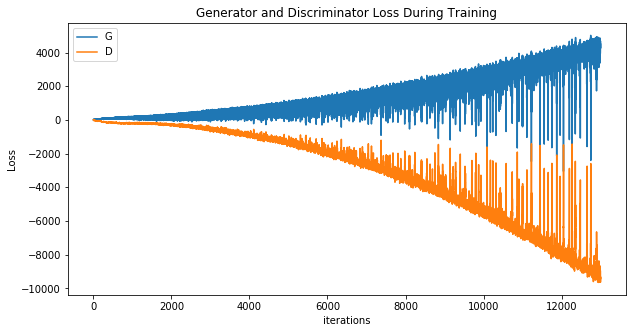

In [45]:
# Выводим на печать всяческие loss'ы
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

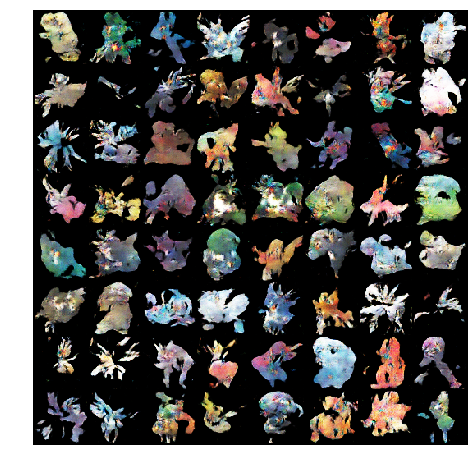

In [46]:
# Проигрываем результаты генерации для фиксированного шума
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

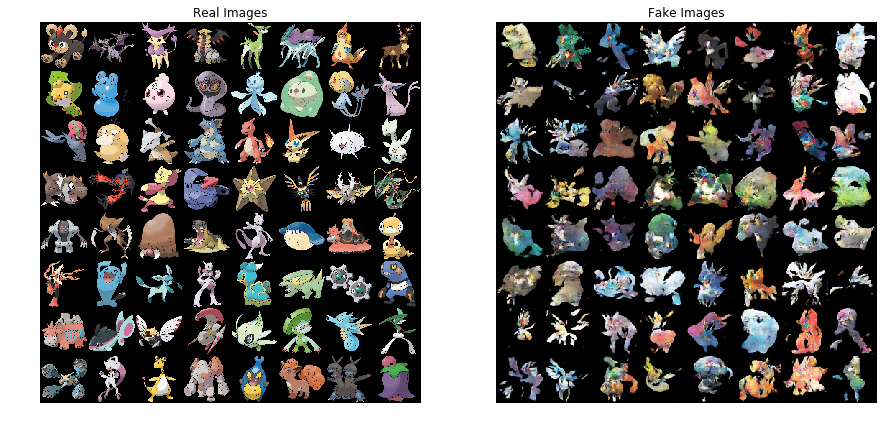

In [47]:
# Сравниваем настоящие данные и генерацию
real_batch = next(iter(dataloader))

# Рисуем трейнсет
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Рисуем фейки
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()